In [35]:
# This notebook loads in one month of Lauren's clustering results
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline  
import xarray as xr
import datetime
import warnings
#from pyhdf import SD
from pyhdf.SD import SD, SDC
warnings.simplefilter("ignore")

In [2]:
#constants
a = 6.37E6 #m

In [154]:
#open the local copy
f = xr.open_dataset('2001_01Clustered_Data_Globe50.nc4')
print(f)
altitude_lh = np.array(f.altitude_lh.copy())
surf_rain = np.array(f.surf_rain.copy())
latent_heating = np.array(f.latent_heating.copy())
latitude = np.array(f.latitude.copy())
longitude = np.array(f.longitude.copy())
time = np.array(f.time.copy())
rain_type = np.array(f.rain_type.copy())
labels = np.array(f.Labels.copy())

<xarray.Dataset>
Dimensions:          (altitude_lh: 19, clusteredCoords: 4626199)
Coordinates:
  * clusteredCoords  (clusteredCoords) int64 0 1 2 3 ... 4626196 4626197 4626198
  * altitude_lh      (altitude_lh) float32 0.0 0.5 1.0 2.0 ... 15.0 16.0 17.0
Data variables:
    surf_rain        (clusteredCoords) float64 ...
    latent_heating   (clusteredCoords, altitude_lh) float64 ...
    latitude         (clusteredCoords) float64 ...
    longitude        (clusteredCoords) float64 ...
    time             (clusteredCoords) datetime64[ns] ...
    rain_type        (clusteredCoords) float64 ...
    Labels           (clusteredCoords) int64 ...


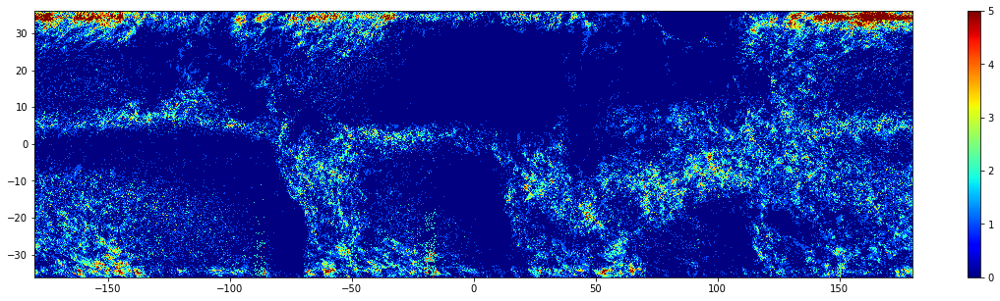

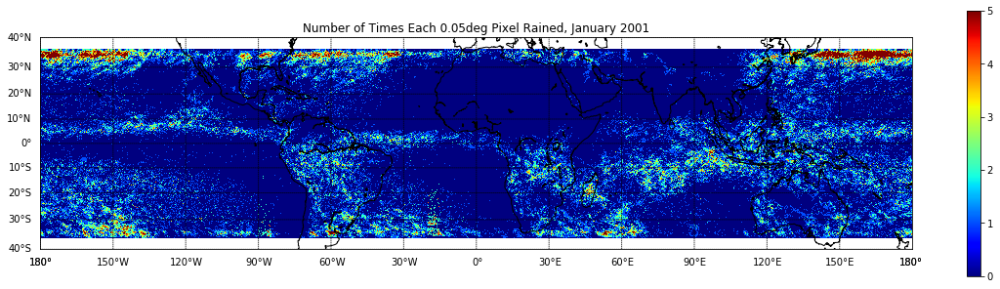

In [155]:
# Plot number of rain events at each grid point
temp_lat = np.round(20*latitude)/20
temp_lon = np.round(20*longitude)/20
bins_lon = np.arange(1+20*360)/20 - 180.025
bins_lat = np.arange(1+20*72.3)/20 - 36.175

fig = plt.figure(num=None, figsize=(20, 5) )
n=plt.hist2d(temp_lon, temp_lat, bins=[bins_lon,bins_lat], cmap='jet')
plt.clim(0, 5)
plt.colorbar();

fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
x = 0.5*(bins_lon[1:]+bins_lon[:-1])
y = 0.5*(bins_lat[1:]+bins_lat[:-1])
x, y = m(*np.meshgrid(x,y))
temp = np.transpose(np.array(n[0]))
m.pcolor(x, y, temp, cmap='jet')
plt.clim(0, 5)
plt.colorbar()
plt.title('Number of Times Each 0.05deg Pixel Rained, January 2001');
#fig.savefig('plots/nevents_0101.jpg', format='jpg', bbox_inches='tight');

In [156]:
fig.savefig('plots/nevents_0101_50km.jpg', format='jpg', bbox_inches='tight');

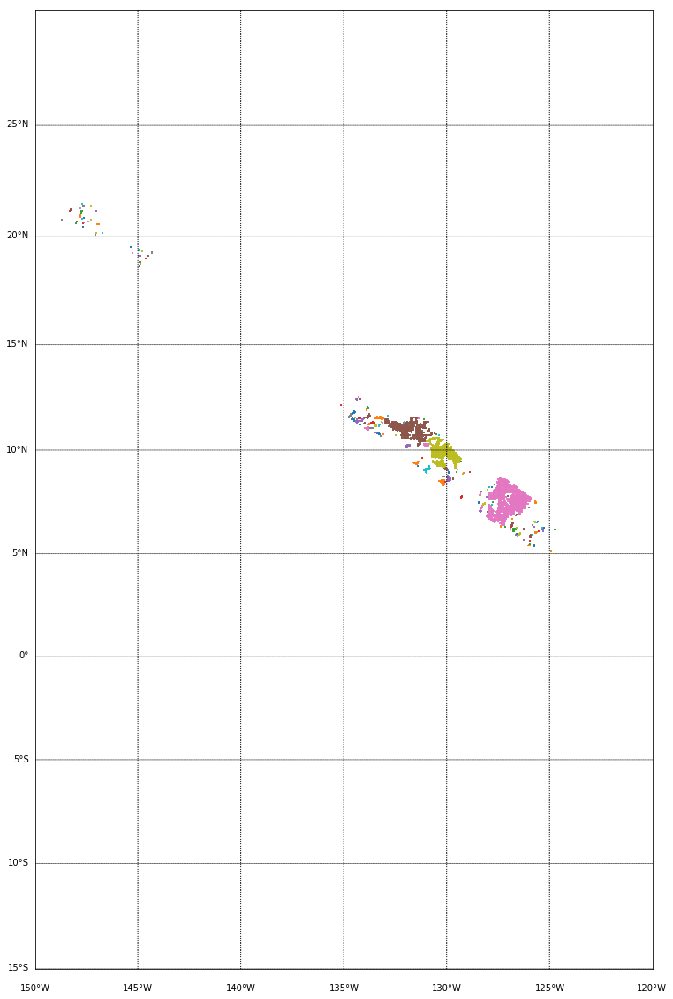

In [148]:
# plot events for a particular time span
plot_date = np.datetime64('2001-07-06T07:35:00.000000000')
max_dt_hours = 1

delta_time = np.array(time - plot_date, dtype='float64')/(60*60*1E9)
condition = np.abs(delta_time) <= max_dt_hours
lon_temp = np.extract(condition, longitude)
lat_temp = np.extract(condition, latitude)
labels_temp = np.extract(condition, labels)
unique_labels = np.unique(labels_temp)
time_temp = np.extract(condition, time)
nevents = np.size(unique_labels)

#fig = plt.figure(num=None, figsize=(17, 7) )
#m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
#            resolution='l',projection='merc')
#m.drawcoastlines()
#m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
#m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
#for i in np.arange(nevents):
#    event = unique_labels[i]
#    condition = labels_temp-event == 0
#    event_lat = np.extract(condition, lat_temp)
#    event_lon = np.extract(condition, lon_temp)
#    x, y = m(event_lon, event_lat)
#    m.scatter(x, y)
##plt.title('One Day, Pixels Colored by Event');
##fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

latmin = -15
latmax = 30
lonmin = -150
lonmax = -120
res = 5
labels_temp = labels_temp[lat_temp<=latmax]
lon_temp = lon_temp[lat_temp<=latmax]
lat_temp = lat_temp[lat_temp<=latmax]
labels_temp = labels_temp[lat_temp>=latmin]
lon_temp = lon_temp[lat_temp>=latmin]
lat_temp = lat_temp[lat_temp>=latmin]
labels_temp = labels_temp[lon_temp<=lonmax]
lat_temp = lat_temp[lon_temp<=lonmax]
lon_temp = lon_temp[lon_temp<=lonmax]
labels_temp = labels_temp[lon_temp>=lonmin]
lat_temp = lat_temp[lon_temp>=lonmin]
lon_temp = lon_temp[lon_temp>=lonmin]
unique_labels = np.unique(labels_temp)
nevents = np.size(unique_labels)

fig = plt.figure(num=None, figsize=(20, 20) )
m = Basemap(llcrnrlon=lonmin,llcrnrlat=latmin,urcrnrlon=lonmax,urcrnrlat=latmax,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,res),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,res),labels=[0,0,0,1])
for i in np.arange(nevents):
    event = unique_labels[i]
    condition = labels_temp-event == 0
    event_lat = np.extract(condition, lat_temp)
    event_lon = np.extract(condition, lon_temp)
    x, y = m(event_lon, event_lat)
    m.scatter(x, y, s=1, marker='s')
#plt.title('One Day, Pixels Colored by Event');
#fig.savefig('plots/pixels4_0701_6km.eps', format='eps', bbox_inches='tight');

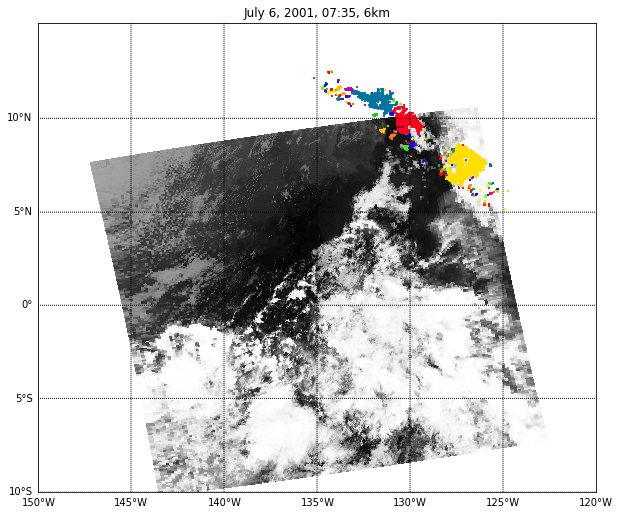

In [149]:
# Compare to MODIS image
FILE_NAME = 'modis_images/MOD021KM.A2001187.0735.061.2017173035824_y2001m07d06t0735.hdf'
hdf = SD(FILE_NAME, SDC.READ)
#hdf.datasets()

lat = hdf.select('Latitude')
lon = hdf.select('Longitude')
val = df.select('EV_1KM_Emissive')
lat = lat[:,:]
lon = lon[:,:]
#value = val[:,:]
value = val[:,:,:]
#nlat = np.size(lat,0)
#nlon = np.size(lon,0)

latmin = -10
latmax = 15
lonmin = -150
lonmax = -120
res = 5

fig = plt.figure(num=None, figsize=(10, 10) )
m = Basemap(llcrnrlon=lonmin,llcrnrlat=latmin,urcrnrlon=lonmax,urcrnrlat=latmax,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,res),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,res),labels=[0,0,0,1])

data = value[0,::5,5::5]
x, y = m(lon, lat)
m.pcolor(x,y,data,cmap = plt.get_cmap('Greys'))

plot_date = np.datetime64('2001-07-06T07:35:00.000000000')
max_dt_hours = 1

delta_time = np.array(time - plot_date, dtype='float64')/(60*60*1E9)
condition = np.abs(delta_time) <= max_dt_hours
lon_temp = np.extract(condition, longitude)
lat_temp = np.extract(condition, latitude)
labels_temp = np.extract(condition, labels)
unique_labels = np.unique(labels_temp)
time_temp = np.extract(condition, time)
nevents = np.size(unique_labels)

labels_temp = labels_temp[lat_temp<=latmax]
lon_temp = lon_temp[lat_temp<=latmax]
lat_temp = lat_temp[lat_temp<=latmax]
labels_temp = labels_temp[lat_temp>=latmin]
lon_temp = lon_temp[lat_temp>=latmin]
lat_temp = lat_temp[lat_temp>=latmin]
labels_temp = labels_temp[lon_temp<=lonmax]
lat_temp = lat_temp[lon_temp<=lonmax]
lon_temp = lon_temp[lon_temp<=lonmax]
labels_temp = labels_temp[lon_temp>=lonmin]
lat_temp = lat_temp[lon_temp>=lonmin]
lon_temp = lon_temp[lon_temp>=lonmin]
unique_labels = np.unique(labels_temp)
nevents = np.size(unique_labels)

cmap = plt.get_cmap('prism')
for i in np.arange(nevents):
    event = unique_labels[i]
    condition = labels_temp-event == 0
    event_lat = np.extract(condition, lat_temp)
    event_lon = np.extract(condition, lon_temp)
    x, y = m(event_lon, event_lat)
    m.scatter(x, y, s=1, marker='s', color=cmap(i/nevents))
plt.title('July 6, 2001, 07:35, 6km')
fig.savefig('plots/modis_070601_6km2.jpg', format='jpg', bbox_inches='tight');

In [62]:
#compile event mean information: pixel times, latitudes, longitudes, rain rates, rain types, latent heating profiles
unique_labels = np.unique(labels)
nevents = np.size(unique_labels)

event_time = np.nan*np.zeros(shape=(nevents), dtype=float)
event_area = np.nan*np.zeros(shape=(nevents), dtype=float)
event_lat_mean = np.nan*np.zeros(shape=(nevents), dtype=float)
event_lon_mean = np.nan*np.zeros(shape=(nevents), dtype=float)
event_pr_mean = np.nan*np.zeros(shape=(nevents), dtype=float)
event_frac_conv = np.nan*np.zeros(shape=(nevents), dtype=float)
event_frac_strat = np.nan*np.zeros(shape=(nevents), dtype=float)
event_frac_other = np.nan*np.zeros(shape=(nevents), dtype=float)
#event_lhp_mean = np.nan*np.zeros(shape=(nevents,19), dtype=float)
#temp_lhp = np.swapaxes(latent_heating, 0, 1)
dy = a*np.pi*0.05/(180*1000) #km
for i in np.arange(nevents):
    print(i/nevents)
    condition = labels-i == 0
    temp_time = np.extract(condition, time)
    temp_lat = np.extract(condition, latitude)
    temp_lon = np.extract(condition, longitude)
    temp_pr = np.extract(condition, surf_rain)
    temp_type = np.extract(condition, rain_type)
    
    temp = np.cos(np.pi*temp_lat/180)
    dx = a*np.pi*0.05*np.cos(np.pi*temp_lat/180)/(180*1000) #km
    event_time[i] = temp_time[0]
    event_area[i] = np.nansum(dx*dy)
    event_lat_mean[i] = np.nansum(temp_lat*temp)/np.nansum(temp)
    event_lon_mean[i] = np.nansum(temp_lon*temp)/np.nansum(temp)
    event_pr_mean[i] = np.nansum(temp_pr*temp)/np.nansum(temp)
    
    npixels = np.size(temp_lat)
    #condition = np.tile(condition, (19, 1))
    #temp_lhp2 = np.extract(condition, temp_lhp).reshape(19,npixels)
    #temp = np.tile(temp, (19, 1))
    #event_lhp_mean[i,:] = np.nansum(temp_lhp2*temp, axis=1)/np.nansum(temp, axis=1)
    
    condition = temp_type == 1
    temp = np.extract(condition, rain_type)
    event_frac_strat[i] = np.nansum(temp/temp)/npixels
    condition = temp_type == 2
    temp = np.extract(condition, rain_type)
    event_frac_conv[i] = np.nansum(temp/temp)/npixels
    condition = temp_type == 3
    temp = np.extract(condition, rain_type)
    event_frac_other[i] = np.nansum(temp/temp)/npixels

0.0
1.7517675334412423e-06
3.5035350668824846e-06
5.255302600323726e-06
7.007070133764969e-06
8.75883766720621e-06
1.0510605200647453e-05
1.2262372734088696e-05
1.4014140267529938e-05
1.576590780097118e-05
1.751767533441242e-05
1.9269442867853665e-05
2.1021210401294905e-05
2.277297793473615e-05
2.4524745468177393e-05
2.6276513001618633e-05
2.8028280535059877e-05
2.9780048068501117e-05
3.153181560194236e-05
3.32835831353836e-05
3.503535066882484e-05
3.678711820226609e-05
3.853888573570733e-05
4.029065326914857e-05
4.204242080258981e-05
4.379418833603106e-05
4.55459558694723e-05
4.729772340291354e-05
4.9049490936354785e-05
5.0801258469796026e-05
5.2553026003237266e-05
5.4304793536678506e-05
5.6056561070119754e-05
5.7808328603560994e-05
5.9560096137002234e-05
6.131186367044348e-05
6.306363120388472e-05
6.481539873732596e-05
6.65671662707672e-05
6.831893380420844e-05
7.007070133764968e-05
7.182246887109094e-05
7.357423640453218e-05
7.532600393797342e-05
7.707777147141466e-05
7.882953900485

0.0006464022198398184
0.0006481539873732596
0.0006499057549067008
0.0006516575224401421
0.0006534092899735833
0.0006551610575070246
0.0006569128250404658
0.000658664592573907
0.0006604163601073483
0.0006621681276407895
0.0006639198951742308
0.000665671662707672
0.0006674234302411132
0.0006691751977745545
0.0006709269653079957
0.000672678732841437
0.0006744305003748782
0.0006761822679083194
0.0006779340354417607
0.000679685802975202
0.0006814375705086433
0.0006831893380420845
0.0006849411055755258
0.000686692873108967
0.0006884446406424082
0.0006901964081758495
0.0006919481757092907
0.000693699943242732
0.0006954517107761732
0.0006972034783096144
0.0006989552458430557
0.0007007070133764969
0.0007024587809099382
0.0007042105484433794
0.0007059623159768206
0.0007077140835102619
0.0007094658510437031
0.0007112176185771444
0.0007129693861105856
0.0007147211536440268
0.0007164729211774681
0.0007182246887109093
0.0007199764562443506
0.0007217282237777918
0.000723479991311233
0.000725231758844

0.001317329185147814
0.0013190809526812553
0.0013208327202146966
0.0013225844877481378
0.001324336255281579
0.0013260880228150203
0.0013278397903484615
0.0013295915578819028
0.001331343325415344
0.0013330950929487852
0.0013348468604822265
0.0013365986280156677
0.001338350395549109
0.0013401021630825502
0.0013418539306159914
0.0013436056981494327
0.001345357465682874
0.0013471092332163152
0.0013488610007497564
0.0013506127682831976
0.0013523645358166389
0.0013541163033500801
0.0013558680708835214
0.0013576198384169628
0.001359371605950404
0.0013611233734838453
0.0013628751410172865
0.0013646269085507278
0.001366378676084169
0.0013681304436176103
0.0013698822111510515
0.0013716339786844927
0.001373385746217934
0.0013751375137513752
0.0013768892812848165
0.0013786410488182577
0.001380392816351699
0.0013821445838851402
0.0013838963514185814
0.0013856481189520227
0.001387399886485464
0.0013891516540189051
0.0013909034215523464
0.0013926551890857876
0.0013944069566192289
0.001396158724152670

0.00200227029072334
0.002004022058256781
0.0020057738257902224
0.0020075255933236637
0.002009277360857105
0.002011029128390546
0.0020127808959239874
0.0020145326634574286
0.00201628443099087
0.002018036198524311
0.0020197879660577523
0.0020215397335911936
0.002023291501124635
0.002025043268658076
0.0020267950361915173
0.0020285468037249585
0.0020302985712584
0.002032050338791841
0.0020338021063252823
0.0020355538738587235
0.0020373056413921647
0.002039057408925606
0.0020408091764590472
0.0020425609439924885
0.0020443127115259297
0.002046064479059371
0.002047816246592812
0.0020495680141262534
0.0020513197816596947
0.002053071549193136
0.002054823316726577
0.0020565750842600184
0.0020583268517934596
0.002060078619326901
0.002061830386860342
0.0020635821543937834
0.0020653339219272246
0.002067085689460666
0.002068837456994107
0.0020705892245275483
0.0020723409920609896
0.002074092759594431
0.002075844527127872
0.0020775962946613133
0.0020793480621947545
0.0020810998297281958
0.00208285159

0.002685459628765424
0.0026872113962988654
0.0026889631638323066
0.002690714931365748
0.002692466698899189
0.0026942184664326303
0.0026959702339660716
0.002697722001499513
0.002699473769032954
0.0027012255365663953
0.0027029773040998365
0.0027047290716332778
0.002706480839166719
0.0027082326067001602
0.0027099843742336015
0.0027117361417670427
0.0027134879093004844
0.0027152396768339256
0.002716991444367367
0.002718743211900808
0.0027204949794342494
0.0027222467469676906
0.002723998514501132
0.002725750282034573
0.0027275020495680143
0.0027292538171014556
0.002731005584634897
0.002732757352168338
0.0027345091197017793
0.0027362608872352205
0.0027380126547686618
0.002739764422302103
0.0027415161898355443
0.0027432679573689855
0.0027450197249024267
0.002746771492435868
0.002748523259969309
0.0027502750275027505
0.0027520267950361917
0.002753778562569633
0.002755530330103074
0.0027572820976365154
0.0027590338651699567
0.002760785632703398
0.002762537400236839
0.0027642891677702804
0.00276

0.0033739042694078325
0.0033756560369412737
0.003377407804474715
0.003379159572008156
0.0033809113395415974
0.0033826631070750387
0.00338441487460848
0.003386166642141921
0.0033879184096753624
0.0033896701772088036
0.003391421944742245
0.003393173712275686
0.0033949254798091274
0.0033966772473425686
0.00339842901487601
0.003400180782409451
0.0034019325499428923
0.0034036843174763336
0.003405436085009775
0.003407187852543216
0.0034089396200766573
0.0034106913876100985
0.0034124431551435398
0.003414194922676981
0.0034159466902104222
0.0034176984577438635
0.0034194502252773047
0.003421201992810746
0.003422953760344187
0.0034247055278776284
0.0034264572954110697
0.003428209062944511
0.003429960830477952
0.0034317125980113934
0.0034334643655448346
0.003435216133078276
0.003436967900611717
0.0034387196681451584
0.0034404714356785996
0.003442223203212041
0.003443974970745482
0.0034457267382789233
0.0034474785058123646
0.003449230273345806
0.003450982040879247
0.0034527338084126883
0.003454485

0.004057093607449917
0.004058845374983358
0.0040605971425168
0.00406234891005024
0.004064100677583682
0.004065852445117123
0.0040676042126505645
0.004069355980184005
0.004071107747717447
0.004072859515250888
0.0040746112827843295
0.00407636305031777
0.004078114817851212
0.004079866585384653
0.0040816183529180945
0.004083370120451535
0.004085121887984977
0.004086873655518418
0.004088625423051859
0.0040903771905853
0.004092128958118742
0.004093880725652183
0.004095632493185624
0.004097384260719065
0.004099136028252507
0.004100887795785948
0.004102639563319389
0.00410439133085283
0.004106143098386272
0.004107894865919713
0.004109646633453154
0.004111398400986595
0.004113150168520037
0.004114901936053478
0.004116653703586919
0.00411840547112036
0.004120157238653802
0.0041219090061872425
0.004123660773720684
0.004125412541254125
0.004127164308787567
0.0041289160763210075
0.004130667843854449
0.00413241961138789
0.004134171378921332
0.0041359231464547725
0.004137674913988214
0.00413942668152

0.0047490417831592075
0.004750793550692649
0.00475254531822609
0.004754297085759532
0.0047560488532929724
0.004757800620826414
0.004759552388359855
0.004761304155893297
0.004763055923426737
0.004764807690960179
0.00476655945849362
0.0047683112260270616
0.004770062993560502
0.004771814761093944
0.004773566528627385
0.0047753182961608265
0.004777070063694267
0.004778821831227709
0.00478057359876115
0.0047823253662945915
0.004784077133828032
0.004785828901361474
0.004787580668894915
0.0047893324364283564
0.004791084203961797
0.004792835971495239
0.00479458773902868
0.004796339506562121
0.004798091274095562
0.004799843041629004
0.004801594809162445
0.004803346576695886
0.004805098344229327
0.004806850111762769
0.00480860187929621
0.004810353646829651
0.004812105414363092
0.004813857181896534
0.004815608949429975
0.004817360716963416
0.004819112484496857
0.004820864252030299
0.00482261601956374
0.004824367787097181
0.004826119554630622
0.004827871322164064
0.0048296230896975045
0.0048313748

0.005433982888734734
0.005435734656268175
0.005437486423801616
0.005439238191335057
0.005440989958868499
0.0054427417264019395
0.005444493493935381
0.005446245261468822
0.005447997029002264
0.0054497487965357045
0.005451500564069146
0.005453252331602587
0.005455004099136029
0.0054567558666694695
0.005458507634202911
0.005460259401736352
0.005462011169269794
0.005463762936803234
0.005465514704336676
0.005467266471870117
0.005469018239403559
0.005470770006936999
0.005472521774470441
0.005474273542003882
0.0054760253095373235
0.005477777077070764
0.005479528844604206
0.005481280612137647
0.0054830323796710885
0.005484784147204529
0.005486535914737971
0.005488287682271412
0.0054900394498048535
0.005491791217338294
0.005493542984871736
0.005495294752405177
0.005497046519938618
0.005498798287472059
0.005500550055005501
0.005502301822538942
0.005504053590072383
0.005505805357605824
0.005507557125139266
0.005509308892672707
0.005511060660206148
0.005512812427739589
0.005514564195273031
0.00551

0.006122427529377142
0.0061241792969105825
0.006125931064444024
0.006127682831977465
0.006129434599510907
0.0061311863670443474
0.006132938134577789
0.00613468990211123
0.006136441669644672
0.006138193437178112
0.006139945204711554
0.006141696972244995
0.0061434487397784366
0.006145200507311877
0.006146952274845319
0.00614870404237876
0.0061504558099122015
0.006152207577445642
0.006153959344979084
0.006155711112512525
0.0061574628800459665
0.006159214647579407
0.006160966415112849
0.00616271818264629
0.0061644699501797314
0.006166221717713172
0.006167973485246614
0.006169725252780055
0.006171477020313496
0.006173228787846937
0.006174980555380379
0.00617673232291382
0.006178484090447261
0.006180235857980702
0.006181987625514144
0.006183739393047585
0.006185491160581026
0.006187242928114467
0.006188994695647909
0.00619074646318135
0.006192498230714791
0.006194249998248232
0.006196001765781674
0.006197753533315115
0.006199505300848556
0.006201257068381997
0.006203008835915439
0.0062047606

0.0068178792401533145
0.006819631007686756
0.006821382775220197
0.006823134542753639
0.0068248863102870795
0.006826638077820521
0.006828389845353962
0.006830141612887404
0.0068318933804208445
0.006833645147954286
0.006835396915487727
0.006837148683021169
0.0068389004505546094
0.006840652218088051
0.006842403985621492
0.006844155753154934
0.006845907520688374
0.006847659288221816
0.006849411055755257
0.0068511628232886986
0.006852914590822139
0.006854666358355581
0.006856418125889022
0.0068581698934224635
0.006859921660955904
0.006861673428489346
0.006863425196022787
0.0068651769635562285
0.006866928731089669
0.006868680498623111
0.006870432266156552
0.0068721840336899934
0.006873935801223434
0.006875687568756876
0.006877439336290317
0.006879191103823758
0.006880942871357199
0.006882694638890641
0.006884446406424082
0.006886198173957523
0.006887949941490964
0.006889701709024406
0.006891453476557847
0.006893205244091288
0.006894957011624729
0.006896708779158171
0.006898460546691612
0.006

0.007523841556130136
0.0075255933236635765
0.007527345091197018
0.007529096858730459
0.007530848626263901
0.0075326003937973415
0.007534352161330783
0.007536103928864224
0.007537855696397666
0.0075396074639311065
0.007541359231464548
0.007543110998997989
0.007544862766531431
0.007546614534064871
0.007548366301598313
0.007550118069131754
0.007551869836665196
0.007553621604198636
0.007555373371732078
0.007557125139265519
0.0075588769067989605
0.007560628674332401
0.007562380441865843
0.007564132209399284
0.0075658839769327255
0.007567635744466166
0.007569387511999608
0.007571139279533049
0.0075728910470664905
0.007574642814599931
0.007576394582133373
0.007578146349666814
0.007579898117200255
0.007581649884733696
0.007583401652267138
0.007585153419800579
0.00758690518733402
0.007588656954867461
0.007590408722400903
0.007592160489934344
0.007593912257467785
0.007595664025001226
0.007597415792534668
0.007599167560068109
0.00760091932760155
0.007602671095134991
0.007604422862668433
0.0076061

0.00822279680197319
0.008224548569506633
0.008226300337040074
0.008228052104573514
0.008229803872106955
0.008231555639640398
0.008233307407173839
0.00823505917470728
0.00823681094224072
0.008238562709774163
0.008240314477307603
0.008242066244841044
0.008243818012374485
0.008245569779907928
0.008247321547441368
0.00824907331497481
0.00825082508250825
0.008252576850041693
0.008254328617575133
0.008256080385108574
0.008257832152642015
0.008259583920175458
0.008261335687708898
0.00826308745524234
0.00826483922277578
0.008266590990309223
0.008268342757842663
0.008270094525376104
0.008271846292909545
0.008273598060442987
0.008275349827976428
0.008277101595509869
0.00827885336304331
0.008280605130576752
0.008282356898110193
0.008284108665643634
0.008285860433177075
0.008287612200710517
0.008289363968243958
0.008291115735777399
0.00829286750331084
0.008294619270844282
0.008296371038377723
0.008298122805911164
0.008299874573444605
0.008301626340978047
0.008303378108511488
0.008305129876044929
0

0.008921752047816247
0.008923503815349688
0.008925255582883129
0.00892700735041657
0.008928759117950012
0.008930510885483453
0.008932262653016894
0.008934014420550335
0.008935766188083777
0.008937517955617218
0.008939269723150659
0.0089410214906841
0.008942773258217542
0.008944525025750983
0.008946276793284424
0.008948028560817865
0.008949780328351307
0.008951532095884748
0.008953283863418189
0.00895503563095163
0.008956787398485072
0.008958539166018513
0.008960290933551954
0.008962042701085395
0.008963794468618837
0.008965546236152278
0.008967298003685719
0.00896904977121916
0.008970801538752602
0.008972553306286043
0.008974305073819484
0.008976056841352924
0.008977808608886367
0.008979560376419808
0.008981312143953249
0.00898306391148669
0.008984815679020132
0.008986567446553573
0.008988319214087014
0.008990070981620454
0.008991822749153897
0.008993574516687338
0.008995326284220779
0.00899707805175422
0.008998829819287662
0.009000581586821103
0.009002333354354543
0.009004085121887984

0.009615451991058978
0.00961720375859242
0.009618955526125862
0.009620707293659303
0.009622459061192743
0.009624210828726184
0.009625962596259627
0.009627714363793068
0.009629466131326508
0.00963121789885995
0.009632969666393392
0.009634721433926833
0.009636473201460273
0.009638224968993714
0.009639976736527157
0.009641728504060598
0.009643480271594038
0.00964523203912748
0.009646983806660922
0.009648735574194362
0.009650487341727803
0.009652239109261244
0.009653990876794687
0.009655742644328127
0.009657494411861568
0.009659246179395009
0.009660997946928452
0.009662749714461892
0.009664501481995333
0.009666253249528774
0.009668005017062217
0.009669756784595657
0.009671508552129098
0.009673260319662539
0.009675012087195982
0.009676763854729422
0.009678515622262863
0.009680267389796304
0.009682019157329746
0.009683770924863187
0.009685522692396628
0.009687274459930069
0.009689026227463511
0.009690777994996952
0.009692529762530393
0.009694281530063834
0.009696033297597276
0.00969778506513

0.01030915193430171
0.010310903701835152
0.010312655469368593
0.010314407236902034
0.010316159004435475
0.010317910771968917
0.010319662539502358
0.010321414307035799
0.01032316607456924
0.010324917842102682
0.010326669609636123
0.010328421377169564
0.010330173144703005
0.010331924912236447
0.010333676679769888
0.010335428447303329
0.01033718021483677
0.010338931982370212
0.010340683749903653
0.010342435517437094
0.010344187284970534
0.010345939052503977
0.010347690820037418
0.010349442587570859
0.0103511943551043
0.010352946122637742
0.010354697890171183
0.010356449657704624
0.010358201425238064
0.010359953192771507
0.010361704960304948
0.010363456727838389
0.01036520849537183
0.010366960262905272
0.010368712030438713
0.010370463797972154
0.010372215565505594
0.010373967333039037
0.010375719100572478
0.010377470868105918
0.01037922263563936
0.010380974403172802
0.010382726170706243
0.010384477938239683
0.010386229705773124
0.010387981473306567
0.010389733240840008
0.010391485008373448

0.011001100110011002
0.011002851877544443
0.011004603645077883
0.011006355412611324
0.011008107180144767
0.011009858947678208
0.011011610715211648
0.01101336248274509
0.011015114250278532
0.011016866017811973
0.011018617785345413
0.011020369552878854
0.011022121320412297
0.011023873087945738
0.011025624855479178
0.011027376623012619
0.011029128390546062
0.011030880158079502
0.011032631925612943
0.011034383693146384
0.011036135460679827
0.011037887228213267
0.011039638995746708
0.011041390763280149
0.011043142530813592
0.011044894298347032
0.011046646065880473
0.011048397833413914
0.011050149600947357
0.011051901368480797
0.011053653136014238
0.011055404903547679
0.011057156671081122
0.011058908438614562
0.011060660206148003
0.011062411973681444
0.011064163741214886
0.011065915508748327
0.011067667276281768
0.011069419043815209
0.011071170811348651
0.011072922578882092
0.011074674346415533
0.011076426113948974
0.011078177881482416
0.011079929649015857
0.011081681416549298
0.011083433184

0.011705310658454381
0.011707062425987822
0.011708814193521263
0.011710565961054704
0.011712317728588146
0.011714069496121587
0.011715821263655028
0.011717573031188469
0.011719324798721911
0.011721076566255352
0.011722828333788793
0.011724580101322234
0.011726331868855676
0.011728083636389117
0.011729835403922558
0.011731587171455999
0.011733338938989441
0.011735090706522882
0.011736842474056323
0.011738594241589764
0.011740346009123206
0.011742097776656647
0.011743849544190088
0.011745601311723529
0.011747353079256971
0.011749104846790412
0.011750856614323853
0.011752608381857294
0.011754360149390736
0.011756111916924177
0.011757863684457618
0.011759615451991058
0.011761367219524501
0.011763118987057942
0.011764870754591383
0.011766622522124823
0.011768374289658266
0.011770126057191707
0.011771877824725148
0.011773629592258588
0.011775381359792031
0.011777133127325472
0.011778884894858913
0.011780636662392353
0.011782388429925796
0.011784140197459237
0.011785891964992678
0.01178764373

0.012399010601697113
0.012400762369230553
0.012402514136763994
0.012404265904297437
0.012406017671830877
0.012407769439364318
0.012409521206897759
0.012411272974431202
0.012413024741964642
0.012414776509498083
0.012416528277031524
0.012418280044564967
0.012420031812098407
0.012421783579631848
0.012423535347165289
0.012425287114698732
0.012427038882232172
0.012428790649765613
0.012430542417299054
0.012432294184832497
0.012434045952365937
0.012435797719899378
0.012437549487432819
0.012439301254966261
0.012441053022499702
0.012442804790033143
0.012444556557566584
0.012446308325100026
0.012448060092633467
0.012449811860166908
0.012451563627700349
0.012453315395233791
0.012455067162767232
0.012456818930300673
0.012458570697834114
0.012460322465367556
0.012462074232900997
0.012463826000434438
0.012465577767967879
0.012467329535501321
0.012469081303034762
0.012470833070568203
0.012472584838101644
0.012474336605635086
0.012476088373168527
0.012477840140701968
0.012479591908235409
0.01248134367

0.013096214080006727
0.013097965847540168
0.013099717615073609
0.013101469382607051
0.013103221150140492
0.013104972917673933
0.013106724685207374
0.013108476452740816
0.013110228220274257
0.013111979987807698
0.013113731755341139
0.013115483522874581
0.013117235290408022
0.013118987057941463
0.013120738825474904
0.013122490593008346
0.013124242360541787
0.013125994128075228
0.013127745895608669
0.013129497663142111
0.013131249430675552
0.013133001198208993
0.013134752965742433
0.013136504733275876
0.013138256500809317
0.013140008268342758
0.013141760035876198
0.013143511803409641
0.013145263570943082
0.013147015338476523
0.013148767106009963
0.013150518873543406
0.013152270641076847
0.013154022408610288
0.013155774176143728
0.013157525943677171
0.013159277711210612
0.013161029478744053
0.013162781246277493
0.013164533013810936
0.013166284781344377
0.013168036548877817
0.013169788316411258
0.0131715400839447
0.013173291851478142
0.013175043619011582
0.013176795386545023
0.0131785471540

0.013793417558316342
0.013795169325849782
0.013796921093383223
0.013798672860916666
0.013800424628450107
0.013802176395983547
0.013803928163516988
0.01380567993105043
0.013807431698583872
0.013809183466117312
0.013810935233650753
0.013812687001184196
0.013814438768717636
0.013816190536251077
0.013817942303784518
0.01381969407131796
0.013821445838851401
0.013823197606384842
0.013824949373918283
0.013826701141451726
0.013828452908985166
0.013830204676518607
0.013831956444052048
0.01383370821158549
0.013835459979118931
0.013837211746652372
0.013838963514185813
0.013840715281719256
0.013842467049252696
0.013844218816786137
0.013845970584319578
0.01384772235185302
0.013849474119386461
0.013851225886919902
0.013852977654453343
0.013854729421986785
0.013856481189520226
0.013858232957053667
0.013859984724587108
0.01386173649212055
0.013863488259653991
0.013865240027187432
0.013866991794720873
0.013868743562254315
0.013870495329787756
0.013872247097321197
0.013873998864854638
0.0138757506323880

0.014487117501559073
0.014488869269092514
0.014490621036625956
0.014492372804159397
0.014494124571692838
0.014495876339226279
0.014497628106759721
0.014499379874293162
0.014501131641826603
0.014502883409360044
0.014504635176893486
0.014506386944426927
0.014508138711960368
0.014509890479493808
0.014511642247027251
0.014513394014560692
0.014515145782094133
0.014516897549627573
0.014518649317161016
0.014520401084694457
0.014522152852227898
0.014523904619761338
0.014525656387294781
0.014527408154828222
0.014529159922361663
0.014530911689895103
0.014532663457428546
0.014534415224961987
0.014536166992495428
0.014537918760028868
0.014539670527562311
0.014541422295095752
0.014543174062629192
0.014544925830162633
0.014546677597696076
0.014548429365229517
0.014550181132762957
0.014551932900296398
0.01455368466782984
0.014555436435363282
0.014557188202896722
0.014558939970430163
0.014560691737963606
0.014562443505497047
0.014564195273030487
0.014565947040563928
0.01456769880809737
0.0145694505756

0.015177313909734922
0.015179065677268363
0.015180817444801806
0.015182569212335247
0.015184320979868687
0.015186072747402128
0.01518782451493557
0.015189576282469011
0.015191328050002452
0.015193079817535893
0.015194831585069336
0.015196583352602776
0.015198335120136217
0.015200086887669658
0.0152018386552031
0.015203590422736541
0.015205342190269982
0.015207093957803423
0.015208845725336866
0.015210597492870306
0.015212349260403747
0.015214101027937188
0.01521585279547063
0.015217604563004071
0.015219356330537512
0.015221108098070953
0.015222859865604395
0.015224611633137836
0.015226363400671277
0.015228115168204718
0.01522986693573816
0.015231618703271601
0.015233370470805042
0.015235122238338483
0.015236874005871925
0.015238625773405366
0.015240377540938807
0.015242129308472248
0.01524388107600569
0.015245632843539131
0.015247384611072572
0.015249136378606013
0.015250888146139455
0.015252639913672896
0.015254391681206337
0.015256143448739778
0.01525789521627322
0.015259646983806661

0.015872765620511094
0.01587451738804454
0.01587626915557798
0.01587802092311142
0.01587977269064486
0.015881524458178302
0.015883276225711743
0.015885027993245183
0.015886779760778624
0.01588853152831207
0.01589028329584551
0.01589203506337895
0.01589378683091239
0.015895538598445832
0.015897290365979273
0.015899042133512713
0.015900793901046154
0.0159025456685796
0.01590429743611304
0.01590604920364648
0.01590780097117992
0.01590955273871336
0.015911304506246803
0.015913056273780243
0.015914808041313684
0.01591655980884713
0.01591831157638057
0.01592006334391401
0.01592181511144745
0.01592356687898089
0.015925318646514332
0.015927070414047773
0.015928822181581214
0.01593057394911466
0.0159323257166481
0.01593407748418154
0.01593582925171498
0.01593758101924842
0.015939332786781862
0.015941084554315303
0.015942836321848744
0.01594458808938219
0.01594633985691563
0.01594809162444907
0.01594984339198251
0.01595159515951595
0.015953346927049392
0.015955098694582833
0.015956850462116274
0

0.016575224401421035
0.016576976168954476
0.016578727936487916
0.016580479704021357
0.016582231471554798
0.01658398323908824
0.01658573500662168
0.016587486774155124
0.016589238541688565
0.016590990309222006
0.016592742076755446
0.016594493844288887
0.016596245611822328
0.01659799737935577
0.01659974914688921
0.016601500914422654
0.016603252681956095
0.016605004449489535
0.016606756217022976
0.016608507984556417
0.016610259752089858
0.0166120115196233
0.01661376328715674
0.016615515054690184
0.016617266822223625
0.016619018589757065
0.016620770357290506
0.016622522124823947
0.016624273892357388
0.01662602565989083
0.01662777742742427
0.016629529194957714
0.016631280962491155
0.016633032730024595
0.016634784497558036
0.016636536265091477
0.016638288032624918
0.01664003980015836
0.0166417915676918
0.016643543335225244
0.016645295102758684
0.016647046870292125
0.016648798637825566
0.016650550405359007
0.016652302172892448
0.01665405394042589
0.01665580570795933
0.016657557475492774
0.0166

0.01727593141479753
0.017277683182330972
0.017279434949864413
0.017281186717397853
0.017282938484931294
0.01728469025246474
0.01728644201999818
0.01728819378753162
0.01728994555506506
0.0172916973225985
0.017293449090131943
0.017295200857665383
0.017296952625198824
0.01729870439273227
0.01730045616026571
0.01730220792779915
0.01730395969533259
0.01730571146286603
0.017307463230399472
0.017309214997932913
0.017310966765466354
0.0173127185329998
0.01731447030053324
0.01731622206806668
0.01731797383560012
0.01731972560313356
0.017321477370667002
0.017323229138200443
0.017324980905733884
0.017326732673267328
0.01732848444080077
0.01733023620833421
0.01733198797586765
0.01733373974340109
0.017335491510934532
0.017337243278467973
0.017338995046001414
0.017340746813534858
0.0173424985810683
0.01734425034860174
0.01734600211613518
0.01734775388366862
0.017349505651202062
0.017351257418735503
0.017353009186268944
0.017354760953802388
0.01735651272133583
0.01735826448886927
0.01736001625640271
0

0.017987149033374675
0.017988900800908116
0.017990652568441557
0.017992404335974998
0.01799415610350844
0.017995907871041883
0.017997659638575324
0.017999411406108765
0.018001163173642205
0.018002914941175646
0.018004666708709087
0.018006418476242528
0.01800817024377597
0.018009922011309413
0.018011673778842854
0.018013425546376294
0.018015177313909735
0.018016929081443176
0.018018680848976617
0.018020432616510058
0.0180221843840435
0.018023936151576943
0.018025687919110384
0.018027439686643824
0.018029191454177265
0.018030943221710706
0.018032694989244147
0.018034446756777588
0.01803619852431103
0.018037950291844473
0.018039702059377914
0.018041453826911354
0.018043205594444795
0.018044957361978236
0.018046709129511677
0.018048460897045118
0.01805021266457856
0.018051964432112003
0.018053716199645443
0.018055467967178884
0.018057219734712325
0.018058971502245766
0.018060723269779207
0.018062475037312647
0.01806422680484609
0.018065978572379533
0.018067730339912973
0.018069482107446414

0.01868084897661741
0.01868260074415085
0.01868435251168429
0.01868610427921773
0.01868785604675117
0.018689607814284612
0.018691359581818053
0.018693111349351494
0.01869486311688494
0.01869661488441838
0.01869836665195182
0.01870011841948526
0.0187018701870187
0.018703621954552142
0.018705373722085583
0.018707125489619024
0.018708877257152468
0.01871062902468591
0.01871238079221935
0.01871413255975279
0.01871588432728623
0.018717636094819672
0.018719387862353113
0.018721139629886554
0.018722891397419998
0.01872464316495344
0.01872639493248688
0.01872814670002032
0.01872989846755376
0.018731650235087202
0.018733402002620643
0.018735153770154084
0.018736905537687528
0.01873865730522097
0.01874040907275441
0.01874216084028785
0.01874391260782129
0.018745664375354732
0.018747416142888173
0.018749167910421614
0.018750919677955058
0.0187526714454885
0.01875442321302194
0.01875617498055538
0.01875792674808882
0.018759678515622262
0.018761430283155703
0.018763182050689144
0.018764933818222588

0.019397321897794875
0.019399073665328316
0.019400825432861757
0.019402577200395198
0.01940432896792864
0.019406080735462083
0.019407832502995524
0.019409584270528964
0.019411336038062405
0.019413087805595846
0.019414839573129287
0.019416591340662728
0.01941834310819617
0.019420094875729613
0.019421846643263053
0.019423598410796494
0.019425350178329935
0.019427101945863376
0.019428853713396817
0.019430605480930258
0.0194323572484637
0.019434109015997143
0.019435860783530583
0.019437612551064024
0.019439364318597465
0.019441116086130906
0.019442867853664347
0.019444619621197787
0.019446371388731228
0.019448123156264673
0.019449874923798113
0.019451626691331554
0.019453378458864995
0.019455130226398436
0.019456881993931877
0.019458633761465317
0.019460385528998758
0.019462137296532202
0.019463889064065643
0.019465640831599084
0.019467392599132525
0.019469144366665966
0.019470896134199406
0.019472647901732847
0.019474399669266288
0.019476151436799732
0.019477903204333173
0.019479654971866

0.02010853951637202
0.02011029128390546
0.0201120430514389
0.020113794818972342
0.020115546586505783
0.020117298354039227
0.020119050121572668
0.02012080188910611
0.02012255365663955
0.02012430542417299
0.02012605719170643
0.020127808959239872
0.020129560726773313
0.020131312494306757
0.020133064261840198
0.02013481602937364
0.02013656779690708
0.02013831956444052
0.02014007133197396
0.020141823099507402
0.020143574867040843
0.020145326634574287
0.020147078402107728
0.02014883016964117
0.02015058193717461
0.02015233370470805
0.02015408547224149
0.020155837239774932
0.020157589007308373
0.020159340774841817
0.020161092542375258
0.0201628443099087
0.02016459607744214
0.02016634784497558
0.02016809961250902
0.020169851380042462
0.020171603147575903
0.020173354915109347
0.020175106682642788
0.02017685845017623
0.02017861021770967
0.02018036198524311
0.02018211375277655
0.020183865520309992
0.020185617287843433
0.020187369055376877
0.020189120822910318
0.02019087259044376
0.0201926243579772

0.020825012437549487
0.020826764205082927
0.020828515972616368
0.020830267740149812
0.020832019507683253
0.020833771275216694
0.020835523042750135
0.020837274810283576
0.020839026577817017
0.020840778345350457
0.020842530112883898
0.020844281880417342
0.020846033647950783
0.020847785415484224
0.020849537183017665
0.020851288950551106
0.020853040718084546
0.020854792485617987
0.020856544253151428
0.020858296020684872
0.020860047788218313
0.020861799555751754
0.020863551323285195
0.020865303090818636
0.020867054858352076
0.020868806625885517
0.02087055839341896
0.020872310160952402
0.020874061928485843
0.020875813696019284
0.020877565463552725
0.020879317231086165
0.020881068998619606
0.020882820766153047
0.02088457253368649
0.020886324301219932
0.020888076068753373
0.020889827836286814
0.020891579603820255
0.020893331371353695
0.020895083138887136
0.020896834906420577
0.02089858667395402
0.020900338441487462
0.020902090209020903
0.020903841976554344
0.020905593744087785
0.02090734551162

0.02153097475352631
0.02153272652105975
0.02153447828859319
0.02153623005612663
0.021537981823660072
0.021539733591193513
0.021541485358726957
0.021543237126260398
0.02154498889379384
0.02154674066132728
0.02154849242886072
0.02155024419639416
0.021551995963927602
0.021553747731461043
0.021555499498994487
0.021557251266527928
0.02155900303406137
0.02156075480159481
0.02156250656912825
0.02156425833666169
0.02156601010419513
0.021567761871728573
0.021569513639262017
0.021571265406795458
0.0215730171743289
0.02157476894186234
0.02157652070939578
0.02157827247692922
0.02158002424446266
0.021581776011996102
0.021583527779529547
0.021585279547062988
0.02158703131459643
0.02158878308212987
0.02159053484966331
0.02159228661719675
0.02159403838473019
0.021595790152263632
0.021597541919797077
0.021599293687330517
0.02160104545486396
0.0216027972223974
0.02160454898993084
0.02160630075746428
0.02160805252499772
0.021609804292531162
0.021611556060064607
0.021613307827598047
0.021615059595131488
0

0.022242192372103453
0.022243944139636894
0.022245695907170335
0.022247447674703776
0.022249199442237216
0.022250951209770657
0.0222527029773041
0.022254454744837542
0.022256206512370983
0.022257958279904424
0.022259710047437865
0.022261461814971305
0.022263213582504746
0.022264965350038187
0.02226671711757163
0.022268468885105072
0.022270220652638513
0.022271972420171954
0.022273724187705395
0.022275475955238835
0.022277227722772276
0.022278979490305717
0.02228073125783916
0.022282483025372602
0.022284234792906043
0.022285986560439484
0.022287738327972925
0.022289490095506365
0.022291241863039806
0.022292993630573247
0.02229474539810669
0.022296497165640132
0.022298248933173573
0.022300000700707014
0.022301752468240454
0.022303504235773895
0.022305256003307336
0.022307007770840777
0.02230875953837422
0.022310511305907662
0.022312263073441103
0.022314014840974544
0.022315766608507984
0.022317518376041425
0.022319270143574866
0.022321021911108307
0.02232277367864175
0.022324525446175192

0.02294640292054683
0.02294815468808027
0.022949906455613713
0.022951658223147157
0.022953409990680598
0.02295516175821404
0.02295691352574748
0.02295866529328092
0.02296041706081436
0.0229621688283478
0.022963920595881246
0.022965672363414687
0.022967424130948128
0.02296917589848157
0.02297092766601501
0.02297267943354845
0.02297443120108189
0.02297618296861533
0.022977934736148776
0.022979686503682217
0.022981438271215657
0.022983190038749098
0.02298494180628254
0.02298669357381598
0.02298844534134942
0.02299019710888286
0.022991948876416306
0.022993700643949747
0.022995452411483187
0.022997204179016628
0.02299895594655007
0.02300070771408351
0.02300245948161695
0.02300421124915039
0.023005963016683836
0.023007714784217276
0.023009466551750717
0.023011218319284158
0.0230129700868176
0.02301472185435104
0.02301647362188448
0.02301822538941792
0.023019977156951366
0.023021728924484806
0.023023480692018247
0.023025232459551688
0.02302698422708513
0.02302873599461857
0.02303048776215201


0.023654117004057094
0.023655868771590535
0.023657620539123975
0.023659372306657416
0.023661124074190857
0.0236628758417243
0.023664627609257742
0.023666379376791183
0.023668131144324624
0.023669882911858064
0.023671634679391505
0.023673386446924946
0.023675138214458387
0.02367688998199183
0.023678641749525272
0.023680393517058713
0.023682145284592154
0.023683897052125594
0.023685648819659035
0.023687400587192476
0.023689152354725917
0.02369090412225936
0.023692655889792802
0.023694407657326243
0.023696159424859684
0.023697911192393124
0.023699662959926565
0.023701414727460006
0.023703166494993447
0.02370491826252689
0.023706670030060332
0.023708421797593773
0.023710173565127213
0.023711925332660654
0.023713677100194095
0.023715428867727536
0.023717180635260977
0.02371893240279442
0.023720684170327862
0.023722435937861303
0.023724187705394743
0.023725939472928184
0.023727691240461625
0.023729443007995066
0.023731194775528507
0.02373294654306195
0.02373469831059539
0.023736450078128832


0.024365334622634238
0.02436708639016768
0.02436883815770112
0.02437058992523456
0.024372341692768
0.024374093460301446
0.024375845227834887
0.024377596995368327
0.024379348762901768
0.02438110053043521
0.02438285229796865
0.02438460406550209
0.02438635583303553
0.024388107600568976
0.024389859368102416
0.024391611135635857
0.024393362903169298
0.02439511467070274
0.02439686643823618
0.02439861820576962
0.02440036997330306
0.024402121740836506
0.024403873508369946
0.024405625275903387
0.024407377043436828
0.02440912881097027
0.02441088057850371
0.02441263234603715
0.02441438411357059
0.024416135881104035
0.024417887648637476
0.024419639416170917
0.024421391183704358
0.0244231429512378
0.02442489471877124
0.02442664648630468
0.02442839825383812
0.024430150021371565
0.024431901788905006
0.024433653556438447
0.024435405323971888
0.02443715709150533
0.02443890885903877
0.02444066062657221
0.02444241239410565
0.024444164161639095
0.024445915929172536
0.024447667696705977
0.02444941946423941

0.025062538100943853
0.025064289868477294
0.025066041636010734
0.025067793403544175
0.025069545171077616
0.02507129693861106
0.0250730487061445
0.025074800473677942
0.025076552241211383
0.025078304008744823
0.025080055776278264
0.025081807543811705
0.025083559311345146
0.02508531107887859
0.02508706284641203
0.025088814613945472
0.025090566381478913
0.025092318149012353
0.025094069916545794
0.025095821684079235
0.025097573451612676
0.02509932521914612
0.02510107698667956
0.025102828754213
0.025104580521746443
0.025106332289279883
0.025108084056813324
0.025109835824346765
0.025111587591880206
0.02511333935941365
0.02511509112694709
0.02511684289448053
0.025118594662013972
0.025120346429547413
0.025122098197080854
0.025123849964614295
0.025125601732147736
0.02512735349968118
0.02512910526721462
0.02513085703474806
0.025132608802281502
0.025134360569814943
0.025136112337348384
0.025137864104881825
0.025139615872415266
0.02514136763994871
0.02514311940748215
0.02514487117501559
0.025146622

0.02576850041692067
0.025770252184454116
0.025772003951987556
0.025773755719520997
0.025775507487054438
0.02577725925458788
0.02577901102212132
0.02578076278965476
0.0257825145571882
0.025784266324721646
0.025786018092255086
0.025787769859788527
0.025789521627321968
0.02579127339485541
0.02579302516238885
0.02579477692992229
0.02579652869745573
0.025798280464989175
0.025800032232522616
0.025801784000056057
0.025803535767589498
0.02580528753512294
0.02580703930265638
0.02580879107018982
0.02581054283772326
0.025812294605256705
0.025814046372790146
0.025815798140323587
0.025817549907857028
0.02581930167539047
0.02582105344292391
0.02582280521045735
0.02582455697799079
0.025826308745524235
0.025828060513057676
0.025829812280591117
0.025831564048124558
0.025833315815658
0.02583506758319144
0.02583681935072488
0.02583857111825832
0.025840322885791765
0.025842074653325206
0.025843826420858647
0.025845578188392088
0.02584732995592553
0.02584908172345897
0.02585083349099241
0.02585258525852585

0.026462200360163404
0.026463952127696845
0.026465703895230286
0.02646745566276373
0.02646920743029717
0.026470959197830612
0.026472710965364053
0.026474462732897493
0.026476214500430934
0.026477966267964375
0.026479718035497816
0.02648146980303126
0.0264832215705647
0.02648497333809814
0.026486725105631582
0.026488476873165023
0.026490228640698464
0.026491980408231905
0.026493732175765346
0.02649548394329879
0.02649723571083223
0.02649898747836567
0.026500739245899112
0.026502491013432553
0.026504242780965994
0.026505994548499435
0.026507746316032876
0.02650949808356632
0.02651124985109976
0.0265130016186332
0.026514753386166642
0.026516505153700083
0.026518256921233524
0.026520008688766965
0.026521760456300406
0.02652351222383385
0.02652526399136729
0.02652701575890073
0.026528767526434172
0.026530519293967613
0.026532271061501054
0.026534022829034495
0.026535774596567935
0.02653752636410138
0.02653927813163482
0.02654102989916826
0.026542781666701702
0.026544533434235143
0.026546285

0.027171666211207108
0.02717341797874055
0.02717516974627399
0.02717692151380743
0.027178673281340875
0.027180425048874315
0.027182176816407756
0.027183928583941197
0.027185680351474638
0.02718743211900808
0.02718918388654152
0.02719093565407496
0.027192687421608405
0.027194439189141845
0.027196190956675286
0.027197942724208727
0.027199694491742168
0.02720144625927561
0.02720319802680905
0.02720494979434249
0.027206701561875934
0.027208453329409375
0.027210205096942816
0.027211956864476257
0.027213708632009698
0.02721546039954314
0.02721721216707658
0.02721896393461002
0.027220715702143464
0.027222467469676905
0.027224219237210346
0.027225971004743787
0.027227722772277228
0.02722947453981067
0.02723122630734411
0.02723297807487755
0.027234729842410994
0.027236481609944435
0.027238233377477876
0.027239985145011317
0.027241736912544758
0.0272434886800782
0.02724524044761164
0.02724699221514508
0.027248743982678524
0.027250495750211965
0.027252247517745406
0.027253999285278847
0.027255751

0.0278636143869164
0.02786536615444984
0.02786711792198328
0.027868869689516722
0.027870621457050163
0.027872373224583604
0.027874124992117045
0.027875876759650486
0.02787762852718393
0.02787938029471737
0.02788113206225081
0.027882883829784252
0.027884635597317693
0.027886387364851134
0.027888139132384575
0.027889890899918016
0.02789164266745146
0.0278933944349849
0.02789514620251834
0.027896897970051782
0.027898649737585223
0.027900401505118664
0.027902153272652105
0.027903905040185546
0.02790565680771899
0.02790740857525243
0.02790916034278587
0.027910912110319312
0.027912663877852753
0.027914415645386194
0.027916167412919635
0.027917919180453075
0.02791967094798652
0.02792142271551996
0.0279231744830534
0.027924926250586842
0.027926678018120283
0.027928429785653724
0.027930181553187165
0.027931933320720605
0.02793368508825405
0.02793543685578749
0.02793718862332093
0.027938940390854372
0.027940692158387813
0.027942443925921254
0.027944195693454695
0.027945947460988135
0.02794769922

0.02858534261069419
0.02858709437822763
0.028588846145761074
0.028590597913294515
0.028592349680827956
0.028594101448361397
0.028595853215894838
0.02859760498342828
0.02859935675096172
0.02860110851849516
0.028602860286028604
0.028604612053562045
0.028606363821095486
0.028608115588628927
0.028609867356162368
0.02861161912369581
0.02861337089122925
0.02861512265876269
0.028616874426296134
0.028618626193829575
0.028620377961363016
0.028622129728896457
0.028623881496429898
0.02862563326396334
0.02862738503149678
0.02862913679903022
0.028630888566563664
0.028632640334097105
0.028634392101630546
0.028636143869163987
0.028637895636697427
0.028639647404230868
0.02864139917176431
0.02864315093929775
0.028644902706831194
0.028646654474364635
0.028648406241898076
0.028650158009431517
0.028651909776964957
0.028653661544498398
0.02865541331203184
0.02865716507956528
0.028658916847098724
0.028660668614632165
0.028662420382165606
0.028664172149699046
0.028665923917232487
0.028667675684765928
0.02866

0.029294808461737893
0.029296560229271334
0.029298311996804775
0.02930006376433822
0.02930181553187166
0.0293035672994051
0.02930531906693854
0.029307070834471982
0.029308822602005423
0.029310574369538864
0.029312326137072305
0.02931407790460575
0.02931582967213919
0.02931758143967263
0.02931933320720607
0.029321084974739512
0.029322836742272953
0.029324588509806394
0.029326340277339834
0.02932809204487328
0.02932984381240672
0.02933159557994016
0.0293333473474736
0.029335099115007042
0.029336850882540483
0.029338602650073924
0.029340354417607364
0.02934210618514081
0.02934385795267425
0.02934560972020769
0.02934736148774113
0.029349113255274572
0.029350865022808013
0.029352616790341454
0.029354368557874894
0.02935612032540834
0.02935787209294178
0.02935962386047522
0.02936137562800866
0.029363127395542102
0.029364879163075543
0.029366630930608983
0.029368382698142424
0.02937013446567587
0.02937188623320931
0.02937363800074275
0.02937538976827619
0.029377141535809632
0.0293788933033430

0.030013033150448804
0.030014784917982245
0.030016536685515686
0.030018288453049127
0.030020040220582567
0.030021791988116008
0.03002354375564945
0.03002529552318289
0.030027047290716334
0.030028799058249775
0.030030550825783216
0.030032302593316657
0.030034054360850097
0.030035806128383538
0.03003755789591698
0.03003930966345042
0.030041061430983864
0.030042813198517305
0.030044564966050746
0.030046316733584186
0.030048068501117627
0.030049820268651068
0.03005157203618451
0.030053323803717953
0.030055075571251394
0.030056827338784835
0.030058579106318276
0.030060330873851716
0.030062082641385157
0.030063834408918598
0.03006558617645204
0.030067337943985483
0.030069089711518924
0.030070841479052365
0.030072593246585805
0.030074345014119246
0.030076096781652687
0.030077848549186128
0.03007960031671957
0.030081352084253013
0.030083103851786454
0.030084855619319895
0.030086607386853335
0.030088359154386776
0.030090110921920217
0.030091862689453658
0.0300936144569871
0.030095366224520543
0

0.0307137401638253
0.03071549193135874
0.030717243698892182
0.030718995466425623
0.030720747233959064
0.030722499001492504
0.03072425076902595
0.03072600253655939
0.03072775430409283
0.03072950607162627
0.030731257839159712
0.030733009606693153
0.030734761374226593
0.030736513141760034
0.03073826490929348
0.03074001667682692
0.03074176844436036
0.0307435202118938
0.030745271979427242
0.030747023746960683
0.030748775514494123
0.030750527282027564
0.03075227904956101
0.03075403081709445
0.03075578258462789
0.03075753435216133
0.03075928611969477
0.030761037887228213
0.030762789654761653
0.030764541422295094
0.03076629318982854
0.03076804495736198
0.03076979672489542
0.03077154849242886
0.0307733002599623
0.030775052027495742
0.030776803795029183
0.030778555562562624
0.03078030733009607
0.03078205909762951
0.03078381086516295
0.03078556263269639
0.03078731440022983
0.030789066167763272
0.030790817935296713
0.030792569702830154
0.030794321470363598
0.03079607323789704
0.03079782500543048
0

0.03141970247980212
0.03142145424733556
0.031423206014869004
0.031424957782402445
0.031426709549935886
0.031428461317469326
0.03143021308500277
0.03143196485253621
0.03143371662006965
0.03143546838760309
0.03143722015513653
0.03143897192266997
0.03144072369020341
0.03144247545773686
0.0314442272252703
0.03144597899280374
0.03144773076033718
0.03144948252787062
0.031451234295404064
0.031452986062937505
0.031454737830470945
0.031456489598004386
0.03145824136553783
0.03145999313307127
0.03146174490060471
0.03146349666813815
0.03146524843567159
0.03146700020320503
0.03146875197073847
0.03147050373827192
0.03147225550580536
0.0314740072733388
0.03147575904087224
0.03147751080840568
0.031479262575939124
0.031481014343472564
0.031482766111006005
0.031484517878539446
0.03148626964607289
0.03148802141360633
0.03148977318113977
0.03149152494867321
0.03149327671620665
0.03149502848374009
0.03149678025127353
0.03149853201880698
0.03150028378634042
0.03150203555387386
0.0315037873214073
0.031505539

0.032134423633446145
0.032136175400979586
0.03213792716851303
0.032139678936046474
0.032141430703579915
0.032143182471113356
0.0321449342386468
0.03214668600618024
0.03214843777371368
0.03215018954124712
0.03215194130878056
0.032153693076314
0.03215544484384744
0.03215719661138088
0.03215894837891432
0.032160700146447764
0.032162451913981205
0.032164203681514646
0.032165955449048086
0.032167707216581534
0.032169458984114975
0.032171210751648416
0.03217296251918186
0.0321747142867153
0.03217646605424874
0.03217821782178218
0.03217996958931562
0.03218172135684906
0.0321834731243825
0.03218522489191594
0.03218697665944938
0.032188728426982824
0.032190480194516265
0.032192231962049705
0.032193983729583146
0.032195735497116594
0.032197487264650035
0.032199239032183476
0.032200990799716916
0.03220274256725036
0.0322044943347838
0.03220624610231724
0.03220799786985068
0.03220974963738412
0.03221150140491756
0.032213253172451
0.03221500493998444
0.032216756707517884
0.032218508475051325
0.0322

0.032850896554623615
0.032852648322157056
0.0328544000896905
0.03285615185722394
0.03285790362475738
0.03285965539229082
0.03286140715982426
0.0328631589273577
0.03286491069489114
0.03286666246242459
0.03286841422995803
0.03287016599749147
0.03287191776502491
0.03287366953255835
0.032875421300091794
0.032877173067625234
0.032878924835158675
0.032880676602692116
0.03288242837022556
0.032884180137759
0.03288593190529244
0.03288768367282588
0.03288943544035932
0.03289118720789276
0.0328929389754262
0.03289469074295965
0.03289644251049309
0.03289819427802653
0.03289994604555997
0.03290169781309341
0.03290344958062685
0.032905201348160294
0.032906953115693735
0.032908704883227176
0.03291045665076062
0.03291220841829406
0.0329139601858275
0.03291571195336094
0.03291746372089438
0.03291921548842782
0.03292096725596126
0.03292271902349471
0.03292447079102815
0.03292622255856159
0.03292797432609503
0.03292972609362847
0.03293147786116191
0.032933229628695354
0.032934981396228795
0.0329367331637

0.033563865940734204
0.033565617708267645
0.033567369475801086
0.033569121243334527
0.03357087301086797
0.03357262477840141
0.03357437654593485
0.03357612831346829
0.03357788008100173
0.03357963184853517
0.03358138361606861
0.03358313538360205
0.033584887151135494
0.033586638918668935
0.033588390686202375
0.033590142453735816
0.033591894221269264
0.033593645988802705
0.033595397756336146
0.033597149523869586
0.03359890129140303
0.03360065305893647
0.03360240482646991
0.03360415659400335
0.03360590836153679
0.03360766012907023
0.03360941189660367
0.03361116366413711
0.033612915431670554
0.033614667199203994
0.033616418966737435
0.033618170734270876
0.033619922501804324
0.033621674269337765
0.033623426036871205
0.033625177804404646
0.03362692957193809
0.03362868133947153
0.03363043310700497
0.03363218487453841
0.03363393664207185
0.03363568840960529
0.03363744017713873
0.03363919194467217
0.033640943712205613
0.033642695479739054
0.033644447247272495
0.033646199014805936
0.03364795078233

0.034273331791777904
0.034275083559311345
0.034276835326844786
0.03427858709437823
0.03428033886191167
0.03428209062944511
0.03428384239697855
0.03428559416451199
0.03428734593204543
0.03428909769957888
0.03429084946711232
0.03429260123464576
0.0342943530021792
0.03429610476971264
0.03429785653724608
0.03429960830477952
0.034301360072312964
0.034303111839846405
0.034304863607379846
0.03430661537491329
0.03430836714244673
0.03431011890998017
0.03431187067751361
0.03431362244504705
0.03431537421258049
0.03431712598011394
0.03431887774764738
0.03432062951518082
0.03432238128271426
0.0343241330502477
0.03432588481778114
0.03432763658531458
0.034329388352848024
0.034331140120381465
0.034332891887914906
0.034334643655448346
0.03433639542298179
0.03433814719051523
0.03433989895804867
0.03434165072558211
0.03434340249311555
0.034345154260649
0.03434690602818244
0.03434865779571588
0.03435040956324932
0.03435216133078276
0.0343539130983162
0.03435566486584964
0.034357416633383084
0.034359168400

0.03500031531815602
0.03500206708568946
0.0350038188532229
0.03500557062075634
0.03500732238828978
0.035009074155823224
0.035010825923356664
0.035012577690890105
0.035014329458423546
0.035016081225956994
0.035017832993490434
0.035019584761023875
0.035021336528557316
0.03502308829609076
0.0350248400636242
0.03502659183115764
0.03502834359869108
0.03503009536622452
0.03503184713375796
0.0350335989012914
0.03503535066882484
0.03503710243635828
0.035038854203891724
0.035040605971425165
0.035042357738958606
0.035044109506492054
0.035045861274025494
0.035047613041558935
0.035049364809092376
0.03505111657662582
0.03505286834415926
0.0350546201116927
0.03505637187922614
0.03505812364675958
0.03505987541429302
0.03506162718182646
0.0350633789493599
0.03506513071689334
0.035066882484426784
0.035068634251960225
0.03507038601949367
0.03507213778702711
0.035073889554560554
0.035075641322093995
0.035077393089627436
0.03507914485716088
0.03508089662469432
0.03508264839222776
0.0350844001597612
0.0350

0.03571328470426661
0.03571503647180005
0.03571678823933349
0.03571854000686693
0.03572029177440037
0.03572204354193381
0.03572379530946725
0.035725547077000694
0.035727298844534135
0.035729050612067575
0.035730802379601016
0.03573255414713446
0.0357343059146679
0.03573605768220134
0.03573780944973478
0.03573956121726822
0.03574131298480167
0.03574306475233511
0.03574481651986855
0.03574656828740199
0.03574832005493543
0.03575007182246887
0.03575182359000231
0.035753575357535754
0.035755327125069195
0.035757078892602635
0.035758830660136076
0.03576058242766952
0.03576233419520296
0.0357640859627364
0.03576583773026984
0.03576758949780328
0.03576934126533673
0.03577109303287017
0.03577284480040361
0.03577459656793705
0.03577634833547049
0.03577810010300393
0.03577985187053737
0.035781603638070814
0.035783355405604254
0.035785107173137695
0.035786858940671136
0.03578861070820458
0.03579036247573802
0.03579211424327146
0.0357938660108049
0.03579561777833834
0.03579736954587179
0.035799121

0.03642275055531031
0.03642450232284375
0.03642625409037719
0.03642800585791063
0.03642975762544407
0.03643150939297751
0.03643326116051095
0.036435012928044394
0.036436764695577835
0.03643851646311128
0.03644026823064472
0.036442019998178164
0.036443771765711605
0.036445523533245046
0.03644727530077849
0.03644902706831193
0.03645077883584537
0.03645253060337881
0.03645428237091225
0.03645603413844569
0.03645778590597913
0.03645953767351257
0.03646128944104601
0.036463041208579454
0.036464792976112895
0.03646654474364634
0.03646829651117978
0.036470048278713224
0.036471800046246665
0.036473551813780106
0.036475303581313546
0.03647705534884699
0.03647880711638043
0.03648055888391387
0.03648231065144731
0.03648406241898075
0.03648581418651419
0.03648756595404763
0.03648931772158107
0.036491069489114514
0.036492821256647955
0.0364945730241814
0.03649632479171484
0.036498076559248284
0.036499828326781725
0.036501580094315166
0.036503331861848606
0.03650508362938205
0.03650683539691549
0.03

0.03714097524402122
0.03714272701155466
0.0371444787790881
0.03714623054662154
0.03714798231415498
0.037149734081688424
0.037151485849221864
0.037153237616755305
0.037154989384288746
0.03715674115182219
0.03715849291935563
0.03716024468688907
0.03716199645442251
0.03716374822195596
0.0371654999894894
0.03716725175702284
0.03716900352455628
0.03717075529208972
0.03717250705962316
0.0371742588271566
0.03717601059469004
0.03717776236222348
0.037179514129756924
0.037181265897290365
0.037183017664823806
0.03718476943235725
0.03718652119989069
0.03718827296742413
0.03719002473495757
0.03719177650249102
0.03719352827002446
0.0371952800375579
0.03719703180509134
0.03719878357262478
0.03720053534015822
0.03720228710769166
0.0372040388752251
0.03720579064275854
0.037207542410291984
0.037209294177825425
0.037211045945358866
0.03721279771289231
0.03721454948042575
0.03721630124795919
0.03721805301549263
0.03721980478302608
0.03722155655055952
0.03722330831809296
0.0372250600856264
0.03722681185315

0.03785744816519868
0.037859199932732124
0.037860951700265565
0.03786270346779901
0.03786445523533245
0.037866207002865894
0.037867958770399335
0.037869710537932776
0.037871462305466216
0.03787321407299966
0.0378749658405331
0.03787671760806654
0.03787846937559998
0.03788022114313342
0.03788197291066686
0.0378837246782003
0.03788547644573374
0.037887228213267184
0.037888979980800624
0.03789073174833407
0.03789248351586751
0.037894235283400954
0.037895987050934395
0.037897738818467835
0.037899490586001276
0.03790124235353472
0.03790299412106816
0.0379047458886016
0.03790649765613504
0.03790824942366848
0.03791000119120192
0.03791175295873536
0.0379135047262688
0.037915256493802243
0.037917008261335684
0.03791876002886913
0.03792051179640257
0.037922263563936014
0.037924015331469454
0.037925767099002895
0.037927518866536336
0.03792927063406978
0.03793102240160322
0.03793277416913666
0.0379345259366701
0.03793627770420354
0.03793802947173698
0.03793978123927042
0.03794153300680386
0.03794

0.03858793522664369
0.03858968699417713
0.03859143876171057
0.03859319052924401
0.03859494229677745
0.03859669406431089
0.03859844583184433
0.03860019759937777
0.03860194936691121
0.038603701134444654
0.038605452901978095
0.038607204669511536
0.038608956437044976
0.03861070820457842
0.03861245997211186
0.0386142117396453
0.03861596350717875
0.03861771527471219
0.03861946704224563
0.03862121880977907
0.03862297057731251
0.03862472234484595
0.03862647411237939
0.03862822587991283
0.03862997764744627
0.038631729414979714
0.038633481182513155
0.038635232950046595
0.038636984717580036
0.03863873648511348
0.03864048825264692
0.03864224002018036
0.038643991787713806
0.03864574355524725
0.03864749532278069
0.03864924709031413
0.03865099885784757
0.03865275062538101
0.03865450239291445
0.03865625416044789
0.03865800592798133
0.038659757695514774
0.038661509463048215
0.038663261230581655
0.038665012998115096
0.03866676476564854
0.03866851653318198
0.03867026830071542
0.038672020068248866
0.03867

0.03930966345042147
0.03931141521795491
0.03931316698548836
0.0393149187530218
0.03931667052055524
0.039318422288088684
0.039320174055622124
0.039321925823155565
0.039323677590689006
0.03932542935822245
0.03932718112575589
0.03932893289328933
0.03933068466082277
0.03933243642835621
0.03933418819588965
0.03933593996342309
0.03933769173095653
0.03933944349848997
0.03934119526602342
0.03934294703355686
0.0393446988010903
0.03934645056862374
0.039348202336157184
0.039349954103690625
0.039351705871224066
0.03935345763875751
0.03935520940629095
0.03935696117382439
0.03935871294135783
0.03936046470889127
0.03936221647642471
0.03936396824395815
0.03936572001149159
0.03936747177902503
0.03936922354655848
0.03937097531409192
0.03937272708162536
0.0393744788491588
0.039376230616692244
0.039377982384225685
0.039379734151759126
0.039381485919292566
0.03938323768682601
0.03938498945435945
0.03938674122189289
0.03938849298942633
0.03939024475695977
0.03939199652449321
0.03939374829202665
0.0393955000

0.04003489520926615
0.04003664697679959
0.04003839874433303
0.040040150511866476
0.04004190227939992
0.04004365404693336
0.0400454058144668
0.04004715758200024
0.04004890934953368
0.04005066111706712
0.04005241288460056
0.040054164652134
0.040055916419667444
0.040057668187200884
0.040059419954734325
0.040061171722267766
0.04006292348980121
0.04006467525733465
0.04006642702486809
0.040068178792401536
0.04006993055993498
0.04007168232746842
0.04007343409500186
0.0400751858625353
0.04007693763006874
0.04007868939760218
0.04008044116513562
0.04008219293266906
0.0400839447002025
0.040085696467735944
0.040087448235269385
0.040089200002802826
0.04009095177033627
0.04009270353786971
0.040094455305403155
0.040096207072936596
0.04009795884047004
0.04009971060800348
0.04010146237553692
0.04010321414307036
0.0401049659106038
0.04010671767813724
0.04010846944567068
0.04011022121320412
0.04011197298073756
0.040113724748271004
0.040115476515804445
0.040117228283337886
0.040118980050871327
0.040120731

0.04075837520057738
0.04076012696811082
0.04076187873564426
0.0407636305031777
0.04076538227071115
0.04076713403824459
0.04076888580577803
0.04077063757331147
0.040772389340844914
0.040774141108378355
0.040775892875911796
0.040777644643445236
0.04077939641097868
0.04078114817851212
0.04078289994604556
0.040784651713579
0.04078640348111244
0.04078815524864588
0.04078990701617932
0.04079165878371276
0.04079341055124621
0.04079516231877965
0.04079691408631309
0.04079866585384653
0.040800417621379974
0.040802169388913415
0.040803921156446855
0.040805672923980296
0.04080742469151374
0.04080917645904718
0.04081092822658062
0.04081267999411406
0.0408144317616475
0.04081618352918094
0.04081793529671438
0.04081968706424782
0.04082143883178127
0.04082319059931471
0.04082494236684815
0.04082669413438159
0.040828445901915034
0.040830197669448474
0.040831949436981915
0.040833701204515356
0.0408354529720488
0.04083720473958224
0.04083895650711568
0.04084070827464912
0.04084246004218256
0.04084421180

0.04148711049448894
0.04148886226202238
0.041490614029555825
0.041492365797089266
0.04149411756462271
0.04149586933215615
0.04149762109968959
0.04149937286722303
0.04150112463475647
0.04150287640228991
0.04150462816982335
0.04150637993735679
0.04150813170489023
0.041509883472423674
0.041511635239957115
0.041513387007490556
0.041515138775023996
0.04151689054255744
0.041518642310090885
0.041520394077624326
0.04152214584515777
0.04152389761269121
0.04152564938022465
0.04152740114775809
0.04152915291529153
0.04153090468282497
0.04153265645035841
0.04153440821789185
0.04153615998542529
0.041537911752958734
0.041539663520492175
0.041541415288025615
0.041543167055559056
0.0415449188230925
0.041546670590625945
0.041548422358159386
0.041550174125692826
0.04155192589322627
0.04155367766075971
0.04155542942829315
0.04155718119582659
0.04155893296336003
0.04156068473089347
0.04156243649842691
0.04156418826596035
0.041565940033493794
0.041567691801027234
0.041569443568560675
0.041571195336094116
0.

0.04220358341566641
0.04220533518319985
0.04220708695073329
0.04220883871826673
0.04221059048580017
0.04221234225333361
0.04221409402086705
0.0422158457884005
0.04221759755593394
0.04221934932346738
0.04222110109100082
0.04222285285853426
0.042224604626067704
0.042226356393601144
0.042228108161134585
0.042229859928668026
0.04223161169620147
0.04223336346373491
0.04223511523126835
0.04223686699880179
0.04223861876633523
0.04224037053386867
0.04224212230140211
0.04224387406893556
0.042245625836469
0.04224737760400244
0.04224912937153588
0.04225088113906932
0.04225263290660276
0.042254384674136204
0.042256136441669645
0.042257888209203086
0.04225963997673653
0.04226139174426997
0.04226314351180341
0.04226489527933685
0.04226664704687029
0.04226839881440373
0.04227015058193717
0.04227190234947062
0.04227365411700406
0.0422754058845375
0.04227715765207094
0.04227890941960438
0.04228066118713782
0.042282412954671264
0.042284164722204705
0.042285916489738146
0.042287668257271586
0.04228942002

0.04292180810437732
0.04292355987191076
0.0429253116394442
0.04292706340697764
0.04292881517451108
0.04293056694204452
0.04293231870957796
0.042934070477111404
0.042935822244644845
0.042937574012178285
0.042939325779711726
0.04294107754724517
0.042942829314778615
0.042944581082312056
0.042946332849845496
0.04294808461737894
0.04294983638491238
0.04295158815244582
0.04295333991997926
0.0429550916875127
0.04295684345504614
0.04295859522257958
0.04296034699011302
0.042962098757646464
0.042963850525179904
0.042965602292713345
0.042967354060246786
0.04296910582778023
0.042970857595313675
0.042972609362847115
0.042974361130380556
0.042976112897914
0.04297786466544744
0.04297961643298088
0.04298136820051432
0.04298311996804776
0.0429848717355812
0.04298662350311464
0.04298837527064808
0.04299012703818152
0.042991878805714964
0.042993630573248405
0.042995382340781846
0.042997134108315294
0.042998885875848734
0.043000637643382175
0.043002389410915616
0.04300414117844906
0.0430058929459825
0.043

0.04364879163075543
0.043650543398288874
0.043652295165822315
0.043654046933355756
0.043655798700889197
0.04365755046842264
0.04365930223595608
0.04366105400348952
0.04366280577102296
0.0436645575385564
0.04366630930608984
0.04366806107362329
0.04366981284115673
0.04367156460869017
0.04367331637622361
0.04367506814375705
0.04367681991129049
0.043678571678823934
0.043680323446357375
0.043682075213890816
0.043683826981424256
0.0436855787489577
0.04368733051649114
0.04368908228402458
0.04369083405155802
0.04369258581909146
0.0436943375866249
0.04369608935415835
0.04369784112169179
0.04369959288922523
0.04370134465675867
0.04370309642429211
0.04370484819182555
0.043706599959358994
0.043708351726892435
0.043710103494425875
0.043711855261959316
0.04371360702949276
0.0437153587970262
0.04371711056455964
0.04371886233209308
0.04372061409962652
0.04372236586715996
0.04372411763469341
0.04372586940222685
0.04372762116976029
0.04372937293729373
0.04373112470482717
0.04373287647236061
0.0437346282

0.044368768086999785
0.044370519854533226
0.04437227162206667
0.04437402338960011
0.04437577515713355
0.04437752692466699
0.04437927869220043
0.04438103045973387
0.04438278222726731
0.04438453399480075
0.04438628576233419
0.044388037529867634
0.044389789297401075
0.044391541064934516
0.044393292832467963
0.044395044600001404
0.044396796367534845
0.044398548135068286
0.04440029990260173
0.04440205167013517
0.04440380343766861
0.04440555520520205
0.04440730697273549
0.04440905874026893
0.04441081050780237
0.04441256227533581
0.04441431404286925
0.044416065810402694
0.044417817577936135
0.044419569345469576
0.04442132111300302
0.044423072880536464
0.044424824648069905
0.044426576415603346
0.04442832818313679
0.04443007995067023
0.04443183171820367
0.04443358348573711
0.04443533525327055
0.04443708702080399
0.04443883878833743
0.04444059055587087
0.04444234232340431
0.044444094090937754
0.044445845858471195
0.044447597626004635
0.04444934939353808
0.044451101161071524
0.044452852928604965


0.04509224807831102
0.04509399984584446
0.0450957516133779
0.04509750338091134
0.04509925514844478
0.04510100691597822
0.045102758683511664
0.045104510451045104
0.045106262218578545
0.045108013986111986
0.04510976575364543
0.04511151752117887
0.04511326928871231
0.04511502105624575
0.04511677282377919
0.04511852459131264
0.04512027635884608
0.04512202812637952
0.04512377989391296
0.0451255316614464
0.04512728342897984
0.04512903519651328
0.045130786964046724
0.045132538731580164
0.045134290499113605
0.045136042266647046
0.04513779403418049
0.04513954580171393
0.04514129756924737
0.04514304933678081
0.04514480110431425
0.0451465528718477
0.04514830463938114
0.04515005640691458
0.04515180817444802
0.04515355994198146
0.0451553117095149
0.04515706347704834
0.04515881524458178
0.045160567012115224
0.045162318779648665
0.045164070547182106
0.04516582231471555
0.04516757408224899
0.04516932584978243
0.04517107761731587
0.04517282938484931
0.04517458115238276
0.0451763329199162
0.045178084687

0.04581047276702192
0.045812224534555364
0.045813976302088805
0.045815728069622245
0.04581747983715569
0.045819231604689134
0.045820983372222575
0.045822735139756016
0.045824486907289456
0.0458262386748229
0.04582799044235634
0.04582974220988978
0.04583149397742322
0.04583324574495666
0.0458349975124901
0.04583674928002354
0.04583850104755698
0.045840252815090424
0.045842004582623865
0.045843756350157305
0.04584550811769075
0.045847259885224194
0.045849011652757635
0.045850763420291075
0.045852515187824516
0.04585426695535796
0.0458560187228914
0.04585777049042484
0.04585952225795828
0.04586127402549172
0.04586302579302516
0.0458647775605586
0.04586652932809204
0.045868281095625484
0.045870032863158924
0.045871784630692365
0.04587353639822581
0.045875288165759254
0.045877039933292695
0.045878791700826135
0.045880543468359576
0.04588229523589302
0.04588404700342646
0.0458857987709599
0.04588755053849334
0.04588930230602678
0.04589105407356022
0.04589280584109366
0.0458945576086271
0.045

0.04654271159600037
0.04654446336353381
0.04654621513106725
0.04654796689860069
0.04654971866613413
0.04655147043366757
0.04655322220120101
0.04655497396873445
0.046556725736267894
0.046558477503801335
0.046560229271334776
0.046561981038868216
0.04656373280640166
0.0465654845739351
0.04656723634146854
0.04656898810900198
0.04657073987653543
0.04657249164406887
0.04657424341160231
0.04657599517913575
0.04657774694666919
0.04657949871420263
0.04658125048173607
0.04658300224926951
0.046584754016802954
0.046586505784336395
0.046588257551869836
0.046590009319403276
0.04659176108693672
0.04659351285447016
0.0465952646220036
0.04659701638953704
0.04659876815707049
0.04660051992460393
0.04660227169213737
0.04660402345967081
0.04660577522720425
0.04660752699473769
0.04660927876227113
0.04661103052980457
0.046612782297338014
0.046614534064871455
0.046616285832404895
0.046618037599938336
0.04661978936747178
0.04662154113500522
0.04662329290253866
0.0466250446700721
0.04662679643760555
0.046628548

0.047248673911977186
0.04725042567951063
0.04725217744704407
0.04725392921457751
0.04725568098211095
0.04725743274964439
0.04725918451717783
0.04726093628471127
0.04726268805224471
0.04726443981977815
0.047266191587311594
0.04726794335484504
0.04726969512237848
0.047271446889911924
0.047273198657445364
0.047274950424978805
0.047276702192512246
0.04727845396004569
0.04728020572757913
0.04728195749511257
0.04728370926264601
0.04728546103017945
0.04728721279771289
0.04728896456524633
0.04729071633277977
0.04729246810031321
0.047294219867846654
0.0472959716353801
0.04729772340291354
0.04729947517044698
0.047301226937980424
0.047302978705513865
0.047304730473047306
0.04730648224058075
0.04730823400811419
0.04730998577564763
0.04731173754318107
0.04731348931071451
0.04731524107824795
0.04731699284578139
0.04731874461331483
0.04732049638084827
0.047322248148381714
0.04732399991591516
0.0473257516834486
0.04732750345098204
0.047329255218515484
0.047331006986048925
0.047332758753582366
0.047334

0.04797040213575498
0.04797215390328842
0.04797390567082186
0.0479756574383553
0.04797740920588874
0.04797916097342218
0.047980912740955624
0.047982664508489065
0.047984416276022505
0.047986168043555946
0.04798791981108939
0.04798967157862283
0.04799142334615627
0.04799317511368971
0.04799492688122316
0.0479966786487566
0.04799843041629004
0.04800018218382348
0.04800193395135692
0.04800368571889036
0.0480054374864238
0.04800718925395724
0.048008941021490684
0.048010692789024124
0.048012444556557565
0.048014196324091006
0.04801594809162445
0.04801769985915789
0.04801945162669133
0.048021203394224776
0.04802295516175822
0.04802470692929166
0.0480264586968251
0.04802821046435854
0.04802996223189198
0.04803171399942542
0.04803346576695886
0.0480352175344923
0.048036969302025744
0.048038721069559184
0.048040472837092625
0.048042224604626066
0.04804397637215951
0.04804572813969295
0.04804747990722639
0.048049231674759836
0.04805098344229328
0.04805273520982672
0.04805448697736016
0.048056238

0.04868862682446588
0.048690378591999324
0.04869213035953277
0.04869388212706621
0.04869563389459965
0.048697385662133094
0.048699137429666535
0.048700889197199976
0.04870264096473342
0.04870439273226686
0.0487061444998003
0.04870789626733374
0.04870964803486718
0.04871139980240062
0.04871315156993406
0.0487149033374675
0.04871665510500094
0.048718406872534384
0.04872015864006783
0.04872191040760127
0.04872366217513471
0.048725413942668154
0.048727165710201595
0.048728917477735036
0.048730669245268476
0.04873242101280192
0.04873417278033536
0.0487359245478688
0.04873767631540224
0.04873942808293568
0.04874117985046912
0.04874293161800256
0.048744683385536
0.048746435153069444
0.04874818692060289
0.04874993868813633
0.04875169045566977
0.048753442223203214
0.048755193990736655
0.048756945758270095
0.048758697525803536
0.04876044929333698
0.04876220106087042
0.04876395282840386
0.0487657045959373
0.04876745636347074
0.04876920813100418
0.04877095989853762
0.04877271166607106
0.0487744634

0.049415610350844
0.049417362118377446
0.04941911388591089
0.04942086565344433
0.04942261742097777
0.04942436918851121
0.04942612095604465
0.04942787272357809
0.04942962449111153
0.04943137625864497
0.04943312802617841
0.049434879793711854
0.049436631561245295
0.049438383328778736
0.04944013509631218
0.04944188686384562
0.04944363863137906
0.049445390398912506
0.04944714216644595
0.04944889393397939
0.04945064570151283
0.04945239746904627
0.04945414923657971
0.04945590100411315
0.04945765277164659
0.04945940453918003
0.04946115630671347
0.049462908074246914
0.049464659841780355
0.049466411609313796
0.049468163376847236
0.04946991514438068
0.04947166691191412
0.049473418679447566
0.04947517044698101
0.04947692221451445
0.04947867398204789
0.04948042574958133
0.04948217751711477
0.04948392928464821
0.04948568105218165
0.04948743281971509
0.04948918458724853
0.049490936354781974
0.049492688122315415
0.049494439889848856
0.049496191657382296
0.04949794342491574
0.04949969519244918
0.049501

0.050125076201887706
0.050126827969421146
0.05012857973695459
0.05013033150448803
0.05013208327202147
0.05013383503955491
0.05013558680708835
0.05013733857462179
0.05013909034215523
0.05014084210968867
0.05014259387722212
0.05014434564475556
0.050146097412289
0.05014784917982244
0.050149600947355884
0.050151352714889325
0.050153104482422765
0.050154856249956206
0.05015660801748965
0.05015835978502309
0.05016011155255653
0.05016186332008997
0.05016361508762341
0.05016536685515685
0.05016711862269029
0.05016887039022373
0.05017062215775718
0.05017237392529062
0.05017412569282406
0.0501758774603575
0.050177629227890944
0.050179380995424384
0.050181132762957825
0.050182884530491266
0.05018463629802471
0.05018638806555815
0.05018813983309159
0.05018989160062503
0.05019164336815847
0.05019339513569191
0.05019514690322535
0.05019689867075879
0.05019865043829224
0.05020040220582568
0.05020215397335912
0.05020390574089256
0.050205657508426
0.050207409275959444
0.050209161043492885
0.05021091281

0.05084505265813206
0.0508468044256655
0.05084855619319894
0.05085030796073238
0.05085205972826582
0.05085381149579926
0.0508555632633327
0.05085731503086614
0.050859066798399584
0.050860818565933025
0.050862570333466466
0.050864322100999906
0.05086607386853335
0.05086782563606679
0.050869577403600236
0.050871329171133677
0.05087308093866712
0.05087483270620056
0.050876584473734
0.05087833624126744
0.05088008800880088
0.05088183977633432
0.05088359154386776
0.0508853433114012
0.050887095078934644
0.050888846846468085
0.050890598614001525
0.050892350381534966
0.05089410214906841
0.05089585391660185
0.050897605684135296
0.050899357451668736
0.05090110921920218
0.05090286098673562
0.05090461275426906
0.0509063645218025
0.05090811628933594
0.05090986805686938
0.05091161982440282
0.05091337159193626
0.050915123359469704
0.050916875127003144
0.050918626894536585
0.050920378662070026
0.05092213042960347
0.050923882197136915
0.050925633964670355
0.050927385732203796
0.05092913749973724
0.05093

0.05155451850917576
0.0515562702767092
0.05155802204424264
0.05155977381177608
0.05156152557930952
0.05156327734684296
0.0515650291143764
0.05156678088190985
0.05156853264944329
0.05157028441697673
0.05157203618451017
0.051573787952043613
0.051575539719577054
0.051577291487110495
0.051579043254643936
0.05158079502217738
0.05158254678971082
0.05158429855724426
0.0515860503247777
0.05158780209231114
0.05158955385984458
0.05159130562737802
0.05159305739491146
0.05159480916244491
0.05159656092997835
0.05159831269751179
0.05160006446504523
0.05160181623257867
0.051603568000112114
0.051605319767645555
0.051607071535178996
0.05160882330271244
0.05161057507024588
0.05161232683777932
0.05161407860531276
0.0516158303728462
0.05161758214037964
0.05161933390791308
0.05162108567544652
0.05162283744297997
0.05162458921051341
0.05162634097804685
0.05162809274558029
0.05162984451311373
0.051631596280647174
0.051633348048180615
0.051635099815714056
0.051636851583247496
0.05163860335078094
0.05164035511

0.05227099143035323
0.05227274319788667
0.05227449496542011
0.05227624673295355
0.05227799850048699
0.05227975026802043
0.05228150203555387
0.052283253803087314
0.052285005570620754
0.052286757338154195
0.052288509105687636
0.05229026087322108
0.052292012640754525
0.052293764408287965
0.052295516175821406
0.05229726794335485
0.05229901971088829
0.05230077147842173
0.05230252324595517
0.05230427501348861
0.05230602678102205
0.05230777854855549
0.05230953031608893
0.052311282083622374
0.052313033851155814
0.052314785618689255
0.052316537386222696
0.05231828915375614
0.052320040921289585
0.052321792688823025
0.052323544456356466
0.05232529622388991
0.05232704799142335
0.05232879975895679
0.05233055152649023
0.05233230329402367
0.05233405506155711
0.05233580682909055
0.05233755859662399
0.05233931036415743
0.052341062131690874
0.052342813899224315
0.052344565666757756
0.0523463174342912
0.052348069201824644
0.052349820969358085
0.052351572736891526
0.05235332450442497
0.05235507627195841
0

0.05299271965413102
0.05299447142166446
0.0529962231891979
0.05299797495673134
0.052999726724264784
0.053001478491798225
0.053003230259331666
0.053004982026865106
0.05300673379439855
0.05300848556193199
0.05301023732946543
0.05301198909699887
0.05301374086453231
0.05301549263206575
0.0530172443995992
0.05301899616713264
0.05302074793466608
0.05302249970219952
0.05302425146973296
0.0530260032372664
0.053027755004799844
0.053029506772333285
0.053031258539866725
0.053033010307400166
0.05303476207493361
0.05303651384246705
0.05303826561000049
0.05304001737753393
0.05304176914506737
0.05304352091260081
0.05304527268013426
0.0530470244476677
0.05304877621520114
0.05305052798273458
0.05305227975026802
0.05305403151780146
0.053055783285334904
0.053057535052868345
0.053059286820401785
0.053061038587935226
0.05306279035546867
0.05306454212300211
0.05306629389053555
0.05306804565806899
0.05306979742560243
0.05307154919313587
0.05307330096066932
0.05307505272820276
0.0530768044957362
0.05307855626

0.05371444787790881
0.053716199645442254
0.053717951412975695
0.053719703180509136
0.05372145494804258
0.05372320671557602
0.05372495848310946
0.0537267102506429
0.05372846201817634
0.05373021378570978
0.05373196555324322
0.05373371732077666
0.0537354690883101
0.053737220855843544
0.053738972623376985
0.053740724390910426
0.053742476158443866
0.053744227925977314
0.053745979693510755
0.053747731461044196
0.05374948322857764
0.05375123499611108
0.05375298676364452
0.05375473853117796
0.0537564902987114
0.05375824206624484
0.05375999383377828
0.05376174560131172
0.05376349736884516
0.053765249136378604
0.053767000903912045
0.053768752671445486
0.053770504438978926
0.053772256206512374
0.053774007974045815
0.053775759741579256
0.053777511509112697
0.05377926327664614
0.05378101504417958
0.05378276681171302
0.05378451857924646
0.0537862703467799
0.05378802211431334
0.05378977388184678
0.05379152564938022
0.053793277416913664
0.053795029184447105
0.053796780951980545
0.053798532719513986
0.

0.05443792786922004
0.05443967963675348
0.05444143140428693
0.05444318317182037
0.05444493493935381
0.05444668670688725
0.05444843847442069
0.05445019024195413
0.054451942009487574
0.054453693777021014
0.054455445544554455
0.054457197312087896
0.05445894907962134
0.05446070084715478
0.05446245261468822
0.05446420438222166
0.0544659561497551
0.05446770791728854
0.05446945968482199
0.05447121145235543
0.05447296321988887
0.05447471498742231
0.05447646675495575
0.05447821852248919
0.054479970290022633
0.054481722057556074
0.054483473825089515
0.054485225592622956
0.0544869773601564
0.05448872912768984
0.05449048089522328
0.05449223266275672
0.05449398443029016
0.0544957361978236
0.05449748796535705
0.05449923973289049
0.05450099150042393
0.05450274326795737
0.05450449503549081
0.05450624680302425
0.05450799857055769
0.054509750338091134
0.054511502105624575
0.054513253873158016
0.05451500564069146
0.0545167574082249
0.05451850917575834
0.05452026094329178
0.05452201271082522
0.05452376447

0.055164911395598155
0.0551666631631316
0.055168414930665044
0.055170166698198485
0.055171918465731926
0.055173670233265366
0.05517542200079881
0.05517717376833225
0.05517892553586569
0.05518067730339913
0.05518242907093257
0.05518418083846601
0.05518593260599945
0.05518768437353289
0.055189436141066334
0.055191187908599774
0.055192939676133215
0.05519469144366666
0.055196443211200104
0.055198194978733545
0.055199946746266985
0.055201698513800426
0.05520345028133387
0.05520520204886731
0.05520695381640075
0.05520870558393419
0.05521045735146763
0.05521220911900107
0.05521396088653451
0.05521571265406795
0.055217464421601394
0.055219216189134834
0.055220967956668275
0.05522271972420172
0.055224471491735164
0.055226223259268604
0.055227975026802045
0.055229726794335486
0.05523147856186893
0.05523323032940237
0.05523498209693581
0.05523673386446925
0.05523848563200269
0.05524023739953613
0.05524198916706957
0.05524374093460301
0.05524549270213645
0.055247244469669894
0.055248996237203335


0.05587437724664186
0.0558761290141753
0.055877880781708744
0.055879632549242185
0.055881384316775626
0.05588313608430907
0.05588488785184251
0.05588663961937595
0.05588839138690939
0.05589014315444283
0.05589189492197627
0.05589364668950972
0.05589539845704316
0.0558971502245766
0.05589890199211004
0.05590065375964348
0.05590240552717692
0.05590415729471036
0.055905909062243804
0.055907660829777245
0.055909412597310686
0.055911164364844126
0.05591291613237757
0.05591466789991101
0.05591641966744445
0.05591817143497789
0.05591992320251133
0.05592167497004478
0.05592342673757822
0.05592517850511166
0.0559269302726451
0.05592868204017854
0.05593043380771198
0.05593218557524542
0.055933937342778864
0.055935689110312305
0.055937440877845745
0.055939192645379186
0.05594094441291263
0.05594269618044607
0.05594444794797951
0.05594619971551295
0.0559479514830464
0.05594970325057984
0.05595145501811328
0.05595320678564672
0.05595495855318016
0.0559567103207136
0.05595846208824704
0.055960213855

0.05659960900548654
0.05660136077301998
0.05660311254055342
0.05660486430808686
0.0566066160756203
0.05660836784315374
0.05661011961068718
0.05661187137822062
0.05661362314575406
0.056615374913287504
0.056617126680820945
0.05661887844835439
0.056620630215887834
0.056622381983421274
0.056624133750954715
0.056625885518488156
0.0566276372860216
0.05662938905355504
0.05663114082108848
0.05663289258862192
0.05663464435615536
0.0566363961236888
0.05663814789122224
0.05663989965875568
0.05664165142628912
0.056643403193822564
0.056645154961356005
0.05664690672888945
0.05664865849642289
0.056650410263956334
0.056652162031489775
0.056653913799023216
0.05665566556655666
0.0566574173340901
0.05665916910162354
0.05666092086915698
0.05666267263669042
0.05666442440422386
0.0566661761717573
0.05666792793929074
0.05666967970682418
0.056671431474357624
0.056673183241891065
0.05667493500942451
0.05667668677695795
0.056678438544491394
0.056680190312024835
0.056681942079558276
0.056683693847091716
0.056685

0.05732659253186465
0.05732834429939809
0.057330096066931534
0.057331847834464975
0.057333599601998415
0.057335351369531856
0.0573371031370653
0.05733885490459874
0.05734060667213218
0.05734235843966562
0.05734411020719907
0.05734586197473251
0.05734761374226595
0.05734936550979939
0.05735111727733283
0.05735286904486627
0.05735462081239971
0.05735637257993315
0.057358124347466594
0.057359876115000034
0.057361627882533475
0.057363379650066916
0.05736513141760036
0.0573668831851338
0.05736863495266724
0.05737038672020068
0.05737213848773413
0.05737389025526757
0.05737564202280101
0.05737739379033445
0.05737914555786789
0.05738089732540133
0.05738264909293477
0.05738440086046821
0.05738615262800165
0.057387904395535094
0.057389656163068535
0.057391407930601976
0.05739315969813542
0.05739491146566886
0.0573966632332023
0.05739841500073574
0.05740016676826919
0.05740191853580263
0.05740367030333607
0.05740542207086951
0.05740717383840295
0.05740892560593639
0.05741067737346983
0.0574124291

0.058050072523175886
0.05805182429070933
0.05805357605824277
0.05805532782577621
0.05805707959330965
0.05805883136084309
0.05806058312837653
0.05806233489590997
0.05806408666344341
0.05806583843097685
0.058067590198510294
0.05806934196604374
0.05807109373357718
0.05807284550111062
0.058074597268644064
0.058076349036177505
0.058078100803710946
0.058079852571244386
0.05808160433877783
0.05808335610631127
0.05808510787384471
0.05808685964137815
0.05808861140891159
0.05809036317644503
0.05809211494397847
0.05809386671151191
0.058095618479045354
0.0580973702465788
0.05809912201411224
0.05810087378164568
0.058102625549179124
0.058104377316712565
0.058106129084246005
0.058107880851779446
0.05810963261931289
0.05811138438684633
0.05811313615437977
0.05811488792191321
0.05811663968944665
0.05811839145698009
0.05812014322451353
0.05812189499204697
0.058123646759580413
0.05812539852711386
0.0581271502946473
0.05812890206218074
0.058130653829714184
0.058132405597247624
0.058134157364781065
0.05813

0.05877530428202056
0.058777056049554
0.05877880781708744
0.05878055958462088
0.05878231135215432
0.058784063119687764
0.058785814887221205
0.058787566654754646
0.05878931842228809
0.05879107018982153
0.05879282195735497
0.05879457372488841
0.05879632549242186
0.0587980772599553
0.05879982902748874
0.05880158079502218
0.05880333256255562
0.05880508433008906
0.0588068360976225
0.05880858786515594
0.05881033963268938
0.058812091400222824
0.058813843167756265
0.058815594935289706
0.058817346702823146
0.05881909847035659
0.05882085023789003
0.05882260200542347
0.05882435377295692
0.05882610554049036
0.0588278573080238
0.05882960907555724
0.05883136084309068
0.05883311261062412
0.05883486437815756
0.058836616145691
0.05883836791322444
0.058840119680757884
0.058841871448291325
0.058843623215824765
0.058845374983358206
0.05884712675089165
0.05884887851842509
0.058850630285958536
0.058852382053491976
0.05885413382102542
0.05885588558855886
0.0588576373560923
0.05885938912362574
0.0588611408911

0.05948477013306426
0.0594865219005977
0.05948827366813114
0.05949002543566458
0.059491777203198024
0.05949352897073147
0.05949528073826491
0.05949703250579835
0.059498784273331794
0.059500536040865235
0.059502287808398675
0.059504039575932116
0.05950579134346556
0.059507543110999
0.05950929487853244
0.05951104664606588
0.05951279841359932
0.05951455018113276
0.0595163019486662
0.05951805371619964
0.05951980548373308
0.05952155725126653
0.05952330901879997
0.05952506078633341
0.059526812553866854
0.059528564321400294
0.059530316088933735
0.059532067856467176
0.05953381962400062
0.05953557139153406
0.0595373231590675
0.05953907492660094
0.05954082669413438
0.05954257846166782
0.05954433022920126
0.0595460819967347
0.05954783376426814
0.05954958553180159
0.05955133729933503
0.05955308906686847
0.05955484083440191
0.059556592601935354
0.059558344369468795
0.059560096137002236
0.05956184790453568
0.05956359967206912
0.05956535143960256
0.059567103207136
0.05956885497466944
0.05957060674220

0.060210001891908935
0.060211753659442376
0.060213505426975816
0.06021525719450926
0.0602170089620427
0.060218760729576146
0.060220512497109586
0.06022226426464303
0.06022401603217647
0.06022576779970991
0.06022751956724335
0.06022927133477679
0.06023102310231023
0.06023277486984367
0.06023452663737711
0.060236278404910554
0.060238030172443995
0.060239781939977435
0.060241533707510876
0.06024328547504432
0.06024503724257776
0.060246789010111206
0.060248540777644646
0.06025029254517809
0.06025204431271153
0.06025379608024497
0.06025554784777841
0.06025729961531185
0.06025905138284529
0.06026080315037873
0.06026255491791217
0.060264306685445614
0.060266058452979054
0.060267810220512495
0.060269561988045936
0.06027131375557938
0.06027306552311282
0.060274817290646265
0.060276569058179706
0.06027832082571315
0.06028007259324659
0.06028182436078003
0.06028357612831347
0.06028532789584691
0.06028707966338035
0.06028883143091379
0.06029058319844723
0.06029233496598067
0.060294086733514114
0.0

0.06092997834815329
0.06093173011568673
0.06093348188322017
0.06093523365075361
0.06093698541828705
0.06093873718582049
0.06094048895335393
0.06094224072088737
0.06094399248842082
0.06094574425595426
0.0609474960234877
0.06094924779102114
0.06095099955855458
0.060952751326088024
0.060954503093621465
0.060956254861154906
0.060958006628688347
0.06095975839622179
0.06096151016375523
0.06096326193128867
0.06096501369882211
0.06096676546635555
0.06096851723388899
0.06097026900142243
0.06097202076895588
0.06097377253648932
0.06097552430402276
0.0609772760715562
0.06097902783908964
0.060980779606623084
0.060982531374156525
0.060984283141689966
0.060986034909223406
0.06098778667675685
0.06098953844429029
0.06099129021182373
0.06099304197935717
0.06099479374689061
0.06099654551442405
0.06099829728195749
0.06100004904949094
0.06100180081702438
0.06100355258455782
0.06100530435209126
0.0610070561196247
0.061008807887158144
0.061010559654691585
0.061012311422225025
0.061014063189758466
0.061015814

0.06164645126933076
0.0616482030368642
0.06164995480439764
0.06165170657193108
0.06165345833946452
0.06165521010699796
0.0616569618745314
0.06165871364206484
0.061660465409598283
0.061662217177131724
0.061663968944665165
0.061665720712198606
0.06166747247973205
0.06166922424726549
0.061670976014798935
0.061672727782332376
0.06167447954986582
0.06167623131739926
0.0616779830849327
0.06167973485246614
0.06168148661999958
0.06168323838753302
0.06168499015506646
0.0616867419225999
0.06168849369013334
0.061690245457666784
0.061691997225200225
0.061693748992733666
0.06169550076026711
0.06169725252780055
0.061699004295333995
0.061700756062867436
0.06170250783040088
0.06170425959793432
0.06170601136546776
0.0617077631330012
0.06170951490053464
0.06171126666806808
0.06171301843560152
0.06171477020313496
0.0617165219706684
0.061718273738201844
0.061720025505735285
0.061721777273268726
0.061723529040802166
0.06172528080833561
0.061727032575869055
0.061728784343402496
0.06173053611093594
0.0617322

0.06235591712037446
0.0623576688879079
0.06235942065544134
0.06236117242297478
0.06236292419050822
0.06236467595804166
0.0623664277255751
0.06236817949310855
0.06236993126064199
0.06237168302817543
0.06237343479570887
0.06237518656324231
0.062376938330775754
0.062378690098309195
0.062380441865842635
0.062382193633376076
0.06238394540090952
0.06238569716844296
0.0623874489359764
0.06238920070350984
0.06239095247104328
0.06239270423857672
0.06239445600611016
0.06239620777364361
0.06239795954117705
0.06239971130871049
0.06240146307624393
0.06240321484377737
0.062404966611310814
0.062406718378844254
0.062408470146377695
0.062410221913911136
0.06241197368144458
0.06241372544897802
0.06241547721651146
0.0624172289840449
0.06241898075157834
0.06242073251911178
0.06242248428664522
0.06242423605417867
0.06242598782171211
0.06242773958924555
0.06242949135677899
0.06243124312431243
0.062432994891845874
0.062434746659379314
0.062436498426912755
0.062438250194446196
0.06244000196197964
0.0624417537

0.06308290064675258
0.06308465241428601
0.06308640418181946
0.0630881559493529
0.06308990771688634
0.06309165948441978
0.06309341125195322
0.06309516301948666
0.0630969147870201
0.06309866655455354
0.06310041832208699
0.06310217008962042
0.06310392185715387
0.0631056736246873
0.06310742539222075
0.0631091771597542
0.06311092892728763
0.06311268069482108
0.06311443246235451
0.06311618422988796
0.0631179359974214
0.06311968776495484
0.06312143953248828
0.06312319130002172
0.06312494306755516
0.0631266948350886
0.06312844660262204
0.06313019837015549
0.06313195013768892
0.06313370190522237
0.06313545367275582
0.06313720544028925
0.0631389572078227
0.06314070897535613
0.06314246074288958
0.06314421251042301
0.06314596427795646
0.0631477160454899
0.06314946781302334
0.06315121958055678
0.06315297134809023
0.06315472311562366
0.06315647488315711
0.06315822665069054
0.06315997841822399
0.06316173018575742
0.06316348195329087
0.06316523372082432
0.06316698548835775
0.0631687372558912
0.0631704

0.06382039477833133
0.06382214654586478
0.06382389831339821
0.06382565008093166
0.0638274018484651
0.06382915361599854
0.06383090538353198
0.06383265715106543
0.06383440891859887
0.0638361606861323
0.06383791245366575
0.06383966422119919
0.06384141598873264
0.06384316775626607
0.06384491952379952
0.06384667129133295
0.0638484230588664
0.06385017482639983
0.06385192659393328
0.06385367836146671
0.06385543012900016
0.0638571818965336
0.06385893366406704
0.06386068543160049
0.06386243719913393
0.06386418896666737
0.06386594073420081
0.06386769250173426
0.06386944426926769
0.06387119603680114
0.06387294780433457
0.06387469957186802
0.06387645133940145
0.0638782031069349
0.06387995487446833
0.06388170664200178
0.06388345840953522
0.06388521017706866
0.0638869619446021
0.06388871371213554
0.06389046547966899
0.06389221724720243
0.06389396901473587
0.06389572078226931
0.06389747254980276
0.06389922431733619
0.06390097608486964
0.06390272785240307
0.06390447961993652
0.06390623138746995
0.0639

0.064545626537176
0.06454737830470945
0.06454913007224289
0.06455088183977634
0.06455263360730977
0.06455438537484322
0.06455613714237665
0.0645578889099101
0.06455964067744355
0.06456139244497698
0.06456314421251043
0.06456489598004386
0.06456664774757731
0.06456839951511074
0.06457015128264419
0.06457190305017763
0.06457365481771107
0.06457540658524451
0.06457715835277796
0.06457891012031139
0.06458066188784484
0.06458241365537827
0.06458416542291172
0.06458591719044515
0.0645876689579786
0.06458942072551205
0.06459117249304548
0.06459292426057893
0.06459467602811236
0.06459642779564581
0.06459817956317924
0.06459993133071269
0.06460168309824613
0.06460343486577957
0.06460518663331301
0.06460693840084646
0.06460869016837989
0.06461044193591334
0.06461219370344677
0.06461394547098022
0.06461569723851367
0.0646174490060471
0.06461920077358055
0.06462095254111398
0.06462270430864743
0.06462445607618086
0.06462620784371431
0.06462795961124775
0.0646297113787812
0.06463146314631463
0.0646

0.06527085829602068
0.06527261006355413
0.06527436183108756
0.06527611359862101
0.06527786536615444
0.06527961713368789
0.06528136890122133
0.06528312066875477
0.06528487243628822
0.06528662420382166
0.0652883759713551
0.06529012773888854
0.06529187950642198
0.06529363127395542
0.06529538304148887
0.0652971348090223
0.06529888657655575
0.06530063834408918
0.06530239011162263
0.06530414187915606
0.06530589364668951
0.06530764541422295
0.06530939718175639
0.06531114894928983
0.06531290071682327
0.06531465248435672
0.06531640425189016
0.0653181560194236
0.06531990778695704
0.06532165955449049
0.06532341132202392
0.06532516308955737
0.0653269148570908
0.06532866662462425
0.06533041839215768
0.06533217015969113
0.06533392192722456
0.06533567369475801
0.06533742546229145
0.0653391772298249
0.06534092899735834
0.06534268076489178
0.06534443253242522
0.06534618429995866
0.0653479360674921
0.06534968783502554
0.06535143960255899
0.06535319137009242
0.06535494313762587
0.0653566949051593
0.06535

0.06599433828733192
0.06599609005486536
0.0659978418223988
0.06599959358993224
0.06600134535746568
0.06600309712499912
0.06600484889253257
0.066006600660066
0.06600835242759945
0.0660101041951329
0.06601185596266633
0.06601360773019978
0.06601535949773321
0.06601711126526666
0.06601886303280009
0.06602061480033354
0.06602236656786697
0.06602411833540042
0.06602587010293386
0.0660276218704673
0.06602937363800074
0.06603112540553419
0.06603287717306762
0.06603462894060107
0.0660363807081345
0.06603813247566795
0.0660398842432014
0.06604163601073483
0.06604338777826828
0.06604513954580171
0.06604689131333516
0.0660486430808686
0.06605039484840204
0.06605214661593548
0.06605389838346892
0.06605565015100236
0.0660574019185358
0.06605915368606924
0.06606090545360269
0.06606265722113612
0.06606440898866957
0.06606616075620302
0.06606791252373645
0.0660696642912699
0.06607141605880333
0.06607316782633678
0.06607491959387021
0.06607667136140366
0.0660784231289371
0.06608017489647054
0.066081926

0.06672132181371003
0.06672307358124348
0.06672482534877691
0.06672657711631036
0.0667283288838438
0.06673008065137724
0.06673183241891067
0.06673358418644412
0.06673533595397756
0.066737087721511
0.06673883948904445
0.06674059125657789
0.06674234302411133
0.06674409479164477
0.06674584655917822
0.06674759832671165
0.0667493500942451
0.06675110186177853
0.06675285362931198
0.06675460539684541
0.06675635716437886
0.0667581089319123
0.06675986069944574
0.06676161246697918
0.06676336423451262
0.06676511600204607
0.0667668677695795
0.06676861953711295
0.06677037130464639
0.06677212307217983
0.06677387483971327
0.06677562660724672
0.06677737837478015
0.0667791301423136
0.06678088190984703
0.06678263367738048
0.06678438544491391
0.06678613721244736
0.0667878889799808
0.06678964074751424
0.06679139251504769
0.06679314428258112
0.06679489605011457
0.066796647817648
0.06679839958518145
0.06680015135271489
0.06680190312024833
0.06680365488778177
0.06680540665531522
0.06680715842284865
0.06680891

0.06744480180502127
0.0674465535725547
0.06744830534008815
0.06745005710762159
0.06745180887515503
0.06745356064268847
0.06745531241022192
0.06745706417775535
0.0674588159452888
0.06746056771282223
0.06746231948035568
0.06746407124788913
0.06746582301542256
0.06746757478295601
0.06746932655048944
0.06747107831802289
0.06747283008555632
0.06747458185308977
0.0674763336206232
0.06747808538815665
0.06747983715569009
0.06748158892322353
0.06748334069075697
0.06748509245829042
0.06748684422582385
0.0674885959933573
0.06749034776089075
0.06749209952842418
0.06749385129595763
0.06749560306349106
0.06749735483102451
0.06749910659855794
0.06750085836609139
0.06750261013362482
0.06750436190115827
0.0675061136686917
0.06750786543622515
0.06750961720375859
0.06751136897129204
0.06751312073882547
0.06751487250635892
0.06751662427389235
0.0675183760414258
0.06752012780895925
0.06752187957649268
0.06752363134402613
0.06752538311155956
0.06752713487909301
0.06752888664662644
0.06753063841415989
0.0675

0.06817003356386594
0.06817178533139938
0.06817353709893283
0.06817528886646626
0.06817704063399971
0.06817879240153314
0.06818054416906659
0.06818229593660002
0.06818404770413347
0.0681857994716669
0.06818755123920035
0.0681893030067338
0.06819105477426723
0.06819280654180068
0.06819455830933412
0.06819631007686756
0.068198061844401
0.06819981361193445
0.06820156537946788
0.06820331714700133
0.06820506891453476
0.06820682068206821
0.06820857244960164
0.06821032421713509
0.06821207598466852
0.06821382775220197
0.06821557951973542
0.06821733128726885
0.0682190830548023
0.06822083482233574
0.06822258658986918
0.06822433835740262
0.06822609012493606
0.0682278418924695
0.06822959366000295
0.06823134542753638
0.06823309719506983
0.06823484896260326
0.06823660073013671
0.06823835249767014
0.06824010426520359
0.06824185603273702
0.06824360780027047
0.06824535956780392
0.06824711133533735
0.0682488631028708
0.06825061487040424
0.06825236663793768
0.06825411840547112
0.06825587017300457
0.06825

0.06890927946297815
0.06891103123051158
0.06891278299804503
0.06891453476557848
0.06891628653311191
0.06891803830064536
0.06891979006817879
0.06892154183571224
0.06892329360324567
0.06892504537077912
0.06892679713831255
0.068928548905846
0.06893030067337944
0.06893205244091288
0.06893380420844632
0.06893555597597976
0.0689373077435132
0.06893905951104665
0.0689408112785801
0.06894256304611353
0.06894431481364698
0.06894606658118041
0.06894781834871386
0.06894957011624729
0.06895132188378074
0.06895307365131417
0.06895482541884762
0.06895657718638105
0.0689583289539145
0.06896008072144794
0.06896183248898138
0.06896358425651482
0.06896533602404827
0.0689670877915817
0.06896883955911515
0.0689705913266486
0.06897234309418203
0.06897409486171548
0.06897584662924891
0.06897759839678236
0.06897935016431579
0.06898110193184924
0.06898285369938267
0.06898460546691612
0.06898635723444956
0.068988109001983
0.06898986076951644
0.06899161253704988
0.06899336430458332
0.06899511607211677
0.0689968

0.06965202889715723
0.06965378066469068
0.06965553243222411
0.06965728419975756
0.06965903596729099
0.06966078773482444
0.06966253950235787
0.06966429126989132
0.06966604303742475
0.0696677948049582
0.06966954657249165
0.06967129834002508
0.06967305010755853
0.06967480187509197
0.06967655364262541
0.06967830541015885
0.0696800571776923
0.06968180894522573
0.06968356071275918
0.06968531248029261
0.06968706424782606
0.06968881601535949
0.06969056778289294
0.06969231955042637
0.06969407131795982
0.06969582308549327
0.0696975748530267
0.06969932662056015
0.06970107838809358
0.06970283015562703
0.06970458192316047
0.06970633369069391
0.06970808545822735
0.0697098372257608
0.06971158899329423
0.06971334076082768
0.06971509252836111
0.06971684429589456
0.06971859606342799
0.06972034783096144
0.06972209959849489
0.06972385136602832
0.06972560313356177
0.0697273549010952
0.06972910666862865
0.06973085843616209
0.06973261020369553
0.06973436197122897
0.06973611373876241
0.06973786550629585
0.069

0.07038076419106878
0.07038251595860223
0.07038426772613567
0.07038601949366911
0.07038777126120255
0.070389523028736
0.07039127479626943
0.07039302656380288
0.07039477833133632
0.07039653009886976
0.0703982818664032
0.07040003363393664
0.07040178540147009
0.07040353716900352
0.07040528893653697
0.0704070407040704
0.07040879247160385
0.07041054423913728
0.07041229600667073
0.07041404777420417
0.07041579954173761
0.07041755130927105
0.0704193030768045
0.07042105484433794
0.07042280661187138
0.07042455837940483
0.07042631014693826
0.0704280619144717
0.07042981368200514
0.07043156544953859
0.07043331721707202
0.07043506898460547
0.0704368207521389
0.07043857251967235
0.07044032428720579
0.07044207605473923
0.07044382782227267
0.07044557958980611
0.07044733135733955
0.070449083124873
0.07045083489240644
0.07045258665993988
0.07045433842747333
0.07045609019500676
0.07045784196254021
0.07045959373007364
0.07046134549760709
0.07046309726514052
0.07046484903267397
0.0704666008002074
0.07046835

0.0711077477174469
0.07110949948498034
0.07111125125251379
0.07111300302004722
0.07111475478758067
0.0711165065551141
0.07111825832264755
0.071120010090181
0.07112176185771443
0.07112351362524788
0.07112526539278131
0.07112701716031476
0.0711287689278482
0.07113052069538164
0.07113227246291508
0.07113402423044853
0.07113577599798196
0.07113752776551541
0.07113927953304884
0.07114103130058229
0.07114278306811572
0.07114453483564917
0.07114628660318262
0.07114803837071605
0.0711497901382495
0.07115154190578293
0.07115329367331638
0.07115504544084982
0.07115679720838326
0.0711585489759167
0.07116030074345014
0.07116205251098358
0.07116380427851703
0.07116555604605046
0.07116730781358391
0.07116905958111734
0.07117081134865079
0.07117256311618422
0.07117431488371767
0.07117606665125112
0.07117781841878455
0.071179570186318
0.07118132195385143
0.07118307372138488
0.07118482548891832
0.07118657725645176
0.0711883290239852
0.07119008079151865
0.07119183255905208
0.07119358432658553
0.07119533

0.07185049715162599
0.07185224891915944
0.07185400068669287
0.07185575245422632
0.07185750422175975
0.0718592559892932
0.07186100775682663
0.07186275952436008
0.07186451129189352
0.07186626305942696
0.0718680148269604
0.07186976659449384
0.07187151836202729
0.07187327012956073
0.07187502189709417
0.07187677366462761
0.07187852543216106
0.07188027719969449
0.07188202896722794
0.07188378073476137
0.07188553250229482
0.07188728426982825
0.0718890360373617
0.07189078780489513
0.07189253957242858
0.07189429133996202
0.07189604310749546
0.0718977948750289
0.07189954664256235
0.07190129841009579
0.07190305017762923
0.07190480194516267
0.07190655371269611
0.07190830548022956
0.07191005724776299
0.07191180901529644
0.07191356078282987
0.07191531255036332
0.07191706431789675
0.0719188160854302
0.07192056785296363
0.07192231962049708
0.07192407138803052
0.07192582315556396
0.07192757492309741
0.07192932669063085
0.0719310784581643
0.07193283022569773
0.07193458199323118
0.07193633376076461
0.0719

0.07257748067800411
0.07257923244553754
0.07258098421307099
0.07258273598060443
0.07258448774813787
0.07258623951567131
0.07258799128320476
0.07258974305073819
0.07259149481827164
0.07259324658580507
0.07259499835333852
0.07259675012087195
0.0725985018884054
0.07260025365593885
0.07260200542347228
0.07260375719100573
0.07260550895853916
0.07260726072607261
0.07260901249360605
0.0726107642611395
0.07261251602867293
0.07261426779620637
0.07261601956373981
0.07261777133127326
0.07261952309880669
0.07262127486634014
0.07262302663387357
0.07262477840140702
0.07262653016894047
0.0726282819364739
0.07263003370400735
0.07263178547154078
0.07263353723907423
0.07263528900660766
0.07263704077414111
0.07263879254167455
0.072640544309208
0.07264229607674143
0.07264404784427488
0.07264579961180831
0.07264755137934176
0.07264930314687519
0.07265105491440864
0.07265280668194209
0.07265455844947552
0.07265631021700897
0.0726580619845424
0.07265981375207585
0.07266156551960928
0.07266331728714273
0.0726

0.07330621597191567
0.0733079677394491
0.07330971950698255
0.07331147127451598
0.07331322304204943
0.07331497480958286
0.07331672657711631
0.07331847834464975
0.0733202301121832
0.07332198187971663
0.07332373364725008
0.07332548541478352
0.07332723718231696
0.0733289889498504
0.07333074071738384
0.07333249248491729
0.07333424425245072
0.07333599601998417
0.0733377477875176
0.07333949955505105
0.07334125132258448
0.07334300309011793
0.07334475485765136
0.07334650662518481
0.07334825839271825
0.0733500101602517
0.07335176192778514
0.07335351369531858
0.07335526546285202
0.07335701723038546
0.0733587689979189
0.07336052076545234
0.07336227253298579
0.07336402430051922
0.07336577606805267
0.0733675278355861
0.07336927960311955
0.07337103137065298
0.07337278313818643
0.07337453490571987
0.07337628667325331
0.07337803844078675
0.0733797902083202
0.07338154197585364
0.07338329374338708
0.07338504551092052
0.07338679727845396
0.0733885490459874
0.07339030081352084
0.07339205258105429
0.0733938

0.07404020656842754
0.07404195833596099
0.07404371010349442
0.07404546187102787
0.0740472136385613
0.07404896540609475
0.0740507171736282
0.07405246894116163
0.07405422070869508
0.07405597247622851
0.07405772424376196
0.0740594760112954
0.07406122777882884
0.07406297954636228
0.07406473131389572
0.07406648308142916
0.0740682348489626
0.07406998661649604
0.07407173838402949
0.07407349015156292
0.07407524191909637
0.07407699368662982
0.07407874545416325
0.0740804972216967
0.07408224898923013
0.07408400075676358
0.07408575252429701
0.07408750429183046
0.0740892560593639
0.07409100782689734
0.07409275959443078
0.07409451136196422
0.07409626312949766
0.0740980148970311
0.07409976666456454
0.07410151843209799
0.07410327019963142
0.07410502196716487
0.07410677373469832
0.07410852550223175
0.0741102772697652
0.07411202903729863
0.07411378080483208
0.07411553257236551
0.07411728433989896
0.0741190361074324
0.07412078787496584
0.07412253964249928
0.07412429141003272
0.07412604317756616
0.0741277

0.07476543832727221
0.07476719009480566
0.0747689418623391
0.07477069362987254
0.07477244539740598
0.07477419716493942
0.07477594893247287
0.0747777007000063
0.07477945246753975
0.07478120423507319
0.07478295600260663
0.07478470777014007
0.07478645953767352
0.07478821130520695
0.0747899630727404
0.07479171484027383
0.07479346660780728
0.07479521837534071
0.07479697014287416
0.0747987219104076
0.07480047367794104
0.07480222544547449
0.07480397721300792
0.07480572898054137
0.0748074807480748
0.07480923251560825
0.07481098428314169
0.07481273605067514
0.07481448781820857
0.07481623958574202
0.07481799135327545
0.0748197431208089
0.07482149488834233
0.07482324665587578
0.07482499842340921
0.07482675019094266
0.0748285019584761
0.07483025372600954
0.07483200549354299
0.07483375726107643
0.07483550902860987
0.0748372607961433
0.07483901256367675
0.07484076433121019
0.07484251609874364
0.07484426786627707
0.07484601963381052
0.07484777140134395
0.0748495231688774
0.07485127493641083
0.0748530

0.07549592538871722
0.07549767715625065
0.0754994289237841
0.07550118069131755
0.07550293245885098
0.07550468422638443
0.07550643599391786
0.07550818776145131
0.07550993952898474
0.07551169129651819
0.07551344306405162
0.07551519483158507
0.0755169465991185
0.07551869836665195
0.07552045013418539
0.07552220190171884
0.07552395366925227
0.07552570543678572
0.07552745720431915
0.0755292089718526
0.07553096073938605
0.07553271250691948
0.07553446427445293
0.07553621604198636
0.07553796780951981
0.07553971957705324
0.07554147134458669
0.07554322311212013
0.07554497487965357
0.075546726647187
0.07554847841472045
0.07555023018225389
0.07555198194978734
0.07555373371732077
0.07555548548485422
0.07555723725238767
0.0755589890199211
0.07556074078745455
0.07556249255498798
0.07556424432252143
0.07556599609005486
0.07556774785758831
0.07556949962512174
0.07557125139265519
0.07557300316018863
0.07557475492772207
0.07557650669525551
0.07557825846278896
0.07558001023032239
0.07558176199785584
0.0755

0.07623517128782942
0.07623692305536287
0.0762386748228963
0.07624042659042975
0.07624217835796318
0.07624393012549663
0.07624568189303006
0.07624743366056351
0.07624918542809694
0.07625093719563039
0.07625268896316383
0.07625444073069727
0.07625619249823072
0.07625794426576415
0.0762596960332976
0.07626144780083104
0.07626319956836448
0.07626495133589792
0.07626670310343137
0.0762684548709648
0.07627020663849825
0.07627195840603168
0.07627371017356513
0.07627546194109856
0.07627721370863201
0.07627896547616544
0.07628071724369889
0.07628246901123234
0.07628422077876577
0.07628597254629922
0.07628772431383266
0.0762894760813661
0.07629122784889954
0.07629297961643298
0.07629473138396642
0.07629648315149987
0.0762982349190333
0.07629998668656675
0.07630173845410018
0.07630349022163363
0.07630524198916706
0.07630699375670051
0.07630874552423395
0.07631049729176739
0.07631224905930084
0.07631400082683427
0.07631575259436772
0.07631750436190116
0.0763192561294346
0.07632100789696804
0.0763

0.07696390658174097
0.07696565834927442
0.07696741011680786
0.0769691618843413
0.07697091365187474
0.07697266541940818
0.07697441718694162
0.07697616895447507
0.0769779207220085
0.07697967248954195
0.0769814242570754
0.07698317602460883
0.07698492779214228
0.07698667955967571
0.07698843132720916
0.07699018309474259
0.07699193486227604
0.07699368662980947
0.07699543839734292
0.07699719016487636
0.0769989419324098
0.07700069369994324
0.07700244546747669
0.07700419723501012
0.07700594900254357
0.07700770077007701
0.07700945253761045
0.0770112043051439
0.07701295607267733
0.07701470784021078
0.07701645960774421
0.07701821137527766
0.0770199631428111
0.07702171491034454
0.07702346667787797
0.07702521844541142
0.07702697021294486
0.0770287219804783
0.07703047374801174
0.07703222551554519
0.07703397728307862
0.07703572905061207
0.07703748081814552
0.07703923258567895
0.0770409843532124
0.07704273612074583
0.07704448788827928
0.07704623965581271
0.07704799142334616
0.0770497431908796
0.0770514

0.07770140071331974
0.07770315248085317
0.07770490424838662
0.07770665601592007
0.0777084077834535
0.07771015955098695
0.07771191131852039
0.07771366308605383
0.07771541485358727
0.07771716662112071
0.07771891838865415
0.0777206701561876
0.07772242192372103
0.07772417369125448
0.07772592545878791
0.07772767722632136
0.0777294289938548
0.07773118076138824
0.07773293252892169
0.07773468429645512
0.07773643606398857
0.077738187831522
0.07773993959905545
0.07774169136658889
0.07774344313412233
0.07774519490165577
0.07774694666918922
0.07774869843672265
0.0777504502042561
0.07775220197178953
0.07775395373932298
0.07775570550685641
0.07775745727438986
0.0777592090419233
0.07776096080945674
0.07776271257699019
0.07776446434452362
0.07776621611205707
0.0777679678795905
0.07776971964712395
0.07777147141465739
0.07777322318219083
0.07777497494972427
0.07777672671725772
0.07777847848479115
0.0777802302523246
0.07778198201985803
0.07778373378739148
0.07778548555492491
0.07778723732245836
0.0777889

0.0784301360072313
0.07843188777476474
0.07843363954229818
0.07843539130983163
0.07843714307736506
0.07843889484489851
0.07844064661243194
0.07844239837996539
0.07844415014749882
0.07844590191503227
0.0784476536825657
0.07844940545009915
0.07845115721763259
0.07845290898516603
0.07845466075269947
0.07845641252023292
0.07845816428776635
0.0784599160552998
0.07846166782283324
0.07846341959036668
0.07846517135790013
0.07846692312543356
0.07846867489296701
0.07847042666050044
0.07847217842803389
0.07847393019556732
0.07847568196310077
0.0784774337306342
0.07847918549816765
0.07848093726570109
0.07848268903323453
0.07848444080076797
0.07848619256830142
0.07848794433583486
0.0784896961033683
0.07849144787090175
0.07849319963843518
0.07849495140596863
0.07849670317350206
0.07849845494103551
0.07850020670856894
0.07850195847610239
0.07850371024363582
0.07850546201116927
0.0785072137787027
0.07850896554623615
0.07851071731376959
0.07851246908130304
0.07851422084883648
0.07851597261636992
0.0785

0.07915536776607597
0.07915711953360942
0.07915887130114285
0.0791606230686763
0.07916237483620973
0.07916412660374318
0.07916587837127662
0.07916763013881006
0.0791693819063435
0.07917113367387695
0.07917288544141038
0.07917463720894383
0.07917638897647726
0.07917814074401071
0.07917989251154414
0.07918164427907759
0.07918339604661102
0.07918514781414447
0.07918689958167792
0.07918865134921135
0.0791904031167448
0.07919215488427823
0.07919390665181168
0.07919565841934512
0.07919741018687856
0.079199161954412
0.07920091372194545
0.07920266548947888
0.07920441725701233
0.07920616902454576
0.07920792079207921
0.07920967255961264
0.07921142432714609
0.07921317609467954
0.07921492786221297
0.07921667962974642
0.07921843139727985
0.0792201831648133
0.07922193493234674
0.07922368669988018
0.07922543846741362
0.07922719023494706
0.0792289420024805
0.07923069377001395
0.07923244553754738
0.07923419730508083
0.07923594907261426
0.07923770084014771
0.07923945260768114
0.07924120437521459
0.07924

0.07989811720025505
0.0798998689677885
0.07990162073532193
0.07990337250285538
0.07990512427038882
0.07990687603792226
0.0799086278054557
0.07991037957298915
0.0799121313405226
0.07991388310805603
0.07991563487558948
0.07991738664312291
0.07991913841065636
0.07992089017818979
0.07992264194572324
0.07992439371325667
0.07992614548079012
0.07992789724832355
0.079929649015857
0.07993140078339044
0.07993315255092388
0.07993490431845732
0.07993665608599076
0.07993840785352421
0.07994015962105765
0.0799419113885911
0.07994366315612453
0.07994541492365798
0.07994716669119141
0.07994891845872486
0.07995067022625829
0.07995242199379174
0.07995417376132517
0.07995592552885862
0.07995767729639205
0.0799594290639255
0.07996118083145894
0.07996293259899238
0.07996468436652582
0.07996643613405927
0.07996818790159271
0.07996993966912615
0.0799716914366596
0.07997344320419303
0.07997519497172648
0.07997694673925991
0.07997869850679336
0.07998045027432679
0.07998220204186024
0.07998395380939367
0.079985

0.0806391148669007
0.08064086663443415
0.08064261840196758
0.08064437016950103
0.08064612193703447
0.08064787370456791
0.08064962547210135
0.0806513772396348
0.08065312900716823
0.08065488077470168
0.08065663254223511
0.08065838430976856
0.08066013607730199
0.08066188784483544
0.08066363961236889
0.08066539137990232
0.08066714314743577
0.0806688949149692
0.08067064668250265
0.08067239845003608
0.08067415021756953
0.08067590198510297
0.08067765375263641
0.08067940552016985
0.0806811572877033
0.08068290905523673
0.08068466082277018
0.08068641259030361
0.08068816435783706
0.08068991612537049
0.08069166789290394
0.08069341966043739
0.08069517142797082
0.08069692319550427
0.0806986749630377
0.08070042673057115
0.08070217849810458
0.08070393026563803
0.08070568203317147
0.08070743380070491
0.08070918556823835
0.0807109373357718
0.08071268910330523
0.08071444087083868
0.08071619263837211
0.08071794440590556
0.080719696173439
0.08072144794097244
0.08072319970850589
0.08072495147603932
0.080726

0.08136434662574538
0.08136609839327882
0.08136785016081226
0.0813696019283457
0.08137135369587914
0.08137310546341259
0.08137485723094602
0.08137660899847947
0.0813783607660129
0.08138011253354635
0.08138186430107978
0.08138361606861323
0.08138536783614667
0.08138711960368011
0.08138887137121356
0.081390623138747
0.08139237490628044
0.08139412667381388
0.08139587844134732
0.08139763020888076
0.0813993819764142
0.08140113374394764
0.08140288551148109
0.08140463727901452
0.08140638904654797
0.0814081408140814
0.08140989258161485
0.08141164434914828
0.08141339611668173
0.08141514788421517
0.08141689965174861
0.08141865141928206
0.0814204031868155
0.08142215495434894
0.08142390672188238
0.08142565848941583
0.08142741025694926
0.0814291620244827
0.08143091379201614
0.08143266555954959
0.08143441732708302
0.08143616909461647
0.0814379208621499
0.08143967262968335
0.08144142439721679
0.08144317616475023
0.08144492793228368
0.08144667969981711
0.08144843146735056
0.081450183234884
0.081451935

0.08210709605992446
0.0821088478274579
0.08211059959499134
0.08211235136252479
0.08211410313005822
0.08211585489759167
0.08211760666512512
0.08211935843265855
0.082121110200192
0.08212286196772543
0.08212461373525888
0.08212636550279231
0.08212811727032576
0.0821298690378592
0.08213162080539264
0.08213337257292608
0.08213512434045953
0.08213687610799296
0.08213862787552641
0.08214037964305984
0.08214213141059329
0.08214388317812674
0.08214563494566017
0.08214738671319362
0.08214913848072705
0.0821508902482605
0.08215264201579393
0.08215439378332738
0.08215614555086082
0.08215789731839426
0.0821596490859277
0.08216140085346114
0.08216315262099458
0.08216490438852803
0.08216665615606146
0.08216840792359491
0.08217015969112834
0.08217191145866179
0.08217366322619524
0.08217541499372867
0.08217716676126212
0.08217891852879555
0.082180670296329
0.08218242206386243
0.08218417383139588
0.08218592559892932
0.08218767736646276
0.0821894291339962
0.08219118090152965
0.08219293266906308
0.0821946

0.08284984549410356
0.08285159726163699
0.08285334902917044
0.08285510079670387
0.08285685256423732
0.08285860433177075
0.0828603560993042
0.08286210786683763
0.08286385963437108
0.08286561140190452
0.08286736316943796
0.08286911493697141
0.08287086670450484
0.08287261847203829
0.08287437023957173
0.08287612200710517
0.08287787377463861
0.08287962554217206
0.08288137730970549
0.08288312907723894
0.08288488084477237
0.08288663261230582
0.08288838437983925
0.0828901361473727
0.08289188791490613
0.08289363968243958
0.08289539144997302
0.08289714321750646
0.08289889498503991
0.08290064675257335
0.0829023985201068
0.08290415028764023
0.08290590205517367
0.08290765382270711
0.08290940559024056
0.08291115735777399
0.08291290912530744
0.08291466089284087
0.08291641266037432
0.08291816442790775
0.0829199161954412
0.08292166796297464
0.08292341973050808
0.08292517149804153
0.08292692326557496
0.08292867503310841
0.08293042680064185
0.0829321785681753
0.08293393033570873
0.08293568210324218
0.082

0.08357858078801511
0.08358033255554854
0.08358208432308199
0.08358383609061543
0.08358558785814887
0.08358733962568231
0.08358909139321576
0.08359084316074919
0.08359259492828264
0.08359434669581609
0.08359609846334952
0.08359785023088297
0.0835996019984164
0.08360135376594985
0.08360310553348328
0.08360485730101673
0.08360660906855016
0.08360836083608361
0.08361011260361705
0.0836118643711505
0.08361361613868393
0.08361536790621737
0.08361711967375081
0.08361887144128426
0.08362062320881769
0.08362237497635114
0.08362412674388459
0.08362587851141802
0.08362763027895147
0.0836293820464849
0.08363113381401835
0.08363288558155178
0.08363463734908523
0.08363638911661866
0.08363814088415211
0.08363989265168555
0.083641644419219
0.08364339618675243
0.08364514795428588
0.08364689972181931
0.08364865148935276
0.0836504032568862
0.08365215502441964
0.08365390679195309
0.08365565855948652
0.08365741032701997
0.0836591620945534
0.08366091386208685
0.08366266562962028
0.08366441739715373
0.08366

0.08430731608192667
0.0843090678494601
0.08431081961699355
0.08431257138452698
0.08431432315206043
0.08431607491959386
0.08431782668712731
0.08431957845466076
0.0843213302221942
0.08432308198972764
0.08432483375726108
0.08432658552479452
0.08432833729232796
0.0843300890598614
0.08433184082739484
0.08433359259492829
0.08433534436246172
0.08433709612999517
0.0843388478975286
0.08434059966506205
0.08434235143259548
0.08434410320012893
0.08434585496766236
0.08434760673519581
0.08434935850272926
0.0843511102702627
0.08435286203779614
0.08435461380532958
0.08435636557286302
0.08435811734039646
0.0843598691079299
0.08436162087546334
0.08436337264299679
0.08436512441053022
0.08436687617806367
0.0843686279455971
0.08437037971313055
0.08437213148066398
0.08437388324819743
0.08437563501573088
0.08437738678326431
0.08437913855079776
0.0843808903183312
0.08438264208586464
0.08438439385339808
0.08438614562093152
0.08438789738846496
0.0843896491559984
0.08439140092353184
0.08439315269106529
0.0843949

0.08503605137583822
0.08503780314337166
0.0850395549109051
0.08504130667843854
0.08504305844597199
0.08504481021350542
0.08504656198103887
0.08504831374857232
0.08505006551610575
0.0850518172836392
0.08505356905117263
0.08505532081870608
0.08505707258623951
0.08505882435377296
0.0850605761213064
0.08506232788883984
0.08506407965637328
0.08506583142390672
0.08506758319144016
0.0850693349589736
0.08507108672650704
0.08507283849404049
0.08507459026157393
0.08507634202910737
0.08507809379664082
0.08507984556417425
0.0850815973317077
0.08508334909924113
0.08508510086677458
0.08508685263430801
0.08508860440184146
0.0850903561693749
0.08509210793690834
0.08509385970444178
0.08509561147197522
0.08509736323950866
0.0850991150070421
0.08510086677457554
0.08510261854210899
0.08510437030964244
0.08510612207717587
0.08510787384470932
0.08510962561224275
0.0851113773797762
0.08511312914730963
0.08511488091484308
0.08511663268237651
0.08511838444990996
0.0851201362174434
0.08512188798497684
0.0851236

0.08575953136714945
0.0857612831346829
0.08576303490221633
0.08576478666974978
0.08576653843728321
0.08576829020481666
0.0857700419723501
0.08577179373988354
0.08577354550741699
0.08577529727495042
0.08577704904248387
0.0857788008100173
0.08578055257755075
0.08578230434508419
0.08578405611261763
0.08578580788015107
0.08578755964768452
0.08578931141521795
0.0857910631827514
0.08579281495028483
0.08579456671781828
0.08579631848535171
0.08579807025288516
0.08579982202041861
0.08580157378795204
0.08580332555548549
0.08580507732301892
0.08580682909055237
0.0858085808580858
0.08581033262561925
0.08581208439315269
0.08581383616068614
0.08581558792821957
0.08581733969575302
0.08581909146328645
0.0858208432308199
0.08582259499835333
0.08582434676588678
0.08582609853342021
0.08582785030095366
0.08582960206848711
0.08583135383602054
0.08583310560355399
0.08583485737108743
0.08583660913862087
0.0858383609061543
0.08584011267368775
0.08584186444122119
0.08584361620875464
0.08584536797628807
0.08584

0.08649177019612789
0.08649352196366134
0.08649527373119477
0.08649702549872822
0.08649877726626166
0.0865005290337951
0.08650228080132855
0.08650403256886198
0.08650578433639543
0.08650753610392886
0.08650928787146231
0.08651103963899574
0.08651279140652919
0.08651454317406262
0.08651629494159607
0.0865180467091295
0.08651979847666295
0.08652155024419639
0.08652330201172984
0.08652505377926328
0.08652680554679672
0.08652855731433017
0.0865303090818636
0.08653206084939705
0.08653381261693048
0.08653556438446393
0.08653731615199736
0.08653906791953081
0.08654081968706424
0.08654257145459769
0.08654432322213113
0.08654607498966457
0.08654782675719801
0.08654957852473145
0.08655133029226489
0.08655308205979834
0.08655483382733178
0.08655658559486522
0.08655833736239867
0.0865600891299321
0.08656184089746555
0.08656359266499898
0.08656534443253243
0.08656709620006586
0.08656884796759931
0.08657059973513274
0.08657235150266619
0.08657410327019963
0.08657585503773307
0.08657760680526651
0.08

0.08721700195497256
0.08721875372250601
0.08722050549003944
0.08722225725757289
0.08722400902510634
0.08722576079263977
0.08722751256017322
0.08722926432770665
0.0872310160952401
0.08723276786277354
0.08723451963030698
0.08723627139784042
0.08723802316537387
0.0872397749329073
0.08724152670044075
0.08724327846797418
0.08724503023550763
0.08724678200304106
0.08724853377057451
0.08725028553810796
0.08725203730564139
0.08725378907317484
0.08725554084070827
0.08725729260824172
0.08725904437577515
0.0872607961433086
0.08726254791084204
0.08726429967837548
0.08726605144590892
0.08726780321344237
0.0872695549809758
0.08727130674850925
0.08727305851604268
0.08727481028357613
0.08727656205110956
0.08727831381864301
0.08728006558617646
0.08728181735370989
0.08728356912124334
0.08728532088877677
0.08728707265631022
0.08728882442384366
0.0872905761913771
0.08729232795891054
0.08729407972644398
0.08729583149397742
0.08729758326151087
0.0872993350290443
0.08730108679657775
0.08730283856411118
0.0873

0.0879527443190179
0.08795449608655133
0.08795624785408478
0.08795799962161821
0.08795975138915166
0.08796150315668509
0.08796325492421854
0.08796500669175197
0.08796675845928542
0.08796851022681886
0.0879702619943523
0.08797201376188574
0.08797376552941918
0.08797551729695262
0.08797726906448607
0.08797902083201951
0.08798077259955295
0.0879825243670864
0.08798427613461983
0.08798602790215328
0.08798777966968671
0.08798953143722016
0.08799128320475359
0.08799303497228704
0.08799478673982047
0.08799653850735392
0.08799829027488736
0.0880000420424208
0.08800179380995424
0.08800354557748769
0.08800529734502113
0.08800704911255457
0.08800880088008801
0.08801055264762145
0.0880123044151549
0.08801405618268833
0.08801580795022178
0.08801755971775521
0.08801931148528866
0.0880210632528221
0.08802281502035554
0.08802456678788897
0.08802631855542242
0.08802807032295586
0.0880298220904893
0.08803157385802274
0.08803332562555619
0.08803507739308963
0.08803682916062307
0.08803858092815652
0.08804

0.08868498314799633
0.08868673491552977
0.08868848668306321
0.08869023845059665
0.0886919902181301
0.08869374198566353
0.08869549375319698
0.08869724552073041
0.08869899728826386
0.08870074905579729
0.08870250082333074
0.08870425259086419
0.08870600435839762
0.08870775612593107
0.0887095078934645
0.08871125966099795
0.08871301142853139
0.08871476319606483
0.08871651496359827
0.08871826673113171
0.08872001849866515
0.0887217702661986
0.08872352203373203
0.08872527380126548
0.08872702556879891
0.08872877733633236
0.08873052910386581
0.08873228087139924
0.08873403263893269
0.08873578440646612
0.08873753617399957
0.088739287941533
0.08874103970906645
0.08874279147659989
0.08874454324413333
0.08874629501166677
0.08874804677920022
0.08874979854673365
0.0887515503142671
0.08875330208180053
0.08875505384933398
0.08875680561686741
0.08875855738440086
0.08876030915193431
0.08876206091946774
0.08876381268700119
0.08876556445453462
0.08876731622206807
0.0887690679896015
0.08877081975713495
0.08877

0.08942773258217541
0.08942948434970886
0.0894312361172423
0.08943298788477574
0.08943473965230918
0.08943649141984263
0.08943824318737606
0.08943999495490951
0.08944174672244294
0.08944349848997639
0.08944525025750982
0.08944700202504327
0.0894487537925767
0.08945050556011015
0.08945225732764359
0.08945400909517703
0.08945576086271048
0.08945751263024392
0.08945926439777736
0.0894610161653108
0.08946276793284424
0.08946451970037768
0.08946627146791113
0.08946802323544456
0.08946977500297801
0.08947152677051144
0.08947327853804489
0.08947503030557832
0.08947678207311177
0.0894785338406452
0.08948028560817865
0.08948203737571209
0.08948378914324553
0.08948554091077898
0.08948729267831242
0.08948904444584586
0.0894907962133793
0.08949254798091275
0.08949429974844618
0.08949605151597963
0.08949780328351306
0.08949955505104651
0.08950130681857994
0.08950305858611339
0.08950481035364682
0.08950656212118027
0.0895083138887137
0.08951006565624715
0.0895118174237806
0.08951356919131404
0.08951

0.09015997141115385
0.0901617231786873
0.09016347494622073
0.09016522671375418
0.09016697848128762
0.09016873024882106
0.0901704820163545
0.09017223378388795
0.09017398555142138
0.09017573731895483
0.09017748908648826
0.09017924085402171
0.09018099262155516
0.09018274438908859
0.09018449615662204
0.09018624792415547
0.09018799969168892
0.09018975145922235
0.0901915032267558
0.09019325499428923
0.09019500676182268
0.09019675852935612
0.09019851029688956
0.090200262064423
0.09020201383195645
0.09020376559948988
0.09020551736702333
0.09020726913455676
0.09020902090209021
0.09021077266962366
0.09021252443715709
0.09021427620469054
0.09021602797222397
0.09021777973975742
0.09021953150729085
0.0902212832748243
0.09022303504235774
0.09022478680989118
0.09022653857742462
0.09022829034495806
0.0902300421124915
0.09023179388002495
0.09023354564755838
0.09023529741509183
0.09023704918262528
0.09023880095015871
0.09024055271769216
0.09024230448522559
0.09024405625275904
0.09024580802029247
0.09024

0.09088520316999853
0.09088695493753197
0.09088870670506541
0.09089045847259886
0.09089221024013229
0.09089396200766574
0.09089571377519917
0.09089746554273262
0.09089921731026605
0.0909009690777995
0.09090272084533293
0.09090447261286638
0.09090622438039982
0.09090797614793326
0.09090972791546671
0.09091147968300015
0.0909132314505336
0.09091498321806703
0.09091673498560048
0.09091848675313391
0.09092023852066736
0.09092199028820079
0.09092374205573424
0.09092549382326767
0.09092724559080112
0.09092899735833455
0.090930749125868
0.09093250089340144
0.09093425266093488
0.09093600442846833
0.09093775619600176
0.09093950796353521
0.09094125973106865
0.0909430114986021
0.09094476326613553
0.09094651503366898
0.09094826680120241
0.09095001856873586
0.09095177033626929
0.09095352210380274
0.09095527387133617
0.09095702563886962
0.09095877740640305
0.0909605291739365
0.09096228094146994
0.09096403270900338
0.09096578447653683
0.09096753624407027
0.09096928801160371
0.09097103977913715
0.0909

0.09162620083664418
0.09162795260417761
0.09162970437171106
0.09163145613924449
0.09163320790677794
0.09163495967431139
0.09163671144184482
0.09163846320937827
0.0916402149769117
0.09164196674444515
0.09164371851197858
0.09164547027951203
0.09164722204704547
0.09164897381457891
0.09165072558211235
0.0916524773496458
0.09165422911717923
0.09165598088471268
0.09165773265224611
0.09165948441977956
0.091661236187313
0.09166298795484644
0.09166473972237989
0.09166649148991332
0.09166824325744677
0.0916699950249802
0.09167174679251365
0.09167349856004708
0.09167525032758053
0.09167700209511397
0.09167875386264741
0.09168050563018085
0.0916822573977143
0.09168400916524773
0.09168576093278118
0.09168751270031461
0.09168926446784806
0.0916910162353815
0.09169276800291494
0.09169451977044839
0.09169627153798182
0.09169802330551527
0.0916997750730487
0.09170152684058215
0.09170327860811558
0.09170503037564903
0.09170678214318247
0.09170853391071591
0.09171028567824935
0.0917120374457828
0.0917137

0.09235668789808917
0.09235843966562261
0.09236019143315606
0.0923619432006895
0.09236369496822294
0.09236544673575638
0.09236719850328982
0.09236895027082326
0.0923707020383567
0.09237245380589014
0.09237420557342359
0.09237595734095702
0.09237770910849047
0.0923794608760239
0.09238121264355735
0.09238296441109078
0.09238471617862423
0.09238646794615768
0.09238821971369111
0.09238997148122456
0.092391723248758
0.09239347501629144
0.09239522678382488
0.09239697855135832
0.09239873031889176
0.0924004820864252
0.09240223385395864
0.09240398562149209
0.09240573738902552
0.09240748915655897
0.0924092409240924
0.09241099269162585
0.09241274445915929
0.09241449622669273
0.09241624799422618
0.09241799976175961
0.09241975152929306
0.0924215032968265
0.09242325506435994
0.09242500683189338
0.09242675859942683
0.09242851036696026
0.09243026213449371
0.09243201390202714
0.09243376566956059
0.09243551743709402
0.09243726920462747
0.0924390209721609
0.09244077273969435
0.0924425245072278
0.09244427

0.09308367142446729
0.09308542319200074
0.09308717495953417
0.09308892672706762
0.09309067849460105
0.0930924302621345
0.09309418202966793
0.09309593379720138
0.09309768556473481
0.09309943733226826
0.0931011890998017
0.09310294086733514
0.09310469263486858
0.09310644440240202
0.09310819616993546
0.0931099479374689
0.09311169970500235
0.09311345147253579
0.09311520324006924
0.09311695500760267
0.09311870677513612
0.09312045854266955
0.093122210310203
0.09312396207773643
0.09312571384526988
0.09312746561280331
0.09312921738033676
0.0931309691478702
0.09313272091540364
0.09313447268293708
0.09313622445047053
0.09313797621800396
0.09313972798553741
0.09314147975307085
0.09314323152060429
0.09314498328813774
0.09314673505567117
0.09314848682320462
0.09315023859073805
0.0931519903582715
0.09315374212580493
0.09315549389333838
0.09315724566087182
0.09315899742840526
0.0931607491959387
0.09316250096347214
0.09316425273100558
0.09316600449853903
0.09316775626607247
0.09316950803360591
0.093171

0.09381591025344573
0.09381766202097917
0.0938194137885126
0.09382116555604605
0.09382291732357949
0.09382466909111294
0.09382642085864637
0.09382817262617982
0.09382992439371325
0.0938316761612467
0.09383342792878013
0.09383517969631358
0.09383693146384701
0.09383868323138046
0.09384043499891391
0.09384218676644734
0.09384393853398079
0.09384569030151423
0.09384744206904767
0.09384919383658111
0.09385094560411456
0.09385269737164799
0.09385444913918144
0.09385620090671487
0.09385795267424832
0.09385970444178175
0.0938614562093152
0.09386320797684863
0.09386495974438208
0.09386671151191553
0.09386846327944896
0.09387021504698241
0.09387196681451584
0.09387371858204929
0.09387547034958273
0.09387722211711617
0.09387897388464961
0.09388072565218306
0.09388247741971649
0.09388422918724994
0.09388598095478337
0.09388773272231682
0.09388948448985025
0.0938912362573837
0.09389298802491713
0.09389473979245058
0.09389649155998403
0.09389824332751746
0.09389999509505091
0.09390174686258435
0.09

0.09455340438502449
0.09455515615255793
0.09455690792009137
0.09455865968762481
0.09456041145515826
0.09456216322269169
0.09456391499022514
0.09456566675775858
0.09456741852529202
0.09456917029282547
0.0945709220603589
0.09457267382789235
0.09457442559542578
0.09457617736295923
0.09457792913049266
0.09457968089802611
0.09458143266555954
0.09458318443309299
0.09458493620062643
0.09458668796815987
0.09458843973569331
0.09459019150322676
0.0945919432707602
0.09459369503829364
0.09459544680582709
0.09459719857336052
0.09459895034089397
0.0946007021084274
0.09460245387596085
0.09460420564349428
0.09460595741102773
0.09460770917856116
0.09460946094609461
0.09461121271362805
0.0946129644811615
0.09461471624869493
0.09461646801622837
0.09461821978376181
0.09461997155129526
0.0946217233188287
0.09462347508636214
0.09462522685389559
0.09462697862142902
0.09462873038896247
0.0946304821564959
0.09463223392402935
0.09463398569156278
0.09463573745909623
0.09463748922662966
0.09463924099416311
0.0946

0.09528213967893605
0.09528389144646948
0.09528564321400293
0.09528739498153636
0.09528914674906981
0.09529089851660326
0.09529265028413669
0.09529440205167014
0.09529615381920357
0.09529790558673702
0.09529965735427046
0.0953014091218039
0.09530316088933734
0.09530491265687079
0.09530666442440422
0.09530841619193767
0.0953101679594711
0.09531191972700455
0.09531367149453798
0.09531542326207143
0.09531717502960488
0.09531892679713831
0.09532067856467176
0.0953224303322052
0.09532418209973864
0.09532593386727208
0.09532768563480552
0.09532943740233896
0.0953311891698724
0.09533294093740584
0.09533469270493929
0.09533644447247272
0.09533819624000617
0.0953399480075396
0.09534169977507305
0.09534345154260648
0.09534520331013993
0.09534695507767338
0.09534870684520681
0.09535045861274026
0.0953522103802737
0.09535396214780714
0.09535571391534058
0.09535746568287402
0.09535921745040746
0.0953609692179409
0.09536272098547434
0.09536447275300779
0.09536622452054122
0.09536797628807467
0.09536

0.09601262674038104
0.09601437850791449
0.09601613027544793
0.09601788204298137
0.09601963381051482
0.09602138557804825
0.0960231373455817
0.09602488911311513
0.09602664088064858
0.09602839264818201
0.09603014441571546
0.0960318961832489
0.09603364795078234
0.09603539971831578
0.09603715148584922
0.09603890325338266
0.0960406550209161
0.09604240678844955
0.09604415855598299
0.09604591032351643
0.09604766209104987
0.09604941385858332
0.09605116562611675
0.0960529173936502
0.09605466916118363
0.09605642092871708
0.09605817269625051
0.09605992446378396
0.0960616762313174
0.09606342799885084
0.09606517976638428
0.09606693153391772
0.09606868330145116
0.0960704350689846
0.09607218683651805
0.09607393860405149
0.09607569037158493
0.09607744213911837
0.09607919390665182
0.09608094567418525
0.0960826974417187
0.09608444920925213
0.09608620097678558
0.09608795274431901
0.09608970451185246
0.0960914562793859
0.09609320804691934
0.09609495981445278
0.09609671158198622
0.09609846334951967
0.096100

0.09674136203429261
0.09674311380182604
0.09674486556935949
0.09674661733689292
0.09674836910442637
0.0967501208719598
0.09675187263949325
0.09675362440702669
0.09675537617456013
0.09675712794209357
0.09675887970962702
0.09676063147716045
0.0967623832446939
0.09676413501222733
0.09676588677976078
0.09676763854729421
0.09676939031482766
0.09677114208236111
0.09677289384989454
0.09677464561742799
0.09677639738496142
0.09677814915249487
0.0967799009200283
0.09678165268756175
0.09678340445509519
0.09678515622262863
0.09678690799016207
0.09678865975769552
0.09679041152522895
0.0967921632927624
0.09679391506029583
0.09679566682782928
0.09679741859536273
0.09679917036289616
0.09680092213042961
0.09680267389796304
0.09680442566549649
0.09680617743302992
0.09680792920056337
0.0968096809680968
0.09681143273563025
0.09681318450316369
0.09681493627069714
0.09681668803823057
0.09681843980576402
0.09682019157329745
0.0968219433408309
0.09682369510836433
0.09682544687589778
0.09682719864343123
0.0968

0.09747710439833793
0.09747885616587136
0.09748060793340481
0.09748235970093824
0.09748411146847169
0.09748586323600512
0.09748761500353857
0.097489366771072
0.09749111853860545
0.09749287030613889
0.09749462207367234
0.09749637384120578
0.09749812560873922
0.09749987737627266
0.0975016291438061
0.09750338091133955
0.09750513267887298
0.09750688444640643
0.09750863621393986
0.09751038798147331
0.09751213974900674
0.09751389151654019
0.09751564328407362
0.09751739505160707
0.0975191468191405
0.09752089858667395
0.0975226503542074
0.09752440212174084
0.09752615388927428
0.09752790565680772
0.09752965742434117
0.0975314091918746
0.09753316095940805
0.09753491272694148
0.09753666449447493
0.09753841626200836
0.09754016802954181
0.09754191979707524
0.09754367156460869
0.09754542333214213
0.09754717509967557
0.09754892686720901
0.09755067863474245
0.0975524304022759
0.09755418216980934
0.09755593393734278
0.09755768570487622
0.09755943747240967
0.0975611892399431
0.09756294100747655
0.097564

0.09821985383251701
0.09822160560005046
0.09822335736758389
0.09822510913511734
0.09822686090265077
0.09822861267018422
0.09823036443771765
0.0982321162052511
0.09823386797278454
0.09823561974031798
0.09823737150785142
0.09823912327538487
0.0982408750429183
0.09824262681045175
0.09824437857798518
0.09824613034551863
0.09824788211305208
0.09824963388058551
0.09825138564811896
0.09825313741565239
0.09825488918318584
0.09825664095071927
0.09825839271825272
0.09826014448578616
0.0982618962533196
0.09826364802085304
0.09826539978838648
0.09826715155591992
0.09826890332345337
0.0982706550909868
0.09827240685852025
0.09827415862605368
0.09827591039358713
0.09827766216112058
0.09827941392865401
0.09828116569618746
0.09828291746372089
0.09828466923125434
0.09828642099878777
0.09828817276632122
0.09828992453385466
0.0982916763013881
0.09829342806892154
0.09829517983645499
0.09829693160398842
0.09829868337152187
0.0983004351390553
0.09830218690658875
0.0983039386741222
0.09830569044165563
0.09830

0.09894333382382824
0.09894508559136168
0.09894683735889513
0.09894858912642857
0.09895034089396201
0.09895209266149545
0.0989538444290289
0.09895559619656233
0.09895734796409578
0.09895909973162921
0.09896085149916266
0.09896260326669609
0.09896435503422954
0.09896610680176297
0.09896785856929642
0.09896961033682986
0.0989713621043633
0.09897311387189675
0.09897486563943018
0.09897661740696363
0.09897836917449707
0.09898012094203051
0.09898187270956395
0.0989836244770974
0.09898537624463083
0.09898712801216428
0.09898887977969771
0.09899063154723116
0.09899238331476459
0.09899413508229804
0.09899588684983147
0.09899763861736492
0.09899939038489836
0.0990011421524318
0.09900289391996525
0.09900464568749869
0.09900639745503213
0.09900814922256557
0.09900990099009901
0.09901165275763245
0.0990134045251659
0.09901515629269933
0.09901690806023278
0.09901865982776621
0.09902041159529966
0.0990221633628331
0.09902391513036654
0.09902566689789997
0.09902741866543342
0.09902917043296687
0.0990

0.0996720691177398
0.09967382088527324
0.09967557265280669
0.09967732442034012
0.09967907618787357
0.099680827955407
0.09968257972294045
0.09968433149047388
0.09968608325800733
0.09968783502554077
0.09968958679307421
0.09969133856060765
0.0996930903281411
0.09969484209567453
0.09969659386320798
0.09969834563074141
0.09970009739827486
0.0997018491658083
0.09970360093334174
0.09970535270087519
0.09970710446840862
0.09970885623594207
0.0997106080034755
0.09971235977100895
0.09971411153854239
0.09971586330607583
0.09971761507360927
0.09971936684114271
0.09972111860867615
0.0997228703762096
0.09972462214374303
0.09972637391127648
0.09972812567880993
0.09972987744634336
0.09973162921387681
0.09973338098141024
0.09973513274894369
0.09973688451647712
0.09973863628401057
0.099740388051544
0.09974213981907745
0.09974389158661089
0.09974564335414433
0.09974739512167777
0.09974914688921122
0.09975089865674465
0.0997526504242781
0.09975440219181154
0.09975615395934498
0.09975790572687843
0.09975965

0.10039554910905103
0.10039730087658448
0.10039905264411791
0.10040080441165136
0.1004025561791848
0.10040430794671824
0.10040605971425168
0.10040781148178513
0.10040956324931856
0.100411315016852
0.10041306678438544
0.10041481855191889
0.10041657031945232
0.10041832208698577
0.1004200738545192
0.10042182562205265
0.10042357738958609
0.10042532915711953
0.10042708092465298
0.10042883269218641
0.10043058445971986
0.1004323362272533
0.10043408799478674
0.10043583976232018
0.10043759152985363
0.10043934329738706
0.10044109506492051
0.10044284683245394
0.10044459859998739
0.10044635036752082
0.10044810213505427
0.1004498539025877
0.10045160567012115
0.1004533574376546
0.10045510920518803
0.10045686097272148
0.10045861274025492
0.10046036450778836
0.1004621162753218
0.10046386804285524
0.10046561981038868
0.10046737157792213
0.10046912334545556
0.10047087511298901
0.10047262688052244
0.10047437864805589
0.10047613041558932
0.10047788218312277
0.1004796339506562
0.10048138571818965
0.1004831

0.10112078086789571
0.10112253263542915
0.10112428440296259
0.10112603617049604
0.10112778793802947
0.10112953970556292
0.10113129147309635
0.1011330432406298
0.10113479500816323
0.10113654677569668
0.10113829854323012
0.10114005031076356
0.101141802078297
0.10114355384583044
0.10114530561336388
0.10114705738089733
0.10114880914843076
0.10115056091596421
0.10115231268349766
0.10115406445103109
0.10115581621856454
0.10115756798609797
0.10115931975363142
0.10116107152116485
0.1011628232886983
0.10116457505623173
0.10116632682376518
0.10116807859129862
0.10116983035883206
0.1011715821263655
0.10117333389389895
0.10117508566143238
0.10117683742896583
0.10117858919649927
0.10118034096403271
0.10118209273156616
0.10118384449909959
0.10118559626663304
0.10118734803416647
0.10118909980169992
0.10119085156923335
0.1011926033367668
0.10119435510430023
0.10119610687183368
0.10119785863936712
0.10119961040690056
0.101201362174434
0.10120311394196745
0.10120486570950088
0.10120661747703433
0.101208

0.10186177853454136
0.10186353030207479
0.10186528206960824
0.10186703383714167
0.10186878560467512
0.10187053737220855
0.101872289139742
0.10187404090727543
0.10187579267480888
0.10187754444234233
0.10187929620987576
0.10188104797740921
0.10188279974494265
0.1018845515124761
0.10188630328000953
0.10188805504754297
0.10188980681507641
0.10189155858260986
0.10189331035014329
0.10189506211767674
0.10189681388521017
0.10189856565274362
0.10190031742027705
0.1019020691878105
0.10190382095534395
0.10190557272287738
0.10190732449041083
0.10190907625794426
0.10191082802547771
0.10191257979301115
0.1019143315605446
0.10191608332807803
0.10191783509561148
0.10191958686314491
0.10192133863067836
0.10192309039821179
0.10192484216574524
0.10192659393327867
0.10192834570081212
0.10193009746834555
0.101931849235879
0.10193360100341245
0.10193535277094588
0.10193710453847933
0.10193885630601277
0.10194060807354621
0.10194235984107965
0.1019441116086131
0.10194586337614653
0.10194761514367998
0.101949

0.102602776201187
0.10260452796872044
0.10260627973625389
0.10260803150378732
0.10260978327132077
0.1026115350388542
0.10261328680638765
0.10261503857392108
0.10261679034145453
0.10261854210898796
0.10262029387652141
0.10262204564405485
0.1026237974115883
0.10262554917912173
0.10262730094665518
0.10262905271418861
0.10263080448172206
0.1026325562492555
0.10263430801678894
0.10263605978432239
0.10263781155185582
0.10263956331938927
0.1026413150869227
0.10264306685445615
0.10264481862198958
0.10264657038952303
0.10264832215705647
0.10265007392458991
0.10265182569212335
0.1026535774596568
0.10265532922719023
0.10265708099472368
0.10265883276225712
0.10266058452979056
0.102662336297324
0.10266408806485744
0.10266583983239089
0.10266759159992432
0.10266934336745777
0.1026710951349912
0.10267284690252465
0.10267459867005808
0.10267635043759153
0.10267810220512497
0.10267985397265841
0.10268160574019185
0.1026833575077253
0.10268510927525874
0.10268686104279218
0.10268861281032562
0.102690364

0.10333501503016544
0.10333676679769888
0.10333851856523232
0.10334027033276576
0.1033420221002992
0.10334377386783264
0.10334552563536609
0.10334727740289952
0.10334902917043297
0.1033507809379664
0.10335253270549985
0.10335428447303328
0.10335603624056673
0.10335778800810018
0.10335953977563361
0.10336129154316706
0.1033630433107005
0.10336479507823394
0.10336654684576738
0.10336829861330082
0.10337005038083426
0.1033718021483677
0.10337355391590114
0.10337530568343459
0.10337705745096802
0.10337880921850147
0.1033805609860349
0.10338231275356835
0.1033840645211018
0.10338581628863523
0.10338756805616868
0.10338931982370211
0.10339107159123556
0.103392823358769
0.10339457512630244
0.10339632689383588
0.10339807866136932
0.10339983042890276
0.1034015821964362
0.10340333396396964
0.10340508573150309
0.10340683749903652
0.10340858926656997
0.1034103410341034
0.10341209280163685
0.1034138445691703
0.10341559633670373
0.10341734810423718
0.10341909987177061
0.10342085163930406
0.103422603

0.10406725385914388
0.10406900562667731
0.10407075739421076
0.1040725091617442
0.10407426092927764
0.10407601269681108
0.10407776446434452
0.10407951623187796
0.1040812679994114
0.10408301976694485
0.10408477153447829
0.10408652330201174
0.10408827506954517
0.10409002683707862
0.10409177860461205
0.1040935303721455
0.10409528213967893
0.10409703390721238
0.10409878567474581
0.10410053744227926
0.1041022892098127
0.10410404097734614
0.10410579274487958
0.10410754451241302
0.10410929627994647
0.1041110480474799
0.10411279981501335
0.10411455158254679
0.10411630335008024
0.10411805511761367
0.10411980688514712
0.10412155865268055
0.104123310420214
0.10412506218774743
0.10412681395528088
0.10412856572281431
0.10413031749034776
0.1041320692578812
0.10413382102541464
0.10413557279294808
0.10413732456048153
0.10413907632801497
0.10414082809554841
0.10414257986308185
0.10414433163061529
0.10414608339814874
0.10414783516568217
0.10414958693321562
0.10415133870074905
0.1041530904682825
0.1041548

0.10481000329332296
0.10481175506085641
0.10481350682838984
0.10481525859592329
0.10481701036345673
0.10481876213099017
0.1048205138985236
0.10482226566605705
0.10482401743359049
0.10482576920112394
0.10482752096865737
0.10482927273619082
0.10483102450372425
0.1048327762712577
0.10483452803879115
0.10483627980632458
0.10483803157385803
0.10483978334139146
0.10484153510892491
0.10484328687645834
0.10484503864399179
0.10484679041152523
0.10484854217905867
0.10485029394659211
0.10485204571412556
0.10485379748165899
0.10485554924919244
0.10485730101672587
0.10485905278425932
0.10486080455179275
0.1048625563193262
0.10486430808685965
0.10486605985439308
0.10486781162192653
0.10486956338945996
0.10487131515699341
0.10487306692452684
0.10487481869206029
0.10487657045959373
0.10487832222712717
0.10488007399466061
0.10488182576219406
0.10488357752972749
0.10488532929726094
0.10488708106479437
0.10488883283232782
0.10489058459986127
0.1048923363673947
0.10489408813492815
0.10489583990246158
0.10

0.10555100095996861
0.10555275272750204
0.10555450449503549
0.10555625626256893
0.10555800803010237
0.10555975979763581
0.10556151156516926
0.1055632633327027
0.10556501510023614
0.10556676686776958
0.10556851863530302
0.10557027040283647
0.1055720221703699
0.10557377393790335
0.10557552570543678
0.10557727747297023
0.10557902924050366
0.10558078100803711
0.10558253277557055
0.10558428454310399
0.10558603631063743
0.10558778807817087
0.10558953984570432
0.10559129161323776
0.1055930433807712
0.10559479514830464
0.10559654691583809
0.10559829868337152
0.10560005045090497
0.1056018022184384
0.10560355398597185
0.10560530575350528
0.10560705752103873
0.10560880928857216
0.10561056105610561
0.10561231282363905
0.1056140645911725
0.10561581635870594
0.10561756812623938
0.10561931989377282
0.10562107166130626
0.1056228234288397
0.10562457519637314
0.10562632696390659
0.10562807873144002
0.10562983049897347
0.1056315822665069
0.10563333403404035
0.10563508580157378
0.10563683756910723
0.10563

0.10629550216168114
0.10629725392921457
0.10629900569674802
0.10630075746428146
0.1063025092318149
0.10630426099934834
0.10630601276688179
0.10630776453441522
0.10630951630194867
0.1063112680694821
0.10631301983701555
0.106314771604549
0.10631652337208243
0.10631827513961588
0.10632002690714931
0.10632177867468276
0.1063235304422162
0.10632528220974964
0.10632703397728308
0.10632878574481652
0.10633053751234996
0.1063322892798834
0.10633404104741684
0.10633579281495029
0.10633754458248372
0.10633929635001717
0.1063410481175506
0.10634279988508405
0.1063445516526175
0.10634630342015093
0.10634805518768438
0.10634980695521781
0.10635155872275126
0.1063533104902847
0.10635506225781814
0.10635681402535158
0.10635856579288502
0.10636031756041846
0.1063620693279519
0.10636382109548534
0.10636557286301879
0.10636732463055222
0.10636907639808567
0.10637082816561912
0.10637257993315255
0.106374331700686
0.10637608346821943
0.10637783523575288
0.10637958700328631
0.10638133877081976
0.1063830905

0.10702949275819301
0.10703124452572646
0.1070329962932599
0.10703474806079334
0.10703649982832678
0.10703825159586022
0.10704000336339367
0.1070417551309271
0.10704350689846055
0.10704525866599399
0.10704701043352743
0.10704876220106087
0.10705051396859432
0.10705226573612775
0.1070540175036612
0.10705576927119463
0.10705752103872808
0.10705927280626151
0.10706102457379496
0.1070627763413284
0.10706452810886184
0.10706627987639528
0.10706803164392872
0.10706978341146217
0.1070715351789956
0.10707328694652905
0.10707503871406249
0.10707679048159593
0.10707854224912937
0.10708029401666282
0.10708204578419625
0.1070837975517297
0.10708554931926313
0.10708730108679658
0.10708905285433001
0.10709080462186346
0.1070925563893969
0.10709430815693034
0.10709605992446379
0.10709781169199722
0.10709956345953067
0.1071013152270641
0.10710306699459755
0.10710481876213099
0.10710657052966444
0.10710832229719787
0.10711007406473132
0.10711182583226475
0.1071135775997982
0.10711532936733163
0.1071170

0.10777049042483866
0.10777224219237211
0.10777399395990554
0.10777574572743899
0.10777749749497242
0.10777924926250587
0.1077810010300393
0.10778275279757275
0.10778450456510619
0.10778625633263964
0.10778800810017307
0.10778975986770652
0.10779151163523995
0.1077932634027734
0.10779501517030685
0.10779676693784028
0.10779851870537373
0.10780027047290716
0.10780202224044061
0.10780377400797404
0.10780552577550749
0.10780727754304092
0.10780902931057437
0.1078107810781078
0.10781253284564125
0.10781428461317469
0.10781603638070814
0.10781778814824157
0.10781953991577502
0.10782129168330847
0.1078230434508419
0.10782479521837535
0.10782654698590878
0.10782829875344223
0.10783005052097566
0.10783180228850911
0.10783355405604254
0.10783530582357599
0.10783705759110943
0.10783880935864287
0.10784056112617631
0.10784231289370975
0.10784406466124319
0.10784581642877664
0.10784756819631007
0.10784931996384352
0.10785107173137697
0.1078528234989104
0.10785457526644385
0.10785632703397728
0.107

0.10849572218368334
0.10849747395121678
0.10849922571875022
0.10850097748628366
0.1085027292538171
0.10850448102135055
0.10850623278888398
0.10850798455641743
0.10850973632395086
0.10851148809148431
0.10851323985901774
0.10851499162655119
0.10851674339408462
0.10851849516161807
0.10852024692915152
0.10852199869668495
0.1085237504642184
0.10852550223175184
0.10852725399928528
0.10852900576681872
0.10853075753435217
0.1085325093018856
0.10853426106941905
0.10853601283695248
0.10853776460448593
0.10853951637201936
0.10854126813955281
0.10854301990708624
0.10854477167461969
0.10854652344215314
0.10854827520968657
0.10855002697722002
0.10855177874475345
0.1085535305122869
0.10855528227982034
0.10855703404735378
0.10855878581488722
0.10856053758242067
0.1085622893499541
0.10856404111748755
0.10856579288502098
0.10856754465255443
0.10856929642008786
0.10857104818762131
0.10857279995515474
0.10857455172268819
0.10857630349022164
0.10857805525775507
0.10857980702528852
0.10858155879282196
0.108

0.10923847161786242
0.10924022338539587
0.1092419751529293
0.10924372692046275
0.1092454786879962
0.10924723045552963
0.10924898222306308
0.10925073399059651
0.10925248575812996
0.10925423752566339
0.10925598929319684
0.10925774106073027
0.10925949282826372
0.10926124459579716
0.1092629963633306
0.10926474813086404
0.10926649989839748
0.10926825166593092
0.10927000343346437
0.1092717552009978
0.10927350696853125
0.1092752587360647
0.10927701050359813
0.10927876227113158
0.10928051403866501
0.10928226580619846
0.10928401757373189
0.10928576934126534
0.10928752110879877
0.10928927287633222
0.10929102464386566
0.1092927764113991
0.10929452817893254
0.10929627994646599
0.10929803171399942
0.10929978348153287
0.10930153524906631
0.10930328701659975
0.1093050387841332
0.10930679055166663
0.10930854231920008
0.10931029408673351
0.10931204585426696
0.1093137976218004
0.10931554938933384
0.10931730115686727
0.10931905292440072
0.10932080469193416
0.1093225564594676
0.10932430822700104
0.1093260

0.10998122105204151
0.10998297281957495
0.1099847245871084
0.10998647635464183
0.10998822812217528
0.10998997988970871
0.10999173165724216
0.10999348342477559
0.10999523519230904
0.10999698695984247
0.10999873872737592
0.11000049049490937
0.1100022422624428
0.11000399402997625
0.11000574579750969
0.11000749756504313
0.11000924933257657
0.11001100110011001
0.11001275286764345
0.1100145046351769
0.11001625640271033
0.11001800817024378
0.11001975993777721
0.11002151170531066
0.1100232634728441
0.11002501524037754
0.11002676700791099
0.11002851877544442
0.11003027054297787
0.1100320223105113
0.11003377407804475
0.11003552584557819
0.11003727761311163
0.11003902938064507
0.11004078114817852
0.11004253291571195
0.1100442846832454
0.11004603645077883
0.11004778821831228
0.11004953998584571
0.11005129175337916
0.1100530435209126
0.11005479528844604
0.11005654705597949
0.11005829882351292
0.11006005059104637
0.1100618023585798
0.11006355412611325
0.11006530589364669
0.11006705766118013
0.110068

0.11070995634595307
0.1107117081134865
0.11071345988101995
0.11071521164855339
0.11071696341608683
0.11071871518362027
0.11072046695115371
0.11072221871868715
0.1107239704862206
0.11072572225375404
0.11072747402128748
0.11072922578882093
0.11073097755635436
0.11073272932388781
0.11073448109142124
0.11073623285895469
0.11073798462648812
0.11073973639402157
0.110741488161555
0.11074323992908845
0.11074499169662189
0.11074674346415533
0.11074849523168877
0.11075024699922222
0.11075199876675566
0.1107537505342891
0.11075550230182254
0.11075725406935598
0.11075900583688943
0.11076075760442286
0.11076250937195631
0.11076426113948974
0.11076601290702319
0.11076776467455662
0.11076951644209007
0.1107712682096235
0.11077301997715695
0.11077477174469039
0.11077652351222383
0.11077827527975727
0.11078002704729072
0.11078177881482416
0.1107835305823576
0.11078528234989105
0.11078703411742448
0.11078878588495793
0.11079053765249136
0.11079228942002481
0.11079404118755824
0.11079579295509169
0.11079

0.11143518810479774
0.11143693987233118
0.11143869163986463
0.11144044340739806
0.11144219517493151
0.11144394694246494
0.11144569870999839
0.11144745047753182
0.11144920224506527
0.11145095401259872
0.11145270578013215
0.1114544575476656
0.11145620931519903
0.11145796108273248
0.11145971285026592
0.11146146461779936
0.1114632163853328
0.11146496815286625
0.11146671992039968
0.11146847168793313
0.11147022345546656
0.11147197522300001
0.11147372699053344
0.11147547875806689
0.11147723052560034
0.11147898229313377
0.11148073406066722
0.11148248582820065
0.1114842375957341
0.11148598936326753
0.11148774113080098
0.11148949289833442
0.11149124466586786
0.1114929964334013
0.11149474820093475
0.11149649996846818
0.11149825173600163
0.11150000350353506
0.11150175527106851
0.11150350703860194
0.11150525880613539
0.11150701057366884
0.11150876234120227
0.11151051410873572
0.11151226587626915
0.1115140176438026
0.11151576941133604
0.11151752117886948
0.11151927294640292
0.11152102471393636
0.111

0.11216217163117585
0.1121639233987093
0.11216567516624273
0.11216742693377618
0.11216917870130962
0.11217093046884306
0.1121726822363765
0.11217443400390995
0.11217618577144339
0.11217793753897683
0.11217968930651027
0.11218144107404371
0.11218319284157716
0.11218494460911059
0.11218669637664404
0.11218844814417747
0.11219019991171092
0.11219195167924435
0.1121937034467778
0.11219545521431123
0.11219720698184468
0.11219895874937812
0.11220071051691156
0.112202462284445
0.11220421405197845
0.1122059658195119
0.11220771758704533
0.11220946935457878
0.11221122112211221
0.11221297288964566
0.11221472465717909
0.11221647642471254
0.11221822819224597
0.11221997995977942
0.11222173172731285
0.1122234834948463
0.11222523526237974
0.11222698702991318
0.11222873879744662
0.11223049056498006
0.11223224233251351
0.11223399410004695
0.1122357458675804
0.11223749763511383
0.11223924940264728
0.11224100117018071
0.11224275293771416
0.11224450470524759
0.11224625647278104
0.11224800824031447
0.112249

0.11289441046015429
0.11289616222768774
0.11289791399522117
0.11289966576275462
0.11290141753028807
0.1129031692978215
0.11290492106535495
0.11290667283288838
0.11290842460042183
0.11291017636795526
0.11291192813548871
0.11291367990302215
0.1129154316705556
0.11291718343808903
0.11291893520562248
0.11292068697315591
0.11292243874068936
0.11292419050822279
0.11292594227575624
0.11292769404328967
0.11292944581082312
0.11293119757835657
0.11293294934589
0.11293470111342345
0.11293645288095688
0.11293820464849033
0.11293995641602377
0.11294170818355721
0.11294345995109065
0.1129452117186241
0.11294696348615753
0.11294871525369098
0.11295046702122441
0.11295221878875786
0.11295397055629129
0.11295572232382474
0.11295747409135819
0.11295922585889162
0.11296097762642507
0.1129627293939585
0.11296448116149195
0.11296623292902538
0.11296798469655883
0.11296973646409227
0.11297148823162571
0.11297323999915915
0.1129749917666926
0.11297674353422603
0.11297849530175948
0.11298024706929291
0.112981

0.11362664928913274
0.11362840105666618
0.11363015282419962
0.11363190459173306
0.1136336563592665
0.11363540812679994
0.11363715989433339
0.11363891166186682
0.11364066342940027
0.1136424151969337
0.11364416696446715
0.11364591873200058
0.11364767049953403
0.11364942226706747
0.11365117403460091
0.11365292580213435
0.1136546775696678
0.11365642933720124
0.11365818110473468
0.11365993287226812
0.11366168463980156
0.113663436407335
0.11366518817486844
0.11366693994240189
0.11366869170993532
0.11367044347746877
0.1136721952450022
0.11367394701253565
0.11367569878006908
0.11367745054760253
0.11367920231513597
0.11368095408266941
0.11368270585020286
0.1136844576177363
0.11368620938526974
0.11368796115280318
0.11368971292033662
0.11369146468787006
0.1136932164554035
0.11369496822293694
0.11369671999047039
0.11369847175800382
0.11370022352553727
0.1137019752930707
0.11370372706060415
0.11370547882813759
0.11370723059567103
0.11370898236320447
0.11371073413073791
0.11371248589827136
0.1137142

0.1143518810479774
0.11435363281551085
0.1143553845830443
0.11435713635057773
0.11435888811811118
0.11436063988564461
0.11436239165317806
0.1143641434207115
0.11436589518824494
0.11436764695577838
0.11436939872331182
0.11437115049084526
0.1143729022583787
0.11437465402591214
0.11437640579344559
0.11437815756097902
0.11437990932851247
0.11438166109604592
0.11438341286357935
0.1143851646311128
0.11438691639864623
0.11438866816617968
0.11439041993371311
0.11439217170124656
0.11439392346878
0.11439567523631344
0.11439742700384688
0.11439917877138032
0.11440093053891376
0.1144026823064472
0.11440443407398064
0.11440618584151409
0.11440793760904754
0.11440968937658097
0.11441144114411442
0.11441319291164785
0.1144149446791813
0.11441669644671473
0.11441844821424818
0.11442019998178161
0.11442195174931506
0.1144237035168485
0.11442545528438194
0.11442720705191538
0.11442895881944883
0.11443071058698226
0.11443246235451571
0.11443421412204914
0.11443596588958259
0.11443771765711604
0.114439469

0.11508937517955617
0.11509112694708962
0.11509287871462305
0.1150946304821565
0.11509638224968993
0.11509813401722338
0.11509988578475681
0.11510163755229026
0.1151033893198237
0.11510514108735714
0.11510689285489059
0.11510864462242403
0.11511039638995747
0.1151121481574909
0.11511389992502435
0.11511565169255779
0.11511740346009124
0.11511915522762467
0.11512090699515812
0.11512265876269155
0.115124410530225
0.11512616229775843
0.11512791406529188
0.11512966583282531
0.11513141760035876
0.1151331693678922
0.11513492113542564
0.11513667290295909
0.11513842467049253
0.11514017643802597
0.11514192820555941
0.11514367997309286
0.11514543174062629
0.11514718350815974
0.11514893527569317
0.11515068704322662
0.11515243881076005
0.1151541905782935
0.11515594234582693
0.11515769411336038
0.11515944588089382
0.11516119764842726
0.11516294941596071
0.11516470118349414
0.11516645295102759
0.11516820471856103
0.11516995648609447
0.11517170825362791
0.11517346002116136
0.11517521178869479
0.11517

0.11581811047346773
0.11581986224100117
0.1158216140085346
0.11582336577606805
0.11582511754360149
0.11582686931113494
0.11582862107866837
0.11583037284620182
0.11583212461373527
0.1158338763812687
0.11583562814880215
0.11583737991633558
0.11583913168386903
0.11584088345140246
0.11584263521893591
0.11584438698646934
0.11584613875400279
0.11584789052153623
0.11584964228906967
0.11585139405660311
0.11585314582413656
0.11585489759166999
0.11585664935920344
0.11585840112673687
0.11586015289427032
0.11586190466180377
0.1158636564293372
0.11586540819687065
0.11586715996440408
0.11586891173193753
0.11587066349947096
0.11587241526700441
0.11587416703453784
0.11587591880207129
0.11587767056960473
0.11587942233713817
0.11588117410467161
0.11588292587220506
0.11588467763973849
0.11588642940727194
0.11588818117480539
0.11588993294233882
0.11589168470987227
0.1158934364774057
0.11589518824493915
0.11589694001247258
0.11589869178000603
0.11590044354753946
0.11590219531507291
0.11590394708260635
0.11

0.1165433422323124
0.11654509399984585
0.11654684576737928
0.11654859753491273
0.11655034930244616
0.11655210106997961
0.11655385283751304
0.11655560460504649
0.11655735637257994
0.11655910814011337
0.11656085990764682
0.11656261167518026
0.1165643634427137
0.11656611521024714
0.11656786697778058
0.11656961874531402
0.11657137051284747
0.1165731222803809
0.11657487404791435
0.11657662581544778
0.11657837758298123
0.11658012935051466
0.11658188111804811
0.11658363288558155
0.11658538465311499
0.11658713642064844
0.11658888818818187
0.11659063995571532
0.11659239172324876
0.1165941434907822
0.11659589525831564
0.11659764702584909
0.11659939879338252
0.11660115056091597
0.1166029023284494
0.11660465409598285
0.11660640586351628
0.11660815763104973
0.11660990939858316
0.11661166116611661
0.11661341293365006
0.1166151647011835
0.11661691646871694
0.11661866823625038
0.11662042000378382
0.11662217177131726
0.1166239235388507
0.11662567530638414
0.11662742707391759
0.11662917884145102
0.11663

0.11728258813142461
0.11728433989895805
0.1172860916664915
0.11728784343402493
0.11728959520155838
0.11729134696909181
0.11729309873662526
0.1172948505041587
0.11729660227169214
0.11729835403922557
0.11730010580675902
0.11730185757429246
0.1173036093418259
0.11730536110935934
0.11730711287689279
0.11730886464442622
0.11731061641195967
0.11731236817949312
0.11731411994702655
0.11731587171456
0.11731762348209343
0.11731937524962688
0.11732112701716031
0.11732287878469376
0.1173246305522272
0.11732638231976064
0.11732813408729408
0.11732988585482752
0.11733163762236096
0.1173333893898944
0.11733514115742784
0.11733689292496129
0.11733864469249473
0.11734039646002817
0.11734214822756162
0.11734389999509505
0.1173456517626285
0.11734740353016193
0.11734915529769538
0.11735090706522881
0.11735265883276226
0.1173544106002957
0.11735616236782914
0.11735791413536258
0.11735966590289602
0.11736141767042946
0.1173631694379629
0.11736492120549634
0.11736667297302979
0.11736842474056323
0.117370176

0.1180253375656037
0.11802708933313713
0.11802884110067058
0.11803059286820401
0.11803234463573746
0.1180340964032709
0.11803584817080434
0.11803759993833779
0.11803935170587122
0.11804110347340467
0.1180428552409381
0.11804460700847155
0.11804635877600499
0.11804811054353843
0.11804986231107187
0.11805161407860532
0.11805336584613875
0.1180551176136722
0.11805686938120563
0.11805862114873908
0.11806037291627251
0.11806212468380596
0.1180638764513394
0.11806562821887284
0.11806737998640629
0.11806913175393972
0.11807088352147317
0.1180726352890066
0.11807438705654005
0.11807613882407349
0.11807789059160693
0.11807964235914037
0.11808139412667382
0.11808314589420725
0.1180848976617407
0.11808664942927413
0.11808840119680758
0.11809015296434101
0.11809190473187446
0.11809365649940791
0.11809540826694134
0.11809716003447479
0.11809891180200822
0.11810066356954167
0.1181024153370751
0.11810416710460855
0.11810591887214199
0.11810767063967544
0.11810942240720887
0.11811117417474232
0.118112

0.11876633523224935
0.11876808699978278
0.11876983876731623
0.11877159053484966
0.11877334230238311
0.11877509406991654
0.11877684583744999
0.11877859760498342
0.11878034937251687
0.1187821011400503
0.11878385290758375
0.11878560467511719
0.11878735644265064
0.11878910821018407
0.11879085997771752
0.11879261174525096
0.1187943635127844
0.11879611528031785
0.11879786704785128
0.11879961881538473
0.11880137058291816
0.11880312235045161
0.11880487411798504
0.11880662588551849
0.11880837765305192
0.11881012942058537
0.1188118811881188
0.11881363295565225
0.11881538472318569
0.11881713649071914
0.11881888825825258
0.11882064002578602
0.11882239179331947
0.1188241435608529
0.11882589532838635
0.11882764709591978
0.11882939886345323
0.11883115063098666
0.11883290239852011
0.11883465416605354
0.11883640593358699
0.11883815770112043
0.11883990946865387
0.11884166123618731
0.11884341300372075
0.11884516477125419
0.11884691653878764
0.11884866830632108
0.11885042007385452
0.11885217184138797
0.11

0.1194950705261609
0.11949682229369434
0.11949857406122778
0.11950032582876122
0.11950207759629466
0.1195038293638281
0.11950558113136155
0.11950733289889498
0.11950908466642843
0.11951083643396186
0.11951258820149531
0.11951433996902874
0.11951609173656219
0.11951784350409564
0.11951959527162907
0.11952134703916252
0.11952309880669595
0.1195248505742294
0.11952660234176284
0.11952835410929628
0.11953010587682972
0.11953185764436317
0.1195336094118966
0.11953536117943005
0.11953711294696348
0.11953886471449693
0.11954061648203036
0.11954236824956381
0.11954412001709726
0.11954587178463069
0.11954762355216414
0.11954937531969757
0.11955112708723102
0.11955287885476445
0.1195546306222979
0.11955638238983134
0.11955813415736478
0.11955988592489822
0.11956163769243167
0.1195633894599651
0.11956514122749855
0.11956689299503198
0.11956864476256543
0.11957039653009886
0.11957214829763231
0.11957390006516576
0.11957565183269919
0.11957740360023264
0.11957915536776607
0.11958090713529952
0.1195

0.12023957172787342
0.12024132349540687
0.12024307526294031
0.12024482703047375
0.1202465787980072
0.12024833056554063
0.12025008233307408
0.12025183410060751
0.12025358586814096
0.12025533763567439
0.12025708940320784
0.12025884117074127
0.12026059293827472
0.12026234470580816
0.1202640964733416
0.12026584824087504
0.12026760000840848
0.12026935177594193
0.12027110354347537
0.12027285531100881
0.12027460707854225
0.1202763588460757
0.12027811061360913
0.12027986238114258
0.12028161414867601
0.12028336591620946
0.12028511768374289
0.12028686945127634
0.12028862121880977
0.12029037298634322
0.12029212475387666
0.1202938765214101
0.12029562828894354
0.12029738005647699
0.12029913182401043
0.12030088359154387
0.12030263535907731
0.12030438712661075
0.1203061388941442
0.12030789066167763
0.12030964242921108
0.12031139419674451
0.12031314596427796
0.1203148977318114
0.12031664949934484
0.12031840126687827
0.12032015303441172
0.12032190480194516
0.1203236565694786
0.12032540833701205
0.12032

0.12097005878931842
0.12097181055685187
0.1209735623243853
0.12097531409191875
0.12097706585945218
0.12097881762698563
0.12098056939451907
0.12098232116205251
0.12098407292958595
0.1209858246971194
0.12098757646465283
0.12098932823218628
0.12099107999971971
0.12099283176725316
0.12099458353478659
0.12099633530232004
0.12099808706985349
0.12099983883738692
0.12100159060492037
0.1210033423724538
0.12100509413998725
0.12100684590752069
0.12100859767505413
0.12101034944258757
0.12101210121012101
0.12101385297765445
0.1210156047451879
0.12101735651272133
0.12101910828025478
0.12102086004778821
0.12102261181532166
0.12102436358285511
0.12102611535038854
0.12102786711792199
0.12102961888545542
0.12103137065298887
0.1210331224205223
0.12103487418805575
0.12103662595558919
0.12103837772312263
0.12104012949065607
0.12104188125818952
0.12104363302572295
0.1210453847932564
0.12104713656078983
0.12104888832832328
0.12105064009585673
0.12105239186339016
0.12105414363092361
0.12105589539845704
0.1210

0.12170229761829686
0.1217040493858303
0.12170580115336374
0.12170755292089719
0.12170930468843062
0.12171105645596407
0.1217128082234975
0.12171455999103095
0.12171631175856439
0.12171806352609783
0.12171981529363127
0.12172156706116471
0.12172331882869816
0.1217250705962316
0.12172682236376504
0.12172857413129848
0.12173032589883193
0.12173207766636536
0.12173382943389881
0.12173558120143224
0.12173733296896569
0.12173908473649912
0.12174083650403257
0.121742588271566
0.12174434003909945
0.12174609180663289
0.12174784357416633
0.12174959534169978
0.12175134710923322
0.12175309887676666
0.1217548506443001
0.12175660241183354
0.12175835417936698
0.12176010594690043
0.12176185771443386
0.12176360948196731
0.12176536124950074
0.12176711301703419
0.12176886478456762
0.12177061655210107
0.1217723683196345
0.12177412008716795
0.12177587185470139
0.12177762362223483
0.12177937538976828
0.12178112715730172
0.12178287892483516
0.1217846306923686
0.12178638245990205
0.12178813422743548
0.121789

0.12243628821480874
0.12243803998234218
0.12243979174987563
0.12244154351740906
0.12244329528494251
0.12244504705247594
0.12244679882000939
0.12244855058754284
0.12245030235507627
0.12245205412260972
0.12245380589014315
0.1224555576576766
0.12245730942521003
0.12245906119274348
0.12246081296027692
0.12246256472781036
0.1224643164953438
0.12246606826287725
0.12246782003041068
0.12246957179794413
0.12247132356547756
0.12247307533301101
0.12247482710054446
0.12247657886807789
0.12247833063561134
0.12248008240314477
0.12248183417067822
0.12248358593821165
0.1224853377057451
0.12248708947327853
0.12248884124081198
0.12249059300834542
0.12249234477587886
0.1224940965434123
0.12249584831094575
0.12249760007847918
0.12249935184601263
0.12250110361354606
0.12250285538107951
0.12250460714861296
0.12250635891614639
0.12250811068367984
0.12250986245121327
0.12251161421874672
0.12251336598628015
0.1225151177538136
0.12251686952134704
0.12251862128888048
0.12252037305641392
0.12252212482394736
0.122

0.12315976820611997
0.12316151997365342
0.12316327174118685
0.1231650235087203
0.12316677527625373
0.12316852704378718
0.12317027881132062
0.12317203057885406
0.12317378234638751
0.12317553411392095
0.12317728588145439
0.12317903764898783
0.12318078941652127
0.12318254118405471
0.12318429295158816
0.12318604471912159
0.12318779648665504
0.12318954825418847
0.12319130002172192
0.12319305178925535
0.1231948035567888
0.12319655532432223
0.12319830709185568
0.12320005885938913
0.12320181062692256
0.12320356239445601
0.12320531416198945
0.1232070659295229
0.12320881769705633
0.12321056946458978
0.12321232123212321
0.12321407299965666
0.12321582476719009
0.12321757653472354
0.12321932830225697
0.12322108006979042
0.12322283183732385
0.1232245836048573
0.12322633537239074
0.12322808713992418
0.12322983890745763
0.12323159067499107
0.12323334244252451
0.12323509421005795
0.1232368459775914
0.12323859774512483
0.12324034951265828
0.12324210128019171
0.12324385304772516
0.12324560481525859
0.123

0.12390251764029907
0.1239042694078325
0.12390602117536595
0.12390777294289938
0.12390952471043283
0.12391127647796626
0.12391302824549971
0.12391478001303315
0.1239165317805666
0.12391828354810003
0.12392003531563348
0.12392178708316691
0.12392353885070036
0.12392529061823379
0.12392704238576724
0.12392879415330069
0.12393054592083412
0.12393229768836757
0.123934049455901
0.12393580122343445
0.12393755299096788
0.12393930475850133
0.12394105652603477
0.12394280829356821
0.12394456006110165
0.1239463118286351
0.12394806359616853
0.12394981536370198
0.12395156713123541
0.12395331889876886
0.1239550706663023
0.12395682243383574
0.12395857420136919
0.12396032596890262
0.12396207773643607
0.1239638295039695
0.12396558127150295
0.12396733303903638
0.12396908480656983
0.12397083657410327
0.12397258834163671
0.12397434010917015
0.1239760918767036
0.12397784364423703
0.12397959541177048
0.12398134717930392
0.12398309894683736
0.1239848507143708
0.12398660248190424
0.12398835424943769
0.1239901

0.12462950116667718
0.12463125293421062
0.12463300470174406
0.1246347564692775
0.12463650823681094
0.12463826000434439
0.12464001177187782
0.12464176353941127
0.1246435153069447
0.12464526707447815
0.12464701884201158
0.12464877060954503
0.12465052237707847
0.12465227414461191
0.12465402591214536
0.1246557776796788
0.12465752944721224
0.12465928121474568
0.12466103298227912
0.12466278474981256
0.124664536517346
0.12466628828487944
0.12466804005241289
0.12466979181994632
0.12467154358747977
0.1246732953550132
0.12467504712254665
0.12467679889008008
0.12467855065761353
0.12468030242514698
0.12468205419268041
0.12468380596021386
0.1246855577277473
0.12468730949528074
0.12468906126281418
0.12469081303034762
0.12469256479788106
0.1246943165654145
0.12469606833294794
0.12469782010048139
0.12469957186801482
0.12470132363554827
0.1247030754030817
0.12470482717061515
0.12470657893814859
0.12470833070568203
0.12471008247321548
0.12471183424074891
0.12471358600828236
0.1247153377758158
0.12471708

0.12535998822812217
0.1253617399956556
0.12536349176318906
0.1253652435307225
0.12536699529825593
0.12536874706578938
0.12537049883332282
0.12537225060085627
0.1253740023683897
0.12537575413592314
0.1253775059034566
0.12537925767099004
0.12538100943852348
0.1253827612060569
0.12538451297359035
0.1253862647411238
0.12538801650865725
0.12538976827619067
0.12539152004372411
0.12539327181125756
0.125395023578791
0.12539677534632443
0.12539852711385788
0.12540027888139132
0.12540203064892477
0.1254037824164582
0.12540553418399164
0.1254072859515251
0.12540903771905854
0.12541078948659198
0.1254125412541254
0.12541429302165885
0.1254160447891923
0.12541779655672575
0.12541954832425917
0.12542130009179261
0.12542305185932606
0.1254248036268595
0.12542655539439293
0.12542830716192638
0.12543005892945983
0.12543181069699327
0.12543356246452672
0.12543531423206014
0.1254370659995936
0.12543881776712704
0.12544056953466048
0.1254423213021939
0.12544407306972735
0.1254458248372608
0.12544757660479

0.12609047528956718
0.1260922270571006
0.12609397882463405
0.1260957305921675
0.12609748235970095
0.12609923412723437
0.12610098589476781
0.12610273766230126
0.1261044894298347
0.12610624119736816
0.12610799296490158
0.12610974473243503
0.12611149649996847
0.12611324826750192
0.12611500003503534
0.1261167518025688
0.12611850357010224
0.12612025533763568
0.1261220071051691
0.12612375887270255
0.126125510640236
0.12612726240776945
0.12612901417530287
0.12613076594283631
0.12613251771036976
0.1261342694779032
0.12613602124543666
0.12613777301297008
0.12613952478050353
0.12614127654803697
0.12614302831557042
0.12614478008310384
0.1261465318506373
0.12614828361817074
0.12615003538570418
0.1261517871532376
0.12615353892077105
0.1261552906883045
0.12615704245583795
0.1261587942233714
0.12616054599090482
0.12616229775843826
0.1261640495259717
0.12616580129350516
0.12616755306103858
0.12616930482857203
0.12617105659610547
0.12617280836363892
0.12617456013117234
0.1261763118987058
0.126178063666

0.1268349764912797
0.12683672825881315
0.1268384800263466
0.12684023179388002
0.12684198356141346
0.1268437353289469
0.12684548709648036
0.12684723886401378
0.12684899063154723
0.12685074239908067
0.12685249416661412
0.12685424593414754
0.126855997701681
0.12685774946921444
0.12685950123674788
0.12686125300428133
0.12686300477181475
0.1268647565393482
0.12686650830688165
0.1268682600744151
0.12687001184194852
0.12687176360948196
0.1268735153770154
0.12687526714454886
0.12687701891208228
0.12687877067961573
0.12688052244714917
0.12688227421468262
0.12688402598221607
0.1268857777497495
0.12688752951728294
0.12688928128481639
0.12689103305234983
0.12689278481988325
0.1268945365874167
0.12689628835495015
0.1268980401224836
0.12689979189001702
0.12690154365755046
0.1269032954250839
0.12690504719261736
0.12690679896015078
0.12690855072768423
0.12691030249521768
0.12691205426275112
0.12691380603028457
0.126915557797818
0.12691730956535144
0.12691906133288489
0.12692081310041833
0.126922564867

0.1275777259254588
0.12757947769299222
0.12758122946052566
0.1275829812280591
0.12758473299559256
0.127586484763126
0.12758823653065943
0.12758998829819287
0.12759174006572632
0.12759349183325977
0.1275952436007932
0.12759699536832664
0.12759874713586009
0.12760049890339353
0.12760225067092695
0.1276040024384604
0.12760575420599385
0.1276075059735273
0.12760925774106072
0.12761100950859416
0.1276127612761276
0.12761451304366106
0.1276162648111945
0.12761801657872793
0.12761976834626138
0.12762152011379482
0.12762327188132827
0.1276250236488617
0.12762677541639514
0.1276285271839286
0.12763027895146203
0.12763203071899545
0.1276337824865289
0.12763553425406235
0.1276372860215958
0.12763903778912924
0.12764078955666266
0.1276425413241961
0.12764429309172956
0.127646044859263
0.12764779662679643
0.12764954839432988
0.12765130016186332
0.12765305192939677
0.1276548036969302
0.12765655546446364
0.1276583072319971
0.12766005899953053
0.12766181076706395
0.1276635625345974
0.12766531430213085

0.12830996475443723
0.12831171652197068
0.1283134682895041
0.12831522005703755
0.128316971824571
0.12831872359210444
0.12832047535963786
0.1283222271271713
0.12832397889470476
0.1283257306622382
0.12832748242977163
0.12832923419730508
0.12833098596483852
0.12833273773237197
0.1283344894999054
0.12833624126743884
0.1283379930349723
0.12833974480250573
0.12834149657003918
0.1283432483375726
0.12834500010510605
0.1283467518726395
0.12834850364017295
0.12835025540770637
0.1283520071752398
0.12835375894277326
0.1283555107103067
0.12835726247784013
0.12835901424537358
0.12836076601290702
0.12836251778044047
0.12836426954797392
0.12836602131550734
0.1283677730830408
0.12836952485057423
0.12837127661810768
0.1283730283856411
0.12837478015317455
0.128376531920708
0.12837828368824145
0.12838003545577487
0.1283817872233083
0.12838353899084176
0.1283852907583752
0.12838704252590863
0.12838879429344208
0.12839054606097552
0.12839229782850897
0.12839404959604242
0.12839580136357584
0.128397553131109

0.12904220358341567
0.12904395535094912
0.12904570711848254
0.129047458886016
0.12904921065354943
0.12905096242108288
0.1290527141886163
0.12905446595614975
0.1290562177236832
0.12905796949121665
0.12905972125875007
0.1290614730262835
0.12906322479381696
0.1290649765613504
0.12906672832888386
0.12906848009641728
0.12907023186395072
0.12907198363148417
0.12907373539901762
0.12907548716655104
0.1290772389340845
0.12907899070161793
0.12908074246915138
0.1290824942366848
0.12908424600421825
0.1290859977717517
0.12908774953928515
0.1290895013068186
0.129091253074352
0.12909300484188546
0.1290947566094189
0.12909650837695236
0.12909826014448578
0.12910001191201922
0.12910176367955267
0.12910351544708612
0.12910526721461954
0.129107018982153
0.12910877074968644
0.12911052251721988
0.1291122742847533
0.12911402605228675
0.1291157778198202
0.12911752958735365
0.1291192813548871
0.12912103312242051
0.12912278488995396
0.1291245366574874
0.12912628842502086
0.12912804019255428
0.12912979196008773

0.12977269064486066
0.1297744424123941
0.12977619417992756
0.12977794594746098
0.12977969771499442
0.12978144948252787
0.12978320125006132
0.12978495301759474
0.1297867047851282
0.12978845655266164
0.12979020832019508
0.12979196008772853
0.12979371185526195
0.1297954636227954
0.12979721539032885
0.1297989671578623
0.1298007189253957
0.12980247069292916
0.1298042224604626
0.12980597422799606
0.12980772599552948
0.12980947776306292
0.12981122953059637
0.12981298129812982
0.12981473306566327
0.1298164848331967
0.12981823660073014
0.12981998836826358
0.12982174013579703
0.12982349190333045
0.1298252436708639
0.12982699543839735
0.1298287472059308
0.12983049897346421
0.12983225074099766
0.1298340025085311
0.12983575427606456
0.12983750604359798
0.12983925781113143
0.12984100957866487
0.12984276134619832
0.12984451311373177
0.1298462648812652
0.12984801664879864
0.12984976841633208
0.12985152018386553
0.12985327195139895
0.1298550237189324
0.12985677548646585
0.1298585272539993
0.12986027902

0.13052244714917352
0.13052419891670697
0.1305259506842404
0.13052770245177384
0.13052945421930728
0.13053120598684073
0.13053295775437415
0.1305347095219076
0.13053646128944105
0.1305382130569745
0.13053996482450791
0.13054171659204136
0.1305434683595748
0.13054522012710826
0.1305469718946417
0.13054872366217513
0.13055047542970857
0.13055222719724202
0.13055397896477547
0.1305557307323089
0.13055748249984234
0.13055923426737578
0.13056098603490923
0.13056273780244265
0.1305644895699761
0.13056624133750955
0.130567993105043
0.13056974487257644
0.13057149664010986
0.1305732484076433
0.13057500017517676
0.1305767519427102
0.13057850371024363
0.13058025547777707
0.13058200724531052
0.13058375901284397
0.1305855107803774
0.13058726254791084
0.13058901431544429
0.13059076608297773
0.13059251785051115
0.1305942696180446
0.13059602138557805
0.1305977731531115
0.13059952492064494
0.13060127668817836
0.1306030284557118
0.13060478022324526
0.1306065319907787
0.13060828375831213
0.13061003552584

0.13125468597815196
0.1312564377456854
0.13125818951321883
0.13125994128075227
0.13126169304828572
0.13126344481581917
0.1312651965833526
0.13126694835088604
0.13126870011841948
0.13127045188595293
0.13127220365348638
0.1312739554210198
0.13127570718855325
0.1312774589560867
0.13127921072362014
0.13128096249115356
0.131282714258687
0.13128446602622046
0.1312862177937539
0.13128796956128733
0.13128972132882077
0.13129147309635422
0.13129322486388767
0.13129497663142112
0.13129672839895454
0.13129848016648799
0.13130023193402143
0.13130198370155488
0.1313037354690883
0.13130548723662175
0.1313072390041552
0.13130899077168864
0.13131074253922206
0.1313124943067555
0.13131424607428896
0.1313159978418224
0.13131774960935583
0.13131950137688927
0.13132125314442272
0.13132300491195617
0.13132475667948962
0.13132650844702304
0.13132826021455649
0.13133001198208993
0.13133176374962338
0.1313335155171568
0.13133526728469025
0.1313370190522237
0.13133877081975714
0.13134052258729056
0.13134227435

0.13200093894739792
0.13200269071493137
0.13200444248246482
0.13200619424999824
0.13200794601753169
0.13200969778506513
0.13201144955259858
0.132013201320132
0.13201495308766545
0.1320167048551989
0.13201845662273234
0.1320202083902658
0.1320219601577992
0.13202371192533266
0.1320254636928661
0.13202721546039956
0.13202896722793298
0.13203071899546642
0.13203247076299987
0.13203422253053332
0.13203597429806674
0.13203772606560019
0.13203947783313363
0.13204122960066708
0.1320429813682005
0.13204473313573395
0.1320464849032674
0.13204823667080084
0.1320499884383343
0.1320517402058677
0.13205349197340116
0.1320552437409346
0.13205699550846806
0.13205874727600148
0.13206049904353492
0.13206225081106837
0.13206400257860182
0.13206575434613524
0.1320675061136687
0.13206925788120213
0.13207100964873558
0.132072761416269
0.13207451318380245
0.1320762649513359
0.13207801671886935
0.1320797684864028
0.1320815202539362
0.13208327202146966
0.1320850237890031
0.13208677555653656
0.1320885273240699

0.1327314260088429
0.13273317777637636
0.1327349295439098
0.13273668131144326
0.13273843307897668
0.13274018484651012
0.13274193661404357
0.13274368838157702
0.13274544014911047
0.1327471919166439
0.13274894368417733
0.13275069545171078
0.13275244721924423
0.13275419898677765
0.1327559507543111
0.13275770252184455
0.132759454289378
0.1327612060569114
0.13276295782444486
0.1327647095919783
0.13276646135951176
0.13276821312704518
0.13276996489457862
0.13277171666211207
0.13277346842964552
0.13277522019717897
0.1327769719647124
0.13277872373224583
0.13278047549977928
0.13278222726731273
0.13278397903484615
0.1327857308023796
0.13278748256991305
0.1327892343374465
0.1327909861049799
0.13279273787251336
0.1327944896400468
0.13279624140758026
0.13279799317511368
0.13279974494264712
0.13280149671018057
0.13280324847771402
0.13280500024524747
0.1328067520127809
0.13280850378031434
0.13281025554784778
0.13281200731538123
0.13281375908291465
0.1328155108504481
0.13281726261798155
0.1328190143855

0.13346191307028793
0.13346366483782135
0.1334654166053548
0.13346716837288825
0.1334689201404217
0.1334706719079551
0.13347242367548856
0.133474175443022
0.13347592721055546
0.1334776789780889
0.13347943074562232
0.13348118251315577
0.13348293428068922
0.13348468604822267
0.1334864378157561
0.13348818958328953
0.13348994135082298
0.13349169311835643
0.13349344488588985
0.1334951966534233
0.13349694842095675
0.1334987001884902
0.13350045195602364
0.13350220372355706
0.1335039554910905
0.13350570725862396
0.1335074590261574
0.13350921079369082
0.13351096256122427
0.13351271432875772
0.13351446609629117
0.1335162178638246
0.13351796963135804
0.13351972139889148
0.13352147316642493
0.13352322493395835
0.1335249767014918
0.13352672846902525
0.1335284802365587
0.13353023200409214
0.13353198377162556
0.133533735539159
0.13353548730669246
0.1335372390742259
0.13353899084175933
0.13354074260929277
0.13354249437682622
0.13354424614435967
0.1335459979118931
0.13354774967942654
0.1335495014469599

0.13419240013173292
0.13419415189926637
0.1341959036667998
0.13419765543433324
0.13419940720186668
0.13420115896940013
0.13420291073693358
0.134204662504467
0.13420641427200045
0.1342081660395339
0.13420991780706734
0.13421166957460076
0.1342134213421342
0.13421517310966766
0.1342169248772011
0.13421867664473452
0.13422042841226797
0.13422218017980142
0.13422393194733487
0.13422568371486832
0.13422743548240174
0.13422918724993518
0.13423093901746863
0.13423269078500208
0.1342344425525355
0.13423619432006895
0.1342379460876024
0.13423969785513584
0.13424144962266926
0.1342432013902027
0.13424495315773616
0.1342467049252696
0.13424845669280303
0.13425020846033647
0.13425196022786992
0.13425371199540337
0.13425546376293682
0.13425721553047024
0.13425896729800368
0.13426071906553713
0.13426247083307058
0.134264222600604
0.13426597436813745
0.1342677261356709
0.13426947790320434
0.13427122967073776
0.1342729814382712
0.13427473320580466
0.1342764849733381
0.13427823674087153
0.1342799885084

0.1349263907282448
0.13492814249577825
0.13492989426331167
0.13493164603084512
0.13493339779837857
0.13493514956591202
0.13493690133344544
0.13493865310097888
0.13494040486851233
0.13494215663604578
0.1349439084035792
0.13494566017111265
0.1349474119386461
0.13494916370617954
0.134950915473713
0.1349526672412464
0.13495441900877986
0.1349561707763133
0.13495792254384675
0.13495967431138017
0.13496142607891362
0.13496317784644707
0.13496492961398052
0.13496668138151394
0.13496843314904738
0.13497018491658083
0.13497193668411428
0.1349736884516477
0.13497544021918115
0.1349771919867146
0.13497894375424804
0.1349806955217815
0.1349824472893149
0.13498419905684836
0.1349859508243818
0.13498770259191525
0.13498945435944867
0.13499120612698212
0.13499295789451557
0.13499470966204902
0.13499646142958244
0.13499821319711588
0.13499996496464933
0.13500171673218278
0.1350034684997162
0.13500522026724965
0.1350069720347831
0.13500872380231654
0.13501047556985
0.1350122273373834
0.1350139791049168

0.13565862955722324
0.1356603813247567
0.1356621330922901
0.13566388485982356
0.135665636627357
0.13566738839489045
0.13566914016242387
0.13567089192995732
0.13567264369749077
0.13567439546502422
0.13567614723255766
0.13567789900009108
0.13567965076762453
0.13568140253515798
0.13568315430269143
0.13568490607022485
0.1356866578377583
0.13568840960529174
0.1356901613728252
0.1356919131403586
0.13569366490789206
0.1356954166754255
0.13569716844295895
0.13569892021049237
0.13570067197802582
0.13570242374555927
0.13570417551309272
0.13570592728062617
0.13570767904815959
0.13570943081569303
0.13571118258322648
0.13571293435075993
0.13571468611829335
0.1357164378858268
0.13571818965336024
0.1357199414208937
0.1357216931884271
0.13572344495596056
0.135725196723494
0.13572694849102745
0.13572870025856087
0.13573045202609432
0.13573220379362777
0.13573395556116122
0.13573570732869467
0.13573745909622809
0.13573921086376153
0.13574096263129498
0.13574271439882843
0.13574446616636185
0.13574621793

0.1364048825264692
0.13640663429400265
0.1364083860615361
0.13641013782906952
0.13641188959660297
0.13641364136413642
0.13641539313166987
0.13641714489920329
0.13641889666673673
0.13642064843427018
0.13642240020180363
0.13642415196933705
0.1364259037368705
0.13642765550440394
0.1364294072719374
0.13643115903947084
0.13643291080700426
0.1364346625745377
0.13643641434207116
0.1364381661096046
0.13643991787713802
0.13644166964467147
0.13644342141220492
0.13644517317973837
0.13644692494727179
0.13644867671480523
0.13645042848233868
0.13645218024987213
0.13645393201740555
0.136455683784939
0.13645743555247244
0.1364591873200059
0.13646093908753934
0.13646269085507276
0.1364644426226062
0.13646619439013966
0.1364679461576731
0.13646969792520652
0.13647144969273997
0.13647320146027342
0.13647495322780687
0.1364767049953403
0.13647845676287373
0.13648020853040718
0.13648196029794063
0.13648371206547405
0.1364854638330075
0.13648721560054095
0.1364889673680744
0.13649071913560784
0.136492470903

0.1371353695879142
0.13713712135544764
0.1371388731229811
0.13714062489051454
0.13714237665804796
0.1371441284255814
0.13714588019311486
0.1371476319606483
0.13714938372818172
0.13715113549571517
0.13715288726324862
0.13715463903078207
0.13715639079831551
0.13715814256584893
0.13715989433338238
0.13716164610091583
0.13716339786844928
0.1371651496359827
0.13716690140351614
0.1371686531710496
0.13717040493858304
0.13717215670611646
0.1371739084736499
0.13717566024118336
0.1371774120087168
0.13717916377625022
0.13718091554378367
0.13718266731131712
0.13718441907885057
0.13718617084638401
0.13718792261391743
0.13718967438145088
0.13719142614898433
0.13719317791651778
0.1371949296840512
0.13719668145158465
0.1371984332191181
0.13720018498665154
0.13720193675418496
0.1372036885217184
0.13720544028925186
0.1372071920567853
0.13720894382431872
0.13721069559185217
0.13721244735938562
0.13721419912691907
0.13721595089445252
0.13721770266198594
0.13721945442951938
0.13722120619705283
0.1372229579

0.1378833743246936
0.13788512609222706
0.1378868778597605
0.13788862962729395
0.13789038139482737
0.13789213316236082
0.13789388492989427
0.13789563669742771
0.13789738846496113
0.13789914023249458
0.13790089200002803
0.13790264376756148
0.1379043955350949
0.13790614730262835
0.1379078990701618
0.13790965083769524
0.1379114026052287
0.1379131543727621
0.13791490614029556
0.137916657907829
0.13791840967536245
0.13792016144289587
0.13792191321042932
0.13792366497796277
0.13792541674549622
0.13792716851302964
0.13792892028056308
0.13793067204809653
0.13793242381562998
0.1379341755831634
0.13793592735069685
0.1379376791182303
0.13793943088576374
0.1379411826532972
0.1379429344208306
0.13794468618836406
0.1379464379558975
0.13794818972343095
0.13794994149096437
0.13795169325849782
0.13795344502603127
0.13795519679356472
0.13795694856109814
0.13795870032863158
0.13796045209616503
0.13796220386369848
0.1379639556312319
0.13796570739876535
0.1379674591662988
0.13796921093383224
0.1379709627013

0.13861911668873894
0.1386208684562724
0.1386226202238058
0.13862437199133926
0.1386261237588727
0.13862787552640615
0.13862962729393957
0.13863137906147302
0.13863313082900647
0.13863488259653992
0.13863663436407336
0.13863838613160678
0.13864013789914023
0.13864188966667368
0.13864364143420713
0.13864539320174055
0.138647144969274
0.13864889673680744
0.1386506485043409
0.1386524002718743
0.13865415203940776
0.1386559038069412
0.13865765557447465
0.13865940734200807
0.13866115910954152
0.13866291087707497
0.13866466264460842
0.13866641441214186
0.13866816617967528
0.13866991794720873
0.13867166971474218
0.13867342148227563
0.13867517324980905
0.1386769250173425
0.13867867678487594
0.1386804285524094
0.1386821803199428
0.13868393208747626
0.1386856838550097
0.13868743562254315
0.13868918739007657
0.13869093915761002
0.13869269092514347
0.13869444269267692
0.13869619446021036
0.13869794622774378
0.13869969799527723
0.13870144976281068
0.13870320153034413
0.13870495329787755
0.1387067050

0.1393601143553846
0.13936186612291804
0.13936361789045146
0.1393653696579849
0.13936712142551835
0.1393688731930518
0.13937062496058522
0.13937237672811867
0.13937412849565212
0.13937588026318556
0.13937763203071898
0.13937938379825243
0.13938113556578588
0.13938288733331933
0.13938463910085275
0.1393863908683862
0.13938814263591964
0.1393898944034531
0.13939164617098654
0.13939339793851996
0.1393951497060534
0.13939690147358685
0.1393986532411203
0.13940040500865372
0.13940215677618717
0.13940390854372062
0.13940566031125406
0.13940741207878748
0.13940916384632093
0.13941091561385438
0.13941266738138783
0.13941441914892125
0.1394161709164547
0.13941792268398814
0.1394196744515216
0.13942142621905504
0.13942317798658846
0.1394249297541219
0.13942668152165535
0.1394284332891888
0.13943018505672222
0.13943193682425567
0.13943368859178912
0.13943544035932257
0.13943719212685599
0.13943894389438943
0.13944069566192288
0.13944244742945633
0.13944419919698978
0.1394459509645232
0.1394477027

0.14009060141682958
0.14009235318436303
0.14009410495189648
0.1400958567194299
0.14009760848696334
0.1400993602544968
0.14010111202203024
0.14010286378956366
0.1401046155570971
0.14010636732463055
0.140108119092164
0.14010987085969742
0.14011162262723087
0.14011337439476432
0.14011512616229777
0.1401168779298312
0.14011862969736463
0.14012038146489808
0.14012213323243153
0.14012388499996498
0.1401256367674984
0.14012738853503184
0.1401291403025653
0.14013089207009874
0.14013264383763216
0.1401343956051656
0.14013614737269905
0.1401378991402325
0.14013965090776592
0.14014140267529937
0.14014315444283282
0.14014490621036627
0.1401466579778997
0.14014840974543313
0.14015016151296658
0.14015191328050003
0.14015366504803348
0.1401554168155669
0.14015716858310034
0.1401589203506338
0.14016067211816724
0.14016242388570066
0.1401641756532341
0.14016592742076756
0.140167679188301
0.14016943095583442
0.14017118272336787
0.14017293449090132
0.14017468625843477
0.14017643802596821
0.14017818979350

0.14082459201334147
0.1408263437808749
0.14082809554840833
0.14082984731594178
0.14083159908347523
0.14083335085100868
0.1408351026185421
0.14083685438607554
0.140838606153609
0.14084035792114244
0.1408421096886759
0.1408438614562093
0.14084561322374275
0.1408473649912762
0.14084911675880965
0.14085086852634307
0.14085262029387652
0.14085437206140997
0.1408561238289434
0.14085787559647683
0.14085962736401028
0.14086137913154373
0.14086313089907718
0.1408648826666106
0.14086663443414404
0.1408683862016775
0.14087013796921094
0.1408718897367444
0.1408736415042778
0.14087539327181126
0.1408771450393447
0.14087889680687815
0.14088064857441157
0.14088240034194502
0.14088415210947847
0.14088590387701191
0.14088765564454533
0.14088940741207878
0.14089115917961223
0.14089291094714568
0.1408946627146791
0.14089641448221255
0.140898166249746
0.14089991801727944
0.1409016697848129
0.1409034215523463
0.14090517331987976
0.1409069250874132
0.14090867685494665
0.14091042862248007
0.14091218039001352

0.1415568308423199
0.14155858260985335
0.14156033437738677
0.14156208614492022
0.14156383791245367
0.1415655896799871
0.14156734144752056
0.14156909321505398
0.14157084498258743
0.14157259675012088
0.14157434851765432
0.14157610028518774
0.1415778520527212
0.14157960382025464
0.1415813555877881
0.1415831073553215
0.14158485912285496
0.1415866108903884
0.14158836265792185
0.14159011442545527
0.14159186619298872
0.14159361796052217
0.14159536972805561
0.14159712149558906
0.14159887326312248
0.14160062503065593
0.14160237679818938
0.14160412856572283
0.14160588033325625
0.1416076321007897
0.14160938386832314
0.1416111356358566
0.14161288740339
0.14161463917092346
0.1416163909384569
0.14161814270599035
0.14161989447352377
0.14162164624105722
0.14162339800859067
0.14162514977612412
0.14162690154365756
0.14162865331119098
0.14163040507872443
0.14163215684625788
0.14163390861379133
0.14163566038132475
0.1416374121488582
0.14163916391639164
0.1416409156839251
0.1416426674514585
0.1416444192189

0.1422873179037649
0.14228906967129834
0.1422908214388318
0.14229257320636524
0.14229432497389866
0.1422960767414321
0.14229782850896555
0.142299580276499
0.14230133204403242
0.14230308381156587
0.14230483557909931
0.14230658734663276
0.14230833911416618
0.14231009088169963
0.14231184264923308
0.14231359441676653
0.14231534618429995
0.1423170979518334
0.14231884971936684
0.1423206014869003
0.14232235325443374
0.14232410502196716
0.1423258567895006
0.14232760855703405
0.1423293603245675
0.14233111209210092
0.14233286385963437
0.14233461562716782
0.14233636739470126
0.14233811916223468
0.14233987092976813
0.14234162269730158
0.14234337446483503
0.14234512623236845
0.1423468779999019
0.14234862976743534
0.1423503815349688
0.14235213330250224
0.14235388507003566
0.1423556368375691
0.14235738860510255
0.142359140372636
0.14236089214016942
0.14236264390770287
0.14236439567523632
0.14236614744276976
0.14236789921030318
0.14236965097783663
0.14237140274537008
0.14237315451290353
0.142374906280

0.1430178049652099
0.14301955673274333
0.14302130850027678
0.14302306026781023
0.14302481203534367
0.1430265638028771
0.14302831557041054
0.143030067337944
0.14303181910547744
0.14303357087301086
0.1430353226405443
0.14303707440807775
0.1430388261756112
0.14304057794314462
0.14304232971067807
0.14304408147821152
0.14304583324574496
0.1430475850132784
0.14304933678081183
0.14305108854834528
0.14305284031587873
0.14305459208341217
0.1430563438509456
0.14305809561847904
0.1430598473860125
0.14306159915354594
0.14306335092107936
0.1430651026886128
0.14306685445614625
0.1430686062236797
0.14307035799121312
0.14307210975874657
0.14307386152628002
0.14307561329381346
0.1430773650613469
0.14307911682888033
0.14308086859641378
0.14308262036394723
0.14308437213148067
0.1430861238990141
0.14308787566654754
0.143089627434081
0.14309137920161444
0.14309313096914786
0.1430948827366813
0.14309663450421475
0.1430983862717482
0.14310013803928162
0.14310188980681507
0.14310364157434852
0.143105393341881

0.14376405793445587
0.1437658097019893
0.14376756146952274
0.1437693132370562
0.14377106500458964
0.14377281677212309
0.1437745685396565
0.14377632030718995
0.1437780720747234
0.14377982384225685
0.14378157560979027
0.14378332737732372
0.14378507914485716
0.1437868309123906
0.14378858267992403
0.14379033444745748
0.14379208621499093
0.14379383798252438
0.1437955897500578
0.14379734151759124
0.1437990932851247
0.14380084505265814
0.14380259682019159
0.143804348587725
0.14380610035525845
0.1438078521227919
0.14380960389032535
0.14381135565785877
0.14381310742539222
0.14381485919292566
0.1438166109604591
0.14381836272799253
0.14382011449552598
0.14382186626305943
0.14382361803059288
0.1438253697981263
0.14382712156565974
0.1438288733331932
0.14383062510072664
0.1438323768682601
0.1438341286357935
0.14383588040332695
0.1438376321708604
0.14383938393839385
0.14384113570592727
0.14384288747346072
0.14384463924099417
0.1438463910085276
0.14384814277606103
0.14384989454359448
0.143851646311127

0.14449980029850118
0.14450155206603463
0.14450330383356808
0.14450505560110152
0.14450680736863494
0.1445085591361684
0.14451031090370184
0.1445120626712353
0.1445138144387687
0.14451556620630215
0.1445173179738356
0.14451906974136905
0.14452082150890247
0.14452257327643592
0.14452432504396936
0.1445260768115028
0.14452782857903626
0.14452958034656968
0.14453133211410313
0.14453308388163658
0.14453483564917002
0.14453658741670344
0.1445383391842369
0.14454009095177034
0.1445418427193038
0.1445435944868372
0.14454534625437065
0.1445470980219041
0.14454884978943755
0.14455060155697097
0.14455235332450442
0.14455410509203787
0.1445558568595713
0.14455760862710476
0.14455936039463818
0.14456111216217163
0.14456286392970508
0.14456461569723852
0.14456636746477194
0.1445681192323054
0.14456987099983884
0.1445716227673723
0.1445733745349057
0.14457512630243916
0.1445768780699726
0.14457862983750605
0.1445803816050395
0.14458213337257292
0.14458388514010637
0.14458563690763981
0.1445873886751

0.1452302873599462
0.14523203912747962
0.14523379089501307
0.1452355426625465
0.14523729443007996
0.14523904619761338
0.14524079796514683
0.14524254973268028
0.14524430150021372
0.14524605326774714
0.1452478050352806
0.14524955680281404
0.1452513085703475
0.14525306033788093
0.14525481210541435
0.1452565638729478
0.14525831564048125
0.1452600674080147
0.14526181917554812
0.14526357094308157
0.145265322710615
0.14526707447814846
0.14526882624568188
0.14527057801321533
0.14527232978074878
0.14527408154828222
0.14527583331581564
0.1452775850833491
0.14527933685088254
0.145281088618416
0.14528284038594944
0.14528459215348286
0.1452863439210163
0.14528809568854975
0.1452898474560832
0.14529159922361662
0.14529335099115007
0.14529510275868351
0.14529685452621696
0.14529860629375038
0.14530035806128383
0.14530210982881728
0.14530386159635073
0.14530561336388417
0.1453073651314176
0.14530911689895104
0.1453108686664845
0.14531262043401794
0.14531437220155136
0.1453161239690848
0.14531787573661

0.1459782920967256
0.14598004386425903
0.14598179563179248
0.14598354739932592
0.14598529916685937
0.1459870509343928
0.14598880270192624
0.1459905544694597
0.14599230623699314
0.14599405800452656
0.14599580977206
0.14599756153959345
0.1459993133071269
0.14600106507466032
0.14600281684219377
0.14600456860972721
0.14600632037726066
0.1460080721447941
0.14600982391232753
0.14601157567986098
0.14601332744739443
0.14601507921492787
0.1460168309824613
0.14601858274999474
0.1460203345175282
0.14602208628506164
0.14602383805259506
0.1460255898201285
0.14602734158766195
0.1460290933551954
0.14603084512272882
0.14603259689026227
0.14603434865779572
0.14603610042532916
0.1460378521928626
0.14603960396039603
0.14604135572792948
0.14604310749546293
0.14604485926299637
0.1460466110305298
0.14604836279806324
0.1460501145655967
0.14605186633313014
0.14605361810066356
0.146055369868197
0.14605712163573045
0.1460588734032639
0.14606062517079735
0.14606237693833077
0.14606412870586422
0.1460658804733976

0.14671053092570405
0.14671228269323747
0.14671403446077091
0.14671578622830436
0.1467175379958378
0.14671928976337123
0.14672104153090468
0.14672279329843813
0.14672454506597157
0.146726296833505
0.14672804860103844
0.1467298003685719
0.14673155213610534
0.14673330390363878
0.1467350556711722
0.14673680743870565
0.1467385592062391
0.14674031097377255
0.14674206274130597
0.14674381450883942
0.14674556627637286
0.1467473180439063
0.14674906981143973
0.14675082157897318
0.14675257334650663
0.14675432511404007
0.1467560768815735
0.14675782864910694
0.1467595804166404
0.14676133218417384
0.14676308395170728
0.1467648357192407
0.14676658748677415
0.1467683392543076
0.14677009102184105
0.14677184278937447
0.14677359455690792
0.14677534632444136
0.1467770980919748
0.14677884985950823
0.14678060162704168
0.14678235339457513
0.14678410516210857
0.14678585692964202
0.14678760869717544
0.1467893604647089
0.14679111223224234
0.14679286399977579
0.1467946157673092
0.14679636753484265
0.146798119302

0.14744627328974935
0.1474480250572828
0.14744977682481625
0.14745152859234967
0.14745328035988312
0.14745503212741656
0.14745678389495
0.14745853566248346
0.14746028743001688
0.14746203919755033
0.14746379096508377
0.14746554273261722
0.14746729450015064
0.1474690462676841
0.14747079803521754
0.14747254980275099
0.1474743015702844
0.14747605333781785
0.1474778051053513
0.14747955687288475
0.14748130864041817
0.14748306040795162
0.14748481217548506
0.1474865639430185
0.14748831571055196
0.14749006747808538
0.14749181924561883
0.14749357101315227
0.14749532278068572
0.14749707454821914
0.1474988263157526
0.14750057808328604
0.14750232985081949
0.1475040816183529
0.14750583338588635
0.1475075851534198
0.14750933692095325
0.1475110886884867
0.14751284045602012
0.14751459222355356
0.147516343991087
0.14751809575862046
0.14751984752615388
0.14752159929368733
0.14752335106122078
0.14752510282875422
0.14752685459628764
0.1475286063638211
0.14753035813135454
0.147532109898888
0.147533861666421

0.14817676035119434
0.1481785121187278
0.14818026388626124
0.14818201565379469
0.14818376742132813
0.14818551918886155
0.148187270956395
0.14818902272392845
0.1481907744914619
0.14819252625899532
0.14819427802652876
0.1481960297940622
0.14819778156159566
0.14819953332912908
0.14820128509666253
0.14820303686419597
0.14820478863172942
0.14820654039926284
0.1482082921667963
0.14821004393432974
0.14821179570186319
0.14821354746939663
0.14821529923693005
0.1482170510044635
0.14821880277199695
0.1482205545395304
0.14822230630706382
0.14822405807459726
0.1482258098421307
0.14822756160966416
0.14822931337719758
0.14823106514473103
0.14823281691226448
0.14823456867979792
0.14823632044733137
0.1482380722148648
0.14823982398239824
0.1482415757499317
0.14824332751746513
0.14824507928499855
0.148246831052532
0.14824858282006545
0.1482503345875989
0.14825208635513232
0.14825383812266577
0.1482555898901992
0.14825734165773266
0.14825909342526608
0.14826084519279953
0.14826259696033298
0.1482643487278

0.1489265168555072
0.14892826862304065
0.1489300203905741
0.14893177215810752
0.14893352392564096
0.1489352756931744
0.14893702746070786
0.1489387792282413
0.14894053099577473
0.14894228276330818
0.14894403453084162
0.14894578629837507
0.1489475380659085
0.14894928983344194
0.1489510416009754
0.14895279336850883
0.14895454513604225
0.1489562969035757
0.14895804867110915
0.1489598004386426
0.14896155220617602
0.14896330397370947
0.1489650557412429
0.14896680750877636
0.1489685592763098
0.14897031104384323
0.14897206281137668
0.14897381457891012
0.14897556634644357
0.148977318113977
0.14897906988151044
0.1489808216490439
0.14898257341657734
0.14898432518411076
0.1489860769516442
0.14898782871917765
0.1489895804867111
0.14899133225424455
0.14899308402177797
0.14899483578931141
0.14899658755684486
0.1489983393243783
0.14900009109191173
0.14900184285944518
0.14900359462697862
0.14900534639451207
0.1490070981620455
0.14900884992957894
0.1490106016971124
0.14901235346464584
0.1490141052321792

0.14965875568448564
0.1496605074520191
0.14966225921955253
0.14966401098708598
0.1496657627546194
0.14966751452215285
0.1496692662896863
0.14967101805721975
0.14967276982475317
0.1496745215922866
0.14967627335982006
0.1496780251273535
0.14967977689488693
0.14968152866242038
0.14968328042995382
0.14968503219748727
0.1496867839650207
0.14968853573255414
0.1496902875000876
0.14969203926762104
0.14969379103515448
0.1496955428026879
0.14969729457022135
0.1496990463377548
0.14970079810528825
0.14970254987282167
0.14970430164035511
0.14970605340788856
0.149707805175422
0.14970955694295543
0.14971130871048888
0.14971306047802233
0.14971481224555577
0.14971656401308922
0.14971831578062264
0.1497200675481561
0.14972181931568954
0.14972357108322298
0.1497253228507564
0.14972707461828985
0.1497288263858233
0.14973057815335675
0.14973232992089017
0.14973408168842361
0.14973583345595706
0.1497375852234905
0.14973933699102393
0.14974108875855738
0.14974284052609083
0.14974459229362427
0.1497463440611

0.15039449804853097
0.15039624981606442
0.15039800158359784
0.1503997533511313
0.15040150511866474
0.15040325688619818
0.1504050086537316
0.15040676042126505
0.1504085121887985
0.15041026395633195
0.15041201572386537
0.15041376749139881
0.15041551925893226
0.1504172710264657
0.15041902279399916
0.15042077456153258
0.15042252632906603
0.15042427809659947
0.15042602986413292
0.15042778163166634
0.1504295333991998
0.15043128516673324
0.15043303693426668
0.1504347887018001
0.15043654046933355
0.150438292236867
0.15044004400440045
0.1504417957719339
0.15044354753946731
0.15044529930700076
0.1504470510745342
0.15044880284206766
0.15045055460960108
0.15045230637713453
0.15045405814466797
0.15045580991220142
0.15045756167973484
0.1504593134472683
0.15046106521480174
0.15046281698233518
0.1504645687498686
0.15046632051740205
0.1504680722849355
0.15046982405246895
0.1504715758200024
0.15047332758753582
0.15047507935506926
0.1504768311226027
0.15047858289013616
0.15048033465766958
0.1504820864252

0.1511267368775094
0.15112848864504286
0.15113024041257628
0.15113199218010973
0.15113374394764317
0.15113549571517662
0.15113724748271004
0.1511389992502435
0.15114075101777694
0.15114250278531038
0.15114425455284383
0.15114600632037725
0.1511477580879107
0.15114950985544415
0.1511512616229776
0.15115301339051102
0.15115476515804446
0.1511565169255779
0.15115826869311136
0.15116002046064478
0.15116177222817823
0.15116352399571167
0.15116527576324512
0.15116702753077857
0.151168779298312
0.15117053106584544
0.15117228283337888
0.15117403460091233
0.15117578636844575
0.1511775381359792
0.15117928990351265
0.1511810416710461
0.15118279343857952
0.15118454520611296
0.1511862969736464
0.15118804874117986
0.15118980050871328
0.15119155227624673
0.15119330404378017
0.15119505581131362
0.15119680757884707
0.1511985593463805
0.15120031111391394
0.15120206288144739
0.15120381464898083
0.15120556641651425
0.1512073181840477
0.15120906995158115
0.1512108217191146
0.15121257348664802
0.15121432525

0.15185547217142095
0.1518572239389544
0.15185897570648785
0.1518607274740213
0.15186247924155472
0.15186423100908816
0.1518659827766216
0.15186773454415506
0.1518694863116885
0.15187123807922193
0.15187298984675537
0.15187474161428882
0.15187649338182227
0.1518782451493557
0.15187999691688914
0.15188174868442259
0.15188350045195603
0.15188525221948945
0.1518870039870229
0.15188875575455635
0.1518905075220898
0.15189225928962322
0.15189401105715666
0.1518957628246901
0.15189751459222356
0.151899266359757
0.15190101812729043
0.15190276989482387
0.15190452166235732
0.15190627342989077
0.1519080251974242
0.15190977696495764
0.15191152873249109
0.15191328050002453
0.15191503226755795
0.1519167840350914
0.15191853580262485
0.1519202875701583
0.15192203933769174
0.15192379110522516
0.1519255428727586
0.15192729464029206
0.1519290464078255
0.15193079817535893
0.15193254994289238
0.15193430171042582
0.15193605347795927
0.1519378052454927
0.15193955701302614
0.1519413087805596
0.151943060548093

0.1526052286757338
0.15260698044326726
0.1526087322108007
0.15261048397833413
0.15261223574586757
0.15261398751340102
0.15261573928093447
0.1526174910484679
0.15261924281600134
0.15262099458353479
0.15262274635106823
0.15262449811860168
0.1526262498861351
0.15262800165366855
0.152629753421202
0.15263150518873544
0.15263325695626886
0.1526350087238023
0.15263676049133576
0.1526385122588692
0.15264026402640263
0.15264201579393608
0.15264376756146952
0.15264551932900297
0.15264727109653642
0.15264902286406984
0.1526507746316033
0.15265252639913673
0.15265427816667018
0.1526560299342036
0.15265778170173705
0.1526595334692705
0.15266128523680395
0.15266303700433737
0.1526647887718708
0.15266654053940426
0.1526682923069377
0.15267004407447113
0.15267179584200458
0.15267354760953802
0.15267529937707147
0.15267705114460492
0.15267880291213834
0.1526805546796718
0.15268230644720523
0.15268405821473868
0.1526858099822721
0.15268756174980555
0.152689313517339
0.15269106528487245
0.152692817052405

0.15334097103977914
0.15334272280731256
0.153344474574846
0.15334622634237946
0.1533479781099129
0.15334972987744636
0.15335148164497978
0.15335323341251322
0.15335498518004667
0.15335673694758012
0.15335848871511354
0.153360240482647
0.15336199225018043
0.15336374401771388
0.1533654957852473
0.15336724755278075
0.1533689993203142
0.15337075108784765
0.1533725028553811
0.1533742546229145
0.15337600639044796
0.1533777581579814
0.15337950992551486
0.15338126169304828
0.15338301346058172
0.15338476522811517
0.15338651699564862
0.15338826876318204
0.1533900205307155
0.15339177229824894
0.15339352406578238
0.1533952758333158
0.15339702760084925
0.1533987793683827
0.15340053113591615
0.1534022829034496
0.153404034670983
0.15340578643851646
0.1534075382060499
0.15340928997358336
0.15341104174111678
0.15341279350865022
0.15341454527618367
0.15341629704371712
0.15341804881125054
0.153419800578784
0.15342155234631744
0.15342330411385088
0.1534250558813843
0.15342680764891775
0.1534285594164512
0

0.15407320986875758
0.15407496163629103
0.15407671340382445
0.1540784651713579
0.15408021693889135
0.1540819687064248
0.1540837204739582
0.15408547224149166
0.1540872240090251
0.15408897577655856
0.15409072754409198
0.15409247931162542
0.15409423107915887
0.15409598284669232
0.15409773461422577
0.1540994863817592
0.15410123814929264
0.15410298991682608
0.15410474168435953
0.15410649345189295
0.1541082452194264
0.15410999698695985
0.1541117487544933
0.15411350052202671
0.15411525228956016
0.1541170040570936
0.15411875582462706
0.15412050759216048
0.15412225935969392
0.15412401112722737
0.15412576289476082
0.15412751466229427
0.1541292664298277
0.15413101819736114
0.15413276996489458
0.15413452173242803
0.15413627349996145
0.1541380252674949
0.15413977703502835
0.1541415288025618
0.15414328057009521
0.15414503233762866
0.1541467841051621
0.15414853587269556
0.15415028764022898
0.15415203940776243
0.15415379117529587
0.15415554294282932
0.15415729471036277
0.1541590464778962
0.15416079824

0.15480720046526947
0.1548089522328029
0.15481070400033634
0.15481245576786978
0.15481420753540323
0.15481595930293665
0.1548177110704701
0.15481946283800355
0.154821214605537
0.15482296637307041
0.15482471814060386
0.1548264699081373
0.15482822167567076
0.1548299734432042
0.15483172521073763
0.15483347697827107
0.15483522874580452
0.15483698051333797
0.1548387322808714
0.15484048404840484
0.15484223581593828
0.15484398758347173
0.15484573935100515
0.1548474911185386
0.15484924288607205
0.1548509946536055
0.15485274642113894
0.15485449818867236
0.1548562499562058
0.15485800172373926
0.1548597534912727
0.15486150525880613
0.15486325702633957
0.15486500879387302
0.15486676056140647
0.1548685123289399
0.15487026409647334
0.15487201586400678
0.15487376763154023
0.15487551939907365
0.1548772711666071
0.15487902293414055
0.154880774701674
0.15488252646920744
0.15488427823674086
0.1548860300042743
0.15488778177180776
0.1548895335393412
0.15489128530687463
0.15489303707440807
0.154894788841941

0.1555394392942479
0.15554119106178133
0.15554294282931477
0.15554469459684822
0.15554644636438167
0.1555481981319151
0.15554994989944854
0.15555170166698198
0.15555345343451543
0.15555520520204888
0.1555569569695823
0.15555870873711575
0.1555604605046492
0.15556221227218264
0.15556396403971606
0.1555657158072495
0.15556746757478296
0.1555692193423164
0.15557097110984983
0.15557272287738327
0.15557447464491672
0.15557622641245017
0.15557797817998362
0.15557972994751704
0.15558148171505048
0.15558323348258393
0.15558498525011738
0.1555867370176508
0.15558848878518425
0.1555902405527177
0.15559199232025114
0.15559374408778456
0.155595495855318
0.15559724762285146
0.1555989993903849
0.15560075115791833
0.15560250292545177
0.15560425469298522
0.15560600646051867
0.15560775822805212
0.15560950999558554
0.15561126176311899
0.15561301353065243
0.15561476529818588
0.1556165170657193
0.15561826883325275
0.1556200206007862
0.15562177236831964
0.15562352413585306
0.1556252759033865
0.155627027670

0.1562786851933601
0.15628043696089355
0.15628218872842697
0.15628394049596042
0.15628569226349387
0.15628744403102732
0.15628919579856074
0.15629094756609418
0.15629269933362763
0.15629445110116108
0.1562962028686945
0.15629795463622795
0.1562997064037614
0.15630145817129484
0.1563032099388283
0.1563049617063617
0.15630671347389516
0.1563084652414286
0.15631021700896205
0.15631196877649547
0.15631372054402892
0.15631547231156237
0.15631722407909582
0.15631897584662924
0.15632072761416269
0.15632247938169613
0.15632423114922958
0.156325982916763
0.15632773468429645
0.1563294864518299
0.15633123821936334
0.1563329899868968
0.1563347417544302
0.15633649352196366
0.1563382452894971
0.15633999705703056
0.15634174882456398
0.15634350059209742
0.15634525235963087
0.15634700412716432
0.15634875589469774
0.1563505076622312
0.15635225942976463
0.15635401119729808
0.1563557629648315
0.15635751473236495
0.1563592664998984
0.15636101826743184
0.1563627700349653
0.1563645218024987
0.156366273570032

0.15702318639507262
0.15702493816260607
0.15702668993013952
0.15702844169767297
0.15703019346520639
0.15703194523273983
0.15703369700027328
0.15703544876780673
0.15703720053534015
0.1570389523028736
0.15704070407040704
0.1570424558379405
0.1570442076054739
0.15704595937300736
0.1570477111405408
0.15704946290807426
0.15705121467560768
0.15705296644314112
0.15705471821067457
0.15705646997820802
0.15705822174574147
0.1570599735132749
0.15706172528080833
0.15706347704834178
0.15706522881587523
0.15706698058340865
0.1570687323509421
0.15707048411847555
0.157072235886009
0.1570739876535424
0.15707573942107586
0.1570774911886093
0.15707924295614276
0.15708099472367618
0.15708274649120962
0.15708449825874307
0.15708625002627652
0.15708800179380997
0.1570897535613434
0.15709150532887683
0.15709325709641028
0.15709500886394373
0.15709676063147715
0.1570985123990106
0.15710026416654405
0.1571020159340775
0.1571037677016109
0.15710551946914436
0.1571072712366778
0.15710902300421126
0.1571107747717

0.15776768759678517
0.1577694393643186
0.15777119113185203
0.15777294289938548
0.15777469466691893
0.15777644643445235
0.1577781982019858
0.15777994996951925
0.1577817017370527
0.15778345350458614
0.15778520527211956
0.157786957039653
0.15778870880718646
0.1577904605747199
0.15779221234225332
0.15779396410978677
0.15779571587732022
0.15779746764485367
0.1577992194123871
0.15780097117992054
0.15780272294745398
0.15780447471498743
0.15780622648252085
0.1578079782500543
0.15780973001758775
0.1578114817851212
0.15781323355265464
0.15781498532018806
0.1578167370877215
0.15781848885525496
0.1578202406227884
0.15782199239032182
0.15782374415785527
0.15782549592538872
0.15782724769292217
0.1578289994604556
0.15783075122798904
0.15783250299552248
0.15783425476305593
0.15783600653058935
0.1578377582981228
0.15783951006565625
0.1578412618331897
0.15784301360072314
0.15784476536825656
0.15784651713579
0.15784826890332346
0.1578500206708569
0.15785177243839033
0.15785352420592377
0.1578552759734572

0.15849817465823016
0.1584999264257636
0.15850167819329702
0.15850342996083047
0.15850518172836392
0.15850693349589737
0.15850868526343082
0.15851043703096424
0.15851218879849768
0.15851394056603113
0.15851569233356458
0.158517444101098
0.15851919586863145
0.1585209476361649
0.15852269940369834
0.15852445117123176
0.1585262029387652
0.15852795470629866
0.1585297064738321
0.15853145824136552
0.15853321000889897
0.15853496177643242
0.15853671354396587
0.15853846531149932
0.15854021707903274
0.15854196884656618
0.15854372061409963
0.15854547238163308
0.1585472241491665
0.15854897591669995
0.1585507276842334
0.15855247945176684
0.15855423121930026
0.1585559829868337
0.15855773475436716
0.1585594865219006
0.15856123828943403
0.15856299005696747
0.15856474182450092
0.15856649359203437
0.15856824535956782
0.15856999712710124
0.15857174889463468
0.15857350066216813
0.15857525242970158
0.158577004197235
0.15857875596476845
0.1585805077323019
0.15858225949983534
0.15858401126736876
0.15858576303

0.15923216525474204
0.1592339170222755
0.1592356687898089
0.15923742055734236
0.1592391723248758
0.15924092409240925
0.15924267585994267
0.15924442762747612
0.15924617939500957
0.15924793116254302
0.15924968293007644
0.15925143469760988
0.15925318646514333
0.15925493823267678
0.1592566900002102
0.15925844176774365
0.1592601935352771
0.15926194530281054
0.159263697070344
0.1592654488378774
0.15926720060541086
0.1592689523729443
0.15927070414047775
0.15927245590801117
0.15927420767554462
0.15927595944307807
0.15927771121061152
0.15927946297814494
0.15928121474567838
0.15928296651321183
0.15928471828074528
0.1592864700482787
0.15928822181581215
0.1592899735833456
0.15929172535087904
0.1592934771184125
0.1592952288859459
0.15929698065347936
0.1592987324210128
0.15930048418854625
0.15930223595607967
0.15930398772361312
0.15930573949114657
0.15930749125868002
0.15930924302621344
0.15931099479374689
0.15931274656128033
0.15931449832881378
0.1593162500963472
0.15931800186388065
0.1593197536314

0.15996440408372048
0.15996615585125393
0.15996790761878735
0.1599696593863208
0.15997141115385424
0.1599731629213877
0.1599749146889211
0.15997666645645456
0.159978418223988
0.15998016999152145
0.15998192175905487
0.15998367352658832
0.15998542529412177
0.15998717706165522
0.15998892882918866
0.15999068059672208
0.15999243236425553
0.15999418413178898
0.15999593589932243
0.15999768766685585
0.1599994394343893
0.16000119120192274
0.1600029429694562
0.1600046947369896
0.16000644650452306
0.1600081982720565
0.16000995003958995
0.16001170180712337
0.16001345357465682
0.16001520534219027
0.16001695710972372
0.16001870887725717
0.16002046064479059
0.16002221241232403
0.16002396417985748
0.16002571594739093
0.16002746771492435
0.1600292194824578
0.16003097124999124
0.1600327230175247
0.1600344747850581
0.16003622655259156
0.160037978320125
0.16003973008765845
0.16004148185519187
0.16004323362272532
0.16004498539025877
0.16004673715779222
0.16004848892532567
0.16005024069285909
0.160051992460

0.16071065705296644
0.1607124088204999
0.16071416058803334
0.16071591235556676
0.1607176641231002
0.16071941589063365
0.1607211676581671
0.16072291942570052
0.16072467119323397
0.16072642296076742
0.16072817472830087
0.16072992649583429
0.16073167826336773
0.16073343003090118
0.16073518179843463
0.16073693356596805
0.1607386853335015
0.16074043710103494
0.1607421888685684
0.16074394063610184
0.16074569240363526
0.1607474441711687
0.16074919593870216
0.1607509477062356
0.16075269947376902
0.16075445124130247
0.16075620300883592
0.16075795477636937
0.1607597065439028
0.16076145831143623
0.16076321007896968
0.16076496184650313
0.16076671361403655
0.16076846538157
0.16077021714910344
0.1607719689166369
0.16077372068417034
0.16077547245170376
0.1607772242192372
0.16077897598677066
0.1607807277543041
0.16078247952183752
0.16078423128937097
0.16078598305690442
0.16078773482443787
0.1607894865919713
0.16079123835950473
0.16079299012703818
0.16079474189457163
0.16079649366210508
0.1607982454296

0.16144289588194488
0.16144464764947833
0.16144639941701178
0.1614481511845452
0.16144990295207864
0.1614516547196121
0.16145340648714554
0.16145515825467896
0.1614569100222124
0.16145866178974586
0.1614604135572793
0.16146216532481272
0.16146391709234617
0.16146566885987962
0.16146742062741307
0.16146917239494651
0.16147092416247993
0.16147267593001338
0.16147442769754683
0.16147617946508028
0.1614779312326137
0.16147968300014715
0.1614814347676806
0.16148318653521404
0.16148493830274746
0.1614866900702809
0.16148844183781436
0.1614901936053478
0.16149194537288122
0.16149369714041467
0.16149544890794812
0.16149720067548157
0.16149895244301501
0.16150070421054843
0.16150245597808188
0.16150420774561533
0.16150595951314878
0.1615077112806822
0.16150946304821565
0.1615112148157491
0.16151296658328254
0.16151471835081596
0.1615164701183494
0.16151822188588286
0.1615199736534163
0.16152172542094975
0.16152347718848317
0.16152522895601662
0.16152698072355007
0.16152873249108352
0.1615304842

0.16217863824599021
0.16218039001352363
0.16218214178105708
0.16218389354859053
0.16218564531612398
0.1621873970836574
0.16218914885119085
0.1621909006187243
0.16219265238625774
0.1621944041537912
0.1621961559213246
0.16219790768885806
0.1621996594563915
0.16220141122392495
0.16220316299145837
0.16220491475899182
0.16220666652652527
0.16220841829405871
0.16221017006159213
0.16221192182912558
0.16221367359665903
0.16221542536419248
0.1622171771317259
0.16221892889925935
0.1622206806667928
0.16222243243432624
0.1622241842018597
0.1622259359693931
0.16222768773692656
0.16222943950446
0.16223119127199345
0.16223294303952687
0.16223469480706032
0.16223644657459377
0.16223819834212722
0.16223995010966064
0.16224170187719408
0.16224345364472753
0.16224520541226098
0.1622469571797944
0.16224870894732785
0.1622504607148613
0.16225221248239474
0.1622539642499282
0.1622557160174616
0.16225746778499506
0.1622592195525285
0.16226097132006195
0.16226272308759537
0.16226447485512882
0.162266226622662

0.16291087707496865
0.16291262884250207
0.16291438061003552
0.16291613237756897
0.16291788414510242
0.16291963591263586
0.16292138768016928
0.16292313944770273
0.16292489121523618
0.16292664298276963
0.16292839475030305
0.1629301465178365
0.16293189828536994
0.1629336500529034
0.1629354018204368
0.16293715358797026
0.1629389053555037
0.16294065712303715
0.16294240889057057
0.16294416065810402
0.16294591242563747
0.16294766419317092
0.16294941596070436
0.16295116772823778
0.16295291949577123
0.16295467126330468
0.16295642303083813
0.16295817479837155
0.162959926565905
0.16296167833343844
0.1629634301009719
0.1629651818685053
0.16296693363603876
0.1629686854035722
0.16297043717110565
0.16297218893863907
0.16297394070617252
0.16297569247370597
0.16297744424123942
0.16297919600877286
0.16298094777630628
0.16298269954383973
0.16298445131137318
0.16298620307890663
0.16298795484644005
0.1629897066139735
0.16299145838150694
0.1629932101490404
0.1629949619165738
0.16299671368410726
0.1629984654

0.16365888181174806
0.16366063357928148
0.16366238534681493
0.16366413711434838
0.16366588888188183
0.16366764064941525
0.1636693924169487
0.16367114418448214
0.1636728959520156
0.16367464771954904
0.16367639948708246
0.1636781512546159
0.16367990302214935
0.1636816547896828
0.16368340655721622
0.16368515832474967
0.16368691009228312
0.16368866185981656
0.16369041362734998
0.16369216539488343
0.16369391716241688
0.16369566892995033
0.16369742069748375
0.1636991724650172
0.16370092423255064
0.1637026760000841
0.16370442776761754
0.16370617953515096
0.1637079313026844
0.16370968307021785
0.1637114348377513
0.16371318660528472
0.16371493837281817
0.16371669014035162
0.16371844190788507
0.16372019367541849
0.16372194544295193
0.16372369721048538
0.16372544897801883
0.16372720074555228
0.1637289525130857
0.16373070428061914
0.1637324560481526
0.16373420781568604
0.16373595958321946
0.1637377113507529
0.16373946311828635
0.1637412148858198
0.16374296665335322
0.16374471842088667
0.1637464701

0.1643911206407265
0.16439287240825992
0.16439462417579337
0.16439637594332682
0.16439812771086026
0.1643998794783937
0.16440163124592713
0.16440338301346058
0.16440513478099403
0.16440688654852748
0.1644086383160609
0.16441039008359434
0.1644121418511278
0.16441389361866124
0.16441564538619466
0.1644173971537281
0.16441914892126155
0.164420900688795
0.16442265245632842
0.16442440422386187
0.16442615599139532
0.16442790775892877
0.1644296595264622
0.16443141129399563
0.16443316306152908
0.16443491482906253
0.16443666659659598
0.1644384183641294
0.16444017013166284
0.1644419218991963
0.16444367366672974
0.16444542543426316
0.1644471772017966
0.16444892896933005
0.1644506807368635
0.16445243250439695
0.16445418427193037
0.16445593603946382
0.16445768780699727
0.1644594395745307
0.16446119134206413
0.16446294310959758
0.16446469487713103
0.16446644664466448
0.1644681984121979
0.16446995017973134
0.1644717019472648
0.16447345371479824
0.16447520548233166
0.1644769572498651
0.16447870901739

0.1651251112372384
0.1651268630047718
0.16512861477230525
0.1651303665398387
0.16513211830737215
0.16513387007490557
0.16513562184243902
0.16513737360997247
0.1651391253775059
0.16514087714503933
0.16514262891257278
0.16514438068010623
0.16514613244763968
0.1651478842151731
0.16514963598270654
0.16515138775024
0.16515313951777344
0.1651548912853069
0.1651566430528403
0.16515839482037376
0.1651601465879072
0.16516189835544065
0.16516365012297407
0.16516540189050752
0.16516715365804097
0.1651689054255744
0.16517065719310783
0.16517240896064128
0.16517416072817473
0.16517591249570818
0.1651776642632416
0.16517941603077504
0.1651811677983085
0.16518291956584194
0.1651846713333754
0.1651864231009088
0.16518817486844226
0.1651899266359757
0.16519167840350915
0.16519343017104257
0.16519518193857602
0.16519693370610947
0.16519868547364291
0.16520043724117633
0.16520218900870978
0.16520394077624323
0.16520569254377668
0.16520744431131013
0.16520919607884355
0.165210947846377
0.16521269961391044

0.16585910183375024
0.1658608536012837
0.16586260536881714
0.1658643571363506
0.165866108903884
0.16586786067141746
0.1658696124389509
0.16587136420648435
0.16587311597401777
0.16587486774155122
0.16587661950908467
0.16587837127661811
0.16588012304415156
0.16588187481168498
0.16588362657921843
0.16588537834675188
0.16588713011428532
0.16588888188181874
0.1658906336493522
0.16589238541688564
0.1658941371844191
0.1658958889519525
0.16589764071948596
0.1658993924870194
0.16590114425455285
0.16590289602208627
0.16590464778961972
0.16590639955715317
0.16590815132468661
0.16590990309222006
0.16591165485975348
0.16591340662728693
0.16591515839482038
0.16591691016235383
0.16591866192988725
0.1659204136974207
0.16592216546495414
0.1659239172324876
0.165925669000021
0.16592742076755446
0.1659291725350879
0.16593092430262135
0.1659326760701548
0.16593442783768822
0.16593617960522167
0.16593793137275512
0.16593968314028856
0.16594143490782198
0.16594318667535543
0.16594493844288888
0.1659466902104

0.16659134066272868
0.16659309243026213
0.16659484419779558
0.16659659596532903
0.16659834773286245
0.1666000995003959
0.16660185126792934
0.1666036030354628
0.16660535480299624
0.16660710657052966
0.1666088583380631
0.16661061010559655
0.16661236187313
0.16661411364066342
0.16661586540819687
0.16661761717573031
0.16661936894326376
0.16662112071079718
0.16662287247833063
0.16662462424586408
0.16662637601339753
0.16662812778093095
0.1666298795484644
0.16663163131599784
0.1666333830835313
0.16663513485106474
0.16663688661859816
0.1666386383861316
0.16664039015366505
0.1666421419211985
0.16664389368873192
0.16664564545626537
0.16664739722379882
0.16664914899133226
0.16665090075886568
0.16665265252639913
0.16665440429393258
0.16665615606146603
0.16665790782899947
0.1666596595965329
0.16666141136406634
0.1666631631315998
0.16666491489913324
0.16666666666666666
0.1666684184342001
0.16667017020173355
0.166671921969267
0.16667367373680042
0.16667542550433387
0.16667717727186732
0.1666789290394

0.16732883479430746
0.1673305865618409
0.16733233832937433
0.16733409009690778
0.16733584186444123
0.16733759363197467
0.1673393453995081
0.16734109716704154
0.167342848934575
0.16734460070210844
0.16734635246964186
0.1673481042371753
0.16734985600470875
0.1673516077722422
0.16735335953977562
0.16735511130730907
0.16735686307484252
0.16735861484237596
0.1673603666099094
0.16736211837744283
0.16736387014497628
0.16736562191250973
0.16736737368004317
0.1673691254475766
0.16737087721511004
0.1673726289826435
0.16737438075017694
0.16737613251771036
0.1673778842852438
0.16737963605277725
0.1673813878203107
0.16738313958784415
0.16738489135537757
0.16738664312291102
0.16738839489044446
0.1673901466579779
0.16739189842551133
0.16739365019304478
0.16739540196057823
0.16739715372811168
0.1673989054956451
0.16740065726317854
0.167402409030712
0.16740416079824544
0.16740591256577886
0.1674076643333123
0.16740941610084575
0.1674111678683792
0.16741291963591265
0.16741467140344607
0.167416423170979

0.16806282539081935
0.16806457715835277
0.16806632892588622
0.16806808069341966
0.1680698324609531
0.16807158422848653
0.16807333599601998
0.16807508776355343
0.16807683953108687
0.1680785912986203
0.16808034306615374
0.1680820948336872
0.16808384660122064
0.16808559836875409
0.1680873501362875
0.16808910190382095
0.1680908536713544
0.16809260543888785
0.16809435720642127
0.16809610897395472
0.16809786074148816
0.1680996125090216
0.16810136427655503
0.16810311604408848
0.16810486781162193
0.16810661957915538
0.1681083713466888
0.16811012311422224
0.1681118748817557
0.16811362664928914
0.1681153784168226
0.168117130184356
0.16811888195188945
0.1681206337194229
0.16812238548695635
0.16812413725448977
0.16812588902202322
0.16812764078955666
0.1681293925570901
0.16813114432462353
0.16813289609215698
0.16813464785969043
0.16813639962722388
0.16813815139475732
0.16813990316229074
0.1681416549298242
0.16814340669735764
0.1681451584648911
0.1681469102324245
0.16814866199995795
0.16815041376749

0.16879331245226434
0.16879506421979779
0.1687968159873312
0.16879856775486465
0.1688003195223981
0.16880207128993155
0.16880382305746497
0.16880557482499842
0.16880732659253186
0.1688090783600653
0.16881083012759876
0.16881258189513218
0.16881433366266563
0.16881608543019908
0.16881783719773252
0.16881958896526594
0.1688213407327994
0.16882309250033284
0.1688248442678663
0.1688265960353997
0.16882834780293315
0.1688300995704666
0.16883185133800005
0.16883360310553347
0.16883535487306692
0.16883710664060037
0.1688388584081338
0.16884061017566726
0.16884236194320068
0.16884411371073413
0.16884586547826758
0.16884761724580102
0.16884936901333444
0.1688511207808679
0.16885287254840134
0.1688546243159348
0.1688563760834682
0.16885812785100165
0.1688598796185351
0.16886163138606855
0.168863383153602
0.16886513492113542
0.16886688668866887
0.1688686384562023
0.16887039022373576
0.16887214199126918
0.16887389375880263
0.16887564552633608
0.16887739729386952
0.16887914906140294
0.1688809008289

0.16952905481630964
0.1695308065838431
0.16953255835137654
0.16953431011891
0.16953606188644343
0.16953781365397685
0.1695395654215103
0.16954131718904375
0.1695430689565772
0.16954482072411062
0.16954657249164407
0.1695483242591775
0.16955007602671096
0.16955182779424438
0.16955357956177783
0.16955533132931128
0.16955708309684472
0.16955883486437814
0.1695605866319116
0.16956233839944504
0.1695640901669785
0.16956584193451193
0.16956759370204535
0.1695693454695788
0.16957109723711225
0.1695728490046457
0.16957460077217912
0.16957635253971257
0.169578104307246
0.16957985607477946
0.16958160784231288
0.16958335960984633
0.16958511137737978
0.16958686314491322
0.16958861491244667
0.1695903666799801
0.16959211844751354
0.169593870215047
0.16959562198258044
0.16959737375011386
0.1695991255176473
0.16960087728518075
0.1696026290527142
0.16960438082024762
0.16960613258778107
0.16960788435531451
0.16960963612284796
0.16961138789038138
0.16961313965791483
0.16961489142544828
0.1696166431929817

0.17025954187775466
0.1702612936452881
0.17026304541282153
0.17026479718035498
0.17026654894788842
0.17026830071542187
0.1702700524829553
0.17027180425048874
0.1702735560180222
0.17027530778555564
0.17027705955308906
0.1702788113206225
0.17028056308815595
0.1702823148556894
0.17028406662322282
0.17028581839075627
0.17028757015828971
0.17028932192582316
0.1702910736933566
0.17029282546089003
0.17029457722842348
0.17029632899595692
0.17029808076349037
0.1702998325310238
0.17030158429855724
0.1703033360660907
0.17030508783362414
0.17030683960115756
0.170308591368691
0.17031034313622445
0.1703120949037579
0.17031384667129135
0.17031559843882477
0.17031735020635821
0.17031910197389166
0.1703208537414251
0.17032260550895853
0.17032435727649198
0.17032610904402543
0.17032786081155887
0.1703296125790923
0.17033136434662574
0.1703331161141592
0.17033486788169264
0.17033661964922606
0.1703383714167595
0.17034012318429295
0.1703418749518264
0.17034362671935985
0.17034537848689327
0.17034713025442

0.17100229131193373
0.17100404307946718
0.17100579484700063
0.17100754661453407
0.1710092983820675
0.17101105014960094
0.1710128019171344
0.17101455368466784
0.17101630545220128
0.1710180572197347
0.17101980898726815
0.1710215607548016
0.17102331252233505
0.17102506428986847
0.17102681605740191
0.17102856782493536
0.1710303195924688
0.17103207136000223
0.17103382312753568
0.17103557489506913
0.17103732666260257
0.171039078430136
0.17104083019766944
0.1710425819652029
0.17104433373273634
0.17104608550026978
0.1710478372678032
0.17104958903533665
0.1710513408028701
0.17105309257040355
0.17105484433793697
0.17105659610547042
0.17105834787300386
0.1710600996405373
0.17106185140807073
0.17106360317560418
0.17106535494313763
0.17106710671067107
0.17106885847820452
0.17107061024573794
0.1710723620132714
0.17107411378080484
0.17107586554833829
0.1710776173158717
0.17107936908340515
0.1710811208509386
0.17108287261847205
0.17108462438600547
0.17108637615353892
0.17108812792107236
0.171089879688

0.17173803367597906
0.1717397854435125
0.17174153721104596
0.17174328897857938
0.17174504074611283
0.17174679251364627
0.17174854428117972
0.17175029604871314
0.1717520478162466
0.17175379958378004
0.17175555135131348
0.1717573031188469
0.17175905488638035
0.1717608066539138
0.17176255842144725
0.17176431018898067
0.17176606195651412
0.17176781372404756
0.171769565491581
0.17177131725911446
0.17177306902664788
0.17177482079418133
0.17177657256171477
0.17177832432924822
0.17178007609678164
0.1717818278643151
0.17178357963184854
0.17178533139938199
0.1717870831669154
0.17178883493444885
0.1717905867019823
0.17179233846951575
0.1717940902370492
0.17179584200458262
0.17179759377211606
0.1717993455396495
0.17180109730718296
0.17180284907471638
0.17180460084224983
0.17180635260978327
0.17180810437731672
0.17180985614485014
0.1718116079123836
0.17181335967991704
0.17181511144745049
0.1718168632149839
0.17181861498251735
0.1718203667500508
0.17182211851758425
0.1718238702851177
0.1718256220526

0.17246676896989063
0.17246852073742405
0.1724702725049575
0.17247202427249095
0.1724737760400244
0.17247552780755782
0.17247727957509126
0.1724790313426247
0.17248078311015816
0.17248253487769158
0.17248428664522503
0.17248603841275847
0.17248779018029192
0.17248954194782534
0.1724912937153588
0.17249304548289224
0.17249479725042569
0.17249654901795913
0.17249830078549255
0.172500052553026
0.17250180432055945
0.1725035560880929
0.17250530785562632
0.17250705962315976
0.1725088113906932
0.17251056315822666
0.17251231492576008
0.17251406669329353
0.17251581846082698
0.17251757022836042
0.17251932199589387
0.1725210737634273
0.17252282553096074
0.17252457729849419
0.17252632906602763
0.17252808083356105
0.1725298326010945
0.17253158436862795
0.1725333361361614
0.17253508790369482
0.17253683967122826
0.1725385914387617
0.17254034320629516
0.17254209497382858
0.17254384674136203
0.17254559850889548
0.17254735027642892
0.17254910204396237
0.1725508538114958
0.17255260557902924
0.17255435734

0.17319900779886907
0.1732007595664025
0.17320251133393594
0.17320426310146939
0.17320601486900283
0.17320776663653625
0.1732095184040697
0.17321127017160315
0.1732130219391366
0.17321477370667002
0.17321652547420346
0.1732182772417369
0.17322002900927036
0.1732217807768038
0.17322353254433723
0.17322528431187068
0.17322703607940412
0.17322878784693757
0.173230539614471
0.17323229138200444
0.1732340431495379
0.17323579491707133
0.17323754668460475
0.1732392984521382
0.17324105021967165
0.1732428019872051
0.17324455375473855
0.17324630552227197
0.1732480572898054
0.17324980905733886
0.1732515608248723
0.17325331259240573
0.17325506435993918
0.17325681612747262
0.17325856789500607
0.1732603196625395
0.17326207143007294
0.1732638231976064
0.17326557496513983
0.17326732673267325
0.1732690785002067
0.17327083026774015
0.1732725820352736
0.17327433380280705
0.17327608557034047
0.1732778373378739
0.17327958910540736
0.1732813408729408
0.17328309264047423
0.17328484440800768
0.1732865961755411

0.17394701253564848
0.1739487643031819
0.17395051607071535
0.1739522678382488
0.17395401960578225
0.17395577137331567
0.1739575231408491
0.17395927490838256
0.173961026675916
0.17396277844344943
0.17396453021098288
0.17396628197851632
0.17396803374604977
0.1739697855135832
0.17397153728111664
0.1739732890486501
0.17397504081618353
0.17397679258371698
0.1739785443512504
0.17398029611878385
0.1739820478863173
0.17398379965385075
0.17398555142138417
0.1739873031889176
0.17398905495645106
0.1739908067239845
0.17399255849151793
0.17399431025905138
0.17399606202658482
0.17399781379411827
0.17399956556165172
0.17400131732918514
0.1740030690967186
0.17400482086425204
0.17400657263178548
0.1740083243993189
0.17401007616685235
0.1740118279343858
0.17401357970191925
0.17401533146945267
0.17401708323698611
0.17401883500451956
0.174020586772053
0.17402233853958643
0.17402409030711988
0.17402584207465333
0.17402759384218677
0.17402934560972022
0.17403109737725364
0.1740328491447871
0.174034600912320

0.1746827548996938
0.17468450666722724
0.17468625843476068
0.1746880102022941
0.17468976196982755
0.174691513737361
0.17469326550489445
0.17469501727242787
0.1746967690399613
0.17469852080749476
0.1747002725750282
0.17470202434256166
0.17470377611009508
0.17470552787762852
0.17470727964516197
0.17470903141269542
0.17471078318022884
0.1747125349477623
0.17471428671529574
0.17471603848282918
0.1747177902503626
0.17471954201789605
0.1747212937854295
0.17472304555296295
0.1747247973204964
0.17472654908802981
0.17472830085556326
0.1747300526230967
0.17473180439063016
0.17473355615816358
0.17473530792569703
0.17473705969323047
0.17473881146076392
0.17474056322829734
0.1747423149958308
0.17474406676336424
0.17474581853089768
0.1747475702984311
0.17474932206596455
0.174751073833498
0.17475282560103145
0.1747545773685649
0.17475632913609832
0.17475808090363176
0.1747598326711652
0.17476158443869866
0.17476333620623208
0.17476508797376553
0.17476683974129897
0.17476859150883242
0.174770343276365

0.17543251140400665
0.1754342631715401
0.17543601493907351
0.17543776670660696
0.1754395184741404
0.17544127024167386
0.17544302200920728
0.17544477377674073
0.17544652554427417
0.17544827731180762
0.17545002907934107
0.1754517808468745
0.17545353261440794
0.17545528438194138
0.17545703614947483
0.17545878791700825
0.1754605396845417
0.17546229145207515
0.1754640432196086
0.17546579498714202
0.17546754675467546
0.1754692985222089
0.17547105028974236
0.17547280205727578
0.17547455382480923
0.17547630559234267
0.17547805735987612
0.17547980912740957
0.175481560894943
0.17548331266247644
0.17548506443000988
0.17548681619754333
0.17548856796507675
0.1754903197326102
0.17549207150014365
0.1754938232676771
0.17549557503521052
0.17549732680274396
0.1754990785702774
0.17550083033781086
0.17550258210534428
0.17550433387287773
0.17550608564041117
0.17550783740794462
0.17550958917547807
0.1755113409430115
0.17551309271054494
0.17551484447807839
0.17551659624561183
0.17551834801314525
0.1755200997

0.17616299846545164
0.17616475023298508
0.17616650200051853
0.17616825376805195
0.1761700055355854
0.17617175730311885
0.1761735090706523
0.17617526083818574
0.17617701260571916
0.1761787643732526
0.17618051614078606
0.1761822679083195
0.17618401967585293
0.17618577144338637
0.17618752321091982
0.17618927497845327
0.1761910267459867
0.17619277851352014
0.17619453028105359
0.17619628204858703
0.17619803381612045
0.1761997855836539
0.17620153735118735
0.1762032891187208
0.17620504088625424
0.17620679265378766
0.1762085444213211
0.17621029618885456
0.176212047956388
0.17621379972392143
0.17621555149145487
0.17621730325898832
0.17621905502652177
0.1762208067940552
0.17622255856158864
0.17622431032912209
0.17622606209665553
0.17622781386418895
0.1762295656317224
0.17623131739925585
0.1762330691667893
0.17623482093432274
0.17623657270185616
0.1762383244693896
0.17624007623692306
0.1762418280044565
0.17624357977198993
0.17624533153952338
0.17624708330705682
0.17624883507459027
0.1762505868421

0.17689348552689663
0.17689523729443007
0.17689698906196352
0.17689874082949697
0.1769004925970304
0.17690224436456384
0.17690399613209729
0.17690574789963073
0.17690749966716418
0.1769092514346976
0.17691100320223105
0.1769127549697645
0.17691450673729794
0.17691625850483136
0.1769180102723648
0.17691976203989826
0.1769215138074317
0.17692326557496513
0.17692501734249858
0.17692676911003202
0.17692852087756547
0.17693027264509892
0.17693202441263234
0.17693377618016579
0.17693552794769923
0.17693727971523268
0.1769390314827661
0.17694078325029955
0.176942535017833
0.17694428678536644
0.17694603855289986
0.1769477903204333
0.17694954208796676
0.1769512938555002
0.17695304562303363
0.17695479739056708
0.17695654915810052
0.17695830092563397
0.17696005269316742
0.17696180446070084
0.1769635562282343
0.17696530799576773
0.17696705976330118
0.1769688115308346
0.17697056329836805
0.1769723150659015
0.17697406683343495
0.17697581860096837
0.1769775703685018
0.17697932213603526
0.176981073903

0.17762922789094196
0.1776309796584754
0.17763273142600886
0.17763448319354228
0.17763623496107572
0.17763798672860917
0.17763973849614262
0.17764149026367604
0.1776432420312095
0.17764499379874293
0.17764674556627638
0.1776484973338098
0.17765024910134325
0.1776520008688767
0.17765375263641014
0.1776555044039436
0.177657256171477
0.17765900793901046
0.1776607597065439
0.17766251147407736
0.17766426324161078
0.17766601500914422
0.17766776677667767
0.17766951854421112
0.17767127031174454
0.177673022079278
0.17767477384681143
0.17767652561434488
0.1776782773818783
0.17768002914941175
0.1776817809169452
0.17768353268447865
0.1776852844520121
0.1776870362195455
0.17768878798707896
0.1776905397546124
0.17769229152214586
0.17769404328967928
0.17769579505721272
0.17769754682474617
0.17769929859227962
0.17770105035981304
0.1777028021273465
0.17770455389487994
0.17770630566241338
0.1777080574299468
0.17770980919748025
0.1777115609650137
0.17771331273254715
0.1777150645000806
0.17771681626761401

0.17837898439525482
0.17838073616278827
0.1783824879303217
0.17838423969785513
0.17838599146538858
0.17838774323292203
0.17838949500045545
0.1783912467679889
0.17839299853552235
0.1783947503030558
0.1783965020705892
0.17839825383812266
0.1784000056056561
0.17840175737318956
0.17840350914072298
0.17840526090825642
0.17840701267578987
0.17840876444332332
0.17841051621085677
0.1784122679783902
0.17841401974592364
0.17841577151345708
0.17841752328099053
0.17841927504852395
0.1784210268160574
0.17842277858359085
0.1784245303511243
0.17842628211865771
0.17842803388619116
0.1784297856537246
0.17843153742125806
0.17843328918879148
0.17843504095632493
0.17843679272385837
0.17843854449139182
0.17844029625892527
0.1784420480264587
0.17844379979399214
0.17844555156152558
0.17844730332905903
0.17844905509659245
0.1784508068641259
0.17845255863165935
0.1784543103991928
0.17845606216672621
0.17845781393425966
0.1784595657017931
0.17846131746932656
0.17846306923685998
0.17846482100439343
0.17846657277

0.17911122322423326
0.1791129749917667
0.17911472675930012
0.17911647852683357
0.17911823029436702
0.17911998206190047
0.1791217338294339
0.17912348559696734
0.17912523736450078
0.17912698913203423
0.17912874089956765
0.1791304926671011
0.17913224443463455
0.179133996202168
0.17913574796970144
0.17913749973723486
0.1791392515047683
0.17914100327230176
0.1791427550398352
0.17914450680736863
0.17914625857490207
0.17914801034243552
0.17914976210996897
0.1791515138775024
0.17915326564503584
0.17915501741256928
0.17915676918010273
0.17915852094763615
0.1791602727151696
0.17916202448270305
0.1791637762502365
0.17916552801776994
0.17916727978530336
0.1791690315528368
0.17917078332037026
0.1791725350879037
0.17917428685543713
0.17917603862297057
0.17917779039050402
0.17917954215803747
0.1791812939255709
0.17918304569310434
0.17918479746063778
0.17918654922817123
0.17918830099570465
0.1791900527632381
0.17919180453077155
0.179193556298305
0.17919530806583844
0.17919705983337186
0.17919881160090

0.17986097972854612
0.17986273149607954
0.17986448326361298
0.17986623503114643
0.17986798679867988
0.1798697385662133
0.17987149033374675
0.1798732421012802
0.17987499386881364
0.17987674563634706
0.1798784974038805
0.17988024917141396
0.1798820009389474
0.17988375270648083
0.17988550447401427
0.17988725624154772
0.17988900800908117
0.17989075977661462
0.17989251154414804
0.17989426331168148
0.17989601507921493
0.17989776684674838
0.1798995186142818
0.17990127038181525
0.1799030221493487
0.17990477391688214
0.17990652568441556
0.179908277451949
0.17991002921948246
0.1799117809870159
0.17991353275454933
0.17991528452208277
0.17991703628961622
0.17991878805714967
0.17992053982468312
0.17992229159221654
0.17992404335974999
0.17992579512728343
0.17992754689481688
0.1799292986623503
0.17993105042988375
0.1799328021974172
0.17993455396495064
0.17993630573248406
0.1799380575000175
0.17993980926755096
0.1799415610350844
0.17994331280261786
0.17994506457015128
0.17994681633768472
0.17994856810

0.18059672209259142
0.18059847386012487
0.18060022562765832
0.18060197739519174
0.18060372916272519
0.18060548093025863
0.18060723269779208
0.1806089844653255
0.18061073623285895
0.1806124880003924
0.18061423976792584
0.1806159915354593
0.1806177433029927
0.18061949507052616
0.1806212468380596
0.18062299860559305
0.18062475037312647
0.18062650214065992
0.18062825390819337
0.18063000567572682
0.18063175744326024
0.18063350921079369
0.18063526097832713
0.18063701274586058
0.180638764513394
0.18064051628092745
0.1806422680484609
0.18064401981599434
0.1806457715835278
0.1806475233510612
0.18064927511859466
0.1806510268861281
0.18065277865366156
0.18065453042119498
0.18065628218872842
0.18065803395626187
0.18065978572379532
0.18066153749132874
0.1806632892588622
0.18066504102639563
0.18066679279392908
0.1806685445614625
0.18067029632899595
0.1806720480965294
0.18067379986406285
0.1806755516315963
0.1806773033991297
0.18067905516666316
0.1806808069341966
0.18068255870173006
0.180684310469263

0.181325457386503
0.1813272091540364
0.18132896092156986
0.1813307126891033
0.18133246445663675
0.18133421622417017
0.18133596799170362
0.18133771975923707
0.18133947152677052
0.18134122329430397
0.18134297506183739
0.18134472682937083
0.18134647859690428
0.18134823036443773
0.18134998213197115
0.1813517338995046
0.18135348566703804
0.1813552374345715
0.1813569892021049
0.18135874096963836
0.1813604927371718
0.18136224450470526
0.18136399627223868
0.18136574803977212
0.18136749980730557
0.18136925157483902
0.18137100334237247
0.1813727551099059
0.18137450687743933
0.18137625864497278
0.18137801041250623
0.18137976218003965
0.1813815139475731
0.18138326571510655
0.18138501748264
0.1813867692501734
0.18138852101770686
0.1813902727852403
0.18139202455277376
0.18139377632030718
0.18139552808784062
0.18139727985537407
0.18139903162290752
0.18140078339044097
0.1814025351579744
0.18140428692550783
0.18140603869304128
0.18140779046057473
0.18140954222810815
0.1814112939956416
0.181413045763175

0.18207521389081582
0.18207696565834927
0.18207871742588272
0.18208046919341617
0.1820822209609496
0.18208397272848303
0.18208572449601648
0.18208747626354993
0.18208922803108335
0.1820909797986168
0.18209273156615025
0.1820944833336837
0.18209623510121714
0.18209798686875056
0.182099738636284
0.18210149040381746
0.1821032421713509
0.18210499393888432
0.18210674570641777
0.18210849747395122
0.18211024924148467
0.1821120010090181
0.18211375277655154
0.18211550454408498
0.18211725631161843
0.18211900807915185
0.1821207598466853
0.18212251161421875
0.1821242633817522
0.18212601514928564
0.18212776691681906
0.1821295186843525
0.18213127045188596
0.1821330222194194
0.18213477398695282
0.18213652575448627
0.18213827752201972
0.18214002928955317
0.1821417810570866
0.18214353282462004
0.18214528459215348
0.18214703635968693
0.18214878812722038
0.1821505398947538
0.18215229166228725
0.1821540434298207
0.18215579519735414
0.18215754696488756
0.182159298732421
0.18216105049995446
0.18216280226748

0.1828127080223946
0.18281445978992802
0.18281621155746147
0.18281796332499492
0.18281971509252837
0.18282146686006182
0.18282321862759524
0.18282497039512868
0.18282672216266213
0.18282847393019558
0.182830225697729
0.18283197746526245
0.1828337292327959
0.18283548100032934
0.18283723276786276
0.1828389845353962
0.18284073630292966
0.1828424880704631
0.18284423983799653
0.18284599160552997
0.18284774337306342
0.18284949514059687
0.18285124690813032
0.18285299867566374
0.18285475044319718
0.18285650221073063
0.18285825397826408
0.1828600057457975
0.18286175751333095
0.1828635092808644
0.18286526104839784
0.18286701281593126
0.1828687645834647
0.18287051635099816
0.1828722681185316
0.18287401988606505
0.18287577165359847
0.18287752342113192
0.18287927518866537
0.18288102695619882
0.18288277872373224
0.18288453049126568
0.18288628225879913
0.18288803402633258
0.182889785793866
0.18289153756139945
0.1828932893289329
0.18289504109646634
0.18289679286399976
0.1828985446315332
0.182900296399

0.18355545745657367
0.18355720922410712
0.18355896099164057
0.18356071275917402
0.18356246452670744
0.18356421629424088
0.18356596806177433
0.18356771982930778
0.1835694715968412
0.18357122336437465
0.1835729751319081
0.18357472689944154
0.183576478666975
0.1835782304345084
0.18357998220204186
0.1835817339695753
0.18358348573710875
0.18358523750464217
0.18358698927217562
0.18358874103970907
0.18359049280724252
0.18359224457477594
0.18359399634230938
0.18359574810984283
0.18359749987737628
0.1835992516449097
0.18360100341244315
0.1836027551799766
0.18360450694751004
0.1836062587150435
0.1836080104825769
0.18360976225011036
0.1836115140176438
0.18361326578517725
0.18361501755271067
0.18361676932024412
0.18361852108777757
0.18362027285531102
0.18362202462284444
0.18362377639037789
0.18362552815791133
0.18362727992544478
0.18362903169297823
0.18363078346051165
0.1836325352280451
0.18363428699557854
0.183636038763112
0.1836377905306454
0.18363954229817886
0.1836412940657123
0.18364304583324

0.1842859445180187
0.1842876962855521
0.18428944805308556
0.184291199820619
0.18429295158815245
0.18429470335568587
0.18429645512321932
0.18429820689075277
0.18429995865828622
0.18430171042581966
0.18430346219335308
0.18430521396088653
0.18430696572841998
0.18430871749595343
0.18431046926348685
0.1843122210310203
0.18431397279855374
0.1843157245660872
0.1843174763336206
0.18431922810115406
0.1843209798686875
0.18432273163622095
0.18432448340375437
0.18432623517128782
0.18432798693882127
0.18432973870635472
0.18433149047388817
0.18433324224142159
0.18433499400895503
0.18433674577648848
0.18433849754402193
0.18434024931155535
0.1843420010790888
0.18434375284662224
0.1843455046141557
0.1843472563816891
0.18434900814922256
0.184350759916756
0.18435251168428946
0.1843542634518229
0.18435601521935632
0.18435776698688977
0.18435951875442322
0.18436127052195667
0.18436302228949009
0.18436477405702353
0.18436652582455698
0.18436827759209043
0.18437002935962385
0.1843717811271573
0.1843735328946

0.18501818334699713
0.18501993511453055
0.185021686882064
0.18502343864959744
0.1850251904171309
0.18502694218466434
0.18502869395219776
0.1850304457197312
0.18503219748726465
0.1850339492547981
0.18503570102233152
0.18503745278986497
0.18503920455739842
0.18504095632493187
0.18504270809246529
0.18504445985999873
0.18504621162753218
0.18504796339506563
0.18504971516259905
0.1850514669301325
0.18505321869766594
0.1850549704651994
0.18505672223273284
0.18505847400026626
0.1850602257677997
0.18506197753533316
0.1850637293028666
0.18506548107040002
0.18506723283793347
0.18506898460546692
0.18507073637300037
0.1850724881405338
0.18507423990806723
0.18507599167560068
0.18507774344313413
0.18507949521066758
0.185081246978201
0.18508299874573444
0.1850847505132679
0.18508650228080134
0.18508825404833476
0.1850900058158682
0.18509175758340166
0.1850935093509351
0.18509526111846852
0.18509701288600197
0.18509876465353542
0.18510051642106887
0.1851022681886023
0.18510401995613573
0.18510577172366

0.18575042217597557
0.185752173943509
0.18575392571104243
0.18575567747857588
0.18575742924610933
0.18575918101364278
0.1857609327811762
0.18576268454870964
0.1857644363162431
0.18576618808377654
0.18576793985130996
0.1857696916188434
0.18577144338637686
0.1857731951539103
0.18577494692144372
0.18577669868897717
0.18577845045651062
0.18578020222404407
0.18578195399157751
0.18578370575911093
0.18578545752664438
0.18578720929417783
0.18578896106171128
0.1857907128292447
0.18579246459677815
0.1857942163643116
0.18579596813184504
0.18579771989937846
0.1857994716669119
0.18580122343444536
0.1858029752019788
0.18580472696951225
0.18580647873704567
0.18580823050457912
0.18580998227211257
0.18581173403964601
0.18581348580717943
0.18581523757471288
0.18581698934224633
0.18581874110977978
0.1858204928773132
0.18582224464484665
0.1858239964123801
0.18582574817991354
0.18582749994744696
0.1858292517149804
0.18583100348251386
0.1858327552500473
0.18583450701758075
0.18583625878511417
0.185838010552

0.18648616454002087
0.18648791630755432
0.18648966807508777
0.18649141984262121
0.18649317161015463
0.18649492337768808
0.18649667514522153
0.18649842691275498
0.1865001786802884
0.18650193044782185
0.1865036822153553
0.18650543398288874
0.1865071857504222
0.1865089375179556
0.18651068928548906
0.1865124410530225
0.18651419282055595
0.18651594458808937
0.18651769635562282
0.18651944812315627
0.18652119989068972
0.18652295165822314
0.18652470342575658
0.18652645519329003
0.18652820696082348
0.1865299587283569
0.18653171049589035
0.1865334622634238
0.18653521403095724
0.1865369657984907
0.1865387175660241
0.18654046933355756
0.186542221101091
0.18654397286862445
0.18654572463615787
0.18654747640369132
0.18654922817122477
0.18655097993875822
0.18655273170629164
0.18655448347382508
0.18655623524135853
0.18655798700889198
0.18655973877642543
0.18656149054395885
0.1865632423114923
0.18656499407902574
0.1865667458465592
0.1865684976140926
0.18657024938162606
0.1865720011491595
0.1865737529166

0.18723416927680028
0.18723592104433373
0.18723767281186718
0.18723942457940063
0.18724117634693405
0.1872429281144675
0.18724467988200094
0.1872464316495344
0.1872481834170678
0.18724993518460126
0.1872516869521347
0.18725343871966815
0.18725519048720157
0.18725694225473502
0.18725869402226847
0.18726044578980192
0.18726219755733536
0.18726394932486878
0.18726570109240223
0.18726745285993568
0.18726920462746913
0.18727095639500255
0.187272708162536
0.18727445993006944
0.1872762116976029
0.1872779634651363
0.18727971523266976
0.1872814670002032
0.18728321876773665
0.1872849705352701
0.18728672230280352
0.18728847407033697
0.18729022583787042
0.18729197760540386
0.18729372937293728
0.18729548114047073
0.18729723290800418
0.18729898467553763
0.18730073644307105
0.1873024882106045
0.18730423997813794
0.1873059917456714
0.1873077435132048
0.18730949528073826
0.1873112470482717
0.18731299881580515
0.1873147505833386
0.18731650235087202
0.18731825411840547
0.18732000588593892
0.1873217576534

0.18797516694344593
0.18797691871097938
0.18797867047851283
0.18798042224604625
0.1879821740135797
0.18798392578111314
0.1879856775486466
0.18798742931618004
0.18798918108371346
0.1879909328512469
0.18799268461878035
0.1879944363863138
0.18799618815384722
0.18799793992138067
0.18799969168891412
0.18800144345644756
0.18800319522398098
0.18800494699151443
0.18800669875904788
0.18800845052658133
0.18801020229411478
0.1880119540616482
0.18801370582918164
0.1880154575967151
0.18801720936424854
0.18801896113178196
0.1880207128993154
0.18802246466684885
0.1880242164343823
0.18802596820191572
0.18802771996944917
0.18802947173698262
0.18803122350451607
0.18803297527204949
0.18803472703958293
0.18803647880711638
0.18803823057464983
0.18803998234218328
0.1880417341097167
0.18804348587725014
0.1880452376447836
0.18804698941231704
0.18804874117985046
0.1880504929473839
0.18805224471491735
0.1880539964824508
0.18805574824998422
0.18805750001751767
0.18805925178505112
0.18806100355258457
0.1880627553

0.1887039022373575
0.18870565400489092
0.18870740577242437
0.18870915753995782
0.18871090930749126
0.1887126610750247
0.18871441284255813
0.18871616461009158
0.18871791637762503
0.18871966814515848
0.1887214199126919
0.18872317168022534
0.1887249234477588
0.18872667521529224
0.18872842698282566
0.1887301787503591
0.18873193051789255
0.188733682285426
0.18873543405295945
0.18873718582049287
0.18873893758802632
0.18874068935555977
0.1887424411230932
0.18874419289062663
0.18874594465816008
0.18874769642569353
0.18874944819322698
0.1887511999607604
0.18875295172829384
0.1887547034958273
0.18875645526336074
0.18875820703089416
0.1887599587984276
0.18876171056596106
0.1887634623334945
0.18876521410102795
0.18876696586856137
0.18876871763609482
0.18877046940362827
0.1887722211711617
0.18877397293869513
0.18877572470622858
0.18877747647376203
0.18877922824129548
0.1887809800088289
0.18878273177636234
0.1887844835438958
0.18878623531142924
0.18878798707896266
0.1887897388464961
0.18879149061402

0.1894343892988025
0.18943614106633594
0.1894378928338694
0.1894396446014028
0.18944139636893625
0.1894431481364697
0.18944489990400315
0.18944665167153657
0.18944840343907002
0.18945015520660347
0.1894519069741369
0.18945365874167033
0.18945541050920378
0.18945716227673723
0.18945891404427068
0.1894606658118041
0.18946241757933754
0.189464169346871
0.18946592111440444
0.1894676728819379
0.1894694246494713
0.18947117641700476
0.1894729281845382
0.18947467995207165
0.18947643171960507
0.18947818348713852
0.18947993525467197
0.18948168702220541
0.18948343878973883
0.18948519055727228
0.18948694232480573
0.18948869409233918
0.18949044585987262
0.18949219762740604
0.1894939493949395
0.18949570116247294
0.1894974529300064
0.1894992046975398
0.18950095646507326
0.1895027082326067
0.18950446000014015
0.18950621176767357
0.18950796353520702
0.18950971530274047
0.18951146707027391
0.18951321883780733
0.18951497060534078
0.18951672237287423
0.18951847414040768
0.18952022590794113
0.1895219776754

0.19016837989531438
0.19017013166284782
0.19017188343038124
0.1901736351979147
0.19017538696544814
0.1901771387329816
0.190178890500515
0.19018064226804846
0.1901823940355819
0.19018414580311535
0.19018589757064877
0.19018764933818222
0.19018940110571567
0.19019115287324911
0.19019290464078256
0.19019465640831598
0.19019640817584943
0.19019815994338288
0.19019991171091633
0.19020166347844975
0.1902034152459832
0.19020516701351664
0.1902069187810501
0.1902086705485835
0.19021042231611696
0.1902121740836504
0.19021392585118385
0.1902156776187173
0.19021742938625072
0.19021918115378417
0.19022093292131761
0.19022268468885106
0.19022443645638448
0.19022618822391793
0.19022793999145138
0.19022969175898483
0.19023144352651825
0.1902331952940517
0.19023494706158514
0.1902366988291186
0.190238450596652
0.19024020236418546
0.1902419541317189
0.19024370589925235
0.1902454576667858
0.19024720943431922
0.19024896120185267
0.19025071296938612
0.19025246473691956
0.19025421650445298
0.19025596827198

0.19090061872429281
0.19090237049182626
0.19090412225935968
0.19090587402689313
0.19090762579442658
0.19090937756196003
0.19091112932949345
0.1909128810970269
0.19091463286456034
0.1909163846320938
0.19091813639962724
0.19091988816716066
0.1909216399346941
0.19092339170222755
0.190925143469761
0.19092689523729442
0.19092864700482787
0.19093039877236131
0.19093215053989476
0.19093390230742818
0.19093565407496163
0.19093740584249508
0.19093915761002853
0.19094090937756197
0.1909426611450954
0.19094441291262884
0.1909461646801623
0.19094791644769574
0.19094966821522916
0.1909514199827626
0.19095317175029605
0.1909549235178295
0.19095667528536292
0.19095842705289637
0.19096017882042982
0.19096193058796326
0.19096368235549668
0.19096543412303013
0.19096718589056358
0.19096893765809703
0.19097068942563047
0.1909724411931639
0.19097419296069734
0.1909759447282308
0.19097769649576424
0.19097944826329766
0.1909812000308311
0.19098295179836455
0.190984703565898
0.19098645533343142
0.190988207100

0.19163285755327125
0.1916346093208047
0.19163636108833812
0.19163811285587157
0.19163986462340502
0.19164161639093846
0.1916433681584719
0.19164511992600533
0.19164687169353878
0.19164862346107223
0.19165037522860567
0.1916521269961391
0.19165387876367254
0.191655630531206
0.19165738229873944
0.19165913406627286
0.1916608858338063
0.19166263760133975
0.1916643893688732
0.19166614113640665
0.19166789290394007
0.19166964467147352
0.19167139643900696
0.1916731482065404
0.19167489997407383
0.19167665174160728
0.19167840350914073
0.19168015527667417
0.1916819070442076
0.19168365881174104
0.1916854105792745
0.19168716234680794
0.19168891411434136
0.1916906658818748
0.19169241764940825
0.1916941694169417
0.19169592118447515
0.19169767295200857
0.19169942471954202
0.19170117648707546
0.1917029282546089
0.19170468002214233
0.19170643178967578
0.19170818355720923
0.19170993532474268
0.1917116870922761
0.19171343885980954
0.191715190627343
0.19171694239487644
0.19171869416240986
0.19172044592994

0.19236859991731659
0.19237035168485
0.19237210345238345
0.1923738552199169
0.19237560698745035
0.19237735875498377
0.19237911052251722
0.19238086229005066
0.1923826140575841
0.19238436582511753
0.19238611759265098
0.19238786936018443
0.19238962112771787
0.1923913728952513
0.19239312466278474
0.1923948764303182
0.19239662819785164
0.19239837996538509
0.1924001317329185
0.19240188350045195
0.1924036352679854
0.19240538703551885
0.19240713880305227
0.19240889057058572
0.19241064233811916
0.1924123941056526
0.19241414587318603
0.19241589764071948
0.19241764940825293
0.19241940117578638
0.19242115294331982
0.19242290471085324
0.1924246564783867
0.19242640824592014
0.1924281600134536
0.192429911780987
0.19243166354852045
0.1924334153160539
0.19243516708358735
0.19243691885112077
0.19243867061865422
0.19244042238618767
0.1924421741537211
0.19244392592125453
0.19244567768878798
0.19244742945632143
0.19244918122385488
0.19245093299138832
0.19245268475892174
0.1924544365264552
0.192456188293988

0.19311660465409597
0.19311835642162942
0.19312010818916286
0.1931218599566963
0.19312361172422976
0.19312536349176318
0.19312711525929663
0.19312886702683008
0.19313061879436352
0.19313237056189694
0.1931341223294304
0.19313587409696384
0.1931376258644973
0.1931393776320307
0.19314112939956415
0.1931428811670976
0.19314463293463105
0.1931463847021645
0.19314813646969792
0.19314988823723137
0.1931516400047648
0.19315339177229826
0.19315514353983168
0.19315689530736513
0.19315864707489858
0.19316039884243202
0.19316215060996544
0.1931639023774989
0.19316565414503234
0.1931674059125658
0.1931691576800992
0.19317090944763265
0.1931726612151661
0.19317441298269955
0.193176164750233
0.19317791651776642
0.19317966828529987
0.1931814200528333
0.19318317182036676
0.19318492358790018
0.19318667535543363
0.19318842712296708
0.19319017889050052
0.19319193065803394
0.1931936824255674
0.19319543419310084
0.1931971859606343
0.1931989377281677
0.19320068949570116
0.1932024412632346
0.1932041930307680

0.19384884348307443
0.19385059525060785
0.1938523470181413
0.19385409878567475
0.1938558505532082
0.19385760232074162
0.19385935408827507
0.1938611058558085
0.19386285762334196
0.19386460939087538
0.19386636115840883
0.19386811292594228
0.19386986469347572
0.19387161646100917
0.1938733682285426
0.19387511999607604
0.1938768717636095
0.19387862353114294
0.19388037529867636
0.1938821270662098
0.19388387883374325
0.1938856306012767
0.19388738236881012
0.19388913413634357
0.193890885903877
0.19389263767141046
0.19389438943894388
0.19389614120647733
0.19389789297401078
0.19389964474154422
0.19390139650907767
0.1939031482766111
0.19390490004414454
0.193906651811678
0.19390840357921144
0.19391015534674486
0.1939119071142783
0.19391365888181175
0.1939154106493452
0.19391716241687862
0.19391891418441207
0.19392066595194551
0.19392241771947896
0.19392416948701238
0.19392592125454583
0.19392767302207928
0.19392942478961273
0.19393117655714617
0.1939329283246796
0.19393468009221304
0.1939364318597

0.19458108231205287
0.1945828340795863
0.19458458584711974
0.1945863376146532
0.19458808938218664
0.19458984114972006
0.1945915929172535
0.19459334468478695
0.1945950964523204
0.19459684821985385
0.19459859998738727
0.19460035175492071
0.19460210352245416
0.1946038552899876
0.19460560705752103
0.19460735882505448
0.19460911059258792
0.19461086236012137
0.1946126141276548
0.19461436589518824
0.1946161176627217
0.19461786943025514
0.19461962119778856
0.194621372965322
0.19462312473285545
0.1946248765003889
0.19462662826792235
0.19462838003545577
0.19463013180298921
0.19463188357052266
0.1946336353380561
0.19463538710558953
0.19463713887312298
0.19463889064065643
0.19464064240818987
0.1946423941757233
0.19464414594325674
0.1946458977107902
0.19464764947832364
0.19464940124585706
0.1946511530133905
0.19465290478092395
0.1946546565484574
0.19465640831599085
0.19465816008352427
0.19465991185105772
0.19466166361859116
0.1946634153861246
0.19466516715365803
0.19466691892119148
0.19466867068872

0.19531682467609818
0.19531857644363163
0.19532032821116507
0.1953220799786985
0.19532383174623194
0.1953255835137654
0.19532733528129884
0.19532908704883228
0.1953308388163657
0.19533259058389915
0.1953343423514326
0.19533609411896605
0.19533784588649947
0.19533959765403291
0.19534134942156636
0.1953431011890998
0.19534485295663323
0.19534660472416668
0.19534835649170013
0.19535010825923357
0.19535186002676702
0.19535361179430044
0.1953553635618339
0.19535711532936734
0.19535886709690078
0.1953606188644342
0.19536237063196765
0.1953641223995011
0.19536587416703455
0.19536762593456797
0.19536937770210142
0.19537112946963486
0.1953728812371683
0.19537463300470173
0.19537638477223518
0.19537813653976863
0.19537988830730207
0.19538164007483552
0.19538339184236894
0.1953851436099024
0.19538689537743584
0.19538864714496929
0.1953903989125027
0.19539215068003615
0.1953939024475696
0.19539565421510305
0.19539740598263647
0.19539915775016992
0.19540090951770336
0.1954026612852368
0.19540441305

0.19604906350507662
0.19605081527261006
0.1960525670401435
0.19605431880767696
0.19605607057521038
0.19605782234274383
0.19605957411027727
0.19606132587781072
0.19606307764534414
0.1960648294128776
0.19606658118041104
0.19606833294794448
0.1960700847154779
0.19607183648301135
0.1960735882505448
0.19607534001807825
0.1960770917856117
0.19607884355314512
0.19608059532067856
0.196082347088212
0.19608409885574546
0.19608585062327888
0.19608760239081233
0.19608935415834577
0.19609110592587922
0.19609285769341264
0.1960946094609461
0.19609636122847954
0.19609811299601299
0.1960998647635464
0.19610161653107985
0.1961033682986133
0.19610512006614675
0.1961068718336802
0.19610862360121362
0.19611037536874706
0.1961121271362805
0.19611387890381396
0.19611563067134738
0.19611738243888083
0.19611913420641428
0.19612088597394772
0.19612263774148114
0.1961243895090146
0.19612614127654804
0.19612789304408149
0.1961296448116149
0.19613139657914835
0.1961331483466818
0.19613490011421525
0.1961366518817

0.19678130233405505
0.1967830541015885
0.19678480586912195
0.1967865576366554
0.19678830940418882
0.19679006117172226
0.1967918129392557
0.19679356470678916
0.19679531647432258
0.19679706824185603
0.19679882000938947
0.19680057177692292
0.19680232354445637
0.1968040753119898
0.19680582707952324
0.19680757884705669
0.19680933061459013
0.19681108238212355
0.196812834149657
0.19681458591719045
0.1968163376847239
0.19681808945225732
0.19681984121979076
0.1968215929873242
0.19682334475485766
0.19682509652239108
0.19682684828992453
0.19682860005745798
0.19683035182499142
0.19683210359252487
0.1968338553600583
0.19683560712759174
0.1968373588951252
0.19683911066265863
0.19684086243019205
0.1968426141977255
0.19684436596525895
0.1968461177327924
0.19684786950032582
0.19684962126785926
0.1968513730353927
0.19685312480292616
0.19685487657045958
0.19685662833799303
0.19685838010552648
0.19686013187305992
0.19686188364059337
0.1968636354081268
0.19686538717566024
0.1968671389431937
0.1968688907107

0.1975135411630335
0.19751529293056694
0.19751704469810039
0.19751879646563383
0.19752054823316725
0.1975223000007007
0.19752405176823415
0.1975258035357676
0.19752755530330104
0.19752930707083446
0.1975310588383679
0.19753281060590136
0.1975345623734348
0.19753631414096823
0.19753806590850168
0.19753981767603512
0.19754156944356857
0.197543321211102
0.19754507297863544
0.1975468247461689
0.19754857651370233
0.19755032828123575
0.1975520800487692
0.19755383181630265
0.1975555835838361
0.19755733535136955
0.19755908711890297
0.1975608388864364
0.19756259065396986
0.1975643424215033
0.19756609418903673
0.19756784595657018
0.19756959772410362
0.19757134949163707
0.1975731012591705
0.19757485302670394
0.1975766047942374
0.19757835656177083
0.19758010832930425
0.1975818600968377
0.19758361186437115
0.1975853636319046
0.19758711539943805
0.19758886716697147
0.1975906189345049
0.19759237070203836
0.1975941224695718
0.19759587423710523
0.19759762600463868
0.19759937777217212
0.1976011295397055

0.19824928352707882
0.19825103529461227
0.19825278706214572
0.19825453882967914
0.1982562905972126
0.19825804236474603
0.19825979413227948
0.1982615458998129
0.19826329766734635
0.1982650494348798
0.19826680120241325
0.19826855296994667
0.1982703047374801
0.19827205650501356
0.198273808272547
0.19827556004008043
0.19827731180761388
0.19827906357514732
0.19828081534268077
0.19828256711021422
0.19828431887774764
0.1982860706452811
0.19828782241281454
0.19828957418034798
0.1982913259478814
0.19829307771541485
0.1982948294829483
0.19829658125048175
0.19829833301801517
0.1983000847855486
0.19830183655308206
0.1983035883206155
0.19830534008814893
0.19830709185568238
0.19830884362321582
0.19831059539074927
0.19831234715828272
0.19831409892581614
0.1983158506933496
0.19831760246088304
0.19831935422841648
0.1983211059959499
0.19832285776348335
0.1983246095310168
0.19832636129855025
0.19832811306608367
0.19832986483361711
0.19833161660115056
0.198333368368684
0.19833512013621743
0.19833687190375

0.1989832741235907
0.19898502589112416
0.19898677765865758
0.19898852942619102
0.19899028119372447
0.19899203296125792
0.19899378472879134
0.1989955364963248
0.19899728826385824
0.19899904003139168
0.1990007917989251
0.19900254356645855
0.199004295333992
0.19900604710152545
0.1990077988690589
0.19900955063659231
0.19901130240412576
0.1990130541716592
0.19901480593919266
0.19901655770672608
0.19901830947425952
0.19902006124179297
0.19902181300932642
0.19902356477685984
0.1990253165443933
0.19902706831192674
0.19902882007946018
0.1990305718469936
0.19903232361452705
0.1990340753820605
0.19903582714959395
0.1990375789171274
0.19903933068466081
0.19904108245219426
0.1990428342197277
0.19904458598726116
0.19904633775479458
0.19904808952232803
0.19904984128986147
0.19905159305739492
0.19905334482492834
0.1990550965924618
0.19905684835999524
0.19905860012752868
0.1990603518950621
0.19906210366259555
0.199063855430129
0.19906560719766245
0.1990673589651959
0.19906911073272932
0.199070862500262

0.19972777532530323
0.19972952709283667
0.19973127886037012
0.19973303062790357
0.199734782395437
0.19973653416297044
0.19973828593050388
0.19974003769803733
0.19974178946557075
0.1997435412331042
0.19974529300063765
0.1997470447681711
0.19974879653570451
0.19975054830323796
0.1997523000707714
0.19975405183830486
0.19975580360583828
0.19975755537337173
0.19975930714090517
0.19976105890843862
0.19976281067597207
0.1997645624435055
0.19976631421103894
0.19976806597857238
0.19976981774610583
0.19977156951363925
0.1997733212811727
0.19977507304870615
0.1997768248162396
0.19977857658377302
0.19978032835130646
0.1997820801188399
0.19978383188637336
0.19978558365390678
0.19978733542144023
0.19978908718897367
0.19979083895650712
0.19979259072404057
0.199794342491574
0.19979609425910744
0.19979784602664089
0.19979959779417433
0.19980134956170775
0.1998031013292412
0.19980485309677465
0.1998066048643081
0.19980835663184152
0.19981010839937496
0.1998118601669084
0.19981361193444186
0.199815363701

0.20045826238674824
0.20046001415428166
0.2004617659218151
0.20046351768934856
0.200465269456882
0.20046702122441543
0.20046877299194887
0.20047052475948232
0.20047227652701577
0.2004740282945492
0.20047578006208264
0.20047753182961608
0.20047928359714953
0.20048103536468295
0.2004827871322164
0.20048453889974985
0.2004862906672833
0.20048804243481674
0.20048979420235016
0.2004915459698836
0.20049329773741706
0.2004950495049505
0.20049680127248393
0.20049855304001737
0.20050030480755082
0.20050205657508427
0.2005038083426177
0.20050556011015114
0.20050731187768459
0.20050906364521803
0.20051081541275145
0.2005125671802849
0.20051431894781835
0.2005160707153518
0.20051782248288524
0.20051957425041866
0.2005213260179521
0.20052307778548556
0.200524829553019
0.20052658132055243
0.20052833308808587
0.20053008485561932
0.20053183662315277
0.2005335883906862
0.20053534015821964
0.20053709192575309
0.20053884369328653
0.20054059546081995
0.2005423472283534
0.20054409899588685
0.20054585076342

0.20118874944819323
0.20119050121572668
0.2011922529832601
0.20119400475079355
0.201195756518327
0.20119750828586044
0.20119926005339386
0.2012010118209273
0.20120276358846076
0.2012045153559942
0.20120626712352763
0.20120801889106107
0.20120977065859452
0.20121152242612797
0.20121327419366142
0.20121502596119484
0.20121677772872829
0.20121852949626173
0.20122028126379518
0.2012220330313286
0.20122378479886205
0.2012255365663955
0.20122728833392894
0.20122904010146236
0.2012307918689958
0.20123254363652926
0.2012342954040627
0.20123604717159613
0.20123779893912958
0.20123955070666302
0.20124130247419647
0.20124305424172992
0.20124480600926334
0.2012465577767968
0.20124830954433023
0.20125006131186368
0.2012518130793971
0.20125356484693055
0.201255316614464
0.20125706838199744
0.20125882014953086
0.2012605719170643
0.20126232368459776
0.2012640754521312
0.20126582721966463
0.20126757898719808
0.20126933075473152
0.20127108252226497
0.20127283428979842
0.20127458605733184
0.2012763378248

0.20191748474210477
0.20191923650963822
0.20192098827717167
0.20192274004470512
0.20192449181223854
0.20192624357977199
0.20192799534730543
0.20192974711483888
0.2019314988823723
0.20193325064990575
0.2019350024174392
0.20193675418497264
0.2019385059525061
0.2019402577200395
0.20194200948757296
0.2019437612551064
0.20194551302263986
0.20194726479017328
0.20194901655770672
0.20195076832524017
0.20195252009277362
0.20195427186030704
0.2019560236278405
0.20195777539537393
0.20195952716290738
0.2019612789304408
0.20196303069797425
0.2019647824655077
0.20196653423304115
0.2019682860005746
0.201970037768108
0.20197178953564146
0.2019735413031749
0.20197529307070836
0.20197704483824178
0.20197879660577522
0.20198054837330867
0.20198230014084212
0.20198405190837554
0.201985803675909
0.20198755544344243
0.20198930721097588
0.2019910589785093
0.20199281074604275
0.2019945625135762
0.20199631428110965
0.2019980660486431
0.2019998178161765
0.20200156958370996
0.2020033213512434
0.20200507311877686

0.20264622003601634
0.2026479718035498
0.2026497235710832
0.20265147533861666
0.2026532271061501
0.20265497887368356
0.20265673064121698
0.20265848240875042
0.20266023417628387
0.20266198594381732
0.20266373771135077
0.2026654894788842
0.20266724124641763
0.20266899301395108
0.20267074478148453
0.20267249654901795
0.2026742483165514
0.20267600008408485
0.2026777518516183
0.2026795036191517
0.20268125538668516
0.2026830071542186
0.20268475892175206
0.20268651068928548
0.20268826245681892
0.20269001422435237
0.20269176599188582
0.20269351775941927
0.2026952695269527
0.20269702129448613
0.20269877306201958
0.20270052482955303
0.20270227659708645
0.2027040283646199
0.20270578013215335
0.2027075318996868
0.2027092836672202
0.20271103543475366
0.2027127872022871
0.20271453896982056
0.20271629073735398
0.20271804250488742
0.20271979427242087
0.20272154603995432
0.20272329780748777
0.2027250495750212
0.20272680134255464
0.20272855311008808
0.20273030487762153
0.20273205664515495
0.202733808412

0.20337845886499478
0.20338021063252823
0.20338196240006165
0.2033837141675951
0.20338546593512855
0.203387217702662
0.20338896947019544
0.20339072123772886
0.2033924730052623
0.20339422477279576
0.2033959765403292
0.20339772830786262
0.20339948007539607
0.20340123184292952
0.20340298361046297
0.2034047353779964
0.20340648714552984
0.20340823891306328
0.20340999068059673
0.20341174244813015
0.2034134942156636
0.20341524598319705
0.2034169977507305
0.20341874951826394
0.20342050128579736
0.2034222530533308
0.20342400482086426
0.2034257565883977
0.20342750835593112
0.20342926012346457
0.20343101189099802
0.20343276365853147
0.2034345154260649
0.20343626719359834
0.20343801896113178
0.20343977072866523
0.20344152249619865
0.2034432742637321
0.20344502603126555
0.203446777798799
0.20344852956633244
0.20345028133386586
0.2034520331013993
0.20345378486893276
0.2034555366364662
0.20345728840399963
0.20345904017153307
0.20346079193906652
0.20346254370659997
0.2034642954741334
0.203466047241666

0.20411069769397322
0.20411244946150667
0.20411420122904012
0.20411595299657354
0.20411770476410698
0.20411945653164043
0.20412120829917388
0.2041229600667073
0.20412471183424075
0.2041264636017742
0.20412821536930764
0.20412996713684106
0.2041317189043745
0.20413347067190796
0.2041352224394414
0.20413697420697482
0.20413872597450827
0.20414047774204172
0.20414222950957517
0.20414398127710862
0.20414573304464204
0.20414748481217548
0.20414923657970893
0.20415098834724238
0.2041527401147758
0.20415449188230925
0.2041562436498427
0.20415799541737614
0.20415974718490956
0.204161498952443
0.20416325071997646
0.2041650024875099
0.20416675425504333
0.20416850602257677
0.20417025779011022
0.20417200955764367
0.20417376132517712
0.20417551309271054
0.20417726486024398
0.20417901662777743
0.20418076839531088
0.2041825201628443
0.20418427193037775
0.2041860236979112
0.20418777546544464
0.20418952723297806
0.2041912790005115
0.20419303076804496
0.2041947825355784
0.20419653430311183
0.20419828607

0.20484293652295166
0.2048446882904851
0.20484644005801855
0.20484819182555197
0.20484994359308542
0.20485169536061887
0.20485344712815232
0.20485519889568574
0.20485695066321918
0.20485870243075263
0.20486045419828608
0.2048622059658195
0.20486395773335295
0.2048657095008864
0.20486746126841984
0.2048692130359533
0.2048709648034867
0.20487271657102016
0.2048744683385536
0.20487622010608705
0.20487797187362047
0.20487972364115392
0.20488147540868737
0.20488322717622082
0.20488497894375424
0.20488673071128768
0.20488848247882113
0.20489023424635458
0.204891986013888
0.20489373778142145
0.2048954895489549
0.20489724131648834
0.2048989930840218
0.2049007448515552
0.20490249661908866
0.2049042483866221
0.20490600015415555
0.20490775192168897
0.20490950368922242
0.20491125545675587
0.20491300722428932
0.20491475899182274
0.20491651075935619
0.20491826252688963
0.20492001429442308
0.2049217660619565
0.20492351782948995
0.2049252695970234
0.20492702136455684
0.2049287731320903
0.2049305248996

0.20557167181686323
0.20557342358439665
0.2055751753519301
0.20557692711946354
0.205578678886997
0.2055804306545304
0.20558218242206386
0.2055839341895973
0.20558568595713075
0.20558743772466417
0.20558918949219762
0.20559094125973107
0.20559269302726452
0.20559444479479796
0.20559619656233138
0.20559794832986483
0.20559970009739828
0.20560145186493173
0.20560320363246515
0.2056049553999986
0.20560670716753204
0.2056084589350655
0.2056102107025989
0.20561196247013236
0.2056137142376658
0.20561546600519925
0.20561721777273267
0.20561896954026612
0.20562072130779957
0.20562247307533302
0.20562422484286647
0.20562597661039989
0.20562772837793333
0.20562948014546678
0.20563123191300023
0.20563298368053365
0.2056347354480671
0.20563648721560054
0.205638238983134
0.2056399907506674
0.20564174251820086
0.2056434942857343
0.20564524605326776
0.20564699782080118
0.20564874958833462
0.20565050135586807
0.20565225312340152
0.20565400489093497
0.20565575665846839
0.20565750842600183
0.205659260193

0.20630391064584166
0.20630566241337508
0.20630741418090853
0.20630916594844198
0.20631091771597543
0.20631266948350885
0.2063144212510423
0.20631617301857574
0.2063179247861092
0.20631967655364264
0.20632142832117606
0.2063231800887095
0.20632493185624295
0.2063266836237764
0.20632843539130982
0.20633018715884327
0.20633193892637672
0.20633369069391017
0.20633544246144359
0.20633719422897703
0.20633894599651048
0.20634069776404393
0.20634244953157735
0.2063442012991108
0.20634595306664424
0.2063477048341777
0.20634945660171114
0.20635120836924456
0.206352960136778
0.20635471190431146
0.2063564636718449
0.20635821543937832
0.20635996720691177
0.20636171897444522
0.20636347074197867
0.2063652225095121
0.20636697427704553
0.20636872604457898
0.20637047781211243
0.20637222957964585
0.2063739813471793
0.20637573311471274
0.2063774848822462
0.20637923664977964
0.20638098841731306
0.2063827401848465
0.20638449195237996
0.2063862437199134
0.20638799548744682
0.20638974725498027
0.206391499022

0.2070361494748201
0.20703790124235352
0.20703965300988697
0.20704140477742042
0.20704315654495387
0.2070449083124873
0.20704666008002073
0.20704841184755418
0.20705016361508763
0.20705191538262108
0.2070536671501545
0.20705541891768794
0.2070571706852214
0.20705892245275484
0.20706067422028826
0.2070624259878217
0.20706417775535516
0.2070659295228886
0.20706768129042202
0.20706943305795547
0.20707118482548892
0.20707293659302237
0.20707468836055581
0.20707644012808923
0.20707819189562268
0.20707994366315613
0.20708169543068958
0.207083447198223
0.20708519896575645
0.2070869507332899
0.20708870250082334
0.20709045426835676
0.2070922060358902
0.20709395780342366
0.2070957095709571
0.20709746133849052
0.20709921310602397
0.20710096487355742
0.20710271664109087
0.20710446840862431
0.20710622017615773
0.20710797194369118
0.20710972371122463
0.20711147547875808
0.2071132272462915
0.20711497901382495
0.2071167307813584
0.20711848254889184
0.20712023431642526
0.2071219860839587
0.207123737851

0.20776488476873164
0.2077666365362651
0.20776838830379854
0.20777014007133196
0.2077718918388654
0.20777364360639886
0.2077753953739323
0.20777714714146575
0.20777889890899917
0.20778065067653262
0.20778240244406607
0.20778415421159951
0.20778590597913293
0.20778765774666638
0.20778940951419983
0.20779116128173328
0.2077929130492667
0.20779466481680015
0.2077964165843336
0.20779816835186704
0.2077999201194005
0.2078016718869339
0.20780342365446736
0.2078051754220008
0.20780692718953425
0.20780867895706767
0.20781043072460112
0.20781218249213457
0.20781393425966802
0.20781568602720144
0.20781743779473488
0.20781918956226833
0.20782094132980178
0.2078226930973352
0.20782444486486865
0.2078261966324021
0.20782794839993554
0.207829700167469
0.2078314519350024
0.20783320370253586
0.2078349554700693
0.20783670723760275
0.20783845900513617
0.20784021077266962
0.20784196254020307
0.20784371430773652
0.20784546607526994
0.20784721784280338
0.20784896961033683
0.20785072137787028
0.207852473145

0.20849887536524353
0.20850062713277698
0.20850237890031043
0.20850413066784385
0.2085058824353773
0.20850763420291074
0.2085093859704442
0.2085111377379776
0.20851288950551106
0.2085146412730445
0.20851639304057795
0.20851814480811137
0.20851989657564482
0.20852164834317827
0.20852340011071172
0.20852515187824516
0.20852690364577858
0.20852865541331203
0.20853040718084548
0.20853215894837893
0.20853391071591235
0.2085356624834458
0.20853741425097924
0.2085391660185127
0.2085409177860461
0.20854266955357956
0.208544421321113
0.20854617308864645
0.20854792485617987
0.20854967662371332
0.20855142839124677
0.20855318015878022
0.20855493192631366
0.20855668369384708
0.20855843546138053
0.20856018722891398
0.20856193899644743
0.20856369076398085
0.2085654425315143
0.20856719429904774
0.2085689460665812
0.2085706978341146
0.20857244960164806
0.2085742013691815
0.20857595313671495
0.20857770490424837
0.20857945667178182
0.20858120843931527
0.20858296020684872
0.20858471197438216
0.20858646374

0.20923111419422197
0.20923286596175542
0.20923461772928886
0.20923636949682228
0.20923812126435573
0.20923987303188918
0.20924162479942263
0.20924337656695605
0.2092451283344895
0.20924688010202294
0.2092486318695564
0.20925038363708984
0.20925213540462326
0.2092538871721567
0.20925563893969015
0.2092573907072236
0.20925914247475702
0.20926089424229047
0.20926264600982392
0.20926439777735736
0.20926614954489078
0.20926790131242423
0.20926965307995768
0.20927140484749113
0.20927315661502455
0.209274908382558
0.20927666015009144
0.2092784119176249
0.20928016368515834
0.20928191545269176
0.2092836672202252
0.20928541898775865
0.2092871707552921
0.20928892252282552
0.20929067429035897
0.20929242605789242
0.20929417782542586
0.20929592959295928
0.20929768136049273
0.20929943312802618
0.20930118489555963
0.20930293666309305
0.2093046884306265
0.20930644019815994
0.2093081919656934
0.20930994373322684
0.20931169550076026
0.2093134472682937
0.20931519903582715
0.2093169508033606
0.20931870257

0.20996160125566696
0.2099633530232004
0.20996510479073385
0.2099668565582673
0.20996860832580072
0.20997036009333417
0.20997211186086762
0.20997386362840106
0.2099756153959345
0.20997736716346793
0.20997911893100138
0.20998087069853483
0.20998262246606827
0.2099843742336017
0.20998612600113514
0.2099878777686686
0.20998962953620204
0.20999138130373546
0.2099931330712689
0.20999488483880235
0.2099966366063358
0.20999838837386922
0.21000014014140267
0.21000189190893612
0.21000364367646956
0.210005395444003
0.21000714721153643
0.21000889897906988
0.21001065074660333
0.21001240251413678
0.2100141542816702
0.21001590604920364
0.2100176578167371
0.21001940958427054
0.21002116135180396
0.2100229131193374
0.21002466488687085
0.2100264166544043
0.21002816842193772
0.21002992018947117
0.21003167195700462
0.21003342372453807
0.2100351754920715
0.21003692725960493
0.21003867902713838
0.21004043079467183
0.21004218256220528
0.2100439343297387
0.21004568609727214
0.2100474378648056
0.21004918963233

0.21069208831711198
0.2106938400846454
0.21069559185217884
0.2106973436197123
0.21069909538724574
0.21070084715477916
0.2107025989223126
0.21070435068984605
0.2107061024573795
0.21070785422491295
0.21070960599244637
0.21071135775997982
0.21071310952751326
0.2107148612950467
0.21071661306258013
0.21071836483011358
0.21072011659764703
0.21072186836518048
0.2107236201327139
0.21072537190024734
0.2107271236677808
0.21072887543531424
0.2107306272028477
0.2107323789703811
0.21073413073791455
0.210735882505448
0.21073763427298145
0.21073938604051487
0.21074113780804832
0.21074288957558177
0.2107446413431152
0.21074639311064863
0.21074814487818208
0.21074989664571553
0.21075164841324898
0.2107534001807824
0.21075515194831584
0.2107569037158493
0.21075865548338274
0.2107604072509162
0.2107621590184496
0.21076391078598306
0.2107656625535165
0.21076741432104995
0.21076916608858337
0.21077091785611682
0.21077266962365027
0.21077442139118371
0.21077617315871713
0.21077792492625058
0.210779676693784

0.2114418448214248
0.21144359658895825
0.2114453483564917
0.21144710012402515
0.21144885189155857
0.21145060365909202
0.21145235542662547
0.2114541071941589
0.21145585896169236
0.21145761072922578
0.21145936249675923
0.21146111426429268
0.21146286603182612
0.21146461779935954
0.211466369566893
0.21146812133442644
0.2114698731019599
0.2114716248694933
0.21147337663702676
0.2114751284045602
0.21147688017209365
0.21147863193962707
0.21148038370716052
0.21148213547469397
0.21148388724222741
0.21148563900976086
0.21148739077729428
0.21148914254482773
0.21149089431236118
0.21149264607989463
0.21149439784742805
0.2114961496149615
0.21149790138249494
0.2114996531500284
0.2115014049175618
0.21150315668509526
0.2115049084526287
0.21150666022016215
0.21150841198769557
0.21151016375522902
0.21151191552276247
0.21151366729029591
0.21151541905782936
0.21151717082536278
0.21151892259289623
0.21152067436042968
0.21152242612796313
0.21152417789549655
0.21152592966303
0.21152768143056344
0.2115294331980

0.21218109072053704
0.21218284248807046
0.2121845942556039
0.21218634602313735
0.2121880977906708
0.21218984955820422
0.21219160132573767
0.21219335309327111
0.21219510486080456
0.21219685662833798
0.21219860839587143
0.21220036016340488
0.21220211193093833
0.21220386369847175
0.2122056154660052
0.21220736723353864
0.2122091190010721
0.21221087076860554
0.21221262253613896
0.2122143743036724
0.21221612607120585
0.2122178778387393
0.21221962960627272
0.21222138137380617
0.21222313314133961
0.21222488490887306
0.21222663667640648
0.21222838844393993
0.21223014021147338
0.21223189197900683
0.21223364374654025
0.2122353955140737
0.21223714728160714
0.2122388990491406
0.21224065081667404
0.21224240258420746
0.2122441543517409
0.21224590611927435
0.2122476578868078
0.21224940965434122
0.21225116142187467
0.21225291318940812
0.21225466495694156
0.21225641672447498
0.21225816849200843
0.21225992025954188
0.21226167202707533
0.21226342379460875
0.2122651755621422
0.21226692732967564
0.212268679

0.212927343689783
0.21292909545731642
0.21293084722484987
0.21293259899238332
0.21293435075991676
0.2129361025274502
0.21293785429498363
0.21293960606251708
0.21294135783005053
0.21294310959758397
0.2129448613651174
0.21294661313265084
0.2129483649001843
0.21295011666771774
0.21295186843525116
0.2129536202027846
0.21295537197031805
0.2129571237378515
0.21295887550538492
0.21296062727291837
0.21296237904045182
0.21296413080798526
0.2129658825755187
0.21296763434305213
0.21296938611058558
0.21297113787811903
0.21297288964565247
0.2129746414131859
0.21297639318071934
0.2129781449482528
0.21297989671578624
0.21298164848331966
0.2129834002508531
0.21298515201838655
0.21298690378592
0.21298865555345342
0.21299040732098687
0.21299215908852032
0.21299391085605376
0.2129956626235872
0.21299741439112063
0.21299916615865408
0.21300091792618753
0.21300266969372098
0.2130044214612544
0.21300617322878784
0.2130079249963213
0.21300967676385474
0.21301142853138816
0.2130131802989216
0.2130149320664550

0.213657830751228
0.21365958251876144
0.21366133428629488
0.2136630860538283
0.21366483782136175
0.2136665895888952
0.21366834135642865
0.21367009312396207
0.21367184489149552
0.21367359665902896
0.2136753484265624
0.21367710019409583
0.21367885196162928
0.21368060372916273
0.21368235549669617
0.2136841072642296
0.21368585903176304
0.2136876107992965
0.21368936256682994
0.21369111433436339
0.2136928661018968
0.21369461786943025
0.2136963696369637
0.21369812140449715
0.21369987317203057
0.21370162493956402
0.21370337670709746
0.2137051284746309
0.21370688024216433
0.21370863200969778
0.21371038377723123
0.21371213554476468
0.2137138873122981
0.21371563907983154
0.213717390847365
0.21371914261489844
0.2137208943824319
0.2137226461499653
0.21372439791749875
0.2137261496850322
0.21372790145256565
0.21372965322009907
0.21373140498763252
0.21373315675516597
0.2137349085226994
0.21373666029023283
0.21373841205776628
0.21374016382529973
0.21374191559283318
0.21374366736036662
0.213745419127900

0.2143970766503402
0.21439882841787364
0.21440058018540709
0.2144023319529405
0.21440408372047395
0.2144058354880074
0.21440758725554085
0.21440933902307427
0.21441109079060772
0.21441284255814116
0.2144145943256746
0.21441634609320806
0.21441809786074148
0.21441984962827493
0.21442160139580838
0.21442335316334182
0.21442510493087524
0.2144268566984087
0.21442860846594214
0.2144303602334756
0.214432112001009
0.21443386376854245
0.2144356155360759
0.21443736730360935
0.21443911907114277
0.21444087083867622
0.21444262260620967
0.2144443743737431
0.21444612614127656
0.21444787790880998
0.21444962967634343
0.21445138144387688
0.21445313321141032
0.21445488497894374
0.2144566367464772
0.21445838851401064
0.2144601402815441
0.2144618920490775
0.21446364381661095
0.2144653955841444
0.21446714735167785
0.21446889911921127
0.21447065088674472
0.21447240265427817
0.2144741544218116
0.21447590618934506
0.21447765795687848
0.21447940972441193
0.21448116149194538
0.21448291325947882
0.2144846650270

0.2151450813871196
0.21514683315465305
0.2151485849221865
0.21515033668971992
0.21515208845725337
0.2151538402247868
0.21515559199232026
0.21515734375985368
0.21515909552738713
0.21516084729492058
0.21516259906245402
0.21516435082998744
0.2151661025975209
0.21516785436505434
0.2151696061325878
0.21517135790012124
0.21517310966765466
0.2151748614351881
0.21517661320272155
0.215178364970255
0.21518011673778842
0.21518186850532187
0.2151836202728553
0.21518537204038876
0.21518712380792218
0.21518887557545563
0.21519062734298908
0.21519237911052252
0.21519413087805594
0.2151958826455894
0.21519763441312284
0.2151993861806563
0.21520113794818974
0.21520288971572316
0.2152046414832566
0.21520639325079005
0.2152081450183235
0.21520989678585692
0.21521164855339037
0.21521340032092381
0.21521515208845726
0.21521690385599068
0.21521865562352413
0.21522040739105758
0.21522215915859103
0.21522391092612447
0.2152256626936579
0.21522741446119134
0.2152291662287248
0.21523091799625824
0.2152326697637

0.2158755684485646
0.21587732021609804
0.2158790719836315
0.21588082375116494
0.21588257551869836
0.2158843272862318
0.21588607905376525
0.2158878308212987
0.21588958258883212
0.21589133435636557
0.21589308612389901
0.21589483789143246
0.2158965896589659
0.21589834142649933
0.21590009319403278
0.21590184496156622
0.21590359672909967
0.2159053484966331
0.21590710026416654
0.2159088520317
0.21591060379923344
0.21591235556676686
0.2159141073343003
0.21591585910183375
0.2159176108693672
0.21591936263690062
0.21592111440443407
0.21592286617196751
0.21592461793950096
0.2159263697070344
0.21592812147456783
0.21592987324210128
0.21593162500963473
0.21593337677716817
0.2159351285447016
0.21593688031223504
0.2159386320797685
0.21594038384730194
0.21594213561483536
0.2159438873823688
0.21594563914990225
0.2159473909174357
0.21594914268496915
0.21595089445250257
0.21595264622003602
0.21595439798756946
0.2159561497551029
0.21595790152263633
0.21595965329016978
0.21596140505770323
0.2159631568252366

0.21661131081260993
0.21661306258014337
0.2166148143476768
0.21661656611521024
0.2166183178827437
0.21662006965027714
0.21662182141781058
0.216623573185344
0.21662532495287745
0.2166270767204109
0.21662882848794435
0.21663058025547777
0.21663233202301121
0.21663408379054466
0.2166358355580781
0.21663758732561153
0.21663933909314498
0.21664109086067843
0.21664284262821187
0.2166445943957453
0.21664634616327874
0.2166480979308122
0.21664984969834564
0.21665160146587908
0.2166533532334125
0.21665510500094595
0.2166568567684794
0.21665860853601285
0.21666036030354627
0.21666211207107972
0.21666386383861316
0.2166656156061466
0.21666736737368003
0.21666911914121348
0.21667087090874693
0.21667262267628037
0.21667437444381382
0.21667612621134724
0.2166778779788807
0.21667962974641414
0.21668138151394759
0.216683133281481
0.21668488504901445
0.2166866368165479
0.21668838858408135
0.21669014035161477
0.21669189211914822
0.21669364388668166
0.2166953956542151
0.21669714742174853
0.21669889918928

0.21735931554938934
0.21736106731692278
0.2173628190844562
0.21736457085198965
0.2173663226195231
0.21736807438705655
0.21736982615458997
0.21737157792212342
0.21737332968965686
0.2173750814571903
0.21737683322472376
0.21737858499225718
0.21738033675979063
0.21738208852732407
0.21738384029485752
0.21738559206239094
0.2173873438299244
0.21738909559745784
0.21739084736499129
0.2173925991325247
0.21739435090005815
0.2173961026675916
0.21739785443512505
0.21739960620265847
0.21740135797019192
0.21740310973772536
0.2174048615052588
0.21740661327279226
0.21740836504032568
0.21741011680785913
0.21741186857539258
0.21741362034292602
0.21741537211045944
0.2174171238779929
0.21741887564552634
0.21742062741305979
0.2174223791805932
0.21742413094812665
0.2174258827156601
0.21742763448319355
0.217429386250727
0.21743113801826042
0.21743288978579386
0.2174346415533273
0.21743639332086076
0.21743814508839418
0.21743989685592763
0.21744164862346108
0.21744340039099452
0.21744515215852794
0.21744690392

0.21808805084330088
0.21808980261083433
0.21809155437836777
0.21809330614590122
0.21809505791343464
0.2180968096809681
0.21809856144850154
0.21810031321603499
0.21810206498356843
0.21810381675110185
0.2181055685186353
0.21810732028616875
0.2181090720537022
0.21811082382123562
0.21811257558876906
0.2181143273563025
0.21811607912383596
0.21811783089136938
0.21811958265890283
0.21812133442643628
0.21812308619396972
0.21812483796150314
0.2181265897290366
0.21812834149657004
0.2181300932641035
0.21813184503163693
0.21813359679917035
0.2181353485667038
0.21813710033423725
0.2181388521017707
0.21814060386930412
0.21814235563683756
0.218144107404371
0.21814585917190446
0.21814761093943788
0.21814936270697133
0.21815111447450478
0.21815286624203822
0.21815461800957167
0.2181563697771051
0.21815812154463854
0.218159873312172
0.21816162507970543
0.21816337684723885
0.2181651286147723
0.21816688038230575
0.2181686321498392
0.21817038391737262
0.21817213568490607
0.2181738874524395
0.21817563921997

0.2188185379047459
0.21882028967227932
0.21882204143981276
0.2188237932073462
0.21882554497487966
0.2188272967424131
0.21882904850994653
0.21883080027747998
0.21883255204501342
0.21883430381254687
0.2188360555800803
0.21883780734761374
0.2188395591151472
0.21884131088268063
0.21884306265021405
0.2188448144177475
0.21884656618528095
0.2188483179528144
0.21885006972034782
0.21885182148788127
0.2188535732554147
0.21885532502294816
0.2188570767904816
0.21885882855801503
0.21886058032554848
0.21886233209308192
0.21886408386061537
0.2188658356281488
0.21886758739568224
0.2188693391632157
0.21887109093074913
0.21887284269828255
0.218874594465816
0.21887634623334945
0.2188780980008829
0.21887984976841635
0.21888160153594977
0.2188833533034832
0.21888510507101666
0.2188868568385501
0.21888860860608353
0.21889036037361698
0.21889211214115042
0.21889386390868387
0.2188956156762173
0.21889736744375074
0.2188991192112842
0.21890087097881764
0.21890262274635106
0.2189043745138845
0.21890612628141795

0.21955252850125778
0.2195542802687912
0.21955603203632465
0.2195577838038581
0.21955953557139155
0.21956128733892497
0.2195630391064584
0.21956479087399186
0.2195665426415253
0.21956829440905873
0.21957004617659218
0.21957179794412562
0.21957354971165907
0.2195753014791925
0.21957705324672594
0.2195788050142594
0.21958055678179283
0.21958230854932628
0.2195840603168597
0.21958581208439315
0.2195875638519266
0.21958931561946005
0.21959106738699347
0.2195928191545269
0.21959457092206036
0.2195963226895938
0.21959807445712723
0.21959982622466068
0.21960157799219412
0.21960332975972757
0.21960508152726102
0.21960683329479444
0.2196085850623279
0.21961033682986134
0.21961208859739478
0.2196138403649282
0.21961559213246165
0.2196173438999951
0.21961909566752855
0.21962084743506197
0.21962259920259541
0.21962435097012886
0.2196261027376623
0.21962785450519573
0.21962960627272918
0.21963135804026263
0.21963310980779607
0.21963486157532952
0.21963661334286294
0.2196383651103964
0.2196401168779

0.22028301556270277
0.22028476733023622
0.22028651909776964
0.2202882708653031
0.22029002263283654
0.22029177440036998
0.2202935261679034
0.22029527793543685
0.2202970297029703
0.22029878147050375
0.22030053323803717
0.22030228500557061
0.22030403677310406
0.2203057885406375
0.22030754030817096
0.22030929207570438
0.22031104384323782
0.22031279561077127
0.22031454737830472
0.22031629914583814
0.2203180509133716
0.22031980268090504
0.22032155444843848
0.2203233062159719
0.22032505798350535
0.2203268097510388
0.22032856151857225
0.22033031328610567
0.22033206505363911
0.22033381682117256
0.220335568588706
0.22033732035623946
0.22033907212377288
0.22034082389130633
0.22034257565883977
0.22034432742637322
0.22034607919390664
0.2203478309614401
0.22034958272897354
0.22035133449650698
0.2203530862640404
0.22035483803157385
0.2203565897991073
0.22035834156664075
0.2203600933341742
0.22036184510170762
0.22036359686924106
0.2203653486367745
0.22036710040430796
0.22036885217184138
0.220370603939

0.2210152543916812
0.22101700615921466
0.22101875792674808
0.22102050969428153
0.22102226146181497
0.22102401322934842
0.22102576499688184
0.2210275167644153
0.22102926853194874
0.22103102029948218
0.22103277206701563
0.22103452383454905
0.2210362756020825
0.22103802736961595
0.2210397791371494
0.22104153090468281
0.22104328267221626
0.2210450344397497
0.22104678620728316
0.22104853797481658
0.22105028974235003
0.22105204150988347
0.22105379327741692
0.22105554504495034
0.2210572968124838
0.22105904858001724
0.22106080034755068
0.22106255211508413
0.22106430388261755
0.221066055650151
0.22106780741768445
0.2210695591852179
0.22107131095275132
0.22107306272028476
0.2210748144878182
0.22107656625535166
0.22107831802288508
0.22108006979041853
0.22108182155795197
0.22108357332548542
0.22108532509301887
0.2210870768605523
0.22108882862808574
0.22109058039561919
0.22109233216315263
0.22109408393068605
0.2210958356982195
0.22109758746575295
0.2210993392332864
0.22110109100081982
0.22110284276

0.22176501089599407
0.2217667626635275
0.22176851443106094
0.22177026619859438
0.22177201796612783
0.22177376973366125
0.2217755215011947
0.22177727326872815
0.2217790250362616
0.22178077680379502
0.22178252857132846
0.2217842803388619
0.22178603210639536
0.2217877838739288
0.22178953564146223
0.22179128740899567
0.22179303917652912
0.22179479094406257
0.221796542711596
0.22179829447912944
0.22180004624666289
0.22180179801419633
0.22180354978172975
0.2218053015492632
0.22180705331679665
0.2218088050843301
0.22181055685186354
0.22181230861939696
0.2218140603869304
0.22181581215446386
0.2218175639219973
0.22181931568953073
0.22182106745706417
0.22182281922459762
0.22182457099213107
0.2218263227596645
0.22182807452719794
0.22182982629473139
0.22183157806226483
0.22183332982979825
0.2218350815973317
0.22183683336486515
0.2218385851323986
0.22184033689993204
0.22184208866746546
0.2218438404349989
0.22184559220253236
0.2218473439700658
0.22184909573759923
0.22185084750513268
0.22185259927266

0.22250075326003937
0.22250250502757282
0.22250425679510627
0.2225060085626397
0.22250776033017314
0.22250951209770659
0.22251126386524003
0.22251301563277348
0.2225147674003069
0.22251651916784035
0.2225182709353738
0.22252002270290724
0.22252177447044066
0.2225235262379741
0.22252527800550756
0.222527029773041
0.22252878154057443
0.22253053330810788
0.22253228507564132
0.22253403684317477
0.22253578861070822
0.22253754037824164
0.22253929214577509
0.22254104391330853
0.22254279568084198
0.2225445474483754
0.22254629921590885
0.2225480509834423
0.22254980275097574
0.22255155451850916
0.2225533062860426
0.22255505805357606
0.2225568098211095
0.22255856158864293
0.22256031335617638
0.22256206512370982
0.22256381689124327
0.22256556865877672
0.22256732042631014
0.2225690721938436
0.22257082396137703
0.22257257572891048
0.2225743274964439
0.22257607926397735
0.2225778310315108
0.22257958279904425
0.22258133456657767
0.2225830863341111
0.22258483810164456
0.222586589869178
0.22258834163671

0.22323124032148436
0.2232329920890178
0.22323474385655126
0.2232364956240847
0.22323824739161816
0.22323999915915158
0.22324175092668502
0.22324350269421847
0.22324525446175192
0.22324700622928534
0.2232487579968188
0.22325050976435223
0.22325226153188568
0.2232540132994191
0.22325576506695255
0.223257516834486
0.22325926860201945
0.22326102036955287
0.2232627721370863
0.22326452390461976
0.2232662756721532
0.22326802743968666
0.22326977920722008
0.22327153097475352
0.22327328274228697
0.22327503450982042
0.22327678627735384
0.2232785380448873
0.22328028981242073
0.22328204157995418
0.2232837933474876
0.22328554511502105
0.2232872968825545
0.22328904865008795
0.2232908004176214
0.2232925521851548
0.22329430395268826
0.2232960557202217
0.22329780748775516
0.22329955925528858
0.22330131102282202
0.22330306279035547
0.22330481455788892
0.22330656632542234
0.2233083180929558
0.22331006986048924
0.22331182162802268
0.2233135733955561
0.22331532516308955
0.223317076930623
0.2233188286981564

0.22396347915046283
0.22396523091799625
0.2239669826855297
0.22396873445306315
0.2239704862205966
0.22397223798813
0.22397398975566346
0.2239757415231969
0.22397749329073036
0.22397924505826378
0.22398099682579722
0.22398274859333067
0.22398450036086412
0.22398625212839754
0.223988003895931
0.22398975566346443
0.22399150743099788
0.22399325919853133
0.22399501096606475
0.2239967627335982
0.22399851450113165
0.2240002662686651
0.2240020180361985
0.22400376980373196
0.2240055215712654
0.22400727333879886
0.22400902510633228
0.22401077687386572
0.22401252864139917
0.22401428040893262
0.22401603217646607
0.2240177839439995
0.22401953571153294
0.22402128747906638
0.22402303924659983
0.22402479101413325
0.2240265427816667
0.22402829454920015
0.2240300463167336
0.22403179808426701
0.22403354985180046
0.2240353016193339
0.22403705338686736
0.22403880515440078
0.22404055692193423
0.22404230868946767
0.22404406045700112
0.22404581222453457
0.224047563992068
0.22404931575960144
0.2240510675271348

0.2247114838872422
0.22471323565477566
0.2247149874223091
0.22471673918984256
0.224718490957376
0.22472024272490942
0.22472199449244287
0.22472374625997632
0.22472549802750977
0.2247272497950432
0.22472900156257664
0.22473075333011008
0.22473250509764353
0.22473425686517695
0.2247360086327104
0.22473776040024385
0.2247395121677773
0.22474126393531074
0.22474301570284416
0.2247447674703776
0.22474651923791106
0.2247482710054445
0.22475002277297793
0.22475177454051137
0.22475352630804482
0.22475527807557827
0.2247570298431117
0.22475878161064514
0.22476053337817858
0.22476228514571203
0.22476403691324545
0.2247657886807789
0.22476754044831235
0.2247692922158458
0.22477104398337924
0.22477279575091266
0.2247745475184461
0.22477629928597956
0.224778051053513
0.22477980282104643
0.22478155458857987
0.22478330635611332
0.22478505812364677
0.2247868098911802
0.22478856165871364
0.22479031342624708
0.22479206519378053
0.22479381696131395
0.2247955687288474
0.22479732049638085
0.224799072263914

0.22544722625128755
0.225448978018821
0.22545072978635444
0.22545248155388786
0.2254542333214213
0.22545598508895476
0.2254577368564882
0.22545948862402163
0.22546124039155507
0.22546299215908852
0.22546474392662197
0.22546649569415542
0.22546824746168884
0.22546999922922228
0.22547175099675573
0.22547350276428918
0.2254752545318226
0.22547700629935605
0.2254787580668895
0.22548050983442294
0.22548226160195636
0.2254840133694898
0.22548576513702326
0.2254875169045567
0.22548926867209013
0.22549102043962357
0.22549277220715702
0.22549452397469047
0.22549627574222392
0.22549802750975734
0.22549977927729078
0.22550153104482423
0.22550328281235768
0.2255050345798911
0.22550678634742455
0.225508538114958
0.22551028988249144
0.22551204165002486
0.2255137934175583
0.22551554518509176
0.2255172969526252
0.22551904872015863
0.22552080048769207
0.22552255225522552
0.22552430402275897
0.22552605579029242
0.22552780755782584
0.22552955932535929
0.22553131109289273
0.22553306286042618
0.22553481462

0.22618647215039975
0.2261882239179332
0.22618997568546664
0.22619172745300006
0.2261934792205335
0.22619523098806696
0.2261969827556004
0.22619873452313385
0.22620048629066727
0.22620223805820072
0.22620398982573417
0.22620574159326762
0.22620749336080104
0.22620924512833449
0.22621099689586793
0.22621274866340138
0.2262145004309348
0.22621625219846825
0.2262180039660017
0.22621975573353514
0.2262215075010686
0.226223259268602
0.22622501103613546
0.2262267628036689
0.22622851457120235
0.22623026633873577
0.22623201810626922
0.22623376987380267
0.22623552164133612
0.22623727340886954
0.22623902517640299
0.22624077694393643
0.22624252871146988
0.2262442804790033
0.22624603224653675
0.2262477840140702
0.22624953578160364
0.2262512875491371
0.2262530393166705
0.22625479108420396
0.2262565428517374
0.22625829461927086
0.22626004638680428
0.22626179815433772
0.22626354992187117
0.22626530168940462
0.22626705345693804
0.2262688052244715
0.22627055699200493
0.22627230875953838
0.2262740605270

0.22691695921184474
0.22691871097937819
0.22692046274691163
0.22692221451444508
0.22692396628197853
0.22692571804951195
0.2269274698170454
0.22692922158457884
0.2269309733521123
0.2269327251196457
0.22693447688717916
0.2269362286547126
0.22693798042224606
0.22693973218977948
0.22694148395731292
0.22694323572484637
0.22694498749237982
0.22694673925991327
0.22694849102744669
0.22695024279498013
0.22695199456251358
0.22695374633004703
0.22695549809758045
0.2269572498651139
0.22695900163264734
0.2269607534001808
0.2269625051677142
0.22696425693524766
0.2269660087027811
0.22696776047031456
0.22696951223784798
0.22697126400538142
0.22697301577291487
0.22697476754044832
0.22697651930798177
0.2269782710755152
0.22698002284304863
0.22698177461058208
0.22698352637811553
0.22698527814564895
0.2269870299131824
0.22698878168071585
0.2269905334482493
0.2269922852157827
0.22699403698331616
0.2269957887508496
0.22699754051838306
0.22699929228591648
0.22700104405344992
0.22700279582098337
0.22700454758

0.22765970864602383
0.22766146041355728
0.22766321218109073
0.22766496394862415
0.2276667157161576
0.22766846748369104
0.2276702192512245
0.22767197101875794
0.22767372278629136
0.2276754745538248
0.22767722632135826
0.2276789780888917
0.22768072985642512
0.22768248162395857
0.22768423339149202
0.22768598515902547
0.2276877369265589
0.22768948869409233
0.22769124046162578
0.22769299222915923
0.22769474399669265
0.2276964957642261
0.22769824753175955
0.227699999299293
0.22770175106682644
0.22770350283435986
0.2277052546018933
0.22770700636942676
0.2277087581369602
0.22771050990449362
0.22771226167202707
0.22771401343956052
0.22771576520709397
0.2277175169746274
0.22771926874216084
0.22772102050969428
0.22772277227722773
0.22772452404476115
0.2277262758122946
0.22772802757982805
0.2277297793473615
0.22773153111489494
0.22773328288242836
0.2277350346499618
0.22773678641749526
0.2277385381850287
0.22774028995256212
0.22774204172009557
0.22774379348762902
0.22774554525516247
0.2277472970226

0.22839369924253572
0.22839545101006917
0.22839720277760261
0.22839895454513603
0.22840070631266948
0.22840245808020293
0.22840420984773638
0.2284059616152698
0.22840771338280325
0.2284094651503367
0.22841121691787014
0.22841296868540356
0.228414720452937
0.22841647222047046
0.2284182239880039
0.22841997575553732
0.22842172752307077
0.22842347929060422
0.22842523105813767
0.22842698282567112
0.22842873459320454
0.22843048636073798
0.22843223812827143
0.22843398989580488
0.2284357416633383
0.22843749343087175
0.2284392451984052
0.22844099696593864
0.22844274873347206
0.2284445005010055
0.22844625226853896
0.2284480040360724
0.22844975580360583
0.22845150757113927
0.22845325933867272
0.22845501110620617
0.22845676287373962
0.22845851464127304
0.22846026640880648
0.22846201817633993
0.22846376994387338
0.2284655217114068
0.22846727347894025
0.2284690252464737
0.22847077701400714
0.22847252878154056
0.228474280549074
0.22847603231660746
0.2284777840841409
0.22847953585167433
0.228481287619

0.2291276898390476
0.22912944160658105
0.22913119337411447
0.22913294514164792
0.22913469690918137
0.22913644867671482
0.22913820044424824
0.22913995221178168
0.22914170397931513
0.22914345574684858
0.229145207514382
0.22914695928191545
0.2291487110494489
0.22915046281698234
0.2291522145845158
0.2291539663520492
0.22915571811958266
0.2291574698871161
0.22915922165464955
0.22916097342218297
0.22916272518971642
0.22916447695724987
0.22916622872478332
0.22916798049231674
0.22916973225985018
0.22917148402738363
0.22917323579491708
0.2291749875624505
0.22917673932998395
0.2291784910975174
0.22918024286505084
0.2291819946325843
0.2291837464001177
0.22918549816765116
0.2291872499351846
0.22918900170271805
0.22919075347025147
0.22919250523778492
0.22919425700531837
0.22919600877285182
0.22919776054038524
0.22919951230791868
0.22920126407545213
0.22920301584298558
0.229204767610519
0.22920651937805245
0.2292082711455859
0.22921002291311934
0.2292117746806528
0.2292135264481862
0.229215278215719

0.2298581769004926
0.22985992866802604
0.2298616804355595
0.2298634322030929
0.22986518397062636
0.2298669357381598
0.22986868750569325
0.22987043927322667
0.22987219104076012
0.22987394280829357
0.22987569457582702
0.22987744634336046
0.22987919811089388
0.22988094987842733
0.22988270164596078
0.22988445341349423
0.22988620518102765
0.2298879569485611
0.22988970871609454
0.229891460483628
0.2298932122511614
0.22989496401869486
0.2298967157862283
0.22989846755376175
0.22990021932129517
0.22990197108882862
0.22990372285636207
0.22990547462389552
0.22990722639142896
0.22990897815896238
0.22991072992649583
0.22991248169402928
0.22991423346156273
0.22991598522909615
0.2299177369966296
0.22991948876416304
0.2299212405316965
0.2299229922992299
0.22992474406676336
0.2299264958342968
0.22992824760183025
0.22992999936936367
0.22993175113689712
0.22993350290443057
0.22993525467196402
0.22993700643949747
0.22993875820703089
0.22994050997456433
0.22994226174209778
0.22994401350963123
0.22994576527

0.23060267810220514
0.23060442986973856
0.230606181637272
0.23060793340480545
0.2306096851723389
0.23061143693987232
0.23061318870740577
0.23061494047493922
0.23061669224247267
0.23061844401000609
0.23062019577753953
0.23062194754507298
0.23062369931260643
0.23062545108013985
0.2306272028476733
0.23062895461520674
0.2306307063827402
0.23063245815027364
0.23063420991780706
0.2306359616853405
0.23063771345287395
0.2306394652204074
0.23064121698794082
0.23064296875547427
0.23064472052300772
0.23064647229054117
0.23064822405807459
0.23064997582560803
0.23065172759314148
0.23065347936067493
0.23065523112820835
0.2306569828957418
0.23065873466327524
0.2306604864308087
0.23066223819834214
0.23066398996587556
0.230665741733409
0.23066749350094246
0.2306692452684759
0.23067099703600932
0.23067274880354277
0.23067450057107622
0.23067625233860967
0.2306780041061431
0.23067975587367653
0.23068150764120998
0.23068325940874343
0.23068501117627685
0.2306867629438103
0.23068851471134375
0.230690266478

0.23133491693118358
0.231336668698717
0.23133842046625044
0.2313401722337839
0.23134192400131734
0.23134367576885076
0.2313454275363842
0.23134717930391765
0.2313489310714511
0.23135068283898452
0.23135243460651797
0.23135418637405142
0.23135593814158487
0.2313576899091183
0.23135944167665173
0.23136119344418518
0.23136294521171863
0.23136469697925208
0.2313664487467855
0.23136820051431894
0.2313699522818524
0.23137170404938584
0.23137345581691926
0.2313752075844527
0.23137695935198616
0.2313787111195196
0.23138046288705302
0.23138221465458647
0.23138396642211992
0.23138571818965337
0.23138746995718681
0.23138922172472023
0.23139097349225368
0.23139272525978713
0.23139447702732058
0.231396228794854
0.23139798056238745
0.2313997323299209
0.23140148409745434
0.23140323586498776
0.2314049876325212
0.23140673940005466
0.2314084911675881
0.23141024293512152
0.23141199470265497
0.23141374647018842
0.23141549823772187
0.23141725000525531
0.23141900177278873
0.23142075354032218
0.2314225053078

0.23207065929522888
0.23207241106276233
0.23207416283029578
0.2320759145978292
0.23207766636536264
0.2320794181328961
0.23208116990042954
0.232082921667963
0.2320846734354964
0.23208642520302986
0.2320881769705633
0.23208992873809675
0.23209168050563017
0.23209343227316362
0.23209518404069707
0.23209693580823051
0.23209868757576393
0.23210043934329738
0.23210219111083083
0.23210394287836428
0.2321056946458977
0.23210744641343115
0.2321091981809646
0.23211094994849804
0.2321127017160315
0.2321144534835649
0.23211620525109836
0.2321179570186318
0.23211970878616525
0.23212146055369867
0.23212321232123212
0.23212496408876557
0.23212671585629902
0.23212846762383244
0.23213021939136588
0.23213197115889933
0.23213372292643278
0.2321354746939662
0.23213722646149965
0.2321389782290331
0.23214072999656654
0.2321424817641
0.2321442335316334
0.23214598529916686
0.2321477370667003
0.23214948883423375
0.23215124060176717
0.23215299236930062
0.23215474413683407
0.23215649590436752
0.23215824767190094

0.23281691226447485
0.2328186640320083
0.23282041579954174
0.2328221675670752
0.2328239193346086
0.23282567110214206
0.2328274228696755
0.23282917463720895
0.23283092640474237
0.23283267817227582
0.23283442993980927
0.23283618170734272
0.23283793347487616
0.23283968524240958
0.23284143700994303
0.23284318877747648
0.23284494054500993
0.23284669231254335
0.2328484440800768
0.23285019584761024
0.2328519476151437
0.2328536993826771
0.23285545115021056
0.232857202917744
0.23285895468527745
0.23286070645281087
0.23286245822034432
0.23286420998787777
0.23286596175541122
0.23286771352294466
0.23286946529047808
0.23287121705801153
0.23287296882554498
0.23287472059307843
0.23287647236061185
0.2328782241281453
0.23287997589567874
0.2328817276632122
0.2328834794307456
0.23288523119827906
0.2328869829658125
0.23288873473334595
0.2328904865008794
0.23289223826841282
0.23289399003594627
0.23289574180347972
0.23289749357101316
0.23289924533854658
0.23290099710608003
0.23290274887361348
0.232904500641

0.23354739932591986
0.23354915109345328
0.23355090286098673
0.23355265462852018
0.23355440639605363
0.23355615816358705
0.2335579099311205
0.23355966169865394
0.2335614134661874
0.23356316523372084
0.23356491700125426
0.2335666687687877
0.23356842053632115
0.2335701723038546
0.23357192407138802
0.23357367583892147
0.23357542760645492
0.23357717937398836
0.23357893114152178
0.23358068290905523
0.23358243467658868
0.23358418644412213
0.23358593821165555
0.233587689979189
0.23358944174672244
0.2335911935142559
0.23359294528178934
0.23359469704932276
0.2335964488168562
0.23359820058438965
0.2335999523519231
0.23360170411945652
0.23360345588698997
0.23360520765452342
0.23360695942205686
0.23360871118959028
0.23361046295712373
0.23361221472465718
0.23361396649219063
0.23361571825972405
0.2336174700272575
0.23361922179479094
0.2336209735623244
0.23362272532985784
0.23362447709739126
0.2336262288649247
0.23362798063245815
0.2336297323999916
0.23363148416752502
0.23363323593505847
0.23363498770

0.2342796381548983
0.23428138992243172
0.23428314168996517
0.23428489345749862
0.23428664522503206
0.2342883969925655
0.23429014876009893
0.23429190052763238
0.23429365229516583
0.23429540406269928
0.2342971558302327
0.23429890759776614
0.2343006593652996
0.23430241113283304
0.23430416290036646
0.2343059146678999
0.23430766643543335
0.2343094182029668
0.23431116997050022
0.23431292173803367
0.23431467350556712
0.23431642527310056
0.234318177040634
0.23431992880816743
0.23432168057570088
0.23432343234323433
0.23432518411076778
0.2343269358783012
0.23432868764583464
0.2343304394133681
0.23433219118090154
0.23433394294843496
0.2343356947159684
0.23433744648350185
0.2343391982510353
0.23434095001856872
0.23434270178610217
0.23434445355363562
0.23434620532116907
0.2343479570887025
0.23434970885623593
0.23435146062376938
0.23435321239130283
0.23435496415883628
0.2343567159263697
0.23435846769390314
0.2343602194614366
0.23436197122897004
0.23436372299650346
0.2343654747640369
0.23436722653157

0.2350153805189436
0.23501713228647705
0.2350188840540105
0.23502063582154395
0.23502238758907737
0.23502413935661082
0.23502589112414426
0.2350276428916777
0.23502939465921113
0.23503114642674458
0.23503289819427803
0.23503464996181148
0.2350364017293449
0.23503815349687834
0.2350399052644118
0.23504165703194524
0.2350434087994787
0.2350451605670121
0.23504691233454555
0.235048664102079
0.23505041586961245
0.23505216763714587
0.23505391940467932
0.23505567117221277
0.2350574229397462
0.23505917470727963
0.23506092647481308
0.23506267824234653
0.23506443000987998
0.2350661817774134
0.23506793354494684
0.2350696853124803
0.23507143708001374
0.2350731888475472
0.2350749406150806
0.23507669238261406
0.2350784441501475
0.23508019591768095
0.23508194768521437
0.23508369945274782
0.23508545122028127
0.23508720298781471
0.23508895475534813
0.23509070652288158
0.23509245829041503
0.23509421005794848
0.23509596182548193
0.23509771359301534
0.2350994653605488
0.23510121712808224
0.23510296889561

0.23574586758038862
0.23574761934792204
0.2357493711154555
0.23575112288298894
0.2357528746505224
0.2357546264180558
0.23575637818558925
0.2357581299531227
0.23575988172065615
0.23576163348818957
0.23576338525572302
0.23576513702325647
0.2357668887907899
0.23576864055832336
0.23577039232585678
0.23577214409339023
0.23577389586092368
0.23577564762845712
0.23577739939599054
0.235779151163524
0.23578090293105744
0.2357826546985909
0.2357844064661243
0.23578615823365776
0.2357879100011912
0.23578966176872465
0.23579141353625807
0.23579316530379152
0.23579491707132497
0.23579666883885841
0.23579842060639186
0.23580017237392528
0.23580192414145873
0.23580367590899218
0.23580542767652563
0.23580717944405905
0.2358089312115925
0.23581068297912594
0.2358124347466594
0.2358141865141928
0.23581593828172626
0.2358176900492597
0.23581944181679315
0.2358211935843266
0.23582294535186002
0.23582469711939347
0.23582644888692691
0.23582820065446036
0.23582995242199378
0.23583170418952723
0.2358334559570

0.2364763546418336
0.23647810640936706
0.23647985817690048
0.23648160994443393
0.23648336171196738
0.23648511347950082
0.23648686524703424
0.2364886170145677
0.23649036878210114
0.2364921205496346
0.23649387231716804
0.23649562408470146
0.2364973758522349
0.23649912761976835
0.2365008793873018
0.23650263115483522
0.23650438292236867
0.23650613468990211
0.23650788645743556
0.23650963822496898
0.23651138999250243
0.23651314176003588
0.23651489352756933
0.23651664529510275
0.2365183970626362
0.23652014883016964
0.2365219005977031
0.23652365236523654
0.23652540413276996
0.2365271559003034
0.23652890766783685
0.2365306594353703
0.23653241120290372
0.23653416297043717
0.23653591473797062
0.23653766650550406
0.23653941827303748
0.23654117004057093
0.23654292180810438
0.23654467357563783
0.23654642534317125
0.2365481771107047
0.23654992887823814
0.2365516806457716
0.23655343241330504
0.23655518418083846
0.2365569359483719
0.23655868771590535
0.2365604394834388
0.23656219125097222
0.23656394301

0.2372068417032786
0.23720859347081205
0.2372103452383455
0.23721209700587892
0.23721384877341237
0.23721560054094581
0.23721735230847926
0.2372191040760127
0.23722085584354613
0.23722260761107958
0.23722435937861303
0.23722611114614647
0.2372278629136799
0.23722961468121334
0.2372313664487468
0.23723311821628024
0.23723486998381366
0.2372366217513471
0.23723837351888055
0.237240125286414
0.23724187705394742
0.23724362882148087
0.23724538058901432
0.23724713235654776
0.2372488841240812
0.23725063589161463
0.23725238765914808
0.23725413942668153
0.23725589119421497
0.2372576429617484
0.23725939472928184
0.2372611464968153
0.23726289826434874
0.23726465003188216
0.2372664017994156
0.23726815356694905
0.2372699053344825
0.23727165710201592
0.23727340886954937
0.23727516063708282
0.23727691240461626
0.2372786641721497
0.23728041593968313
0.23728216770721658
0.23728391947475003
0.23728567124228347
0.2372874230098169
0.23728917477735034
0.2372909265448838
0.23729267831241724
0.23729443007995

0.23794258406732394
0.23794433583485738
0.2379460876023908
0.23794783936992425
0.2379495911374577
0.23795134290499115
0.23795309467252457
0.23795484644005802
0.23795659820759146
0.2379583499751249
0.23796010174265833
0.23796185351019178
0.23796360527772523
0.23796535704525867
0.2379671088127921
0.23796886058032554
0.237970612347859
0.23797236411539244
0.23797411588292589
0.2379758676504593
0.23797761941799275
0.2379793711855262
0.23798112295305965
0.23798287472059307
0.23798462648812652
0.23798637825565996
0.2379881300231934
0.23798988179072683
0.23799163355826028
0.23799338532579373
0.23799513709332717
0.2379968888608606
0.23799864062839404
0.2380003923959275
0.23800214416346094
0.23800389593099439
0.2380056476985278
0.23800739946606125
0.2380091512335947
0.23801090300112815
0.23801265476866157
0.23801440653619502
0.23801615830372846
0.2380179100712619
0.23801966183879533
0.23802141360632878
0.23802316537386223
0.23802491714139568
0.23802666890892912
0.23802842067646254
0.238030172443

0.23867307112876893
0.23867482289630237
0.23867657466383582
0.23867832643136924
0.2386800781989027
0.23868182996643614
0.23868358173396959
0.238685333501503
0.23868708526903645
0.2386888370365699
0.23869058880410335
0.23869234057163677
0.23869409233917022
0.23869584410670366
0.2386975958742371
0.23869934764177056
0.23870109940930398
0.23870285117683743
0.23870460294437088
0.23870635471190432
0.23870810647943774
0.2387098582469712
0.23871161001450464
0.23871336178203809
0.2387151135495715
0.23871686531710495
0.2387186170846384
0.23872036885217185
0.23872212061970527
0.23872387238723872
0.23872562415477216
0.2387273759223056
0.23872912768983906
0.23873087945737248
0.23873263122490593
0.23873438299243938
0.23873613475997282
0.23873788652750624
0.2387396382950397
0.23874139006257314
0.2387431418301066
0.23874489359764
0.23874664536517345
0.2387483971327069
0.23875014890024035
0.2387519006677738
0.23875365243530722
0.23875540420284067
0.2387571559703741
0.23875890773790756
0.238760659505440

0.23940355819021392
0.23940530995774736
0.2394070617252808
0.23940881349281426
0.23941056526034768
0.23941231702788113
0.23941406879541458
0.23941582056294802
0.23941757233048144
0.2394193240980149
0.23942107586554834
0.2394228276330818
0.23942457940061523
0.23942633116814865
0.2394280829356821
0.23942983470321555
0.239431586470749
0.23943333823828242
0.23943509000581586
0.2394368417733493
0.23943859354088276
0.23944034530841618
0.23944209707594963
0.23944384884348308
0.23944560061101652
0.23944735237854994
0.2394491041460834
0.23945085591361684
0.2394526076811503
0.23945435944868373
0.23945611121621715
0.2394578629837506
0.23945961475128405
0.2394613665188175
0.23946311828635092
0.23946487005388437
0.2394666218214178
0.23946837358895126
0.23947012535648468
0.23947187712401813
0.23947362889155158
0.23947538065908502
0.23947713242661844
0.2394788841941519
0.23948063596168534
0.2394823877292188
0.23948413949675224
0.23948589126428566
0.2394876430318191
0.23948939479935255
0.2394911465668

0.24013404525165893
0.24013579701919235
0.2401375487867258
0.24013930055425925
0.2401410523217927
0.24014280408932612
0.24014455585685957
0.240146307624393
0.24014805939192646
0.2401498111594599
0.24015156292699333
0.24015331469452678
0.24015506646206022
0.24015681822959367
0.2401585699971271
0.24016032176466054
0.240162073532194
0.24016382529972743
0.24016557706726085
0.2401673288347943
0.24016908060232775
0.2401708323698612
0.24017258413739462
0.24017433590492807
0.2401760876724615
0.24017783943999496
0.2401795912075284
0.24018134297506183
0.24018309474259528
0.24018484651012872
0.24018659827766217
0.2401883500451956
0.24019010181272904
0.2401918535802625
0.24019360534779594
0.24019535711532936
0.2401971088828628
0.24019886065039625
0.2402006124179297
0.24020236418546312
0.24020411595299657
0.24020586772053001
0.24020761948806346
0.2402093712555969
0.24021112302313033
0.24021287479066378
0.24021462655819723
0.24021637832573067
0.2402181300932641
0.24021988186079754
0.240221633628331


0.240876794685838
0.24087854645337145
0.2408802982209049
0.24088204998843835
0.24088380175597177
0.2408855535235052
0.24088730529103866
0.2408890570585721
0.24089080882610553
0.24089256059363898
0.24089431236117242
0.24089606412870587
0.2408978158962393
0.24089956766377274
0.2409013194313062
0.24090307119883964
0.24090482296637308
0.2409065747339065
0.24090832650143995
0.2409100782689734
0.24091183003650685
0.24091358180404027
0.24091533357157371
0.24091708533910716
0.2409188371066406
0.24092058887417403
0.24092234064170748
0.24092409240924093
0.24092584417677437
0.2409275959443078
0.24092934771184124
0.2409310994793747
0.24093285124690814
0.24093460301444158
0.240936354781975
0.24093810654950845
0.2409398583170419
0.24094161008457535
0.24094336185210877
0.24094511361964221
0.24094686538717566
0.2409486171547091
0.24095036892224253
0.24095212068977598
0.24095387245730943
0.24095562422484287
0.24095737599237632
0.24095912775990974
0.2409608795274432
0.24096263129497664
0.240964383062510

0.24160552997974957
0.24160728174728302
0.24160903351481644
0.2416107852823499
0.24161253704988334
0.24161428881741678
0.2416160405849502
0.24161779235248365
0.2416195441200171
0.24162129588755055
0.24162304765508397
0.24162479942261741
0.24162655119015086
0.2416283029576843
0.24163005472521776
0.24163180649275118
0.24163355826028463
0.24163531002781807
0.24163706179535152
0.24163881356288494
0.2416405653304184
0.24164231709795184
0.24164406886548528
0.2416458206330187
0.24164757240055215
0.2416493241680856
0.24165107593561905
0.24165282770315247
0.24165457947068592
0.24165633123821936
0.2416580830057528
0.24165983477328626
0.24166158654081968
0.24166333830835313
0.24166509007588657
0.24166684184342002
0.24166859361095344
0.2416703453784869
0.24167209714602034
0.24167384891355378
0.2416756006810872
0.24167735244862065
0.2416791042161541
0.24168085598368755
0.241682607751221
0.24168435951875442
0.24168611128628786
0.2416878630538213
0.24168961482135476
0.24169136658888818
0.241693118356

0.24233952057626146
0.24234127234379488
0.24234302411132833
0.24234477587886177
0.24234652764639522
0.24234827941392864
0.2423500311814621
0.24235178294899554
0.24235353471652898
0.24235528648406243
0.24235703825159585
0.2423587900191293
0.24236054178666275
0.2423622935541962
0.24236404532172962
0.24236579708926306
0.2423675488567965
0.24236930062432996
0.24237105239186338
0.24237280415939683
0.24237455592693027
0.24237630769446372
0.24237805946199714
0.2423798112295306
0.24238156299706404
0.24238331476459749
0.24238506653213093
0.24238681829966435
0.2423885700671978
0.24239032183473125
0.2423920736022647
0.24239382536979812
0.24239557713733156
0.242397328904865
0.24239908067239846
0.24240083243993188
0.24240258420746533
0.24240433597499877
0.24240608774253222
0.24240783951006564
0.2424095912775991
0.24241134304513254
0.24241309481266599
0.24241484658019943
0.24241659834773285
0.2424183501152663
0.24242010188279975
0.2424218536503332
0.24242360541786662
0.24242535718540006
0.2424271089

0.2430717594052399
0.24307351117277332
0.24307526294030676
0.2430770147078402
0.24307876647537366
0.2430805182429071
0.24308227001044053
0.24308402177797397
0.24308577354550742
0.24308752531304087
0.2430892770805743
0.24309102884810774
0.24309278061564119
0.24309453238317463
0.24309628415070805
0.2430980359182415
0.24309978768577495
0.2431015394533084
0.24310329122084182
0.24310504298837526
0.2431067947559087
0.24310854652344216
0.2431102982909756
0.24311205005850903
0.24311380182604247
0.24311555359357592
0.24311730536110937
0.2431190571286428
0.24312080889617624
0.24312256066370969
0.24312431243124313
0.24312606419877655
0.24312781596631
0.24312956773384345
0.2431313195013769
0.24313307126891032
0.24313482303644376
0.2431365748039772
0.24313832657151066
0.2431400783390441
0.24314183010657753
0.24314358187411098
0.24314533364164442
0.24314708540917787
0.2431488371767113
0.24315058894424474
0.2431523407117782
0.24315409247931163
0.24315584424684505
0.2431575960143785
0.2431593477819119

0.24380575000175178
0.2438075017692852
0.24380925353681865
0.2438110053043521
0.24381275707188554
0.24381450883941896
0.2438162606069524
0.24381801237448586
0.2438197641420193
0.24382151590955273
0.24382326767708618
0.24382501944461962
0.24382677121215307
0.2438285229796865
0.24383027474721994
0.24383202651475339
0.24383377828228683
0.24383553004982028
0.2438372818173537
0.24383903358488715
0.2438407853524206
0.24384253711995404
0.24384428888748746
0.2438460406550209
0.24384779242255436
0.2438495441900878
0.24385129595762123
0.24385304772515468
0.24385479949268812
0.24385655126022157
0.243858303027755
0.24386005479528844
0.2438618065628219
0.24386355833035533
0.24386531009788878
0.2438670618654222
0.24386881363295565
0.2438705654004891
0.24387231716802255
0.24387406893555597
0.2438758207030894
0.24387757247062286
0.2438793242381563
0.24388107600568973
0.24388282777322318
0.24388457954075662
0.24388633130829007
0.24388808307582352
0.24388983484335694
0.2438915866108904
0.243893338378423

0.24453798883073022
0.24453974059826364
0.2445414923657971
0.24454324413333053
0.24454499590086398
0.2445467476683974
0.24454849943593085
0.2445502512034643
0.24455200297099774
0.24455375473853116
0.2445555065060646
0.24455725827359806
0.2445590100411315
0.24456076180866496
0.24456251357619838
0.24456426534373182
0.24456601711126527
0.24456776887879872
0.24456952064633214
0.2445712724138656
0.24457302418139903
0.24457477594893248
0.2445765277164659
0.24457827948399935
0.2445800312515328
0.24458178301906625
0.24458353478659967
0.2445852865541331
0.24458703832166656
0.2445887900892
0.24459054185673346
0.24459229362426688
0.24459404539180032
0.24459579715933377
0.24459754892686722
0.24459930069440064
0.2446010524619341
0.24460280422946754
0.24460455599700098
0.2446063077645344
0.24460805953206785
0.2446098112996013
0.24461156306713475
0.2446133148346682
0.24461506660220161
0.24461681836973506
0.2446185701372685
0.24462032190480196
0.24462207367233538
0.24462382543986882
0.2446255772074022

0.24528599356750963
0.24528774533504305
0.2452894971025765
0.24529124887010995
0.2452930006376434
0.2452947524051768
0.24529650417271026
0.2452982559402437
0.24530000770777716
0.24530175947531058
0.24530351124284402
0.24530526301037747
0.24530701477791092
0.24530876654544434
0.2453105183129778
0.24531227008051124
0.24531402184804468
0.24531577361557813
0.24531752538311155
0.245319277150645
0.24532102891817845
0.2453227806857119
0.24532453245324531
0.24532628422077876
0.2453280359883122
0.24532978775584566
0.24533153952337908
0.24533329129091253
0.24533504305844597
0.24533679482597942
0.24533854659351284
0.2453402983610463
0.24534205012857974
0.24534380189611318
0.24534555366364663
0.24534730543118005
0.2453490571987135
0.24535080896624695
0.2453525607337804
0.24535431250131381
0.24535606426884726
0.2453578160363807
0.24535956780391416
0.24536131957144758
0.24536307133898103
0.24536482310651447
0.24536657487404792
0.24536832664158137
0.2453700784091148
0.24537183017664824
0.245373581944

0.24601823239648807
0.2460199841640215
0.24602173593155494
0.24602348769908838
0.24602523946662183
0.24602699123415525
0.2460287430016887
0.24603049476922215
0.2460322465367556
0.24603399830428901
0.24603575007182246
0.2460375018393559
0.24603925360688936
0.2460410053744228
0.24604275714195623
0.24604450890948967
0.24604626067702312
0.24604801244455657
0.24604976421209
0.24605151597962344
0.24605326774715688
0.24605501951469033
0.24605677128222375
0.2460585230497572
0.24606027481729065
0.2460620265848241
0.24606377835235752
0.24606553011989096
0.2460672818874244
0.24606903365495786
0.2460707854224913
0.24607253719002473
0.24607428895755817
0.24607604072509162
0.24607779249262507
0.2460795442601585
0.24608129602769194
0.24608304779522538
0.24608479956275883
0.24608655133029225
0.2460883030978257
0.24609005486535915
0.2460918066328926
0.24609355840042604
0.24609531016795946
0.2460970619354929
0.24609881370302636
0.2461005654705598
0.24610231723809323
0.24610406900562667
0.246105820773160

0.24675222299299993
0.24675397476053337
0.24675572652806682
0.24675747829560027
0.2467592300631337
0.24676098183066714
0.24676273359820058
0.24676448536573403
0.24676623713326748
0.2467679889008009
0.24676974066833435
0.2467714924358678
0.24677324420340124
0.24677499597093466
0.2467767477384681
0.24677849950600156
0.246780251273535
0.24678200304106843
0.24678375480860187
0.24678550657613532
0.24678725834366877
0.2467890101112022
0.24679076187873564
0.24679251364626908
0.24679426541380253
0.24679601718133598
0.2467977689488694
0.24679952071640285
0.2468012724839363
0.24680302425146974
0.24680477601900316
0.2468065277865366
0.24680827955407006
0.2468100313216035
0.24681178308913693
0.24681353485667037
0.24681528662420382
0.24681703839173727
0.24681879015927072
0.24682054192680414
0.24682229369433759
0.24682404546187103
0.24682579722940448
0.2468275489969379
0.24682930076447135
0.2468310525320048
0.24683280429953824
0.24683455606707166
0.2468363078346051
0.24683805960213856
0.246839811369

0.24749672419471247
0.24749847596224592
0.24750022772977934
0.24750197949731279
0.24750373126484623
0.24750548303237968
0.2475072347999131
0.24750898656744655
0.24751073833498
0.24751249010251344
0.24751424187004686
0.2475159936375803
0.24751774540511376
0.2475194971726472
0.24752124894018065
0.24752300070771407
0.24752475247524752
0.24752650424278097
0.24752825601031442
0.24753000777784784
0.24753175954538129
0.24753351131291473
0.24753526308044818
0.2475370148479816
0.24753876661551505
0.2475405183830485
0.24754227015058194
0.2475440219181154
0.2475457736856488
0.24754752545318226
0.2475492772207157
0.24755102898824916
0.24755278075578258
0.24755453252331602
0.24755628429084947
0.24755803605838292
0.24755978782591634
0.2475615395934498
0.24756329136098323
0.24756504312851668
0.2475667948960501
0.24756854666358355
0.247570298431117
0.24757205019865045
0.2475738019661839
0.2475755537337173
0.24757730550125076
0.2475790572687842
0.24758080903631766
0.24758256080385108
0.2475843125713845

0.24823597009382467
0.24823772186135812
0.24823947362889154
0.24824122539642499
0.24824297716395843
0.24824472893149188
0.24824648069902533
0.24824823246655875
0.2482499842340922
0.24825173600162564
0.2482534877691591
0.2482552395366925
0.24825699130422596
0.2482587430717594
0.24826049483929286
0.24826224660682628
0.24826399837435972
0.24826575014189317
0.24826750190942662
0.24826925367696004
0.2482710054444935
0.24827275721202693
0.24827450897956038
0.24827626074709383
0.24827801251462725
0.2482797642821607
0.24828151604969415
0.2482832678172276
0.248285019584761
0.24828677135229446
0.2482885231198279
0.24829027488736136
0.24829202665489478
0.24829377842242822
0.24829553018996167
0.24829728195749512
0.24829903372502857
0.248300785492562
0.24830253726009544
0.24830428902762888
0.24830604079516233
0.24830779256269575
0.2483095443302292
0.24831129609776265
0.2483130478652961
0.2483147996328295
0.24831655140036296
0.2483183031678964
0.24832005493542986
0.24832180670296328
0.24832355847049

0.24896645715526966
0.2489682089228031
0.24896996069033656
0.24897171245787
0.24897346422540342
0.24897521599293687
0.24897696776047032
0.24897871952800377
0.2489804712955372
0.24898222306307063
0.24898397483060408
0.24898572659813753
0.24898747836567095
0.2489892301332044
0.24899098190073785
0.2489927336682713
0.2489944854358047
0.24899623720333816
0.2489979889708716
0.24899974073840506
0.2490014925059385
0.24900324427347192
0.24900499604100537
0.24900674780853882
0.24900849957607227
0.2490102513436057
0.24901200311113914
0.24901375487867258
0.24901550664620603
0.24901725841373945
0.2490190101812729
0.24902076194880635
0.2490225137163398
0.24902426548387324
0.24902601725140666
0.2490277690189401
0.24902952078647356
0.249031272554007
0.24903302432154042
0.24903477608907387
0.24903652785660732
0.24903827962414077
0.2490400313916742
0.24904178315920764
0.24904353492674108
0.24904528669427453
0.24904703846180795
0.2490487902293414
0.24905054199687485
0.2490522937644083
0.24905404553194174

0.249702199519315
0.24970395128684844
0.24970570305438186
0.2497074548219153
0.24970920658944876
0.2497109583569822
0.24971271012451562
0.24971446189204907
0.24971621365958252
0.24971796542711597
0.2497197171946494
0.24972146896218284
0.24972322072971628
0.24972497249724973
0.24972672426478318
0.2497284760323166
0.24973022779985005
0.2497319795673835
0.24973373133491694
0.24973548310245036
0.2497372348699838
0.24973898663751726
0.2497407384050507
0.24974249017258413
0.24974424194011757
0.24974599370765102
0.24974774547518447
0.24974949724271792
0.24975124901025134
0.24975300077778478
0.24975475254531823
0.24975650431285168
0.2497582560803851
0.24976000784791855
0.249761759615452
0.24976351138298544
0.24976526315051886
0.2497670149180523
0.24976876668558576
0.2497705184531192
0.24977227022065263
0.24977402198818607
0.24977577375571952
0.24977752552325297
0.24977927729078642
0.24978102905831984
0.24978278082585328
0.24978453259338673
0.24978628436092018
0.2497880361284536
0.2497897878959

0.25045545955869475
0.25045721132622817
0.2504589630937616
0.25046071486129506
0.2504624666288285
0.2504642183963619
0.2504659701638954
0.2504677219314288
0.2504694736989623
0.2504712254664957
0.2504729772340291
0.2504747290015626
0.250476480769096
0.2504782325366295
0.2504799843041629
0.2504817360716963
0.2504834878392298
0.2504852396067632
0.25048699137429664
0.2504887431418301
0.25049049490936354
0.250492246676897
0.25049399844443043
0.25049575021196385
0.25049750197949733
0.25049925374703075
0.25050100551456417
0.25050275728209764
0.25050450904963106
0.25050626081716454
0.25050801258469796
0.2505097643522314
0.25051151611976485
0.2505132678872983
0.25051501965483175
0.25051677142236517
0.2505185231898986
0.25052027495743207
0.2505220267249655
0.2505237784924989
0.2505255302600324
0.2505272820275658
0.2505290337950993
0.2505307855626327
0.2505325373301661
0.2505342890976996
0.250536040865233
0.2505377926327665
0.2505395444002999
0.2505412961678333
0.2505430479353668
0.25054479970290

0.25120696783054103
0.25120871959807445
0.2512104713656079
0.25121222313314134
0.25121397490067476
0.25121572666820824
0.25121747843574166
0.2512192302032751
0.25122098197080855
0.251222733738342
0.25122448550587545
0.25122623727340887
0.2512279890409423
0.25122974080847577
0.2512314925760092
0.25123324434354266
0.2512349961110761
0.2512367478786095
0.251238499646143
0.2512402514136764
0.2512420031812098
0.2512437549487433
0.2512455067162767
0.2512472584838102
0.2512490102513436
0.251250762018877
0.2512525137864105
0.2512542655539439
0.2512560173214774
0.2512577690890108
0.25125952085654424
0.2512612726240777
0.25126302439161113
0.25126477615914455
0.25126652792667803
0.25126827969421145
0.2512700314617449
0.25127178322927834
0.25127353499681176
0.25127528676434524
0.25127703853187866
0.2512787902994121
0.25128054206694556
0.251282293834479
0.25128404560201245
0.25128579736954587
0.2512875491370793
0.25128930090461277
0.2512910526721462
0.25129280443967966
0.2512945562072131
0.25129630

0.2519567243348539
0.2519584761023873
0.2519602278699207
0.2519619796374542
0.2519637314049876
0.2519654831725211
0.2519672349400545
0.25196898670758794
0.2519707384751214
0.25197249024265483
0.25197424201018825
0.25197599377772173
0.25197774554525515
0.2519794973127886
0.25198124908032205
0.25198300084785547
0.25198475261538894
0.25198650438292236
0.25198825615045584
0.25199000791798926
0.2519917596855227
0.25199351145305615
0.25199526322058957
0.251997014988123
0.25199876675565647
0.2520005185231899
0.25200227029072336
0.2520040220582568
0.2520057738257902
0.2520075255933237
0.2520092773608571
0.2520110291283906
0.252012780895924
0.2520145326634574
0.2520162844309909
0.2520180361985243
0.25201978796605773
0.2520215397335912
0.2520232915011246
0.2520250432686581
0.2520267950361915
0.25202854680372494
0.2520302985712584
0.25203205033879184
0.25203380210632526
0.25203555387385873
0.25203730564139215
0.2520390574089256
0.25204080917645905
0.25204256094399247
0.25204431271152594
0.2520460

0.2527099843742336
0.25271173614176706
0.2527134879093005
0.2527152396768339
0.2527169914443674
0.2527187432119008
0.2527204949794343
0.2527222467469677
0.2527239985145011
0.2527257502820346
0.252727502049568
0.25272925381710143
0.2527310055846349
0.2527327573521683
0.2527345091197018
0.2527362608872352
0.25273801265476864
0.2527397644223021
0.25274151618983554
0.252743267957369
0.25274501972490243
0.25274677149243585
0.2527485232599693
0.25275027502750275
0.25275202679503617
0.25275377856256964
0.25275553033010306
0.25275728209763654
0.25275903386516996
0.2527607856327034
0.25276253740023685
0.2527642891677703
0.25276604093530375
0.25276779270283717
0.2527695444703706
0.25277129623790406
0.2527730480054375
0.2527747997729709
0.2527765515405044
0.2527783033080378
0.2527800550755713
0.2527818068431047
0.2527835586106381
0.2527853103781716
0.252787062145705
0.25278881391323843
0.2527905656807719
0.2527923174483053
0.2527940692158388
0.2527958209833722
0.25279757275090564
0.25279932451843

0.25345448557594613
0.25345623734347955
0.253457989111013
0.25345974087854645
0.2534614926460799
0.25346324441361334
0.25346499618114676
0.25346674794868024
0.25346849971621366
0.2534702514837471
0.25347200325128055
0.253473755018814
0.25347550678634745
0.25347725855388087
0.2534790103214143
0.25348076208894776
0.2534825138564812
0.2534842656240146
0.2534860173915481
0.2534877691590815
0.253489520926615
0.2534912726941484
0.2534930244616818
0.2534947762292153
0.2534965279967487
0.2534982797642822
0.2535000315318156
0.253501783299349
0.2535035350668825
0.2535052868344159
0.25350703860194934
0.2535087903694828
0.25351054213701624
0.2535122939045497
0.25351404567208313
0.25351579743961655
0.25351754920715003
0.25351930097468345
0.2535210527422169
0.25352280450975034
0.25352455627728376
0.25352630804481724
0.25352805981235066
0.2535298115798841
0.25353156334741755
0.253533315114951
0.25353506688248445
0.25353681865001787
0.2535385704175513
0.25354032218508477
0.2535420739526182
0.253543825

0.2541954832425918
0.2541972350101252
0.2541989867776587
0.2542007385451921
0.2542024903127255
0.254204242080259
0.2542059938477924
0.2542077456153259
0.2542094973828593
0.2542112491503927
0.2542130009179262
0.2542147526854596
0.2542165044529931
0.2542182562205265
0.25422000798805994
0.2542217597555934
0.25422351152312683
0.25422526329066025
0.25422701505819373
0.25422876682572715
0.2542305185932606
0.25423227036079404
0.25423402212832746
0.25423577389586094
0.25423752566339436
0.2542392774309278
0.25424102919846125
0.2542427809659947
0.25424453273352815
0.25424628450106157
0.254248036268595
0.25424978803612847
0.2542515398036619
0.25425329157119536
0.2542550433387288
0.2542567951062622
0.2542585468737957
0.2542602986413291
0.2542620504088625
0.254263802176396
0.2542655539439294
0.2542673057114629
0.2542690574789963
0.2542708092465297
0.2542725610140632
0.2542743127815966
0.2542760645491301
0.2542778163166635
0.25427956808419694
0.2542813198517304
0.25428307161926383
0.2542848233867972

0.25494699151443806
0.25494874328197153
0.25495049504950495
0.2549522468170384
0.25495399858457185
0.25495575035210527
0.2549575021196387
0.25495925388717217
0.2549610056547056
0.25496275742223906
0.2549645091897725
0.2549662609573059
0.2549680127248394
0.2549697644923728
0.2549715162599063
0.2549732680274397
0.2549750197949731
0.2549767715625066
0.25497852333004
0.25498027509757343
0.2549820268651069
0.2549837786326403
0.2549855304001738
0.2549872821677072
0.25498903393524064
0.2549907857027741
0.25499253747030753
0.25499428923784095
0.25499604100537443
0.25499779277290785
0.2549995445404413
0.25500129630797475
0.25500304807550817
0.25500479984304164
0.25500655161057506
0.25500830337810854
0.25501005514564196
0.2550118069131754
0.25501355868070885
0.25501531044824227
0.2550170622157757
0.25501881398330917
0.2550205657508426
0.25502231751837606
0.2550240692859095
0.2550258210534429
0.2550275728209764
0.2550293245885098
0.2550310763560433
0.2550328281235767
0.2550345798911101
0.25503633

0.25570200332135123
0.2557037550888847
0.25570550685641813
0.25570725862395155
0.255709010391485
0.25571076215901845
0.25571251392655187
0.25571426569408534
0.25571601746161876
0.25571776922915224
0.25571952099668566
0.2557212727642191
0.25572302453175255
0.25572477629928597
0.25572652806681945
0.25572827983435287
0.2557300316018863
0.25573178336941976
0.2557335351369532
0.2557352869044866
0.2557370386720201
0.2557387904395535
0.255740542207087
0.2557422939746204
0.2557440457421538
0.2557457975096873
0.2557475492772207
0.25574930104475413
0.2557510528122876
0.255752804579821
0.2557545563473545
0.2557563081148879
0.25575805988242134
0.2557598116499548
0.25576156341748824
0.2557633151850217
0.25576506695255513
0.25576681872008855
0.255768570487622
0.25577032225515545
0.25577207402268887
0.25577382579022234
0.25577557755775576
0.25577732932528924
0.25577908109282266
0.2557808328603561
0.25578258462788955
0.255784336395423
0.25578608816295645
0.25578783993048987
0.2557895916980233
0.255791

0.2564447527555303
0.2564465045230638
0.2564482562905972
0.2564500080581307
0.2564517598256641
0.2564535115931975
0.256455263360731
0.2564570151282644
0.2564587668957979
0.2564605186633313
0.2564622704308647
0.2564640221983982
0.2564657739659316
0.25646752573346504
0.2564692775009985
0.25647102926853194
0.2564727810360654
0.25647453280359883
0.25647628457113225
0.2564780363386657
0.25647978810619915
0.2564815398737326
0.25648329164126604
0.25648504340879946
0.25648679517633294
0.25648854694386636
0.2564902987113998
0.25649205047893325
0.2564938022464667
0.25649555401400015
0.25649730578153357
0.256499057549067
0.25650080931660046
0.2565025610841339
0.25650431285166736
0.2565060646192008
0.2565078163867342
0.2565095681542677
0.2565113199218011
0.2565130716893345
0.256514823456868
0.2565165752244014
0.2565183269919349
0.2565200787594683
0.2565218305270017
0.2565235822945352
0.2565253340620686
0.25652708582960204
0.2565288375971355
0.25653058936466894
0.2565323411322024
0.2565340928997358

0.25719450925984316
0.25719626102737664
0.25719801279491006
0.2571997645624435
0.25720151632997695
0.2572032680975104
0.25720501986504385
0.25720677163257727
0.2572085234001107
0.25721027516764416
0.2572120269351776
0.25721377870271106
0.2572155304702445
0.2572172822377779
0.2572190340053114
0.2572207857728448
0.2572225375403782
0.2572242893079117
0.2572260410754451
0.2572277928429786
0.257229544610512
0.2572312963780454
0.2572330481455789
0.2572347999131123
0.2572365516806458
0.2572383034481792
0.25724005521571264
0.2572418069832461
0.25724355875077953
0.25724531051831295
0.25724706228584643
0.25724881405337985
0.2572505658209133
0.25725231758844674
0.25725406935598016
0.25725582112351364
0.25725757289104706
0.25725932465858053
0.25726107642611395
0.2572628281936474
0.25726457996118085
0.25726633172871427
0.2572680834962477
0.25726983526378117
0.2572715870313146
0.25727333879884806
0.2572750905663815
0.2572768423339149
0.2572785941014484
0.2572803458689818
0.2572820976365152
0.2572838

0.2579425139966226
0.257944265764156
0.2579460175316895
0.2579477692992229
0.25794952106675634
0.2579512728342898
0.25795302460182323
0.2579547763693567
0.25795652813689013
0.25795827990442355
0.257960031671957
0.25796178343949044
0.25796353520702386
0.25796528697455734
0.25796703874209076
0.25796879050962424
0.25797054227715766
0.2579722940446911
0.25797404581222455
0.25797579757975797
0.2579775493472914
0.25797930111482487
0.2579810528823583
0.25798280464989176
0.2579845564174252
0.2579863081849586
0.2579880599524921
0.2579898117200255
0.257991563487559
0.2579933152550924
0.2579950670226258
0.2579968187901593
0.2579985705576927
0.25800032232522613
0.2580020740927596
0.258003825860293
0.2580055776278265
0.2580073293953599
0.25800908116289334
0.2580108329304268
0.25801258469796023
0.2580143364654937
0.25801608823302713
0.25801784000056055
0.258019591768094
0.25802134353562745
0.25802309530316087
0.25802484707069434
0.25802659883822776
0.25802835060576124
0.25803010237329466
0.258031854

0.2586957740360023
0.2586975258035358
0.2586992775710692
0.2587010293386027
0.2587027811061361
0.2587045328736695
0.258706284641203
0.2587080364087364
0.2587097881762699
0.2587115399438033
0.2587132917113367
0.2587150434788702
0.2587167952464036
0.25871854701393704
0.2587202987814705
0.25872205054900393
0.2587238023165374
0.25872555408407083
0.25872730585160425
0.2587290576191377
0.25873080938667115
0.25873256115420457
0.25873431292173804
0.25873606468927146
0.25873781645680494
0.25873956822433836
0.2587413199918718
0.25874307175940525
0.25874482352693867
0.25874657529447215
0.25874832706200557
0.258750078829539
0.25875183059707246
0.2587535823646059
0.2587553341321393
0.2587570858996728
0.2587588376672062
0.2587605894347397
0.2587623412022731
0.2587640929698065
0.25876584473734
0.2587675965048734
0.2587693482724069
0.2587711000399403
0.2587728518074737
0.2587746035750072
0.2587763553425406
0.25877810711007404
0.2587798588776075
0.25878161064514094
0.2587833624126744
0.2587851141802078

0.2594507858429155
0.25945253761044895
0.25945428937798237
0.25945604114551585
0.25945779291304927
0.2594595446805827
0.25946129644811616
0.2594630482156496
0.25946479998318306
0.2594665517507165
0.2594683035182499
0.2594700552857834
0.2594718070533168
0.2594735588208502
0.2594753105883837
0.2594770623559171
0.2594788141234506
0.259480565890984
0.2594823176585174
0.2594840694260509
0.2594858211935843
0.25948757296111774
0.2594893247286512
0.25949107649618464
0.2594928282637181
0.25949458003125153
0.25949633179878495
0.2594980835663184
0.25949983533385185
0.2595015871013853
0.25950333886891874
0.25950509063645216
0.25950684240398564
0.25950859417151906
0.2595103459390525
0.25951209770658595
0.2595138494741194
0.25951560124165285
0.25951735300918627
0.2595191047767197
0.25952085654425316
0.2595226083117866
0.25952436007932006
0.2595261118468535
0.2595278636143869
0.2595296153819204
0.2595313671494538
0.2595331189169872
0.2595348706845207
0.2595366224520541
0.2595383742195876
0.2595401259

0.260195287044628
0.2601970388121615
0.2601987905796949
0.26020054234722834
0.2602022941147618
0.26020404588229523
0.26020579764982865
0.2602075494173621
0.26020930118489555
0.260211052952429
0.26021280471996244
0.26021455648749586
0.26021630825502934
0.26021806002256276
0.26021981179009623
0.26022156355762965
0.2602233153251631
0.26022506709269655
0.26022681886022997
0.2602285706277634
0.26023032239529686
0.2602320741628303
0.26023382593036376
0.2602355776978972
0.2602373294654306
0.2602390812329641
0.2602408330004975
0.2602425847680309
0.2602443365355644
0.2602460883030978
0.2602478400706313
0.2602495918381647
0.2602513436056981
0.2602530953732316
0.260254847140765
0.2602565989082985
0.2602583506758319
0.26026010244336534
0.2602618542108988
0.26026360597843223
0.26026535774596565
0.26026710951349913
0.26026886128103255
0.260270613048566
0.26027236481609944
0.26027411658363286
0.26027586835116634
0.26027762011869976
0.26027937188623324
0.26028112365376666
0.2602828754213001
0.26028462

0.2609485470840078
0.2609502988515412
0.26095205061907467
0.2609538023866081
0.2609555541541415
0.260957305921675
0.2609590576892084
0.2609608094567418
0.2609625612242753
0.2609643129918087
0.2609660647593422
0.2609678165268756
0.26096956829440904
0.2609713200619425
0.26097307182947593
0.2609748235970094
0.26097657536454283
0.26097832713207625
0.2609800788996097
0.26098183066714314
0.26098358243467656
0.26098533420221004
0.26098708596974346
0.26098883773727694
0.26099058950481036
0.2609923412723438
0.26099409303987725
0.26099584480741067
0.26099759657494415
0.26099934834247757
0.261001100110011
0.26100285187754446
0.2610046036450779
0.2610063554126113
0.2610081071801448
0.2610098589476782
0.2610116107152117
0.2610133624827451
0.2610151142502785
0.261016866017812
0.2610186177853454
0.26102036955287883
0.2610221213204123
0.2610238730879457
0.2610256248554792
0.2610273766230126
0.26102912839054604
0.2610308801580795
0.26103263192561293
0.2610343836931464
0.26103613546067983
0.261037887228

0.26169830358832064
0.26170005535585406
0.2617018071233875
0.26170355889092095
0.26170531065845437
0.26170706242598785
0.26170881419352127
0.2617105659610547
0.26171231772858816
0.2617140694961216
0.261715821263655
0.2617175730311885
0.2617193247987219
0.2617210765662554
0.2617228283337888
0.2617245801013222
0.2617263318688557
0.2617280836363891
0.2617298354039226
0.261731587171456
0.2617333389389894
0.2617350907065229
0.2617368424740563
0.26173859424158974
0.2617403460091232
0.26174209777665663
0.2617438495441901
0.26174560131172353
0.26174735307925695
0.2617491048467904
0.26175085661432385
0.2617526083818573
0.26175436014939074
0.26175611191692416
0.26175786368445764
0.26175961545199106
0.2617613672195245
0.26176311898705795
0.26176487075459137
0.26176662252212485
0.26176837428965827
0.2617701260571917
0.26177187782472516
0.2617736295922586
0.261775381359792
0.2617771331273255
0.2617788848948589
0.2617806366623924
0.2617823884299258
0.2617841401974592
0.2617858919649927
0.26178764373

0.2624498118601669
0.26245156362770033
0.2624533153952338
0.26245506716276723
0.26245681893030065
0.2624585706978341
0.26246032246536755
0.262462074232901
0.26246382600043444
0.26246557776796786
0.26246732953550134
0.26246908130303476
0.2624708330705682
0.26247258483810165
0.2624743366056351
0.26247608837316855
0.26247784014070197
0.2624795919082354
0.26248134367576886
0.2624830954433023
0.26248484721083576
0.2624865989783692
0.2624883507459026
0.2624901025134361
0.2624918542809695
0.2624936060485029
0.2624953578160364
0.2624971095835698
0.2624988613511033
0.2625006131186367
0.2625023648861701
0.2625041166537036
0.262505868421237
0.2625076201887705
0.2625093719563039
0.26251112372383734
0.2625128754913708
0.26251462725890423
0.26251637902643765
0.2625181307939711
0.26251988256150455
0.262521634329038
0.26252338609657144
0.26252513786410486
0.26252688963163834
0.26252864139917176
0.2625303931667052
0.26253214493423865
0.2625338967017721
0.26253564846930555
0.26253740023683897
0.26253915

0.26320307189954667
0.2632048236670801
0.2632065754346135
0.263208327202147
0.2632100789696804
0.2632118307372138
0.2632135825047473
0.2632153342722807
0.2632170860398142
0.2632188378073476
0.26322058957488104
0.2632223413424145
0.26322409310994793
0.26322584487748135
0.2632275966450148
0.26322934841254825
0.2632311001800817
0.26323285194761514
0.26323460371514856
0.26323635548268204
0.26323810725021546
0.26323985901774893
0.26324161078528235
0.2632433625528158
0.26324511432034925
0.26324686608788267
0.2632486178554161
0.26325036962294956
0.263252121390483
0.26325387315801646
0.2632556249255499
0.2632573766930833
0.2632591284606168
0.2632608802281502
0.26326263199568367
0.2632643837632171
0.2632661355307505
0.263267887298284
0.2632696390658174
0.2632713908333508
0.2632731426008843
0.2632748943684177
0.2632766461359512
0.2632783979034846
0.26328014967101804
0.2632819014385515
0.26328365320608493
0.26328540497361835
0.26328715674115183
0.26328890850868525
0.2632906602762187
0.26329241204

0.26395808370645985
0.26395983547399327
0.2639615872415267
0.26396333900906016
0.2639650907765936
0.263966842544127
0.2639685943116605
0.2639703460791939
0.26397209784672737
0.2639738496142608
0.2639756013817942
0.2639773531493277
0.2639791049168611
0.2639808566843945
0.263982608451928
0.2639843602194614
0.2639861119869949
0.2639878637545283
0.26398961552206174
0.2639913672895952
0.26399311905712863
0.2639948708246621
0.26399662259219553
0.26399837435972895
0.2640001261272624
0.26400187789479584
0.26400362966232926
0.26400538142986274
0.26400713319739616
0.26400888496492964
0.26401063673246306
0.2640123884999965
0.26401414026752995
0.26401589203506337
0.26401764380259685
0.26401939557013027
0.2640211473376637
0.26402289910519716
0.2640246508727306
0.264026402640264
0.2640281544077975
0.2640299061753309
0.2640316579428644
0.2640334097103978
0.2640351614779312
0.2640369132454647
0.2640386650129981
0.2640404167805316
0.264042168548065
0.2640439203155984
0.2640456720831319
0.26404742385066

0.26471134374583954
0.264713095513373
0.26471484728090644
0.26471659904843986
0.26471835081597334
0.26472010258350676
0.2647218543510402
0.26472360611857365
0.26472535788610707
0.26472710965364055
0.26472886142117397
0.2647306131887074
0.26473236495624086
0.2647341167237743
0.2647358684913077
0.2647376202588412
0.2647393720263746
0.2647411237939081
0.2647428755614415
0.2647446273289749
0.2647463790965084
0.2647481308640418
0.2647498826315753
0.2647516343991087
0.2647533861666421
0.2647551379341756
0.264756889701709
0.26475864146924244
0.2647603932367759
0.26476214500430933
0.2647638967718428
0.26476564853937623
0.26476740030690965
0.2647691520744431
0.26477090384197655
0.26477265560951
0.26477440737704344
0.26477615914457686
0.26477791091211034
0.26477966267964376
0.2647814144471772
0.26478316621471065
0.2647849179822441
0.26478666974977755
0.26478842151731097
0.2647901732848444
0.26479192505237786
0.2647936768199113
0.26479542858744476
0.2647971803549782
0.2647989321225116
0.264800683

0.2654628520176858
0.2654646037852193
0.2654663555527527
0.2654681073202862
0.2654698590878196
0.26547161085535304
0.2654733626228865
0.26547511439041993
0.26547686615795335
0.2654786179254868
0.26548036969302025
0.2654821214605537
0.26548387322808714
0.26548562499562056
0.26548737676315404
0.26548912853068746
0.26549088029822093
0.26549263206575435
0.2654943838332878
0.26549613560082125
0.26549788736835467
0.2654996391358881
0.26550139090342156
0.265503142670955
0.26550489443848846
0.2655066462060219
0.2655083979735553
0.2655101497410888
0.2655119015086222
0.2655136532761556
0.2655154050436891
0.2655171568112225
0.265518908578756
0.2655206603462894
0.2655224121138228
0.2655241638813563
0.2655259156488897
0.2655276674164232
0.2655294191839566
0.26553117095149004
0.2655329227190235
0.26553467448655693
0.26553642625409035
0.2655381780216238
0.26553992978915725
0.2655416815566907
0.26554343332422414
0.26554518509175756
0.26554693685929104
0.26554868862682446
0.26555044039435793
0.26555219

0.266217863824599
0.2662196155921325
0.2662213673596659
0.26622311912719937
0.2662248708947328
0.2662266226622662
0.2662283744297997
0.2662301261973331
0.2662318779648665
0.2662336297324
0.2662353814999334
0.2662371332674669
0.2662388850350003
0.26624063680253374
0.2662423885700672
0.26624414033760063
0.2662458921051341
0.2662476438726675
0.26624939564020095
0.2662511474077344
0.26625289917526784
0.26625465094280126
0.26625640271033474
0.26625815447786816
0.26625990624540163
0.26626165801293505
0.2662634097804685
0.26626516154800195
0.26626691331553537
0.2662686650830688
0.26627041685060227
0.2662721686181357
0.26627392038566916
0.2662756721532026
0.266277423920736
0.2662791756882695
0.2662809274558029
0.26628267922333637
0.2662844309908698
0.2662861827584032
0.2662879345259367
0.2662896862934701
0.2662914380610035
0.266293189828537
0.2662949415960704
0.2662966933636039
0.2662984451311373
0.26630019689867074
0.2663019486662042
0.26630370043373763
0.2663054522012711
0.26630720396880453


0.26697462739904565
0.26697637916657907
0.26697813093411255
0.26697988270164597
0.2669816344691794
0.26698338623671286
0.2669851380042463
0.2669868897717797
0.2669886415393132
0.2669903933068466
0.26699214507438007
0.2669938968419135
0.2669956486094469
0.2669974003769804
0.2669991521445138
0.2670009039120473
0.2670026556795807
0.2670044074471141
0.2670061592146476
0.267007910982181
0.26700966274971444
0.2670114145172479
0.26701316628478133
0.2670149180523148
0.26701666981984823
0.26701842158738165
0.2670201733549151
0.26702192512244854
0.26702367688998196
0.26702542865751544
0.26702718042504886
0.26702893219258234
0.26703068396011576
0.2670324357276492
0.26703418749518265
0.26703593926271607
0.26703769103024955
0.26703944279778297
0.2670411945653164
0.26704294633284986
0.2670446981003833
0.2670464498679167
0.2670482016354502
0.2670499534029836
0.2670517051705171
0.2670534569380505
0.2670552087055839
0.2670569604731174
0.2670587122406508
0.2670604640081843
0.2670622157757177
0.267063967

0.2677208803682916
0.26772263213582503
0.2677243839033585
0.26772613567089193
0.26772788743842535
0.2677296392059588
0.26773139097349224
0.2677331427410257
0.26773489450855914
0.26773664627609256
0.26773839804362604
0.26774014981115946
0.2677419015786929
0.26774365334622635
0.26774540511375977
0.26774715688129325
0.26774890864882667
0.2677506604163601
0.26775241218389356
0.267754163951427
0.26775591571896046
0.2677576674864939
0.2677594192540273
0.2677611710215608
0.2677629227890942
0.2677646745566276
0.2677664263241611
0.2677681780916945
0.267769929859228
0.2677716816267614
0.2677734333942948
0.2677751851618283
0.2677769369293617
0.26777868869689514
0.2677804404644286
0.26778219223196204
0.2677839439994955
0.26778569576702893
0.26778744753456235
0.2677891993020958
0.26779095106962925
0.2677927028371627
0.26779445460469614
0.26779620637222956
0.26779795813976304
0.26779970990729646
0.2678014616748299
0.26780321344236335
0.2678049652098968
0.26780671697743025
0.26780846874496367
0.26781

0.268468885105071
0.2684706368726045
0.2684723886401379
0.2684741404076713
0.2684758921752048
0.2684776439427382
0.2684793957102717
0.2684811474778051
0.2684828992453385
0.268484651012872
0.2684864027804054
0.2684881545479389
0.2684899063154723
0.26849165808300574
0.2684934098505392
0.26849516161807263
0.26849691338560605
0.2684986651531395
0.26850041692067295
0.2685021686882064
0.26850392045573984
0.26850567222327326
0.26850742399080674
0.26850917575834016
0.26851092752587363
0.26851267929340705
0.2685144310609405
0.26851618282847395
0.26851793459600737
0.2685196863635408
0.26852143813107426
0.2685231898986077
0.26852494166614116
0.2685266934336746
0.268528445201208
0.2685301969687415
0.2685319487362749
0.26853370050380837
0.2685354522713418
0.2685372040388752
0.2685389558064087
0.2685407075739421
0.2685424593414755
0.268544211109009
0.2685459628765424
0.2685477146440759
0.2685494664116093
0.26855121817914274
0.2685529699466762
0.26855472171420963
0.26855647348174305
0.268558225249276

0.26922039337691733
0.26922214514445075
0.2692238969119842
0.26922564867951765
0.26922740044705107
0.2692291522145845
0.26923090398211796
0.2692326557496514
0.26923440751718486
0.2692361592847183
0.2692379110522517
0.2692396628197852
0.2692414145873186
0.26924316635485207
0.2692449181223855
0.2692466698899189
0.2692484216574524
0.2692501734249858
0.2692519251925192
0.2692536769600527
0.2692554287275861
0.2692571804951196
0.269258932262653
0.26926068403018644
0.2692624357977199
0.26926418756525333
0.2692659393327868
0.26926769110032023
0.26926944286785365
0.2692711946353871
0.26927294640292054
0.26927469817045396
0.26927644993798744
0.26927820170552086
0.26927995347305433
0.26928170524058775
0.2692834570081212
0.26928520877565465
0.26928696054318807
0.26928871231072155
0.26929046407825497
0.2692922158457884
0.26929396761332186
0.2692957193808553
0.2692974711483887
0.2692992229159222
0.2693009746834556
0.26930272645098907
0.2693044782185225
0.2693062299860559
0.2693079817535894
0.2693097

0.2699648945786298
0.2699666463461633
0.2699683981136967
0.26997014988123014
0.2699719016487636
0.26997365341629703
0.2699754051838305
0.26997715695136393
0.26997890871889735
0.2699806604864308
0.26998241225396424
0.26998416402149766
0.26998591578903114
0.26998766755656456
0.26998941932409803
0.26999117109163145
0.2699929228591649
0.26999467462669835
0.26999642639423177
0.26999817816176525
0.26999992992929867
0.2700016816968321
0.27000343346436556
0.270005185231899
0.2700069369994324
0.2700086887669659
0.2700104405344993
0.27001219230203277
0.2700139440695662
0.2700156958370996
0.2700174476046331
0.2700191993721665
0.2700209511397
0.2700227029072334
0.2700244546747668
0.2700262064423003
0.2700279582098337
0.27002970997736714
0.2700314617449006
0.27003321351243403
0.2700349652799675
0.27003671704750093
0.27003846881503435
0.2700402205825678
0.27004197235010124
0.2700437241176347
0.27004547588516814
0.27004722765270156
0.27004897942023504
0.27005073118776846
0.2700524829553019
0.27005423

0.2707181546180096
0.270719906385543
0.27072165815307647
0.2707234099206099
0.2707251616881433
0.2707269134556768
0.2707286652232102
0.2707304169907437
0.2707321687582771
0.2707339205258105
0.270735672293344
0.2707374240608774
0.2707391758284109
0.2707409275959443
0.27074267936347773
0.2707444311310112
0.27074618289854463
0.27074793466607805
0.2707496864336115
0.27075143820114494
0.2707531899686784
0.27075494173621184
0.27075669350374526
0.27075844527127874
0.27076019703881216
0.2707619488063456
0.27076370057387905
0.27076545234141247
0.27076720410894595
0.27076895587647937
0.2707707076440128
0.27077245941154626
0.2707742111790797
0.27077596294661316
0.2707777147141466
0.27077946648168
0.2707812182492135
0.2707829700167469
0.2707847217842803
0.2707864735518138
0.2707882253193472
0.2707899770868807
0.2707917288544141
0.2707934806219475
0.270795232389481
0.2707969841570144
0.2707987359245479
0.2708004876920813
0.27080223945961474
0.2708039912271482
0.27080574299468163
0.27080749476221505

0.27146090405218865
0.2714626558197221
0.27146440758725554
0.27146615935478896
0.27146791112232244
0.27146966288985586
0.27147141465738933
0.27147316642492275
0.27147491819245617
0.27147666995998965
0.27147842172752307
0.2714801734950565
0.27148192526258996
0.2714836770301234
0.27148542879765686
0.2714871805651903
0.2714889323327237
0.2714906841002572
0.2714924358677906
0.27149418763532407
0.2714959394028575
0.2714976911703909
0.2714994429379244
0.2715011947054578
0.2715029464729912
0.2715046982405247
0.2715064500080581
0.2715082017755916
0.271509953543125
0.27151170531065844
0.2715134570781919
0.27151520884572533
0.27151696061325875
0.2715187123807922
0.27152046414832565
0.2715222159158591
0.27152396768339254
0.27152571945092596
0.27152747121845944
0.27152922298599286
0.27153097475352633
0.27153272652105975
0.2715344782885932
0.27153623005612665
0.27153798182366007
0.2715397335911935
0.27154148535872696
0.2715432371262604
0.27154498889379386
0.2715467406613273
0.2715484924288607
0.271

0.2722089087889681
0.2722106605565015
0.2722124123240349
0.2722141640915684
0.2722159158591018
0.2722176676266353
0.2722194193941687
0.27222117116170214
0.2722229229292356
0.27222467469676903
0.2722264264643025
0.2722281782318359
0.27222992999936935
0.2722316817669028
0.27223343353443624
0.27223518530196966
0.27223693706950314
0.27223868883703656
0.27224044060457003
0.27224219237210345
0.2722439441396369
0.27224569590717035
0.27224744767470377
0.27224919944223724
0.27225095120977066
0.2722527029773041
0.27225445474483756
0.272256206512371
0.2722579582799044
0.2722597100474379
0.2722614618149713
0.27226321358250477
0.2722649653500382
0.2722667171175716
0.2722684688851051
0.2722702206526385
0.2722719724201719
0.2722737241877054
0.2722754759552388
0.2722772277227723
0.2722789794903057
0.27228073125783914
0.2722824830253726
0.27228423479290603
0.2722859865604395
0.27228773832797293
0.27228949009550635
0.2722912418630398
0.27229299363057324
0.27229474539810666
0.27229649716564014
0.27229824

0.2729621688283478
0.27296392059588126
0.2729656723634147
0.2729674241309481
0.2729691758984816
0.272970927666015
0.27297267943354847
0.2729744312010819
0.2729761829686153
0.2729779347361488
0.2729796865036822
0.2729814382712157
0.2729831900387491
0.2729849418062825
0.272986693573816
0.2729884453413494
0.27299019710888284
0.2729919488764163
0.27299370064394973
0.2729954524114832
0.27299720417901663
0.27299895594655005
0.2730007077140835
0.27300245948161694
0.2730042112491504
0.27300596301668384
0.27300771478421726
0.27300946655175073
0.27301121831928415
0.2730129700868176
0.27301472185435105
0.27301647362188447
0.27301822538941795
0.27301997715695137
0.2730217289244848
0.27302348069201826
0.2730252324595517
0.27302698422708516
0.2730287359946186
0.273030487762152
0.27303223952968547
0.2730339912972189
0.2730357430647523
0.2730374948322858
0.2730392465998192
0.2730409983673527
0.2730427501348861
0.2730445019024195
0.273046253669953
0.2730480054374864
0.27304975720501984
0.27305150897255

0.27371542886772754
0.27371718063526096
0.27371893240279443
0.27372068417032785
0.2737224359378613
0.27372418770539475
0.27372593947292817
0.27372769124046165
0.27372944300799507
0.2737311947755285
0.27373294654306196
0.2737346983105954
0.27373645007812886
0.2737382018456623
0.2737399536131957
0.2737417053807292
0.2737434571482626
0.273745208915796
0.2737469606833295
0.2737487124508629
0.2737504642183964
0.2737522159859298
0.2737539677534632
0.2737557195209967
0.2737574712885301
0.2737592230560636
0.273760974823597
0.27376272659113043
0.2737644783586639
0.27376623012619733
0.27376798189373075
0.2737697336612642
0.27377148542879765
0.2737732371963311
0.27377498896386454
0.27377674073139796
0.27377849249893144
0.27378024426646486
0.27378199603399833
0.27378374780153175
0.27378549956906517
0.27378725133659865
0.27378900310413207
0.2737907548716655
0.27379250663919896
0.2737942584067324
0.27379601017426586
0.2737977619417993
0.2737995137093327
0.2738012654768662
0.2738030172443996
0.273804

0.2744634336045069
0.2744651853720404
0.2744669371395738
0.2744686889071073
0.2744704406746407
0.27447219244217413
0.2744739442097076
0.27447569597724103
0.27447744774477445
0.2744791995123079
0.27448095127984135
0.2744827030473748
0.27448445481490824
0.27448620658244166
0.27448795834997514
0.27448971011750856
0.27449146188504203
0.27449321365257545
0.27449496542010887
0.27449671718764235
0.27449846895517577
0.2745002207227092
0.27450197249024266
0.2745037242577761
0.27450547602530956
0.274507227792843
0.2745089795603764
0.2745107313279099
0.2745124830954433
0.27451423486297677
0.2745159866305102
0.2745177383980436
0.2745194901655771
0.2745212419331105
0.2745229937006439
0.2745247454681774
0.2745264972357108
0.2745282490032443
0.2745300007707777
0.27453175253831114
0.2745335043058446
0.27453525607337803
0.2745370078409115
0.2745387596084449
0.27454051137597835
0.2745422631435118
0.27454401491104524
0.27454576667857866
0.27454751844611214
0.27454927021364556
0.27455102198117903
0.274552

0.2752166936438867
0.2752184454114201
0.2752201971789536
0.275221948946487
0.27522370071402047
0.2752254524815539
0.2752272042490873
0.2752289560166208
0.2752307077841542
0.2752324595516877
0.2752342113192211
0.2752359630867545
0.275237714854288
0.2752394666218214
0.27524121838935484
0.2752429701568883
0.27524472192442173
0.2752464736919552
0.2752482254594886
0.27524997722702205
0.2752517289945555
0.27525348076208894
0.27525523252962236
0.27525698429715584
0.27525873606468926
0.27526048783222273
0.27526223959975615
0.2752639913672896
0.27526574313482305
0.27526749490235647
0.27526924666988994
0.27527099843742336
0.2752727502049568
0.27527450197249026
0.2752762537400237
0.2752780055075571
0.2752797572750906
0.275281509042624
0.27528326081015747
0.2752850125776909
0.2752867643452243
0.2752885161127578
0.2752902678802912
0.2752920196478247
0.2752937714153581
0.2752955231828915
0.275297274950425
0.2752990267179584
0.27530077848549184
0.2753025302530253
0.27530428202055873
0.275306033788092

0.27596995368326643
0.27597170545079985
0.2759734572183333
0.27597520898586675
0.27597696075340017
0.27597871252093364
0.27598046428846706
0.2759822160560005
0.27598396782353396
0.2759857195910674
0.27598747135860086
0.2759892231261343
0.2759909748936677
0.27599272666120117
0.2759944784287346
0.275996230196268
0.2759979819638015
0.2759997337313349
0.2760014854988684
0.2760032372664018
0.2760049890339352
0.2760067408014687
0.2760084925690021
0.27601024433653554
0.276011996104069
0.27601374787160243
0.2760154996391359
0.27601725140666933
0.27601900317420275
0.2760207549417362
0.27602250670926964
0.2760242584768031
0.27602601024433654
0.27602776201186996
0.27602951377940343
0.27603126554693685
0.2760330173144703
0.27603476908200375
0.27603652084953717
0.27603827261707065
0.27604002438460407
0.2760417761521375
0.27604352791967096
0.2760452796872044
0.27604703145473786
0.2760487832222713
0.2760505349898047
0.27605228675733817
0.2760540385248716
0.276055790292405
0.2760575420599385
0.2760592

0.2767214619551127
0.27672321372264613
0.2767249654901796
0.27672671725771303
0.27672846902524645
0.2767302207927799
0.27673197256031334
0.2767337243278468
0.27673547609538024
0.27673722786291366
0.27673897963044713
0.27674073139798055
0.27674248316551403
0.27674423493304745
0.27674598670058087
0.27674773846811435
0.27674949023564777
0.2767512420031812
0.27675299377071466
0.2767547455382481
0.27675649730578156
0.276758249073315
0.2767600008408484
0.2767617526083819
0.2767635043759153
0.2767652561434487
0.2767670079109822
0.2767687596785156
0.2767705114460491
0.2767722632135825
0.2767740149811159
0.2767757667486494
0.2767775185161828
0.2767792702837163
0.2767810220512497
0.27678277381878313
0.2767845255863166
0.27678627735385003
0.27678802912138345
0.2767897808889169
0.27679153265645035
0.2767932844239838
0.27679503619151724
0.27679678795905066
0.27679853972658414
0.27680029149411756
0.27680204326165103
0.27680379502918445
0.27680554679671787
0.27680729856425135
0.27680905033178477
0.27

0.2774712184594256
0.277472970226959
0.27747472199449247
0.2774764737620259
0.2774782255295593
0.2774799772970928
0.2774817290646262
0.2774834808321596
0.2774852325996931
0.2774869843672265
0.27748873613476
0.2774904879022934
0.27749223966982683
0.2774939914373603
0.27749574320489373
0.2774974949724272
0.2774992467399606
0.27750099850749405
0.2775027502750275
0.27750450204256094
0.27750625381009436
0.27750800557762784
0.27750975734516126
0.27751150911269473
0.27751326088022815
0.27751501264776157
0.27751676441529505
0.27751851618282847
0.2775202679503619
0.27752201971789536
0.2775237714854288
0.27752552325296226
0.2775272750204957
0.2775290267880291
0.2775307785555626
0.277532530323096
0.27753428209062947
0.2775360338581629
0.2775377856256963
0.2775395373932298
0.2775412891607632
0.2775430409282966
0.2775447926958301
0.2775465444633635
0.277548296230897
0.2775500479984304
0.27755179976596384
0.2775535515334973
0.27755530330103073
0.2775570550685642
0.2775588068360976
0.2775605586036310

0.27822447849880527
0.27822623026633875
0.27822798203387217
0.27822973380140564
0.27823148556893906
0.2782332373364725
0.27823498910400596
0.2782367408715394
0.2782384926390728
0.2782402444066063
0.2782419961741397
0.27824374794167317
0.2782454997092066
0.27824725147674
0.2782490032442735
0.2782507550118069
0.2782525067793404
0.2782542585468738
0.2782560103144072
0.2782577620819407
0.2782595138494741
0.27826126561700754
0.278263017384541
0.27826476915207443
0.2782665209196079
0.2782682726871413
0.27827002445467475
0.2782717762222082
0.27827352798974164
0.2782752797572751
0.27827703152480854
0.27827878329234196
0.27828053505987543
0.27828228682740885
0.2782840385949423
0.27828579036247575
0.27828754213000917
0.27828929389754264
0.27829104566507606
0.2782927974326095
0.27829454920014296
0.2782963009676764
0.2782980527352098
0.2782998045027433
0.2783015562702767
0.27830330803781017
0.2783050598053436
0.278306811572877
0.2783085633404105
0.2783103151079439
0.2783120668754774
0.278313818643

0.27897949030571845
0.2789812420732519
0.27898299384078534
0.2789847456083188
0.27898649737585224
0.27898824914338566
0.27899000091091913
0.27899175267845255
0.278993504445986
0.27899525621351945
0.27899700798105287
0.27899875974858634
0.27900051151611976
0.2790022632836532
0.27900401505118666
0.2790057668187201
0.27900751858625356
0.279009270353787
0.2790110221213204
0.27901277388885387
0.2790145256563873
0.2790162774239207
0.2790180291914542
0.2790197809589876
0.2790215327265211
0.2790232844940545
0.2790250362615879
0.2790267880291214
0.2790285397966548
0.2790302915641883
0.2790320433317217
0.27903379509925513
0.2790355468667886
0.27903729863432203
0.27903905040185545
0.2790408021693889
0.27904255393692234
0.2790443057044558
0.27904605747198924
0.27904780923952266
0.27904956100705613
0.27905131277458955
0.279053064542123
0.27905481630965645
0.27905656807718987
0.27905831984472335
0.27906007161225677
0.2790618233797902
0.27906357514732366
0.2790653269148571
0.27906707868239056
0.27906

0.2797362538801651
0.2797380056476985
0.279739757415232
0.2797415091827654
0.27974326095029883
0.2797450127178323
0.27974676448536573
0.27974851625289915
0.2797502680204326
0.27975201978796604
0.2797537715554995
0.27975552332303294
0.27975727509056636
0.27975902685809984
0.27976077862563326
0.27976253039316673
0.27976428216070015
0.27976603392823357
0.27976778569576705
0.27976953746330047
0.2797712892308339
0.27977304099836736
0.2797747927659008
0.27977654453343426
0.2797782963009677
0.2797800480685011
0.2797817998360346
0.279783551603568
0.27978530337110147
0.2797870551386349
0.2797888069061683
0.2797905586737018
0.2797923104412352
0.2797940622087686
0.2797958139763021
0.2797975657438355
0.279799317511369
0.2798010692789024
0.27980282104643583
0.2798045728139693
0.27980632458150273
0.27980807634903615
0.2798098281165696
0.27981157988410305
0.2798133316516365
0.27981508341916994
0.27981683518670336
0.27981858695423684
0.27982033872177026
0.27982209048930373
0.27982384225683715
0.279825

0.28049476922214517
0.2804965209896786
0.280498272757212
0.2805000245247455
0.2805017762922789
0.2805035280598123
0.2805052798273458
0.2805070315948792
0.2805087833624127
0.2805105351299461
0.28051228689747953
0.280514038665013
0.28051579043254643
0.2805175422000799
0.2805192939676133
0.28052104573514675
0.2805227975026802
0.28052454927021364
0.28052630103774706
0.28052805280528054
0.28052980457281396
0.28053155634034743
0.28053330810788085
0.28053505987541427
0.28053681164294775
0.28053856341048117
0.28054031517801464
0.28054206694554806
0.2805438187130815
0.28054557048061496
0.2805473222481484
0.2805490740156818
0.2805508257832153
0.2805525775507487
0.28055432931828217
0.2805560810858156
0.280557832853349
0.2805595846208825
0.2805613363884159
0.2805630881559494
0.2805648399234828
0.2805665916910162
0.2805683434585497
0.2805700952260831
0.28057184699361654
0.28057359876115
0.28057535052868343
0.2805771022962169
0.2805788540637503
0.28058060583128375
0.2805823575988172
0.28058410936635

0.28124277395892455
0.281244525726458
0.28124627749399145
0.28124802926152487
0.28124978102905834
0.28125153279659176
0.2812532845641252
0.28125503633165866
0.2812567880991921
0.2812585398667255
0.281260291634259
0.2812620434017924
0.28126379516932587
0.2812655469368593
0.2812672987043927
0.2812690504719262
0.2812708022394596
0.2812725540069931
0.2812743057745265
0.2812760575420599
0.2812778093095934
0.2812795610771268
0.28128131284466024
0.2812830646121937
0.28128481637972713
0.2812865681472606
0.281288319914794
0.28129007168232745
0.2812918234498609
0.28129357521739434
0.2812953269849278
0.28129707875246124
0.28129883051999466
0.28130058228752813
0.28130233405506155
0.281304085822595
0.28130583759012845
0.28130758935766187
0.28130934112519534
0.28131109289272876
0.2813128446602622
0.28131459642779566
0.2813163481953291
0.28131809996286256
0.281319851730396
0.2813216034979294
0.28132335526546287
0.2813251070329963
0.2813268588005297
0.2813286105680632
0.2813303623355966
0.281332114103

0.2819872751606371
0.2819890269281705
0.281990778695704
0.2819925304632374
0.28199428223077083
0.2819960339983043
0.2819977857658377
0.28199953753337115
0.2820012893009046
0.28200304106843804
0.2820047928359715
0.28200654460350494
0.28200829637103836
0.28201004813857183
0.28201179990610525
0.2820135516736387
0.28201530344117215
0.28201705520870557
0.28201880697623904
0.28202055874377246
0.2820223105113059
0.28202406227883936
0.2820258140463728
0.28202756581390626
0.2820293175814397
0.2820310693489731
0.28203282111650657
0.28203457288404
0.2820363246515734
0.2820380764191069
0.2820398281866403
0.2820415799541738
0.2820433317217072
0.2820450834892406
0.2820468352567741
0.2820485870243075
0.282050338791841
0.2820520905593744
0.28205384232690783
0.2820555940944413
0.28205734586197473
0.28205909762950815
0.2820608493970416
0.28206260116457504
0.2820643529321085
0.28206610469964194
0.28206785646717536
0.28206960823470884
0.28207136000224226
0.28207311176977573
0.28207486353730915
0.282076615

0.2827405352000168
0.28274228696755027
0.2827440387350837
0.28274579050261717
0.2827475422701506
0.282749294037684
0.2827510458052175
0.2827527975727509
0.2827545493402843
0.2827563011078178
0.2827580528753512
0.2827598046428847
0.2827615564104181
0.28276330817795153
0.282765059945485
0.28276681171301843
0.2827685634805519
0.2827703152480853
0.28277206701561874
0.2827738187831522
0.28277557055068564
0.28277732231821906
0.28277907408575254
0.28278082585328596
0.28278257762081943
0.28278432938835285
0.28278608115588627
0.28278783292341975
0.28278958469095317
0.2827913364584866
0.28279308822602006
0.2827948399935535
0.28279659176108696
0.2827983435286204
0.2828000952961538
0.2828018470636873
0.2828035988312207
0.28280535059875417
0.2828071023662876
0.282808854133821
0.2828106059013545
0.2828123576688879
0.2828141094364213
0.2828158612039548
0.2828176129714882
0.2828193647390217
0.2828211165065551
0.28282286827408853
0.282824620041622
0.28282637180915543
0.2828281235766889
0.28282987534422

0.28348503640172934
0.28348678816926276
0.28348853993679624
0.28349029170432966
0.28349204347186313
0.28349379523939655
0.28349554700692997
0.28349729877446345
0.28349905054199687
0.28350080230953034
0.28350255407706376
0.2835043058445972
0.28350605761213066
0.2835078093796641
0.2835095611471975
0.283511312914731
0.2835130646822644
0.28351481644979787
0.2835165682173313
0.2835183199848647
0.2835200717523982
0.2835218235199316
0.2835235752874651
0.2835253270549985
0.2835270788225319
0.2835288305900654
0.2835305823575988
0.28353233412513223
0.2835340858926657
0.28353583766019913
0.2835375894277326
0.283539341195266
0.28354109296279945
0.2835428447303329
0.28354459649786634
0.28354634826539976
0.28354810003293324
0.28354985180046666
0.28355160356800013
0.28355335533553355
0.283555107103067
0.28355685887060045
0.28355861063813387
0.28356036240566734
0.28356211417320076
0.2835638659407342
0.28356561770826766
0.2835673694758011
0.2835691212433345
0.283570873010868
0.2835726247784014
0.283574

0.2842330411385088
0.2842347929060422
0.2842365446735756
0.2842382964411091
0.2842400482086425
0.28424179997617594
0.2842435517437094
0.28424530351124283
0.2842470552787763
0.2842488070463097
0.28425055881384315
0.2842523105813766
0.28425406234891004
0.2842558141164435
0.28425756588397694
0.28425931765151036
0.28426106941904383
0.28426282118657725
0.2842645729541107
0.28426632472164415
0.28426807648917757
0.28426982825671104
0.28427158002424446
0.2842733317917779
0.28427508355931136
0.2842768353268448
0.28427858709437825
0.2842803388619117
0.2842820906294451
0.28428384239697857
0.284285594164512
0.2842873459320454
0.2842890976995789
0.2842908494671123
0.2842926012346458
0.2842943530021792
0.2842961047697126
0.2842978565372461
0.2842996083047795
0.28430136007231294
0.2843031118398464
0.28430486360737983
0.2843066153749133
0.2843083671424467
0.28431011890998015
0.2843118706775136
0.28431362244504704
0.2843153742125805
0.28431712598011394
0.28431887774764736
0.28432062951518083
0.28432238

0.2849863011778885
0.28498805294542195
0.2849898047129554
0.2849915564804888
0.28499330824802227
0.2849950600155557
0.2849968117830891
0.2849985635506226
0.285000315318156
0.2850020670856895
0.2850038188532229
0.2850055706207563
0.2850073223882898
0.2850090741558232
0.2850108259233567
0.2850125776908901
0.28501432945842353
0.285016081225957
0.2850178329934904
0.28501958476102385
0.2850213365285573
0.28502308829609074
0.2850248400636242
0.28502659183115764
0.28502834359869106
0.28503009536622453
0.28503184713375795
0.28503359890129143
0.28503535066882485
0.28503710243635827
0.28503885420389174
0.28504060597142516
0.2850423577389586
0.28504410950649206
0.2850458612740255
0.28504761304155896
0.2850493648090924
0.2850511165766258
0.28505286834415927
0.2850546201116927
0.2850563718792261
0.2850581236467596
0.285059875414293
0.2850616271818265
0.2850633789493599
0.2850651307168933
0.2850668824844268
0.2850686342519602
0.2850703860194937
0.2850721377870271
0.28507388955456053
0.28507564132209

0.28574131298480165
0.28574306475233513
0.28574481651986855
0.28574656828740197
0.28574832005493545
0.28575007182246887
0.2857518235900023
0.28575357535753576
0.2857553271250692
0.28575707889260266
0.2857588306601361
0.2857605824276695
0.28576233419520297
0.2857640859627364
0.28576583773026987
0.2857675894978033
0.2857693412653367
0.2857710930328702
0.2857728448004036
0.285774596567937
0.2857763483354705
0.2857781001030039
0.2857798518705374
0.2857816036380708
0.28578335540560423
0.2857851071731377
0.28578685894067113
0.2857886107082046
0.285790362475738
0.28579211424327144
0.2857938660108049
0.28579561777833834
0.28579736954587176
0.28579912131340524
0.28580087308093866
0.28580262484847213
0.28580437661600555
0.28580612838353897
0.28580788015107245
0.28580963191860587
0.28581138368613934
0.28581313545367276
0.2858148872212062
0.28581663898873966
0.2858183907562731
0.2858201425238065
0.28582189429134
0.2858236460588734
0.28582539782640687
0.2858271495939403
0.2858289013614737
0.2858306

0.28649282125664793
0.2864945730241814
0.28649632479171483
0.2864980765592483
0.2864998283267817
0.28650158009431514
0.2865033318618486
0.28650508362938204
0.28650683539691546
0.28650858716444894
0.28651033893198236
0.28651209069951583
0.28651384246704925
0.28651559423458267
0.28651734600211615
0.28651909776964957
0.28652084953718304
0.28652260130471646
0.2865243530722499
0.28652610483978336
0.2865278566073168
0.2865296083748502
0.2865313601423837
0.2865331119099171
0.28653486367745057
0.286536615444984
0.2865383672125174
0.2865401189800509
0.2865418707475843
0.2865436225151178
0.2865453742826512
0.2865471260501846
0.2865488778177181
0.2865506295852515
0.28655238135278494
0.2865541331203184
0.28655588488785183
0.2865576366553853
0.2865593884229187
0.28656114019045215
0.2865628919579856
0.28656464372551904
0.2865663954930525
0.28656814726058594
0.28656989902811936
0.28657165079565283
0.28657340256318625
0.2865751543307197
0.28657690609825315
0.28657865786578657
0.28658040963332004
0.286

0.2872460812960277
0.2872478330635611
0.2872495848310946
0.287251336598628
0.2872530883661615
0.2872548401336949
0.2872565919012283
0.2872583436687618
0.2872600954362952
0.2872618472038287
0.2872635989713621
0.28726535073889553
0.287267102506429
0.2872688542739624
0.28727060604149585
0.2872723578090293
0.28727410957656274
0.2872758613440962
0.28727761311162964
0.28727936487916306
0.28728111664669653
0.28728286841422995
0.2872846201817634
0.28728637194929685
0.28728812371683027
0.28728987548436374
0.28729162725189716
0.2872933790194306
0.28729513078696406
0.2872968825544975
0.28729863432203095
0.2873003860895644
0.2873021378570978
0.28730388962463127
0.2873056413921647
0.2873073931596981
0.2873091449272316
0.287310896694765
0.2873126484622985
0.2873144002298319
0.2873161519973653
0.2873179037648988
0.2873196555324322
0.2873214072999657
0.2873231590674991
0.28732491083503253
0.287326662602566
0.2873284143700994
0.28733016613763285
0.2873319179051663
0.28733366967269974
0.2873354214402332

0.28799408603280713
0.28799583780034055
0.28799758956787397
0.28799934133540744
0.28800109310294086
0.2880028448704743
0.28800459663800776
0.2880063484055412
0.28800810017307465
0.2880098519406081
0.2880116037081415
0.28801335547567497
0.2880151072432084
0.28801685901074187
0.2880186107782753
0.2880203625458087
0.2880221143133422
0.2880238660808756
0.288025617848409
0.2880273696159425
0.2880291213834759
0.2880308731510094
0.2880326249185428
0.28803437668607623
0.2880361284536097
0.2880378802211431
0.28803963198867655
0.28804138375621
0.28804313552374344
0.2880448872912769
0.28804663905881034
0.28804839082634376
0.28805014259387723
0.28805189436141065
0.28805364612894413
0.28805539789647755
0.28805714966401097
0.28805890143154445
0.28806065319907787
0.2880624049666113
0.28806415673414476
0.2880659085016782
0.28806766026921166
0.2880694120367451
0.2880711638042785
0.28807291557181197
0.2880746673393454
0.28807641910687887
0.2880781708744123
0.2880799226419457
0.2880816744094792
0.2880834

0.28874734607218683
0.2887490978397203
0.2887508496072537
0.28875260137478714
0.2887543531423206
0.28875610490985404
0.28875785667738746
0.28875960844492093
0.28876136021245435
0.28876311197998783
0.28876486374752125
0.28876661551505467
0.28876836728258815
0.28877011905012157
0.28877187081765504
0.28877362258518846
0.2887753743527219
0.28877712612025536
0.2887788778877888
0.2887806296553222
0.28878238142285567
0.2887841331903891
0.28878588495792257
0.288787636725456
0.2887893884929894
0.2887911402605229
0.2887928920280563
0.2887946437955897
0.2887963955631232
0.2887981473306566
0.2887998990981901
0.2888016508657235
0.28880340263325693
0.2888051544007904
0.28880690616832383
0.2888086579358573
0.2888104097033907
0.28881216147092414
0.2888139132384576
0.28881566500599104
0.28881741677352446
0.28881916854105794
0.28882092030859136
0.28882267207612483
0.28882442384365825
0.28882617561119167
0.28882792737872515
0.28882967914625857
0.28883143091379204
0.28883318268132546
0.2888349344488589
0.

0.2895006061115666
0.2895023578791
0.2895041096466335
0.2895058614141669
0.2895076131817003
0.2895093649492338
0.2895111167167672
0.28951286848430063
0.2895146202518341
0.28951637201936753
0.289518123786901
0.2895198755544344
0.28952162732196784
0.2895233790895013
0.28952513085703474
0.2895268826245682
0.28952863439210164
0.28953038615963506
0.28953213792716853
0.28953388969470195
0.28953564146223537
0.28953739322976885
0.28953914499730227
0.28954089676483574
0.28954264853236916
0.2895444002999026
0.28954615206743606
0.2895479038349695
0.2895496556025029
0.2895514073700364
0.2895531591375698
0.28955491090510327
0.2895566626726367
0.2895584144401701
0.2895601662077036
0.289561917975237
0.2895636697427705
0.2895654215103039
0.2895671732778373
0.2895689250453708
0.2895706768129042
0.28957242858043764
0.2895741803479711
0.28957593211550453
0.289577683883038
0.2895794356505714
0.28958118741810485
0.2895829391856383
0.28958469095317174
0.2895864427207052
0.28958819448823864
0.289589946255772

0.29024510731327907
0.29024685908081255
0.29024861084834597
0.29025036261587944
0.29025211438341286
0.2902538661509463
0.29025561791847976
0.2902573696860132
0.29025912145354665
0.2902608732210801
0.2902626249886135
0.29026437675614697
0.2902661285236804
0.2902678802912138
0.2902696320587473
0.2902713838262807
0.2902731355938142
0.2902748873613476
0.290276639128881
0.2902783908964145
0.2902801426639479
0.2902818944314814
0.2902836461990148
0.29028539796654823
0.2902871497340817
0.2902889015016151
0.29029065326914855
0.290292405036682
0.29029415680421544
0.2902959085717489
0.29029766033928234
0.29029941210681576
0.29030116387434923
0.29030291564188265
0.29030466740941613
0.29030641917694955
0.29030817094448297
0.29030992271201644
0.29031167447954986
0.2903134262470833
0.29031517801461676
0.2903169297821502
0.29031868154968365
0.2903204333172171
0.2903221850847505
0.29032393685228397
0.2903256886198174
0.2903274403873508
0.2903291921548843
0.2903309439224177
0.2903326956899512
0.29033444

0.2909878567474582
0.2909896085149916
0.2909913602825251
0.2909931120500585
0.29099486381759193
0.2909966155851254
0.2909983673526588
0.29100011912019225
0.2910018708877257
0.29100362265525914
0.2910053744227926
0.29100712619032604
0.29100887795785946
0.29101062972539293
0.29101238149292635
0.29101413326045983
0.29101588502799325
0.29101763679552667
0.29101938856306014
0.29102114033059356
0.291022892098127
0.29102464386566046
0.2910263956331939
0.29102814740072735
0.2910298991682608
0.2910316509357942
0.29103340270332767
0.2910351544708611
0.29103690623839457
0.291038658005928
0.2910404097734614
0.2910421615409949
0.2910439133085283
0.2910456650760617
0.2910474168435952
0.2910491686111286
0.2910509203786621
0.2910526721461955
0.29105442391372893
0.2910561756812624
0.29105792744879583
0.2910596792163293
0.2910614309838627
0.29106318275139614
0.2910649345189296
0.29106668628646304
0.29106843805399646
0.29107018982152993
0.29107194158906335
0.29107369335659683
0.29107544512413025
0.291077

0.29173060618163726
0.29173235794917074
0.29173410971670416
0.2917358614842376
0.29173761325177106
0.2917393650193045
0.2917411167868379
0.29174286855437137
0.2917446203219048
0.29174637208943827
0.2917481238569717
0.2917498756245051
0.2917516273920386
0.291753379159572
0.2917551309271055
0.2917568826946389
0.2917586344621723
0.2917603862297058
0.2917621379972392
0.29176388976477263
0.2917656415323061
0.29176739329983953
0.291769145067373
0.2917708968349064
0.29177264860243984
0.2917744003699733
0.29177615213750674
0.29177790390504016
0.29177965567257363
0.29178140744010705
0.29178315920764053
0.29178491097517395
0.29178666274270737
0.29178841451024085
0.29179016627777427
0.29179191804530774
0.29179366981284116
0.2917954215803746
0.29179717334790806
0.2917989251154415
0.2918006768829749
0.29180242865050837
0.2918041804180418
0.29180593218557527
0.2918076839531087
0.2918094357206421
0.2918111874881756
0.291812939255709
0.2918146910232425
0.2918164427907759
0.2918181945583093
0.291819946

0.2924803626859501
0.29248211445348354
0.292483866221017
0.29248561798855044
0.2924873697560839
0.29248912152361733
0.29249087329115075
0.29249262505868423
0.29249437682621765
0.29249612859375107
0.29249788036128455
0.29249963212881797
0.29250138389635144
0.29250313566388486
0.2925048874314183
0.29250663919895176
0.2925083909664852
0.29251014273401865
0.29251189450155207
0.2925136462690855
0.29251539803661897
0.2925171498041524
0.2925189015716858
0.2925206533392193
0.2925224051067527
0.2925241568742862
0.2925259086418196
0.292527660409353
0.2925294121768865
0.2925311639444199
0.29253291571195333
0.2925346674794868
0.29253641924702023
0.2925381710145537
0.2925399227820871
0.29254167454962055
0.292543426317154
0.29254517808468744
0.2925469298522209
0.29254868161975434
0.29255043338728776
0.29255218515482123
0.29255393692235465
0.29255568868988807
0.29255744045742155
0.29255919222495497
0.29256094399248844
0.29256269576002186
0.2925644475275553
0.29256619929508876
0.2925679510626222
0.292

0.2932371262603967
0.2932388780279302
0.2932406297954636
0.2932423815629971
0.2932441333305305
0.29324588509806393
0.2932476368655974
0.2932493886331308
0.29325114040066425
0.2932528921681977
0.29325464393573114
0.2932563957032646
0.29325814747079804
0.29325989923833146
0.29326165100586493
0.29326340277339835
0.2932651545409318
0.29326690630846525
0.29326865807599867
0.29327040984353214
0.29327216161106556
0.293273913378599
0.29327566514613246
0.2932774169136659
0.29327916868119935
0.2932809204487328
0.2932826722162662
0.29328442398379967
0.2932861757513331
0.2932879275188665
0.2932896792864
0.2932914310539334
0.2932931828214669
0.2932949345890003
0.2932966863565337
0.2932984381240672
0.2933001898916006
0.2933019416591341
0.2933036934266675
0.29330544519420093
0.2933071969617344
0.2933089487292678
0.29331070049680125
0.2933124522643347
0.29331420403186814
0.2933159557994016
0.29331770756693504
0.29331945933446846
0.29332121110200193
0.29332296286953535
0.29332471463706883
0.29332646640

0.29398513099717616
0.2939868827647096
0.29398863453224305
0.2939903862997765
0.2939921380673099
0.29399388983484337
0.2939956416023768
0.29399739336991026
0.2939991451374437
0.2940008969049771
0.2940026486725106
0.294004400440044
0.2940061522075774
0.2940079039751109
0.2940096557426443
0.2940114075101778
0.2940131592777112
0.29401491104524463
0.2940166628127781
0.2940184145803115
0.294020166347845
0.2940219181153784
0.29402366988291184
0.2940254216504453
0.29402717341797874
0.29402892518551216
0.29403067695304563
0.29403242872057905
0.29403418048811253
0.29403593225564595
0.29403768402317937
0.29403943579071284
0.29404118755824626
0.2940429393257797
0.29404469109331316
0.2940464428608466
0.29404819462838006
0.2940499463959135
0.2940516981634469
0.29405344993098037
0.2940552016985138
0.29405695346604727
0.2940587052335807
0.2940604570011141
0.2940622087686476
0.294063960536181
0.2940657123037144
0.2940674640712479
0.2940692158387813
0.2940709676063148
0.2940727193738482
0.2940744711413

0.294734887501489
0.29473663926902244
0.29473839103655586
0.29474014280408933
0.29474189457162275
0.29474364633915623
0.29474539810668965
0.29474714987422307
0.29474890164175654
0.29475065340928996
0.29475240517682344
0.29475415694435686
0.2947559087118903
0.29475766047942376
0.2947594122469572
0.2947611640144906
0.29476291578202407
0.2947646675495575
0.29476641931709097
0.2947681710846244
0.2947699228521578
0.2947716746196913
0.2947734263872247
0.2947751781547582
0.2947769299222916
0.294778681689825
0.2947804334573585
0.2947821852248919
0.29478393699242533
0.2947856887599588
0.29478744052749223
0.2947891922950257
0.2947909440625591
0.29479269583009254
0.294794447597626
0.29479619936515944
0.2947979511326929
0.29479970290022633
0.29480145466775975
0.29480320643529323
0.29480495820282665
0.29480670997036007
0.29480846173789355
0.29481021350542697
0.29481196527296044
0.29481371704049386
0.2948154688080273
0.29481722057556076
0.2948189723430942
0.2948207241106276
0.29482247587816107
0.294

0.2954898993084022
0.2954916510759356
0.29549340284346903
0.2954951546110025
0.29549690637853593
0.2954986581460694
0.2955004099136028
0.29550216168113624
0.2955039134486697
0.29550566521620314
0.2955074169837366
0.29550916875127003
0.29551092051880345
0.29551267228633693
0.29551442405387035
0.29551617582140377
0.29551792758893725
0.29551967935647067
0.29552143112400414
0.29552318289153756
0.295524934659071
0.29552668642660446
0.2955284381941379
0.29553018996167135
0.2955319417292048
0.2955336934967382
0.29553544526427167
0.2955371970318051
0.2955389487993385
0.295540700566872
0.2955424523344054
0.2955442041019389
0.2955459558694723
0.2955477076370057
0.2955494594045392
0.2955512111720726
0.2955529629396061
0.2955547147071395
0.29555646647467293
0.2955582182422064
0.2955599700097398
0.29556172177727325
0.2955634735448067
0.29556522531234014
0.2955669770798736
0.29556872884740704
0.29557048061494046
0.29557223238247393
0.29557398415000735
0.29557573591754077
0.29557748768507425
0.295579

0.29624491111531537
0.2962466628828488
0.2962484146503822
0.2962501664179157
0.2962519181854491
0.2962536699529826
0.296255421720516
0.2962571734880494
0.2962589252555829
0.2962606770231163
0.2962624287906498
0.2962641805581832
0.29626593232571663
0.2962676840932501
0.2962694358607835
0.29627118762831695
0.2962729393958504
0.29627469116338384
0.2962764429309173
0.29627819469845074
0.29627994646598416
0.29628169823351763
0.29628345000105105
0.2962852017685845
0.29628695353611795
0.29628870530365137
0.29629045707118484
0.29629220883871826
0.2962939606062517
0.29629571237378516
0.2962974641413186
0.29629921590885205
0.2963009676763855
0.2963027194439189
0.29630447121145237
0.2963062229789858
0.29630797474651926
0.2963097265140527
0.2963114782815861
0.2963132300491196
0.296314981816653
0.2963167335841864
0.2963184853517199
0.2963202371192533
0.2963219888867868
0.2963237406543202
0.29632549242185363
0.2963272441893871
0.2963289959569205
0.29633074772445395
0.2963324994919874
0.2963342512595

0.29699817115469507
0.29699992292222854
0.29700167468976196
0.29700342645729544
0.29700517822482886
0.2970069299923623
0.29700868175989575
0.2970104335274292
0.2970121852949626
0.29701393706249607
0.2970156888300295
0.29701744059756297
0.2970191923650964
0.2970209441326298
0.2970226959001633
0.2970244476676967
0.2970261994352301
0.2970279512027636
0.297029702970297
0.2970314547378305
0.2970332065053639
0.29703495827289733
0.2970367100404308
0.2970384618079642
0.2970402135754977
0.2970419653430311
0.29704371711056454
0.297045468878098
0.29704722064563144
0.29704897241316486
0.29705072418069833
0.29705247594823175
0.29705422771576523
0.29705597948329865
0.29705773125083207
0.29705948301836554
0.29706123478589896
0.29706298655343244
0.29706473832096586
0.2970664900884993
0.29706824185603276
0.2970699936235662
0.2970717453910996
0.29707349715863307
0.2970752489261665
0.29707700069369997
0.2970787524612334
0.2970805042287668
0.2970822559963003
0.2970840077638337
0.2970857595313671
0.2970875

0.2977461758914745
0.2977479276590079
0.2977496794265414
0.2977514311940748
0.29775318296160824
0.2977549347291417
0.29775668649667514
0.2977584382642086
0.29776019003174203
0.29776194179927545
0.29776369356680893
0.29776544533434235
0.29776719710187577
0.29776894886940924
0.29777070063694266
0.29777245240447614
0.29777420417200956
0.297775955939543
0.29777770770707646
0.2977794594746099
0.2977812112421433
0.29778296300967677
0.2977847147772102
0.29778646654474367
0.2977882183122771
0.2977899700798105
0.297791721847344
0.2977934736148774
0.2977952253824109
0.2977969771499443
0.2977987289174777
0.2978004806850112
0.2978022324525446
0.29780398422007803
0.2978057359876115
0.29780748775514493
0.2978092395226784
0.2978109912902118
0.29781274305774524
0.2978144948252787
0.29781624659281214
0.2978179983603456
0.29781975012787903
0.29782150189541245
0.29782325366294593
0.29782500543047935
0.29782675719801277
0.29782850896554625
0.29783026073307967
0.29783201250061314
0.29783376426814656
0.2978

0.29849593239578737
0.2984976841633208
0.2984994359308542
0.2985011876983877
0.2985029394659211
0.2985046912334546
0.298506443000988
0.2985081947685214
0.2985099465360549
0.2985116983035883
0.2985134500711218
0.2985152018386552
0.29851695360618863
0.2985187053737221
0.2985204571412555
0.29852220890878894
0.2985239606763224
0.29852571244385584
0.2985274642113893
0.29852921597892274
0.29853096774645616
0.29853271951398963
0.29853447128152305
0.29853622304905647
0.29853797481658995
0.29853972658412337
0.29854147835165684
0.29854323011919026
0.2985449818867237
0.29854673365425716
0.2985484854217906
0.29855023718932405
0.2985519889568575
0.2985537407243909
0.29855549249192437
0.2985572442594578
0.2985589960269912
0.2985607477945247
0.2985624995620581
0.2985642513295916
0.298566003097125
0.2985677548646584
0.2985695066321919
0.2985712583997253
0.2985730101672588
0.2985747619347922
0.29857651370232563
0.2985782654698591
0.2985800172373925
0.29858176900492595
0.2985835207724594
0.2985852725399

0.29925269597023396
0.2992544477377674
0.29925619950530086
0.2992579512728343
0.29925970304036775
0.2992614548079012
0.2992632065754346
0.29926495834296807
0.2992667101105015
0.29926846187803496
0.2992702136455684
0.2992719654131018
0.2992737171806353
0.2992754689481687
0.2992772207157021
0.2992789724832356
0.299280724250769
0.2992824760183025
0.2992842277858359
0.29928597955336933
0.2992877313209028
0.2992894830884362
0.2992912348559697
0.2992929866235031
0.29929473839103654
0.29929649015857
0.29929824192610344
0.29929999369363686
0.29930174546117033
0.29930349722870375
0.2993052489962372
0.29930700076377065
0.29930875253130407
0.29931050429883754
0.29931225606637096
0.2993140078339044
0.29931575960143786
0.2993175113689713
0.29931926313650475
0.2993210149040382
0.2993227666715716
0.29932451843910507
0.2993262702066385
0.29932802197417196
0.2993297737417054
0.2993315255092388
0.2993332772767723
0.2993350290443057
0.2993367808118391
0.2993385325793726
0.299340284346906
0.29934203611443

0.30000420424208024
0.3000059560096137
0.30000770777714714
0.30000945954468056
0.30001121131221403
0.30001296307974745
0.30001471484728093
0.30001646661481435
0.30001821838234777
0.30001997014988124
0.30002172191741466
0.30002347368494814
0.30002522545248156
0.300026977220015
0.30002872898754845
0.3000304807550819
0.3000322325226153
0.30003398429014877
0.3000357360576822
0.30003748782521567
0.3000392395927491
0.3000409913602825
0.300042743127816
0.3000444948953494
0.3000462466628829
0.3000479984304163
0.3000497501979497
0.3000515019654832
0.3000532537330166
0.30005500550055003
0.3000567572680835
0.3000585090356169
0.3000602608031504
0.3000620125706838
0.30006376433821724
0.3000655161057507
0.30006726787328414
0.30006901964081756
0.30007077140835103
0.30007252317588445
0.30007427494341793
0.30007602671095135
0.30007777847848477
0.30007953024601824
0.30008128201355166
0.30008303378108514
0.30008478554861856
0.300086537316152
0.30008828908368546
0.3000900408512189
0.3000917926187523
0.300

0.3007557125139266
0.30075746428146
0.3007592160489934
0.3007609678165269
0.3007627195840603
0.30076447135159373
0.3007662231191272
0.3007679748866606
0.3007697266541941
0.3007714784217275
0.30077323018926094
0.3007749819567944
0.30077673372432784
0.3007784854918613
0.30078023725939473
0.30078198902692815
0.30078374079446163
0.30078549256199505
0.30078724432952847
0.30078899609706194
0.30079074786459536
0.30079249963212884
0.30079425139966226
0.3007960031671957
0.30079775493472916
0.3007995067022626
0.30080125846979605
0.30080301023732947
0.3008047620048629
0.30080651377239637
0.3008082655399298
0.3008100173074632
0.3008117690749967
0.3008135208425301
0.3008152726100636
0.300817024377597
0.3008187761451304
0.3008205279126639
0.3008222796801973
0.30082403144773073
0.3008257832152642
0.30082753498279763
0.3008292867503311
0.3008310385178645
0.30083279028539794
0.3008345420529314
0.30083629382046484
0.3008380455879983
0.30083979735553174
0.30084154912306516
0.30084330089059863
0.300845052

0.3015089725533063
0.30151072432083975
0.30151247608837317
0.3015142278559066
0.30151597962344007
0.3015177313909735
0.3015194831585069
0.3015212349260404
0.3015229866935738
0.3015247384611073
0.3015264902286407
0.3015282419961741
0.3015299937637076
0.301531745531241
0.3015334972987745
0.3015352490663079
0.30153700083384133
0.3015387526013748
0.3015405043689082
0.30154225613644164
0.3015440079039751
0.30154575967150854
0.301547511439042
0.30154926320657544
0.30155101497410886
0.30155276674164233
0.30155451850917575
0.3015562702767092
0.30155802204424265
0.30155977381177607
0.30156152557930954
0.30156327734684296
0.3015650291143764
0.30156678088190986
0.3015685326494433
0.30157028441697675
0.3015720361845102
0.3015737879520436
0.30157553971957707
0.3015772914871105
0.3015790432546439
0.3015807950221774
0.3015825467897108
0.3015842985572443
0.3015860503247777
0.3015878020923111
0.3015895538598446
0.301591305627378
0.3015930573949115
0.3015948091624449
0.30159656092997833
0.30159831269751

0.30226223259268603
0.30226398436021945
0.3022657361277529
0.30226748789528635
0.30226923966281977
0.30227099143035324
0.30227274319788666
0.3022744949654201
0.30227624673295356
0.302277998500487
0.30227975026802045
0.3022815020355539
0.3022832538030873
0.30228500557062077
0.3022867573381542
0.30228850910568766
0.3022902608732211
0.3022920126407545
0.302293764408288
0.3022955161758214
0.3022972679433548
0.3022990197108883
0.3023007714784217
0.3023025232459552
0.3023042750134886
0.30230602678102203
0.3023077785485555
0.3023095303160889
0.3023112820836224
0.3023130338511558
0.30231478561868924
0.3023165373862227
0.30231828915375614
0.30232004092128956
0.30232179268882303
0.30232354445635645
0.3023252962238899
0.30232704799142335
0.30232879975895677
0.30233055152649024
0.30233230329402366
0.30233405506155714
0.30233580682909056
0.302337558596624
0.30233931036415745
0.3023410621316909
0.3023428138992243
0.30234456566675777
0.3023463174342912
0.30234806920182467
0.3023498209693581
0.3023515

0.3030189961671326
0.3030207479346661
0.3030224997021995
0.30302425146973294
0.3030260032372664
0.30302775500479984
0.30302950677233326
0.30303125853986673
0.30303301030740015
0.30303476207493363
0.30303651384246705
0.30303826561000047
0.30304001737753394
0.30304176914506736
0.30304352091260084
0.30304527268013426
0.3030470244476677
0.30304877621520115
0.3030505279827346
0.303052279750268
0.30305403151780147
0.3030557832853349
0.30305753505286837
0.3030592868204018
0.3030610385879352
0.3030627903554687
0.3030645421230021
0.3030662938905356
0.303068045658069
0.3030697974256024
0.3030715491931359
0.3030733009606693
0.30307505272820273
0.3030768044957362
0.3030785562632696
0.3030803080308031
0.3030820597983365
0.30308381156586994
0.3030855633334034
0.30308731510093684
0.3030890668684703
0.30309081863600373
0.30309257040353715
0.30309432217107063
0.30309607393860405
0.30309782570613747
0.30309957747367094
0.30310132924120436
0.30310308100873784
0.30310483277627126
0.3031065845438047
0.3031

0.30376700090391207
0.3037687526714455
0.3037705044389789
0.3037722562065124
0.3037740079740458
0.3037757597415793
0.3037775115091127
0.3037792632766461
0.3037810150441796
0.303782766811713
0.30378451857924643
0.3037862703467799
0.3037880221143133
0.3037897738818468
0.3037915256493802
0.30379327741691364
0.3037950291844471
0.30379678095198054
0.303798532719514
0.30380028448704743
0.30380203625458085
0.30380378802211433
0.30380553978964775
0.30380729155718117
0.30380904332471464
0.30381079509224806
0.30381254685978154
0.30381429862731496
0.3038160503948484
0.30381780216238186
0.3038195539299153
0.30382130569744875
0.30382305746498217
0.3038248092325156
0.30382656100004907
0.3038283127675825
0.3038300645351159
0.3038318163026494
0.3038335680701828
0.3038353198377163
0.3038370716052497
0.3038388233727831
0.3038405751403166
0.30384232690785
0.3038440786753835
0.3038458304429169
0.30384758221045033
0.3038493339779838
0.3038510857455172
0.30385283751305064
0.3038545892805841
0.30385634104811

0.30452026094329177
0.30452201271082524
0.30452376447835866
0.3045255162458921
0.30452726801342556
0.304529019780959
0.30453077154849245
0.30453252331602587
0.3045342750835593
0.30453602685109277
0.3045377786186262
0.30453953038615966
0.3045412821536931
0.3045430339212265
0.30454478568876
0.3045465374562934
0.3045482892238268
0.3045500409913603
0.3045517927588937
0.3045535445264272
0.3045552962939606
0.30455704806149403
0.3045587998290275
0.3045605515965609
0.30456230336409434
0.3045640551316278
0.30456580689916124
0.3045675586666947
0.30456931043422814
0.30457106220176156
0.30457281396929503
0.30457456573682845
0.3045763175043619
0.30457806927189535
0.30457982103942877
0.30458157280696224
0.30458332457449566
0.3045850763420291
0.30458682810956256
0.304588579877096
0.30459033164462945
0.3045920834121629
0.3045938351796963
0.30459558694722977
0.3045973387147632
0.30459909048229666
0.3046008422498301
0.3046025940173635
0.304604345784897
0.3046060975524304
0.3046078493199638
0.30460960108

0.3052735209826715
0.30527527275020494
0.3052770245177384
0.30527877628527184
0.30528052805280526
0.30528227982033873
0.30528403158787215
0.3052857833554056
0.30528753512293905
0.30528928689047247
0.30529103865800594
0.30529279042553936
0.30529454219307284
0.30529629396060626
0.3052980457281397
0.30529979749567315
0.3053015492632066
0.30530330103074
0.30530505279827347
0.3053068045658069
0.30530855633334036
0.3053103081008738
0.3053120598684072
0.3053138116359407
0.3053155634034741
0.3053173151710075
0.305319066938541
0.3053208187060744
0.3053225704736079
0.3053243222411413
0.30532607400867473
0.3053278257762082
0.3053295775437416
0.3053313293112751
0.3053330810788085
0.30533483284634194
0.3053365846138754
0.30533833638140884
0.30534008814894226
0.30534183991647573
0.30534359168400915
0.30534534345154263
0.30534709521907605
0.30534884698660947
0.30535059875414294
0.30535235052167636
0.30535410228920984
0.30535585405674326
0.3053576058242767
0.30535935759181015
0.3053611093593436
0.3053

0.3060302845571181
0.3060320363246516
0.306033788092185
0.30603553985971843
0.3060372916272519
0.3060390433947853
0.3060407951623188
0.3060425469298522
0.30604429869738564
0.3060460504649191
0.30604780223245254
0.306049553999986
0.30605130576751943
0.30605305753505285
0.30605480930258633
0.30605656107011975
0.30605831283765317
0.30606006460518664
0.30606181637272006
0.30606356814025354
0.30606531990778696
0.3060670716753204
0.30606882344285385
0.3060705752103873
0.3060723269779207
0.30607407874545417
0.3060758305129876
0.30607758228052107
0.3060793340480545
0.3060810858155879
0.3060828375831214
0.3060845893506548
0.3060863411181883
0.3060880928857217
0.3060898446532551
0.3060915964207886
0.306093348188322
0.30609509995585543
0.3060968517233889
0.3060986034909223
0.3061003552584558
0.3061021070259892
0.30610385879352264
0.3061056105610561
0.30610736232858954
0.306109114096123
0.30611086586365643
0.30611261763118985
0.30611436939872333
0.30611612116625675
0.30611787293379017
0.3061196247

0.30678179282896445
0.30678354459649787
0.3067852963640313
0.30678704813156477
0.3067887998990982
0.3067905516666316
0.3067923034341651
0.3067940552016985
0.306795806969232
0.3067975587367654
0.3067993105042988
0.3068010622718323
0.3068028140393657
0.3068045658068992
0.3068063175744326
0.306808069341966
0.3068098211094995
0.3068115728770329
0.30681332464456634
0.3068150764120998
0.30681682817963324
0.3068185799471667
0.30682033171470013
0.30682208348223355
0.30682383524976703
0.30682558701730045
0.3068273387848339
0.30682909055236735
0.30683084231990077
0.30683259408743424
0.30683434585496766
0.3068360976225011
0.30683784939003456
0.306839601157568
0.30684135292510145
0.30684310469263487
0.3068448564601683
0.30684660822770177
0.3068483599952352
0.3068501117627686
0.3068518635303021
0.3068536152978355
0.306855367065369
0.3068571188329024
0.3068588706004358
0.3068606223679693
0.3068623741355027
0.3068641259030362
0.3068658776705696
0.30686762943810303
0.3068693812056365
0.306871132973169

0.30753505286834415
0.3075368046358776
0.30753855640341105
0.30754030817094447
0.30754205993847794
0.30754381170601136
0.3075455634735448
0.30754731524107826
0.3075490670086117
0.30755081877614515
0.30755257054367857
0.307554322311212
0.30755607407874547
0.3075578258462789
0.30755957761381236
0.3075613293813458
0.3075630811488792
0.3075648329164127
0.3075665846839461
0.3075683364514795
0.307570088219013
0.3075718399865464
0.3075735917540799
0.3075753435216133
0.30757709528914673
0.3075788470566802
0.3075805988242136
0.3075823505917471
0.3075841023592805
0.30758585412681394
0.3075876058943474
0.30758935766188084
0.30759110942941426
0.30759286119694773
0.30759461296448115
0.3075963647320146
0.30759811649954805
0.30759986826708147
0.30760162003461494
0.30760337180214836
0.3076051235696818
0.30760687533721526
0.3076086271047487
0.30761037887228215
0.3076121306398156
0.307613882407349
0.30761563417488247
0.3076173859424159
0.30761913770994936
0.3076208894774828
0.3076226412450162
0.30762439

0.308284809372657
0.30828656114019043
0.3082883129077239
0.3082900646752573
0.3082918164427908
0.3082935682103242
0.30829531997785764
0.3082970717453911
0.30829882351292454
0.30830057528045796
0.30830232704799143
0.30830407881552485
0.3083058305830583
0.30830758235059175
0.30830933411812517
0.30831108588565864
0.30831283765319206
0.30831458942072554
0.30831634118825896
0.3083180929557924
0.30831984472332585
0.3083215964908593
0.3083233482583927
0.30832510002592617
0.3083268517934596
0.30832860356099306
0.3083303553285265
0.3083321070960599
0.3083338588635934
0.3083356106311268
0.3083373623986603
0.3083391141661937
0.3083408659337271
0.3083426177012606
0.308344369468794
0.30834612123632743
0.3083478730038609
0.3083496247713943
0.3083513765389278
0.3083531283064612
0.30835488007399464
0.3083566318415281
0.30835838360906154
0.30836013537659496
0.30836188714412843
0.30836363891166185
0.30836539067919533
0.30836714244672875
0.30836889421426217
0.30837064598179564
0.30837239774932906
0.30837

0.30903806941203676
0.3090398211795702
0.3090415729471036
0.3090433247146371
0.3090450764821705
0.309046828249704
0.3090485800172374
0.3090503317847708
0.3090520835523043
0.3090538353198377
0.30905558708737113
0.3090573388549046
0.309059090622438
0.3090608423899715
0.3090625941575049
0.30906434592503834
0.3090660976925718
0.30906784946010524
0.3090696012276387
0.30907135299517213
0.30907310476270555
0.30907485653023903
0.30907660829777245
0.30907836006530587
0.30908011183283934
0.30908186360037276
0.30908361536790624
0.30908536713543966
0.3090871189029731
0.30908887067050655
0.30909062243804
0.30909237420557345
0.30909412597310687
0.3090958777406403
0.30909762950817377
0.3090993812757072
0.3091011330432406
0.3091028848107741
0.3091046365783075
0.309106388345841
0.3091081401133744
0.3091098918809078
0.3091116436484413
0.3091133954159747
0.30911514718350813
0.3091168989510416
0.309118650718575
0.3091204024861085
0.3091221542536419
0.30912390602117534
0.3091256577887088
0.3091274095562422

0.30978957768388304
0.30979132945141646
0.30979308121894994
0.30979483298648336
0.3097965847540168
0.30979833652155025
0.3098000882890837
0.30980184005661715
0.30980359182415057
0.309805343591684
0.30980709535921747
0.3098088471267509
0.3098105988942843
0.3098123506618178
0.3098141024293512
0.3098158541968847
0.3098176059644181
0.3098193577319515
0.309821109499485
0.3098228612670184
0.3098246130345519
0.3098263648020853
0.30982811656961873
0.3098298683371522
0.3098316201046856
0.30983337187221904
0.3098351236397525
0.30983687540728594
0.3098386271748194
0.30984037894235283
0.30984213070988625
0.30984388247741973
0.30984563424495315
0.3098473860124866
0.30984913778002005
0.30985088954755347
0.30985264131508694
0.30985439308262036
0.3098561448501538
0.30985789661768726
0.3098596483852207
0.30986140015275415
0.30986315192028757
0.309864903687821
0.30986665545535447
0.3098684072228879
0.30987015899042136
0.3098719107579548
0.3098736625254882
0.3098754142930217
0.3098771660605551
0.30987891

0.3105445894907962
0.31054634125832964
0.3105480930258631
0.31054984479339653
0.31055159656092995
0.31055334832846343
0.31055510009599685
0.3105568518635303
0.31055860363106375
0.31056035539859717
0.31056210716613064
0.31056385893366406
0.3105656107011975
0.31056736246873096
0.3105691142362644
0.31057086600379785
0.31057261777133127
0.3105743695388647
0.31057612130639817
0.3105778730739316
0.31057962484146506
0.3105813766089985
0.3105831283765319
0.3105848801440654
0.3105866319115988
0.3105883836791322
0.3105901354466657
0.3105918872141991
0.3105936389817326
0.310595390749266
0.31059714251679943
0.3105988942843329
0.3106006460518663
0.3106023978193998
0.3106041495869332
0.31060590135446664
0.3106076531220001
0.31060940488953354
0.31061115665706696
0.31061290842460043
0.31061466019213385
0.3106164119596673
0.31061816372720075
0.31061991549473417
0.31062166726226764
0.31062341902980106
0.31062517079733454
0.31062692256486796
0.3106286743324014
0.31063042609993485
0.3106321778674683
0.310

0.3112925942275756
0.3112943459951091
0.3112960977626425
0.311297849530176
0.3112996012977094
0.3113013530652428
0.3113031048327763
0.3113048566003097
0.31130660836784313
0.3113083601353766
0.31131011190291
0.3113118636704435
0.3113136154379769
0.31131536720551034
0.3113171189730438
0.31131887074057724
0.31132062250811066
0.31132237427564413
0.31132412604317755
0.311325877810711
0.31132762957824445
0.31132938134577787
0.31133113311331134
0.31133288488084476
0.31133463664837824
0.31133638841591166
0.3113381401834451
0.31133989195097855
0.311341643718512
0.3113433954860454
0.31134514725357887
0.3113468990211123
0.31134865078864576
0.3113504025561792
0.3113521543237126
0.3113539060912461
0.3113556578587795
0.311357409626313
0.3113591613938464
0.3113609131613798
0.3113626649289133
0.3113644166964467
0.31136616846398013
0.3113679202315136
0.311369671999047
0.3113714237665805
0.3113731755341139
0.31137492730164734
0.3113766790691808
0.31137843083671424
0.3113801826042477
0.31138193437178113


0.31204410249942194
0.31204585426695536
0.3120476060344888
0.31204935780202225
0.3120511095695557
0.31205286133708915
0.31205461310462257
0.312056364872156
0.31205811663968946
0.3120598684072229
0.3120616201747563
0.3120633719422898
0.3120651237098232
0.3120668754773567
0.3120686272448901
0.3120703790124235
0.312072130779957
0.3120738825474904
0.3120756343150239
0.3120773860825573
0.3120791378500907
0.3120808896176242
0.3120826413851576
0.31208439315269104
0.3120861449202245
0.31208789668775794
0.3120896484552914
0.31209140022282483
0.31209315199035825
0.31209490375789173
0.31209665552542515
0.31209840729295857
0.31210015906049204
0.31210191082802546
0.31210366259555894
0.31210541436309236
0.3121071661306258
0.31210891789815925
0.3121106696656927
0.31211242143322615
0.31211417320075957
0.312115924968293
0.31211767673582647
0.3121194285033599
0.3121211802708933
0.3121229320384268
0.3121246838059602
0.3121264355734937
0.3121281873410271
0.3121299391085605
0.312131690876094
0.312133442643

0.3127991143063351
0.31280086607386853
0.31280261784140195
0.31280436960893543
0.31280612137646885
0.3128078731440023
0.31280962491153574
0.31281137667906916
0.31281312844660264
0.31281488021413606
0.3128166319816695
0.31281838374920296
0.3128201355167364
0.31282188728426985
0.31282363905180327
0.3128253908193367
0.31282714258687017
0.3128288943544036
0.31283064612193706
0.3128323978894705
0.3128341496570039
0.3128359014245374
0.3128376531920708
0.3128394049596042
0.3128411567271377
0.3128429084946711
0.3128446602622046
0.312846412029738
0.31284816379727143
0.3128499155648049
0.3128516673323383
0.31285341909987174
0.3128551708674052
0.31285692263493864
0.3128586744024721
0.31286042617000553
0.31286217793753895
0.31286392970507243
0.31286568147260585
0.3128674332401393
0.31286918500767275
0.31287093677520617
0.31287268854273964
0.31287444031027306
0.3128761920778065
0.31287794384533996
0.3128796956128734
0.31288144738040685
0.31288319914794027
0.3128849509154737
0.31288670268300717
0.31

0.3135471190431145
0.3135488708106479
0.3135506225781814
0.3135523743457148
0.3135541261132483
0.3135558778807817
0.31355762964831513
0.3135593814158486
0.313561133183382
0.3135628849509155
0.3135646367184489
0.31356638848598234
0.3135681402535158
0.31356989202104923
0.31357164378858265
0.31357339555611613
0.31357514732364955
0.313576899091183
0.31357865085871645
0.31358040262624987
0.31358215439378334
0.31358390616131676
0.31358565792885024
0.31358740969638366
0.3135891614639171
0.31359091323145055
0.31359266499898397
0.3135944167665174
0.31359616853405087
0.3135979203015843
0.31359967206911776
0.3136014238366512
0.3136031756041846
0.3136049273717181
0.3136066791392515
0.3136084309067849
0.3136101826743184
0.3136119344418518
0.3136136862093853
0.3136154379769187
0.31361718974445213
0.3136189415119856
0.313620693279519
0.3136224450470525
0.3136241968145859
0.31362594858211934
0.3136277003496528
0.31362945211718624
0.31363120388471966
0.31363295565225313
0.31363470741978655
0.3136364591

0.31429512377989394
0.31429687554742736
0.3142986273149608
0.31430037908249425
0.3143021308500277
0.3143038826175611
0.31430563438509457
0.314307386152628
0.31430913792016146
0.3143108896876949
0.3143126414552283
0.3143143932227618
0.3143161449902952
0.3143178967578287
0.3143196485253621
0.3143214002928955
0.314323152060429
0.3143249038279624
0.31432665559549583
0.3143284073630293
0.3143301591305627
0.3143319108980962
0.3143336626656296
0.31433541443316304
0.3143371662006965
0.31433891796822994
0.3143406697357634
0.31434242150329683
0.31434417327083025
0.3143459250383637
0.31434767680589715
0.31434942857343057
0.31435118034096404
0.31435293210849746
0.31435468387603094
0.31435643564356436
0.3143581874110978
0.31435993917863125
0.3143616909461647
0.31436344271369815
0.31436519448123157
0.314366946248765
0.31436869801629846
0.3143704497838319
0.3143722015513653
0.3143739533188988
0.3143757050864322
0.3143774568539657
0.3143792086214991
0.3143809603890325
0.314382712156566
0.3143844639240

0.3150553908894074
0.31505714265694085
0.31505889442447427
0.31506064619200774
0.31506239795954116
0.31506414972707464
0.31506590149460806
0.3150676532621415
0.31506940502967495
0.3150711567972084
0.31507290856474185
0.31507466033227527
0.3150764120998087
0.31507816386734216
0.3150799156348756
0.315081667402409
0.3150834191699425
0.3150851709374759
0.3150869227050094
0.3150886744725428
0.3150904262400762
0.3150921780076097
0.3150939297751431
0.3150956815426766
0.31509743331021
0.3150991850777434
0.3151009368452769
0.3151026886128103
0.31510444038034374
0.3151061921478772
0.31510794391541064
0.3151096956829441
0.31511144745047753
0.31511319921801095
0.31511495098554443
0.31511670275307785
0.3151184545206113
0.31512020628814474
0.31512195805567816
0.31512370982321164
0.31512546159074506
0.3151272133582785
0.31512896512581196
0.3151307168933454
0.31513246866087885
0.31513422042841227
0.3151359721959457
0.31513772396347917
0.3151394757310126
0.315141227498546
0.3151429792660795
0.315144731

0.3158016438586534
0.3158033956261868
0.3158051473937203
0.3158068991612537
0.3158086509287871
0.3158104026963206
0.315812154463854
0.31581390623138744
0.3158156579989209
0.31581740976645434
0.3158191615339878
0.31582091330152123
0.31582266506905465
0.31582441683658813
0.31582616860412155
0.315827920371655
0.31582967213918844
0.31583142390672186
0.31583317567425534
0.31583492744178876
0.3158366792093222
0.31583843097685566
0.3158401827443891
0.31584193451192255
0.31584368627945597
0.3158454380469894
0.31584718981452287
0.3158489415820563
0.31585069334958976
0.3158524451171232
0.3158541968846566
0.3158559486521901
0.3158577004197235
0.3158594521872569
0.3158612039547904
0.3158629557223238
0.3158647074898573
0.3158664592573907
0.31586821102492413
0.3158699627924576
0.315871714559991
0.3158734663275245
0.3158752180950579
0.31587696986259134
0.3158787216301248
0.31588047339765823
0.31588222516519165
0.31588397693272513
0.31588572870025855
0.315887480467792
0.31588923223532545
0.31589098400

0.31654789682789936
0.3165496485954328
0.31655140036296625
0.31655315213049967
0.3165549038980331
0.31655665566556657
0.3165584074331
0.31656015920063346
0.3165619109681669
0.3165636627357003
0.3165654145032338
0.3165671662707672
0.3165689180383007
0.3165706698058341
0.3165724215733675
0.316574173340901
0.3165759251084344
0.31657767687596783
0.3165794286435013
0.3165811804110347
0.3165829321785682
0.3165846839461016
0.31658643571363504
0.3165881874811685
0.31658993924870193
0.31659169101623535
0.31659344278376883
0.31659519455130225
0.3165969463188357
0.31659869808636915
0.31660044985390257
0.31660220162143604
0.31660395338896946
0.31660570515650294
0.31660745692403636
0.3166092086915698
0.31661096045910325
0.31661271222663667
0.3166144639941701
0.31661621576170357
0.316617967529237
0.31661971929677046
0.3166214710643039
0.3166232228318373
0.3166249745993708
0.3166267263669042
0.3166284781344377
0.3166302299019711
0.3166319816695045
0.316633733437038
0.3166354852045714
0.31663723697210

0.31729940509974564
0.3173011568672791
0.31730290863481253
0.31730466040234595
0.3173064121698794
0.31730816393741285
0.31730991570494627
0.31731166747247974
0.31731341924001316
0.31731517100754664
0.31731692277508006
0.3173186745426135
0.31732042631014695
0.3173221780776804
0.31732392984521385
0.31732568161274727
0.3173274333802807
0.31732918514781416
0.3173309369153476
0.317332688682881
0.3173344404504145
0.3173361922179479
0.3173379439854814
0.3173396957530148
0.3173414475205482
0.3173431992880817
0.3173449510556151
0.31734670282314853
0.317348454590682
0.3173502063582154
0.3173519581257489
0.3173537098932823
0.31735546166081574
0.3173572134283492
0.31735896519588264
0.3173607169634161
0.31736246873094953
0.31736422049848295
0.3173659722660164
0.31736772403354985
0.31736947580108327
0.31737122756861674
0.31737297933615016
0.31737473110368364
0.31737648287121706
0.3173782346387505
0.31737998640628395
0.3173817381738174
0.31738348994135085
0.31738524170888427
0.3173869934764177
0.3173

0.3180509133715919
0.3180526651391254
0.3180544169066588
0.3180561686741923
0.3180579204417257
0.3180596722092591
0.3180614239767926
0.318063175744326
0.31806492751185944
0.3180666792793929
0.31806843104692634
0.3180701828144598
0.31807193458199323
0.31807368634952665
0.3180754381170601
0.31807718988459355
0.318078941652127
0.31808069341966044
0.31808244518719386
0.31808419695472734
0.31808594872226076
0.3180877004897942
0.31808945225732765
0.3180912040248611
0.31809295579239455
0.31809470755992797
0.3180964593274614
0.31809821109499486
0.3180999628625283
0.3181017146300617
0.3181034663975952
0.3181052181651286
0.3181069699326621
0.3181087217001955
0.3181104734677289
0.3181122252352624
0.3181139770027958
0.3181157287703293
0.3181174805378627
0.3181192323053961
0.3181209840729296
0.318122735840463
0.31812448760799644
0.3181262393755299
0.31812799114306334
0.3181297429105968
0.31813149467813023
0.31813324644566365
0.31813499821319713
0.31813674998073055
0.318138501748264
0.31814025351579

0.3188006698759048
0.31880242164343825
0.31880417341097167
0.3188059251785051
0.31880767694603857
0.318809428713572
0.31881118048110546
0.3188129322486389
0.3188146840161723
0.3188164357837058
0.3188181875512392
0.3188199393187726
0.3188216910863061
0.3188234428538395
0.318825194621373
0.3188269463889064
0.3188286981564398
0.3188304499239733
0.3188322016915067
0.3188339534590402
0.3188357052265736
0.31883745699410704
0.3188392087616405
0.31884096052917393
0.31884271229670735
0.31884446406424083
0.31884621583177425
0.3188479675993077
0.31884971936684114
0.31885147113437456
0.31885322290190804
0.31885497466944146
0.3188567264369749
0.31885847820450836
0.3188602299720418
0.31886198173957525
0.31886373350710867
0.3188654852746421
0.31886723704217557
0.318868988809709
0.31887074057724246
0.3188724923447759
0.3188742441123093
0.3188759958798428
0.3188777476473762
0.3188794994149096
0.3188812511824431
0.3188830029499765
0.31888475471751
0.3188865064850434
0.31888825825257683
0.318890010020110

0.31955568168281795
0.3195574334503514
0.31955918521788484
0.31956093698541826
0.31956268875295174
0.31956444052048516
0.31956619228801864
0.31956794405555206
0.3195696958230855
0.31957144759061895
0.31957319935815237
0.3195749511256858
0.31957670289321927
0.3195784546607527
0.31958020642828616
0.3195819581958196
0.319583709963353
0.3195854617308865
0.3195872134984199
0.3195889652659534
0.3195907170334868
0.3195924688010202
0.3195942205685537
0.3195959723360871
0.31959772410362053
0.319599475871154
0.3196012276386874
0.3196029794062209
0.3196047311737543
0.31960648294128774
0.3196082347088212
0.31960998647635463
0.3196117382438881
0.31961349001142153
0.31961524177895495
0.3196169935464884
0.31961874531402185
0.31962049708155527
0.31962224884908874
0.31962400061662216
0.31962575238415564
0.31962750415168906
0.3196292559192225
0.31963100768675595
0.3196327594542894
0.3196345112218228
0.31963626298935627
0.3196380147568897
0.31963976652442316
0.3196415182919566
0.31964327005949
0.31964502

0.3203089417221977
0.3203106934897311
0.3203124452572646
0.320314197024798
0.32031594879233144
0.3203177005598649
0.32031945232739834
0.3203212040949318
0.32032295586246523
0.32032470762999865
0.3203264593975321
0.32032821116506555
0.32032996293259897
0.32033171470013244
0.32033346646766586
0.32033521823519934
0.32033697000273276
0.3203387217702662
0.32034047353779965
0.3203422253053331
0.32034397707286655
0.32034572884039997
0.3203474806079334
0.32034923237546686
0.3203509841430003
0.3203527359105337
0.3203544876780672
0.3203562394456006
0.3203579912131341
0.3203597429806675
0.3203614947482009
0.3203632465157344
0.3203649982832678
0.3203667500508013
0.3203685018183347
0.3203702535858681
0.3203720053534016
0.320373757120935
0.32037550888846844
0.3203772606560019
0.32037901242353534
0.3203807641910688
0.32038251595860223
0.32038426772613565
0.3203860194936691
0.32038777126120255
0.32038952302873597
0.32039127479626944
0.32039302656380286
0.32039477833133634
0.32039653009886976
0.3203982

0.321060449994044
0.32106220176157746
0.3210639535291109
0.3210657052966443
0.3210674570641778
0.3210692088317112
0.3210709605992446
0.3210727123667781
0.3210744641343115
0.321076215901845
0.3210779676693784
0.3210797194369118
0.3210814712044453
0.3210832229719787
0.32108497473951214
0.3210867265070456
0.32108847827457904
0.3210902300421125
0.32109198180964593
0.32109373357717935
0.3210954853447128
0.32109723711224625
0.3210989888797797
0.32110074064731314
0.32110249241484656
0.32110424418238004
0.32110599594991346
0.3211077477174469
0.32110949948498035
0.3211112512525138
0.32111300302004725
0.32111475478758067
0.3211165065551141
0.32111825832264757
0.321120010090181
0.32112176185771446
0.3211235136252479
0.3211252653927813
0.3211270171603148
0.3211287689278482
0.3211305206953816
0.3211322724629151
0.3211340242304485
0.321135775997982
0.3211375277655154
0.3211392795330488
0.3211410313005823
0.3211427830681157
0.32114453483564914
0.3211462866031826
0.32114803837071604
0.3211497901382495

0.32181546180095716
0.32181721356849063
0.32181896533602405
0.3218207171035575
0.32182246887109095
0.32182422063862437
0.3218259724061578
0.32182772417369127
0.3218294759412247
0.32183122770875816
0.3218329794762916
0.321834731243825
0.3218364830113585
0.3218382347788919
0.3218399865464253
0.3218417383139588
0.3218434900814922
0.3218452418490257
0.3218469936165591
0.3218487453840925
0.321850497151626
0.3218522489191594
0.3218540006866929
0.3218557524542263
0.32185750422175974
0.3218592559892932
0.32186100775682663
0.32186275952436005
0.32186451129189353
0.32186626305942695
0.3218680148269604
0.32186976659449384
0.32187151836202726
0.32187327012956074
0.32187502189709416
0.32187677366462764
0.32187852543216106
0.3218802771996945
0.32188202896722795
0.32188378073476137
0.3218855325022948
0.32188728426982827
0.3218890360373617
0.32189078780489516
0.3218925395724286
0.321894291339962
0.3218960431074955
0.3218977948750289
0.3218995466425624
0.3219012984100958
0.3219030501776292
0.3219048019

0.3225722253754038
0.32257397714293723
0.32257572891047065
0.3225774806780041
0.32257923244553754
0.32258098421307096
0.32258273598060444
0.32258448774813786
0.32258623951567134
0.32258799128320476
0.3225897430507382
0.32259149481827165
0.32259324658580507
0.3225949983533385
0.32259675012087197
0.3225985018884054
0.32260025365593886
0.3226020054234723
0.3226037571910057
0.3226055089585392
0.3226072607260726
0.3226090124936061
0.3226107642611395
0.3226125160286729
0.3226142677962064
0.3226160195637398
0.32261777133127323
0.3226195230988067
0.3226212748663401
0.3226230266338736
0.322624778401407
0.32262653016894044
0.3226282819364739
0.32263003370400734
0.3226317854715408
0.32263353723907423
0.32263528900660765
0.3226370407741411
0.32263879254167455
0.32264054430920797
0.32264229607674144
0.32264404784427486
0.32264579961180834
0.32264755137934176
0.3226493031468752
0.32265105491440865
0.3226528066819421
0.32265455844947555
0.32265631021700897
0.3226580619845424
0.32265981375207586
0.322

0.3233254854147835
0.323327237182317
0.3233289889498504
0.3233307407173838
0.3233324924849173
0.3233342442524507
0.32333599601998414
0.3233377477875176
0.32333949955505104
0.3233412513225845
0.32334300309011793
0.32334475485765135
0.3233465066251848
0.32334825839271825
0.32335001016025167
0.32335176192778514
0.32335351369531856
0.32335526546285204
0.32335701723038546
0.3233587689979189
0.32336052076545235
0.3233622725329858
0.32336402430051925
0.32336577606805267
0.3233675278355861
0.32336927960311956
0.323371031370653
0.3233727831381864
0.3233745349057199
0.3233762866732533
0.3233780384407868
0.3233797902083202
0.3233815419758536
0.3233832937433871
0.3233850455109205
0.323386797278454
0.3233885490459874
0.3233903008135208
0.3233920525810543
0.3233938043485877
0.32339555611612114
0.3233973078836546
0.32339905965118804
0.3234008114187215
0.32340256318625493
0.32340431495378835
0.3234060667213218
0.32340781848885525
0.3234095702563887
0.32341132202392214
0.32341307379145556
0.32341482555

0.32407524191909637
0.3240769936866298
0.32407874545416326
0.3240804972216967
0.32408224898923016
0.3240840007567636
0.324085752524297
0.3240875042918305
0.3240892560593639
0.3240910078268973
0.3240927595944308
0.3240945113619642
0.3240962631294977
0.3240980148970311
0.3240997666645645
0.324101518432098
0.3241032701996314
0.3241050219671649
0.3241067737346983
0.32410852550223174
0.3241102772697652
0.32411202903729863
0.32411378080483205
0.32411553257236553
0.32411728433989895
0.3241190361074324
0.32412078787496584
0.32412253964249926
0.32412429141003274
0.32412604317756616
0.3241277949450996
0.32412954671263305
0.3241312984801665
0.32413305024769995
0.32413480201523337
0.3241365537827668
0.32413830555030027
0.3241400573178337
0.32414180908536716
0.3241435608529006
0.324145312620434
0.3241470643879675
0.3241488161555009
0.3241505679230343
0.3241523196905678
0.3241540714581012
0.3241558232256347
0.3241575749931681
0.3241593267607015
0.324161078528235
0.3241628302957684
0.3241645820633019

0.3248285019584761
0.32483025372600954
0.32483200549354296
0.32483375726107644
0.32483550902860986
0.32483726079614333
0.32483901256367675
0.3248407643312102
0.32484251609874365
0.32484426786627707
0.3248460196338105
0.32484777140134397
0.3248495231688774
0.32485127493641086
0.3248530267039443
0.3248547784714777
0.3248565302390112
0.3248582820065446
0.32486003377407807
0.3248617855416115
0.3248635373091449
0.3248652890766784
0.3248670408442118
0.3248687926117452
0.3248705443792787
0.3248722961468121
0.3248740479143456
0.324875799681879
0.32487755144941244
0.3248793032169459
0.32488105498447933
0.32488280675201275
0.32488455851954623
0.32488631028707965
0.3248880620546131
0.32488981382214654
0.32489156558967996
0.32489331735721344
0.32489506912474686
0.32489682089228034
0.32489857265981376
0.3249003244273472
0.32490207619488065
0.32490382796241407
0.3249055797299475
0.32490733149748097
0.3249090832650144
0.32491083503254786
0.3249125868000813
0.3249143385676147
0.3249160903351482
0.3249

0.3255817619978558
0.3255835137653893
0.3255852655329227
0.32558701730045614
0.3255887690679896
0.32559052083552303
0.3255922726030565
0.32559402437058993
0.32559577613812335
0.3255975279056568
0.32559927967319024
0.32560103144072366
0.32560278320825714
0.32560453497579056
0.32560628674332404
0.32560803851085746
0.3256097902783909
0.32561154204592435
0.32561329381345777
0.32561504558099125
0.32561679734852467
0.3256185491160581
0.32562030088359156
0.325622052651125
0.3256238044186584
0.3256255561861919
0.3256273079537253
0.3256290597212588
0.3256308114887922
0.3256325632563256
0.3256343150238591
0.3256360667913925
0.32563781855892593
0.3256395703264594
0.3256413220939928
0.3256430738615263
0.3256448256290597
0.32564657739659314
0.3256483291641266
0.32565008093166004
0.3256518326991935
0.32565358446672693
0.32565533623426035
0.3256570880017938
0.32565883976932725
0.32566059153686067
0.32566234330439414
0.32566409507192756
0.32566584683946104
0.32566759860699446
0.3256693503745279
0.3256

0.3263332702697021
0.3263350220372356
0.326336773804769
0.3263385255723025
0.3263402773398359
0.3263420291073693
0.3263437808749028
0.3263455326424362
0.3263472844099697
0.3263490361775031
0.3263507879450365
0.32635253971257
0.3263542914801034
0.32635604324763684
0.3263577950151703
0.32635954678270374
0.3263612985502372
0.32636305031777063
0.32636480208530405
0.3263665538528375
0.32636830562037095
0.3263700573879044
0.32637180915543784
0.32637356092297126
0.32637531269050474
0.32637706445803816
0.3263788162255716
0.32638056799310505
0.3263823197606385
0.32638407152817195
0.32638582329570537
0.3263875750632388
0.32638932683077226
0.3263910785983057
0.32639283036583916
0.3263945821333726
0.326396333900906
0.3263980856684395
0.3263998374359729
0.3264015892035063
0.3264033409710398
0.3264050927385732
0.3264068445061067
0.3264085962736401
0.3264103480411735
0.326412099808707
0.3264138515762404
0.32641560334377384
0.3264173551113073
0.32641910687884074
0.3264208586463742
0.32642261041390763


0.32708302677401496
0.32708477854154844
0.32708653030908186
0.3270882820766153
0.32709003384414875
0.3270917856116822
0.32709353737921565
0.32709528914674907
0.3270970409142825
0.32709879268181596
0.3271005444493494
0.32710229621688286
0.3271040479844163
0.3271057997519497
0.3271075515194832
0.3271093032870166
0.32711105505455
0.3271128068220835
0.3271145585896169
0.3271163103571504
0.3271180621246838
0.3271198138922172
0.3271215656597507
0.3271233174272841
0.3271250691948176
0.327126820962351
0.32712857272988444
0.3271303244974179
0.32713207626495133
0.32713382803248475
0.32713557980001823
0.32713733156755165
0.3271390833350851
0.32714083510261854
0.32714258687015196
0.32714433863768544
0.32714609040521886
0.32714784217275233
0.32714959394028575
0.3271513457078192
0.32715309747535265
0.32715484924288607
0.3271566010104195
0.32715835277795297
0.3271601045454864
0.32716185631301986
0.3271636080805533
0.3271653598480867
0.3271671116156202
0.3271688633831536
0.327170615150687
0.3271723669

0.3278345350458613
0.3278362868133947
0.32783803858092814
0.3278397903484616
0.32784154211599503
0.32784329388352845
0.32784504565106193
0.32784679741859535
0.3278485491861288
0.32785030095366224
0.32785205272119566
0.32785380448872914
0.32785555625626256
0.32785730802379603
0.32785905979132945
0.3278608115588629
0.32786256332639635
0.32786431509392977
0.3278660668614632
0.32786781862899667
0.3278695703965301
0.32787132216406356
0.327873073931597
0.3278748256991304
0.3278765774666639
0.3278783292341973
0.32788008100173077
0.3278818327692642
0.3278835845367976
0.3278853363043311
0.3278870880718645
0.3278888398393979
0.3278905916069314
0.3278923433744648
0.3278940951419983
0.3278958469095317
0.32789759867706514
0.3278993504445986
0.32790110221213203
0.3279028539796655
0.32790460574719893
0.32790635751473235
0.3279081092822658
0.32790986104979924
0.32791161281733266
0.32791336458486614
0.32791511635239956
0.32791686811993304
0.32791861988746646
0.3279203716549999
0.32792212342253335
0.327

0.3285930503878413
0.3285948021553748
0.3285965539229082
0.3285983056904417
0.3286000574579751
0.3286018092255085
0.328603560993042
0.3286053127605754
0.32860706452810884
0.3286088162956423
0.32861056806317573
0.3286123198307092
0.32861407159824263
0.32861582336577605
0.3286175751333095
0.32861932690084295
0.32862107866837637
0.32862283043590984
0.32862458220344326
0.32862633397097674
0.32862808573851016
0.3286298375060436
0.32863158927357705
0.32863334104111047
0.32863509280864395
0.32863684457617737
0.3286385963437108
0.32864034811124426
0.3286420998787777
0.3286438516463111
0.3286456034138446
0.328647355181378
0.3286491069489115
0.3286508587164449
0.3286526104839783
0.3286543622515118
0.3286561140190452
0.3286578657865787
0.3286596175541121
0.3286613693216455
0.328663121089179
0.3286648728567124
0.32866662462424584
0.3286683763917793
0.32867012815931274
0.3286718799268462
0.32867363169437963
0.32867538346191305
0.3286771352294465
0.32867888699697995
0.32868063876451337
0.32868239053

0.3293480621947545
0.32934981396228796
0.3293515657298214
0.32935331749735486
0.3293550692648883
0.3293568210324217
0.3293585727999552
0.3293603245674886
0.329362076335022
0.3293638281025555
0.3293655798700889
0.3293673316376224
0.3293690834051558
0.3293708351726892
0.3293725869402227
0.3293743387077561
0.32937609047528954
0.329377842242823
0.32937959401035644
0.3293813457778899
0.32938309754542333
0.32938484931295675
0.3293866010804902
0.32938835284802365
0.3293901046155571
0.32939185638309054
0.32939360815062396
0.32939535991815744
0.32939711168569086
0.3293988634532243
0.32940061522075775
0.3294023669882912
0.32940411875582465
0.32940587052335807
0.3294076222908915
0.32940937405842496
0.3294111258259584
0.32941287759349186
0.3294146293610253
0.3294163811285587
0.3294181328960922
0.3294198846636256
0.329421636431159
0.3294233881986925
0.3294251399662259
0.3294268917337594
0.3294286435012928
0.3294303952688262
0.3294321470363597
0.3294338988038931
0.3294356505714266
0.32943740233896
0

0.33010657753673456
0.33010832930426803
0.33011008107180145
0.3301118328393349
0.33011358460686835
0.33011533637440177
0.3301170881419352
0.33011883990946866
0.3301205916770021
0.33012234344453556
0.330124095212069
0.3301258469796024
0.3301275987471359
0.3301293505146693
0.3301311022822027
0.3301328540497362
0.3301346058172696
0.3301363575848031
0.3301381093523365
0.3301398611198699
0.3301416128874034
0.3301433646549368
0.3301451164224703
0.3301468681900037
0.33014861995753714
0.3301503717250706
0.33015212349260403
0.33015387526013745
0.33015562702767093
0.33015737879520435
0.3301591305627378
0.33016088233027124
0.33016263409780466
0.33016438586533814
0.33016613763287156
0.33016788940040503
0.33016964116793845
0.3301713929354719
0.33017314470300535
0.33017489647053877
0.3301766482380722
0.33017840000560567
0.3301801517731391
0.33018190354067256
0.330183655308206
0.3301854070757394
0.3301871588432729
0.3301889106108063
0.33019066237833977
0.3301924141458732
0.3301941659134066
0.33019591

0.33085808580858084
0.3308598375761143
0.33086158934364773
0.3308633411111812
0.33086509287871463
0.33086684464624805
0.3308685964137815
0.33087034818131494
0.33087209994884836
0.33087385171638184
0.33087560348391526
0.33087735525144873
0.33087910701898215
0.3308808587865156
0.33088261055404905
0.33088436232158247
0.3308861140891159
0.33088786585664937
0.3308896176241828
0.33089136939171626
0.3308931211592497
0.3308948729267831
0.3308966246943166
0.33089837646185
0.3309001282293835
0.3309018799969169
0.3309036317644503
0.3309053835319838
0.3309071352995172
0.3309088870670506
0.3309106388345841
0.3309123906021175
0.330914142369651
0.3309158941371844
0.33091764590471784
0.3309193976722513
0.33092114943978473
0.3309229012073182
0.33092465297485163
0.33092640474238505
0.3309281565099185
0.33092990827745195
0.33093166004498537
0.33093341181251884
0.33093516358005226
0.33093691534758574
0.33093866711511916
0.3309404188826526
0.33094217065018605
0.33094392241771947
0.33094567418525295
0.33094

0.3316078423128937
0.3316095940804272
0.3316113458479606
0.331613097615494
0.3316148493830275
0.3316166011505609
0.3316183529180944
0.3316201046856278
0.3316218564531612
0.3316236082206947
0.3316253599882281
0.33162711175576154
0.331628863523295
0.33163061529082843
0.3316323670583619
0.33163411882589533
0.33163587059342875
0.3316376223609622
0.33163937412849565
0.3316411258960291
0.33164287766356254
0.33164462943109596
0.33164638119862944
0.33164813296616286
0.3316498847336963
0.33165163650122975
0.33165338826876317
0.33165514003629665
0.33165689180383007
0.3316586435713635
0.33166039533889696
0.3316621471064304
0.3316638988739638
0.3316656506414973
0.3316674024090307
0.3316691541765642
0.3316709059440976
0.331672657711631
0.3316744094791645
0.3316761612466979
0.3316779130142314
0.3316796647817648
0.3316814165492982
0.3316831683168317
0.3316849200843651
0.33168667185189854
0.331688423619432
0.33169017538696544
0.3316919271544989
0.33169367892203233
0.33169543068956575
0.331697182457099

0.33236110235227345
0.33236285411980687
0.33236460588734035
0.33236635765487377
0.3323681094224072
0.33236986118994066
0.3323716129574741
0.33237336472500756
0.332375116492541
0.3323768682600744
0.3323786200276079
0.3323803717951413
0.3323821235626747
0.3323838753302082
0.3323856270977416
0.3323873788652751
0.3323891306328085
0.3323908824003419
0.3323926341678754
0.3323943859354088
0.3323961377029423
0.3323978894704757
0.33239964123800914
0.3324013930055426
0.33240314477307603
0.33240489654060945
0.3324066483081429
0.33240840007567635
0.3324101518432098
0.33241190361074324
0.33241365537827666
0.33241540714581014
0.33241715891334356
0.332418910680877
0.33242066244841045
0.3324224142159439
0.33242416598347735
0.33242591775101077
0.3324276695185442
0.33242942128607766
0.3324311730536111
0.33243292482114456
0.332434676588678
0.3324364283562114
0.3324381801237449
0.3324399318912783
0.3324416836588117
0.3324434354263452
0.3324451871938786
0.3324469389614121
0.3324486907289455
0.3324504424964

0.333105603553986
0.3331073553215194
0.33310910708905284
0.3331108588565863
0.33311261062411973
0.33311436239165315
0.3331161141591866
0.33311786592672005
0.3331196176942535
0.33312136946178694
0.33312312122932036
0.33312487299685384
0.33312662476438726
0.33312837653192073
0.33313012829945415
0.3331318800669876
0.33313363183452105
0.33313538360205447
0.3331371353695879
0.33313888713712136
0.3331406389046548
0.33314239067218826
0.3331441424397217
0.3331458942072551
0.3331476459747886
0.333149397742322
0.33315114950985547
0.3331529012773889
0.3331546530449223
0.3331564048124558
0.3331581565799892
0.3331599083475226
0.3331616601150561
0.3331634118825895
0.333165163650123
0.3331669154176564
0.33316866718518984
0.3331704189527233
0.33317217072025673
0.33317392248779015
0.33317567425532363
0.33317742602285705
0.3331791777903905
0.33318092955792394
0.33318268132545736
0.33318443309299084
0.33318618486052426
0.33318793662805773
0.33318968839559115
0.3331914401631246
0.33319319193065805
0.33319

0.33385185652323196
0.3338536082907654
0.3338553600582988
0.3338571118258323
0.3338588635933657
0.33386061536089917
0.3338623671284326
0.333864118895966
0.3338658706634995
0.3338676224310329
0.3338693741985663
0.3338711259660998
0.3338728777336332
0.3338746295011667
0.3338763812687001
0.33387813303623354
0.333879884803767
0.33388163657130043
0.3338833883388339
0.33388514010636733
0.33388689187390075
0.3338886436414342
0.33389039540896764
0.33389214717650106
0.33389389894403454
0.33389565071156796
0.33389740247910144
0.33389915424663485
0.3339009060141683
0.33390265778170175
0.33390440954923517
0.33390616131676865
0.33390791308430207
0.3339096648518355
0.33391141661936896
0.3339131683869024
0.3339149201544358
0.3339166719219693
0.3339184236895027
0.3339201754570362
0.3339219272245696
0.333923678992103
0.3339254307596365
0.3339271825271699
0.3339289342947034
0.3339306860622368
0.3339324378297702
0.3339341895973037
0.3339359413648371
0.33393769313237054
0.333939444899904
0.333941196667437

0.3346016130275448
0.33460336479507824
0.33460511656261166
0.33460686833014514
0.33460862009767856
0.334610371865212
0.33461212363274545
0.33461387540027887
0.33461562716781235
0.33461737893534577
0.3346191307028792
0.33462088247041266
0.3346226342379461
0.3346243860054795
0.334626137773013
0.3346278895405464
0.3346296413080799
0.3346313930756133
0.3346331448431467
0.3346348966106802
0.3346366483782136
0.3346384001457471
0.3346401519132805
0.3346419036808139
0.3346436554483474
0.3346454072158808
0.33464715898341424
0.3346489107509477
0.33465066251848113
0.3346524142860146
0.33465416605354803
0.33465591782108145
0.3346576695886149
0.33465942135614835
0.3346611731236818
0.33466292489121524
0.33466467665874866
0.33466642842628214
0.33466818019381556
0.334669931961349
0.33467168372888245
0.33467343549641587
0.33467518726394935
0.33467693903148277
0.3346786907990162
0.33468044256654966
0.3346821943340831
0.33468394610161656
0.33468569786915
0.3346874496366834
0.3346892014042169
0.3346909531

0.3353531212993911
0.3353548730669245
0.335356624834458
0.3353583766019914
0.33536012836952483
0.3353618801370583
0.33536363190459173
0.33536538367212515
0.3353671354396586
0.33536888720719205
0.3353706389747255
0.33537239074225894
0.33537414250979236
0.33537589427732584
0.33537764604485926
0.3353793978123927
0.33538114957992615
0.33538290134745957
0.33538465311499305
0.33538640488252647
0.3353881566500599
0.33538990841759336
0.3353916601851268
0.33539341195266026
0.3353951637201937
0.3353969154877271
0.3353986672552606
0.335400419022794
0.3354021707903274
0.3354039225578609
0.3354056743253943
0.3354074260929278
0.3354091778604612
0.3354109296279946
0.3354126813955281
0.3354144331630615
0.335416184930595
0.3354179366981284
0.33541968846566184
0.3354214402331953
0.33542319200072873
0.33542494376826215
0.3354266955357956
0.33542844730332905
0.3354301990708625
0.33543195083839594
0.33543370260592936
0.33543545437346284
0.33543720614099626
0.33543895790852973
0.33544070967606315
0.33544246

0.3361081331063043
0.3361098848738377
0.33611163664137117
0.3361133884089046
0.336115140176438
0.3361168919439715
0.3361186437115049
0.3361203954790383
0.3361221472465718
0.3361238990141052
0.3361256507816387
0.3361274025491721
0.33612915431670554
0.336130906084239
0.33613265785177243
0.3361344096193059
0.3361361613868393
0.33613791315437275
0.3361396649219062
0.33614141668943964
0.33614316845697306
0.33614492022450654
0.33614667199203996
0.33614842375957343
0.33615017552710685
0.3361519272946403
0.33615367906217375
0.33615543082970717
0.3361571825972406
0.33615893436477406
0.3361606861323075
0.33616243789984096
0.3361641896673744
0.3361659414349078
0.3361676932024413
0.3361694449699747
0.33617119673750817
0.3361729485050416
0.336174700272575
0.3361764520401085
0.3361782038076419
0.3361799555751753
0.3361817073427088
0.3361834591102422
0.3361852108777757
0.3361869626453091
0.33618871441284254
0.336190466180376
0.33619221794790943
0.3361939697154429
0.33619572148297633
0.336197473250509

0.336861393145684
0.33686314491321745
0.33686489668075087
0.33686664844828434
0.33686840021581776
0.3368701519833512
0.33687190375088466
0.3368736555184181
0.3368754072859515
0.336877159053485
0.3368789108210184
0.33688066258855187
0.3368824143560853
0.3368841661236187
0.3368859178911522
0.3368876696586856
0.3368894214262191
0.3368911731937525
0.3368929249612859
0.3368946767288194
0.3368964284963528
0.33689818026388624
0.3368999320314197
0.33690168379895313
0.3369034355664866
0.33690518733402003
0.33690693910155345
0.3369086908690869
0.33691044263662034
0.33691219440415376
0.33691394617168724
0.33691569793922066
0.33691744970675414
0.33691920147428756
0.336920953241821
0.33692270500935445
0.33692445677688787
0.33692620854442135
0.33692796031195477
0.3369297120794882
0.33693146384702166
0.3369332156145551
0.3369349673820885
0.336936719149622
0.3369384709171554
0.3369402226846889
0.3369419744522223
0.3369437262197557
0.3369454779872892
0.3369472297548226
0.3369489815223561
0.336950733289

0.3376129014175303
0.33761465318506373
0.33761640495259715
0.3376181567201306
0.33761990848766404
0.3376216602551975
0.33762341202273094
0.33762516379026436
0.33762691555779784
0.33762866732533126
0.3376304190928647
0.33763217086039815
0.33763392262793157
0.33763567439546505
0.33763742616299847
0.3376391779305319
0.33764092969806536
0.3376426814655988
0.33764443323313226
0.3376461850006657
0.3376479367681991
0.3376496885357326
0.337651440303266
0.3376531920707994
0.3376549438383329
0.3376566956058663
0.3376584473733998
0.3376601991409332
0.3376619509084666
0.3376637026760001
0.3376654544435335
0.33766720621106694
0.3376689579786004
0.33767070974613383
0.3376724615136673
0.33767421328120073
0.33767596504873415
0.3376777168162676
0.33767946858380105
0.3376812203513345
0.33768297211886794
0.33768472388640136
0.33768647565393484
0.33768822742146826
0.3376899791890017
0.33769173095653515
0.33769348272406857
0.33769523449160205
0.33769698625913547
0.3376987380266689
0.33770048979420236
0.337

0.3383644096893766
0.33836616145691
0.3383679132244435
0.3383696649919769
0.3383714167595103
0.3383731685270438
0.3383749202945772
0.3383766720621107
0.3383784238296441
0.33838017559717753
0.338381927364711
0.33838367913224443
0.33838543089977785
0.3383871826673113
0.33838893443484475
0.3383906862023782
0.33839243796991164
0.33839418973744506
0.33839594150497854
0.33839769327251196
0.33839944504004543
0.33840119680757885
0.3384029485751123
0.33840470034264575
0.33840645211017917
0.3384082038777126
0.33840995564524606
0.3384117074127795
0.33841345918031296
0.3384152109478464
0.3384169627153798
0.3384187144829133
0.3384204662504467
0.3384222180179801
0.3384239697855136
0.338425721553047
0.3384274733205805
0.3384292250881139
0.3384309768556473
0.3384327286231808
0.3384344803907142
0.3384362321582477
0.3384379839257811
0.33843973569331454
0.338441487460848
0.33844323922838143
0.33844499099591485
0.3384467427634483
0.33844849453098175
0.3384502462985152
0.33845199806604864
0.338453749833582

0.3391211732638232
0.33912292503135666
0.3391246767988901
0.3391264285664235
0.339128180333957
0.3391299321014904
0.33913168386902387
0.3391334356365573
0.3391351874040907
0.3391369391716242
0.3391386909391576
0.339140442706691
0.3391421944742245
0.3391439462417579
0.3391456980092914
0.3391474497768248
0.33914920154435824
0.3391509533118917
0.33915270507942513
0.3391544568469586
0.339156208614492
0.33915796038202545
0.3391597121495589
0.33916146391709234
0.33916321568462576
0.33916496745215924
0.33916671921969266
0.33916847098722613
0.33917022275475955
0.339171974522293
0.33917372628982645
0.33917547805735987
0.33917722982489334
0.33917898159242676
0.3391807333599602
0.33918248512749366
0.3391842368950271
0.3391859886625605
0.339187740430094
0.3391894921976274
0.33919124396516087
0.3391929957326943
0.3391947475002277
0.3391964992677612
0.3391982510352946
0.339200002802828
0.3392017545703615
0.3392035063378949
0.3392052581054284
0.3392070098729618
0.33920876164049524
0.3392105134080287


0.33987268153566946
0.33987443330320294
0.33987618507073636
0.33987793683826983
0.33987968860580325
0.3398814403733367
0.33988319214087015
0.33988494390840357
0.33988669567593705
0.33988844744347047
0.3398901992110039
0.33989195097853736
0.3398937027460708
0.3398954545136042
0.3398972062811377
0.3398989580486711
0.33990070981620457
0.339902461583738
0.3399042133512714
0.3399059651188049
0.3399077168863383
0.3399094686538718
0.3399112204214052
0.3399129721889386
0.3399147239564721
0.3399164757240055
0.33991822749153894
0.3399199792590724
0.33992173102660583
0.3399234827941393
0.33992523456167273
0.33992698632920615
0.3399287380967396
0.33993048986427304
0.3399322416318065
0.33993399339933994
0.33993574516687336
0.33993749693440684
0.33993924870194026
0.3399410004694737
0.33994275223700715
0.33994450400454057
0.33994625577207405
0.33994800753960747
0.3399497593071409
0.33995151107467436
0.3399532628422078
0.3399550146097412
0.3399567663772747
0.3399585181448081
0.3399602699123416
0.33996

0.3406259415750492
0.3406276933425827
0.3406294451101161
0.34063119687764953
0.340632948645183
0.34063470041271643
0.34063645218024985
0.3406382039477833
0.34063995571531674
0.3406417074828502
0.34064345925038364
0.34064521101791706
0.34064696278545054
0.34064871455298396
0.3406504663205174
0.34065221808805085
0.34065396985558427
0.34065572162311775
0.34065747339065117
0.3406592251581846
0.34066097692571806
0.3406627286932515
0.34066448046078496
0.3406662322283184
0.3406679839958518
0.3406697357633853
0.3406714875309187
0.3406732392984521
0.3406749910659856
0.340676742833519
0.3406784946010525
0.3406802463685859
0.3406819981361193
0.3406837499036528
0.3406855016711862
0.3406872534387197
0.3406890052062531
0.34069075697378653
0.34069250874132
0.34069426050885343
0.34069601227638685
0.3406977640439203
0.34069951581145375
0.3407012675789872
0.34070301934652064
0.34070477111405406
0.34070652288158754
0.34070827464912096
0.3407100264166544
0.34071177818418785
0.3407135299517213
0.3407152817

0.3413756980793621
0.3413774498468955
0.341379201614429
0.3413809533819624
0.34138270514949587
0.3413844569170293
0.3413862086845627
0.3413879604520962
0.3413897122196296
0.341391463987163
0.3413932157546965
0.3413949675222299
0.3413967192897634
0.3413984710572968
0.34140022282483024
0.3414019745923637
0.34140372635989713
0.34140547812743055
0.341407229894964
0.34140898166249745
0.3414107334300309
0.34141248519756434
0.34141423696509776
0.34141598873263124
0.34141774050016466
0.34141949226769813
0.34142124403523155
0.341422995802765
0.34142474757029845
0.34142649933783187
0.3414282511053653
0.34143000287289876
0.3414317546404322
0.34143350640796566
0.3414352581754991
0.3414370099430325
0.341438761710566
0.3414405134780994
0.34144226524563287
0.3414440170131663
0.3414457687806997
0.3414475205482332
0.3414492723157666
0.3414510240833
0.3414527758508335
0.3414545276183669
0.3414562793859004
0.3414580311534338
0.34145978292096724
0.3414615346885007
0.34146328645603413
0.3414650382235676
0.

0.34212545458367494
0.34212720635120836
0.34212895811874183
0.34213070988627525
0.3421324616538087
0.34213421342134215
0.34213596518887557
0.34213771695640904
0.34213946872394246
0.3421412204914759
0.34214297225900936
0.3421447240265428
0.3421464757940762
0.3421482275616097
0.3421499793291431
0.34215173109667657
0.34215348286421
0.3421552346317434
0.3421569863992769
0.3421587381668103
0.3421604899343437
0.3421622417018772
0.3421639934694106
0.3421657452369441
0.3421674970044775
0.34216924877201094
0.3421710005395444
0.34217275230707783
0.3421745040746113
0.3421762558421447
0.34217800760967815
0.3421797593772116
0.34218151114474504
0.34218326291227846
0.34218501467981194
0.34218676644734536
0.34218851821487883
0.34219026998241225
0.3421920217499457
0.34219377351747915
0.34219552528501257
0.34219727705254604
0.34219902882007946
0.3422007805876129
0.34220253235514636
0.3422042841226798
0.3422060358902132
0.3422077876577467
0.3422095394252801
0.34221129119281357
0.342213042960347
0.3422147

0.3428734593204543
0.3428752110879878
0.3428769628555212
0.34287871462305464
0.3428804663905881
0.34288221815812153
0.342883969925655
0.3428857216931884
0.34288747346072185
0.3428892252282553
0.34289097699578874
0.3428927287633222
0.34289448053085564
0.34289623229838906
0.34289798406592253
0.34289973583345595
0.3429014876009894
0.34290323936852285
0.34290499113605627
0.34290674290358975
0.34290849467112317
0.3429102464386566
0.34291199820619006
0.3429137499737235
0.3429155017412569
0.3429172535087904
0.3429190052763238
0.34292075704385727
0.3429225088113907
0.3429242605789241
0.3429260123464576
0.342927764113991
0.3429295158815245
0.3429312676490579
0.3429330194165913
0.3429347711841248
0.3429365229516582
0.34293827471919164
0.3429400264867251
0.34294177825425853
0.342943530021792
0.34294528178932543
0.34294703355685885
0.3429487853243923
0.34295053709192574
0.3429522888594592
0.34295404062699264
0.34295579239452606
0.34295754416205954
0.34295929592959296
0.3429610476971264
0.342962799

0.34361620875463345
0.34361796052216687
0.3436197122897003
0.34362146405723376
0.3436232158247672
0.34362496759230066
0.3436267193598341
0.3436284711273675
0.34363022289490097
0.3436319746624344
0.3436337264299678
0.3436354781975013
0.3436372299650347
0.3436389817325682
0.3436407335001016
0.343642485267635
0.3436442370351685
0.3436459888027019
0.3436477405702354
0.3436494923377688
0.34365124410530223
0.3436529958728357
0.34365474764036913
0.34365649940790255
0.343658251175436
0.34366000294296944
0.3436617547105029
0.34366350647803634
0.34366525824556976
0.34366701001310324
0.34366876178063666
0.34367051354817013
0.34367226531570355
0.34367401708323697
0.34367576885077045
0.34367752061830387
0.3436792723858373
0.34368102415337076
0.3436827759209042
0.34368452768843766
0.3436862794559711
0.3436880312235045
0.343689782991038
0.3436915347585714
0.3436932865261048
0.3436950382936383
0.3436967900611717
0.3436985418287052
0.3437002935962386
0.343702045363772
0.3437037971313055
0.3437055488988

0.34436596525894625
0.3443677170264797
0.34436946879401314
0.3443712205615466
0.34437297232908004
0.34437472409661346
0.34437647586414694
0.34437822763168036
0.34437997939921383
0.34438173116674725
0.34438348293428067
0.34438523470181415
0.34438698646934757
0.344388738236881
0.34439049000441446
0.3443922417719479
0.34439399353948136
0.3443957453070148
0.3443974970745482
0.3443992488420817
0.3444010006096151
0.34440275237714857
0.344404504144682
0.3444062559122154
0.3444080076797489
0.3444097594472823
0.3444115112148157
0.3444132629823492
0.3444150147498826
0.3444167665174161
0.3444185182849495
0.34442027005248294
0.3444220218200164
0.34442377358754983
0.3444255253550833
0.3444272771226167
0.34442902889015015
0.3444307806576836
0.34443253242521704
0.34443428419275046
0.34443603596028394
0.34443778772781736
0.34443953949535083
0.34444129126288425
0.3444430430304177
0.34444479479795115
0.34444654656548457
0.344448298333018
0.34445005010055146
0.3444518018680849
0.34445355363561836
0.34445

0.3451174735307926
0.345119225298326
0.3451209770658594
0.3451227288333929
0.3451244806009263
0.3451262323684598
0.3451279841359932
0.34512973590352664
0.3451314876710601
0.34513323943859353
0.345134991206127
0.3451367429736604
0.34513849474119385
0.3451402465087273
0.34514199827626074
0.34514375004379416
0.34514550181132764
0.34514725357886106
0.34514900534639453
0.34515075711392795
0.3451525088814614
0.34515426064899485
0.34515601241652827
0.34515776418406174
0.34515951595159516
0.3451612677191286
0.34516301948666206
0.3451647712541955
0.3451665230217289
0.3451682747892624
0.3451700265567958
0.34517177832432927
0.3451735300918627
0.3451752818593961
0.3451770336269296
0.345178785394463
0.3451805371619965
0.3451822889295299
0.3451840406970633
0.3451857924645968
0.3451875442321302
0.34518929599966364
0.3451910477671971
0.34519279953473053
0.345194551302264
0.3451963030697974
0.34519805483733085
0.3451998066048643
0.34520155837239774
0.34520331013993116
0.34520506190746464
0.345206813674

0.3458742371052392
0.34587598887277266
0.3458777406403061
0.3458794924078395
0.34588124417537297
0.3458829959429064
0.3458847477104398
0.3458864994779733
0.3458882512455067
0.3458900030130402
0.3458917547805736
0.345893506548107
0.3458952583156405
0.3458970100831739
0.34589876185070734
0.3459005136182408
0.34590226538577423
0.3459040171533077
0.34590576892084113
0.34590752068837455
0.345909272455908
0.34591102422344144
0.3459127759909749
0.34591452775850834
0.34591627952604176
0.34591803129357523
0.34591978306110865
0.3459215348286421
0.34592328659617555
0.34592503836370897
0.34592679013124245
0.34592854189877587
0.3459302936663093
0.34593204543384276
0.3459337972013762
0.34593554896890966
0.3459373007364431
0.3459390525039765
0.34594080427150997
0.3459425560390434
0.3459443078065768
0.3459460595741103
0.3459478113416437
0.3459495631091772
0.3459513148767106
0.345953066644244
0.3459548184117775
0.3459565701793109
0.34595832194684434
0.3459600737143778
0.34596182548191123
0.345963577249

0.3466222418420186
0.34662399360955204
0.34662574537708546
0.34662749714461893
0.34662924891215235
0.34663100067968583
0.34663275244721925
0.34663450421475267
0.34663625598228615
0.34663800774981957
0.346639759517353
0.34664151128488646
0.3466432630524199
0.34664501481995336
0.3466467665874868
0.3466485183550202
0.34665027012255367
0.3466520218900871
0.3466537736576205
0.346655525425154
0.3466572771926874
0.3466590289602209
0.3466607807277543
0.3466625324952877
0.3466642842628212
0.3466660360303546
0.3466677877978881
0.3466695395654215
0.34667129133295493
0.3466730431004884
0.34667479486802183
0.34667654663555525
0.3466782984030887
0.34668005017062214
0.3466818019381556
0.34668355370568904
0.34668530547322246
0.34668705724075594
0.34668880900828936
0.34669056077582283
0.34669231254335625
0.34669406431088967
0.34669581607842315
0.34669756784595657
0.34669931961349
0.34670107138102346
0.3467028231485569
0.34670457491609036
0.3467063266836238
0.3467080784511572
0.3467098302186907
0.346711

0.3473684948112646
0.347370246578798
0.3473719983463314
0.3473737501138649
0.3473755018813983
0.3473772536489318
0.3473790054164652
0.34738075718399863
0.3473825089515321
0.34738426071906553
0.347386012486599
0.3473877642541324
0.34738951602166585
0.3473912677891993
0.34739301955673274
0.34739477132426616
0.34739652309179964
0.34739827485933306
0.34740002662686653
0.34740177839439995
0.34740353016193337
0.34740528192946685
0.34740703369700027
0.3474087854645337
0.34741053723206716
0.3474122889996006
0.34741404076713406
0.3474157925346675
0.3474175443022009
0.3474192960697344
0.3474210478372678
0.34742279960480127
0.3474245513723347
0.3474263031398681
0.3474280549074016
0.347429806674935
0.3474315584424684
0.3474333102100019
0.3474350619775353
0.3474368137450688
0.3474385655126022
0.34744031728013564
0.3474420690476691
0.34744382081520253
0.347445572582736
0.3474473243502694
0.34744907611780285
0.3474508278853363
0.34745257965286974
0.34745433142040316
0.34745608318793664
0.347457834955

0.34811649954804397
0.34811825131557744
0.34812000308311086
0.3481217548506443
0.34812350661817776
0.3481252583857112
0.3481270101532446
0.3481287619207781
0.3481305136883115
0.34813226545584497
0.3481340172233784
0.3481357689909118
0.3481375207584453
0.3481392725259787
0.3481410242935122
0.3481427760610456
0.348144527828579
0.3481462795961125
0.3481480313636459
0.34814978313117934
0.3481515348987128
0.34815328666624623
0.3481550384337797
0.3481567902013131
0.34815854196884655
0.34816029373638
0.34816204550391344
0.3481637972714469
0.34816554903898034
0.34816730080651376
0.34816905257404723
0.34817080434158065
0.3481725561091141
0.34817430787664755
0.34817605964418097
0.34817781141171444
0.34817956317924786
0.3481813149467813
0.34818306671431476
0.3481848184818482
0.3481865702493816
0.3481883220169151
0.3481900737844485
0.34819182555198197
0.3481935773195154
0.3481953290870488
0.3481970808545823
0.3481988326221157
0.3482005843896492
0.3482023361571826
0.348204087924716
0.34820583969224

0.3488732631224906
0.34887501489002404
0.34887676665755746
0.34887851842509093
0.34888027019262435
0.3488820219601578
0.34888377372769125
0.34888552549522467
0.34888727726275814
0.34888902903029156
0.348890780797825
0.34889253256535846
0.3488942843328919
0.34889603610042536
0.3488977878679588
0.3488995396354922
0.34890129140302567
0.3489030431705591
0.3489047949380925
0.348906546705626
0.3489082984731594
0.3489100502406929
0.3489118020082263
0.3489135537757597
0.3489153055432932
0.3489170573108266
0.3489188090783601
0.3489205608458935
0.34892231261342693
0.3489240643809604
0.34892581614849383
0.34892756791602725
0.3489293196835607
0.34893107145109414
0.3489328232186276
0.34893457498616104
0.34893632675369446
0.34893807852122793
0.34893983028876135
0.3489415820562948
0.34894333382382825
0.34894508559136167
0.34894683735889515
0.34894858912642857
0.348950340893962
0.34895209266149546
0.3489538444290289
0.34895559619656236
0.3489573479640958
0.3489590997316292
0.34896085149916267
0.348962

0.3496265231618703
0.3496282749294038
0.3496300266969372
0.34963177846447063
0.3496335302320041
0.34963528199953753
0.34963703376707095
0.3496387855346044
0.34964053730213784
0.3496422890696713
0.34964404083720474
0.34964579260473816
0.34964754437227163
0.34964929613980505
0.34965104790733853
0.34965279967487195
0.34965455144240537
0.34965630320993885
0.34965805497747227
0.3496598067450057
0.34966155851253916
0.3496633102800726
0.34966506204760606
0.3496668138151395
0.3496685655826729
0.34967031735020637
0.3496720691177398
0.34967382088527327
0.3496755726528067
0.3496773244203401
0.3496790761878736
0.349680827955407
0.3496825797229404
0.3496843314904739
0.3496860832580073
0.3496878350255408
0.3496895867930742
0.34969133856060763
0.3496930903281411
0.34969484209567453
0.34969659386320795
0.3496983456307414
0.34970009739827485
0.3497018491658083
0.34970360093334174
0.34970535270087516
0.34970710446840864
0.34970885623594206
0.34971060800347553
0.34971235977100895
0.34971411153854237
0.34

0.35038328673631697
0.3503850385038504
0.3503867902713838
0.3503885420389173
0.3503902938064507
0.3503920455739841
0.3503937973415176
0.350395549109051
0.3503973008765845
0.3503990526441179
0.35040080441165133
0.3504025561791848
0.35040430794671823
0.3504060597142517
0.3504078114817851
0.35040956324931855
0.350411315016852
0.35041306678438544
0.35041481855191886
0.35041657031945234
0.35041832208698576
0.35042007385451923
0.35042182562205265
0.35042357738958607
0.35042532915711955
0.35042708092465297
0.35042883269218644
0.35043058445971986
0.3504323362272533
0.35043408799478676
0.3504358397623202
0.3504375915298536
0.3504393432973871
0.3504410950649205
0.35044284683245397
0.3504445985999874
0.3504463503675208
0.3504481021350543
0.3504498539025877
0.3504516056701211
0.3504533574376546
0.350455109205188
0.3504568609727215
0.3504586127402549
0.35046036450778834
0.3504621162753218
0.35046386804285523
0.3504656198103887
0.3504673715779221
0.35046912334545555
0.350470875112989
0.3504726268805

0.35113479500816325
0.35113654677569667
0.35113829854323014
0.35114005031076356
0.351141802078297
0.35114355384583046
0.3511453056133639
0.3511470573808973
0.3511488091484308
0.3511505609159642
0.35115231268349767
0.3511540644510311
0.3511558162185645
0.351157567986098
0.3511593197536314
0.3511610715211649
0.3511628232886983
0.3511645750562317
0.3511663268237652
0.3511680785912986
0.35116983035883204
0.3511715821263655
0.35117333389389893
0.3511750856614324
0.3511768374289658
0.35117858919649925
0.3511803409640327
0.35118209273156614
0.3511838444990996
0.35118559626663304
0.35118734803416646
0.35118909980169993
0.35119085156923335
0.3511926033367668
0.35119435510430025
0.35119610687183367
0.35119785863936714
0.35119961040690056
0.351201362174434
0.35120311394196746
0.3512048657095009
0.35120661747703436
0.3512083692445678
0.3512101210121012
0.35121187277963467
0.3512136245471681
0.3512153763147015
0.351217128082235
0.3512188798497684
0.3512206316173019
0.3512223833848353
0.351224135152

0.35188805504754295
0.3518898068150764
0.35189155858260984
0.3518933103501433
0.35189506211767674
0.35189681388521016
0.35189856565274363
0.35190031742027705
0.3519020691878105
0.35190382095534395
0.35190557272287737
0.35190732449041084
0.35190907625794426
0.3519108280254777
0.35191257979301116
0.3519143315605446
0.35191608332807806
0.3519178350956115
0.3519195868631449
0.35192133863067837
0.3519230903982118
0.3519248421657452
0.3519265939332787
0.3519283457008121
0.3519300974683456
0.351931849235879
0.3519336010034124
0.3519353527709459
0.3519371045384793
0.3519388563060128
0.3519406080735462
0.35194235984107963
0.3519441116086131
0.35194586337614653
0.35194761514367995
0.3519493669112134
0.35195111867874684
0.3519528704462803
0.35195462221381374
0.35195637398134716
0.35195812574888063
0.35195987751641405
0.35196162928394753
0.35196338105148095
0.35196513281901437
0.35196688458654785
0.35196863635408127
0.3519703881216147
0.35197213988914816
0.3519738916566816
0.35197564342421506
0.35

0.3526413150869227
0.3526430668544561
0.3526448186219896
0.352646570389523
0.3526483221570565
0.3526500739245899
0.35265182569212333
0.3526535774596568
0.35265532922719023
0.35265708099472365
0.3526588327622571
0.35266058452979054
0.352662336297324
0.35266408806485744
0.35266583983239086
0.35266759159992433
0.35266934336745775
0.35267109513499123
0.35267284690252465
0.35267459867005807
0.35267635043759155
0.35267810220512497
0.3526798539726584
0.35268160574019186
0.3526833575077253
0.35268510927525876
0.3526868610427922
0.3526886128103256
0.3526903645778591
0.3526921163453925
0.35269386811292597
0.3526956198804594
0.3526973716479928
0.3526991234155263
0.3527008751830597
0.3527026269505931
0.3527043787181266
0.35270613048566
0.3527078822531935
0.3527096340207269
0.35271138578826033
0.3527131375557938
0.35271488932332723
0.3527166410908607
0.3527183928583941
0.35272014462592755
0.352721896393461
0.35272364816099444
0.35272539992852786
0.35272715169606134
0.35272890346359476
0.35273065523

0.353392823358769
0.35339457512630246
0.3533963268938359
0.3533980786613693
0.3533998304289028
0.3534015821964362
0.35340333396396967
0.3534050857315031
0.3534068374990365
0.35340858926657
0.3534103410341034
0.3534120928016369
0.3534138445691703
0.3534155963367037
0.3534173481042372
0.3534190998717706
0.35342085163930403
0.3534226034068375
0.35342435517437093
0.3534261069419044
0.3534278587094378
0.35342961047697125
0.3534313622445047
0.35343311401203814
0.35343486577957156
0.35343661754710504
0.35343836931463846
0.35344012108217193
0.35344187284970535
0.35344362461723877
0.35344537638477225
0.35344712815230567
0.35344887991983914
0.35345063168737256
0.353452383454906
0.35345413522243946
0.3534558869899729
0.3534576387575063
0.3534593905250398
0.3534611422925732
0.35346289406010667
0.3534646458276401
0.3534663975951735
0.353468149362707
0.3534699011302404
0.3534716528977739
0.3534734046653073
0.3534751564328407
0.3534769082003742
0.3534786599679076
0.35348041173544104
0.353482163502974

0.35414257986308184
0.3541443316306153
0.35414608339814874
0.35414783516568216
0.35414958693321563
0.35415133870074905
0.35415309046828247
0.35415484223581595
0.35415659400334937
0.35415834577088284
0.35416009753841626
0.3541618493059497
0.35416360107348316
0.3541653528410166
0.35416710460855005
0.3541688563760835
0.3541706081436169
0.35417235991115037
0.3541741116786838
0.3541758634462172
0.3541776152137507
0.3541793669812841
0.3541811187488176
0.354182870516351
0.3541846222838844
0.3541863740514179
0.3541881258189513
0.35418987758648474
0.3541916293540182
0.35419338112155163
0.3541951328890851
0.3541968846566185
0.35419863642415195
0.3542003881916854
0.35420213995921884
0.3542038917267523
0.35420564349428574
0.35420739526181916
0.35420914702935263
0.35421089879688605
0.3542126505644195
0.35421440233195295
0.35421615409948637
0.35421790586701984
0.35421965763455326
0.3542214094020867
0.35422316116962016
0.3542249129371536
0.35422666470468706
0.3542284164722205
0.3542301682397539
0.354

0.3549010952050619
0.35490284697259533
0.3549045987401288
0.3549063505076622
0.35490810227519565
0.3549098540427291
0.35491160581026254
0.354913357577796
0.35491510934532944
0.35491686111286286
0.35491861288039633
0.35492036464792975
0.35492211641546323
0.35492386818299665
0.35492561995053007
0.35492737171806354
0.35492912348559696
0.3549308752531304
0.35493262702066386
0.3549343787881973
0.35493613055573076
0.3549378823232642
0.3549396340907976
0.35494138585833107
0.3549431376258645
0.3549448893933979
0.3549466411609314
0.3549483929284648
0.3549501446959983
0.3549518964635317
0.3549536482310651
0.3549553999985986
0.354957151766132
0.3549589035336655
0.3549606553011989
0.35496240706873233
0.3549641588362658
0.35496591060379923
0.35496766237133265
0.3549694141388661
0.35497116590639954
0.354972917673933
0.35497466944146644
0.35497642120899986
0.35497817297653333
0.35497992474406675
0.35498167651160023
0.35498342827913365
0.35498518004666707
0.35498693181420055
0.35498868358173397
0.3549

0.35565085170937477
0.3556526034769082
0.35565435524444167
0.3556561070119751
0.3556578587795085
0.355659610547042
0.3556613623145754
0.3556631140821088
0.3556648658496423
0.3556666176171757
0.3556683693847092
0.3556701211522426
0.35567187291977603
0.3556736246873095
0.35567537645484293
0.3556771282223764
0.3556788799899098
0.35568063175744324
0.3556823835249767
0.35568413529251014
0.35568588706004356
0.35568763882757704
0.35568939059511046
0.35569114236264393
0.35569289413017735
0.35569464589771077
0.35569639766524425
0.35569814943277767
0.35569990120031114
0.35570165296784456
0.355703404735378
0.35570515650291146
0.3557069082704449
0.3557086600379783
0.3557104118055118
0.3557121635730452
0.35571391534057867
0.3557156671081121
0.3557174188756455
0.355719170643179
0.3557209224107124
0.3557226741782458
0.3557244259457793
0.3557261777133127
0.3557279294808462
0.3557296812483796
0.35573143301591303
0.3557331847834465
0.35573493655097993
0.3557366883185134
0.3557384400860468
0.355740191853

0.35640411174875447
0.35640586351628795
0.35640761528382137
0.35640936705135484
0.35641111881888826
0.3564128705864217
0.35641462235395516
0.3564163741214886
0.356418125889022
0.3564198776565555
0.3564216294240889
0.35642338119162237
0.3564251329591558
0.3564268847266892
0.3564286364942227
0.3564303882617561
0.3564321400292896
0.356433891796823
0.3564356435643564
0.3564373953318899
0.3564391470994233
0.35644089886695673
0.3564426506344902
0.35644440240202363
0.3564461541695571
0.3564479059370905
0.35644965770462395
0.3564514094721574
0.35645316123969084
0.3564549130072243
0.35645666477475774
0.35645841654229116
0.35646016830982463
0.35646192007735805
0.35646367184489147
0.35646542361242495
0.35646717537995837
0.35646892714749184
0.35647067891502526
0.3564724306825587
0.35647418245009216
0.3564759342176256
0.356477685985159
0.3564794377526925
0.3564811895202259
0.35648294128775937
0.3564846930552928
0.3564864448228262
0.3564881965903597
0.3564899483578931
0.3564917001254266
0.3564934518

0.35715386825306733
0.3571556200206008
0.3571573717881342
0.35715912355566765
0.3571608753232011
0.35716262709073454
0.357164378858268
0.35716613062580144
0.35716788239333486
0.35716963416086833
0.35717138592840175
0.3571731376959352
0.35717488946346865
0.35717664123100207
0.35717839299853554
0.35718014476606896
0.3571818965336024
0.35718364830113586
0.3571854000686693
0.35718715183620275
0.3571889036037362
0.3571906553712696
0.35719240713880307
0.3571941589063365
0.3571959106738699
0.3571976624414034
0.3571994142089368
0.3572011659764703
0.3572029177440037
0.3572046695115371
0.3572064212790706
0.357208173046604
0.3572099248141375
0.3572116765816709
0.35721342834920433
0.3572151801167378
0.3572169318842712
0.35721868365180465
0.3572204354193381
0.35722218718687154
0.357223938954405
0.35722569072193844
0.35722744248947186
0.35722919425700533
0.35723094602453875
0.3572326977920722
0.35723444955960565
0.35723620132713907
0.35723795309467254
0.35723970486220596
0.3572414566297394
0.3572432

0.3579071282924471
0.3579088800599805
0.357910631827514
0.3579123835950474
0.3579141353625808
0.3579158871301143
0.3579176388976477
0.3579193906651812
0.3579211424327146
0.35792289420024803
0.3579246459677815
0.3579263977353149
0.35792814950284835
0.3579299012703818
0.35793165303791524
0.3579334048054487
0.35793515657298214
0.35793690834051556
0.35793866010804903
0.35794041187558245
0.35794216364311593
0.35794391541064935
0.35794566717818277
0.35794741894571624
0.35794917071324966
0.3579509224807831
0.35795267424831656
0.35795442601585
0.35795617778338346
0.3579579295509169
0.3579596813184503
0.35796143308598377
0.3579631848535172
0.35796493662105067
0.3579666883885841
0.3579684401561175
0.357970191923651
0.3579719436911844
0.3579736954587178
0.3579754472262513
0.3579771989937847
0.3579789507613182
0.3579807025288516
0.35798245429638503
0.3579842060639185
0.35798595783145193
0.35798770959898535
0.3579894613665188
0.35799121313405224
0.3579929649015857
0.35799471666911914
0.357996468436

0.35865688479675994
0.35865863656429336
0.35866038833182684
0.35866214009936026
0.3586638918668937
0.35866564363442716
0.3586673954019606
0.358669147169494
0.35867089893702747
0.3586726507045609
0.35867440247209437
0.3586761542396278
0.3586779060071612
0.3586796577746947
0.3586814095422281
0.3586831613097615
0.358684913077295
0.3586866648448284
0.3586884166123619
0.3586901683798953
0.35869192014742873
0.3586936719149622
0.35869542368249563
0.3586971754500291
0.3586989272175625
0.35870067898509594
0.3587024307526294
0.35870418252016284
0.35870593428769626
0.35870768605522974
0.35870943782276316
0.35871118959029663
0.35871294135783005
0.35871469312536347
0.35871644489289695
0.35871819666043037
0.35871994842796384
0.35872170019549726
0.3587234519630307
0.35872520373056416
0.3587269554980976
0.358728707265631
0.3587304590331645
0.3587322108006979
0.35873396256823137
0.3587357143357648
0.3587374661032982
0.3587392178708317
0.3587409696383651
0.3587427214058986
0.358744473173432
0.3587462249

0.3594083930686062
0.35941014483613964
0.3594118966036731
0.35941364837120654
0.35941540013874
0.35941715190627344
0.35941890367380686
0.35942065544134033
0.35942240720887375
0.35942415897640717
0.35942591074394065
0.35942766251147407
0.35942941427900754
0.35943116604654096
0.3594329178140744
0.35943466958160786
0.3594364213491413
0.3594381731166747
0.3594399248842082
0.3594416766517416
0.35944342841927507
0.3594451801868085
0.3594469319543419
0.3594486837218754
0.3594504354894088
0.3594521872569423
0.3594539390244757
0.3594556907920091
0.3594574425595426
0.359459194327076
0.35946094609460943
0.3594626978621429
0.35946444962967633
0.3594662013972098
0.3594679531647432
0.35946970493227665
0.3594714566998101
0.35947320846734354
0.359474960234877
0.35947671200241044
0.35947846376994386
0.35948021553747733
0.35948196730501075
0.35948371907254417
0.35948547084007765
0.35948722260761107
0.35948897437514454
0.35949072614267796
0.3594924779102114
0.35949422967774486
0.3594959814452783
0.359497

0.360161653107986
0.3601634048755194
0.3601651566430528
0.3601669084105863
0.3601686601781197
0.3601704119456532
0.3601721637131866
0.36017391548072003
0.3601756672482535
0.3601774190157869
0.36017917078332035
0.3601809225508538
0.36018267431838724
0.3601844260859207
0.36018617785345414
0.36018792962098756
0.36018968138852103
0.36019143315605445
0.36019318492358793
0.36019493669112135
0.36019668845865477
0.36019844022618824
0.36020019199372166
0.3602019437612551
0.36020369552878856
0.360205447296322
0.36020719906385545
0.3602089508313889
0.3602107025989223
0.36021245436645577
0.3602142061339892
0.3602159579015226
0.3602177096690561
0.3602194614365895
0.360221213204123
0.3602229649716564
0.3602247167391898
0.3602264685067233
0.3602282202742567
0.3602299720417902
0.3602317238093236
0.36023347557685703
0.3602352273443905
0.3602369791119239
0.36023873087945735
0.3602404826469908
0.36024223441452424
0.3602439861820577
0.36024573794959114
0.36024748971712456
0.36024924148465803
0.36025099325

0.3609149131473657
0.36091666491489915
0.3609184166824326
0.360920168449966
0.36092192021749947
0.3609236719850329
0.36092542375256637
0.3609271755200998
0.3609289272876332
0.3609306790551667
0.3609324308227001
0.3609341825902335
0.360935934357767
0.3609376861253004
0.3609394378928339
0.3609411896603673
0.36094294142790073
0.3609446931954342
0.3609464449629676
0.3609481967305011
0.3609499484980345
0.36095170026556794
0.3609534520331014
0.36095520380063484
0.36095695556816826
0.36095870733570173
0.36096045910323515
0.36096221087076863
0.36096396263830205
0.36096571440583547
0.36096746617336894
0.36096921794090236
0.3609709697084358
0.36097272147596926
0.3609744732435027
0.36097622501103616
0.3609779767785696
0.360979728546103
0.36098148031363647
0.3609832320811699
0.36098498384870337
0.3609867356162368
0.3609884873837702
0.3609902391513037
0.3609919909188371
0.3609937426863705
0.360995494453904
0.3609972462214374
0.3609989979889709
0.3610007497565043
0.36100250152403773
0.36100425329157

0.3616576625815448
0.3616594143490782
0.36166116611661164
0.3616629178841451
0.36166466965167854
0.36166642141921196
0.36166817318674543
0.36166992495427885
0.36167167672181233
0.36167342848934575
0.36167518025687917
0.36167693202441265
0.36167868379194607
0.36168043555947954
0.36168218732701296
0.3616839390945464
0.36168569086207986
0.3616874426296133
0.3616891943971467
0.36169094616468017
0.3616926979322136
0.36169444969974707
0.3616962014672805
0.3616979532348139
0.3616997050023474
0.3617014567698808
0.3617032085374143
0.3617049603049477
0.3617067120724811
0.3617084638400146
0.361710215607548
0.36171196737508143
0.3617137191426149
0.36171547091014833
0.3617172226776818
0.3617189744452152
0.36172072621274864
0.3617224779802821
0.36172422974781554
0.36172598151534896
0.36172773328288244
0.36172948505041586
0.36173123681794933
0.36173298858548275
0.36173474035301617
0.36173649212054965
0.36173824388808307
0.36173999565561654
0.36174174742314996
0.3617434991906834
0.36174525095821686
0.

0.3624109226209245
0.362412674388458
0.3624144261559914
0.3624161779235248
0.3624179296910583
0.3624196814585917
0.36242143322612513
0.3624231849936586
0.36242493676119203
0.3624266885287255
0.3624284402962589
0.36243019206379234
0.3624319438313258
0.36243369559885924
0.3624354473663927
0.36243719913392614
0.36243895090145956
0.36244070266899303
0.36244245443652645
0.36244420620405987
0.36244595797159335
0.36244770973912677
0.36244946150666024
0.36245121327419366
0.3624529650417271
0.36245471680926056
0.362456468576794
0.36245822034432745
0.3624599721118609
0.3624617238793943
0.36246347564692777
0.3624652274144612
0.3624669791819946
0.3624687309495281
0.3624704827170615
0.362472234484595
0.3624739862521284
0.3624757380196618
0.3624774897871953
0.3624792415547287
0.36248099332226213
0.3624827450897956
0.36248449685732903
0.3624862486248625
0.3624880003923959
0.36248975215992935
0.3624915039274628
0.36249325569499624
0.3624950074625297
0.36249675923006314
0.36249851099759656
0.3625002627

0.36315717559017047
0.36315892735770394
0.36316067912523736
0.3631624308927708
0.36316418266030426
0.3631659344278377
0.36316768619537115
0.3631694379629046
0.363171189730438
0.36317294149797147
0.3631746932655049
0.3631764450330383
0.3631781968005718
0.3631799485681052
0.3631817003356387
0.3631834521031721
0.3631852038707055
0.363186955638239
0.3631887074057724
0.3631904591733059
0.3631922109408393
0.36319396270837273
0.3631957144759062
0.3631974662434396
0.36319921801097305
0.3632009697785065
0.36320272154603994
0.3632044733135734
0.36320622508110684
0.36320797684864026
0.36320972861617373
0.36321148038370715
0.36321323215124063
0.36321498391877405
0.36321673568630747
0.36321848745384094
0.36322023922137436
0.3632219909889078
0.36322374275644126
0.3632254945239747
0.36322724629150815
0.3632289980590416
0.363230749826575
0.36323250159410847
0.3632342533616419
0.36323600512917537
0.3632377568967088
0.3632395086642422
0.3632412604317757
0.3632430121993091
0.3632447639668425
0.3632465157

0.36391744269968396
0.36391919446721743
0.36392094623475085
0.36392269800228433
0.36392444976981775
0.36392620153735117
0.36392795330488464
0.36392970507241806
0.3639314568399515
0.36393320860748496
0.3639349603750184
0.36393671214255185
0.3639384639100853
0.3639402156776187
0.36394196744515217
0.3639437192126856
0.36394547098021907
0.3639472227477525
0.3639489745152859
0.3639507262828194
0.3639524780503528
0.3639542298178862
0.3639559815854197
0.3639577333529531
0.3639594851204866
0.36396123688802
0.36396298865555343
0.3639647404230869
0.3639664921906203
0.3639682439581538
0.3639699957256872
0.36397174749322064
0.3639734992607541
0.36397525102828754
0.36397700279582096
0.36397875456335443
0.36398050633088785
0.36398225809842133
0.36398400986595475
0.36398576163348817
0.36398751340102165
0.36398926516855507
0.36399101693608854
0.36399276870362196
0.3639945204711554
0.36399627223868886
0.3639980240062223
0.3639997757737557
0.36400152754128917
0.3640032793088226
0.36400503107635607
0.364

0.3646671992039968
0.3646689509715303
0.3646707027390637
0.36467245450659713
0.3646742062741306
0.36467595804166403
0.3646777098091975
0.3646794615767309
0.36468121334426434
0.3646829651117978
0.36468471687933124
0.36468646864686466
0.36468822041439813
0.36468997218193155
0.36469172394946503
0.36469347571699845
0.36469522748453187
0.36469697925206535
0.36469873101959877
0.36470048278713224
0.36470223455466566
0.3647039863221991
0.36470573808973256
0.364707489857266
0.3647092416247994
0.36471099339233287
0.3647127451598663
0.36471449692739977
0.3647162486949332
0.3647180004624666
0.3647197522300001
0.3647215039975335
0.364723255765067
0.3647250075326004
0.3647267593001338
0.3647285110676673
0.3647302628352007
0.36473201460273413
0.3647337663702676
0.36473551813780103
0.3647372699053345
0.3647390216728679
0.36474077344040134
0.3647425252079348
0.36474427697546824
0.3647460287430017
0.36474778051053514
0.36474953227806856
0.36475128404560203
0.36475303581313545
0.36475478758066887
0.36475

0.36541870747584315
0.36542045924337657
0.36542221101091
0.36542396277844347
0.3654257145459769
0.3654274663135103
0.3654292180810438
0.3654309698485772
0.3654327216161107
0.3654344733836441
0.3654362251511775
0.365437976918711
0.3654397286862444
0.3654414804537779
0.3654432322213113
0.36544498398884473
0.3654467357563782
0.3654484875239116
0.36545023929144504
0.3654519910589785
0.36545374282651194
0.3654554945940454
0.36545724636157884
0.36545899812911226
0.36546074989664573
0.36546250166417915
0.36546425343171257
0.36546600519924605
0.36546775696677947
0.36546950873431294
0.36547126050184636
0.3654730122693798
0.36547476403691326
0.3654765158044467
0.36547826757198015
0.3654800193395136
0.365481771107047
0.36548352287458047
0.3654852746421139
0.3654870264096473
0.3654887781771808
0.3654905299447142
0.3654922817122477
0.3654940334797811
0.3654957852473145
0.365497537014848
0.3654992887823814
0.3655010405499149
0.3655027923174483
0.36550454408498173
0.3655062958525152
0.365508047620048

0.36617547105028975
0.36617722281782317
0.36617897458535664
0.36618072635289006
0.3661824781204235
0.36618422988795696
0.3661859816554904
0.36618773342302385
0.3661894851905573
0.3661912369580907
0.36619298872562417
0.3661947404931576
0.36619649226069106
0.3661982440282245
0.3661999957957579
0.3662017475632914
0.3662034993308248
0.3662052510983582
0.3662070028658917
0.3662087546334251
0.3662105064009586
0.366212258168492
0.36621400993602543
0.3662157617035589
0.3662175134710923
0.36621926523862575
0.3662210170061592
0.36622276877369264
0.3662245205412261
0.36622627230875954
0.36622802407629296
0.36622977584382643
0.36623152761135985
0.36623327937889333
0.36623503114642675
0.36623678291396017
0.36623853468149364
0.36624028644902706
0.3662420382165605
0.36624378998409396
0.3662455417516274
0.36624729351916085
0.3662490452866943
0.3662507970542277
0.36625254882176117
0.3662543005892946
0.36625605235682807
0.3662578041243615
0.3662595558918949
0.3662613076594284
0.3662630594269618
0.366264

0.3669287310896695
0.3669304828572029
0.36693223462473634
0.3669339863922698
0.36693573815980324
0.36693748992733666
0.36693924169487013
0.36694099346240355
0.36694274522993703
0.36694449699747045
0.36694624876500387
0.36694800053253734
0.36694975230007076
0.36695150406760424
0.36695325583513766
0.3669550076026711
0.36695675937020455
0.366958511137738
0.3669602629052714
0.36696201467280487
0.3669637664403383
0.36696551820787177
0.3669672699754052
0.3669690217429386
0.3669707735104721
0.3669725252780055
0.3669742770455389
0.3669760288130724
0.3669777805806058
0.3669795323481393
0.3669812841156727
0.36698303588320613
0.3669847876507396
0.36698653941827303
0.3669882911858065
0.3669900429533399
0.36699179472087334
0.3669935464884068
0.36699529825594024
0.36699705002347366
0.36699880179100713
0.36700055355854055
0.36700230532607403
0.36700405709360745
0.36700580886114087
0.36700756062867435
0.36700931239620777
0.36701106416374124
0.36701281593127466
0.3670145676988081
0.36701631946634156
0.

0.3676802393615158
0.3676819911290492
0.3676837428965827
0.3676854946641161
0.3676872464316495
0.367688998199183
0.3676907499667164
0.36769250173424983
0.3676942535017833
0.36769600526931673
0.3676977570368502
0.3676995088043836
0.36770126057191704
0.3677030123394505
0.36770476410698394
0.3677065158745174
0.36770826764205083
0.36771001940958425
0.36771177117711773
0.36771352294465115
0.36771527471218457
0.36771702647971805
0.36771877824725147
0.36772053001478494
0.36772228178231836
0.3677240335498518
0.36772578531738526
0.3677275370849187
0.36772928885245215
0.36773104061998557
0.367732792387519
0.36773454415505247
0.3677362959225859
0.3677380476901193
0.3677397994576528
0.3677415512251862
0.3677433029927197
0.3677450547602531
0.3677468065277865
0.36774855829532
0.3677503100628534
0.36775206183038683
0.3677538135979203
0.36775556536545373
0.3677573171329872
0.3677590689005206
0.36776082066805404
0.3677625724355875
0.36776432420312094
0.3677660759706544
0.36776782773818784
0.36776957950

0.36843174763336206
0.3684334994008955
0.36843525116842896
0.3684370029359624
0.36843875470349585
0.36844050647102927
0.3684422582385627
0.36844401000609617
0.3684457617736296
0.368447513541163
0.3684492653086965
0.3684510170762299
0.3684527688437634
0.3684545206112968
0.3684562723788302
0.3684580241463637
0.3684597759138971
0.3684615276814306
0.368463279448964
0.36846503121649743
0.3684667829840309
0.3684685347515643
0.36847028651909774
0.3684720382866312
0.36847379005416464
0.3684755418216981
0.36847729358923154
0.36847904535676496
0.36848079712429843
0.36848254889183185
0.3684843006593653
0.36848605242689875
0.36848780419443217
0.36848955596196564
0.36849130772949906
0.3684930594970325
0.36849481126456596
0.3684965630320994
0.36849831479963285
0.3685000665671663
0.3685018183346997
0.36850357010223317
0.3685053218697666
0.3685070736373
0.3685088254048335
0.3685105771723669
0.3685123289399004
0.3685140807074338
0.3685158324749672
0.3685175842425007
0.3685193360100341
0.368521087777567

0.36918675944027524
0.36918851120780866
0.36919026297534213
0.36919201474287555
0.369193766510409
0.36919551827794245
0.36919727004547587
0.36919902181300934
0.36920077358054276
0.3692025253480762
0.36920427711560966
0.3692060288831431
0.36920778065067655
0.36920953241821
0.3692112841857434
0.36921303595327687
0.3692147877208103
0.36921653948834376
0.3692182912558772
0.3692200430234106
0.3692217947909441
0.3692235465584775
0.3692252983260109
0.3692270500935444
0.3692288018610778
0.3692305536286113
0.3692323053961447
0.36923405716367813
0.3692358089312116
0.369237560698745
0.3692393124662785
0.3692410642338119
0.36924281600134534
0.3692445677688788
0.36924631953641224
0.36924807130394566
0.36924982307147913
0.36925157483901255
0.36925332660654603
0.36925507837407945
0.36925683014161287
0.36925858190914634
0.36926033367667976
0.3692620854442132
0.36926383721174666
0.3692655889792801
0.36926734074681355
0.369269092514347
0.3692708442818804
0.36927259604941387
0.3692743478169473
0.36927609

0.3699417712471884
0.36994352301472183
0.3699452747822553
0.3699470265497887
0.3699487783173222
0.3699505300848556
0.36995228185238904
0.3699540336199225
0.36995578538745594
0.36995753715498936
0.36995928892252283
0.36996104069005625
0.36996279245758973
0.36996454422512315
0.36996629599265657
0.36996804776019004
0.36996979952772346
0.36997155129525694
0.36997330306279036
0.3699750548303238
0.36997680659785726
0.3699785583653907
0.3699803101329241
0.36998206190045757
0.369983813667991
0.36998556543552447
0.3699873172030579
0.3699890689705913
0.3699908207381248
0.3699925725056582
0.3699943242731917
0.3699960760407251
0.3699978278082585
0.369999579575792
0.3700013313433254
0.37000308311085883
0.3700048348783923
0.37000658664592573
0.3700083384134592
0.3700100901809926
0.37001184194852604
0.3700135937160595
0.37001534548359294
0.37001709725112636
0.37001884901865983
0.37002060078619325
0.37002235255372673
0.37002410432126015
0.37002585608879357
0.37002760785632705
0.37002935962386047
0.370

0.37069152775150127
0.3706932795190347
0.37069503128656817
0.3706967830541016
0.370698534821635
0.3707002865891685
0.3707020383567019
0.3707037901242354
0.3707055418917688
0.3707072936593022
0.3707090454268357
0.3707107971943691
0.37071254896190253
0.370714300729436
0.37071605249696943
0.3707178042645029
0.3707195560320363
0.37072130779956974
0.3707230595671032
0.37072481133463664
0.3707265631021701
0.37072831486970353
0.37073006663723695
0.37073181840477043
0.37073357017230385
0.37073532193983727
0.37073707370737075
0.37073882547490417
0.37074057724243764
0.37074232900997106
0.3707440807775045
0.37074583254503796
0.3707475843125714
0.37074933608010485
0.37075108784763827
0.3707528396151717
0.37075459138270517
0.3707563431502386
0.370758094917772
0.3707598466853055
0.3707615984528389
0.3707633502203724
0.3707651019879058
0.3707668537554392
0.3707686055229727
0.3707703572905061
0.3707721090580396
0.370773860825573
0.37077561259310643
0.3707773643606399
0.3707791161281733
0.3707808678957

0.371444787790881
0.37144653955841445
0.37144829132594787
0.37145004309348134
0.37145179486101476
0.3714535466285482
0.37145529839608166
0.3714570501636151
0.37145880193114855
0.371460553698682
0.3714623054662154
0.37146405723374887
0.3714658090012823
0.3714675607688157
0.3714693125363492
0.3714710643038826
0.3714728160714161
0.3714745678389495
0.3714763196064829
0.3714780713740164
0.3714798231415498
0.3714815749090833
0.3714833266766167
0.37148507844415013
0.3714868302116836
0.371488581979217
0.37149033374675045
0.3714920855142839
0.37149383728181734
0.3714955890493508
0.37149734081688424
0.37149909258441766
0.37150084435195113
0.37150259611948455
0.371504347887018
0.37150609965455145
0.37150785142208487
0.37150960318961834
0.37151135495715176
0.3715131067246852
0.37151485849221866
0.3715166102597521
0.37151836202728555
0.371520113794819
0.3715218655623524
0.37152361732988587
0.3715253690974193
0.37152712086495276
0.3715288726324862
0.3715306244000196
0.3715323761675531
0.371534127935

0.3722015513653276
0.37220330313286104
0.3722050549003945
0.37220680666792794
0.37220855843546136
0.37221031020299483
0.37221206197052825
0.3722138137380617
0.37221556550559515
0.37221731727312857
0.37221906904066204
0.37222082080819546
0.3722225725757289
0.37222432434326236
0.3722260761107958
0.37222782787832925
0.3722295796458627
0.3722313314133961
0.37223308318092957
0.372234834948463
0.37223658671599646
0.3722383384835299
0.3722400902510633
0.3722418420185968
0.3722435937861302
0.3722453455536636
0.3722470973211971
0.3722488490887305
0.372250600856264
0.3722523526237974
0.37225410439133083
0.3722558561588643
0.3722576079263977
0.3722593596939312
0.3722611114614646
0.37226286322899804
0.3722646149965315
0.37226636676406494
0.37226811853159836
0.37226987029913183
0.37227162206666525
0.37227337383419873
0.37227512560173215
0.37227687736926557
0.37227862913679904
0.37228038090433246
0.37228213267186594
0.37228388443939936
0.3722856362069328
0.37228738797446626
0.3722891397419997
0.3722

0.3729548114047074
0.3729565631722408
0.3729583149397742
0.3729600667073077
0.3729618184748411
0.37296357024237453
0.372965322009908
0.3729670737774414
0.3729688255449749
0.3729705773125083
0.37297232908004174
0.3729740808475752
0.37297583261510864
0.3729775843826421
0.37297933615017553
0.37298108791770895
0.37298283968524243
0.37298459145277585
0.37298634322030927
0.37298809498784274
0.37298984675537616
0.37299159852290964
0.37299335029044306
0.3729951020579765
0.37299685382550996
0.3729986055930434
0.3730003573605768
0.37300210912811027
0.3730038608956437
0.37300561266317717
0.3730073644307106
0.373009116198244
0.3730108679657775
0.3730126197333109
0.3730143715008444
0.3730161232683778
0.3730178750359112
0.3730196268034447
0.3730213785709781
0.37302313033851153
0.373024882106045
0.37302663387357843
0.3730283856411119
0.3730301374086453
0.37303188917617874
0.3730336409437122
0.37303539271124564
0.3730371444787791
0.37303889624631253
0.37304064801384595
0.37304239978137943
0.3730441515

0.3737080714440871
0.37370982321162055
0.37371157497915397
0.3737133267466874
0.37371507851422087
0.3737168302817543
0.3737185820492877
0.3737203338168212
0.3737220855843546
0.3737238373518881
0.3737255891194215
0.3737273408869549
0.3737290926544884
0.3737308444220218
0.3737325961895553
0.3737343479570887
0.37373609972462213
0.3737378514921556
0.373739603259689
0.37374135502722244
0.3737431067947559
0.37374485856228934
0.3737466103298228
0.37374836209735623
0.37375011386488965
0.37375186563242313
0.37375361739995655
0.37375536916748997
0.37375712093502345
0.37375887270255687
0.37376062447009034
0.37376237623762376
0.3737641280051572
0.37376587977269066
0.3737676315402241
0.37376938330775755
0.373771135075291
0.3737728868428244
0.37377463861035787
0.3737763903778913
0.3737781421454247
0.3737798939129582
0.3737816456804916
0.3737833974480251
0.3737851492155585
0.3737869009830919
0.3737886527506254
0.3737904045181588
0.3737921562856923
0.3737939080532257
0.37379565982075913
0.373797411588

0.37445782794839994
0.37445957971593336
0.37446133148346683
0.37446308325100025
0.3744648350185337
0.37446658678606715
0.37446833855360057
0.37447009032113404
0.37447184208866746
0.3744735938562009
0.37447534562373436
0.3744770973912678
0.37447884915880125
0.3744806009263347
0.3744823526938681
0.37448410446140157
0.374485856228935
0.37448760799646846
0.3744893597640019
0.3744911115315353
0.3744928632990688
0.3744946150666022
0.3744963668341356
0.3744981186016691
0.3744998703692025
0.374501622136736
0.3745033739042694
0.37450512567180283
0.3745068774393363
0.3745086292068697
0.37451038097440315
0.3745121327419366
0.37451388450947004
0.3745156362770035
0.37451738804453694
0.37451913981207036
0.37452089157960383
0.37452264334713725
0.3745243951146707
0.37452614688220415
0.37452789864973757
0.37452965041727104
0.37453140218480446
0.3745331539523379
0.37453490571987136
0.3745366574874048
0.37453840925493825
0.3745401610224717
0.3745419127900051
0.37454366455753857
0.374545416325072
0.374547

0.3752110879877797
0.3752128397553131
0.37521459152284653
0.37521634329038
0.3752180950579134
0.3752198468254469
0.3752215985929803
0.37522335036051374
0.3752251021280472
0.37522685389558064
0.37522860566311406
0.37523035743064753
0.37523210919818095
0.3752338609657144
0.37523561273324785
0.37523736450078127
0.37523911626831474
0.37524086803584816
0.37524261980338164
0.37524437157091506
0.3752461233384485
0.37524787510598195
0.3752496268735154
0.3752513786410488
0.37525313040858227
0.3752548821761157
0.37525663394364916
0.3752583857111826
0.375260137478716
0.3752618892462495
0.3752636410137829
0.3752653927813164
0.3752671445488498
0.3752688963163832
0.3752706480839167
0.3752723998514501
0.37527415161898353
0.375275903386517
0.3752776551540504
0.3752794069215839
0.3752811586891173
0.37528291045665074
0.3752846622241842
0.37528641399171764
0.37528816575925106
0.37528991752678453
0.37529166929431795
0.37529342106185143
0.37529517282938485
0.37529692459691827
0.37529867636445174
0.37530042

0.3759678515622263
0.3759696033297597
0.3759713550972932
0.3759731068648266
0.3759748586323601
0.3759766103998935
0.3759783621674269
0.3759801139349604
0.3759818657024938
0.37598361747002723
0.3759853692375607
0.3759871210050941
0.3759888727726276
0.375990624540161
0.37599237630769444
0.3759941280752279
0.37599587984276134
0.3759976316102948
0.37599938337782823
0.37600113514536165
0.37600288691289513
0.37600463868042855
0.37600639044796197
0.37600814221549544
0.37600989398302886
0.37601164575056234
0.37601339751809576
0.3760151492856292
0.37601690105316266
0.3760186528206961
0.37602040458822955
0.37602215635576297
0.3760239081232964
0.37602565989082987
0.3760274116583633
0.3760291634258967
0.3760309151934302
0.3760326669609636
0.3760344187284971
0.3760361704960305
0.3760379222635639
0.3760396740310974
0.3760414257986308
0.37604317756616423
0.3760449293336977
0.37604668110123113
0.3760484328687646
0.376050184636298
0.37605193640383144
0.3760536881713649
0.37605543993889834
0.37605719170

0.3767246151366729
0.37672636690420636
0.3767281186717398
0.37672987043927325
0.37673162220680667
0.3767333739743401
0.37673512574187357
0.376736877509407
0.3767386292769404
0.3767403810444739
0.3767421328120073
0.3767438845795408
0.3767456363470742
0.3767473881146076
0.3767491398821411
0.3767508916496745
0.376752643417208
0.3767543951847414
0.37675614695227483
0.3767578987198083
0.3767596504873417
0.37676140225487514
0.3767631540224086
0.37676490578994204
0.3767666575574755
0.37676840932500893
0.37677016109254235
0.37677191286007583
0.37677366462760925
0.3767754163951427
0.37677716816267615
0.37677891993020957
0.37678067169774304
0.37678242346527646
0.3767841752328099
0.37678592700034336
0.3767876787678768
0.37678943053541025
0.3767911823029437
0.3767929340704771
0.37679468583801057
0.376796437605544
0.3767981893730774
0.3767999411406109
0.3768016929081443
0.3768034446756778
0.3768051964432112
0.3768069482107446
0.3768086999782781
0.3768104517458115
0.376812203513345
0.376813955280878

0.37747787517605264
0.37747962694358606
0.37748137871111953
0.37748313047865295
0.3774848822461864
0.37748663401371985
0.37748838578125327
0.37749013754878674
0.37749188931632016
0.3774936410838536
0.37749539285138706
0.3774971446189205
0.37749889638645395
0.3775006481539874
0.3775023999215208
0.37750415168905427
0.3775059034565877
0.37750765522412116
0.3775094069916546
0.377511158759188
0.3775129105267215
0.3775146622942549
0.3775164140617883
0.3775181658293218
0.3775199175968552
0.3775216693643887
0.3775234211319221
0.37752517289945553
0.377526924666989
0.3775286764345224
0.3775304282020559
0.3775321799695893
0.37753393173712274
0.3775356835046562
0.37753743527218964
0.37753918703972306
0.37754093880725653
0.37754269057478995
0.3775444423423234
0.37754619410985685
0.37754794587739027
0.37754969764492374
0.37755144941245716
0.3775532011799906
0.37755495294752406
0.3775567047150575
0.37755845648259095
0.3775602082501244
0.3775619600176578
0.37756371178519127
0.3775654635527247
0.377567

0.3782311352154324
0.3782328869829658
0.37823463875049923
0.3782363905180327
0.3782381422855661
0.3782398940530996
0.378241645820633
0.37824339758816644
0.3782451493556999
0.37824690112323334
0.37824865289076676
0.37825040465830023
0.37825215642583365
0.3782539081933671
0.37825565996090055
0.37825741172843397
0.37825916349596744
0.37826091526350086
0.37826266703103434
0.37826441879856776
0.3782661705661012
0.37826792233363465
0.3782696741011681
0.3782714258687015
0.37827317763623497
0.3782749294037684
0.37827668117130187
0.3782784329388353
0.3782801847063687
0.3782819364739022
0.3782836882414356
0.3782854400089691
0.3782871917765025
0.3782889435440359
0.3782906953115694
0.3782924470791028
0.37829419884663623
0.3782959506141697
0.3782977023817031
0.3782994541492366
0.37830120591677
0.37830295768430344
0.3783047094518369
0.37830646121937034
0.3783082129869038
0.37830996475443723
0.37831171652197065
0.37831346828950413
0.37831522005703755
0.37831697182457097
0.37831872359210444
0.37832047

0.378987898789879
0.3789896505574124
0.3789914023249459
0.3789931540924793
0.3789949058600128
0.3789966576275462
0.3789984093950796
0.3790001611626131
0.3790019129301465
0.37900366469767993
0.3790054164652134
0.3790071682327468
0.3790089200002803
0.3790106717678137
0.37901242353534714
0.3790141753028806
0.37901592707041404
0.3790176788379475
0.37901943060548093
0.37902118237301435
0.37902293414054783
0.37902468590808125
0.37902643767561467
0.37902818944314814
0.37902994121068156
0.37903169297821504
0.37903344474574846
0.3790351965132819
0.37903694828081536
0.3790387000483488
0.37904045181588225
0.37904220358341567
0.3790439553509491
0.37904570711848257
0.379047458886016
0.3790492106535494
0.3790509624210829
0.3790527141886163
0.3790544659561498
0.3790562177236832
0.3790579694912166
0.3790597212587501
0.3790614730262835
0.379063224793817
0.3790649765613504
0.37906672832888383
0.3790684800964173
0.3790702318639507
0.37907198363148414
0.3790737353990176
0.37907548716655104
0.3790772389340

0.37973765529419184
0.37973940706172526
0.37974115882925874
0.37974291059679216
0.3797446623643256
0.37974641413185906
0.3797481658993925
0.37974991766692595
0.37975166943445937
0.3797534212019928
0.37975517296952627
0.3797569247370597
0.3797586765045931
0.3797604282721266
0.37976218003966
0.3797639318071935
0.3797656835747269
0.3797674353422603
0.3797691871097938
0.3797709388773272
0.3797726906448607
0.3797744424123941
0.37977619417992753
0.379777945947461
0.3797796977149944
0.37978144948252784
0.3797832012500613
0.37978495301759474
0.3797867047851282
0.37978845655266164
0.37979020832019506
0.37979196008772853
0.37979371185526195
0.3797954636227954
0.37979721539032885
0.37979896715786227
0.37980071892539574
0.37980247069292916
0.3798042224604626
0.37980597422799606
0.3798077259955295
0.37980947776306295
0.3798112295305964
0.3798129812981298
0.37981473306566327
0.3798164848331967
0.37981823660073016
0.3798199883682636
0.379821740135797
0.3798234919033305
0.3798252436708639
0.3798269954

0.3804909153335716
0.380492667101105
0.38049441886863844
0.3804961706361719
0.38049792240370534
0.38049967417123876
0.38050142593877223
0.38050317770630565
0.3805049294738391
0.38050668124137255
0.38050843300890597
0.38051018477643944
0.38051193654397286
0.38051368831150634
0.38051544007903976
0.3805171918465732
0.38051894361410665
0.3805206953816401
0.3805224471491735
0.38052419891670697
0.3805259506842404
0.38052770245177386
0.3805294542193073
0.3805312059868407
0.3805329577543742
0.3805347095219076
0.380536461289441
0.3805382130569745
0.3805399648245079
0.3805417165920414
0.3805434683595748
0.38054522012710823
0.3805469718946417
0.3805487236621751
0.3805504754297086
0.380552227197242
0.38055397896477544
0.3805557307323089
0.38055748249984234
0.38055923426737576
0.38056098603490923
0.38056273780244265
0.3805644895699761
0.38056624133750955
0.38056799310504297
0.38056974487257644
0.38057149664010986
0.38057324840764334
0.38057500017517676
0.3805767519427102
0.38057850371024365
0.38058

0.3812424236054179
0.3812441753729513
0.3812459271404848
0.3812476789080182
0.3812494306755516
0.3812511824430851
0.3812529342106185
0.38125468597815193
0.3812564377456854
0.3812581895132188
0.3812599412807523
0.3812616930482857
0.38126344481581914
0.3812651965833526
0.38126694835088604
0.3812687001184195
0.38127045188595293
0.38127220365348635
0.38127395542101983
0.38127570718855325
0.38127745895608667
0.38127921072362014
0.38128096249115356
0.38128271425868704
0.38128446602622046
0.3812862177937539
0.38128796956128735
0.3812897213288208
0.3812914730963542
0.38129322486388767
0.3812949766314211
0.38129672839895457
0.381298480166488
0.3813002319340214
0.3813019837015549
0.3813037354690883
0.3813054872366218
0.3813072390041552
0.3813089907716886
0.3813107425392221
0.3813124943067555
0.38131424607428893
0.3813159978418224
0.3813177496093558
0.3813195013768893
0.3813212531444227
0.38132300491195614
0.3813247566794896
0.38132650844702304
0.3813282602145565
0.38133001198208993
0.38133176374

0.38199393187726416
0.3819956836447976
0.38199743541233105
0.3819991871798645
0.38200093894739795
0.38200269071493137
0.3820044424824648
0.38200619424999827
0.3820079460175317
0.3820096977850651
0.3820114495525986
0.382013201320132
0.3820149530876655
0.3820167048551989
0.3820184566227323
0.3820202083902658
0.3820219601577992
0.3820237119253327
0.3820254636928661
0.3820272154603995
0.382028967227933
0.3820307189954664
0.38203247076299984
0.3820342225305333
0.38203597429806674
0.3820377260656002
0.38203947783313363
0.38204122960066705
0.38204298136820053
0.38204473313573395
0.38204648490326737
0.38204823667080084
0.38204998843833426
0.38205174020586774
0.38205349197340116
0.3820552437409346
0.38205699550846806
0.3820587472760015
0.38206049904353495
0.38206225081106837
0.3820640025786018
0.38206575434613527
0.3820675061136687
0.3820692578812021
0.3820710096487356
0.382072761416269
0.3820745131838025
0.3820762649513359
0.3820780167188693
0.3820797684864028
0.3820815202539362
0.382083272021

0.38274544014911044
0.3827471919166439
0.38274894368417733
0.38275069545171075
0.38275244721924423
0.38275419898677765
0.3827559507543111
0.38275770252184455
0.38275945428937796
0.38276120605691144
0.38276295782444486
0.3827647095919783
0.38276646135951176
0.3827682131270452
0.38276996489457865
0.38277171666211207
0.3827734684296455
0.38277522019717897
0.3827769719647124
0.38277872373224586
0.3827804754997793
0.3827822272673127
0.3827839790348462
0.3827857308023796
0.382787482569913
0.3827892343374465
0.3827909861049799
0.3827927378725134
0.3827944896400468
0.38279624140758023
0.3827979931751137
0.3827997449426471
0.3828014967101806
0.382803248477714
0.38280500024524744
0.3828067520127809
0.38280850378031434
0.38281025554784776
0.38281200731538123
0.38281375908291465
0.3828155108504481
0.38281726261798155
0.38281901438551497
0.38282076615304844
0.38282251792058186
0.3828242696881153
0.38282602145564876
0.3828277732231822
0.38282952499071565
0.3828312767582491
0.3828330285257825
0.38283

0.3835022037235571
0.3835039554910905
0.38350570725862393
0.3835074590261574
0.3835092107936908
0.3835109625612243
0.3835127143287577
0.38351446609629114
0.3835162178638246
0.38351796963135804
0.38351972139889146
0.38352147316642493
0.38352322493395835
0.3835249767014918
0.38352672846902525
0.38352848023655867
0.38353023200409214
0.38353198377162556
0.38353373553915904
0.38353548730669246
0.3835372390742259
0.38353899084175935
0.3835407426092928
0.3835424943768262
0.38354424614435967
0.3835459979118931
0.38354774967942656
0.38354950144696
0.3835512532144934
0.3835530049820269
0.3835547567495603
0.3835565085170938
0.3835582602846272
0.3835600120521606
0.3835617638196941
0.3835635155872275
0.38356526735476093
0.3835670191222944
0.3835687708898278
0.3835705226573613
0.3835722744248947
0.38357402619242814
0.3835757779599616
0.38357752972749504
0.38357928149502846
0.38358103326256193
0.38358278503009535
0.38358453679762883
0.38358628856516225
0.38358804033269567
0.38358979210022914
0.383591

0.38425371199540337
0.3842554637629368
0.38425721553047026
0.3842589672980037
0.3842607190655371
0.3842624708330706
0.384264222600604
0.3842659743681375
0.3842677261356709
0.3842694779032043
0.3842712296707378
0.3842729814382712
0.38427473320580463
0.3842764849733381
0.3842782367408715
0.384279988508405
0.3842817402759384
0.38428349204347184
0.3842852438110053
0.38428699557853874
0.3842887473460722
0.38429049911360563
0.38429225088113905
0.38429400264867253
0.38429575441620595
0.38429750618373937
0.38429925795127284
0.38430100971880626
0.38430276148633974
0.38430451325387316
0.3843062650214066
0.38430801678894005
0.3843097685564735
0.38431152032400695
0.38431327209154037
0.3843150238590738
0.38431677562660727
0.3843185273941407
0.3843202791616741
0.3843220309292076
0.384323782696741
0.3843255344642745
0.3843272862318079
0.3843290379993413
0.3843307897668748
0.3843325415344082
0.38433429330194163
0.3843360450694751
0.3843377968370085
0.384339548604542
0.3843413003720754
0.38434305213960

0.38500346849971623
0.38500522026724965
0.3850069720347831
0.38500872380231654
0.38501047556984996
0.38501222733738344
0.38501397910491686
0.3850157308724503
0.38501748263998375
0.3850192344075172
0.38502098617505065
0.38502273794258407
0.3850244897101175
0.38502624147765097
0.3850279932451844
0.3850297450127178
0.3850314967802513
0.3850332485477847
0.3850350003153182
0.3850367520828516
0.385038503850385
0.3850402556179185
0.3850420073854519
0.3850437591529854
0.3850455109205188
0.3850472626880522
0.3850490144555857
0.3850507662231191
0.38505251799065254
0.385054269758186
0.38505602152571944
0.3850577732932529
0.38505952506078633
0.38506127682831975
0.38506302859585323
0.38506478036338665
0.3850665321309201
0.38506828389845354
0.38507003566598696
0.38507178743352044
0.38507353920105386
0.3850752909685873
0.38507704273612076
0.3850787945036542
0.38508054627118765
0.38508229803872107
0.3850840498062545
0.38508580157378797
0.3850875533413214
0.3850893051088548
0.3850910568763883
0.3850928

0.3857549767715625
0.3857567285390959
0.3857584803066294
0.3857602320741628
0.3857619838416963
0.3857637356092297
0.38576548737676314
0.3857672391442966
0.38576899091183003
0.38577074267936345
0.38577249444689693
0.38577424621443035
0.3857759979819638
0.38577774974949725
0.38577950151703067
0.38578125328456414
0.38578300505209756
0.385784756819631
0.38578650858716446
0.3857882603546979
0.38579001212223135
0.38579176388976477
0.3857935156572982
0.38579526742483167
0.3857970191923651
0.38579877095989856
0.385800522727432
0.3858022744949654
0.3858040262624989
0.3858057780300323
0.3858075297975657
0.3858092815650992
0.3858110333326326
0.3858127851001661
0.3858145368676995
0.38581628863523293
0.3858180404027664
0.3858197921702998
0.3858215439378333
0.3858232957053667
0.38582504747290014
0.3858267992404336
0.38582855100796704
0.38583030277550046
0.38583205454303393
0.38583380631056735
0.3858355580781008
0.38583730984563425
0.38583906161316767
0.38584081338070114
0.38584256514823456
0.3858443

0.3865064850434088
0.38650823681094226
0.3865099885784757
0.3865117403460091
0.3865134921135426
0.386515243881076
0.3865169956486095
0.3865187474161429
0.3865204991836763
0.3865222509512098
0.3865240027187432
0.38652575448627663
0.3865275062538101
0.3865292580213435
0.386531009788877
0.3865327615564104
0.38653451332394384
0.3865362650914773
0.38653801685901074
0.38653976862654416
0.38654152039407763
0.38654327216161105
0.3865450239291445
0.38654677569667795
0.38654852746421137
0.38655027923174484
0.38655203099927826
0.38655378276681174
0.38655553453434516
0.3865572863018786
0.38655903806941205
0.3865607898369455
0.3865625416044789
0.38656429337201237
0.3865660451395458
0.38656779690707926
0.3865695486746127
0.3865713004421461
0.3865730522096796
0.386574803977213
0.3865765557447465
0.3865783075122799
0.3865800592798133
0.3865818110473468
0.3865835628148802
0.38658531458241363
0.3865870663499471
0.3865888181174805
0.386590569885014
0.3865923216525474
0.38659407342008084
0.386595825187614

0.3872544897801882
0.38725624154772165
0.38725799331525507
0.38725974508278854
0.38726149685032196
0.38726324861785544
0.38726500038538886
0.3872667521529223
0.38726850392045575
0.3872702556879892
0.38727200745552265
0.38727375922305607
0.3872755109905895
0.38727726275812296
0.3872790145256564
0.3872807662931898
0.3872825180607233
0.3872842698282567
0.3872860215957902
0.3872877733633236
0.387289525130857
0.3872912768983905
0.3872930286659239
0.38729478043345733
0.3872965322009908
0.3872982839685242
0.3873000357360577
0.3873017875035911
0.38730353927112454
0.387305291038658
0.38730704280619144
0.3873087945737249
0.38731054634125833
0.38731229810879175
0.38731404987632523
0.38731580164385865
0.38731755341139207
0.38731930517892554
0.38732105694645896
0.38732280871399244
0.38732456048152586
0.3873263122490593
0.38732806401659275
0.3873298157841262
0.38733156755165965
0.38733331931919307
0.3873350710867265
0.38733682285425997
0.3873385746217934
0.3873403263893268
0.3873420781568603
0.38734

0.3880059980520345
0.3880077498195679
0.3880095015871014
0.3880112533546348
0.38801300512216824
0.3880147568897017
0.38801650865723514
0.3880182604247686
0.38802001219230203
0.38802176395983545
0.38802351572736893
0.38802526749490235
0.3880270192624358
0.38802877102996924
0.38803052279750266
0.38803227456503614
0.38803402633256956
0.388035778100103
0.38803752986763645
0.3880392816351699
0.38804103340270335
0.38804278517023677
0.3880445369377702
0.38804628870530367
0.3880480404728371
0.38804979224037056
0.388051544007904
0.3880532957754374
0.3880550475429709
0.3880567993105043
0.3880585510780377
0.3880603028455712
0.3880620546131046
0.3880638063806381
0.3880655581481715
0.3880673099157049
0.3880690616832384
0.3880708134507718
0.38807256521830524
0.3880743169858387
0.38807606875337214
0.3880778205209056
0.38807957228843903
0.38808132405597245
0.38808307582350593
0.38808482759103935
0.3880865793585728
0.38808833112610625
0.38809008289363967
0.38809183466117314
0.38809358642870656
0.388095

0.38875925809141426
0.3887610098589477
0.3887627616264811
0.3887645133940146
0.388766265161548
0.3887680169290814
0.3887697686966149
0.3887715204641483
0.3887732722316818
0.3887750239992152
0.38877677576674863
0.3887785275342821
0.3887802793018155
0.388782031069349
0.3887837828368824
0.38878553460441584
0.3887872863719493
0.38878903813948273
0.38879078990701615
0.38879254167454963
0.38879429344208305
0.3887960452096165
0.38879779697714995
0.38879954874468337
0.38880130051221684
0.38880305227975026
0.38880480404728374
0.38880655581481716
0.3888083075823506
0.38881005934988405
0.38881181111741747
0.3888135628849509
0.38881531465248437
0.3888170664200178
0.38881881818755126
0.3888205699550847
0.3888223217226181
0.3888240734901516
0.388825825257685
0.3888275770252184
0.3888293287927519
0.3888310805602853
0.3888328323278188
0.3888345840953522
0.38883633586288563
0.3888380876304191
0.3888398393979525
0.388841591165486
0.3888433429330194
0.38884509470055284
0.3888468464680863
0.38884859823561

0.38951602166586086
0.3895177734333943
0.38951952520092775
0.38952127696846117
0.3895230287359946
0.38952478050352807
0.3895265322710615
0.38952828403859496
0.3895300358061284
0.3895317875736618
0.3895335393411953
0.3895352911087287
0.3895370428762622
0.3895387946437956
0.389540546411329
0.3895422981788625
0.3895440499463959
0.38954580171392933
0.3895475534814628
0.3895493052489962
0.3895510570165297
0.3895528087840631
0.38955456055159654
0.38955631231913
0.38955806408666344
0.3895598158541969
0.38956156762173033
0.38956331938926375
0.3895650711567972
0.38956682292433065
0.38956857469186407
0.38957032645939754
0.38957207822693096
0.38957382999446444
0.38957558176199786
0.3895773335295313
0.38957908529706475
0.3895808370645982
0.3895825888321316
0.38958434059966507
0.3895860923671985
0.38958784413473196
0.3895895959022654
0.3895913476697988
0.3895930994373323
0.3895948512048657
0.3895966029723992
0.3895983547399326
0.389600106507466
0.3896018582749995
0.3896036100425329
0.38960536181006

0.3902692817052406
0.39027103347277403
0.39027278524030745
0.3902745370078409
0.39027628877537435
0.39027804054290777
0.39027979231044124
0.39028154407797466
0.39028329584550814
0.39028504761304156
0.390286799380575
0.39028855114810845
0.3902903029156419
0.39029205468317535
0.39029380645070877
0.3902955582182422
0.39029730998577566
0.3902990617533091
0.3903008135208425
0.390302565288376
0.3903043170559094
0.3903060688234429
0.3903078205909763
0.3903095723585097
0.3903113241260432
0.3903130758935766
0.3903148276611101
0.3903165794286435
0.3903183311961769
0.3903200829637104
0.3903218347312438
0.39032358649877724
0.3903253382663107
0.39032709003384414
0.3903288418013776
0.39033059356891103
0.39033234533644445
0.39033409710397793
0.39033584887151135
0.3903376006390448
0.39033935240657824
0.39034110417411166
0.39034285594164514
0.39034460770917856
0.390346359476712
0.39034811124424545
0.3903498630117789
0.39035161477931235
0.39035336654684577
0.3903551183143792
0.39035687008191267
0.390358

0.39101728644202
0.3910190382095534
0.3910207899770869
0.3910225417446203
0.3910242935121538
0.3910260452796872
0.3910277970472206
0.3910295488147541
0.3910313005822875
0.39103305234982094
0.3910348041173544
0.39103655588488784
0.3910383076524213
0.39104005941995473
0.39104181118748815
0.39104356295502163
0.39104531472255505
0.3910470664900885
0.39104881825762194
0.39105057002515536
0.39105232179268884
0.39105407356022226
0.3910558253277557
0.39105757709528916
0.3910593288628226
0.39106108063035605
0.39106283239788947
0.3910645841654229
0.39106633593295637
0.3910680877004898
0.39106983946802326
0.3910715912355567
0.3910733430030901
0.3910750947706236
0.391076846538157
0.3910785983056904
0.3910803500732239
0.3910821018407573
0.3910838536082908
0.3910856053758242
0.39108735714335763
0.3910891089108911
0.3910908606784245
0.391092612445958
0.3910943642134914
0.39109611598102484
0.3910978677485583
0.39109961951609173
0.39110137128362515
0.39110312305115863
0.39110487481869205
0.391106626586

0.3917687947138663
0.39177054648139975
0.39177229824893317
0.3917740500164666
0.39177580178400007
0.3917775535515335
0.39177930531906696
0.3917810570866004
0.3917828088541338
0.3917845606216673
0.3917863123892007
0.3917880641567341
0.3917898159242676
0.391791567691801
0.3917933194593345
0.3917950712268679
0.39179682299440133
0.3917985747619348
0.3918003265294682
0.3918020782970017
0.3918038300645351
0.39180558183206854
0.391807333599602
0.39180908536713543
0.39181083713466885
0.39181258890220233
0.39181434066973575
0.3918160924372692
0.39181784420480265
0.39181959597233607
0.39182134773986954
0.39182309950740296
0.39182485127493644
0.39182660304246986
0.3918283548100033
0.39183010657753675
0.39183185834507017
0.3918336101126036
0.39183536188013707
0.3918371136476705
0.39183886541520396
0.3918406171827374
0.3918423689502708
0.3918441207178043
0.3918458724853377
0.3918476242528712
0.3918493760204046
0.391851127787938
0.3918528795554715
0.3918546313230049
0.39185638309053833
0.39185813485

0.3925255582883129
0.39252731005584635
0.39252906182337977
0.39253081359091324
0.39253256535844666
0.39253431712598014
0.39253606889351356
0.392537820661047
0.39253957242858045
0.39254132419611387
0.39254307596364735
0.39254482773118077
0.3925465794987142
0.39254833126624766
0.3925500830337811
0.3925518348013145
0.392553586568848
0.3925553383363814
0.3925570901039149
0.3925588418714483
0.3925605936389817
0.3925623454065152
0.3925640971740486
0.39256584894158203
0.3925676007091155
0.3925693524766489
0.3925711042441824
0.3925728560117158
0.39257460777924924
0.3925763595467827
0.39257811131431614
0.3925798630818496
0.39258161484938303
0.39258336661691645
0.3925851183844499
0.39258687015198335
0.39258862191951677
0.39259037368705024
0.39259212545458366
0.39259387722211714
0.39259562898965056
0.392597380757184
0.39259913252471745
0.3926008842922509
0.39260263605978435
0.39260438782731777
0.3926061395948512
0.39260789136238466
0.3926096431299181
0.3926113948974515
0.392613146664985
0.3926148

0.3932788183276926
0.3932805700952261
0.3932823218627595
0.39328407363029294
0.3932858253978264
0.39328757716535984
0.3932893289328933
0.39329108070042673
0.39329283246796015
0.3932945842354936
0.39329633600302705
0.3932980877705605
0.39329983953809394
0.39330159130562736
0.39330334307316084
0.39330509484069426
0.3933068466082277
0.39330859837576115
0.3933103501432946
0.39331210191082805
0.39331385367836147
0.3933156054458949
0.39331735721342836
0.3933191089809618
0.3933208607484952
0.3933226125160287
0.3933243642835621
0.3933261160510956
0.393327867818629
0.3933296195861624
0.3933313713536959
0.3933331231212293
0.3933348748887628
0.3933366266562962
0.3933383784238296
0.3933401301913631
0.3933418819588965
0.39334363372642994
0.3933453854939634
0.39334713726149684
0.3933488890290303
0.39335064079656373
0.39335239256409715
0.39335414433163063
0.39335589609916405
0.3933576478666975
0.39335939963423094
0.39336115140176436
0.39336290316929784
0.39336465493683126
0.3933664067043647
0.3933681

0.39403032659953896
0.3940320783670724
0.3940338301346058
0.3940355819021393
0.3940373336696727
0.3940390854372061
0.3940408372047396
0.394042588972273
0.3940443407398065
0.3940460925073399
0.3940478442748733
0.3940495960424068
0.3940513478099402
0.3940530995774737
0.3940548513450071
0.39405660311254054
0.394058354880074
0.39406010664760743
0.39406185841514085
0.39406361018267433
0.39406536195020775
0.3940671137177412
0.39406886548527464
0.39407061725280806
0.39407236902034154
0.39407412078787496
0.3940758725554084
0.39407762432294186
0.3940793760904753
0.39408112785800875
0.39408287962554217
0.3940846313930756
0.39408638316060907
0.3940881349281425
0.39408988669567596
0.3940916384632094
0.3940933902307428
0.3940951419982763
0.3940968937658097
0.3940986455333431
0.3941003973008766
0.39410214906841
0.3941039008359435
0.3941056526034769
0.39410740437101033
0.3941091561385438
0.3941109079060772
0.3941126596736107
0.3941144114411441
0.39411616320867754
0.394117914976211
0.39411966674374443

0.39478358663891866
0.39478533840645214
0.39478709017398556
0.394788841941519
0.39479059370905245
0.39479234547658587
0.3947940972441193
0.39479584901165277
0.3947976007791862
0.39479935254671966
0.3948011043142531
0.3948028560817865
0.39480460784932
0.3948063596168534
0.3948081113843869
0.3948098631519203
0.3948116149194537
0.3948133666869872
0.3948151184545206
0.39481687022205403
0.3948186219895875
0.3948203737571209
0.3948221255246544
0.3948238772921878
0.39482562905972124
0.3948273808272547
0.39482913259478813
0.3948308843623216
0.39483263612985503
0.39483438789738845
0.3948361396649219
0.39483789143245535
0.39483964319998877
0.39484139496752224
0.39484314673505566
0.39484489850258914
0.39484665027012256
0.394848402037656
0.39485015380518945
0.39485190557272287
0.3948536573402563
0.39485540910778977
0.3948571608753232
0.39485891264285666
0.3948606644103901
0.3948624161779235
0.394864167945457
0.3948659197129904
0.3948676714805239
0.3948694232480573
0.3948711750155907
0.394872926783

0.3955298396081646
0.3955315913756981
0.3955333431432315
0.39553509491076494
0.3955368466782984
0.39553859844583183
0.3955403502133653
0.39554210198089873
0.39554385374843215
0.3955456055159656
0.39554735728349905
0.39554910905103247
0.39555086081856594
0.39555261258609936
0.39555436435363284
0.39555611612116626
0.3955578678886997
0.39555961965623315
0.3955613714237666
0.39556312319130005
0.39556487495883347
0.3955666267263669
0.39556837849390036
0.3955701302614338
0.3955718820289672
0.3955736337965007
0.3955753855640341
0.3955771373315676
0.395578889099101
0.3955806408666344
0.3955823926341679
0.3955841444017013
0.3955858961692348
0.3955876479367682
0.3955893997043016
0.3955911514718351
0.3955929032393685
0.39559465500690194
0.3955964067744354
0.39559815854196884
0.3955999103095023
0.39560166207703573
0.39560341384456915
0.3956051656121026
0.39560691737963605
0.39560866914716947
0.39561042091470294
0.39561217268223636
0.39561392444976984
0.39561567621730326
0.3956174279848367
0.395619

0.3962795961124775
0.3962813478800109
0.3962830996475444
0.3962848514150778
0.3962866031826113
0.3962883549501447
0.3962901067176781
0.3962918584852116
0.396293610252745
0.3962953620202785
0.3962971137878119
0.3962988655553453
0.3963006173228788
0.3963023690904122
0.39630412085794564
0.3963058726254791
0.39630762439301254
0.396309376160546
0.39631112792807943
0.39631287969561285
0.3963146314631463
0.39631638323067975
0.3963181349982132
0.39631988676574664
0.39632163853328006
0.39632339030081354
0.39632514206834696
0.3963268938358804
0.39632864560341385
0.3963303973709473
0.39633214913848075
0.39633390090601417
0.3963356526735476
0.39633740444108106
0.3963391562086145
0.39634090797614796
0.3963426597436814
0.3963444115112148
0.3963461632787483
0.3963479150462817
0.3963496668138151
0.3963514185813486
0.396353170348882
0.3963549221164155
0.3963566738839489
0.3963584256514823
0.3963601774190158
0.3963619291865492
0.39636368095408264
0.3963654327216161
0.39636718448914954
0.396368936256683


0.39702935261679034
0.39703110438432376
0.39703285615185724
0.39703460791939066
0.39703635968692413
0.39703811145445755
0.397039863221991
0.39704161498952445
0.39704336675705787
0.3970451185245913
0.39704687029212477
0.3970486220596582
0.39705037382719166
0.3970521255947251
0.3970538773622585
0.397055629129792
0.3970573808973254
0.3970591326648588
0.3970608844323923
0.3970626361999257
0.3970643879674592
0.3970661397349926
0.397067891502526
0.3970696432700595
0.3970713950375929
0.3970731468051264
0.3970748985726598
0.39707665034019324
0.3970784021077267
0.39708015387526013
0.39708190564279355
0.39708365741032703
0.39708540917786045
0.3970871609453939
0.39708891271292734
0.39709066448046076
0.39709241624799424
0.39709416801552766
0.39709591978306114
0.39709767155059456
0.397099423318128
0.39710117508566145
0.39710292685319487
0.3971046786207283
0.39710643038826177
0.3971081821557952
0.39710993392332866
0.3971116856908621
0.3971134374583955
0.397115189225929
0.3971169409934624
0.397118692

0.3977808608886366
0.3977826126561701
0.3977843644237035
0.39778611619123694
0.3977878679587704
0.39778961972630383
0.3977913714938373
0.39779312326137073
0.39779487502890415
0.3977966267964376
0.39779837856397104
0.39780013033150446
0.39780188209903794
0.39780363386657136
0.39780538563410484
0.39780713740163826
0.3978088891691717
0.39781064093670515
0.39781239270423857
0.397814144471772
0.39781589623930547
0.3978176480068389
0.39781939977437236
0.3978211515419058
0.3978229033094392
0.3978246550769727
0.3978264068445061
0.3978281586120396
0.397829910379573
0.3978316621471064
0.3978334139146399
0.3978351656821733
0.39783691744970673
0.3978386692172402
0.3978404209847736
0.3978421727523071
0.3978439245198405
0.39784567628737394
0.3978474280549074
0.39784917982244083
0.3978509315899743
0.39785268335750773
0.39785443512504115
0.3978561868925746
0.39785793866010805
0.39785969042764147
0.39786144219517494
0.39786319396270836
0.39786494573024184
0.39786669749777526
0.3978684492653087
0.397870

0.39852185855528227
0.39852361032281575
0.39852536209034917
0.3985271138578826
0.39852886562541606
0.3985306173929495
0.3985323691604829
0.3985341209280164
0.3985358726955498
0.3985376244630833
0.3985393762306167
0.3985411279981501
0.3985428797656836
0.398544631533217
0.3985463833007505
0.3985481350682839
0.3985498868358173
0.3985516386033508
0.3985533903708842
0.39855514213841764
0.3985568939059511
0.39855864567348454
0.398560397441018
0.39856214920855143
0.39856390097608485
0.3985656527436183
0.39856740451115175
0.39856915627868517
0.39857090804621864
0.39857265981375206
0.39857441158128554
0.39857616334881896
0.3985779151163524
0.39857966688388585
0.3985814186514193
0.39858317041895275
0.39858492218648617
0.3985866739540196
0.39858842572155306
0.3985901774890865
0.3985919292566199
0.3985936810241534
0.3985954327916868
0.3985971845592203
0.3985989363267537
0.3986006880942871
0.3986024398618206
0.398604191629354
0.3986059433968875
0.3986076951644209
0.3986094469319543
0.39861119869948

0.39926460798946134
0.3992663597569948
0.39926811152452824
0.3992698632920617
0.39927161505959513
0.39927336682712855
0.399275118594662
0.39927687036219545
0.3992786221297289
0.39928037389726234
0.39928212566479576
0.39928387743232924
0.39928562919986266
0.3992873809673961
0.39928913273492955
0.399290884502463
0.39929263626999645
0.39929438803752987
0.3992961398050633
0.39929789157259676
0.3992996433401302
0.39930139510766366
0.3993031468751971
0.3993048986427305
0.399306650410264
0.3993084021777974
0.3993101539453308
0.3993119057128643
0.3993136574803977
0.3993154092479312
0.3993171610154646
0.399318912782998
0.3993206645505315
0.3993224163180649
0.39932416808559834
0.3993259198531318
0.39932767162066524
0.3993294233881987
0.39933117515573213
0.39933292692326555
0.399334678690799
0.39933643045833245
0.3993381822258659
0.39933993399339934
0.39934168576093276
0.39934343752846624
0.39934518929599966
0.3993469410635331
0.39934869283106655
0.3993504445986
0.39935219636613345
0.399353948133

0.4000143644937742
0.4000161162613077
0.4000178680288411
0.4000196197963745
0.400021371563908
0.4000231233314414
0.4000248750989749
0.4000266268665083
0.4000283786340417
0.4000301304015752
0.4000318821691086
0.4000336339366421
0.4000353857041755
0.40003713747170894
0.4000388892392424
0.40004064100677583
0.40004239277430925
0.40004414454184273
0.40004589630937615
0.4000476480769096
0.40004939984444304
0.40005115161197646
0.40005290337950994
0.40005465514704336
0.40005640691457683
0.40005815868211025
0.4000599104496437
0.40006166221717715
0.40006341398471057
0.400065165752244
0.40006691751977747
0.4000686692873109
0.40007042105484436
0.4000721728223778
0.4000739245899112
0.4000756763574447
0.4000774281249781
0.40007917989251157
0.400080931660045
0.4000826834275784
0.4000844351951119
0.4000861869626453
0.4000879387301787
0.4000896904977122
0.4000914422652456
0.4000931940327791
0.4000949458003125
0.40009669756784594
0.4000984493353794
0.40010020110291283
0.40010195287044625
0.4001037046379

0.40076236923055364
0.40076412099808706
0.40076587276562053
0.40076762453315395
0.4007693763006874
0.40077112806822085
0.40077287983575427
0.4007746316032877
0.40077638337082117
0.4007781351383546
0.40077988690588806
0.4007816386734215
0.4007833904409549
0.4007851422084884
0.4007868939760218
0.40078864574355527
0.4007903975110887
0.4007921492786221
0.4007939010461556
0.400795652813689
0.4007974045812224
0.4007991563487559
0.4008009081162893
0.4008026598838228
0.4008044116513562
0.40080616341888964
0.4008079151864231
0.40080966695395653
0.40081141872149
0.40081317048902343
0.40081492225655685
0.4008166740240903
0.40081842579162374
0.40082017755915716
0.40082192932669064
0.40082368109422406
0.40082543286175754
0.40082718462929096
0.4008289363968244
0.40083068816435785
0.40083243993189127
0.40083419169942475
0.40083594346695817
0.4008376952344916
0.40083944700202506
0.4008411987695585
0.4008429505370919
0.4008447023046254
0.4008464540721588
0.4008482058396923
0.4008499576072257
0.40085170

0.4015068704322662
0.4015086221997996
0.401510373967333
0.4015121257348665
0.4015138775023999
0.40151562926993334
0.4015173810374668
0.40151913280500023
0.4015208845725337
0.40152263634006713
0.40152438810760055
0.401526139875134
0.40152789164266744
0.4015296434102009
0.40153139517773434
0.40153314694526776
0.40153489871280124
0.40153665048033466
0.4015384022478681
0.40154015401540155
0.40154190578293497
0.40154365755046845
0.40154540931800187
0.4015471610855353
0.40154891285306876
0.4015506646206022
0.4015524163881356
0.4015541681556691
0.4015559199232025
0.401557671690736
0.4015594234582694
0.4015611752258028
0.4015629269933363
0.4015646787608697
0.4015664305284032
0.4015681822959366
0.40156993406347
0.4015716858310035
0.4015734375985369
0.40157518936607034
0.4015769411336038
0.40157869290113724
0.4015804446686707
0.40158219643620413
0.40158394820373755
0.401585699971271
0.40158745173880445
0.4015892035063379
0.40159095527387134
0.40159270704140476
0.40159445880893824
0.4015962105764

0.4022636340067128
0.4022653857742462
0.4022671375417797
0.4022688893093131
0.4022706410768465
0.40227239284438
0.4022741446119134
0.4022758963794469
0.4022776481469803
0.4022793999145137
0.4022811516820472
0.4022829034495806
0.4022846552171141
0.4022864069846475
0.40228815875218094
0.4022899105197144
0.40229166228724783
0.40229341405478125
0.4022951658223147
0.40229691758984815
0.4022986693573816
0.40230042112491504
0.40230217289244846
0.40230392465998194
0.40230567642751536
0.4023074281950488
0.40230917996258225
0.4023109317301157
0.40231268349764915
0.40231443526518257
0.402316187032716
0.40231793880024946
0.4023196905677829
0.40232144233531636
0.4023231941028498
0.4023249458703832
0.4023266976379167
0.4023284494054501
0.4023302011729835
0.402331952940517
0.4023337047080504
0.4023354564755839
0.4023372082431173
0.4023389600106507
0.4023407117781842
0.4023424635457176
0.4023442153132511
0.4023459670807845
0.40234771884831794
0.4023494706158514
0.40235122238338483
0.40235297415091825


0.40302390111622627
0.4030256528837597
0.40302740465129316
0.4030291564188266
0.40303090818636006
0.4030326599538935
0.4030344117214269
0.4030361634889604
0.4030379152564938
0.40303966702402727
0.4030414187915607
0.4030431705590941
0.4030449223266276
0.403046674094161
0.4030484258616944
0.4030501776292279
0.4030519293967613
0.4030536811642948
0.4030554329318282
0.40305718469936164
0.4030589364668951
0.40306068823442853
0.40306244000196195
0.40306419176949543
0.40306594353702885
0.4030676953045623
0.40306944707209574
0.40307119883962916
0.40307295060716264
0.40307470237469606
0.40307645414222953
0.40307820590976295
0.4030799576772964
0.40308170944482985
0.40308346121236327
0.4030852129798967
0.40308696474743017
0.4030887165149636
0.40309046828249706
0.4030922200500305
0.4030939718175639
0.4030957235850974
0.4030974753526308
0.40309922712016427
0.4031009788876977
0.4031027306552311
0.4031044824227646
0.403106234190298
0.4031079859578314
0.4031097377253649
0.4031114894928983
0.40311324126

0.40378066469067286
0.40378241645820634
0.40378416822573976
0.40378591999327323
0.40378767176080665
0.4037894235283401
0.40379117529587355
0.40379292706340697
0.40379467883094045
0.40379643059847387
0.4037981823660073
0.40379993413354076
0.4038016859010742
0.4038034376686076
0.4038051894361411
0.4038069412036745
0.40380869297120797
0.4038104447387414
0.4038121965062748
0.4038139482738083
0.4038157000413417
0.4038174518088751
0.4038192035764086
0.403820955343942
0.4038227071114755
0.4038244588790089
0.40382621064654234
0.4038279624140758
0.40382971418160923
0.4038314659491427
0.40383321771667613
0.40383496948420955
0.403836721251743
0.40383847301927644
0.40384022478680986
0.40384197655434334
0.40384372832187676
0.40384548008941024
0.40384723185694366
0.4038489836244771
0.40385073539201055
0.40385248715954397
0.40385423892707745
0.40385599069461087
0.4038577424621443
0.40385949422967776
0.4038612459972112
0.4038629977647446
0.4038647495322781
0.4038665012998115
0.403868253067345
0.403870

0.4045321729625192
0.4045339247300526
0.40453567649758604
0.4045374282651195
0.40453918003265293
0.4045409318001864
0.40454268356771983
0.40454443533525325
0.4045461871027867
0.40454793887032015
0.4045496906378536
0.40455144240538704
0.40455319417292046
0.40455494594045394
0.40455669770798736
0.4045584494755208
0.40456020124305425
0.40456195301058767
0.40456370477812115
0.40456545654565457
0.404567208313188
0.40456896008072146
0.4045707118482549
0.40457246361578836
0.4045742153833218
0.4045759671508552
0.4045777189183887
0.4045794706859221
0.4045812224534555
0.404582974220989
0.4045847259885224
0.4045864777560559
0.4045882295235893
0.4045899812911227
0.4045917330586562
0.4045934848261896
0.40459523659372304
0.4045969883612565
0.40459874012878994
0.4046004918963234
0.40460224366385683
0.40460399543139025
0.4046057471989237
0.40460749896645715
0.4046092507339906
0.40461100250152404
0.40461275426905746
0.40461450603659094
0.40461625780412436
0.4046180095716578
0.40461976133919125
0.404621

0.4052836812343655
0.4052854330018989
0.4052871847694324
0.4052889365369658
0.4052906883044992
0.4052924400720327
0.4052941918395661
0.4052959436070996
0.405297695374633
0.4052994471421664
0.4053011989096999
0.4053029506772333
0.4053047024447668
0.4053064542123002
0.40530820597983364
0.4053099577473671
0.40531170951490053
0.40531346128243395
0.4053152130499674
0.40531696481750085
0.4053187165850343
0.40532046835256774
0.40532222012010116
0.40532397188763464
0.40532572365516806
0.40532747542270153
0.40532922719023495
0.4053309789577684
0.40533273072530185
0.40533448249283527
0.4053362342603687
0.40533798602790216
0.4053397377954356
0.40534148956296906
0.4053432413305025
0.4053449930980359
0.4053467448655694
0.4053484966331028
0.4053502484006362
0.4053520001681697
0.4053537519357031
0.4053555037032366
0.40535725547077
0.4053590072383034
0.4053607590058369
0.4053625107733703
0.4053642625409038
0.4053660143084372
0.40536776607597064
0.4053695178435041
0.40537126961103753
0.4053730213785709

0.40603518950621176
0.40603694127374523
0.40603869304127865
0.4060404448088121
0.40604219657634555
0.40604394834387897
0.4060457001114124
0.40604745187894586
0.4060492036464793
0.40605095541401276
0.4060527071815462
0.4060544589490796
0.4060562107166131
0.4060579624841465
0.40605971425167997
0.4060614660192134
0.4060632177867468
0.4060649695542803
0.4060667213218137
0.4060684730893471
0.4060702248568806
0.406071976624414
0.4060737283919475
0.4060754801594809
0.40607723192701434
0.4060789836945478
0.40608073546208123
0.4060824872296147
0.40608423899714813
0.40608599076468155
0.406087742532215
0.40608949429974844
0.40609124606728186
0.40609299783481534
0.40609474960234876
0.40609650136988223
0.40609825313741565
0.4061000049049491
0.40610175667248255
0.40610350844001597
0.4061052602075494
0.40610701197508287
0.4061087637426163
0.40611051551014976
0.4061122672776832
0.4061140190452166
0.4061157708127501
0.4061175225802835
0.40611927434781697
0.4061210261153504
0.4061227778828838
0.40612452

0.4067849460105246
0.40678669777805804
0.4067884495455915
0.40679020131312493
0.4067919530806584
0.40679370484819183
0.40679545661572525
0.4067972083832587
0.40679896015079214
0.40680071191832556
0.40680246368585904
0.40680421545339246
0.40680596722092593
0.40680771898845935
0.4068094707559928
0.40681122252352625
0.40681297429105967
0.40681472605859315
0.40681647782612657
0.40681822959366
0.40681998136119346
0.4068217331287269
0.4068234848962603
0.4068252366637938
0.4068269884313272
0.40682874019886067
0.4068304919663941
0.4068322437339275
0.406833995501461
0.4068357472689944
0.4068374990365279
0.4068392508040613
0.4068410025715947
0.4068427543391282
0.4068445061066616
0.40684625787419504
0.4068480096417285
0.40684976140926193
0.4068515131767954
0.40685326494432883
0.40685501671186225
0.4068567684793957
0.40685852024692915
0.40686027201446257
0.40686202378199604
0.40686377554952946
0.40686552731706294
0.40686727908459636
0.4068690308521298
0.40687078261966325
0.40687253438719667
0.4068

0.4075382060499044
0.4075399578174378
0.4075417095849712
0.4075434613525047
0.4075452131200381
0.4075469648875716
0.407548716655105
0.4075504684226384
0.4075522201901719
0.4075539719577053
0.40755572372523874
0.4075574754927722
0.40755922726030563
0.4075609790278391
0.40756273079537253
0.40756448256290595
0.4075662343304394
0.40756798609797285
0.4075697378655063
0.40757148963303974
0.40757324140057316
0.40757499316810664
0.40757674493564006
0.4075784967031735
0.40758024847070695
0.40758200023824037
0.40758375200577385
0.40758550377330727
0.4075872555408407
0.40758900730837416
0.4075907590759076
0.40759251084344106
0.4075942626109745
0.4075960143785079
0.4075977661460414
0.4075995179135748
0.4076012696811082
0.4076030214486417
0.4076047732161751
0.4076065249837086
0.407608276751242
0.4076100285187754
0.4076117802863089
0.4076135320538423
0.4076152838213758
0.4076170355889092
0.40761878735644264
0.4076205391239761
0.40762229089150953
0.40762404265904295
0.4076257944265764
0.4076275461941

0.40829146608928407
0.40829321785681755
0.40829496962435097
0.4082967213918844
0.40829847315941786
0.4083002249269513
0.40830197669448476
0.4083037284620182
0.4083054802295516
0.4083072319970851
0.4083089837646185
0.4083107355321519
0.4083124872996854
0.4083142390672188
0.4083159908347523
0.4083177426022857
0.4083194943698191
0.4083212461373526
0.408322997904886
0.4083247496724195
0.4083265014399529
0.40832825320748634
0.4083300049750198
0.40833175674255323
0.40833350851008665
0.4083352602776201
0.40833701204515355
0.408338763812687
0.40834051558022044
0.40834226734775386
0.40834401911528734
0.40834577088282076
0.40834752265035423
0.40834927441788765
0.4083510261854211
0.40835277795295455
0.40835452972048797
0.4083562814880214
0.40835803325555486
0.4083597850230883
0.40836153679062176
0.4083632885581552
0.4083650403256886
0.4083667920932221
0.4083685438607555
0.40837029562828897
0.4083720473958224
0.4083737991633558
0.4083755509308893
0.4083773026984227
0.4083790544659561
0.40838080623

0.4090429743611304
0.4090447261286638
0.40904647789619725
0.4090482296637307
0.40904998143126414
0.40905173319879756
0.40905348496633104
0.40905523673386446
0.40905698850139793
0.40905874026893135
0.4090604920364648
0.40906224380399825
0.40906399557153167
0.40906574733906514
0.40906749910659856
0.409069250874132
0.40907100264166546
0.4090727544091989
0.4090745061767323
0.4090762579442658
0.4090780097117992
0.40907976147933267
0.4090815132468661
0.4090832650143995
0.409085016781933
0.4090867685494664
0.4090885203169998
0.4090902720845333
0.4090920238520667
0.4090937756196002
0.4090955273871336
0.40909727915466704
0.4090990309222005
0.40910078268973393
0.4091025344572674
0.40910428622480083
0.40910603799233425
0.4091077897598677
0.40910954152740114
0.40911129329493456
0.40911304506246804
0.40911479683000146
0.40911654859753493
0.40911830036506835
0.4091200521326018
0.40912180390013525
0.40912355566766867
0.40912530743520215
0.40912705920273557
0.409128810970269
0.40913056273780246
0.4091

0.4097962344005101
0.4097979861680436
0.409799737935577
0.4098014897031104
0.4098032414706439
0.4098049932381773
0.40980674500571074
0.4098084967732442
0.40981024854077763
0.4098120003083111
0.40981375207584453
0.40981550384337795
0.4098172556109114
0.40981900737844484
0.4098207591459783
0.40982251091351174
0.40982426268104516
0.40982601444857863
0.40982776621611205
0.4098295179836455
0.40983126975117895
0.40983302151871237
0.40983477328624585
0.40983652505377927
0.4098382768213127
0.40984002858884616
0.4098417803563796
0.409843532123913
0.4098452838914465
0.4098470356589799
0.4098487874265134
0.4098505391940468
0.4098522909615802
0.4098540427291137
0.4098557944966471
0.4098575462641806
0.409859298031714
0.4098610497992474
0.4098628015667809
0.4098645533343143
0.40986630510184774
0.4098680568693812
0.40986980863691463
0.4098715604044481
0.40987331217198153
0.40987506393951495
0.4098768157070484
0.40987856747458185
0.4098803192421153
0.40988207100964874
0.40988382277718216
0.40988557454

0.4105477426723564
0.41054949443988986
0.4105512462074233
0.41055299797495676
0.4105547497424902
0.4105565015100236
0.4105582532775571
0.4105600050450905
0.4105617568126239
0.4105635085801574
0.4105652603476908
0.4105670121152243
0.4105687638827577
0.4105705156502911
0.4105722674178246
0.410574019185358
0.4105757709528915
0.4105775227204249
0.41057927448795833
0.4105810262554918
0.41058277802302523
0.41058452979055865
0.4105862815580921
0.41058803332562555
0.410589785093159
0.41059153686069244
0.41059328862822586
0.41059504039575934
0.41059679216329276
0.4105985439308262
0.41060029569835965
0.41060204746589307
0.41060379923342655
0.41060555100095997
0.4106073027684934
0.41060905453602686
0.4106108063035603
0.41061255807109376
0.4106143098386272
0.4106160616061606
0.4106178133736941
0.4106195651412275
0.4106213169087609
0.4106230686762944
0.4106248204438278
0.4106265722113613
0.4106283239788947
0.4106300757464281
0.4106318275139616
0.410633579281495
0.4106353310490285
0.4106370828165619

0.41130100271173614
0.41130275447926956
0.41130450624680304
0.41130625801433646
0.41130800978186993
0.41130976154940335
0.41131151331693677
0.41131326508447025
0.41131501685200367
0.4113167686195371
0.41131852038707056
0.411320272154604
0.41132202392213746
0.4113237756896709
0.4113255274572043
0.4113272792247378
0.4113290309922712
0.41133078275980467
0.4113325345273381
0.4113342862948715
0.411336038062405
0.4113377898299384
0.4113395415974718
0.4113412933650053
0.4113430451325387
0.4113447969000722
0.4113465486676056
0.41134830043513904
0.4113500522026725
0.41135180397020593
0.41135355573773935
0.4113553075052728
0.41135705927280625
0.4113588110403397
0.41136056280787314
0.41136231457540656
0.41136406634294004
0.41136581811047346
0.41136756987800693
0.41136932164554035
0.4113710734130738
0.41137282518060725
0.41137457694814067
0.4113763287156741
0.41137808048320756
0.411379832250741
0.41138158401827446
0.4113833357858079
0.4113850875533413
0.4113868393208748
0.4113885910884082
0.411390

0.41205776628618274
0.4120595180537162
0.41206126982124963
0.4120630215887831
0.4120647733563165
0.41206652512384995
0.4120682768913834
0.41207002865891684
0.41207178042645026
0.41207353219398374
0.41207528396151716
0.41207703572905063
0.41207878749658405
0.4120805392641175
0.41208229103165095
0.41208404279918437
0.41208579456671784
0.41208754633425126
0.4120892981017847
0.41209104986931816
0.4120928016368516
0.412094553404385
0.4120963051719185
0.4120980569394519
0.41209980870698537
0.4121015604745188
0.4121033122420522
0.4121050640095857
0.4121068157771191
0.4121085675446526
0.412110319312186
0.4121120710797194
0.4121138228472529
0.4121155746147863
0.41211732638231974
0.4121190781498532
0.41212082991738663
0.4121225816849201
0.41212433345245353
0.41212608521998695
0.4121278369875204
0.41212958875505384
0.41213134052258726
0.41213309229012074
0.41213484405765416
0.41213659582518763
0.41213834759272105
0.4121400993602545
0.41214185112778795
0.41214360289532137
0.41214535466285485
0.412

0.4128075227904956
0.41280927455802907
0.4128110263255625
0.4128127780930959
0.4128145298606294
0.4128162816281628
0.4128180333956963
0.4128197851632297
0.4128215369307631
0.4128232886982966
0.41282504046583
0.41282679223336344
0.4128285440008969
0.41283029576843033
0.4128320475359638
0.41283379930349723
0.41283555107103065
0.4128373028385641
0.41283905460609754
0.412840806373631
0.41284255814116444
0.41284430990869786
0.41284606167623134
0.41284781344376476
0.4128495652112982
0.41285131697883165
0.41285306874636507
0.41285482051389855
0.41285657228143197
0.4128583240489654
0.41286007581649886
0.4128618275840323
0.41286357935156576
0.4128653311190992
0.4128670828866326
0.4128688346541661
0.4128705864216995
0.4128723381892329
0.4128740899567664
0.4128758417242998
0.4128775934918333
0.4128793452593667
0.4128810970269001
0.4128828487944336
0.412884600561967
0.41288635232950044
0.4128881040970339
0.41288985586456733
0.4128916076321008
0.41289335939963423
0.41289511116716765
0.4128968629347

0.41356078282987535
0.41356253459740877
0.41356428636494225
0.41356603813247567
0.4135677899000091
0.41356954166754256
0.413571293435076
0.41357304520260946
0.4135747969701429
0.4135765487376763
0.4135783005052098
0.4135800522727432
0.4135818040402766
0.4135835558078101
0.4135853075753435
0.413587059342877
0.4135888111104104
0.4135905628779438
0.4135923146454773
0.4135940664130107
0.4135958181805442
0.4135975699480776
0.41359932171561103
0.4136010734831445
0.41360282525067793
0.41360457701821135
0.4136063287857448
0.41360808055327825
0.4136098323208117
0.41361158408834514
0.41361333585587856
0.41361508762341204
0.41361683939094546
0.41361859115847893
0.41362034292601235
0.41362209469354577
0.41362384646107925
0.41362559822861267
0.4136273499961461
0.41362910176367956
0.413630853531213
0.41363260529874646
0.4136343570662799
0.4136361088338133
0.4136378606013468
0.4136396123688802
0.4136413641364136
0.4136431159039471
0.4136448676714805
0.413646619439014
0.4136483712065474
0.413650122974

0.41431229110172163
0.4143140428692551
0.4143157946367885
0.41431754640432195
0.4143192981718554
0.41432104993938884
0.41432280170692226
0.41432455347445574
0.41432630524198916
0.41432805700952263
0.41432980877705605
0.4143315605445895
0.41433331231212295
0.41433506407965637
0.4143368158471898
0.41433856761472326
0.4143403193822567
0.41434207114979016
0.4143438229173236
0.414345574684857
0.4143473264523905
0.4143490782199239
0.41435082998745737
0.4143525817549908
0.4143543335225242
0.4143560852900577
0.4143578370575911
0.4143595888251245
0.414361340592658
0.4143630923601914
0.4143648441277249
0.4143665958952583
0.41436834766279174
0.4143700994303252
0.41437185119785863
0.4143736029653921
0.4143753547329255
0.41437710650045895
0.4143788582679924
0.41438061003552584
0.41438236180305926
0.41438411357059274
0.41438586533812616
0.41438761710565963
0.41438936887319305
0.4143911206407265
0.41439287240825995
0.41439462417579337
0.4143963759433268
0.41439812771086026
0.4143998794783937
0.414401

0.4150655511411014
0.4150673029086348
0.4150690546761683
0.4150708064437017
0.4150725582112351
0.4150743099787686
0.415076061746302
0.41507781351383544
0.4150795652813689
0.41508131704890233
0.4150830688164358
0.4150848205839692
0.41508657235150265
0.4150883241190361
0.41509007588656954
0.41509182765410296
0.41509357942163644
0.41509533118916986
0.41509708295670333
0.41509883472423675
0.4151005864917702
0.41510233825930365
0.41510409002683707
0.41510584179437054
0.41510759356190396
0.4151093453294374
0.41511109709697086
0.4151128488645043
0.4151146006320377
0.4151163523995712
0.4151181041671046
0.41511985593463807
0.4151216077021715
0.4151233594697049
0.4151251112372384
0.4151268630047718
0.4151286147723053
0.4151303665398387
0.4151321183073721
0.4151338700749056
0.415135621842439
0.41513737360997244
0.4151391253775059
0.41514087714503933
0.4151426289125728
0.41514438068010623
0.41514613244763965
0.4151478842151731
0.41514963598270654
0.41515138775024
0.41515313951777344
0.415154891285

0.415822314715548
0.41582406648308146
0.4158258182506149
0.4158275700181483
0.41582932178568177
0.4158310735532152
0.4158328253207486
0.4158345770882821
0.4158363288558155
0.415838080623349
0.4158398323908824
0.4158415841584158
0.4158433359259493
0.4158450876934827
0.41584683946101614
0.4158485912285496
0.41585034299608303
0.4158520947636165
0.41585384653114993
0.41585559829868335
0.4158573500662168
0.41585910183375024
0.4158608536012837
0.41586260536881714
0.41586435713635056
0.41586610890388404
0.41586786067141746
0.4158696124389509
0.41587136420648435
0.41587311597401777
0.41587486774155125
0.41587661950908467
0.4158783712766181
0.41588012304415156
0.415881874811685
0.41588362657921846
0.4158853783467519
0.4158871301142853
0.4158888818818188
0.4158906336493522
0.4158923854168856
0.4158941371844191
0.4158958889519525
0.415897640719486
0.4158993924870194
0.4159011442545528
0.4159028960220863
0.4159046477896197
0.4159063995571532
0.4159081513246866
0.41590990309222003
0.415911654859753

0.41657557475492774
0.41657732652246116
0.41657907828999463
0.41658083005752805
0.41658258182506147
0.41658433359259495
0.41658608536012837
0.4165878371276618
0.41658958889519526
0.4165913406627287
0.41659309243026216
0.4165948441977956
0.416596595965329
0.4165983477328625
0.4166000995003959
0.41660185126792937
0.4166036030354628
0.4166053548029962
0.4166071065705297
0.4166088583380631
0.4166106101055965
0.41661236187313
0.4166141136406634
0.4166158654081969
0.4166176171757303
0.41661936894326373
0.4166211207107972
0.41662287247833063
0.41662462424586405
0.4166263760133975
0.41662812778093095
0.4166298795484644
0.41663163131599784
0.41663338308353126
0.41663513485106474
0.41663688661859816
0.41663863838613163
0.41664039015366505
0.41664214192119847
0.41664389368873195
0.41664564545626537
0.4166473972237988
0.41664914899133226
0.4166509007588657
0.41665265252639916
0.4166544042939326
0.416656156061466
0.4166579078289995
0.4166596595965329
0.41666141136406637
0.4166631631315998
0.4166649

0.41733233832937433
0.4173340900969078
0.4173358418644412
0.41733759363197465
0.4173393453995081
0.41734109716704154
0.41734284893457496
0.41734460070210844
0.41734635246964186
0.41734810423717533
0.41734985600470875
0.4173516077722422
0.41735335953977565
0.41735511130730907
0.41735686307484254
0.41735861484237596
0.4173603666099094
0.41736211837744286
0.4173638701449763
0.4173656219125097
0.4173673736800432
0.4173691254475766
0.41737087721511007
0.4173726289826435
0.4173743807501769
0.4173761325177104
0.4173778842852438
0.4173796360527772
0.4173813878203107
0.4173831395878441
0.4173848913553776
0.417386643122911
0.41738839489044444
0.4173901466579779
0.41739189842551133
0.4173936501930448
0.4173954019605782
0.41739715372811165
0.4173989054956451
0.41740065726317854
0.41740240903071196
0.41740416079824544
0.41740591256577886
0.41740766433331233
0.41740941610084575
0.4174111678683792
0.41741291963591265
0.41741467140344607
0.41741642317097954
0.41741817493851296
0.4174199267060464
0.417

0.4180785912986203
0.41808034306615377
0.4180820948336872
0.4180838466012206
0.4180855983687541
0.4180873501362875
0.418089101903821
0.4180908536713544
0.4180926054388878
0.4180943572064213
0.4180961089739547
0.41809786074148814
0.4180996125090216
0.41810136427655503
0.4181031160440885
0.4181048678116219
0.41810661957915535
0.4181083713466888
0.41811012311422224
0.4181118748817557
0.41811362664928914
0.41811537841682256
0.41811713018435603
0.41811888195188945
0.4181206337194229
0.41812238548695635
0.41812413725448977
0.41812588902202324
0.41812764078955666
0.4181293925570901
0.41813114432462356
0.418132896092157
0.4181346478596904
0.4181363996272239
0.4181381513947573
0.41813990316229077
0.4181416549298242
0.4181434066973576
0.4181451584648911
0.4181469102324245
0.418148661999958
0.4181504137674914
0.4181521655350248
0.4181539173025583
0.4181556690700917
0.41815742083762514
0.4181591726051586
0.41816092437269203
0.4181626761402255
0.41816442790775893
0.41816617967529235
0.4181679314428

0.41882309250033284
0.41882484426786626
0.41882659603539973
0.41882834780293315
0.4188300995704666
0.41883185133800005
0.41883360310553347
0.41883535487306695
0.41883710664060037
0.4188388584081338
0.41884061017566726
0.4188423619432007
0.41884411371073416
0.4188458654782676
0.418847617245801
0.41884936901333447
0.4188511207808679
0.4188528725484013
0.4188546243159348
0.4188563760834682
0.4188581278510017
0.4188598796185351
0.4188616313860685
0.418863383153602
0.4188651349211354
0.4188668866886689
0.4188686384562023
0.41887039022373573
0.4188721419912692
0.41887389375880263
0.41887564552633605
0.4188773972938695
0.41887914906140294
0.4188809008289364
0.41888265259646984
0.41888440436400326
0.41888615613153674
0.41888790789907016
0.4188896596666036
0.41889141143413705
0.41889316320167047
0.41889491496920395
0.41889666673673737
0.4188984185042708
0.41890017027180426
0.4189019220393377
0.41890367380687116
0.4189054255744046
0.418907177341938
0.4189089291094715
0.4189106808770049
0.4189124

0.4195816078423129
0.41958335960984633
0.41958511137737975
0.4195868631449132
0.41958861491244664
0.4195903666799801
0.41959211844751354
0.41959387021504696
0.41959562198258044
0.41959737375011386
0.41959912551764733
0.41960087728518075
0.41960262905271417
0.41960438082024765
0.41960613258778107
0.4196078843553145
0.41960963612284796
0.4196113878903814
0.41961313965791486
0.4196148914254483
0.4196166431929817
0.4196183949605152
0.4196201467280486
0.41962189849558207
0.4196236502631155
0.4196254020306489
0.4196271537981824
0.4196289055657158
0.4196306573332492
0.4196324091007827
0.4196341608683161
0.4196359126358496
0.419637664403383
0.41963941617091643
0.4196411679384499
0.41964291970598333
0.4196446714735168
0.4196464232410502
0.41964817500858365
0.4196499267761171
0.41965167854365054
0.41965343031118396
0.41965518207871744
0.41965693384625086
0.41965868561378433
0.41966043738131775
0.4196621891488512
0.41966394091638465
0.41966569268391807
0.4196674444514515
0.41966919621898496
0.419

0.42033136434662577
0.4203331161141592
0.4203348678816926
0.4203366196492261
0.4203383714167595
0.4203401231842929
0.4203418749518264
0.4203436267193598
0.4203453784868933
0.4203471302544267
0.42034888202196014
0.4203506337894936
0.42035238555702703
0.4203541373245605
0.4203558890920939
0.42035764085962735
0.4203593926271608
0.42036114439469424
0.42036289616222766
0.42036464792976114
0.42036639969729456
0.42036815146482803
0.42036990323236145
0.4203716549998949
0.42037340676742835
0.42037515853496177
0.42037691030249524
0.42037866207002866
0.4203804138375621
0.42038216560509556
0.420383917372629
0.4203856691401624
0.4203874209076959
0.4203891726752293
0.42039092444276277
0.4203926762102962
0.4203944279778296
0.4203961797453631
0.4203979315128965
0.42039968328043
0.4204014350479634
0.4204031868154968
0.4204049385830303
0.4204066903505637
0.42040844211809714
0.4204101938856306
0.42041194565316403
0.4204136974206975
0.4204154491882309
0.42041720095576435
0.4204189527232978
0.4204207044908

0.42107936908340515
0.4210811208509386
0.42108287261847205
0.42108462438600547
0.42108637615353894
0.42108812792107236
0.4210898796886058
0.42109163145613926
0.4210933832236727
0.4210951349912061
0.4210968867587396
0.421098638526273
0.42110039029380647
0.4211021420613399
0.4211038938288733
0.4211056455964068
0.4211073973639402
0.4211091491314737
0.4211109008990071
0.4211126526665405
0.421114404434074
0.4211161562016074
0.42111790796914084
0.4211196597366743
0.42112141150420773
0.4211231632717412
0.4211249150392746
0.42112666680680805
0.4211284185743415
0.42113017034187494
0.4211319221094084
0.42113367387694184
0.42113542564447526
0.42113717741200873
0.42113892917954215
0.4211406809470756
0.42114243271460905
0.42114418448214247
0.42114593624967595
0.42114768801720937
0.4211494397847428
0.42115119155227626
0.4211529433198097
0.42115469508734316
0.4211564468548766
0.42115819862241
0.42115995038994347
0.4211617021574769
0.4211634539250103
0.4211652056925438
0.4211669574600772
0.42116870922

0.42183087735525143
0.4218326291227849
0.42183438089031833
0.42183613265785175
0.4218378844253852
0.42183963619291864
0.4218413879604521
0.42184313972798554
0.42184489149551896
0.42184664326305243
0.42184839503058585
0.42185014679811933
0.42185189856565275
0.42185365033318617
0.42185540210071965
0.42185715386825307
0.4218589056357865
0.42186065740331996
0.4218624091708534
0.42186416093838686
0.4218659127059203
0.4218676644734537
0.42186941624098717
0.4218711680085206
0.421872919776054
0.4218746715435875
0.4218764233111209
0.4218781750786544
0.4218799268461878
0.4218816786137212
0.4218834303812547
0.4218851821487881
0.4218869339163216
0.421888685683855
0.42189043745138843
0.4218921892189219
0.42189394098645533
0.42189569275398875
0.4218974445215222
0.42189919628905564
0.4219009480565891
0.42190269982412254
0.42190445159165596
0.42190620335918944
0.42190795512672286
0.42190970689425633
0.42191145866178975
0.42191321042932317
0.42191496219685665
0.42191671396439007
0.4219184657319235
0.42

0.42258238562709777
0.4225841373946312
0.4225858891621646
0.4225876409296981
0.4225893926972315
0.4225911444647649
0.4225928962322984
0.4225946479998318
0.4225963997673653
0.4225981515348987
0.42259990330243213
0.4226016550699656
0.42260340683749903
0.4226051586050325
0.4226069103725659
0.42260866214009934
0.4226104139076328
0.42261216567516624
0.42261391744269966
0.42261566921023314
0.42261742097776656
0.42261917274530003
0.42262092451283345
0.42262267628036687
0.42262442804790035
0.42262617981543377
0.4226279315829672
0.42262968335050066
0.4226314351180341
0.42263318688556756
0.422634938653101
0.4226366904206344
0.4226384421881679
0.4226401939557013
0.42264194572323477
0.4226436974907682
0.4226454492583016
0.4226472010258351
0.4226489527933685
0.4226507045609019
0.4226524563284354
0.4226542080959688
0.4226559598635023
0.4226577116310357
0.42265946339856914
0.4226612151661026
0.42266296693363603
0.4226647187011695
0.4226664704687029
0.42266822223623635
0.4226699740037698
0.42267172577

0.42332863859634373
0.42333039036387715
0.42333214213141057
0.42333389389894405
0.42333564566647747
0.42333739743401094
0.42333914920154436
0.4233409009690778
0.42334265273661126
0.4233444045041447
0.4233461562716781
0.4233479080392116
0.423349659806745
0.42335141157427847
0.4233531633418119
0.4233549151093453
0.4233566668768788
0.4233584186444122
0.4233601704119457
0.4233619221794791
0.4233636739470125
0.423365425714546
0.4233671774820794
0.42336892924961284
0.4233706810171463
0.42337243278467973
0.4233741845522132
0.4233759363197466
0.42337768808728005
0.4233794398548135
0.42338119162234694
0.42338294338988036
0.42338469515741384
0.42338644692494726
0.42338819869248073
0.42338995046001415
0.4233917022275476
0.42339345399508105
0.42339520576261447
0.42339695753014794
0.42339870929768136
0.4234004610652148
0.42340221283274826
0.4234039646002817
0.4234057163678151
0.4234074681353486
0.423409219902882
0.42341097167041547
0.4234127234379489
0.4234144752054823
0.4234162269730158
0.42341797

0.42408189863572343
0.4240836504032569
0.4240854021707903
0.42408715393832375
0.4240889057058572
0.42409065747339064
0.4240924092409241
0.42409416100845754
0.42409591277599096
0.42409766454352443
0.42409941631105785
0.4241011680785913
0.42410291984612475
0.42410467161365817
0.42410642338119164
0.42410817514872506
0.4241099269162585
0.42411167868379196
0.4241134304513254
0.42411518221885885
0.4241169339863923
0.4241186857539257
0.42412043752145917
0.4241221892889926
0.424123941056526
0.4241256928240595
0.4241274445915929
0.4241291963591264
0.4241309481266598
0.4241326998941932
0.4241344516617267
0.4241362034292601
0.4241379551967936
0.424139706964327
0.42414145873186043
0.4241432104993939
0.42414496226692733
0.42414671403446075
0.4241484658019942
0.42415021756952764
0.4241519693370611
0.42415372110459454
0.42415547287212796
0.42415722463966143
0.42415897640719485
0.4241607281747283
0.42416247994226175
0.42416423170979517
0.42416598347732865
0.42416773524486207
0.4241694870123955
0.42417

0.4248334069075697
0.4248351586751032
0.4248369104426366
0.4248386622101701
0.4248404139777035
0.4248421657452369
0.4248439175127704
0.4248456692803038
0.4248474210478373
0.4248491728153707
0.42485092458290413
0.4248526763504376
0.42485442811797103
0.42485617988550445
0.4248579316530379
0.42485968342057134
0.4248614351881048
0.42486318695563824
0.42486493872317166
0.42486669049070513
0.42486844225823855
0.42487019402577203
0.42487194579330545
0.42487369756083887
0.42487544932837235
0.42487720109590577
0.4248789528634392
0.42488070463097266
0.4248824563985061
0.42488420816603956
0.424885959933573
0.4248877117011064
0.42488946346863987
0.4248912152361733
0.42489296700370677
0.4248947187712402
0.4248964705387736
0.4248982223063071
0.4248999740738405
0.4249017258413739
0.4249034776089074
0.4249052293764408
0.4249069811439743
0.4249087329115077
0.42491048467904113
0.4249122364465746
0.42491398821410803
0.42491573998164145
0.4249174917491749
0.42491924351670834
0.4249209952842418
0.424922747

0.42559017048201636
0.4255919222495498
0.42559367401708326
0.4255954257846167
0.4255971775521501
0.42559892931968357
0.425600681087217
0.42560243285475047
0.4256041846222839
0.4256059363898173
0.4256076881573508
0.4256094399248842
0.4256111916924176
0.4256129434599511
0.4256146952274845
0.425616446995018
0.4256181987625514
0.42561995053008483
0.4256217022976183
0.42562345406515173
0.4256252058326852
0.4256269576002186
0.42562870936775205
0.4256304611352855
0.42563221290281894
0.42563396467035236
0.42563571643788584
0.42563746820541926
0.42563921997295273
0.42564097174048615
0.42564272350801957
0.42564447527555305
0.42564622704308647
0.42564797881061994
0.42564973057815336
0.4256514823456868
0.42565323411322026
0.4256549858807537
0.4256567376482871
0.4256584894158206
0.425660241183354
0.42566199295088747
0.4256637447184209
0.4256654964859543
0.4256672482534878
0.4256690000210212
0.4256707517885546
0.4256725035560881
0.4256742553236215
0.425676007091155
0.4256777588586884
0.4256795106262

0.42634167875386264
0.4263434305213961
0.42634518228892954
0.42634693405646296
0.42634868582399643
0.42635043759152985
0.42635218935906327
0.42635394112659675
0.42635569289413017
0.42635744466166364
0.42635919642919706
0.4263609481967305
0.42636269996426396
0.4263644517317974
0.4263662034993308
0.4263679552668643
0.4263697070343977
0.42637145880193117
0.4263732105694646
0.426374962336998
0.4263767141045315
0.4263784658720649
0.4263802176395984
0.4263819694071318
0.4263837211746652
0.4263854729421987
0.4263872247097321
0.42638897647726554
0.426390728244799
0.42639248001233243
0.4263942317798659
0.4263959835473993
0.42639773531493275
0.4263994870824662
0.42640123884999964
0.4264029906175331
0.42640474238506654
0.42640649415259996
0.42640824592013343
0.42640999768766685
0.4264117494552003
0.42641350122273375
0.42641525299026717
0.42641700475780064
0.42641875652533406
0.4264205082928675
0.42642226006040096
0.4264240118279344
0.4264257635954678
0.4264275153630013
0.4264292671305347
0.426431

0.4270949387932424
0.4270966905607758
0.4270984423283093
0.4271001940958427
0.42710194586337613
0.4271036976309096
0.427105449398443
0.42710720116597645
0.4271089529335099
0.42711070470104334
0.4271124564685768
0.42711420823611024
0.42711596000364366
0.42711771177117713
0.42711946353871055
0.427121215306244
0.42712296707377745
0.42712471884131087
0.42712647060884434
0.42712822237637776
0.4271299741439112
0.42713172591144466
0.4271334776789781
0.42713522944651156
0.427136981214045
0.4271387329815784
0.42714048474911187
0.4271422365166453
0.4271439882841787
0.4271457400517122
0.4271474918192456
0.4271492435867791
0.4271509953543125
0.4271527471218459
0.4271544988893794
0.4271562506569128
0.4271580024244463
0.4271597541919797
0.42716150595951313
0.4271632577270466
0.42716500949458003
0.42716676126211345
0.4271685130296469
0.42717026479718034
0.4271720165647138
0.42717376833224724
0.42717552009978066
0.42717727186731413
0.42717902363484755
0.42718077540238103
0.42718252716991445
0.42718427

0.4278481988326221
0.42784995060015557
0.427851702367689
0.42785345413522247
0.4278552059027559
0.4278569576702893
0.4278587094378228
0.4278604612053562
0.4278622129728896
0.4278639647404231
0.4278657165079565
0.42786746827549
0.4278692200430234
0.42787097181055683
0.4278727235780903
0.42787447534562373
0.42787622711315715
0.4278779788806906
0.42787973064822404
0.4278814824157575
0.42788323418329094
0.42788498595082436
0.42788673771835783
0.42788848948589125
0.42789024125342473
0.42789199302095815
0.42789374478849157
0.42789549655602505
0.42789724832355847
0.4278990000910919
0.42790075185862536
0.4279025036261588
0.42790425539369226
0.4279060071612257
0.4279077589287591
0.42790951069629257
0.427911262463826
0.42791301423135947
0.4279147659988929
0.4279165177664263
0.4279182695339598
0.4279200213014932
0.4279217730690266
0.4279235248365601
0.4279252766040935
0.427927028371627
0.4279287801391604
0.42793053190669383
0.4279322836742273
0.42793403544176073
0.4279357872092942
0.4279375389768

0.42860496240706875
0.42860671417460217
0.42860846594213564
0.42861021770966906
0.4286119694772025
0.42861372124473596
0.4286154730122694
0.4286172247798028
0.4286189765473363
0.4286207283148697
0.42862248008240317
0.4286242318499366
0.42862598361747
0.4286277353850035
0.4286294871525369
0.4286312389200704
0.4286329906876038
0.4286347424551372
0.4286364942226707
0.4286382459902041
0.42863999775773753
0.428641749525271
0.42864350129280443
0.4286452530603379
0.4286470048278713
0.42864875659540475
0.4286505083629382
0.42865226013047164
0.42865401189800506
0.42865576366553854
0.42865751543307196
0.42865926720060543
0.42866101896813885
0.42866277073567227
0.42866452250320575
0.42866627427073917
0.42866802603827264
0.42866977780580606
0.4286715295733395
0.42867328134087296
0.4286750331084064
0.4286767848759398
0.4286785366434733
0.4286802884110067
0.42868204017854017
0.4286837919460736
0.428685543713607
0.4286872954811405
0.4286890472486739
0.4286907990162074
0.4286925507837408
0.42869430255

0.4293547189113816
0.429356470678915
0.42935822244644845
0.4293599742139819
0.42936172598151534
0.4293634777490488
0.42936522951658224
0.42936698128411566
0.42936873305164913
0.42937048481918255
0.42937223658671597
0.42937398835424945
0.42937574012178287
0.42937749188931634
0.42937924365684976
0.4293809954243832
0.42938274719191666
0.4293844989594501
0.42938625072698355
0.429388002494517
0.4293897542620504
0.42939150602958387
0.4293932577971173
0.4293950095646507
0.4293967613321842
0.4293985130997176
0.4294002648672511
0.4294020166347845
0.4294037684023179
0.4294055201698514
0.4294072719373848
0.42940902370491824
0.4294107754724517
0.42941252723998513
0.4294142790075186
0.429416030775052
0.42941778254258545
0.4294195343101189
0.42942128607765234
0.4294230378451858
0.42942478961271924
0.42942654138025266
0.42942829314778613
0.42943004491531955
0.429431796682853
0.42943354845038645
0.42943530021791987
0.42943705198545334
0.42943880375298676
0.4294405555205202
0.42944230728805366
0.429444

0.4301062271832279
0.4301079789507613
0.4301097307182948
0.4301114824858282
0.4301132342533616
0.4301149860208951
0.4301167377884285
0.430118489555962
0.4301202413234954
0.43012199309102883
0.4301237448585623
0.4301254966260957
0.43012724839362915
0.4301290001611626
0.43013075192869604
0.4301325036962295
0.43013425546376294
0.43013600723129636
0.43013775899882983
0.43013951076636325
0.43014126253389673
0.43014301430143015
0.43014476606896357
0.43014651783649704
0.43014826960403046
0.4301500213715639
0.43015177313909736
0.4301535249066308
0.43015527667416426
0.4301570284416977
0.4301587802092311
0.43016053197676457
0.430162283744298
0.4301640355118314
0.4301657872793649
0.4301675390468983
0.4301692908144318
0.4301710425819652
0.4301727943494986
0.4301745461170321
0.4301762978845655
0.430178049652099
0.4301798014196324
0.43018155318716583
0.4301833049546993
0.43018505672223273
0.43018680848976615
0.4301885602572996
0.43019031202483304
0.4301920637923665
0.43019381555989994
0.430195567327

0.4308664942927414
0.4308682460602748
0.43086999782780827
0.4308717495953417
0.43087350136287517
0.4308752531304086
0.430877004897942
0.4308787566654755
0.4308805084330089
0.4308822602005423
0.4308840119680758
0.4308857637356092
0.4308875155031427
0.4308892672706761
0.43089101903820953
0.430892770805743
0.43089452257327643
0.4308962743408099
0.4308980261083433
0.43089977787587674
0.4309015296434102
0.43090328141094364
0.43090503317847706
0.43090678494601053
0.43090853671354395
0.43091028848107743
0.43091204024861085
0.43091379201614427
0.43091554378367775
0.43091729555121117
0.4309190473187446
0.43092079908627806
0.4309225508538115
0.43092430262134496
0.4309260543888784
0.4309278061564118
0.4309295579239453
0.4309313096914787
0.43093306145901217
0.4309348132265456
0.430936564994079
0.4309383167616125
0.4309400685291459
0.4309418202966793
0.4309435720642128
0.4309453238317462
0.4309470755992797
0.4309488273668131
0.43095057913434653
0.43095233090188
0.43095408266941343
0.430955834436946

0.43161975433212113
0.43162150609965455
0.43162325786718797
0.43162500963472145
0.43162676140225487
0.43162851316978834
0.43163026493732176
0.4316320167048552
0.43163376847238866
0.4316355202399221
0.4316372720074555
0.431639023774989
0.4316407755425224
0.43164252731005587
0.4316442790775893
0.4316460308451227
0.4316477826126562
0.4316495343801896
0.4316512861477231
0.4316530379152565
0.4316547896827899
0.4316565414503234
0.4316582932178568
0.43166004498539023
0.4316617967529237
0.43166354852045713
0.4316653002879906
0.431667052055524
0.43166880382305745
0.4316705555905909
0.43167230735812434
0.4316740591256578
0.43167581089319124
0.43167756266072466
0.43167931442825813
0.43168106619579155
0.43168281796332497
0.43168456973085845
0.43168632149839187
0.43168807326592534
0.43168982503345876
0.4316915768009922
0.43169332856852566
0.4316950803360591
0.4316968321035925
0.431698583871126
0.4317003356386594
0.43170208740619287
0.4317038391737263
0.4317055909412597
0.4317073427087932
0.43170909

0.4323642555338336
0.4323660073013671
0.4323677590689005
0.43236951083643393
0.4323712626039674
0.43237301437150083
0.4323747661390343
0.4323765179065677
0.43237826967410115
0.4323800214416346
0.43238177320916804
0.4323835249767015
0.43238527674423494
0.43238702851176836
0.43238878027930183
0.43239053204683525
0.43239228381436867
0.43239403558190215
0.43239578734943557
0.43239753911696904
0.43239929088450246
0.4324010426520359
0.43240279441956936
0.4324045461871028
0.43240629795463625
0.4324080497221697
0.4324098014897031
0.43241155325723657
0.43241330502477
0.4324150567923034
0.4324168085598369
0.4324185603273703
0.4324203120949038
0.4324220638624372
0.4324238156299706
0.4324255673975041
0.4324273191650375
0.432429070932571
0.4324308227001044
0.43243257446763783
0.4324343262351713
0.4324360780027047
0.43243782977023815
0.4324395815377716
0.43244133330530504
0.4324430850728385
0.43244483684037194
0.43244658860790536
0.43244834037543883
0.43245009214297225
0.4324518439105057
0.432453595

0.4331140120381465
0.43311576380567995
0.4331175155732134
0.4331192673407468
0.43312101910828027
0.4331227708758137
0.4331245226433471
0.4331262744108806
0.433128026178414
0.4331297779459475
0.4331315297134809
0.4331332814810143
0.4331350332485478
0.4331367850160812
0.4331385367836147
0.4331402885511481
0.43314204031868153
0.433143792086215
0.4331455438537484
0.43314729562128185
0.4331490473888153
0.43315079915634874
0.4331525509238822
0.43315430269141564
0.43315605445894906
0.43315780622648253
0.43315955799401595
0.43316130976154943
0.43316306152908285
0.43316481329661627
0.43316656506414974
0.43316831683168316
0.4331700685992166
0.43317182036675006
0.4331735721342835
0.43317532390181696
0.4331770756693504
0.4331788274368838
0.43318057920441727
0.4331823309719507
0.43318408273948417
0.4331858345070176
0.433187586274551
0.4331893380420845
0.4331910898096179
0.4331928415771513
0.4331945933446848
0.4331963451122182
0.4331980968797517
0.4331998486472851
0.43320160041481853
0.4332033521823

0.43386552030999276
0.43386727207752623
0.43386902384505965
0.43387077561259313
0.43387252738012655
0.43387427914765997
0.43387603091519344
0.43387778268272686
0.43387953445026034
0.43388128621779376
0.4338830379853272
0.43388478975286066
0.4338865415203941
0.4338882932879275
0.43389004505546097
0.4338917968229944
0.43389354859052787
0.4338953003580613
0.4338970521255947
0.4338988038931282
0.4339005556606616
0.433902307428195
0.4339040591957285
0.4339058109632619
0.4339075627307954
0.4339093144983288
0.43391106626586223
0.4339128180333957
0.43391456980092913
0.4339163215684626
0.433918073335996
0.43391982510352944
0.4339215768710629
0.43392332863859634
0.43392508040612976
0.43392683217366324
0.43392858394119665
0.43393033570873013
0.43393208747626355
0.43393383924379697
0.43393559101133045
0.43393734277886387
0.43393909454639734
0.43394084631393076
0.4339425980814642
0.43394434984899766
0.4339461016165311
0.4339478533840645
0.433949605151598
0.4339513569191314
0.43395310868666487
0.433

0.4346152768143056
0.4346170285818391
0.4346187803493725
0.43462053211690593
0.4346222838844394
0.43462403565197283
0.4346257874195063
0.4346275391870397
0.43462929095457314
0.4346310427221066
0.43463279448964004
0.4346345462571735
0.43463629802470694
0.43463804979224036
0.43463980155977383
0.43464155332730725
0.43464330509484067
0.43464505686237415
0.43464680862990757
0.43464856039744104
0.43465031216497446
0.4346520639325079
0.43465381570004136
0.4346555674675748
0.4346573192351082
0.4346590710026417
0.4346608227701751
0.43466257453770857
0.434664326305242
0.4346660780727754
0.4346678298403089
0.4346695816078423
0.4346713333753758
0.4346730851429092
0.4346748369104426
0.4346765886779761
0.4346783404455095
0.43468009221304293
0.4346818439805764
0.43468359574810983
0.4346853475156433
0.4346870992831767
0.43468885105071015
0.4346906028182436
0.43469235458577704
0.4346941063533105
0.43469585812084394
0.43469760988837736
0.43469936165591083
0.43470111342344425
0.43470286519097767
0.434704

0.43537204038875227
0.4353737921562857
0.4353755439238191
0.4353772956913526
0.435379047458886
0.4353807992264195
0.4353825509939529
0.4353843027614863
0.4353860545290198
0.4353878062965532
0.4353895580640867
0.4353913098316201
0.43539306159915353
0.435394813366687
0.4353965651342204
0.43539831690175385
0.4354000686692873
0.43540182043682074
0.4354035722043542
0.43540532397188764
0.43540707573942106
0.43540882750695453
0.43541057927448795
0.43541233104202137
0.43541408280955485
0.43541583457708827
0.43541758634462174
0.43541933811215516
0.4354210898796886
0.43542284164722206
0.4354245934147555
0.43542634518228895
0.4354280969498224
0.4354298487173558
0.43543160048488927
0.4354333522524227
0.4354351040199561
0.4354368557874896
0.435438607555023
0.4354403593225565
0.4354421110900899
0.4354438628576233
0.4354456146251568
0.4354473663926902
0.4354491181602237
0.4354508699277571
0.43545262169529053
0.435454373462824
0.4354561252303574
0.43545787699789085
0.4354596287654243
0.435461380532957

0.43612530042813197
0.43612705219566544
0.43612880396319886
0.4361305557307323
0.43613230749826576
0.4361340592657992
0.43613581103333265
0.4361375628008661
0.4361393145683995
0.43614106633593297
0.4361428181034664
0.43614456987099987
0.4361463216385333
0.4361480734060667
0.4361498251736002
0.4361515769411336
0.436153328708667
0.4361550804762005
0.4361568322437339
0.4361585840112674
0.4361603357788008
0.43616208754633423
0.4361638393138677
0.4361655910814011
0.4361673428489346
0.436169094616468
0.43617084638400144
0.4361725981515349
0.43617434991906834
0.43617610168660176
0.43617785345413523
0.43617960522166865
0.43618135698920213
0.43618310875673555
0.43618486052426897
0.43618661229180244
0.43618836405933586
0.4361901158268693
0.43619186759440276
0.4361936193619362
0.43619537112946966
0.4361971228970031
0.4361988746645365
0.43620062643206997
0.4362023781996034
0.43620412996713687
0.4362058817346703
0.4362076335022037
0.4362093852697372
0.4362111370372706
0.436212888804804
0.4362146405

0.4368768086999783
0.4368785604675117
0.43688031223504514
0.4368820640025786
0.43688381577011204
0.43688556753764546
0.43688731930517893
0.43688907107271235
0.43689082284024583
0.43689257460777925
0.43689432637531267
0.43689607814284614
0.43689782991037956
0.43689958167791304
0.43690133344544646
0.4369030852129799
0.43690483698051336
0.4369065887480468
0.4369083405155802
0.43691009228311367
0.4369118440506471
0.43691359581818057
0.436915347585714
0.4369170993532474
0.4369188511207809
0.4369206028883143
0.4369223546558478
0.4369241064233812
0.4369258581909146
0.4369276099584481
0.4369293617259815
0.43693111349351493
0.4369328652610484
0.43693461702858183
0.4369363687961153
0.4369381205636487
0.43693987233118214
0.4369416240987156
0.43694337586624904
0.43694512763378246
0.43694687940131594
0.43694863116884936
0.43695038293638283
0.43695213470391625
0.43695388647144967
0.43695563823898315
0.43695739000651657
0.43695914177405004
0.43696089354158346
0.4369626453091169
0.43696439707665036
0.

0.43762306166922427
0.4376248134367577
0.4376265652042911
0.4376283169718246
0.437630068739358
0.4376318205068915
0.4376335722744249
0.4376353240419583
0.4376370758094918
0.4376388275770252
0.43764057934455863
0.4376423311120921
0.43764408287962553
0.437645834647159
0.4376475864146924
0.43764933818222584
0.4376510899497593
0.43765284171729274
0.4376545934848262
0.43765634525235964
0.43765809701989306
0.43765984878742653
0.43766160055495995
0.43766335232249337
0.43766510409002685
0.43766685585756027
0.43766860762509374
0.43767035939262716
0.4376721111601606
0.43767386292769406
0.4376756146952275
0.43767736646276095
0.4376791182302944
0.4376808699978278
0.43768262176536127
0.4376843735328947
0.4376861253004281
0.4376878770679616
0.437689628835495
0.4376913806030285
0.4376931323705619
0.4376948841380953
0.4376966359056288
0.4376983876731622
0.43770013944069563
0.4377018912082291
0.43770364297576253
0.437705394743296
0.4377071465108294
0.43770889827836285
0.4377106500458963
0.4377124018134

0.43837632170860397
0.43837807347613744
0.43837982524367086
0.4383815770112043
0.43838332877873776
0.4383850805462712
0.43838683231380465
0.4383885840813381
0.4383903358488715
0.43839208761640497
0.4383938393839384
0.4383955911514718
0.4383973429190053
0.4383990946865387
0.4384008464540722
0.4384025982216056
0.438404349989139
0.4384061017566725
0.4384078535242059
0.4384096052917394
0.4384113570592728
0.43841310882680623
0.4384148605943397
0.4384166123618731
0.43841836412940655
0.43842011589694
0.43842186766447344
0.4384236194320069
0.43842537119954034
0.43842712296707376
0.43842887473460723
0.43843062650214065
0.43843237826967413
0.43843413003720755
0.43843588180474097
0.43843763357227444
0.43843938533980786
0.4384411371073413
0.43844288887487476
0.4384446406424082
0.43844639240994165
0.4384481441774751
0.4384498959450085
0.43845164771254197
0.4384533994800754
0.4384551512476088
0.4384569030151423
0.4384586547826757
0.4384604065502092
0.4384621583177426
0.438463910085276
0.438465661852

0.4391330852830506
0.43913483705058404
0.43913658881811746
0.43913834058565093
0.43914009235318435
0.43914184412071783
0.43914359588825125
0.43914534765578467
0.43914709942331814
0.43914885119085156
0.439150602958385
0.43915235472591846
0.4391541064934519
0.43915585826098535
0.4391576100285188
0.4391593617960522
0.43916111356358567
0.4391628653311191
0.43916461709865257
0.439166368866186
0.4391681206337194
0.4391698724012529
0.4391716241687863
0.4391733759363197
0.4391751277038532
0.4391768794713866
0.4391786312389201
0.4391803830064535
0.43918213477398693
0.4391838865415204
0.4391856383090538
0.4391873900765873
0.4391891418441207
0.43919089361165414
0.4391926453791876
0.43919439714672104
0.43919614891425446
0.43919790068178793
0.43919965244932135
0.43920140421685483
0.43920315598438825
0.43920490775192167
0.43920665951945514
0.43920841128698856
0.43921016305452204
0.43921191482205546
0.4392136665895889
0.43921541835712236
0.4392171701246558
0.4392189218921892
0.43922067365972267
0.439

0.4398863453224303
0.4398880970899638
0.4398898488574972
0.43989160062503063
0.4398933523925641
0.4398951041600975
0.439896855927631
0.4398986076951644
0.43990035946269784
0.4399021112302313
0.43990386299776474
0.43990561476529816
0.43990736653283163
0.43990911830036505
0.43991087006789853
0.43991262183543195
0.43991437360296537
0.43991612537049885
0.43991787713803227
0.43991962890556574
0.43992138067309916
0.4399231324406326
0.43992488420816606
0.4399266359756995
0.4399283877432329
0.43993013951076637
0.4399318912782998
0.43993364304583327
0.4399353948133667
0.4399371465809001
0.4399388983484336
0.439940650115967
0.4399424018835005
0.4399441536510339
0.4399459054185673
0.4399476571861008
0.4399494089536342
0.43995116072116763
0.4399529124887011
0.43995466425623453
0.439956416023768
0.4399581677913014
0.43995991955883484
0.4399616713263683
0.43996342309390174
0.4399651748614352
0.43996692662896864
0.43996867839650206
0.43997043016403553
0.43997218193156895
0.43997393369910237
0.4399756

0.4406361018267432
0.44063785359427665
0.44063960536181007
0.4406413571293435
0.44064310889687697
0.4406448606644104
0.4406466124319438
0.4406483641994773
0.4406501159670107
0.4406518677345442
0.4406536195020776
0.440655371269611
0.4406571230371445
0.4406588748046779
0.44066062657221133
0.4406623783397448
0.44066413010727823
0.4406658818748117
0.4406676336423451
0.44066938540987854
0.440671137177412
0.44067288894494544
0.4406746407124789
0.44067639248001234
0.44067814424754576
0.44067989601507923
0.44068164778261265
0.44068339955014607
0.44068515131767955
0.44068690308521297
0.44068865485274644
0.44069040662027986
0.4406921583878133
0.44069391015534676
0.4406956619228802
0.44069741369041365
0.4406991654579471
0.4407009172254805
0.44070266899301397
0.4407044207605474
0.4407061725280808
0.4407079242956143
0.4407096760631477
0.4407114278306812
0.4407131795982146
0.440714931365748
0.4407166831332815
0.4407184349008149
0.4407201866683484
0.4407219384358818
0.44072369020341523
0.440725441970

0.44139461716872325
0.44139636893625667
0.44139812070379014
0.44139987247132356
0.441401624238857
0.44140337600639046
0.4414051277739239
0.44140687954145735
0.4414086313089908
0.4414103830765242
0.44141213484405767
0.4414138866115911
0.44141563837912456
0.441417390146658
0.4414191419141914
0.4414208936817249
0.4414226454492583
0.4414243972167917
0.4414261489843252
0.4414279007518586
0.4414296525193921
0.4414314042869255
0.44143315605445893
0.4414349078219924
0.4414366595895258
0.44143841135705925
0.4414401631245927
0.44144191489212614
0.4414436666596596
0.44144541842719304
0.44144717019472646
0.44144892196225993
0.44145067372979335
0.44145242549732683
0.44145417726486025
0.44145592903239367
0.44145768079992714
0.44145943256746056
0.441461184334994
0.44146293610252746
0.4414646878700609
0.44146643963759435
0.4414681914051278
0.4414699431726612
0.44147169494019467
0.4414734467077281
0.44147519847526157
0.441476950242795
0.4414787020103284
0.4414804537778619
0.4414822055453953
0.441483957

0.44215138074316984
0.4421531325107033
0.44215488427823674
0.44215663604577016
0.44215838781330363
0.44216013958083705
0.44216189134837053
0.44216364311590395
0.44216539488343737
0.44216714665097084
0.44216889841850426
0.44217065018603774
0.44217240195357116
0.4421741537211046
0.44217590548863805
0.4421776572561715
0.4421794090237049
0.44218116079123837
0.4421829125587718
0.44218466432630527
0.4421864160938387
0.4421881678613721
0.4421899196289056
0.442191671396439
0.4421934231639724
0.4421951749315059
0.4421969266990393
0.4421986784665728
0.4422004302341062
0.44220218200163963
0.4422039337691731
0.4422056855367065
0.44220743730424
0.4422091890717734
0.44221094083930684
0.4422126926068403
0.44221444437437374
0.44221619614190716
0.44221794790944063
0.44221969967697405
0.44222145144450753
0.44222320321204095
0.44222495497957437
0.44222670674710784
0.44222845851464126
0.44223021028217474
0.44223196204970816
0.4422337138172416
0.44223546558477506
0.4422372173523085
0.4422389691198419
0.442

0.4429028890150162
0.4429046407825496
0.442906392550083
0.4429081443176165
0.4429098960851499
0.44291164785268333
0.4429133996202168
0.4429151513877502
0.4429169031552837
0.4429186549228171
0.44292040669035054
0.442922158457884
0.44292391022541744
0.4429256619929509
0.44292741376048433
0.44292916552801775
0.44293091729555123
0.44293266906308465
0.44293442083061807
0.44293617259815155
0.44293792436568497
0.44293967613321844
0.44294142790075186
0.4429431796682853
0.44294493143581876
0.4429466832033522
0.4429484349708856
0.44295018673841907
0.4429519385059525
0.44295369027348597
0.4429554420410194
0.4429571938085528
0.4429589455760863
0.4429606973436197
0.4429624491111532
0.4429642008786866
0.44296595264622
0.4429677044137535
0.4429694561812869
0.44297120794882033
0.4429729597163538
0.44297471148388723
0.4429764632514207
0.4429782150189541
0.44297996678648754
0.442981718554021
0.44298347032155444
0.4429852220890879
0.44298697385662134
0.44298872562415476
0.44299047739168823
0.442992229159

0.44364914198426214
0.44365089375179556
0.443652645519329
0.44365439728686246
0.4436561490543959
0.44365790082192935
0.44365965258946277
0.4436614043569962
0.44366315612452967
0.4436649078920631
0.4436666596595965
0.44366841142713
0.4436701631946634
0.4436719149621969
0.4436736667297303
0.4436754184972637
0.4436771702647972
0.4436789220323306
0.4436806737998641
0.4436824255673975
0.44368417733493093
0.4436859291024644
0.4436876808699978
0.44368943263753124
0.4436911844050647
0.44369293617259814
0.4436946879401316
0.44369643970766504
0.44369819147519846
0.44369994324273193
0.44370169501026535
0.4437034467777988
0.44370519854533225
0.44370695031286567
0.44370870208039914
0.44371045384793256
0.443712205615466
0.44371395738299946
0.4437157091505329
0.44371746091806635
0.4437192126855998
0.4437209644531332
0.44372271622066667
0.4437244679882001
0.4437262197557335
0.443727971523267
0.4437297232908004
0.4437314750583339
0.4437332268258673
0.4437349785934007
0.4437367303609342
0.44373848212846

0.4444006502561084
0.44440240202364184
0.4444041537911753
0.44440590555870874
0.44440765732624216
0.44440940909377563
0.44441116086130905
0.4444129126288425
0.44441466439637595
0.44441641616390937
0.44441816793144284
0.44441991969897626
0.4444216714665097
0.44442342323404316
0.4444251750015766
0.44442692676911005
0.4444286785366435
0.4444304303041769
0.44443218207171037
0.4444339338392438
0.44443568560677726
0.4444374373743107
0.4444391891418441
0.4444409409093776
0.444442692676911
0.4444444444444444
0.4444461962119779
0.4444479479795113
0.4444496997470448
0.4444514515145782
0.44445320328211163
0.4444549550496451
0.4444567068171785
0.444458458584712
0.4444602103522454
0.44446196211977884
0.4444637138873123
0.44446546565484574
0.44446721742237916
0.44446896918991263
0.44447072095744605
0.44447247272497953
0.44447422449251295
0.44447597626004637
0.44447772802757984
0.44447947979511326
0.4444812315626467
0.44448298333018016
0.4444847350977136
0.44448648686524705
0.4444882386327805
0.44448

0.4451539102954881
0.4451556620630216
0.445157413830555
0.4451591655980885
0.4451609173656219
0.44516266913315533
0.4451644209006888
0.4451661726682222
0.4451679244357557
0.4451696762032891
0.44517142797082254
0.445173179738356
0.44517493150588944
0.44517668327342286
0.44517843504095633
0.44518018680848975
0.44518193857602323
0.44518369034355665
0.44518544211109007
0.44518719387862354
0.44518894564615696
0.44519069741369044
0.44519244918122386
0.4451942009487573
0.44519595271629075
0.4451977044838242
0.4451994562513576
0.44520120801889107
0.4452029597864245
0.44520471155395797
0.4452064633214914
0.4452082150890248
0.4452099668565583
0.4452117186240917
0.4452134703916252
0.4452152221591586
0.445216973926692
0.4452187256942255
0.4452204774617589
0.44522222922929233
0.4452239809968258
0.4452257327643592
0.4452274845318927
0.4452292362994261
0.44523098806695954
0.445232739834493
0.44523449160202644
0.44523624336955986
0.44523799513709333
0.44523974690462675
0.44524149867216023
0.4452432504

0.445903666799801
0.44590541856733446
0.4459071703348679
0.44590892210240135
0.44591067386993477
0.4459124256374682
0.44591417740500167
0.4459159291725351
0.4459176809400685
0.445919432707602
0.4459211844751354
0.4459229362426689
0.4459246880102023
0.4459264397777357
0.4459281915452692
0.4459299433128026
0.44593169508033603
0.4459334468478695
0.44593519861540293
0.4459369503829364
0.4459387021504698
0.44594045391800324
0.4459422056855367
0.44594395745307014
0.4459457092206036
0.44594746098813703
0.44594921275567045
0.44595096452320393
0.44595271629073735
0.44595446805827077
0.44595621982580425
0.44595797159333767
0.44595972336087114
0.44596147512840456
0.445963226895938
0.44596497866347146
0.4459667304310049
0.44596848219853835
0.44597023396607177
0.4459719857336052
0.44597373750113867
0.4459754892686721
0.4459772410362055
0.445978992803739
0.4459807445712724
0.4459824963388059
0.4459842481063393
0.4459859998738727
0.4459877516414062
0.4459895034089396
0.44599125517647303
0.44599300694

0.44666043037424763
0.44666218214178105
0.4466639339093145
0.44666568567684795
0.44666743744438137
0.44666918921191484
0.44667094097944826
0.4466726927469817
0.44667444451451516
0.4466761962820486
0.44667794804958205
0.44667969981711547
0.4466814515846489
0.44668320335218237
0.4466849551197158
0.4466867068872492
0.4466884586547827
0.4466902104223161
0.4466919621898496
0.446693713957383
0.4466954657249164
0.4466972174924499
0.4466989692599833
0.4467007210275168
0.4467024727950502
0.44670422456258363
0.4467059763301171
0.4467077280976505
0.44670947986518394
0.4467112316327174
0.44671298340025084
0.4467147351677843
0.44671648693531774
0.44671823870285116
0.44671999047038463
0.44672174223791805
0.4467234940054515
0.44672524577298495
0.44672699754051837
0.44672874930805184
0.44673050107558526
0.4467322528431187
0.44673400461065216
0.4467357563781856
0.44673750814571905
0.4467392599132525
0.4467410116807859
0.44674276344831937
0.4467445152158528
0.44674626698338626
0.4467480187509197
0.44674

0.44741369041362733
0.4474154421811608
0.4474171939486942
0.4474189457162277
0.4474206974837611
0.44742244925129454
0.447424201018828
0.44742595278636144
0.44742770455389486
0.44742945632142833
0.44743120808896175
0.4474329598564952
0.44743471162402865
0.44743646339156207
0.44743821515909554
0.44743996692662896
0.4474417186941624
0.44744347046169586
0.4474452222292293
0.44744697399676275
0.4474487257642962
0.4474504775318296
0.44745222929936307
0.4474539810668965
0.44745573283442996
0.4474574846019634
0.4474592363694968
0.4474609881370303
0.4474627399045637
0.4474644916720971
0.4474662434396306
0.447467995207164
0.4474697469746975
0.4474714987422309
0.44747325050976433
0.4474750022772978
0.4474767540448312
0.4474785058123647
0.4474802575798981
0.44748200934743154
0.447483761114965
0.44748551288249844
0.44748726465003186
0.44748901641756533
0.44749076818509875
0.44749251995263223
0.44749427172016565
0.44749602348769907
0.44749777525523254
0.44749952702276596
0.44750127879029944
0.447503

0.44816169515040677
0.4481634469179402
0.44816519868547366
0.4481669504530071
0.4481687022205405
0.448170453988074
0.4481722057556074
0.4481739575231409
0.4481757092906743
0.4481774610582077
0.4481792128257412
0.4481809645932746
0.44818271636080803
0.4481844681283415
0.4481862198958749
0.4481879716634084
0.4481897234309418
0.44819147519847524
0.4481932269660087
0.44819497873354214
0.44819673050107556
0.44819848226860903
0.44820023403614245
0.44820198580367593
0.44820373757120935
0.44820548933874277
0.44820724110627624
0.44820899287380966
0.44821074464134314
0.44821249640887656
0.44821424817641
0.44821599994394346
0.4482177517114769
0.4482195034790103
0.44822125524654377
0.4482230070140772
0.44822475878161067
0.4482265105491441
0.4482282623166775
0.448230014084211
0.4482317658517444
0.4482335176192779
0.4482352693868113
0.4482370211543447
0.4482387729218782
0.4482405246894116
0.44824227645694503
0.4482440282244785
0.44824577999201193
0.4482475317595454
0.4482492835270788
0.4482510352946

0.4489061963521193
0.44890794811965273
0.44890969988718615
0.44891145165471963
0.44891320342225305
0.44891495518978647
0.44891670695731994
0.44891845872485336
0.44892021049238684
0.44892196225992026
0.4489237140274537
0.44892546579498716
0.4489272175625206
0.44892896933005405
0.44893072109758747
0.4489324728651209
0.44893422463265437
0.4489359764001878
0.4489377281677212
0.4489394799352547
0.4489412317027881
0.4489429834703216
0.448944735237855
0.4489464870053884
0.4489482387729219
0.4489499905404553
0.4489517423079888
0.4489534940755222
0.44895524584305563
0.4489569976105891
0.4489587493781225
0.44896050114565594
0.4489622529131894
0.44896400468072284
0.4489657564482563
0.44896750821578973
0.44896925998332315
0.44897101175085663
0.44897276351839005
0.44897451528592347
0.44897626705345695
0.44897801882099037
0.44897977058852384
0.44898152235605726
0.4489832741235907
0.44898502589112416
0.4489867776586576
0.44898852942619105
0.44899028119372447
0.4489920329612579
0.44899378472879137
0.4

0.4496542010888987
0.4496559528564321
0.4496577046239656
0.449659456391499
0.4496612081590325
0.4496629599265659
0.44966471169409933
0.4496664634616328
0.4496682152291662
0.44966996699669964
0.4496717187642331
0.44967347053176654
0.4496752222993
0.44967697406683343
0.44967872583436685
0.44968047760190033
0.44968222936943375
0.4496839811369672
0.44968573290450065
0.44968748467203407
0.44968923643956754
0.44969098820710096
0.4496927399746344
0.44969449174216786
0.4496962435097013
0.44969799527723475
0.44969974704476817
0.4497014988123016
0.44970325057983507
0.4497050023473685
0.44970675411490196
0.4497085058824354
0.4497102576499688
0.4497120094175023
0.4497137611850357
0.4497155129525691
0.4497172647201026
0.449719016487636
0.4497207682551695
0.4497225200227029
0.44972427179023633
0.4497260235577698
0.4497277753253032
0.44972952709283665
0.4497312788603701
0.44973303062790354
0.449734782395437
0.44973653416297044
0.44973828593050386
0.44974003769803733
0.44974178946557075
0.449743541233

0.450405709360745
0.45040746112827845
0.4504092128958119
0.4504109646633453
0.45041271643087877
0.4504144681984122
0.45041621996594566
0.4504179717334791
0.4504197235010125
0.450421475268546
0.4504232270360794
0.4504249788036128
0.4504267305711463
0.4504284823386797
0.4504302341062132
0.4504319858737466
0.45043373764128003
0.4504354894088135
0.4504372411763469
0.4504389929438804
0.4504407447114138
0.45044249647894724
0.4504442482464807
0.45044600001401414
0.45044775178154756
0.45044950354908103
0.45045125531661445
0.4504530070841479
0.45045475885168135
0.45045651061921477
0.45045826238674824
0.45046001415428166
0.45046176592181514
0.45046351768934856
0.450465269456882
0.45046702122441545
0.4504687729919489
0.4504705247594823
0.45047227652701577
0.4504740282945492
0.45047578006208266
0.4504775318296161
0.4504792835971495
0.450481035364683
0.4504827871322164
0.4504845388997498
0.4504862906672833
0.4504880424348167
0.4504897942023502
0.4504915459698836
0.45049329773741703
0.45049504950495

0.45115896940012473
0.45116072116765815
0.4511624729351916
0.45116422470272505
0.45116597647025847
0.45116772823779194
0.45116948000532536
0.45117123177285884
0.45117298354039226
0.4511747353079257
0.45117648707545915
0.4511782388429926
0.451179990610526
0.45118174237805947
0.4511834941455929
0.45118524591312636
0.4511869976806598
0.4511887494481932
0.4511905012157267
0.4511922529832601
0.4511940047507936
0.451195756518327
0.4511975082858604
0.4511992600533939
0.4512010118209273
0.45120276358846073
0.4512045153559942
0.4512062671235276
0.4512080188910611
0.4512097706585945
0.45121152242612794
0.4512132741936614
0.45121502596119484
0.4512167777287283
0.45121852949626173
0.45122028126379515
0.45122203303132863
0.45122378479886205
0.45122553656639547
0.45122728833392894
0.45122904010146236
0.45123079186899584
0.45123254363652926
0.4512342954040627
0.45123604717159616
0.4512377989391296
0.45123955070666305
0.45124130247419647
0.4512430542417299
0.45124480600926337
0.4512465577767968
0.4512

0.4519139812070379
0.4519157329745713
0.4519174847421048
0.4519192365096382
0.45192098827717164
0.4519227400447051
0.45192449181223854
0.451926243579772
0.45192799534730543
0.45192974711483885
0.45193149888237233
0.45193325064990575
0.45193500241743917
0.45193675418497264
0.45193850595250606
0.45194025772003954
0.45194200948757296
0.4519437612551064
0.45194551302263986
0.4519472647901733
0.45194901655770675
0.45195076832524017
0.4519525200927736
0.45195427186030707
0.4519560236278405
0.4519577753953739
0.4519595271629074
0.4519612789304408
0.4519630306979743
0.4519647824655077
0.4519665342330411
0.4519682860005746
0.451970037768108
0.4519717895356415
0.4519735413031749
0.45197529307070833
0.4519770448382418
0.4519787966057752
0.45198054837330864
0.4519823001408421
0.45198405190837554
0.451985803675909
0.45198755544344243
0.45198930721097585
0.45199105897850933
0.45199281074604275
0.4519945625135762
0.45199631428110965
0.45199806604864307
0.45199981781617654
0.45200156958370996
0.452003

0.45266373771135077
0.4526654894788842
0.45266724124641766
0.4526689930139511
0.4526707447814845
0.452672496549018
0.4526742483165514
0.4526760000840848
0.4526777518516183
0.4526795036191517
0.4526812553866852
0.4526830071542186
0.45268475892175203
0.4526865106892855
0.4526882624568189
0.45269001422435234
0.4526917659918858
0.45269351775941924
0.4526952695269527
0.45269702129448613
0.45269877306201955
0.45270052482955303
0.45270227659708645
0.4527040283646199
0.45270578013215335
0.45270753189968677
0.45270928366722024
0.45271103543475366
0.4527127872022871
0.45271453896982056
0.452716290737354
0.45271804250488745
0.4527197942724209
0.4527215460399543
0.45272329780748777
0.4527250495750212
0.45272680134255466
0.4527285531100881
0.4527303048776215
0.452732056645155
0.4527338084126884
0.4527355601802218
0.4527373119477553
0.4527390637152887
0.4527408154828222
0.4527425672503556
0.45274431901788903
0.4527460707854225
0.4527478225529559
0.4527495743204894
0.4527513260880228
0.45275307785555

0.45341699775073047
0.45341874951826394
0.45342050128579736
0.45342225305333084
0.45342400482086426
0.4534257565883977
0.45342750835593115
0.4534292601234646
0.453431011890998
0.45343276365853147
0.4534345154260649
0.45343626719359836
0.4534380189611318
0.4534397707286652
0.4534415224961987
0.4534432742637321
0.4534450260312656
0.453446777798799
0.4534485295663324
0.4534502813338659
0.4534520331013993
0.45345378486893273
0.4534555366364662
0.4534572884039996
0.4534590401715331
0.4534607919390665
0.45346254370659994
0.4534642954741334
0.45346604724166684
0.45346779900920026
0.45346955077673373
0.45347130254426715
0.4534730543118006
0.45347480607933405
0.45347655784686747
0.45347830961440094
0.45348006138193436
0.45348181314946784
0.45348356491700126
0.4534853166845347
0.45348706845206815
0.4534888202196016
0.453490571987135
0.45349232375466847
0.4534940755222019
0.45349582728973536
0.4534975790572688
0.4534993308248022
0.4535010825923357
0.4535028343598691
0.4535045861274026
0.453506337

0.4541702577901102
0.45417200955764364
0.4541737613251771
0.45417551309271054
0.454177264860244
0.45417901662777743
0.45418076839531085
0.4541825201628443
0.45418427193037775
0.45418602369791117
0.45418777546544464
0.45418952723297806
0.45419127900051154
0.45419303076804496
0.4541947825355784
0.45419653430311185
0.4541982860706453
0.45420003783817875
0.45420178960571217
0.4542035413732456
0.45420529314077907
0.4542070449083125
0.4542087966758459
0.4542105484433794
0.4542123002109128
0.4542140519784463
0.4542158037459797
0.4542175555135131
0.4542193072810466
0.45422105904858
0.45422281081611343
0.4542245625836469
0.4542263143511803
0.4542280661187138
0.4542298178862472
0.45423156965378064
0.4542333214213141
0.45423507318884754
0.454236824956381
0.45423857672391443
0.45424032849144785
0.45424208025898133
0.45424383202651475
0.45424558379404817
0.45424733556158164
0.45424908732911506
0.45425083909664854
0.45425259086418196
0.4542543426317154
0.45425609439924886
0.4542578461667823
0.454259

0.4549217660619565
0.45492351782949
0.4549252695970234
0.4549270213645568
0.4549287731320903
0.4549305248996237
0.4549322766671572
0.4549340284346906
0.454935780202224
0.4549375319697575
0.4549392837372909
0.45494103550482434
0.4549427872723578
0.45494453903989124
0.4549462908074247
0.45494804257495813
0.45494979434249155
0.45495154611002503
0.45495329787755845
0.4549550496450919
0.45495680141262534
0.45495855318015876
0.45496030494769224
0.45496205671522566
0.4549638084827591
0.45496556025029256
0.454967312017826
0.45496906378535945
0.45497081555289287
0.4549725673204263
0.45497431908795977
0.4549760708554932
0.4549778226230266
0.4549795743905601
0.4549813261580935
0.454983077925627
0.4549848296931604
0.4549865814606938
0.4549883332282273
0.4549900849957607
0.4549918367632942
0.4549935885308276
0.45499534029836103
0.4549970920658945
0.4549988438334279
0.45500059560096134
0.4550023473684948
0.45500409913602824
0.4550058509035617
0.45500760267109513
0.45500935443862855
0.455011106206162

0.45567502610133626
0.4556767778688697
0.45567852963640315
0.45568028140393657
0.45568203317147
0.45568378493900347
0.4556855367065369
0.45568728847407036
0.4556890402416038
0.4556907920091372
0.4556925437766707
0.4556942955442041
0.4556960473117375
0.455697799079271
0.4556995508468044
0.4557013026143379
0.4557030543818713
0.45570480614940473
0.4557065579169382
0.4557083096844716
0.4557100614520051
0.4557118132195385
0.45571356498707194
0.4557153167546054
0.45571706852213884
0.45571882028967226
0.45572057205720573
0.45572232382473915
0.4557240755922726
0.45572582735980605
0.45572757912733947
0.45572933089487294
0.45573108266240636
0.4557328344299398
0.45573458619747326
0.4557363379650067
0.45573808973254015
0.4557398415000736
0.455741593267607
0.45574334503514047
0.4557450968026739
0.45574684857020736
0.4557486003377408
0.4557503521052742
0.4557521038728077
0.4557538556403411
0.4557556074078745
0.455757359175408
0.4557591109429414
0.4557608627104749
0.4557626144780083
0.455764366245541

0.45642653437318254
0.45642828614071596
0.45643003790824943
0.45643178967578285
0.4564335414433163
0.45643529321084975
0.45643704497838317
0.45643879674591664
0.45644054851345006
0.45644230028098354
0.45644405204851696
0.4564458038160504
0.45644755558358385
0.4564493073511173
0.4564510591186507
0.45645281088618417
0.4564545626537176
0.45645631442125106
0.4564580661887845
0.4564598179563179
0.4564615697238514
0.4564633214913848
0.4564650732589183
0.4564668250264517
0.4564685767939851
0.4564703285615186
0.456472080329052
0.45647383209658543
0.4564755838641189
0.4564773356316523
0.4564790873991858
0.4564808391667192
0.45648259093425264
0.4564843427017861
0.45648609446931954
0.456487846236853
0.45648959800438643
0.45649134977191985
0.4564931015394533
0.45649485330698675
0.45649660507452017
0.45649835684205364
0.45650010860958706
0.45650186037712054
0.45650361214465396
0.4565053639121874
0.45650711567972085
0.4565088674472543
0.4565106192147877
0.45651237098232117
0.4565141227498546
0.45651

0.4571797944125623
0.4571815461800957
0.45718329794762913
0.4571850497151626
0.457186801482696
0.4571885532502295
0.4571903050177629
0.45719205678529634
0.4571938085528298
0.45719556032036324
0.4571973120878967
0.45719906385543013
0.45720081562296355
0.45720256739049703
0.45720431915803045
0.45720607092556387
0.45720782269309734
0.45720957446063076
0.45721132622816424
0.45721307799569766
0.4572148297632311
0.45721658153076455
0.457218333298298
0.45722008506583145
0.45722183683336487
0.4572235886008983
0.45722534036843177
0.4572270921359652
0.4572288439034986
0.4572305956710321
0.4572323474385655
0.457234099206099
0.4572358509736324
0.4572376027411658
0.4572393545086993
0.4572411062762327
0.4572428580437662
0.4572446098112996
0.457246361578833
0.4572481133463665
0.4572498651138999
0.45725161688143334
0.4572533686489668
0.45725512041650024
0.4572568721840337
0.45725862395156713
0.45726037571910055
0.45726212748663403
0.45726387925416745
0.45726563102170087
0.45726738278923434
0.457269134

0.45793130268440857
0.457933054451942
0.45793480621947547
0.4579365579870089
0.45793830975454236
0.4579400615220758
0.4579418132896092
0.4579435650571427
0.4579453168246761
0.4579470685922095
0.457948820359743
0.4579505721272764
0.4579523238948099
0.4579540756623433
0.4579558274298767
0.4579575791974102
0.4579593309649436
0.45796108273247704
0.4579628345000105
0.45796458626754394
0.4579663380350774
0.45796808980261083
0.45796984157014425
0.45797159333767773
0.45797334510521115
0.4579750968727446
0.45797684864027804
0.45797860040781146
0.45798035217534494
0.45798210394287836
0.4579838557104118
0.45798560747794526
0.4579873592454787
0.45798911101301215
0.45799086278054557
0.457992614548079
0.45799436631561247
0.4579961180831459
0.45799786985067936
0.4579996216182128
0.4580013733857462
0.4580031251532797
0.4580048769208131
0.4580066286883465
0.45800838045588
0.4580101322234134
0.4580118839909469
0.4580136357584803
0.45801538752601373
0.4580171392935472
0.4580188910610806
0.458020642828614

0.45867755565365453
0.45867930742118795
0.45868105918872143
0.45868281095625485
0.4586845627237883
0.45868631449132174
0.45868806625885516
0.45868981802638864
0.45869156979392206
0.45869332156145554
0.45869507332898896
0.4586968250965224
0.45869857686405585
0.45870032863158927
0.4587020803991227
0.45870383216665617
0.4587055839341896
0.45870733570172306
0.4587090874692565
0.4587108392367899
0.4587125910043234
0.4587143427718568
0.4587160945393902
0.4587178463069237
0.4587195980744571
0.4587213498419906
0.458723101609524
0.45872485337705743
0.4587266051445909
0.4587283569121243
0.4587301086796578
0.4587318604471912
0.45873361221472464
0.4587353639822581
0.45873711574979154
0.45873886751732496
0.45874061928485843
0.45874237105239185
0.4587441228199253
0.45874587458745875
0.45874762635499217
0.45874937812252564
0.45875112989005906
0.45875288165759254
0.45875463342512596
0.4587563851926594
0.45875813696019285
0.4587598887277263
0.4587616404952597
0.45876339226279317
0.4587651440303266
0.45

0.4594220568553671
0.4594238086229005
0.459425560390434
0.4594273121579674
0.4594290639255008
0.4594308156930343
0.4594325674605677
0.45943431922810113
0.4594360709956346
0.459437822763168
0.4594395745307015
0.4594413262982349
0.45944307806576834
0.4594448298333018
0.45944658160083524
0.4594483333683687
0.45945008513590213
0.45945183690343555
0.459453588670969
0.45945534043850245
0.45945709220603587
0.45945884397356934
0.45946059574110276
0.45946234750863624
0.45946409927616966
0.4594658510437031
0.45946760281123655
0.45946935457877
0.4594711063463034
0.45947285811383687
0.4594746098813703
0.45947636164890376
0.4594781134164372
0.4594798651839706
0.4594816169515041
0.4594833687190375
0.459485120486571
0.4594868722541044
0.4594886240216378
0.4594903757891713
0.4594921275567047
0.45949387932423813
0.4594956310917716
0.459497382859305
0.4594991346268385
0.4595008863943719
0.45950263816190534
0.4595043899294388
0.45950614169697224
0.4595078934645057
0.45950964523203913
0.45951139699957255


0.4601753168947468
0.46017706866228025
0.4601788204298137
0.46018057219734715
0.46018232396488057
0.460184075732414
0.46018582749994746
0.4601875792674809
0.4601893310350143
0.4601910828025478
0.4601928345700812
0.4601945863376147
0.4601963381051481
0.4601980898726815
0.460199841640215
0.4602015934077484
0.4602033451752819
0.4602050969428153
0.4602068487103487
0.4602086004778822
0.4602103522454156
0.46021210401294904
0.4602138557804825
0.46021560754801594
0.4602173593155494
0.46021911108308283
0.46022086285061625
0.46022261461814973
0.46022436638568315
0.46022611815321657
0.46022786992075004
0.46022962168828346
0.46023137345581694
0.46023312522335036
0.4602348769908838
0.46023662875841725
0.4602383805259507
0.46024013229348415
0.46024188406101757
0.460243635828551
0.46024538759608447
0.4602471393636179
0.4602488911311513
0.4602506428986848
0.4602523946662182
0.4602541464337517
0.4602558982012851
0.4602576499688185
0.460259401736352
0.4602611535038854
0.4602629052714189
0.46026465703895

0.46093383223672685
0.4609355840042603
0.46093733577179374
0.46093908753932716
0.46094083930686064
0.46094259107439406
0.4609443428419275
0.46094609460946095
0.4609478463769944
0.46094959814452785
0.46095134991206127
0.4609531016795947
0.46095485344712817
0.4609566052146616
0.46095835698219506
0.4609601087497285
0.4609618605172619
0.4609636122847954
0.4609653640523288
0.4609671158198622
0.4609688675873957
0.4609706193549291
0.4609723711224626
0.460974122889996
0.4609758746575294
0.4609776264250629
0.4609793781925963
0.4609811299601298
0.4609828817276632
0.46098463349519664
0.4609863852627301
0.46098813703026353
0.46098988879779695
0.46099164056533043
0.46099339233286385
0.4609951441003973
0.46099689586793074
0.46099864763546416
0.46100039940299764
0.46100215117053106
0.4610039029380645
0.46100565470559796
0.4610074064731314
0.46100915824066485
0.46101091000819827
0.4610126617757317
0.46101441354326517
0.4610161653107986
0.46101791707833206
0.4610196688458655
0.4610214206133989
0.461023

0.4616748299033725
0.4616765816709059
0.4616783334384394
0.4616800852059728
0.4616818369735063
0.4616835887410397
0.4616853405085731
0.4616870922761066
0.46168884404364
0.4616905958111735
0.4616923475787069
0.46169409934624034
0.4616958511137738
0.46169760288130723
0.46169935464884065
0.46170110641637413
0.46170285818390755
0.461704609951441
0.46170636171897445
0.46170811348650787
0.46170986525404134
0.46171161702157476
0.46171336878910824
0.46171512055664166
0.4617168723241751
0.46171862409170855
0.46172037585924197
0.4617221276267754
0.46172387939430887
0.4617256311618423
0.46172738292937576
0.4617291346969092
0.4617308864644426
0.4617326382319761
0.4617343899995095
0.461736141767043
0.4617378935345764
0.4617396453021098
0.4617413970696433
0.4617431488371767
0.46174490060471013
0.4617466523722436
0.461748404139777
0.4617501559073105
0.4617519076748439
0.46175365944237734
0.4617554112099108
0.46175716297744424
0.46175891474497766
0.46176066651251113
0.46176241828004455
0.4617641700475

0.4624315934778191
0.46243334524535257
0.462435097012886
0.46243684878041946
0.4624386005479529
0.4624403523154863
0.4624421040830198
0.4624438558505532
0.4624456076180867
0.4624473593856201
0.4624491111531535
0.462450862920687
0.4624526146882204
0.46245436645575383
0.4624561182232873
0.4624578699908207
0.4624596217583542
0.4624613735258876
0.46246312529342104
0.4624648770609545
0.46246662882848794
0.4624683805960214
0.46247013236355483
0.46247188413108825
0.4624736358986217
0.46247538766615515
0.46247713943368857
0.46247889120122204
0.46248064296875546
0.46248239473628894
0.46248414650382236
0.4624858982713558
0.46248765003888925
0.4624894018064227
0.46249115357395615
0.46249290534148957
0.462494657109023
0.46249640887655646
0.4624981606440899
0.4624999124116233
0.4625016641791568
0.4625034159466902
0.4625051677142237
0.4625069194817571
0.4625086712492905
0.462510423016824
0.4625121747843574
0.46251392655189083
0.4625156783194243
0.4625174300869577
0.4625191818544912
0.462520933622024

0.46318134998213195
0.4631831017496654
0.46318485351719885
0.4631866052847323
0.46318835705226574
0.46319010881979916
0.46319186058733264
0.46319361235486606
0.4631953641223995
0.46319711588993295
0.4631988676574664
0.46320061942499985
0.46320237119253327
0.4632041229600667
0.46320587472760016
0.4632076264951336
0.463209378262667
0.4632111300302005
0.4632128817977339
0.4632146335652674
0.4632163853328008
0.4632181371003342
0.4632198888678677
0.4632216406354011
0.4632233924029346
0.463225144170468
0.4632268959380014
0.4632286477055349
0.4632303994730683
0.46323215124060174
0.4632339030081352
0.46323565477566864
0.4632374065432021
0.46323915831073553
0.46324091007826895
0.46324266184580243
0.46324441361333585
0.4632461653808693
0.46324791714840274
0.46324966891593616
0.46325142068346964
0.46325317245100306
0.4632549242185365
0.46325667598606995
0.4632584277536034
0.46326017952113685
0.46326193128867027
0.4632636830562037
0.46326543482373717
0.4632671865912706
0.463268938358804
0.46327069

0.4639328582539783
0.4639346100215117
0.4639363617890451
0.4639381135565786
0.463939865324112
0.4639416170916455
0.4639433688591789
0.46394512062671234
0.4639468723942458
0.46394862416177923
0.46395037592931265
0.46395212769684613
0.46395387946437955
0.463955631231913
0.46395738299944644
0.46395913476697986
0.46396088653451334
0.46396263830204676
0.4639643900695802
0.46396614183711365
0.4639678936046471
0.46396964537218055
0.46397139713971397
0.4639731489072474
0.46397490067478087
0.4639766524423143
0.46397840420984776
0.4639801559773812
0.4639819077449146
0.4639836595124481
0.4639854112799815
0.4639871630475149
0.4639889148150484
0.4639906665825818
0.4639924183501153
0.4639941701176487
0.4639959218851821
0.4639976736527156
0.463999425420249
0.4640011771877825
0.4640029289553159
0.46400468072284934
0.4640064324903828
0.46400818425791623
0.46400993602544965
0.46401168779298313
0.46401343956051655
0.46401519132805
0.46401694309558345
0.46401869486311687
0.46402044663065034
0.464022198398

0.464686118293358
0.46468787006089146
0.4646896218284249
0.4646913735959583
0.4646931253634918
0.4646948771310252
0.4646966288985587
0.4646983806660921
0.4647001324336255
0.464701884201159
0.4647036359686924
0.46470538773622583
0.4647071395037593
0.4647088912712927
0.4647106430388262
0.4647123948063596
0.46471414657389304
0.4647158983414265
0.46471765010895993
0.46471940187649335
0.46472115364402683
0.46472290541156025
0.4647246571790937
0.46472640894662715
0.46472816071416057
0.46472991248169404
0.46473166424922746
0.46473341601676094
0.46473516778429436
0.4647369195518278
0.46473867131936125
0.46474042308689467
0.4647421748544281
0.46474392662196157
0.464745678389495
0.46474743015702846
0.4647491819245619
0.4647509336920953
0.4647526854596288
0.4647544372271622
0.4647561889946957
0.4647579407622291
0.4647596925297625
0.464761444297296
0.4647631960648294
0.46476494783236283
0.4647666995998963
0.4647684513674297
0.4647702031349632
0.4647719549024966
0.46477370667003004
0.46477545843756

0.46543237126260395
0.4654341230301374
0.46543587479767085
0.46543762656520427
0.46543937833273774
0.46544113010027116
0.46544288186780464
0.46544463363533806
0.4654463854028715
0.46544813717040495
0.46544988893793837
0.46545164070547185
0.46545339247300527
0.4654551442405387
0.46545689600807216
0.4654586477756056
0.465460399543139
0.4654621513106725
0.4654639030782059
0.4654656548457394
0.4654674066132728
0.4654691583808062
0.4654709101483397
0.4654726619158731
0.4654744136834066
0.46547616545094
0.4654779172184734
0.4654796689860069
0.4654814207535403
0.46548317252107374
0.4654849242886072
0.46548667605614064
0.4654884278236741
0.46549017959120753
0.46549193135874095
0.4654936831262744
0.46549543489380785
0.46549718666134127
0.46549893842887474
0.46550069019640816
0.46550244196394164
0.46550419373147506
0.4655059454990085
0.46550769726654195
0.4655094490340754
0.46551120080160885
0.46551295256914227
0.4655147043366757
0.46551645610420916
0.4655182078717426
0.465519959639276
0.4655217

0.4661768724643165
0.4661786242318499
0.4661803759993834
0.4661821277669168
0.4661838795344503
0.4661856313019837
0.4661873830695171
0.4661891348370506
0.466190886604584
0.46619263837211744
0.4661943901396509
0.46619614190718434
0.4661978936747178
0.46619964544225123
0.46620139720978465
0.4662031489773181
0.46620490074485155
0.466206652512385
0.46620840427991844
0.46621015604745186
0.46621190781498534
0.46621365958251876
0.4662154113500522
0.46621716311758565
0.4662189148851191
0.46622066665265255
0.46622241842018597
0.4662241701877194
0.46622592195525286
0.4662276737227863
0.46622942549031976
0.4662311772578532
0.4662329290253866
0.4662346807929201
0.4662364325604535
0.4662381843279869
0.4662399360955204
0.4662416878630538
0.4662434396305873
0.4662451913981207
0.4662469431656541
0.4662486949331876
0.466250446700721
0.46625219846825444
0.4662539502357879
0.46625570200332134
0.4662574537708548
0.46625920553838823
0.46626095730592165
0.46626270907345513
0.46626446084098855
0.466266212608

0.46691962189849556
0.46692137366602904
0.46692312543356246
0.4669248772010959
0.46692662896862935
0.4669283807361628
0.46693013250369625
0.46693188427122967
0.4669336360387631
0.46693538780629656
0.46693713957383
0.46693889134136346
0.4669406431088969
0.4669423948764303
0.4669441466439638
0.4669458984114972
0.4669476501790306
0.4669494019465641
0.4669511537140975
0.466952905481631
0.4669546572491644
0.4669564090166978
0.4669581607842313
0.4669599125517647
0.4669616643192982
0.4669634160868316
0.46696516785436504
0.4669669196218985
0.46696867138943193
0.46697042315696535
0.46697217492449883
0.46697392669203225
0.4669756784595657
0.46697743022709914
0.46697918199463256
0.46698093376216604
0.46698268552969946
0.46698443729723293
0.46698618906476635
0.4669879408322998
0.46698969259983325
0.46699144436736667
0.4669931961349001
0.46699494790243357
0.466996699669967
0.46699845143750046
0.4670002032050339
0.4670019549725673
0.4670037067401008
0.4670054585076342
0.4670072102751676
0.4670089620

0.46767813724047563
0.4676798890080091
0.46768164077554253
0.46768339254307595
0.4676851443106094
0.46768689607814284
0.46768864784567626
0.46769039961320974
0.46769215138074316
0.46769390314827664
0.46769565491581006
0.4676974066833435
0.46769915845087695
0.46770091021841037
0.4677026619859438
0.46770441375347727
0.4677061655210107
0.46770791728854416
0.4677096690560776
0.467711420823611
0.4677131725911445
0.4677149243586779
0.4677166761262114
0.4677184278937448
0.4677201796612782
0.4677219314288117
0.4677236831963451
0.46772543496387853
0.467727186731412
0.4677289384989454
0.4677306902664789
0.4677324420340123
0.46773419380154574
0.4677359455690792
0.46773769733661263
0.4677394491041461
0.46774120087167953
0.46774295263921295
0.4677447044067464
0.46774645617427985
0.46774820794181327
0.46774995970934674
0.46775171147688016
0.46775346324441364
0.46775521501194706
0.4677569667794805
0.46775871854701395
0.46776047031454737
0.4677622220820808
0.46776397384961427
0.4677657256171477
0.4677

0.4684296455123219
0.4684313972798554
0.4684331490473888
0.4684349008149223
0.4684366525824557
0.4684384043499891
0.4684401561175226
0.468441907885056
0.46844365965258944
0.4684454114201229
0.46844716318765633
0.4684489149551898
0.46845066672272323
0.46845241849025665
0.4684541702577901
0.46845592202532355
0.46845767379285697
0.46845942556039044
0.46846117732792386
0.46846292909545734
0.46846468086299076
0.4684664326305242
0.46846818439805765
0.46846993616559107
0.46847168793312455
0.46847343970065797
0.4684751914681914
0.46847694323572486
0.4684786950032583
0.4684804467707917
0.4684821985383252
0.4684839503058586
0.4684857020733921
0.4684874538409255
0.4684892056084589
0.4684909573759924
0.4684927091435258
0.4684944609110593
0.4684962126785927
0.4684979644461261
0.4684997162136596
0.468501467981193
0.46850321974872644
0.4685049715162599
0.46850672328379334
0.4685084750513268
0.46851022681886023
0.46851197858639365
0.4685137303539271
0.46851548212146055
0.468517233888994
0.468518985656

0.46918290555170167
0.4691846573192351
0.46918640908676856
0.469188160854302
0.46918991262183546
0.4691916643893689
0.4691934161569023
0.4691951679244358
0.4691969196919692
0.4691986714595026
0.4692004232270361
0.4692021749945695
0.469203926762103
0.4692056785296364
0.4692074302971698
0.4692091820647033
0.4692109338322367
0.46921268559977014
0.4692144373673036
0.46921618913483704
0.4692179409023705
0.46921969266990393
0.46922144443743735
0.4692231962049708
0.46922494797250425
0.4692266997400377
0.46922845150757114
0.46923020327510456
0.46923195504263804
0.46923370681017146
0.4692354585777049
0.46923721034523835
0.4692389621127718
0.46924071388030525
0.46924246564783867
0.4692442174153721
0.46924596918290556
0.469247720950439
0.46924947271797246
0.4692512244855059
0.4692529762530393
0.4692547280205728
0.4692564797881062
0.4692582315556396
0.4692599833231731
0.4692617350907065
0.46926348685824
0.4692652386257734
0.4692669903933068
0.4692687421608403
0.4692704939283737
0.4692722456959072


0.4699361655910814
0.46993791735861484
0.46993966912614826
0.46994142089368174
0.46994317266121516
0.46994492442874863
0.46994667619628205
0.4699484279638155
0.46995017973134895
0.46995193149888237
0.4699536832664158
0.46995543503394926
0.4699571868014827
0.46995893856901616
0.4699606903365496
0.469962442104083
0.4699641938716165
0.4699659456391499
0.46996769740668337
0.4699694491742168
0.4699712009417502
0.4699729527092837
0.4699747044768171
0.4699764562443505
0.469978208011884
0.4699799597794174
0.4699817115469509
0.4699834633144843
0.46998521508201774
0.4699869668495512
0.46998871861708463
0.46999047038461805
0.46999222215215153
0.46999397391968495
0.4699957256872184
0.46999747745475184
0.46999922922228526
0.47000098098981874
0.47000273275735216
0.47000448452488564
0.47000623629241906
0.4700079880599525
0.47000973982748595
0.47001149159501937
0.4700132433625528
0.47001499513008627
0.4700167468976197
0.47001849866515316
0.4700202504326866
0.47002200220022
0.4700237539677535
0.4700255

0.4706876738629277
0.4706894256304611
0.4706911773979946
0.470692929165528
0.47069468093306144
0.4706964327005949
0.47069818446812833
0.4706999362356618
0.47070168800319523
0.47070343977072865
0.4707051915382621
0.47070694330579554
0.47070869507332896
0.47071044684086244
0.47071219860839586
0.47071395037592934
0.47071570214346276
0.4707174539109962
0.47071920567852965
0.47072095744606307
0.47072270921359655
0.47072446098112997
0.4707262127486634
0.47072796451619686
0.4707297162837303
0.4707314680512637
0.4707332198187972
0.4707349715863306
0.4707367233538641
0.4707384751213975
0.4707402268889309
0.4707419786564644
0.4707437304239978
0.47074548219153123
0.4707472339590647
0.4707489857265981
0.4707507374941316
0.470752489261665
0.47075424102919844
0.4707559927967319
0.47075774456426533
0.4707594963317988
0.47076124809933223
0.47076299986686565
0.4707647516343991
0.47076650340193255
0.47076825516946597
0.47077000693699944
0.47077175870453286
0.47077351047206634
0.47077526223959976
0.47077

0.471439182134774
0.4714409339023074
0.4714426856698409
0.4714444374373743
0.4714461892049078
0.4714479409724412
0.4714496927399746
0.4714514445075081
0.4714531962750415
0.471454948042575
0.4714566998101084
0.4714584515776418
0.4714602033451753
0.4714619551127087
0.47146370688024214
0.4714654586477756
0.47146721041530903
0.4714689621828425
0.47147071395037593
0.47147246571790935
0.4714742174854428
0.47147596925297625
0.4714777210205097
0.47147947278804314
0.47148122455557656
0.47148297632311004
0.47148472809064346
0.4714864798581769
0.47148823162571035
0.4714899833932438
0.47149173516077725
0.47149348692831067
0.4714952386958441
0.47149699046337756
0.471498742230911
0.4715004939984444
0.4715022457659779
0.4715039975335113
0.4715057493010448
0.4715075010685782
0.4715092528361116
0.4715110046036451
0.4715127563711785
0.471514508138712
0.4715162599062454
0.4715180116737788
0.4715197634413123
0.4715215152088457
0.47152326697637914
0.4715250187439126
0.47152677051144604
0.4715285222789795
0

0.4721959457092206
0.47219769747675405
0.4721994492442875
0.47220120101182095
0.47220295277935437
0.4722047045468878
0.47220645631442126
0.4722082080819547
0.47220995984948816
0.4722117116170216
0.472213463384555
0.4722152151520885
0.4722169669196219
0.4722187186871553
0.4722204704546888
0.4722222222222222
0.4722239739897557
0.4722257257572891
0.4722274775248225
0.472229229292356
0.4722309810598894
0.4722327328274229
0.4722344845949563
0.47223623636248974
0.4722379881300232
0.47223973989755663
0.47224149166509005
0.4722432434326235
0.47224499520015695
0.4722467469676904
0.47224849873522384
0.47225025050275726
0.47225200227029074
0.47225375403782416
0.4722555058053576
0.47225725757289105
0.4722590093404245
0.47226076110795795
0.47226251287549137
0.4722642646430248
0.47226601641055826
0.4722677681780917
0.47226951994562516
0.4722712717131586
0.472273023480692
0.4722747752482255
0.4722765270157589
0.4722782787832923
0.4722800305508258
0.4722817823183592
0.4722835340858927
0.47228528585342

0.472943950446
0.47294570221353344
0.4729474539810669
0.47294920574860033
0.47295095751613375
0.4729527092836672
0.47295446105120065
0.4729562128187341
0.47295796458626754
0.47295971635380096
0.47296146812133444
0.47296321988886786
0.47296497165640133
0.47296672342393475
0.4729684751914682
0.47297022695900165
0.47297197872653507
0.4729737304940685
0.47297548226160196
0.4729772340291354
0.47297898579666886
0.4729807375642023
0.4729824893317357
0.4729842410992692
0.4729859928668026
0.47298774463433607
0.4729894964018695
0.4729912481694029
0.4729929999369364
0.4729947517044698
0.4729965034720032
0.4729982552395367
0.4730000070070701
0.4730017587746036
0.473003510542137
0.47300526230967044
0.4730070140772039
0.47300876584473733
0.4730105176122708
0.47301226937980423
0.47301402114733765
0.4730157729148711
0.47301752468240454
0.47301927644993796
0.47302102821747144
0.47302277998500486
0.47302453175253834
0.47302628352007176
0.4730280352876052
0.47302978705513865
0.47303153882267207
0.4730332

0.47369721048537977
0.4736989622529132
0.4737007140204466
0.4737024657879801
0.4737042175555135
0.4737059693230469
0.4737077210905804
0.4737094728581138
0.4737112246256473
0.4737129763931807
0.47371472816071414
0.4737164799282476
0.47371823169578103
0.4737199834633145
0.47372173523084793
0.47372348699838135
0.4737252387659148
0.47372699053344824
0.47372874230098166
0.47373049406851514
0.47373224583604856
0.47373399760358204
0.47373574937111546
0.4737375011386489
0.47373925290618235
0.47374100467371577
0.47374275644124925
0.47374450820878267
0.4737462599763161
0.47374801174384956
0.473749763511383
0.4737515152789164
0.4737532670464499
0.4737550188139833
0.4737567705815168
0.4737585223490502
0.4737602741165836
0.4737620258841171
0.4737637776516505
0.473765529419184
0.4737672811867174
0.4737690329542508
0.4737707847217843
0.4737725364893177
0.47377428825685114
0.4737760400243846
0.47377779179191803
0.4737795435594515
0.47378129532698493
0.47378304709451835
0.4737847988620518
0.47378655062

0.47445047052475947
0.47445222229229295
0.47445397405982637
0.4744557258273598
0.47445747759489326
0.4744592293624267
0.4744609811299601
0.4744627328974936
0.474464484665027
0.4744662364325605
0.4744679882000939
0.4744697399676273
0.4744714917351608
0.4744732435026942
0.4744749952702277
0.4744767470377611
0.4744784988052945
0.474480250572828
0.4744820023403614
0.47448375410789484
0.4744855058754283
0.47448725764296174
0.4744890094104952
0.47449076117802863
0.47449251294556205
0.4744942647130955
0.47449601648062895
0.4744977682481624
0.47449952001569584
0.47450127178322926
0.47450302355076274
0.47450477531829616
0.4745065270858296
0.47450827885336305
0.4745100306208965
0.47451178238842995
0.47451353415596337
0.4745152859234968
0.47451703769103026
0.4745187894585637
0.47452054122609716
0.4745222929936306
0.474524044761164
0.4745257965286975
0.4745275482962309
0.4745293000637643
0.4745310518312978
0.4745328035988312
0.4745345553663647
0.4745363071338981
0.4745380589014315
0.47453981066896

0.47520548233167265
0.4752072340992061
0.47520898586673954
0.47521073763427296
0.47521248940180644
0.47521424116933986
0.47521599293687333
0.47521774470440675
0.4752194964719402
0.47522124823947365
0.47522300000700707
0.4752247517745405
0.47522650354207396
0.4752282553096074
0.47523000707714086
0.4752317588446743
0.4752335106122077
0.4752352623797412
0.4752370141472746
0.475238765914808
0.4752405176823415
0.4752422694498749
0.4752440212174084
0.4752457729849418
0.4752475247524752
0.4752492765200087
0.4752510282875421
0.4752527800550756
0.475254531822609
0.47525628359014244
0.4752580353576759
0.47525978712520933
0.47526153889274275
0.4752632906602762
0.47526504242780965
0.4752667941953431
0.47526854596287654
0.47527029773040996
0.47527204949794344
0.47527380126547686
0.47527555303301033
0.47527730480054375
0.4752790565680772
0.47528080833561065
0.47528256010314407
0.4752843118706775
0.47528606363821096
0.4752878154057444
0.47528956717327786
0.4752913189408113
0.4752930707083447
0.475294

0.4759552388359855
0.4759569906035189
0.4759587423710524
0.4759604941385858
0.4759622459061193
0.4759639976736527
0.47596574944118614
0.4759675012087196
0.47596925297625303
0.4759710047437865
0.4759727565113199
0.47597450827885335
0.4759762600463868
0.47597801181392024
0.47597976358145366
0.47598151534898714
0.47598326711652056
0.47598501888405403
0.47598677065158745
0.4759885224191209
0.47599027418665435
0.47599202595418777
0.4759937777217212
0.47599552948925467
0.4759972812567881
0.47599903302432156
0.476000784791855
0.4760025365593884
0.4760042883269219
0.4760060400944553
0.47600779186198877
0.4760095436295222
0.4760112953970556
0.4760130471645891
0.4760147989321225
0.4760165506996559
0.4760183024671894
0.4760200542347228
0.4760218060022563
0.4760235577697897
0.47602530953732314
0.4760270613048566
0.47602881307239003
0.4760305648399235
0.47603231660745693
0.47603406837499035
0.4760358201425238
0.47603757191005724
0.47603932367759066
0.47604107544512414
0.47604282721265756
0.47604457

0.4767067471078318
0.47670849887536526
0.4767102506428987
0.4767120024104321
0.4767137541779656
0.476715505945499
0.47671725771303247
0.4767190094805659
0.4767207612480993
0.4767225130156328
0.4767242647831662
0.4767260165506997
0.4767277683182331
0.4767295200857665
0.4767312718533
0.4767330236208334
0.47673477538836684
0.4767365271559003
0.47673827892343373
0.4767400306909672
0.47674178245850063
0.47674353422603405
0.4767452859935675
0.47674703776110094
0.47674878952863436
0.47675054129616784
0.47675229306370126
0.47675404483123474
0.47675579659876816
0.4767575483663016
0.47675930013383505
0.47676105190136847
0.47676280366890195
0.47676455543643537
0.4767663072039688
0.47676805897150226
0.4767698107390357
0.4767715625065691
0.4767733142741026
0.476775066041636
0.4767768178091695
0.4767785695767029
0.4767803213442363
0.4767820731117698
0.4767838248793032
0.4767855766468367
0.4767873284143701
0.4767890801819035
0.476790831949437
0.4767925837169704
0.47679433548450384
0.4767960872520373


0.47746000714721154
0.47746175891474496
0.47746351068227844
0.47746526244981186
0.4774670142173453
0.47746876598487875
0.47747051775241217
0.47747226951994565
0.47747402128747907
0.4774757730550125
0.47747752482254596
0.4774792765900794
0.47748102835761286
0.4774827801251463
0.4774845318926797
0.4774862836602132
0.4774880354277466
0.47748978719528
0.4774915389628135
0.4774932907303469
0.4774950424978804
0.4774967942654138
0.4774985460329472
0.4775002978004807
0.4775020495680141
0.4775038013355476
0.477505553103081
0.47750730487061444
0.4775090566381479
0.47751080840568133
0.47751256017321475
0.4775143119407482
0.47751606370828165
0.4775178154758151
0.47751956724334854
0.47752131901088196
0.47752307077841544
0.47752482254594886
0.4775265743134823
0.47752832608101575
0.4775300778485492
0.47753182961608265
0.47753358138361607
0.4775353331511495
0.47753708491868296
0.4775388366862164
0.47754058845374986
0.4775423402212833
0.4775440919888167
0.4775458437563502
0.4775475955238836
0.477549347

0.4782115154190578
0.4782132671865913
0.4782150189541247
0.47821677072165814
0.4782185224891916
0.47822027425672503
0.47822202602425845
0.4782237777917919
0.47822552955932535
0.4782272813268588
0.47822903309439224
0.47823078486192566
0.47823253662945914
0.47823428839699256
0.47823604016452603
0.47823779193205945
0.4782395436995929
0.47824129546712635
0.47824304723465977
0.4782447990021932
0.47824655076972666
0.4782483025372601
0.47825005430479356
0.478251806072327
0.4782535578398604
0.4782553096073939
0.4782570613749273
0.47825881314246077
0.4782605649099942
0.4782623166775276
0.4782640684450611
0.4782658202125945
0.4782675719801279
0.4782693237476614
0.4782710755151948
0.4782728272827283
0.4782745790502617
0.47827633081779514
0.4782780825853286
0.47827983435286203
0.47828158612039545
0.4782833378879289
0.47828508965546235
0.4782868414229958
0.47828859319052924
0.47829034495806266
0.47829209672559614
0.47829384849312956
0.47829560026066303
0.47829735202819645
0.4782991037957299
0.47830

0.4789612719233707
0.4789630236909041
0.4789647754584376
0.478966527225971
0.47896827899350447
0.4789700307610379
0.4789717825285713
0.4789735342961048
0.4789752860636382
0.4789770378311716
0.4789787895987051
0.4789805413662385
0.478982293133772
0.4789840449013054
0.47898579666883884
0.4789875484363723
0.47898930020390573
0.4789910519714392
0.47899280373897263
0.47899455550650605
0.4789963072740395
0.47899805904157294
0.47899981080910636
0.47900156257663984
0.47900331434417326
0.47900506611170673
0.47900681787924015
0.4790085696467736
0.47901032141430705
0.47901207318184047
0.47901382494937395
0.47901557671690737
0.4790173284844408
0.47901908025197426
0.4790208320195077
0.4790225837870411
0.4790243355545746
0.479026087322108
0.47902783908964147
0.4790295908571749
0.4790313426247083
0.4790330943922418
0.4790348461597752
0.4790365979273086
0.4790383496948421
0.4790401014623755
0.479041853229909
0.4790436049974424
0.47904535676497584
0.4790471085325093
0.47904886030004273
0.47905061206757

0.47971278019521696
0.47971453196275043
0.47971628373028385
0.4797180354978173
0.47971978726535075
0.47972153903288417
0.47972329080041765
0.47972504256795107
0.4797267943354845
0.47972854610301796
0.4797302978705514
0.4797320496380848
0.4797338014056183
0.4797355531731517
0.47973730494068517
0.4797390567082186
0.479740808475752
0.4797425602432855
0.4797443120108189
0.4797460637783524
0.4797478155458858
0.4797495673134192
0.4797513190809527
0.4797530708484861
0.47975482261601954
0.479756574383553
0.47975832615108643
0.4797600779186199
0.47976182968615333
0.47976358145368675
0.4797653332212202
0.47976708498875364
0.4797688367562871
0.47977058852382054
0.47977234029135396
0.47977409205888744
0.47977584382642086
0.4797775955939543
0.47977934736148775
0.47978109912902117
0.47978285089655465
0.47978460266408807
0.4797863544316215
0.47978810619915496
0.4797898579666884
0.4797916097342218
0.4797933615017553
0.4797951132692887
0.4797968650368222
0.4797986168043556
0.479800368571889
0.479802120

0.4804625366995298
0.4804642884670633
0.4804660402345967
0.48046779200213013
0.4804695437696636
0.48047129553719703
0.48047304730473045
0.4804747990722639
0.48047655083979735
0.4804783026073308
0.48048005437486424
0.48048180614239766
0.48048355790993114
0.48048530967746456
0.480487061444998
0.48048881321253145
0.48049056498006487
0.48049231674759835
0.48049406851513177
0.4804958202826652
0.48049757205019866
0.4804993238177321
0.48050107558526556
0.480502827352799
0.4805045791203324
0.4805063308878659
0.4805080826553993
0.4805098344229327
0.4805115861904662
0.4805133379579996
0.4805150897255331
0.4805168414930665
0.4805185932605999
0.4805203450281334
0.4805220967956668
0.4805238485632003
0.4805256003307337
0.48052735209826714
0.4805291038658006
0.48053085563333403
0.48053260740086745
0.4805343591684009
0.48053611093593435
0.4805378627034678
0.48053961447100124
0.48054136623853466
0.48054311800606814
0.48054486977360156
0.48054662154113503
0.48054837330866845
0.4805501250762019
0.4805518

0.4812157967389096
0.481217548506443
0.48121930027397647
0.4812210520415099
0.4812228038090433
0.4812245555765768
0.4812263073441102
0.4812280591116436
0.4812298108791771
0.4812315626467105
0.481233314414244
0.4812350661817774
0.48123681794931084
0.4812385697168443
0.48124032148437773
0.48124207325191115
0.4812438250194446
0.48124557678697805
0.4812473285545115
0.48124908032204494
0.48125083208957836
0.48125258385711184
0.48125433562464526
0.48125608739217873
0.48125783915971215
0.4812595909272456
0.48126134269477905
0.48126309446231247
0.4812648462298459
0.48126659799737936
0.4812683497649128
0.48127010153244626
0.4812718532999797
0.4812736050675131
0.4812753568350466
0.48127710860258
0.48127886037011347
0.4812806121376469
0.4812823639051803
0.4812841156727138
0.4812858674402472
0.4812876192077806
0.4812893709753141
0.4812911227428475
0.481292874510381
0.4812946262779144
0.48129637804544784
0.4812981298129813
0.48129988158051473
0.4813016333480482
0.48130338511558163
0.481305136883115

0.48197606384842306
0.4819778156159565
0.48197956738348996
0.4819813191510234
0.4819830709185568
0.4819848226860903
0.4819865744536237
0.48198832622115717
0.4819900779886906
0.481991829756224
0.4819935815237575
0.4819953332912909
0.4819970850588243
0.4819988368263578
0.4820005885938912
0.4820023403614247
0.4820040921289581
0.48200584389649154
0.482007595664025
0.48200934743155843
0.4820110991990919
0.48201285096662533
0.48201460273415875
0.4820163545016922
0.48201810626922564
0.48201985803675906
0.48202160980429254
0.48202336157182596
0.48202511333935943
0.48202686510689285
0.4820286168744263
0.48203036864195975
0.48203212040949317
0.48203387217702665
0.48203562394456007
0.4820373757120935
0.48203912747962696
0.4820408792471604
0.4820426310146938
0.4820443827822273
0.4820461345497607
0.48204788631729417
0.4820496380848276
0.482051389852361
0.4820531416198945
0.4820548933874279
0.4820566451549614
0.4820583969224948
0.4820601486900282
0.4820619004575617
0.4820636522250951
0.4820654039926

0.4827293238878028
0.48273107565533624
0.48273282742286966
0.48273457919040313
0.48273633095793655
0.48273808272547
0.48273983449300345
0.48274158626053687
0.48274333802807035
0.48274508979560377
0.4827468415631372
0.48274859333067066
0.4827503450982041
0.48275209686573756
0.482753848633271
0.4827556004008044
0.48275735216833787
0.4827591039358713
0.4827608557034047
0.4827626074709382
0.4827643592384716
0.4827661110060051
0.4827678627735385
0.4827696145410719
0.4827713663086054
0.4827731180761388
0.48277486984367224
0.4827766216112057
0.48277837337873913
0.4827801251462726
0.48278187691380603
0.48278362868133945
0.4827853804488729
0.48278713221640635
0.4827888839839398
0.48279063575147324
0.48279238751900666
0.48279413928654014
0.48279589105407356
0.482797642821607
0.48279939458914045
0.48280114635667387
0.48280289812420735
0.48280464989174077
0.4828064016592742
0.48280815342680766
0.4828099051943411
0.48281165696187456
0.482813408729408
0.4828151604969414
0.4828169122644749
0.48281866

0.4834703215544484
0.4834720733219819
0.4834738250895153
0.4834755768570488
0.4834773286245822
0.4834790803921156
0.4834808321596491
0.4834825839271825
0.483484335694716
0.4834860874622494
0.48348783922978283
0.4834895909973163
0.48349134276484973
0.48349309453238315
0.4834948462999166
0.48349659806745005
0.4834983498349835
0.48350010160251694
0.48350185337005036
0.48350360513758384
0.48350535690511726
0.48350710867265073
0.48350886044018415
0.48351061220771757
0.48351236397525105
0.48351411574278447
0.4835158675103179
0.48351761927785136
0.4835193710453848
0.48352112281291826
0.4835228745804517
0.4835246263479851
0.4835263781155186
0.483528129883052
0.4835298816505854
0.4835316334181189
0.4835333851856523
0.4835351369531858
0.4835368887207192
0.4835386404882526
0.4835403922557861
0.4835421440233195
0.483543895790853
0.4835456475583864
0.48354739932591984
0.4835491510934533
0.48355090286098673
0.48355265462852015
0.4835544063960536
0.48355615816358705
0.4835579099311205
0.4835596616986

0.48422182982629475
0.48422358159382817
0.4842253333613616
0.48422708512889506
0.4842288368964285
0.48423058866396196
0.4842323404314954
0.4842340921990288
0.4842358439665623
0.4842375957340957
0.48423934750162917
0.4842410992691626
0.484242851036696
0.4842446028042295
0.4842463545717629
0.4842481063392963
0.4842498581068298
0.4842516098743632
0.4842533616418967
0.4842551134094301
0.48425686517696354
0.484258616944497
0.48426036871203043
0.4842621204795639
0.4842638722470973
0.48426562401463075
0.4842673757821642
0.48426912754969764
0.48427087931723106
0.48427263108476454
0.48427438285229796
0.48427613461983143
0.48427788638736485
0.4842796381548983
0.48428138992243175
0.48428314168996517
0.4842848934574986
0.48428664522503206
0.4842883969925655
0.48429014876009896
0.4842919005276324
0.4842936522951658
0.4842954040626993
0.4842971558302327
0.48429890759776617
0.4843006593652996
0.484302411132833
0.4843041629003665
0.4843059146678999
0.4843076664354333
0.4843094182029668
0.4843111699705

0.48497508986567445
0.4849768416332079
0.48497859340074134
0.48498034516827476
0.48498209693580824
0.48498384870334166
0.48498560047087513
0.48498735223840855
0.484989104005942
0.48499085577347545
0.48499260754100887
0.48499435930854234
0.48499611107607576
0.4849978628436092
0.48499961461114266
0.4850013663786761
0.4850031181462095
0.485004869913743
0.4850066216812764
0.48500837344880987
0.4850101252163433
0.4850118769838767
0.4850136287514102
0.4850153805189436
0.4850171322864771
0.4850188840540105
0.4850206358215439
0.4850223875890774
0.4850241393566108
0.48502589112414424
0.4850276428916777
0.48502939465921113
0.4850311464267446
0.48503289819427803
0.48503464996181145
0.4850364017293449
0.48503815349687834
0.4850399052644118
0.48504165703194524
0.48504340879947866
0.48504516056701213
0.48504691233454555
0.485048664102079
0.48505041586961245
0.48505216763714587
0.48505391940467935
0.48505567117221277
0.4850574229397462
0.48505917470727966
0.4850609264748131
0.4850626782423465
0.48506

0.4857301016725876
0.4857318534401211
0.4857336052076545
0.48573535697518794
0.4857371087427214
0.48573886051025483
0.4857406122777883
0.48574236404532173
0.48574411581285515
0.4857458675803886
0.48574761934792204
0.4857493711154555
0.48575112288298894
0.48575287465052236
0.48575462641805583
0.48575637818558925
0.4857581299531227
0.48575988172065615
0.48576163348818957
0.48576338525572305
0.48576513702325647
0.4857668887907899
0.48576864055832336
0.4857703923258568
0.48577214409339026
0.4857738958609237
0.4857756476284571
0.4857773993959906
0.485779151163524
0.4857809029310574
0.4857826546985909
0.4857844064661243
0.4857861582336578
0.4857879100011912
0.4857896617687246
0.4857914135362581
0.4857931653037915
0.485794917071325
0.4857966688388584
0.48579842060639183
0.4858001723739253
0.48580192414145873
0.48580367590899215
0.4858054276765256
0.48580717944405905
0.4858089312115925
0.48581068297912594
0.48581243474665936
0.48581418651419284
0.48581593828172626
0.4858176900492597
0.48581944

0.48648160994443396
0.4864833617119674
0.4864851134795008
0.4864868652470343
0.4864886170145677
0.4864903687821011
0.4864921205496346
0.486493872317168
0.4864956240847015
0.4864973758522349
0.4864991276197683
0.4865008793873018
0.4865026311548352
0.4865043829223687
0.4865061346899021
0.48650788645743553
0.486509638224969
0.48651138999250243
0.48651314176003585
0.4865148935275693
0.48651664529510275
0.4865183970626362
0.48652014883016964
0.48652190059770306
0.48652365236523654
0.48652540413276996
0.48652715590030343
0.48652890766783685
0.48653065943537027
0.48653241120290375
0.48653416297043717
0.4865359147379706
0.48653766650550406
0.4865394182730375
0.48654117004057096
0.4865429218081044
0.4865446735756378
0.4865464253431713
0.4865481771107047
0.48654992887823817
0.4865516806457716
0.486553432413305
0.4865551841808385
0.4865569359483719
0.4865586877159053
0.4865604394834388
0.4865621912509722
0.4865639430185057
0.4865656947860391
0.48656744655357254
0.486569198321106
0.486570950088639

0.4872278629136799
0.48722961468121334
0.48723136644874676
0.48723311821628024
0.48723486998381366
0.48723662175134713
0.48723837351888055
0.48724012528641397
0.48724187705394745
0.48724362882148087
0.48724538058901434
0.48724713235654776
0.4872488841240812
0.48725063589161466
0.4872523876591481
0.4872541394266815
0.487255891194215
0.4872576429617484
0.48725939472928187
0.4872611464968153
0.4872628982643487
0.4872646500318822
0.4872664017994156
0.487268153566949
0.4872699053344825
0.4872716571020159
0.4872734088695494
0.4872751606370828
0.48727691240461624
0.4872786641721497
0.48728041593968313
0.4872821677072166
0.48728391947475
0.48728567124228345
0.4872874230098169
0.48728917477735034
0.48729092654488376
0.48729267831241724
0.48729443007995066
0.48729618184748413
0.48729793361501755
0.487299685382551
0.48730143715008445
0.48730318891761787
0.48730494068515134
0.48730669245268476
0.4873084442202182
0.48731019598775166
0.4873119477552851
0.4873136995228185
0.487315451290352
0.48731720

0.4879793711855262
0.4879811229530596
0.4879828747205931
0.4879846264881265
0.48798637825565994
0.4879881300231934
0.48798988179072683
0.4879916335582603
0.4879933853257937
0.48799513709332715
0.4879968888608606
0.48799864062839404
0.4880003923959275
0.48800214416346094
0.48800389593099436
0.48800564769852783
0.48800739946606125
0.4880091512335947
0.48801090300112815
0.48801265476866157
0.48801440653619504
0.48801615830372846
0.4880179100712619
0.48801966183879536
0.4880214136063288
0.4880231653738622
0.4880249171413957
0.4880266689089291
0.48802842067646257
0.488030172443996
0.4880319242115294
0.4880336759790629
0.4880354277465963
0.4880371795141298
0.4880389312816632
0.4880406830491966
0.4880424348167301
0.4880441865842635
0.48804593835179694
0.4880476901193304
0.48804944188686383
0.4880511936543973
0.48805294542193073
0.48805469718946415
0.4880564489569976
0.48805820072453104
0.4880599524920645
0.48806170425959794
0.48806345602713136
0.48806520779466483
0.48806695956219825
0.4880687

0.4887361347599728
0.48873788652750627
0.4887396382950397
0.4887413900625731
0.4887431418301066
0.48874489359764
0.4887466453651735
0.4887483971327069
0.4887501489002403
0.4887519006677738
0.4887536524353072
0.4887554042028407
0.4887571559703741
0.48875890773790753
0.488760659505441
0.48876241127297443
0.48876416304050785
0.4887659148080413
0.48876766657557474
0.4887694183431082
0.48877117011064164
0.48877292187817506
0.48877467364570854
0.48877642541324196
0.4887781771807754
0.48877992894830885
0.48878168071584227
0.48878343248337575
0.48878518425090917
0.4887869360184426
0.48878868778597606
0.4887904395535095
0.48879219132104296
0.4887939430885764
0.4887956948561098
0.4887974466236433
0.4887991983911767
0.4888009501587101
0.4888027019262436
0.488804453693777
0.4888062054613105
0.4888079572288439
0.4888097089963773
0.4888114607639108
0.4888132125314442
0.4888149642989777
0.4888167160665111
0.48881846783404453
0.488820219601578
0.48882197136911143
0.48882372313664485
0.4888254749041783

0.48948764303181913
0.48948939479935255
0.48949114656688597
0.48949289833441945
0.48949465010195287
0.4894964018694863
0.48949815363701976
0.4894999054045532
0.48950165717208666
0.4895034089396201
0.4895051607071535
0.489506912474687
0.4895086642422204
0.48951041600975387
0.4895121677772873
0.4895139195448207
0.4895156713123542
0.4895174230798876
0.489519174847421
0.4895209266149545
0.4895226783824879
0.4895244301500214
0.4895261819175548
0.48952793368508823
0.4895296854526217
0.48953143722015513
0.48953318898768855
0.489534940755222
0.48953669252275545
0.4895384442902889
0.48954019605782234
0.48954194782535576
0.48954369959288924
0.48954545136042266
0.48954720312795613
0.48954895489548955
0.48955070666302297
0.48955245843055645
0.48955421019808987
0.4895559619656233
0.48955771373315676
0.4895594655006902
0.48956121726822366
0.4895629690357571
0.4895647208032905
0.489566472570824
0.4895682243383574
0.48956997610589087
0.4895717278734243
0.4895734796409577
0.4895752314084912
0.489576983

0.4902391513036654
0.49024090307119883
0.4902426548387323
0.4902444066062657
0.49024615837379915
0.4902479101413326
0.49024966190886604
0.49025141367639946
0.49025316544393294
0.49025491721146636
0.49025666897899983
0.49025842074653325
0.49026017251406667
0.49026192428160015
0.49026367604913357
0.49026542781666704
0.49026717958420046
0.4902689313517339
0.49027068311926736
0.4902724348868008
0.4902741866543342
0.4902759384218677
0.4902776901894011
0.49027944195693457
0.490281193724468
0.4902829454920014
0.4902846972595349
0.4902864490270683
0.4902882007946018
0.4902899525621352
0.4902917043296686
0.4902934560972021
0.4902952078647355
0.49029695963226894
0.4902987113998024
0.49030046316733583
0.4903022149348693
0.4903039667024027
0.49030571846993615
0.4903074702374696
0.49030922200500304
0.49031097377253646
0.49031272554006994
0.49031447730760336
0.49031622907513683
0.49031798084267025
0.4903197326102037
0.49032148437773715
0.49032323614527057
0.49032498791280404
0.49032673968033746
0.49

0.4909924113430451
0.4909941631105786
0.490995914878112
0.4909976666456455
0.4909994184131789
0.4910011701807123
0.4910029219482458
0.4910046737157792
0.49100642548331264
0.4910081772508461
0.49100992901837953
0.491011680785913
0.4910134325534464
0.49101518432097985
0.4910169360885133
0.49101868785604674
0.4910204396235802
0.49102219139111364
0.49102394315864706
0.49102569492618053
0.49102744669371395
0.4910291984612474
0.49103095022878085
0.49103270199631427
0.49103445376384774
0.49103620553138116
0.4910379572989146
0.49103970906644806
0.4910414608339815
0.49104321260151496
0.4910449643690484
0.4910467161365818
0.49104846790411527
0.4910502196716487
0.4910519714391821
0.4910537232067156
0.491055474974249
0.4910572267417825
0.4910589785093159
0.4910607302768493
0.4910624820443828
0.4910642338119162
0.49106598557944964
0.4910677373469831
0.49106948911451653
0.49107124088205
0.49107299264958343
0.49107474441711685
0.4910764961846503
0.49107824795218374
0.4910799997197172
0.49108175148725

0.49174917491749176
0.4917509266850252
0.49175267845255866
0.4917544302200921
0.4917561819876255
0.49175793375515897
0.4917596855226924
0.4917614372902258
0.4917631890577593
0.4917649408252927
0.4917666925928262
0.4917684443603596
0.491770196127893
0.4917719478954265
0.4917736996629599
0.4917754514304934
0.4917772031980268
0.49177895496556023
0.4917807067330937
0.49178245850062713
0.49178421026816055
0.491785962035694
0.49178771380322744
0.4917894655707609
0.49179121733829434
0.49179296910582776
0.49179472087336124
0.49179647264089466
0.49179822440842813
0.49179997617596155
0.49180172794349497
0.49180347971102845
0.49180523147856187
0.4918069832460953
0.49180873501362876
0.4918104867811622
0.49181223854869566
0.4918139903162291
0.4918157420837625
0.491817493851296
0.4918192456188294
0.4918209973863628
0.4918227491538963
0.4918245009214297
0.4918262526889632
0.4918280044564966
0.49182975622403
0.4918315079915635
0.4918332597590969
0.4918350115266304
0.4918367632941638
0.4918385150616972

0.49250068318933804
0.49250243495687146
0.49250418672440494
0.49250593849193836
0.49250769025947183
0.49250944202700525
0.49251119379453867
0.49251294556207215
0.49251469732960557
0.492516449097139
0.49251820086467246
0.4925199526322059
0.49252170439973936
0.4925234561672728
0.4925252079348062
0.4925269597023397
0.4925287114698731
0.49253046323740657
0.49253221500494
0.4925339667724734
0.4925357185400069
0.4925374703075403
0.4925392220750737
0.4925409738426072
0.4925427256101406
0.4925444773776741
0.4925462291452075
0.49254798091274093
0.4925497326802744
0.49255148444780783
0.4925532362153413
0.4925549879828747
0.49255673975040815
0.4925584915179416
0.49256024328547504
0.49256199505300846
0.49256374682054194
0.49256549858807536
0.49256725035560883
0.49256900212314225
0.49257075389067567
0.49257250565820915
0.49257425742574257
0.49257600919327604
0.49257776096080946
0.4925795127283429
0.49258126449587636
0.4925830162634098
0.4925847680309432
0.4925865197984767
0.4925882715660101
0.49259

0.4932504396936509
0.4932521914611843
0.4932539432287178
0.4932556949962512
0.49325744676378463
0.4932591985313181
0.49326095029885153
0.493262702066385
0.4932644538339184
0.49326620560145185
0.4932679573689853
0.49326970913651874
0.49327146090405216
0.49327321267158564
0.49327496443911906
0.49327671620665253
0.49327846797418595
0.4932802197417194
0.49328197150925285
0.49328372327678627
0.49328547504431974
0.49328722681185316
0.4932889785793866
0.49329073034692006
0.4932924821144535
0.4932942338819869
0.4932959856495204
0.4932977374170538
0.49329948918458727
0.4933012409521207
0.4933029927196541
0.4933047444871876
0.493306496254721
0.4933082480222545
0.4933099997897879
0.4933117515573213
0.4933135033248548
0.4933152550923882
0.49331700685992164
0.4933187586274551
0.49332051039498853
0.493322262162522
0.4933240139300554
0.49332576569758885
0.4933275174651223
0.49332926923265574
0.4933310210001892
0.49333277276772264
0.49333452453525606
0.49333627630278953
0.49333802807032295
0.493339779

0.49400369973303065
0.4940054515005641
0.4940072032680975
0.49400895503563097
0.4940107068031644
0.4940124585706978
0.4940142103382313
0.4940159621057647
0.4940177138732982
0.4940194656408316
0.494021217408365
0.4940229691758985
0.4940247209434319
0.49402647271096534
0.4940282244784988
0.49402997624603223
0.4940317280135657
0.4940334797810991
0.49403523154863255
0.494036983316166
0.49403873508369944
0.4940404868512329
0.49404223861876634
0.49404399038629976
0.49404574215383323
0.49404749392136665
0.4940492456889001
0.49405099745643355
0.49405274922396697
0.49405450099150044
0.49405625275903386
0.4940580045265673
0.49405975629410076
0.4940615080616342
0.49406325982916766
0.4940650115967011
0.4940667633642345
0.49406851513176797
0.4940702668993014
0.4940720186668348
0.4940737704343683
0.4940755222019017
0.4940772739694352
0.4940790257369686
0.494080777504502
0.4940825292720355
0.4940842810395689
0.4940860328071024
0.4940877845746358
0.49408953634216923
0.4940912881097027
0.49409303987723

0.49475871153994383
0.49476046330747725
0.49476221507501067
0.49476396684254415
0.49476571861007757
0.494767470377611
0.49476922214514446
0.4947709739126779
0.49477272568021136
0.4947744774477448
0.4947762292152782
0.49477798098281167
0.4947797327503451
0.49478148451787857
0.494783236285412
0.4947849880529454
0.4947867398204789
0.4947884915880123
0.4947902433555457
0.4947919951230792
0.4947937468906126
0.4947954986581461
0.4947972504256795
0.49479900219321293
0.4948007539607464
0.49480250572827983
0.49480425749581325
0.4948060092633467
0.49480776103088014
0.4948095127984136
0.49481126456594704
0.49481301633348046
0.49481476810101394
0.49481651986854736
0.49481827163608083
0.49482002340361425
0.49482177517114767
0.49482352693868115
0.49482527870621457
0.494827030473748
0.49482878224128146
0.4948305340088149
0.49483228577634836
0.4948340375438818
0.4948357893114152
0.4948375410789487
0.4948392928464821
0.49484104461401557
0.494842796381549
0.4948445481490824
0.4948462999166159
0.49484805

0.4955154751143904
0.49551722688192384
0.4955189786494573
0.49552073041699074
0.49552248218452416
0.49552423395205764
0.49552598571959106
0.49552773748712453
0.49552948925465795
0.49553124102219137
0.49553299278972485
0.49553474455725827
0.49553649632479174
0.49553824809232516
0.4955399998598586
0.49554175162739206
0.4955435033949255
0.4955452551624589
0.4955470069299924
0.4955487586975258
0.49555051046505927
0.4955522622325927
0.4955540140001261
0.4955557657676596
0.495557517535193
0.4955592693027264
0.4955610210702599
0.4955627728377933
0.4955645246053268
0.4955662763728602
0.49556802814039363
0.4955697799079271
0.49557153167546053
0.495573283442994
0.4955750352105274
0.49557678697806085
0.4955785387455943
0.49558029051312774
0.49558204228066116
0.49558379404819464
0.49558554581572806
0.49558729758326153
0.49558904935079495
0.4955908011183284
0.49559255288586185
0.49559430465339527
0.49559605642092874
0.49559780818846216
0.4955995599559956
0.49560131172352906
0.4956030634910625
0.495

0.4962564727810361
0.4962582245485695
0.49625997631610297
0.4962617280836364
0.4962634798511698
0.4962652316187033
0.4962669833862367
0.4962687351537702
0.4962704869213036
0.496272238688837
0.4962739904563705
0.4962757422239039
0.49627749399143734
0.4962792457589708
0.49628099752650423
0.4962827492940377
0.4962845010615711
0.49628625282910455
0.496288004596638
0.49628975636417144
0.4962915081317049
0.49629325989923834
0.49629501166677176
0.49629676343430523
0.49629851520183865
0.4963002669693721
0.49630201873690555
0.49630377050443897
0.49630552227197244
0.49630727403950586
0.4963090258070393
0.49631077757457276
0.4963125293421062
0.4963142811096396
0.4963160328771731
0.4963177846447065
0.49631953641223997
0.4963212881797734
0.4963230399473068
0.4963247917148403
0.4963265434823737
0.4963282952499072
0.4963300470174406
0.496331798784974
0.4963335505525075
0.4963353023200409
0.49633705408757434
0.4963388058551078
0.49634055762264123
0.4963423093901747
0.4963440611577081
0.496345812925241

0.49700447751781546
0.49700622928534893
0.49700798105288235
0.4970097328204158
0.49701148458794925
0.49701323635548267
0.49701498812301614
0.49701673989054956
0.497018491658083
0.49702024342561646
0.4970219951931499
0.49702374696068335
0.4970254987282168
0.4970272504957502
0.49702900226328367
0.4970307540308171
0.4970325057983505
0.497034257565884
0.4970360093334174
0.4970377611009509
0.4970395128684843
0.4970412646360177
0.4970430164035512
0.4970447681710846
0.4970465199386181
0.4970482717061515
0.49705002347368493
0.4970517752412184
0.4970535270087518
0.49705527877628525
0.4970570305438187
0.49705878231135214
0.4970605340788856
0.49706228584641904
0.49706403761395246
0.49706578938148593
0.49706754114901935
0.4970692929165528
0.49707104468408625
0.49707279645161967
0.49707454821915315
0.49707629998668657
0.49707805175422
0.49707980352175346
0.4970815552892869
0.49708330705682036
0.4970850588243538
0.4970868105918872
0.49708856235942067
0.4970903141269541
0.4970920658944875
0.497093817

0.4977472269519946
0.497748978719528
0.4977507304870614
0.4977524822545949
0.4977542340221283
0.4977559857896618
0.4977577375571952
0.49775948932472863
0.4977612410922621
0.49776299285979553
0.49776474462732895
0.4977664963948624
0.49776824816239584
0.4977699999299293
0.49777175169746274
0.49777350346499616
0.49777525523252963
0.49777700700006305
0.49777875876759653
0.49778051053512995
0.49778226230266337
0.49778401407019685
0.49778576583773027
0.4977875176052637
0.49778926937279716
0.4977910211403306
0.49779277290786406
0.4977945246753975
0.4977962764429309
0.49779802821046437
0.4977997799779978
0.49780153174553127
0.4978032835130647
0.4978050352805981
0.4978067870481316
0.497808538815665
0.4978102905831984
0.4978120423507319
0.4978137941182653
0.4978155458857988
0.4978172976533322
0.49781904942086563
0.4978208011883991
0.49782255295593253
0.497824304723466
0.4978260564909994
0.49782780825853284
0.4978295600260663
0.49783131179359974
0.49783306356113316
0.49783481532866664
0.497836567

0.4985004869913743
0.49850223875890776
0.4985039905264412
0.4985057422939746
0.49850749406150807
0.4985092458290415
0.49851099759657497
0.4985127493641084
0.4985145011316418
0.4985162528991753
0.4985180046667087
0.4985197564342421
0.4985215082017756
0.498523259969309
0.4985250117368425
0.4985267635043759
0.49852851527190933
0.4985302670394428
0.49853201880697623
0.4985337705745097
0.4985355223420431
0.49853727410957654
0.49853902587711
0.49854077764464344
0.49854252941217686
0.49854428117971034
0.49854603294724376
0.49854778471477723
0.49854953648231065
0.49855128824984407
0.49855304001737755
0.49855479178491097
0.49855654355244444
0.49855829531997786
0.4985600470875113
0.49856179885504476
0.4985635506225782
0.4985653023901116
0.4985670541576451
0.4985688059251785
0.49857055769271197
0.4985723094602454
0.4985740612277788
0.4985758129953123
0.4985775647628457
0.4985793165303792
0.4985810682979126
0.498582820065446
0.4985845718329795
0.4985863236005129
0.49858807536804634
0.4985898271355

0.4992519952632206
0.49925374703075404
0.49925549879828746
0.49925725056582093
0.49925900233335435
0.49926075410088777
0.49926250586842125
0.49926425763595467
0.49926600940348814
0.49926776117102156
0.499269512938555
0.49927126470608846
0.4992730164736219
0.49927476824115535
0.4992765200086888
0.4992782717762222
0.49928002354375567
0.4992817753112891
0.4992835270788225
0.499285278846356
0.4992870306138894
0.4992887823814229
0.4992905341489563
0.4992922859164897
0.4992940376840232
0.4992957894515566
0.49929754121909004
0.4992992929866235
0.49930104475415693
0.4993027965216904
0.4993045482892238
0.49930630005675725
0.4993080518242907
0.49930980359182414
0.4993115553593576
0.49931330712689104
0.49931505889442446
0.49931681066195793
0.49931856242949135
0.4993203141970248
0.49932206596455825
0.49932381773209167
0.49932556949962514
0.49932732126715856
0.499329073034692
0.49933082480222546
0.4993325765697589
0.49933432833729235
0.4993360801048258
0.4993378318723592
0.49933958363989267
0.49934

0.4999929929298662
0.4999947446973997
0.4999964964649331
0.4999982482324666
0.5
0.5000017517675335
0.5000035035350668
0.5000052553026003
0.5000070070701338
0.5000087588376672
0.5000105106052006
0.5000122623727341
0.5000140141402676
0.500015765907801
0.5000175176753344
0.5000192694428679
0.5000210212104013
0.5000227729779347
0.5000245247454682
0.5000262765130016
0.500028028280535
0.5000297800480685
0.5000315318156019
0.5000332835831354
0.5000350353506688
0.5000367871182023
0.5000385388857357
0.5000402906532692
0.5000420424208026
0.500043794188336
0.5000455459558695
0.500047297723403
0.5000490494909363
0.5000508012584698
0.5000525530260033
0.5000543047935366
0.5000560565610701
0.5000578083286036
0.5000595600961371
0.5000613118636704
0.5000630636312039
0.5000648153987374
0.5000665671662707
0.5000683189338042
0.5000700707013377
0.500071822468871
0.5000735742364045
0.500075326003938
0.5000770777714714
0.5000788295390048
0.5000805813065383
0.5000823330740717
0.5000840848416052
0.500085836609

0.5007637706445803
0.5007655224121138
0.5007672741796473
0.5007690259471808
0.5007707777147141
0.5007725294822476
0.5007742812497811
0.5007760330173144
0.5007777847848479
0.5007795365523814
0.5007812883199148
0.5007830400874482
0.5007847918549817
0.5007865436225151
0.5007882953900485
0.500790047157582
0.5007917989251155
0.5007935506926489
0.5007953024601823
0.5007970542277158
0.5007988059952492
0.5008005577627826
0.5008023095303161
0.5008040612978495
0.500805813065383
0.5008075648329164
0.5008093166004498
0.5008110683679833
0.5008128201355168
0.5008145719030502
0.5008163236705836
0.5008180754381171
0.5008198272056505
0.5008215789731839
0.5008233307407174
0.5008250825082509
0.5008268342757842
0.5008285860433177
0.5008303378108512
0.5008320895783845
0.500833841345918
0.5008355931134515
0.500837344880985
0.5008390966485183
0.5008408484160518
0.5008426001835853
0.5008443519511186
0.5008461037186521
0.5008478554861856
0.500849607253719
0.5008513590212524
0.5008531107887859
0.500854862556319

0.5015380518943614
0.5015398036618949
0.5015415554294282
0.5015433071969617
0.5015450589644952
0.5015468107320287
0.501548562499562
0.5015503142670955
0.501552066034629
0.5015538178021623
0.5015555695696958
0.5015573213372293
0.5015590731047627
0.5015608248722961
0.5015625766398296
0.501564328407363
0.5015660801748965
0.5015678319424299
0.5015695837099634
0.5015713354774968
0.5015730872450302
0.5015748390125637
0.5015765907800971
0.5015783425476306
0.501580094315164
0.5015818460826974
0.5015835978502309
0.5015853496177644
0.5015871013852977
0.5015888531528312
0.5015906049203647
0.5015923566878981
0.5015941084554315
0.501595860222965
0.5015976119904985
0.5015993637580318
0.5016011155255653
0.5016028672930988
0.5016046190606321
0.5016063708281656
0.5016081225956991
0.5016098743632325
0.5016116261307659
0.5016133778982994
0.5016151296658328
0.5016168814333662
0.5016186332008997
0.5016203849684332
0.5016221367359666
0.5016238885035
0.5016256402710335
0.5016273920385669
0.5016291438061004
0

0.5023140849116758
0.5023158366792093
0.5023175884467428
0.5023193402142762
0.5023210919818096
0.5023228437493431
0.5023245955168766
0.50232634728441
0.5023280990519434
0.5023298508194769
0.5023316025870103
0.5023333543545437
0.5023351061220772
0.5023368578896106
0.502338609657144
0.5023403614246775
0.5023421131922109
0.5023438649597444
0.5023456167272778
0.5023473684948113
0.5023491202623447
0.5023508720298782
0.5023526237974116
0.502354375564945
0.5023561273324785
0.502357879100012
0.5023596308675453
0.5023613826350788
0.5023631344026123
0.5023648861701456
0.5023666379376791
0.5023683897052126
0.502370141472746
0.5023718932402794
0.5023736450078129
0.5023753967753464
0.5023771485428797
0.5023789003104132
0.5023806520779467
0.50238240384548
0.5023841556130135
0.502385907380547
0.5023876591480804
0.5023894109156138
0.5023911626831473
0.5023929144506807
0.5023946662182142
0.5023964179857476
0.5023981697532811
0.5023999215208145
0.502401673288348
0.5024034250558814
0.5024051768234148
0.5

0.5030883661614569
0.5030901179289904
0.5030918696965238
0.5030936214640572
0.5030953732315907
0.5030971249991241
0.5030988767666575
0.503100628534191
0.5031023803017245
0.5031041320692579
0.5031058838367913
0.5031076356043248
0.5031093873718582
0.5031111391393916
0.5031128909069251
0.5031146426744585
0.503116394441992
0.5031181462095254
0.5031198979770588
0.5031216497445923
0.5031234015121258
0.5031251532796591
0.5031269050471926
0.5031286568147261
0.5031304085822595
0.5031321603497929
0.5031339121173264
0.5031356638848599
0.5031374156523932
0.5031391674199267
0.5031409191874602
0.5031426709549935
0.503144422722527
0.5031461744900605
0.5031479262575939
0.5031496780251273
0.5031514297926608
0.5031531815601943
0.5031549333277276
0.5031566850952611
0.5031584368627946
0.503160188630328
0.5031619403978614
0.5031636921653949
0.5031654439329283
0.5031671957004618
0.5031689474679952
0.5031706992355286
0.5031724510030621
0.5031742027705955
0.503175954538129
0.5031777063056624
0.503179458073195

0.503862647411238
0.5038643991787713
0.5038661509463048
0.5038679027138383
0.5038696544813717
0.5038714062489051
0.5038731580164386
0.503874909783972
0.5038766615515055
0.5038784133190389
0.5038801650865724
0.5038819168541058
0.5038836686216392
0.5038854203891727
0.5038871721567061
0.5038889239242396
0.503890675691773
0.5038924274593064
0.5038941792268399
0.5038959309943734
0.5038976827619067
0.5038994345294402
0.5039011862969737
0.503902938064507
0.5039046898320405
0.503906441599574
0.5039081933671075
0.5039099451346408
0.5039116969021743
0.5039134486697078
0.5039152004372411
0.5039169522047746
0.5039187039723081
0.5039204557398415
0.5039222075073749
0.5039239592749084
0.5039257110424418
0.5039274628099752
0.5039292145775087
0.5039309663450422
0.5039327181125756
0.503934469880109
0.5039362216476425
0.5039379734151759
0.5039397251827094
0.5039414769502428
0.5039432287177762
0.5039449804853097
0.5039467322528431
0.5039484840203765
0.50395023578791
0.5039519875554435
0.5039537393229769
0

0.5046264180558183
0.5046281698233518
0.5046299215908852
0.5046316733584186
0.5046334251259521
0.5046351768934856
0.504636928661019
0.5046386804285524
0.5046404321960859
0.5046421839636193
0.5046439357311527
0.5046456874986862
0.5046474392662196
0.504649191033753
0.5046509428012865
0.5046526945688199
0.5046544463363534
0.5046561981038868
0.5046579498714202
0.5046597016389537
0.5046614534064872
0.5046632051740206
0.504664956941554
0.5046667087090875
0.504668460476621
0.5046702122441543
0.5046719640116878
0.5046737157792213
0.5046754675467546
0.5046772193142881
0.5046789710818216
0.504680722849355
0.5046824746168884
0.5046842263844219
0.5046859781519554
0.5046877299194887
0.5046894816870222
0.5046912334545557
0.504692985222089
0.5046947369896225
0.504696488757156
0.5046982405246894
0.5046999922922228
0.5047017440597563
0.5047034958272897
0.5047052475948232
0.5047069993623566
0.5047087511298901
0.5047105028974235
0.504712254664957
0.5047140064324904
0.5047157582000238
0.5047175099675573
0

0.5053971957705324
0.5053989475380659
0.5054006993055994
0.5054024510731328
0.5054042028406662
0.5054059546081997
0.5054077063757331
0.5054094581432665
0.5054112099108
0.5054129616783334
0.5054147134458669
0.5054164652134003
0.5054182169809338
0.5054199687484672
0.5054217205160006
0.5054234722835341
0.5054252240510675
0.505426975818601
0.5054287275861344
0.5054304793536678
0.5054322311212013
0.5054339828887348
0.5054357346562681
0.5054374864238016
0.5054392381913351
0.5054409899588685
0.5054427417264019
0.5054444934939354
0.5054462452614689
0.5054479970290022
0.5054497487965357
0.5054515005640692
0.5054532523316025
0.505455004099136
0.5054567558666695
0.5054585076342029
0.5054602594017363
0.5054620111692698
0.5054637629368033
0.5054655147043366
0.5054672664718701
0.5054690182394036
0.505470770006937
0.5054725217744704
0.5054742735420039
0.5054760253095373
0.5054777770770708
0.5054795288446042
0.5054812806121376
0.5054830323796711
0.5054847841472045
0.505486535914738
0.5054882876822714


0.5061714770203135
0.506173228787847
0.5061749805553803
0.5061767323229138
0.5061784840904473
0.5061802358579807
0.5061819876255141
0.5061837393930476
0.506185491160581
0.5061872429281145
0.5061889946956479
0.5061907464631813
0.5061924982307148
0.5061942499982482
0.5061960017657817
0.5061977535333151
0.5061995053008486
0.506201257068382
0.5062030088359154
0.5062047606034489
0.5062065123709824
0.5062082641385157
0.5062100159060492
0.5062117676735827
0.506213519441116
0.5062152712086495
0.506217022976183
0.5062187747437165
0.5062205265112498
0.5062222782787833
0.5062240300463168
0.5062257818138501
0.5062275335813836
0.5062292853489171
0.5062310371164505
0.5062327888839839
0.5062345406515174
0.5062362924190508
0.5062380441865842
0.5062397959541177
0.5062415477216512
0.5062432994891846
0.506245051256718
0.5062468030242515
0.5062485547917849
0.5062503065593184
0.5062520583268518
0.5062538100943852
0.5062555618619187
0.5062573136294521
0.5062590653969855
0.506260817164519
0.5062625689320525


0.5069457582700945
0.506947510037628
0.5069492618051614
0.5069510135726949
0.5069527653402283
0.5069545171077617
0.5069562688752952
0.5069580206428286
0.506959772410362
0.5069615241778955
0.5069632759454289
0.5069650277129624
0.5069667794804958
0.5069685312480292
0.5069702830155627
0.5069720347830962
0.5069737865506296
0.506975538318163
0.5069772900856965
0.50697904185323
0.5069807936207633
0.5069825453882968
0.5069842971558303
0.5069860489233636
0.5069878006908971
0.5069895524584306
0.506991304225964
0.5069930559934974
0.5069948077610309
0.5069965595285644
0.5069983112960977
0.5070000630636312
0.5070018148311647
0.507003566598698
0.5070053183662315
0.507007070133765
0.5070088219012984
0.5070105736688318
0.5070123254363653
0.5070140772038987
0.5070158289714322
0.5070175807389656
0.5070193325064991
0.5070210842740325
0.507022836041566
0.5070245878090994
0.5070263395766328
0.5070280913441663
0.5070298431116997
0.5070315948792331
0.5070333466467666
0.5070350984143001
0.5070368501818334
0.

0.5077165359848087
0.5077182877523421
0.5077200395198755
0.507721791287409
0.5077235430549424
0.5077252948224759
0.5077270465900093
0.5077287983575428
0.5077305501250762
0.5077323018926096
0.5077340536601431
0.5077358054276765
0.50773755719521
0.5077393089627434
0.5077410607302768
0.5077428124978103
0.5077445642653438
0.5077463160328771
0.5077480678004106
0.5077498195679441
0.5077515713354775
0.5077533231030109
0.5077550748705444
0.5077568266380779
0.5077585784056112
0.5077603301731447
0.5077620819406782
0.5077638337082115
0.507765585475745
0.5077673372432785
0.5077690890108119
0.5077708407783453
0.5077725925458788
0.5077743443134123
0.5077760960809456
0.5077778478484791
0.5077795996160126
0.507781351383546
0.5077831031510794
0.5077848549186129
0.5077866066861463
0.5077883584536798
0.5077901102212132
0.5077918619887466
0.5077936137562801
0.5077953655238135
0.507797117291347
0.5077988690588804
0.5078006208264139
0.5078023725939473
0.5078041243614807
0.5078058761290142
0.5078076278965477

0.5084925690021231
0.5084943207696566
0.50849607253719
0.5084978243047235
0.5084995760722569
0.5085013278397903
0.5085030796073238
0.5085048313748572
0.5085065831423907
0.5085083349099241
0.5085100866774576
0.508511838444991
0.5085135902125244
0.5085153419800579
0.5085170937475914
0.5085188455151247
0.5085205972826582
0.5085223490501917
0.508524100817725
0.5085258525852585
0.508527604352792
0.5085293561203255
0.5085311078878588
0.5085328596553923
0.5085346114229258
0.5085363631904591
0.5085381149579926
0.5085398667255261
0.5085416184930595
0.5085433702605929
0.5085451220281264
0.5085468737956598
0.5085486255631932
0.5085503773307267
0.5085521290982602
0.5085538808657936
0.508555632633327
0.5085573844008605
0.5085591361683939
0.5085608879359274
0.5085626397034608
0.5085643914709942
0.5085661432385277
0.5085678950060611
0.5085696467735945
0.508571398541128
0.5085731503086615
0.5085749020761949
0.5085766538437283
0.5085784056112618
0.5085801573787953
0.5085819091463286
0.5085836609138621


0.5092668502519042
0.5092686020194376
0.509270353786971
0.5092721055545045
0.5092738573220379
0.5092756090895714
0.5092773608571048
0.5092791126246382
0.5092808643921717
0.5092826161597052
0.5092843679272386
0.509286119694772
0.5092878714623055
0.509289623229839
0.5092913749973723
0.5092931267649058
0.5092948785324393
0.5092966302999726
0.5092983820675061
0.5093001338350396
0.509301885602573
0.5093036373701064
0.5093053891376399
0.5093071409051734
0.5093088926727067
0.5093106444402402
0.5093123962077737
0.509314147975307
0.5093158997428405
0.509317651510374
0.5093194032779074
0.5093211550454408
0.5093229068129743
0.5093246585805077
0.5093264103480412
0.5093281621155746
0.5093299138831081
0.5093316656506415
0.509333417418175
0.5093351691857084
0.5093369209532418
0.5093386727207753
0.5093404244883087
0.5093421762558421
0.5093439280233756
0.5093456797909091
0.5093474315584424
0.5093491833259759
0.5093509350935094
0.5093526868610428
0.5093544386285762
0.5093561903961097
0.5093579421636432


0.5100446350367521
0.5100463868042855
0.510048138571819
0.5100498903393524
0.5100516421068858
0.5100533938744193
0.5100551456419528
0.5100568974094861
0.5100586491770196
0.5100604009445531
0.5100621527120865
0.5100639044796199
0.5100656562471534
0.5100674080146869
0.5100691597822202
0.5100709115497537
0.5100726633172872
0.5100744150848205
0.510076166852354
0.5100779186198875
0.5100796703874209
0.5100814221549543
0.5100831739224878
0.5100849256900213
0.5100866774575546
0.5100884292250881
0.5100901809926216
0.510091932760155
0.5100936845276884
0.5100954362952219
0.5100971880627553
0.5100989398302888
0.5101006915978222
0.5101024433653556
0.5101041951328891
0.5101059469004225
0.510107698667956
0.5101094504354894
0.5101112022030229
0.5101129539705563
0.5101147057380897
0.5101164575056232
0.5101182092731567
0.51011996104069
0.5101217128082235
0.510123464575757
0.5101252163432903
0.5101269681108238
0.5101287198783573
0.5101304716458906
0.5101322234134241
0.5101339751809576
0.5101357269484911


0.5108136609839328
0.5108154127514662
0.5108171645189997
0.5108189162865331
0.5108206680540666
0.5108224198216
0.5108241715891334
0.5108259233566669
0.5108276751242004
0.5108294268917337
0.5108311786592672
0.5108329304268007
0.510834682194334
0.5108364339618675
0.510838185729401
0.5108399374969345
0.5108416892644678
0.5108434410320013
0.5108451927995348
0.5108469445670681
0.5108486963346016
0.5108504481021351
0.5108521998696685
0.5108539516372019
0.5108557034047354
0.5108574551722688
0.5108592069398022
0.5108609587073357
0.5108627104748692
0.5108644622424026
0.510866214009936
0.5108679657774695
0.5108697175450029
0.5108714693125364
0.5108732210800698
0.5108749728476032
0.5108767246151367
0.5108784763826701
0.5108802281502035
0.510881979917737
0.5108837316852705
0.5108854834528039
0.5108872352203373
0.5108889869878708
0.5108907387554043
0.5108924905229376
0.5108942422904711
0.5108959940580046
0.5108977458255379
0.5108994975930714
0.5109012493606049
0.5109030011281382
0.5109047528956717


0.5115879422337138
0.5115896940012472
0.5115914457687807
0.5115931975363142
0.5115949493038476
0.511596701071381
0.5115984528389145
0.511600204606448
0.5116019563739813
0.5116037081415148
0.5116054599090483
0.5116072116765816
0.5116089634441151
0.5116107152116486
0.511612466979182
0.5116142187467154
0.5116159705142489
0.5116177222817824
0.5116194740493157
0.5116212258168492
0.5116229775843827
0.511624729351916
0.5116264811194495
0.511628232886983
0.5116299846545164
0.5116317364220498
0.5116334881895833
0.5116352399571167
0.5116369917246502
0.5116387434921836
0.5116404952597171
0.5116422470272505
0.511643998794784
0.5116457505623174
0.5116475023298508
0.5116492540973843
0.5116510058649177
0.5116527576324511
0.5116545093999846
0.5116562611675181
0.5116580129350514
0.5116597647025849
0.5116615164701184
0.5116632682376517
0.5116650200051852
0.5116667717727187
0.5116685235402522
0.5116702753077855
0.511672027075319
0.5116737788428525
0.5116755306103858
0.5116772823779193
0.5116790341454528


0.5123569681808945
0.512358719948428
0.5123604717159614
0.5123622234834948
0.5123639752510283
0.5123657270185618
0.5123674787860951
0.5123692305536286
0.5123709823211621
0.5123727340886955
0.5123744858562289
0.5123762376237624
0.5123779893912959
0.5123797411588292
0.5123814929263627
0.5123832446938962
0.5123849964614295
0.512386748228963
0.5123884999964965
0.5123902517640299
0.5123920035315633
0.5123937552990968
0.5123955070666303
0.5123972588341636
0.5123990106016971
0.5124007623692306
0.512402514136764
0.5124042659042974
0.5124060176718309
0.5124077694393643
0.5124095212068978
0.5124112729744312
0.5124130247419646
0.5124147765094981
0.5124165282770315
0.5124182800445649
0.5124200318120984
0.5124217835796319
0.5124235353471653
0.5124252871146987
0.5124270388822322
0.5124287906497657
0.512430542417299
0.5124322941848325
0.512434045952366
0.5124357977198993
0.5124375494874328
0.5124393012549663
0.5124410530224996
0.5124428047900331
0.5124445565575666
0.5124463083251001
0.512448060092633

0.513133001198209
0.5131347529657424
0.5131365047332759
0.5131382565008094
0.5131400082683427
0.5131417600358762
0.5131435118034097
0.513145263570943
0.5131470153384765
0.51314876710601
0.5131505188735435
0.5131522706410768
0.5131540224086103
0.5131557741761438
0.5131575259436771
0.5131592777112106
0.5131610294787441
0.5131627812462775
0.5131645330138109
0.5131662847813444
0.5131680365488778
0.5131697883164112
0.5131715400839447
0.5131732918514781
0.5131750436190116
0.513176795386545
0.5131785471540785
0.5131802989216119
0.5131820506891454
0.5131838024566788
0.5131855542242122
0.5131873059917457
0.5131890577592791
0.5131908095268125
0.513192561294346
0.5131943130618795
0.5131960648294128
0.5131978165969463
0.5131995683644798
0.5132013201320133
0.5132030718995466
0.5132048236670801
0.5132065754346136
0.5132083272021469
0.5132100789696804
0.5132118307372139
0.5132135825047472
0.5132153342722807
0.5132170860398142
0.5132188378073476
0.513220589574881
0.5132223413424145
0.513224093109948
0

0.5139002753778562
0.5139020271453897
0.5139037789129232
0.5139055306804566
0.51390728244799
0.5139090342155235
0.513910785983057
0.5139125377505903
0.5139142895181238
0.5139160412856573
0.5139177930531906
0.5139195448207241
0.5139212965882576
0.513923048355791
0.5139248001233244
0.5139265518908579
0.5139283036583914
0.5139300554259247
0.5139318071934582
0.5139335589609917
0.513935310728525
0.5139370624960585
0.513938814263592
0.5139405660311254
0.5139423177986588
0.5139440695661923
0.5139458213337257
0.5139475731012592
0.5139493248687926
0.513951076636326
0.5139528284038595
0.513954580171393
0.5139563319389264
0.5139580837064598
0.5139598354739933
0.5139615872415267
0.5139633390090601
0.5139650907765936
0.5139668425441271
0.5139685943116604
0.5139703460791939
0.5139720978467274
0.5139738496142607
0.5139756013817942
0.5139773531493277
0.5139791049168612
0.5139808566843945
0.513982608451928
0.5139843602194615
0.5139861119869948
0.5139878637545283
0.5139896155220618
0.5139913672895952
0.

0.5146728048601038
0.5146745566276373
0.5146763083951708
0.5146780601627041
0.5146798119302376
0.5146815636977711
0.5146833154653045
0.5146850672328379
0.5146868190003714
0.5146885707679049
0.5146903225354382
0.5146920743029717
0.5146938260705052
0.5146955778380385
0.514697329605572
0.5146990813731055
0.5147008331406389
0.5147025849081723
0.5147043366757058
0.5147060884432392
0.5147078402107726
0.5147095919783061
0.5147113437458396
0.514713095513373
0.5147148472809064
0.5147165990484399
0.5147183508159733
0.5147201025835068
0.5147218543510402
0.5147236061185736
0.5147253578861071
0.5147271096536405
0.5147288614211739
0.5147306131887074
0.5147323649562409
0.5147341167237743
0.5147358684913077
0.5147376202588412
0.5147393720263747
0.514741123793908
0.5147428755614415
0.514744627328975
0.5147463790965083
0.5147481308640418
0.5147498826315753
0.5147516343991086
0.5147533861666421
0.5147551379341756
0.5147568897017091
0.5147586414692424
0.5147603932367759
0.5147621450043094
0.51476389677184

0.5154470861098849
0.5154488378774184
0.5154505896449517
0.5154523414124852
0.5154540931800187
0.515455844947552
0.5154575967150855
0.515459348482619
0.5154611002501523
0.5154628520176858
0.5154646037852193
0.5154663555527528
0.5154681073202861
0.5154698590878196
0.5154716108553531
0.5154733626228865
0.5154751143904199
0.5154768661579534
0.5154786179254868
0.5154803696930202
0.5154821214605537
0.5154838732280871
0.5154856249956206
0.515487376763154
0.5154891285306875
0.5154908802982209
0.5154926320657544
0.5154943838332878
0.5154961356008212
0.5154978873683547
0.5154996391358881
0.5155013909034215
0.515503142670955
0.5155048944384885
0.5155066462060218
0.5155083979735553
0.5155101497410888
0.5155119015086223
0.5155136532761556
0.5155154050436891
0.5155171568112226
0.5155189085787559
0.5155206603462894
0.5155224121138229
0.5155241638813562
0.5155259156488897
0.5155276674164232
0.5155294191839566
0.51553117095149
0.5155329227190235
0.515534674486557
0.5155364262540904
0.5155381780216238


0.5162196155921325
0.516221367359666
0.5162231191271993
0.5162248708947328
0.5162266226622663
0.5162283744297996
0.5162301261973331
0.5162318779648666
0.5162336297324
0.5162353814999334
0.5162371332674669
0.5162388850350003
0.5162406368025337
0.5162423885700672
0.5162441403376007
0.516245892105134
0.5162476438726675
0.516249395640201
0.5162511474077344
0.5162528991752678
0.5162546509428013
0.5162564027103347
0.5162581544778682
0.5162599062454016
0.516261658012935
0.5162634097804685
0.516265161548002
0.5162669133155354
0.5162686650830688
0.5162704168506023
0.5162721686181357
0.5162739203856691
0.5162756721532026
0.5162774239207361
0.5162791756882694
0.5162809274558029
0.5162826792233364
0.5162844309908697
0.5162861827584032
0.5162879345259367
0.5162896862934702
0.5162914380610035
0.516293189828537
0.5162949415960705
0.5162966933636038
0.5162984451311373
0.5163001968986708
0.5163019486662042
0.5163037004337376
0.5163054522012711
0.5163072039688045
0.516308955736338
0.5163107075038714
0.5

0.5169921450743801
0.5169938968419134
0.5169956486094469
0.5169974003769804
0.5169991521445139
0.5170009039120472
0.5170026556795807
0.5170044074471142
0.5170061592146475
0.517007910982181
0.5170096627497145
0.5170114145172479
0.5170131662847813
0.5170149180523148
0.5170166698198482
0.5170184215873816
0.5170201733549151
0.5170219251224486
0.517023676889982
0.5170254286575154
0.5170271804250489
0.5170289321925823
0.5170306839601158
0.5170324357276492
0.5170341874951826
0.5170359392627161
0.5170376910302495
0.5170394427977829
0.5170411945653164
0.5170429463328499
0.5170446981003833
0.5170464498679167
0.5170482016354502
0.5170499534029837
0.517051705170517
0.5170534569380505
0.517055208705584
0.5170569604731173
0.5170587122406508
0.5170604640081843
0.5170622157757176
0.5170639675432511
0.5170657193107846
0.5170674710783181
0.5170692228458514
0.5170709746133849
0.5170727263809184
0.5170744781484518
0.5170762299159852
0.5170779816835187
0.5170797334510521
0.5170814852185855
0.51708323698611

0.5177629227890942
0.5177646745566277
0.517766426324161
0.5177681780916945
0.517769929859228
0.5177716816267613
0.5177734333942948
0.5177751851618283
0.5177769369293618
0.5177786886968951
0.5177804404644286
0.5177821922319621
0.5177839439994955
0.5177856957670289
0.5177874475345624
0.5177891993020958
0.5177909510696292
0.5177927028371627
0.5177944546046961
0.5177962063722296
0.517797958139763
0.5177997099072965
0.5178014616748299
0.5178032134423634
0.5178049652098968
0.5178067169774302
0.5178084687449637
0.5178102205124971
0.5178119722800305
0.517813724047564
0.5178154758150975
0.5178172275826308
0.5178189793501643
0.5178207311176978
0.5178224828852313
0.5178242346527646
0.5178259864202981
0.5178277381878316
0.5178294899553649
0.5178312417228984
0.5178329934904319
0.5178347452579652
0.5178364970254987
0.5178382487930322
0.5178400005605656
0.517841752328099
0.5178435040956325
0.517845255863166
0.5178470076306994
0.5178487593982328
0.5178505111657663
0.5178522629332997
0.5178540147008331

0.5185354522713418
0.5185372040388753
0.5185389558064086
0.5185407075739421
0.5185424593414756
0.518544211109009
0.5185459628765424
0.5185477146440759
0.5185494664116093
0.5185512181791427
0.5185529699466762
0.5185547217142097
0.518556473481743
0.5185582252492765
0.51855997701681
0.5185617287843434
0.5185634805518768
0.5185652323194103
0.5185669840869437
0.5185687358544772
0.5185704876220106
0.518572239389544
0.5185739911570775
0.518575742924611
0.5185774946921444
0.5185792464596778
0.5185809982272113
0.5185827499947447
0.5185845017622781
0.5185862535298116
0.5185880052973451
0.5185897570648784
0.5185915088324119
0.5185932605999454
0.5185950123674787
0.5185967641350122
0.5185985159025457
0.5186002676700792
0.5186020194376125
0.518603771205146
0.5186055229726795
0.5186072747402128
0.5186090265077463
0.5186107782752798
0.5186125300428132
0.5186142818103466
0.5186160335778801
0.5186177853454135
0.518619537112947
0.5186212888804804
0.5186230406480139
0.5186247924155473
0.5186265441830807
0

0.5193062299860559
0.5193079817535894
0.5193097335211229
0.5193114852886562
0.5193132370561897
0.5193149888237232
0.5193167405912565
0.51931849235879
0.5193202441263235
0.5193219958938569
0.5193237476613903
0.5193254994289238
0.5193272511964572
0.5193290029639906
0.5193307547315241
0.5193325064990576
0.519334258266591
0.5193360100341244
0.5193377618016579
0.5193395135691913
0.5193412653367248
0.5193430171042582
0.5193447688717916
0.5193465206393251
0.5193482724068585
0.5193500241743919
0.5193517759419254
0.5193535277094589
0.5193552794769923
0.5193570312445257
0.5193587830120592
0.5193605347795927
0.519362286547126
0.5193640383146595
0.519365790082193
0.5193675418497263
0.5193692936172598
0.5193710453847933
0.5193727971523266
0.5193745489198601
0.5193763006873936
0.5193780524549271
0.5193798042224604
0.5193815559899939
0.5193833077575274
0.5193850595250608
0.5193868112925942
0.5193885630601277
0.5193903148276611
0.5193920665951945
0.519393818362728
0.5193955701302614
0.5193973218977949

0.5200787594683035
0.520080511235837
0.5200822630033703
0.5200840147709038
0.5200857665384373
0.5200875183059708
0.5200892700735041
0.5200910218410376
0.5200927736085711
0.5200945253761045
0.5200962771436379
0.5200980289111714
0.5200997806787048
0.5201015324462382
0.5201032842137717
0.5201050359813051
0.5201067877488386
0.520108539516372
0.5201102912839055
0.5201120430514389
0.5201137948189724
0.5201155465865058
0.5201172983540392
0.5201190501215727
0.5201208018891061
0.5201225536566395
0.520124305424173
0.5201260571917065
0.5201278089592398
0.5201295607267733
0.5201313124943068
0.5201330642618402
0.5201348160293736
0.5201365677969071
0.5201383195644406
0.5201400713319739
0.5201418230995074
0.5201435748670409
0.5201453266345742
0.5201470784021077
0.5201488301696412
0.5201505819371746
0.520152333704708
0.5201540854722415
0.520155837239775
0.5201575890073084
0.5201593407748418
0.5201610925423753
0.5201628443099087
0.5201645960774421
0.5201663478449756
0.520168099612509
0.5201698513800425

0.520854792485618
0.5208565442531514
0.5208582960206849
0.5208600477882183
0.5208617995557517
0.5208635513232852
0.5208653030908187
0.520867054858352
0.5208688066258855
0.520870558393419
0.5208723101609524
0.5208740619284858
0.5208758136960193
0.5208775654635527
0.5208793172310862
0.5208810689986196
0.520882820766153
0.5208845725336865
0.52088632430122
0.5208880760687534
0.5208898278362868
0.5208915796038203
0.5208933313713537
0.5208950831388871
0.5208968349064206
0.5208985866739541
0.5209003384414874
0.5209020902090209
0.5209038419765544
0.5209055937440877
0.5209073455116212
0.5209090972791547
0.5209108490466882
0.5209126008142215
0.520914352581755
0.5209161043492885
0.5209178561168218
0.5209196078843553
0.5209213596518888
0.5209231114194222
0.5209248631869556
0.5209266149544891
0.5209283667220225
0.520930118489556
0.5209318702570894
0.5209336220246229
0.5209353737921563
0.5209371255596897
0.5209388773272232
0.5209406290947566
0.52094238086229
0.5209441326298235
0.5209458843973569
0.5

0.521629073735399
0.5216308255029325
0.5216325772704659
0.5216343290379993
0.5216360808055328
0.5216378325730662
0.5216395843405996
0.5216413361081331
0.5216430878756666
0.5216448396432
0.5216465914107334
0.5216483431782669
0.5216500949458003
0.5216518467133338
0.5216535984808672
0.5216553502484006
0.5216571020159341
0.5216588537834675
0.5216606055510009
0.5216623573185344
0.5216641090860679
0.5216658608536013
0.5216676126211347
0.5216693643886682
0.5216711161562017
0.521672867923735
0.5216746196912685
0.521676371458802
0.5216781232263353
0.5216798749938688
0.5216816267614023
0.5216833785289356
0.5216851302964691
0.5216868820640026
0.5216886338315361
0.5216903855990694
0.5216921373666029
0.5216938891341364
0.5216956409016698
0.5216973926692032
0.5216991444367367
0.5217008962042701
0.5217026479718035
0.521704399739337
0.5217061515068704
0.5217079032744039
0.5217096550419373
0.5217114068094707
0.5217131585770042
0.5217149103445377
0.5217166621120711
0.5217184138796045
0.521720165647138
0

0.5223980996825798
0.5223998514501131
0.5224016032176466
0.5224033549851801
0.5224051067527135
0.5224068585202469
0.5224086102877804
0.5224103620553138
0.5224121138228472
0.5224138655903807
0.5224156173579141
0.5224173691254476
0.522419120892981
0.5224208726605145
0.5224226244280479
0.5224243761955814
0.5224261279631148
0.5224278797306482
0.5224296314981817
0.5224313832657151
0.5224331350332485
0.522434886800782
0.5224366385683155
0.5224383903358488
0.5224401421033823
0.5224418938709158
0.5224436456384492
0.5224453974059826
0.5224471491735161
0.5224489009410496
0.5224506527085829
0.5224524044761164
0.5224541562436499
0.5224559080111832
0.5224576597787167
0.5224594115462502
0.5224611633137836
0.522462915081317
0.5224646668488505
0.5224664186163839
0.5224681703839174
0.5224699221514508
0.5224716739189843
0.5224734256865177
0.5224751774540511
0.5224769292215846
0.522478680989118
0.5224804327566515
0.5224821845241849
0.5224839362917183
0.5224856880592518
0.5224874398267852
0.52248919159431

0.5231793880024945
0.523181139770028
0.5231828915375614
0.5231846433050948
0.5231863950726283
0.5231881468401617
0.5231898986076952
0.5231916503752286
0.523193402142762
0.5231951539102955
0.523196905677829
0.5231986574453624
0.5232004092128958
0.5232021609804293
0.5232039127479627
0.5232056645154961
0.5232074162830296
0.5232091680505631
0.5232109198180964
0.5232126715856299
0.5232144233531634
0.5232161751206967
0.5232179268882302
0.5232196786557637
0.523221430423297
0.5232231821908305
0.523224933958364
0.5232266857258975
0.5232284374934308
0.5232301892609643
0.5232319410284978
0.5232336927960312
0.5232354445635646
0.5232371963310981
0.5232389480986315
0.523240699866165
0.5232424516336984
0.5232442034012318
0.5232459551687653
0.5232477069362987
0.5232494587038322
0.5232512104713656
0.523252962238899
0.5232547140064325
0.5232564657739659
0.5232582175414994
0.5232599693090328
0.5232617210765662
0.5232634728440997
0.5232652246116332
0.5232669763791665
0.5232687281467
0.5232704799142335
0.5

0.523955421019809
0.5239571727873424
0.5239589245548759
0.5239606763224093
0.5239624280899428
0.5239641798574762
0.5239659316250096
0.5239676833925431
0.5239694351600765
0.5239711869276099
0.5239729386951434
0.5239746904626769
0.5239764422302103
0.5239781939977437
0.5239799457652772
0.5239816975328107
0.523983449300344
0.5239852010678775
0.523986952835411
0.5239887046029443
0.5239904563704778
0.5239922081380113
0.5239939599055446
0.5239957116730781
0.5239974634406116
0.523999215208145
0.5240009669756784
0.5240027187432119
0.5240044705107454
0.5240062222782788
0.5240079740458122
0.5240097258133457
0.5240114775808791
0.5240132293484125
0.524014981115946
0.5240167328834794
0.5240184846510129
0.5240202364185463
0.5240219881860797
0.5240237399536132
0.5240254917211467
0.5240272434886801
0.5240289952562135
0.524030747023747
0.5240324987912804
0.5240342505588138
0.5240360023263473
0.5240377540938808
0.5240395058614141
0.5240412576289476
0.5240430093964811
0.5240447611640144
0.5240465129315479

0.5247332058046569
0.5247349575721904
0.5247367093397238
0.5247384611072572
0.5247402128747907
0.5247419646423241
0.5247437164098575
0.524745468177391
0.5247472199449245
0.5247489717124578
0.5247507234799913
0.5247524752475248
0.5247542270150581
0.5247559787825916
0.5247577305501251
0.5247594823176586
0.5247612340851919
0.5247629858527254
0.5247647376202589
0.5247664893877922
0.5247682411553257
0.5247699929228592
0.5247717446903926
0.524773496457926
0.5247752482254595
0.5247769999929929
0.5247787517605264
0.5247805035280598
0.5247822552955933
0.5247840070631267
0.5247857588306601
0.5247875105981936
0.524789262365727
0.5247910141332605
0.5247927659007939
0.5247945176683273
0.5247962694358608
0.5247980212033942
0.5247997729709276
0.5248015247384611
0.5248032765059946
0.524805028273528
0.5248067800410614
0.5248085318085949
0.5248102835761284
0.5248120353436617
0.5248137871111952
0.5248155388787287
0.524817290646262
0.5248190424137955
0.524820794181329
0.5248225459488624
0.5248242977163958

0.5255022317518376
0.525503983519371
0.5255057352869045
0.525507487054438
0.5255092388219713
0.5255109905895048
0.5255127423570383
0.5255144941245717
0.5255162458921051
0.5255179976596386
0.5255197494271721
0.5255215011947054
0.5255232529622389
0.5255250047297724
0.5255267564973057
0.5255285082648392
0.5255302600323727
0.525532011799906
0.5255337635674395
0.525535515334973
0.5255372671025065
0.5255390188700398
0.5255407706375733
0.5255425224051068
0.5255442741726402
0.5255460259401736
0.5255477777077071
0.5255495294752405
0.525551281242774
0.5255530330103074
0.5255547847778408
0.5255565365453743
0.5255582883129077
0.5255600400804412
0.5255617918479746
0.525563543615508
0.5255652953830415
0.5255670471505749
0.5255687989181084
0.5255705506856418
0.5255723024531752
0.5255740542207087
0.5255758059882422
0.5255775577557755
0.525579309523309
0.5255810612908425
0.525582813058376
0.5255845648259093
0.5255863165934428
0.5255880683609763
0.5255898201285096
0.5255915718960431
0.5255933236635766
0

0.5262677541639514
0.5262695059314849
0.5262712576990183
0.5262730094665518
0.5262747612340852
0.5262765130016186
0.5262782647691521
0.5262800165366855
0.5262817683042189
0.5262835200717524
0.5262852718392859
0.5262870236068192
0.5262887753743527
0.5262905271418862
0.5262922789094197
0.526294030676953
0.5262957824444865
0.52629753421202
0.5262992859795533
0.5263010377470868
0.5263027895146203
0.5263045412821536
0.5263062930496871
0.5263080448172206
0.526309796584754
0.5263115483522874
0.5263133001198209
0.5263150518873544
0.5263168036548878
0.5263185554224212
0.5263203071899547
0.5263220589574881
0.5263238107250215
0.526325562492555
0.5263273142600884
0.5263290660276219
0.5263308177951553
0.5263325695626887
0.5263343213302222
0.5263360730977557
0.5263378248652891
0.5263395766328225
0.526341328400356
0.5263430801678894
0.5263448319354228
0.5263465837029563
0.5263483354704898
0.5263500872380231
0.5263518390055566
0.5263535907730901
0.5263553425406234
0.5263570943081569
0.5263588460756904

0.5270420354137324
0.5270437871812659
0.5270455389487994
0.5270472907163328
0.5270490424838662
0.5270507942513997
0.5270525460189331
0.5270542977864665
0.527056049554
0.5270578013215335
0.5270595530890668
0.5270613048566003
0.5270630566241338
0.5270648083916671
0.5270665601592006
0.5270683119267341
0.5270700636942676
0.5270718154618009
0.5270735672293344
0.5270753189968679
0.5270770707644012
0.5270788225319347
0.5270805742994682
0.5270823260670016
0.527084077834535
0.5270858296020685
0.5270875813696019
0.5270893331371354
0.5270910849046688
0.5270928366722023
0.5270945884397357
0.5270963402072691
0.5270980919748026
0.527099843742336
0.5271015955098695
0.5271033472774029
0.5271050990449363
0.5271068508124698
0.5271086025800032
0.5271103543475366
0.5271121061150701
0.5271138578826036
0.527115609650137
0.5271173614176704
0.5271191131852039
0.5271208649527374
0.5271226167202707
0.5271243684878042
0.5271261202553377
0.527127872022871
0.5271296237904045
0.527131375557938
0.5271331273254714
0.

0.5278163166635135
0.527818068431047
0.5278198201985803
0.5278215719661138
0.5278233237336473
0.5278250755011807
0.5278268272687141
0.5278285790362476
0.5278303308037811
0.5278320825713144
0.5278338343388479
0.5278355861063814
0.5278373378739147
0.5278390896414482
0.5278408414089817
0.527842593176515
0.5278443449440485
0.527846096711582
0.5278478484791155
0.5278496002466488
0.5278513520141823
0.5278531037817158
0.5278548555492492
0.5278566073167826
0.5278583590843161
0.5278601108518495
0.527861862619383
0.5278636143869164
0.5278653661544498
0.5278671179219833
0.5278688696895167
0.5278706214570502
0.5278723732245836
0.527874124992117
0.5278758767596505
0.5278776285271839
0.5278793802947174
0.5278811320622508
0.5278828838297842
0.5278846355973177
0.5278863873648512
0.5278881391323845
0.527889890899918
0.5278916426674515
0.527893394434985
0.5278951462025183
0.5278968979700518
0.5278986497375853
0.5279004015051186
0.5279021532726521
0.5279039050401856
0.527905656807719
0.5279074085752524
0

0.5285923496808279
0.5285941014483614
0.5285958532158949
0.5285976049834282
0.5285993567509617
0.5286011085184952
0.5286028602860287
0.528604612053562
0.5286063638210955
0.528608115588629
0.5286098673561623
0.5286116191236958
0.5286133708912293
0.5286151226587626
0.5286168744262961
0.5286186261938296
0.528620377961363
0.5286221297288964
0.5286238814964299
0.5286256332639634
0.5286273850314968
0.5286291367990302
0.5286308885665637
0.5286326403340971
0.5286343921016305
0.528636143869164
0.5286378956366974
0.5286396474042309
0.5286413991717643
0.5286431509392977
0.5286449027068312
0.5286466544743647
0.5286484062418981
0.5286501580094315
0.528651909776965
0.5286536615444984
0.5286554133120318
0.5286571650795653
0.5286589168470988
0.5286606686146321
0.5286624203821656
0.5286641721496991
0.5286659239172324
0.5286676756847659
0.5286694274522994
0.5286711792198329
0.5286729309873662
0.5286746827548997
0.5286764345224332
0.5286781862899665
0.5286799380575
0.5286816898250335
0.5286834415925669
0

0.5293543685578749
0.5293561203254084
0.5293578720929418
0.5293596238604752
0.5293613756280087
0.5293631273955421
0.5293648791630755
0.529366630930609
0.5293683826981425
0.5293701344656758
0.5293718862332093
0.5293736380007428
0.5293753897682761
0.5293771415358096
0.5293788933033431
0.5293806450708766
0.5293823968384099
0.5293841486059434
0.5293859003734769
0.5293876521410102
0.5293894039085437
0.5293911556760772
0.5293929074436106
0.529394659211144
0.5293964109786775
0.5293981627462109
0.5293999145137444
0.5294016662812778
0.5294034180488113
0.5294051698163447
0.5294069215838781
0.5294086733514116
0.529410425118945
0.5294121768864785
0.5294139286540119
0.5294156804215453
0.5294174321890788
0.5294191839566122
0.5294209357241456
0.5294226874916791
0.5294244392592126
0.529426191026746
0.5294279427942794
0.5294296945618129
0.5294314463293464
0.5294331980968797
0.5294349498644132
0.5294367016319467
0.52943845339948
0.5294402051670135
0.529441956934547
0.5294437087020804
0.5294454604696138


0.530128649807656
0.5301304015751893
0.5301321533427228
0.5301339051102563
0.5301356568777897
0.5301374086453231
0.5301391604128566
0.5301409121803901
0.5301426639479234
0.5301444157154569
0.5301461674829904
0.5301479192505237
0.5301496710180572
0.5301514227855907
0.530153174553124
0.5301549263206575
0.530156678088191
0.5301584298557245
0.5301601816232578
0.5301619333907913
0.5301636851583248
0.5301654369258582
0.5301671886933916
0.5301689404609251
0.5301706922284585
0.530172443995992
0.5301741957635254
0.5301759475310588
0.5301776992985923
0.5301794510661257
0.5301812028336592
0.5301829546011926
0.530184706368726
0.5301864581362595
0.5301882099037929
0.5301899616713264
0.5301917134388598
0.5301934652063932
0.5301952169739267
0.5301969687414602
0.5301987205089935
0.530200472276527
0.5302022240440605
0.530203975811594
0.5302057275791273
0.5302074793466608
0.5302092311141943
0.5302109828817276
0.5302127346492611
0.5302144864167946
0.530216238184328
0.5302179899518614
0.5302197417193949
0

0.5309029310574369
0.5309046828249704
0.5309064345925039
0.5309081863600372
0.5309099381275707
0.5309116898951042
0.5309134416626377
0.530915193430171
0.5309169451977045
0.530918696965238
0.5309204487327713
0.5309222005003048
0.5309239522678383
0.5309257040353716
0.5309274558029051
0.5309292075704386
0.530930959337972
0.5309327111055054
0.5309344628730389
0.5309362146405724
0.5309379664081058
0.5309397181756392
0.5309414699431727
0.5309432217107061
0.5309449734782395
0.530946725245773
0.5309484770133064
0.5309502287808399
0.5309519805483733
0.5309537323159067
0.5309554840834402
0.5309572358509737
0.5309589876185071
0.5309607393860405
0.530962491153574
0.5309642429211074
0.5309659946886408
0.5309677464561743
0.5309694982237078
0.5309712499912411
0.5309730017587746
0.5309747535263081
0.5309765052938414
0.5309782570613749
0.5309800088289084
0.5309817605964419
0.5309835123639752
0.5309852641315087
0.5309870158990422
0.5309887676665755
0.530990519434109
0.5309922712016425
0.5309940229691759

0.531677212307218
0.5316789640747515
0.5316807158422848
0.5316824676098183
0.5316842193773518
0.5316859711448851
0.5316877229124186
0.5316894746799521
0.5316912264474856
0.5316929782150189
0.5316947299825524
0.5316964817500859
0.5316982335176192
0.5316999852851527
0.5317017370526862
0.5317034888202196
0.531705240587753
0.5317069923552865
0.5317087441228199
0.5317104958903534
0.5317122476578868
0.5317139994254203
0.5317157511929537
0.5317175029604871
0.5317192547280206
0.531721006495554
0.5317227582630875
0.5317245100306209
0.5317262617981543
0.5317280135656878
0.5317297653332212
0.5317315171007546
0.5317332688682881
0.5317350206358216
0.531736772403355
0.5317385241708884
0.5317402759384219
0.5317420277059554
0.5317437794734887
0.5317455312410222
0.5317472830085557
0.531749034776089
0.5317507865436225
0.531752538311156
0.5317542900786894
0.5317560418462228
0.5317577936137563
0.5317595453812897
0.5317612971488231
0.5317630489163566
0.5317648006838901
0.5317665524514235
0.5317683042189569

0.5324549970920659
0.5324567488595994
0.5324585006271327
0.5324602523946662
0.5324620041621997
0.532463755929733
0.5324655076972665
0.5324672594648
0.5324690112323335
0.5324707629998668
0.5324725147674003
0.5324742665349338
0.5324760183024672
0.5324777700700006
0.5324795218375341
0.5324812736050675
0.532483025372601
0.5324847771401344
0.5324865289076678
0.5324882806752013
0.5324900324427347
0.5324917842102682
0.5324935359778016
0.532495287745335
0.5324970395128685
0.5324987912804019
0.5325005430479354
0.5325022948154688
0.5325040465830022
0.5325057983505357
0.5325075501180692
0.5325093018856025
0.532511053653136
0.5325128054206695
0.5325145571882028
0.5325163089557363
0.5325180607232698
0.5325198124908033
0.5325215642583366
0.5325233160258701
0.5325250677934036
0.532526819560937
0.5325285713284704
0.5325303230960039
0.5325320748635373
0.5325338266310707
0.5325355783986042
0.5325373301661376
0.532539081933671
0.5325408337012045
0.532542585468738
0.5325443372362714
0.5325460890038048
0.5

0.5332275265743135
0.533229278341847
0.5332310301093803
0.5332327818769138
0.5332345336444473
0.5332362854119806
0.5332380371795141
0.5332397889470476
0.533241540714581
0.5332432924821144
0.5332450442496479
0.5332467960171814
0.5332485477847148
0.5332502995522482
0.5332520513197817
0.5332538030873151
0.5332555548548485
0.533257306622382
0.5332590583899154
0.5332608101574489
0.5332625619249823
0.5332643136925157
0.5332660654600492
0.5332678172275827
0.533269568995116
0.5332713207626495
0.533273072530183
0.5332748242977164
0.5332765760652498
0.5332783278327833
0.5332800796003168
0.5332818313678501
0.5332835831353836
0.5332853349029171
0.5332870866704504
0.5332888384379839
0.5332905902055174
0.5332923419730508
0.5332940937405842
0.5332958455081177
0.5332975972756512
0.5332993490431845
0.533301100810718
0.5333028525782515
0.5333046043457849
0.5333063561133183
0.5333081078808518
0.5333098596483852
0.5333116114159187
0.5333133631834521
0.5333151149509855
0.533316866718519
0.5333186184860524


0.533987793683827
0.5339895454513605
0.5339912972188938
0.5339930489864273
0.5339948007539608
0.5339965525214941
0.5339983042890276
0.5340000560565611
0.5340018078240946
0.5340035595916279
0.5340053113591614
0.5340070631266949
0.5340088148942282
0.5340105666617617
0.5340123184292952
0.5340140701968286
0.534015821964362
0.5340175737318955
0.5340193254994289
0.5340210772669624
0.5340228290344958
0.5340245808020293
0.5340263325695627
0.5340280843370961
0.5340298361046296
0.534031587872163
0.5340333396396965
0.5340350914072299
0.5340368431747633
0.5340385949422968
0.5340403467098302
0.5340420984773636
0.5340438502448971
0.5340456020124306
0.5340473537799639
0.5340491055474974
0.5340508573150309
0.5340526090825644
0.5340543608500977
0.5340561126176312
0.5340578643851647
0.534059616152698
0.5340613679202315
0.534063119687765
0.5340648714552984
0.5340666232228318
0.5340683749903653
0.5340701267578987
0.5340718785254321
0.5340736302929656
0.5340753820604991
0.5340771338280325
0.534078885595565

0.5347585713985411
0.5347603231660746
0.5347620749336081
0.5347638267011414
0.5347655784686749
0.5347673302362084
0.5347690820037417
0.5347708337712752
0.5347725855388087
0.534774337306342
0.5347760890738755
0.534777840841409
0.5347795926089425
0.5347813443764758
0.5347830961440093
0.5347848479115428
0.5347865996790762
0.5347883514466096
0.5347901032141431
0.5347918549816765
0.53479360674921
0.5347953585167434
0.5347971102842768
0.5347988620518103
0.5348006138193437
0.5348023655868771
0.5348041173544106
0.534805869121944
0.5348076208894775
0.5348093726570109
0.5348111244245444
0.5348128761920778
0.5348146279596112
0.5348163797271447
0.5348181314946782
0.5348198832622115
0.534821635029745
0.5348233867972785
0.5348251385648118
0.5348268903323453
0.5348286420998788
0.5348303938674123
0.5348321456349456
0.5348338974024791
0.5348356491700126
0.534837400937546
0.5348391527050794
0.5348409044726129
0.5348426562401463
0.5348444080076797
0.5348461597752132
0.5348479115427466
0.53484966331028
0.

0.5355311008807887
0.5355328526483222
0.5355346044158557
0.535536356183389
0.5355381079509225
0.535539859718456
0.5355416114859893
0.5355433632535228
0.5355451150210563
0.5355468667885896
0.5355486185561231
0.5355503703236566
0.53555212209119
0.5355538738587234
0.5355556256262569
0.5355573773937903
0.5355591291613238
0.5355608809288572
0.5355626326963907
0.5355643844639241
0.5355661362314575
0.535567887998991
0.5355696397665244
0.5355713915340579
0.5355731433015913
0.5355748950691247
0.5355766468366582
0.5355783986041917
0.535580150371725
0.5355819021392585
0.535583653906792
0.5355854056743254
0.5355871574418588
0.5355889092093923
0.5355906609769258
0.5355924127444591
0.5355941645119926
0.5355959162795261
0.5355976680470594
0.5355994198145929
0.5356011715821264
0.5356029233496598
0.5356046751171932
0.5356064268847267
0.5356081786522602
0.5356099304197935
0.535611682187327
0.5356134339548605
0.5356151857223939
0.5356169374899273
0.5356186892574608
0.5356204410249942
0.5356221927925277
0

0.5363088856656366
0.5363106374331701
0.5363123892007036
0.5363141409682369
0.5363158927357704
0.5363176445033039
0.5363193962708372
0.5363211480383707
0.5363228998059042
0.5363246515734376
0.536326403340971
0.5363281551085045
0.5363299068760379
0.5363316586435714
0.5363334104111048
0.5363351621786382
0.5363369139461717
0.5363386657137051
0.5363404174812386
0.536342169248772
0.5363439210163055
0.5363456727838389
0.5363474245513723
0.5363491763189058
0.5363509280864392
0.5363526798539726
0.5363544316215061
0.5363561833890396
0.5363579351565729
0.5363596869241064
0.5363614386916399
0.5363631904591734
0.5363649422267067
0.5363666939942402
0.5363684457617737
0.536370197529307
0.5363719492968405
0.536373701064374
0.5363754528319074
0.5363772045994408
0.5363789563669743
0.5363807081345077
0.5363824599020411
0.5363842116695746
0.5363859634371081
0.5363877152046415
0.5363894669721749
0.5363912187397084
0.5363929705072418
0.5363947222747752
0.5363964740423087
0.5363982258098421
0.53639997757737

0.5370814151478842
0.5370831669154177
0.537084918682951
0.5370866704504845
0.537088422218018
0.5370901739855514
0.5370919257530848
0.5370936775206183
0.5370954292881518
0.5370971810556852
0.5370989328232186
0.5371006845907521
0.5371024363582855
0.537104188125819
0.5371059398933524
0.5371076916608858
0.5371094434284193
0.5371111951959527
0.5371129469634861
0.5371146987310196
0.537116450498553
0.5371182022660865
0.5371199540336199
0.5371217058011534
0.5371234575686868
0.5371252093362202
0.5371269611037537
0.5371287128712872
0.5371304646388205
0.537132216406354
0.5371339681738875
0.5371357199414208
0.5371374717089543
0.5371392234764878
0.5371409752440213
0.5371427270115546
0.5371444787790881
0.5371462305466216
0.537147982314155
0.5371497340816884
0.5371514858492219
0.5371532376167553
0.5371549893842887
0.5371567411518222
0.5371584929193556
0.537160244686889
0.5371619964544225
0.537163748221956
0.5371654999894894
0.5371672517570228
0.5371690035245563
0.5371707552920897
0.5371725070596232
0

0.5378539446301318
0.5378556963976653
0.5378574481651986
0.5378591999327321
0.5378609517002656
0.537862703467799
0.5378644552353324
0.5378662070028659
0.5378679587703993
0.5378697105379328
0.5378714623054662
0.5378732140729997
0.5378749658405331
0.5378767176080665
0.5378784693756
0.5378802211431334
0.5378819729106669
0.5378837246782003
0.5378854764457337
0.5378872282132672
0.5378889799808007
0.537890731748334
0.5378924835158675
0.537894235283401
0.5378959870509344
0.5378977388184678
0.5378994905860013
0.5379012423535348
0.5379029941210681
0.5379047458886016
0.5379064976561351
0.5379082494236684
0.5379100011912019
0.5379117529587354
0.5379135047262688
0.5379152564938022
0.5379170082613357
0.5379187600288692
0.5379205117964025
0.537922263563936
0.5379240153314695
0.5379257670990029
0.5379275188665363
0.5379292706340698
0.5379310224016032
0.5379327741691367
0.5379345259366701
0.5379362777042035
0.537938029471737
0.5379397812392704
0.5379415330068039
0.5379432847743373
0.5379450365418708
0

0.5386247223448459
0.5386264741123794
0.5386282258799129
0.5386299776474462
0.5386317294149797
0.5386334811825132
0.5386352329500466
0.53863698471758
0.5386387364851135
0.5386404882526469
0.5386422400201804
0.5386439917877138
0.5386457435552472
0.5386474953227807
0.5386492470903141
0.5386509988578476
0.538652750625381
0.5386545023929145
0.5386562541604479
0.5386580059279813
0.5386597576955148
0.5386615094630482
0.5386632612305816
0.5386650129981151
0.5386667647656486
0.5386685165331819
0.5386702683007154
0.5386720200682489
0.5386737718357824
0.5386755236033157
0.5386772753708492
0.5386790271383827
0.538680778905916
0.5386825306734495
0.538684282440983
0.5386860342085164
0.5386877859760498
0.5386895377435833
0.5386912895111167
0.5386930412786501
0.5386947930461836
0.5386965448137171
0.5386982965812505
0.5387000483487839
0.5387018001163174
0.5387035518838508
0.5387053036513842
0.5387070554189177
0.5387088071864511
0.5387105589539846
0.538712310721518
0.5387140624890514
0.5387158142565849

0.539399003594627
0.5394007553621604
0.5394025071296938
0.5394042588972273
0.5394060106647608
0.5394077624322942
0.5394095141998276
0.5394112659673611
0.5394130177348945
0.539414769502428
0.5394165212699614
0.5394182730374948
0.5394200248050283
0.5394217765725617
0.5394235283400951
0.5394252801076286
0.539427031875162
0.5394287836426955
0.5394305354102289
0.5394322871777624
0.5394340389452958
0.5394357907128292
0.5394375424803627
0.5394392942478962
0.5394410460154295
0.539442797782963
0.5394445495504965
0.5394463013180298
0.5394480530855633
0.5394498048530968
0.5394515566206303
0.5394533083881636
0.5394550601556971
0.5394568119232306
0.539458563690764
0.5394603154582974
0.5394620672258309
0.5394638189933643
0.5394655707608977
0.5394673225284312
0.5394690742959646
0.539470826063498
0.5394725778310315
0.539474329598565
0.5394760813660984
0.5394778331336318
0.5394795849011653
0.5394813366686987
0.5394830884362322
0.5394848402037656
0.539486591971299
0.5394883437388325
0.539490095506366
0.

0.5401697813093411
0.5401715330768746
0.540173284844408
0.5401750366119414
0.5401767883794749
0.5401785401470083
0.5401802919145418
0.5401820436820752
0.5401837954496087
0.5401855472171421
0.5401872989846755
0.540189050752209
0.5401908025197424
0.5401925542872759
0.5401943060548093
0.5401960578223427
0.5401978095898762
0.5401995613574097
0.540201313124943
0.5402030648924765
0.54020481666001
0.5402065684275434
0.5402083201950768
0.5402100719626103
0.5402118237301438
0.5402135754976771
0.5402153272652106
0.5402170790327441
0.5402188308002774
0.5402205825678109
0.5402223343353444
0.5402240861028778
0.5402258378704112
0.5402275896379447
0.5402293414054782
0.5402310931730115
0.540232844940545
0.5402345967080785
0.5402363484756119
0.5402381002431453
0.5402398520106788
0.5402416037782122
0.5402433555457457
0.5402451073132791
0.5402468590808125
0.540248610848346
0.5402503626158794
0.5402521143834129
0.5402538661509463
0.5402556179184798
0.5402573696860132
0.5402591214535466
0.5402608732210801


0.5409423107915887
0.5409440625591222
0.5409458143266556
0.540947566094189
0.5409493178617225
0.5409510696292559
0.5409528213967894
0.5409545731643228
0.5409563249318562
0.5409580766993897
0.5409598284669231
0.5409615802344566
0.54096333200199
0.5409650837695235
0.5409668355370569
0.5409685873045903
0.5409703390721238
0.5409720908396572
0.5409738426071906
0.5409755943747241
0.5409773461422576
0.5409790979097909
0.5409808496773244
0.5409826014448579
0.5409843532123914
0.5409861049799247
0.5409878567474582
0.5409896085149917
0.540991360282525
0.5409931120500585
0.540994863817592
0.5409966155851254
0.5409983673526588
0.5410001191201923
0.5410018708877257
0.5410036226552591
0.5410053744227926
0.5410071261903261
0.5410088779578595
0.5410106297253929
0.5410123814929264
0.5410141332604598
0.5410158850279932
0.5410176367955267
0.5410193885630601
0.5410211403305936
0.541022892098127
0.5410246438656604
0.5410263956331939
0.5410281474007274
0.5410298991682608
0.5410316509357942
0.5410334027033277

0.5417148402738363
0.5417165920413698
0.5417183438089032
0.5417200955764366
0.5417218473439701
0.5417235991115035
0.541725350879037
0.5417271026465704
0.5417288544141038
0.5417306061816373
0.5417323579491707
0.5417341097167041
0.5417358614842376
0.541737613251771
0.5417393650193045
0.5417411167868379
0.5417428685543714
0.5417446203219048
0.5417463720894382
0.5417481238569717
0.5417498756245052
0.5417516273920385
0.541753379159572
0.5417551309271055
0.5417568826946388
0.5417586344621723
0.5417603862297058
0.5417621379972393
0.5417638897647726
0.5417656415323061
0.5417673932998396
0.541769145067373
0.5417708968349064
0.5417726486024399
0.5417744003699733
0.5417761521375067
0.5417779039050402
0.5417796556725736
0.541781407440107
0.5417831592076405
0.541784910975174
0.5417866627427074
0.5417884145102408
0.5417901662777743
0.5417919180453077
0.5417936698128412
0.5417954215803746
0.541797173347908
0.5417989251154415
0.541800676882975
0.5418024286505083
0.5418041804180418
0.5418059321855753
0

0.5424856179885504
0.5424873697560839
0.5424891215236173
0.5424908732911508
0.5424926250586842
0.5424943768262177
0.5424961285937511
0.5424978803612845
0.542499632128818
0.5425013838963514
0.5425031356638849
0.5425048874314183
0.5425066391989517
0.5425083909664852
0.5425101427340187
0.542511894501552
0.5425136462690855
0.542515398036619
0.5425171498041524
0.5425189015716858
0.5425206533392193
0.5425224051067528
0.5425241568742861
0.5425259086418196
0.5425276604093531
0.5425294121768864
0.5425311639444199
0.5425329157119534
0.5425346674794868
0.5425364192470202
0.5425381710145537
0.5425399227820872
0.5425416745496205
0.542543426317154
0.5425451780846875
0.5425469298522209
0.5425486816197543
0.5425504333872878
0.5425521851548212
0.5425539369223547
0.5425556886898881
0.5425574404574215
0.542559192224955
0.5425609439924884
0.5425626957600218
0.5425644475275553
0.5425661992950888
0.5425679510626222
0.5425697028301556
0.5425714545976891
0.5425732063652225
0.5425749581327559
0.542576709900289

0.5432634027733984
0.5432651545409318
0.5432669063084652
0.5432686580759987
0.5432704098435321
0.5432721616110656
0.543273913378599
0.5432756651461325
0.5432774169136659
0.5432791686811993
0.5432809204487328
0.5432826722162662
0.5432844239837996
0.5432861757513331
0.5432879275188666
0.5432896792863999
0.5432914310539334
0.5432931828214669
0.5432949345890004
0.5432966863565337
0.5432984381240672
0.5433001898916007
0.543301941659134
0.5433036934266675
0.543305445194201
0.5433071969617344
0.5433089487292678
0.5433107004968013
0.5433124522643347
0.5433142040318681
0.5433159557994016
0.543317707566935
0.5433194593344685
0.5433212111020019
0.5433229628695354
0.5433247146370688
0.5433264664046022
0.5433282181721357
0.5433299699396691
0.5433317217072026
0.543333473474736
0.5433352252422694
0.5433369770098029
0.5433387287773364
0.5433404805448697
0.5433422323124032
0.5433439840799367
0.5433457358474701
0.5433474876150035
0.543349239382537
0.5433509911500705
0.5433527429176038
0.5433544946851373

0.5440254216504453
0.5440271734179788
0.5440289251855122
0.5440306769530456
0.5440324287205791
0.5440341804881125
0.544035932255646
0.5440376840231794
0.5440394357907128
0.5440411875582463
0.5440429393257797
0.5440446910933131
0.5440464428608466
0.54404819462838
0.5440499463959135
0.5440516981634469
0.5440534499309804
0.5440552016985138
0.5440569534660472
0.5440587052335807
0.5440604570011142
0.5440622087686475
0.544063960536181
0.5440657123037145
0.5440674640712478
0.5440692158387813
0.5440709676063148
0.5440727193738483
0.5440744711413816
0.5440762229089151
0.5440779746764486
0.544079726443982
0.5440814782115154
0.5440832299790489
0.5440849817465823
0.5440867335141157
0.5440884852816492
0.5440902370491826
0.544091988816716
0.5440937405842495
0.5440954923517829
0.5440972441193164
0.5440989958868498
0.5441007476543833
0.5441024994219167
0.5441042511894502
0.5441060029569836
0.544107754724517
0.5441095064920505
0.544111258259584
0.5441130100271173
0.5441147617946508
0.5441165135621843
0

0.5447891922950256
0.5447909440625591
0.5447926958300926
0.544794447597626
0.5447961993651594
0.5447979511326929
0.5447997029002263
0.5448014546677598
0.5448032064352932
0.5448049582028267
0.5448067099703601
0.5448084617378935
0.544810213505427
0.5448119652729604
0.5448137170404939
0.5448154688080273
0.5448172205755607
0.5448189723430942
0.5448207241106277
0.544822475878161
0.5448242276456945
0.544825979413228
0.5448277311807614
0.5448294829482948
0.5448312347158283
0.5448329864833618
0.5448347382508951
0.5448364900184286
0.5448382417859621
0.5448399935534954
0.5448417453210289
0.5448434970885624
0.5448452488560958
0.5448470006236292
0.5448487523911627
0.5448505041586961
0.5448522559262295
0.544854007693763
0.5448557594612965
0.5448575112288299
0.5448592629963633
0.5448610147638968
0.5448627665314302
0.5448645182989637
0.5448662700664971
0.5448680218340305
0.544869773601564
0.5448715253690974
0.5448732771366308
0.5448750289041643
0.5448767806716978
0.5448785324392312
0.5448802842067646

0.5455617217772732
0.5455634735448067
0.5455652253123402
0.5455669770798736
0.545568728847407
0.5455704806149405
0.5455722323824739
0.5455739841500074
0.5455757359175408
0.5455774876850742
0.5455792394526077
0.5455809912201411
0.5455827429876746
0.545584494755208
0.5455862465227415
0.5455879982902749
0.5455897500578083
0.5455915018253418
0.5455932535928752
0.5455950053604086
0.5455967571279421
0.5455985088954756
0.5456002606630089
0.5456020124305424
0.5456037641980759
0.5456055159656092
0.5456072677331427
0.5456090195006762
0.5456107712682097
0.545612523035743
0.5456142748032765
0.54561602657081
0.5456177783383434
0.5456195301058768
0.5456212818734103
0.5456230336409437
0.5456247854084771
0.5456265371760106
0.545628288943544
0.5456300407110775
0.5456317924786109
0.5456335442461444
0.5456352960136778
0.5456370477812112
0.5456387995487447
0.5456405513162781
0.5456423030838116
0.545644054851345
0.5456458066188784
0.5456475583864119
0.5456493101539454
0.5456510619214787
0.5456528136890122


0.5463360030270543
0.5463377547945878
0.5463395065621212
0.5463412583296546
0.5463430100971881
0.5463447618647215
0.546346513632255
0.5463482653997884
0.5463500171673218
0.5463517689348553
0.5463535207023887
0.5463552724699221
0.5463570242374556
0.546358776004989
0.5463605277725225
0.5463622795400559
0.5463640313075894
0.5463657830751228
0.5463675348426562
0.5463692866101897
0.5463710383777232
0.5463727901452565
0.54637454191279
0.5463762936803235
0.5463780454478568
0.5463797972153903
0.5463815489829238
0.5463833007504572
0.5463850525179906
0.5463868042855241
0.5463885560530576
0.546390307820591
0.5463920595881244
0.5463938113556579
0.5463955631231913
0.5463973148907247
0.5463990666582582
0.5464008184257916
0.546402570193325
0.5464043219608585
0.5464060737283919
0.5464078254959254
0.5464095772634588
0.5464113290309923
0.5464130807985257
0.5464148325660592
0.5464165843335926
0.546418336101126
0.5464200878686595
0.546421839636193
0.5464235914037263
0.5464253431712598
0.5464270949387933
0

0.5471137878119022
0.5471155395794357
0.5471172913469691
0.5471190431145025
0.547120794882036
0.5471225466495694
0.5471242984171029
0.5471260501846363
0.5471278019521697
0.5471295537197032
0.5471313054872367
0.54713305725477
0.5471348090223035
0.547136560789837
0.5471383125573703
0.5471400643249038
0.5471418160924373
0.5471435678599708
0.5471453196275041
0.5471470713950376
0.5471488231625711
0.5471505749301044
0.5471523266976379
0.5471540784651714
0.5471558302327048
0.5471575820002382
0.5471593337677717
0.5471610855353051
0.5471628373028385
0.547164589070372
0.5471663408379055
0.5471680926054389
0.5471698443729723
0.5471715961405058
0.5471733479080392
0.5471750996755727
0.5471768514431061
0.5471786032106395
0.547180354978173
0.5471821067457064
0.5471838585132398
0.5471856102807733
0.5471873620483068
0.5471891138158402
0.5471908655833736
0.5471926173509071
0.5471943691184405
0.5471961208859739
0.5471978726535074
0.5471996244210409
0.5472013761885742
0.5472031279561077
0.5472048797236412

0.5478915725967501
0.5478933243642835
0.547895076131817
0.5478968278993505
0.5478985796668839
0.5479003314344173
0.5479020832019508
0.5479038349694842
0.5479055867370176
0.5479073385045511
0.5479090902720846
0.5479108420396179
0.5479125938071514
0.5479143455746849
0.5479160973422182
0.5479178491097517
0.5479196008772852
0.5479213526448187
0.547923104412352
0.5479248561798855
0.547926607947419
0.5479283597149524
0.5479301114824858
0.5479318632500193
0.5479336150175527
0.5479353667850861
0.5479371185526196
0.547938870320153
0.5479406220876865
0.5479423738552199
0.5479441256227534
0.5479458773902868
0.5479476291578202
0.5479493809253537
0.5479511326928871
0.5479528844604206
0.547954636227954
0.5479563879954874
0.5479581397630209
0.5479598915305544
0.5479616432980877
0.5479633950656212
0.5479651468331547
0.5479668986006881
0.5479686503682215
0.547970402135755
0.5479721539032885
0.5479739056708218
0.5479756574383553
0.5479774092058888
0.5479791609734221
0.5479809127409556
0.5479826645084891

0.5486605985439308
0.5486623503114643
0.5486641020789977
0.5486658538465311
0.5486676056140646
0.548669357381598
0.5486711091491314
0.5486728609166649
0.5486746126841984
0.5486763644517318
0.5486781162192652
0.5486798679867987
0.5486816197543322
0.5486833715218655
0.548685123289399
0.5486868750569325
0.5486886268244658
0.5486903785919993
0.5486921303595328
0.5486938821270662
0.5486956338945996
0.5486973856621331
0.5486991374296666
0.5487008891972
0.5487026409647334
0.5487043927322669
0.5487061444998003
0.5487078962673337
0.5487096480348672
0.5487113998024006
0.548713151569934
0.5487149033374675
0.5487166551050009
0.5487184068725344
0.5487201586400678
0.5487219104076013
0.5487236621751347
0.5487254139426682
0.5487271657102016
0.548728917477735
0.5487306692452685
0.548732421012802
0.5487341727803353
0.5487359245478688
0.5487376763154023
0.5487394280829356
0.5487411798504691
0.5487429316180026
0.5487446833855361
0.5487464351530694
0.5487481869206029
0.5487499386881364
0.5487516904556697
0

0.5494331280261784
0.5494348797937119
0.5494366315612453
0.5494383833287787
0.5494401350963122
0.5494418868638457
0.549443638631379
0.5494453903989125
0.549447142166446
0.5494488939339793
0.5494506457015128
0.5494523974690463
0.5494541492365798
0.5494559010041131
0.5494576527716466
0.5494594045391801
0.5494611563067134
0.5494629080742469
0.5494646598417804
0.5494664116093138
0.5494681633768472
0.5494699151443807
0.5494716669119141
0.5494734186794475
0.549475170446981
0.5494769222145145
0.5494786739820479
0.5494804257495813
0.5494821775171148
0.5494839292846482
0.5494856810521817
0.5494874328197151
0.5494891845872485
0.549490936354782
0.5494926881223154
0.5494944398898488
0.5494961916573823
0.5494979434249158
0.5494996951924492
0.5495014469599826
0.5495031987275161
0.5495049504950495
0.5495067022625829
0.5495084540301164
0.5495102057976499
0.5495119575651832
0.5495137093327167
0.5495154611002502
0.5495172128677835
0.549518964635317
0.5495207164028505
0.549522468170384
0.5495242199379173

0.550205657508426
0.5502074092759595
0.5502091610434929
0.5502109128110263
0.5502126645785598
0.5502144163460932
0.5502161681136266
0.5502179198811601
0.5502196716486936
0.5502214234162269
0.5502231751837604
0.5502249269512939
0.5502266787188272
0.5502284304863607
0.5502301822538942
0.5502319340214277
0.550233685788961
0.5502354375564945
0.550237189324028
0.5502389410915614
0.5502406928590948
0.5502424446266283
0.5502441963941617
0.5502459481616951
0.5502476999292286
0.550249451696762
0.5502512034642955
0.5502529552318289
0.5502547069993624
0.5502564587668958
0.5502582105344292
0.5502599623019627
0.5502617140694961
0.5502634658370296
0.550265217604563
0.5502669693720964
0.5502687211396299
0.5502704729071634
0.5502722246746967
0.5502739764422302
0.5502757282097637
0.5502774799772971
0.5502792317448305
0.550280983512364
0.5502827352798975
0.5502844870474308
0.5502862388149643
0.5502879905824978
0.5502897423500311
0.5502914941175646
0.5502932458850981
0.5502949976526315
0.5502967494201649

0.5509781869906736
0.550979938758207
0.5509816905257404
0.5509834422932739
0.5509851940608074
0.5509869458283408
0.5509886975958742
0.5509904493634077
0.5509922011309412
0.5509939528984745
0.550995704666008
0.5509974564335415
0.5509992082010748
0.5510009599686083
0.5510027117361418
0.5510044635036752
0.5510062152712086
0.5510079670387421
0.5510097188062756
0.551011470573809
0.5510132223413424
0.5510149741088759
0.5510167258764093
0.5510184776439427
0.5510202294114762
0.5510219811790096
0.551023732946543
0.5510254847140765
0.5510272364816099
0.5510289882491434
0.5510307400166768
0.5510324917842103
0.5510342435517437
0.5510359953192772
0.5510377470868106
0.551039498854344
0.5510412506218775
0.551043002389411
0.5510447541569443
0.5510465059244778
0.5510482576920113
0.5510500094595446
0.5510517612270781
0.5510535129946116
0.5510552647621451
0.5510570165296784
0.5510587682972119
0.5510605200647454
0.5510622718322787
0.5510640235998122
0.5510657753673457
0.551067527134879
0.5510692789024125


0.5517507164729212
0.5517524682404547
0.551754220007988
0.5517559717755215
0.551757723543055
0.5517594753105883
0.5517612270781218
0.5517629788456553
0.5517647306131888
0.5517664823807221
0.5517682341482556
0.5517699859157891
0.5517717376833224
0.5517734894508559
0.5517752412183894
0.5517769929859228
0.5517787447534562
0.5517804965209897
0.5517822482885231
0.5517840000560565
0.55178575182359
0.5517875035911235
0.5517892553586569
0.5517910071261903
0.5517927588937238
0.5517945106612572
0.5517962624287907
0.5517980141963241
0.5517997659638575
0.551801517731391
0.5518032694989244
0.5518050212664578
0.5518067730339913
0.5518085248015248
0.5518102765690582
0.5518120283365916
0.5518137801041251
0.5518155318716585
0.5518172836391919
0.5518190354067254
0.5518207871742589
0.5518225389417922
0.5518242907093257
0.5518260424768592
0.5518277942443925
0.551829546011926
0.5518312977794595
0.551833049546993
0.5518348013145263
0.5518365530820598
0.5518383048495933
0.5518400566171267
0.5518418083846601


0.5525249977227022
0.5525267494902356
0.5525285012577691
0.5525302530253026
0.5525320047928359
0.5525337565603694
0.5525355083279029
0.5525372600954362
0.5525390118629697
0.5525407636305032
0.5525425153980367
0.55254426716557
0.5525460189331035
0.552547770700637
0.5525495224681704
0.5525512742357038
0.5525530260032373
0.5525547777707707
0.5525565295383041
0.5525582813058376
0.552560033073371
0.5525617848409045
0.5525635366084379
0.5525652883759714
0.5525670401435048
0.5525687919110382
0.5525705436785717
0.5525722954461051
0.5525740472136386
0.552575798981172
0.5525775507487054
0.5525793025162389
0.5525810542837724
0.5525828060513057
0.5525845578188392
0.5525863095863727
0.5525880613539061
0.5525898131214395
0.552591564888973
0.5525933166565065
0.5525950684240398
0.5525968201915733
0.5525985719591068
0.5526003237266401
0.5526020754941736
0.5526038272617071
0.5526055790292405
0.5526073307967739
0.5526090825643074
0.5526108343318408
0.5526125860993742
0.5526143378669077
0.5526160896344412

0.5532975272049498
0.5532992789724832
0.5533010307400167
0.5533027825075502
0.5533045342750835
0.553306286042617
0.5533080378101505
0.5533097895776838
0.5533115413452173
0.5533132931127508
0.5533150448802842
0.5533167966478176
0.5533185484153511
0.5533203001828846
0.553322051950418
0.5533238037179514
0.5533255554854849
0.5533273072530183
0.5533290590205517
0.5533308107880852
0.5533325625556186
0.553334314323152
0.5533360660906855
0.5533378178582189
0.5533395696257524
0.5533413213932858
0.5533430731608193
0.5533448249283527
0.5533465766958862
0.5533483284634196
0.553350080230953
0.5533518319984865
0.55335358376602
0.5533553355335533
0.5533570873010868
0.5533588390686203
0.5533605908361536
0.5533623426036871
0.5533640943712206
0.553365846138754
0.5533675979062874
0.5533693496738209
0.5533711014413544
0.5533728532088877
0.5533746049764212
0.5533763567439547
0.553378108511488
0.5533798602790215
0.553381612046555
0.5533833638140884
0.5533851155816218
0.5533868673491553
0.5533886191166887
0.

0.5540700566871973
0.5540718084547308
0.5540735602222643
0.5540753119897978
0.5540770637573311
0.5540788155248646
0.5540805672923981
0.5540823190599314
0.5540840708274649
0.5540858225949984
0.5540875743625318
0.5540893261300652
0.5540910778975987
0.5540928296651321
0.5540945814326655
0.554096333200199
0.5540980849677325
0.5540998367352659
0.5541015885027993
0.5541033402703328
0.5541050920378662
0.5541068438053997
0.5541085955729331
0.5541103473404665
0.554112099108
0.5541138508755334
0.5541156026430668
0.5541173544106003
0.5541191061781338
0.5541208579456672
0.5541226097132006
0.5541243614807341
0.5541261132482675
0.5541278650158009
0.5541296167833344
0.5541313685508679
0.5541331203184012
0.5541348720859347
0.5541366238534682
0.5541383756210015
0.554140127388535
0.5541418791560685
0.5541436309236019
0.5541453826911353
0.5541471344586688
0.5541488862262023
0.5541506379937357
0.5541523897612691
0.5541541415288026
0.554155893296336
0.5541576450638694
0.5541593968314029
0.5541611485989363


0.5548478414720452
0.5548495932395787
0.5548513450071122
0.5548530967746457
0.554854848542179
0.5548566003097125
0.554858352077246
0.5548601038447794
0.5548618556123128
0.5548636073798463
0.5548653591473797
0.5548671109149131
0.5548688626824466
0.55487061444998
0.5548723662175135
0.5548741179850469
0.5548758697525804
0.5548776215201138
0.5548793732876472
0.5548811250551807
0.5548828768227141
0.5548846285902476
0.554886380357781
0.5548881321253144
0.5548898838928479
0.5548916356603814
0.5548933874279147
0.5548951391954482
0.5548968909629817
0.554898642730515
0.5549003944980485
0.554902146265582
0.5549038980331155
0.5549056498006488
0.5549074015681823
0.5549091533357158
0.5549109051032491
0.5549126568707826
0.5549144086383161
0.5549161604058495
0.5549179121733829
0.5549196639409164
0.5549214157084498
0.5549231674759832
0.5549249192435167
0.5549266710110502
0.5549284227785836
0.554930174546117
0.5549319263136505
0.5549336780811839
0.5549354298487174
0.5549371816162508
0.5549389333837842
0

0.5556116121166257
0.5556133638841592
0.5556151156516925
0.555616867419226
0.5556186191867595
0.5556203709542928
0.5556221227218263
0.5556238744893598
0.5556256262568932
0.5556273780244266
0.5556291297919601
0.5556308815594936
0.555632633327027
0.5556343850945604
0.5556361368620939
0.5556378886296273
0.5556396403971607
0.5556413921646942
0.5556431439322276
0.555644895699761
0.5556466474672945
0.5556483992348279
0.5556501510023614
0.5556519027698948
0.5556536545374282
0.5556554063049617
0.5556571580724952
0.5556589098400286
0.555660661607562
0.5556624133750955
0.555664165142629
0.5556659169101623
0.5556676686776958
0.5556694204452293
0.5556711722127626
0.5556729239802961
0.5556746757478296
0.555676427515363
0.5556781792828964
0.5556799310504299
0.5556816828179634
0.5556834345854967
0.5556851863530302
0.5556869381205637
0.555688689888097
0.5556904416556305
0.555692193423164
0.5556939451906974
0.5556956969582308
0.5556974487257643
0.5556992004932977
0.5557009522608312
0.5557027040283646
0

0.556378886296273
0.5563806380638063
0.5563823898313398
0.5563841415988733
0.5563858933664068
0.5563876451339401
0.5563893969014736
0.5563911486690071
0.5563929004365404
0.5563946522040739
0.5563964039716074
0.5563981557391408
0.5563999075066742
0.5564016592742077
0.5564034110417411
0.5564051628092745
0.556406914576808
0.5564086663443415
0.5564104181118749
0.5564121698794083
0.5564139216469418
0.5564156734144752
0.5564174251820087
0.5564191769495421
0.5564209287170755
0.556422680484609
0.5564244322521424
0.5564261840196758
0.5564279357872093
0.5564296875547428
0.5564314393222761
0.5564331910898096
0.5564349428573431
0.5564366946248765
0.5564384463924099
0.5564401981599434
0.5564419499274769
0.5564437016950102
0.5564454534625437
0.5564472052300772
0.5564489569976105
0.556450708765144
0.5564524605326775
0.5564542123002109
0.5564559640677443
0.5564577158352778
0.5564594676028113
0.5564612193703447
0.5564629711378781
0.5564647229054116
0.556466474672945
0.5564682264404784
0.556469978208011

0.5571531675460539
0.5571549193135874
0.5571566710811209
0.5571584228486542
0.5571601746161877
0.5571619263837212
0.5571636781512547
0.557165429918788
0.5571671816863215
0.557168933453855
0.5571706852213884
0.5571724369889218
0.5571741887564553
0.5571759405239887
0.5571776922915221
0.5571794440590556
0.557181195826589
0.5571829475941225
0.5571846993616559
0.5571864511291893
0.5571882028967228
0.5571899546642562
0.5571917064317897
0.5571934581993231
0.5571952099668566
0.55719696173439
0.5571987135019234
0.5572004652694569
0.5572022170369904
0.5572039688045237
0.5572057205720572
0.5572074723395907
0.557209224107124
0.5572109758746575
0.557212727642191
0.5572144794097245
0.5572162311772578
0.5572179829447913
0.5572197347123248
0.5572214864798581
0.5572232382473916
0.5572249900149251
0.5572267417824585
0.5572284935499919
0.5572302453175254
0.5572319970850588
0.5572337488525922
0.5572355006201257
0.5572372523876592
0.5572390041551926
0.557240755922726
0.5572425076902595
0.5572442594577929
0

0.557927448795835
0.5579292005633685
0.5579309523309018
0.5579327040984353
0.5579344558659688
0.5579362076335022
0.5579379594010356
0.5579397111685691
0.5579414629361025
0.557943214703636
0.5579449664711694
0.5579467182387029
0.5579484700062363
0.5579502217737697
0.5579519735413032
0.5579537253088366
0.55795547707637
0.5579572288439035
0.5579589806114369
0.5579607323789704
0.5579624841465038
0.5579642359140372
0.5579659876815707
0.5579677394491042
0.5579694912166376
0.557971242984171
0.5579729947517045
0.557974746519238
0.5579764982867713
0.5579782500543048
0.5579800018218383
0.5579817535893716
0.5579835053569051
0.5579852571244386
0.557987008891972
0.5579887606595054
0.5579905124270389
0.5579922641945724
0.5579940159621057
0.5579957677296392
0.5579975194971727
0.557999271264706
0.5580010230322395
0.558002774799773
0.5580045265673064
0.5580062783348398
0.5580080301023733
0.5580097818699067
0.5580115336374402
0.5580132854049736
0.5580150371725071
0.5580167889400405
0.558018540707574
0.5

0.5587017300456161
0.5587034818131494
0.5587052335806829
0.5587069853482164
0.5587087371157498
0.5587104888832832
0.5587122406508167
0.5587139924183501
0.5587157441858835
0.558717495953417
0.5587192477209504
0.5587209994884839
0.5587227512560173
0.5587245030235508
0.5587262547910842
0.5587280065586177
0.5587297583261511
0.5587315100936845
0.558733261861218
0.5587350136287514
0.5587367653962848
0.5587385171638183
0.5587402689313518
0.5587420206988851
0.5587437724664186
0.5587455242339521
0.5587472760014855
0.5587490277690189
0.5587507795365524
0.5587525313040859
0.5587542830716192
0.5587560348391527
0.5587577866066862
0.5587595383742195
0.558761290141753
0.5587630419092865
0.5587647936768199
0.5587665454443533
0.5587682972118868
0.5587700489794203
0.5587718007469537
0.5587735525144871
0.5587753042820206
0.558777056049554
0.5587788078170874
0.5587805595846209
0.5587823113521543
0.5587840631196878
0.5587858148872212
0.5587875666547546
0.5587893184222881
0.5587910701898215
0.55879282195735

0.559476011295397
0.5594777630629305
0.559479514830464
0.5594812665979974
0.5594830183655308
0.5594847701330643
0.5594865219005977
0.5594882736681311
0.5594900254356646
0.559491777203198
0.5594935289707315
0.5594952807382649
0.5594970325057983
0.5594987842733318
0.5595005360408652
0.5595022878083987
0.5595040395759321
0.5595057913434656
0.559507543110999
0.5595092948785324
0.5595110466460659
0.5595127984135994
0.5595145501811327
0.5595163019486662
0.5595180537161997
0.559519805483733
0.5595215572512665
0.5595233090188
0.5595250607863335
0.5595268125538668
0.5595285643214003
0.5595303160889338
0.5595320678564671
0.5595338196240006
0.5595355713915341
0.5595373231590675
0.5595390749266009
0.5595408266941344
0.5595425784616678
0.5595443302292012
0.5595460819967347
0.5595478337642682
0.5595495855318016
0.559551337299335
0.5595530890668685
0.5595548408344019
0.5595565926019354
0.5595583443694688
0.5595600961370022
0.5595618479045357
0.5595635996720691
0.5595653514396025
0.559567103207136
0.5

0.5602450372425778
0.5602467890101112
0.5602485407776446
0.5602502925451781
0.5602520443127115
0.560253796080245
0.5602555478477784
0.5602572996153119
0.5602590513828453
0.5602608031503787
0.5602625549179122
0.5602643066854456
0.560266058452979
0.5602678102205125
0.5602695619880459
0.5602713137555794
0.5602730655231128
0.5602748172906462
0.5602765690581797
0.5602783208257132
0.5602800725932466
0.56028182436078
0.5602835761283135
0.560285327895847
0.5602870796633803
0.5602888314309138
0.5602905831984473
0.5602923349659806
0.5602940867335141
0.5602958385010476
0.560297590268581
0.5602993420361144
0.5603010938036479
0.5603028455711814
0.5603045973387147
0.5603063491062482
0.5603081008737817
0.560309852641315
0.5603116044088485
0.560313356176382
0.5603151079439154
0.5603168597114488
0.5603186114789823
0.5603203632465157
0.5603221150140492
0.5603238667815826
0.5603256185491161
0.5603273703166495
0.560329122084183
0.5603308738517164
0.5603326256192498
0.5603343773867833
0.5603361291543167
0.

0.5610193184923588
0.5610210702598922
0.5610228220274257
0.5610245737949591
0.5610263255624925
0.561028077330026
0.5610298290975594
0.5610315808650929
0.5610333326326263
0.5610350844001598
0.5610368361676932
0.5610385879352267
0.5610403397027601
0.5610420914702935
0.561043843237827
0.5610455950053604
0.5610473467728938
0.5610490985404273
0.5610508503079608
0.5610526020754941
0.5610543538430276
0.5610561056105611
0.5610578573780945
0.5610596091456279
0.5610613609131614
0.5610631126806949
0.5610648644482282
0.5610666162157617
0.5610683679832952
0.5610701197508285
0.561071871518362
0.5610736232858955
0.5610753750534289
0.5610771268209623
0.5610788785884958
0.5610806303560293
0.5610823821235627
0.5610841338910961
0.5610858856586296
0.561087637426163
0.5610893891936964
0.5610911409612299
0.5610928927287633
0.5610946444962968
0.5610963962638302
0.5610981480313636
0.5610998997988971
0.5611016515664305
0.561103403333964
0.5611051551014974
0.5611069068690309
0.5611086586365643
0.561110410404097

0.5617935997421398
0.5617953515096733
0.5617971032772067
0.5617988550447401
0.5618006068122736
0.561802358579807
0.5618041103473405
0.5618058621148739
0.5618076138824073
0.5618093656499408
0.5618111174174742
0.5618128691850077
0.5618146209525411
0.5618163727200746
0.561818124487608
0.5618198762551414
0.5618216280226749
0.5618233797902084
0.5618251315577417
0.5618268833252752
0.5618286350928087
0.561830386860342
0.5618321386278755
0.561833890395409
0.5618356421629425
0.5618373939304758
0.5618391456980093
0.5618408974655428
0.5618426492330761
0.5618444010006096
0.5618461527681431
0.5618479045356765
0.5618496563032099
0.5618514080707434
0.5618531598382768
0.5618549116058102
0.5618566633733437
0.5618584151408772
0.5618601669084106
0.561861918675944
0.5618636704434775
0.5618654222110109
0.5618671739785444
0.5618689257460778
0.5618706775136112
0.5618724292811447
0.5618741810486781
0.5618759328162115
0.561877684583745
0.5618794363512785
0.5618811881188119
0.5618829398863453
0.5618846916538788

0.5625696327594543
0.5625713845269877
0.5625731362945212
0.5625748880620546
0.562576639829588
0.5625783915971215
0.5625801433646549
0.5625818951321884
0.5625836468997218
0.5625853986672552
0.5625871504347887
0.5625889022023222
0.5625906539698556
0.562592405737389
0.5625941575049225
0.562595909272456
0.5625976610399893
0.5625994128075228
0.5626011645750563
0.5626029163425896
0.5626046681101231
0.5626064198776566
0.56260817164519
0.5626099234127234
0.5626116751802569
0.5626134269477904
0.5626151787153237
0.5626169304828572
0.5626186822503907
0.562620434017924
0.5626221857854575
0.562623937552991
0.5626256893205244
0.5626274410880578
0.5626291928555913
0.5626309446231247
0.5626326963906582
0.5626344481581916
0.5626361999257251
0.5626379516932585
0.562639703460792
0.5626414552283254
0.5626432069958588
0.5626449587633923
0.5626467105309257
0.5626484622984591
0.5626502140659926
0.5626519658335261
0.5626537176010594
0.5626554693685929
0.5626572211361264
0.5626589729036597
0.5626607246711932
0

0.5633439140092353
0.5633456657767688
0.5633474175443022
0.5633491693118357
0.5633509210793691
0.5633526728469025
0.563354424614436
0.5633561763819694
0.5633579281495028
0.5633596799170363
0.5633614316845698
0.5633631834521031
0.5633649352196366
0.5633666869871701
0.5633684387547035
0.5633701905222369
0.5633719422897704
0.5633736940573039
0.5633754458248372
0.5633771975923707
0.5633789493599042
0.5633807011274375
0.563382452894971
0.5633842046625045
0.5633859564300379
0.5633877081975713
0.5633894599651048
0.5633912117326383
0.5633929635001717
0.5633947152677051
0.5633964670352386
0.563398218802772
0.5633999705703054
0.5634017223378389
0.5634034741053723
0.5634052258729058
0.5634069776404392
0.5634087294079726
0.5634104811755061
0.5634122329430395
0.5634139847105729
0.5634157364781064
0.5634174882456399
0.5634192400131733
0.5634209917807067
0.5634227435482402
0.5634244953157737
0.563426247083307
0.5634279988508405
0.563429750618374
0.5634315023859073
0.5634332541534408
0.563435005920974

0.5641164434914829
0.5641181952590163
0.5641199470265498
0.5641216987940832
0.5641234505616167
0.5641252023291501
0.5641269540966836
0.564128705864217
0.5641304576317504
0.5641322093992839
0.5641339611668174
0.5641357129343507
0.5641374647018842
0.5641392164694177
0.564140968236951
0.5641427200044845
0.564144471772018
0.5641462235395515
0.5641479753070848
0.5641497270746183
0.5641514788421518
0.5641532306096851
0.5641549823772186
0.5641567341447521
0.5641584859122855
0.5641602376798189
0.5641619894473524
0.5641637412148858
0.5641654929824192
0.5641672447499527
0.5641689965174862
0.5641707482850196
0.564172500052553
0.5641742518200865
0.5641760035876199
0.5641777553551534
0.5641795071226868
0.5641812588902202
0.5641830106577537
0.5641847624252871
0.5641865141928205
0.564188265960354
0.5641900177278875
0.5641917694954208
0.5641935212629543
0.5641952730304878
0.5641970247980213
0.5641987765655546
0.5642005283330881
0.5642022801006216
0.5642040318681549
0.5642057836356884
0.564207535403221

0.5648889729737305
0.5648907247412639
0.5648924765087974
0.5648942282763308
0.5648959800438642
0.5648977318113977
0.5648994835789312
0.5649012353464646
0.564902987113998
0.5649047388815315
0.564906490649065
0.5649082424165983
0.5649099941841318
0.5649117459516653
0.5649134977191986
0.5649152494867321
0.5649170012542656
0.564918753021799
0.5649205047893324
0.5649222565568659
0.5649240083243994
0.5649257600919327
0.5649275118594662
0.5649292636269997
0.564931015394533
0.5649327671620665
0.5649345189296
0.5649362706971334
0.5649380224646668
0.5649397742322003
0.5649415259997337
0.5649432777672672
0.5649450295348006
0.564946781302334
0.5649485330698675
0.564950284837401
0.5649520366049344
0.5649537883724678
0.5649555401400013
0.5649572919075347
0.5649590436750681
0.5649607954426016
0.5649625472101351
0.5649642989776684
0.5649660507452019
0.5649678025127354
0.5649695542802687
0.5649713060478022
0.5649730578153357
0.5649748095828692
0.5649765613504025
0.564978313117936
0.5649800648854695
0.5

0.5656597506884447
0.5656615024559781
0.5656632542235115
0.565665005991045
0.5656667577585784
0.5656685095261118
0.5656702612936453
0.5656720130611788
0.5656737648287121
0.5656755165962456
0.5656772683637791
0.5656790201313125
0.5656807718988459
0.5656825236663794
0.5656842754339129
0.5656860272014462
0.5656877789689797
0.5656895307365132
0.5656912825040465
0.56569303427158
0.5656947860391135
0.5656965378066469
0.5656982895741803
0.5657000413417138
0.5657017931092472
0.5657035448767807
0.5657052966443141
0.5657070484118476
0.565708800179381
0.5657105519469144
0.5657123037144479
0.5657140554819813
0.5657158072495148
0.5657175590170482
0.5657193107845816
0.5657210625521151
0.5657228143196485
0.5657245660871819
0.5657263178547154
0.5657280696222489
0.5657298213897823
0.5657315731573157
0.5657333249248492
0.5657350766923827
0.565736828459916
0.5657385802274495
0.565740331994983
0.5657420837625163
0.5657438355300498
0.5657455872975833
0.5657473390651167
0.5657490908326501
0.5657508426001836

0.5664340319382257
0.5664357837057591
0.5664375354732926
0.566439287240826
0.5664410390083594
0.5664427907758929
0.5664445425434264
0.5664462943109597
0.5664480460784932
0.5664497978460267
0.56645154961356
0.5664533013810935
0.566455053148627
0.5664568049161605
0.5664585566836938
0.5664603084512273
0.5664620602187608
0.5664638119862941
0.5664655637538276
0.5664673155213611
0.5664690672888945
0.5664708190564279
0.5664725708239614
0.5664743225914948
0.5664760743590282
0.5664778261265617
0.5664795778940951
0.5664813296616286
0.566483081429162
0.5664848331966955
0.5664865849642289
0.5664883367317624
0.5664900884992958
0.5664918402668292
0.5664935920343627
0.5664953438018961
0.5664970955694295
0.566498847336963
0.5665005991044965
0.5665023508720298
0.5665041026395633
0.5665058544070968
0.5665076061746303
0.5665093579421636
0.5665111097096971
0.5665128614772306
0.5665146132447639
0.5665163650122974
0.5665181167798309
0.5665198685473642
0.5665216203148977
0.5665233720824312
0.5665251238499646

0.5672065614204732
0.5672083131880067
0.5672100649555402
0.5672118167230736
0.567213568490607
0.5672153202581405
0.567217072025674
0.5672188237932073
0.5672205755607408
0.5672223273282743
0.5672240790958076
0.5672258308633411
0.5672275826308746
0.567229334398408
0.5672310861659414
0.5672328379334749
0.5672345897010083
0.5672363414685417
0.5672380932360752
0.5672398450036087
0.567241596771142
0.5672433485386755
0.567245100306209
0.5672468520737424
0.5672486038412758
0.5672503556088093
0.5672521073763427
0.5672538591438762
0.5672556109114096
0.567257362678943
0.5672591144464765
0.56726086621401
0.5672626179815434
0.5672643697490768
0.5672661215166103
0.5672678732841437
0.5672696250516771
0.5672713768192106
0.5672731285867441
0.5672748803542774
0.5672766321218109
0.5672783838893444
0.5672801356568777
0.5672818874244112
0.5672836391919447
0.5672853909594782
0.5672871427270115
0.567288894494545
0.5672906462620785
0.5672923980296118
0.5672941497971453
0.5672959015646788
0.5672976533322122
0.

0.5679685802975202
0.5679703320650537
0.5679720838325871
0.5679738356001205
0.567975587367654
0.5679773391351874
0.5679790909027208
0.5679808426702543
0.5679825944377878
0.5679843462053211
0.5679860979728546
0.5679878497403881
0.5679896015079214
0.5679913532754549
0.5679931050429884
0.5679948568105219
0.5679966085780552
0.5679983603455887
0.5680001121131222
0.5680018638806555
0.568003615648189
0.5680053674157225
0.5680071191832559
0.5680088709507893
0.5680106227183228
0.5680123744858562
0.5680141262533897
0.5680158780209231
0.5680176297884566
0.56801938155599
0.5680211333235234
0.5680228850910569
0.5680246368585903
0.5680263886261238
0.5680281403936572
0.5680298921611906
0.5680316439287241
0.5680333956962575
0.5680351474637909
0.5680368992313244
0.5680386509988579
0.5680404027663913
0.5680421545339247
0.5680439063014582
0.5680456580689917
0.568047409836525
0.5680491616040585
0.568050913371592
0.5680526651391253
0.5680544169066588
0.5680561686741923
0.5680579204417257
0.5680596722092591

0.5687358544771675
0.5687376062447009
0.5687393580122343
0.5687411097797678
0.5687428615473012
0.5687446133148346
0.5687463650823681
0.5687481168499016
0.568749868617435
0.5687516203849684
0.5687533721525019
0.5687551239200354
0.5687568756875687
0.5687586274551022
0.5687603792226357
0.568762130990169
0.5687638827577025
0.568765634525236
0.5687673862927694
0.5687691380603028
0.5687708898278363
0.5687726415953698
0.5687743933629031
0.5687761451304366
0.5687778968979701
0.5687796486655035
0.5687814004330369
0.5687831522005704
0.5687849039681038
0.5687866557356372
0.5687884075031707
0.5687901592707041
0.5687919110382376
0.568793662805771
0.5687954145733045
0.5687971663408379
0.5687989181083714
0.5688006698759048
0.5688024216434382
0.5688041734109717
0.5688059251785051
0.5688076769460385
0.568809428713572
0.5688111804811055
0.5688129322486388
0.5688146840161723
0.5688164357837058
0.5688181875512393
0.5688199393187726
0.5688216910863061
0.5688234428538396
0.5688251946213729
0.568826946388906

0.569508383959415
0.5695101357269485
0.5695118874944819
0.5695136392620154
0.5695153910295488
0.5695171427970822
0.5695188945646157
0.5695206463321492
0.5695223980996825
0.569524149867216
0.5695259016347495
0.569527653402283
0.5695294051698163
0.5695311569373498
0.5695329087048833
0.5695346604724166
0.5695364122399501
0.5695381640074836
0.569539915775017
0.5695416675425504
0.5695434193100839
0.5695451710776173
0.5695469228451507
0.5695486746126842
0.5695504263802177
0.569552178147751
0.5695539299152845
0.569555681682818
0.5695574334503514
0.5695591852178848
0.5695609369854183
0.5695626887529517
0.5695644405204852
0.5695661922880186
0.569567944055552
0.5695696958230855
0.569571447590619
0.5695731993581524
0.5695749511256858
0.5695767028932193
0.5695784546607527
0.5695802064282861
0.5695819581958196
0.5695837099633531
0.5695854617308864
0.5695872134984199
0.5695889652659534
0.5695907170334867
0.5695924688010202
0.5695942205685537
0.5695959723360872
0.5695977241036205
0.569599475871154
0.

0.570286168744263
0.5702879205117964
0.5702896722793298
0.5702914240468633
0.5702931758143968
0.5702949275819301
0.5702966793494636
0.5702984311169971
0.5703001828845304
0.5703019346520639
0.5703036864195974
0.5703054381871309
0.5703071899546642
0.5703089417221977
0.5703106934897312
0.5703124452572645
0.570314197024798
0.5703159487923315
0.5703177005598649
0.5703194523273983
0.5703212040949318
0.5703229558624652
0.5703247076299987
0.5703264593975321
0.5703282111650656
0.570329962932599
0.5703317147001324
0.5703334664676659
0.5703352182351993
0.5703369700027328
0.5703387217702662
0.5703404735377996
0.5703422253053331
0.5703439770728665
0.5703457288403999
0.5703474806079334
0.5703492323754669
0.5703509841430003
0.5703527359105337
0.5703544876780672
0.5703562394456007
0.570357991213134
0.5703597429806675
0.570361494748201
0.5703632465157343
0.5703649982832678
0.5703667500508013
0.5703685018183347
0.5703702535858681
0.5703720053534016
0.5703737571209351
0.5703755088884684
0.570377260656001

0.571060449994044
0.5710622017615774
0.5710639535291109
0.5710657052966444
0.5710674570641777
0.5710692088317112
0.5710709605992447
0.571072712366778
0.5710744641343115
0.571076215901845
0.5710779676693784
0.5710797194369118
0.5710814712044453
0.5710832229719788
0.5710849747395121
0.5710867265070456
0.5710884782745791
0.5710902300421125
0.5710919818096459
0.5710937335771794
0.5710954853447128
0.5710972371122462
0.5710989888797797
0.5711007406473131
0.5711024924148466
0.57110424418238
0.5711059959499135
0.5711077477174469
0.5711094994849804
0.5711112512525138
0.5711130030200472
0.5711147547875807
0.5711165065551141
0.5711182583226475
0.571120010090181
0.5711217618577145
0.5711235136252478
0.5711252653927813
0.5711270171603148
0.5711287689278483
0.5711305206953816
0.5711322724629151
0.5711340242304486
0.5711357759979819
0.5711375277655154
0.5711392795330489
0.5711410313005822
0.5711427830681157
0.5711445348356492
0.5711462866031826
0.571148038370716
0.5711497901382495
0.571151541905783
0

0.5718417383139588
0.5718434900814923
0.5718452418490256
0.5718469936165591
0.5718487453840926
0.571850497151626
0.5718522489191594
0.5718540006866929
0.5718557524542263
0.5718575042217597
0.5718592559892932
0.5718610077568267
0.57186275952436
0.5718645112918935
0.571866263059427
0.5718680148269604
0.5718697665944938
0.5718715183620273
0.5718732701295607
0.5718750218970942
0.5718767736646276
0.571878525432161
0.5718802771996945
0.571882028967228
0.5718837807347614
0.5718855325022948
0.5718872842698283
0.5718890360373617
0.5718907878048951
0.5718925395724286
0.5718942913399621
0.5718960431074954
0.5718977948750289
0.5718995466425624
0.5719012984100957
0.5719030501776292
0.5719048019451627
0.5719065537126962
0.5719083054802295
0.571910057247763
0.5719118090152965
0.5719135607828298
0.5719153125503633
0.5719170643178968
0.5719188160854302
0.5719205678529636
0.5719223196204971
0.5719240713880305
0.571925823155564
0.5719275749230974
0.5719293266906309
0.5719310784581643
0.5719328302256977
0

0.5726072607260726
0.5726090124936061
0.5726107642611394
0.5726125160286729
0.5726142677962064
0.5726160195637399
0.5726177713312732
0.5726195230988067
0.5726212748663402
0.5726230266338735
0.572624778401407
0.5726265301689405
0.5726282819364739
0.5726300337040073
0.5726317854715408
0.5726335372390742
0.5726352890066077
0.5726370407741411
0.5726387925416746
0.572640544309208
0.5726422960767414
0.5726440478442749
0.5726457996118083
0.5726475513793418
0.5726493031468752
0.5726510549144086
0.5726528066819421
0.5726545584494755
0.5726563102170089
0.5726580619845424
0.5726598137520759
0.5726615655196093
0.5726633172871427
0.5726650690546762
0.5726668208222097
0.572668572589743
0.5726703243572765
0.57267207612481
0.5726738278923433
0.5726755796598768
0.5726773314274103
0.5726790831949436
0.5726808349624771
0.5726825867300106
0.5726843384975441
0.5726860902650774
0.5726878420326109
0.5726895938001444
0.5726913455676778
0.5726930973352112
0.5726948491027447
0.5726966008702781
0.572698352637811

0.5733815419758537
0.573383293743387
0.5733850455109205
0.573386797278454
0.5733885490459874
0.5733903008135208
0.5733920525810543
0.5733938043485878
0.5733955561161211
0.5733973078836546
0.5733990596511881
0.5734008114187215
0.5734025631862549
0.5734043149537884
0.5734060667213218
0.5734078184888552
0.5734095702563887
0.5734113220239221
0.5734130737914556
0.573414825558989
0.5734165773265225
0.5734183290940559
0.5734200808615894
0.5734218326291228
0.5734235843966562
0.5734253361641897
0.5734270879317231
0.5734288396992565
0.57343059146679
0.5734323432343235
0.5734340950018568
0.5734358467693903
0.5734375985369238
0.5734393503044573
0.5734411020719906
0.5734428538395241
0.5734446056070576
0.5734463573745909
0.5734481091421244
0.5734498609096579
0.5734516126771912
0.5734533644447247
0.5734551162122582
0.5734568679797916
0.573458619747325
0.5734603715148585
0.573462123282392
0.5734638750499254
0.5734656268174588
0.5734673785849923
0.5734691303525257
0.5734708821200591
0.5734726338875926


0.574161078528235
0.5741628302957684
0.5741645820633019
0.5741663338308353
0.5741680855983687
0.5741698373659022
0.5741715891334357
0.574173340900969
0.5741750926685025
0.574176844436036
0.5741785962035694
0.5741803479711028
0.5741820997386363
0.5741838515061697
0.5741856032737032
0.5741873550412366
0.57418910680877
0.5741908585763035
0.574192610343837
0.5741943621113704
0.5741961138789038
0.5741978656464373
0.5741996174139707
0.5742013691815041
0.5742031209490376
0.5742048727165711
0.5742066244841044
0.5742083762516379
0.5742101280191714
0.5742118797867047
0.5742136315542382
0.5742153833217717
0.5742171350893052
0.5742188868568385
0.574220638624372
0.5742223903919055
0.5742241421594388
0.5742258939269723
0.5742276456945058
0.5742293974620392
0.5742311492295726
0.5742329009971061
0.5742346527646395
0.574236404532173
0.5742381562997064
0.5742399080672398
0.5742416598347733
0.5742434116023067
0.5742451633698402
0.5742469151373736
0.5742486669049071
0.5742504186724405
0.5742521704399739
0

0.5749301044754157
0.5749318562429492
0.5749336080104825
0.574935359778016
0.5749371115455495
0.5749388633130829
0.5749406150806163
0.5749423668481498
0.5749441186156832
0.5749458703832167
0.5749476221507501
0.5749493739182836
0.574951125685817
0.5749528774533504
0.5749546292208839
0.5749563809884173
0.5749581327559508
0.5749598845234842
0.5749616362910176
0.5749633880585511
0.5749651398260845
0.5749668915936179
0.5749686433611514
0.5749703951286849
0.5749721468962183
0.5749738986637517
0.5749756504312852
0.5749774021988187
0.574979153966352
0.5749809057338855
0.574982657501419
0.5749844092689523
0.5749861610364858
0.5749879128040193
0.5749896645715526
0.5749914163390861
0.5749931681066196
0.574994919874153
0.5749966716416864
0.5749984234092199
0.5750001751767534
0.5750019269442868
0.5750036787118202
0.5750054304793537
0.5750071822468871
0.5750089340144205
0.575010685781954
0.5750124375494874
0.5750141893170209
0.5750159410845543
0.5750176928520877
0.5750194446196212
0.5750211963871547

0.5757043857251968
0.5757061374927301
0.5757078892602636
0.5757096410277971
0.5757113927953305
0.5757131445628639
0.5757148963303974
0.5757166480979308
0.5757183998654642
0.5757201516329977
0.5757219034005311
0.5757236551680646
0.575725406935598
0.5757271587031315
0.5757289104706649
0.5757306622381984
0.5757324140057318
0.5757341657732652
0.5757359175407987
0.5757376693083321
0.5757394210758655
0.575741172843399
0.5757429246109325
0.5757446763784658
0.5757464281459993
0.5757481799135328
0.5757499316810661
0.5757516834485996
0.5757534352161331
0.5757551869836666
0.5757569387511999
0.5757586905187334
0.5757604422862669
0.5757621940538002
0.5757639458213337
0.5757656975888672
0.5757674493564006
0.575769201123934
0.5757709528914675
0.5757727046590009
0.5757744564265344
0.5757762081940678
0.5757779599616013
0.5757797117291347
0.5757814634966681
0.5757832152642016
0.575784967031735
0.5757867187992685
0.5757884705668019
0.5757902223343353
0.5757919741018688
0.5757937258694023
0.57579547763693

0.5764699081373106
0.576471659904844
0.5764734116723774
0.5764751634399109
0.5764769152074443
0.5764786669749777
0.5764804187425112
0.5764821705100447
0.576483922277578
0.5764856740451115
0.576487425812645
0.5764891775801784
0.5764909293477118
0.5764926811152453
0.5764944328827787
0.5764961846503122
0.5764979364178456
0.576499688185379
0.5765014399529125
0.576503191720446
0.5765049434879794
0.5765066952555128
0.5765084470230463
0.5765101987905797
0.5765119505581131
0.5765137023256466
0.5765154540931801
0.5765172058607134
0.5765189576282469
0.5765207093957804
0.5765224611633137
0.5765242129308472
0.5765259646983807
0.576527716465914
0.5765294682334475
0.576531220000981
0.5765329717685145
0.5765347235360478
0.5765364753035813
0.5765382270711148
0.5765399788386482
0.5765417306061816
0.5765434823737151
0.5765452341412485
0.576546985908782
0.5765487376763154
0.5765504894438488
0.5765522412113823
0.5765539929789157
0.5765557447464492
0.5765574965139826
0.5765592482815161
0.5765610000490495
0

0.5772441893870915
0.577245941154625
0.5772476929221585
0.5772494446896919
0.5772511964572253
0.5772529482247588
0.5772546999922922
0.5772564517598257
0.5772582035273591
0.5772599552948926
0.577261707062426
0.5772634588299594
0.5772652105974929
0.5772669623650263
0.5772687141325598
0.5772704659000932
0.5772722176676266
0.5772739694351601
0.5772757212026935
0.5772774729702269
0.5772792247377604
0.5772809765052939
0.5772827282728272
0.5772844800403607
0.5772862318078942
0.5772879835754277
0.577289735342961
0.5772914871104945
0.577293238878028
0.5772949906455613
0.5772967424130948
0.5772984941806283
0.5773002459481616
0.5773019977156951
0.5773037494832286
0.577305501250762
0.5773072530182954
0.5773090047858289
0.5773107565533624
0.5773125083208958
0.5773142600884292
0.5773160118559627
0.5773177636234961
0.5773195153910295
0.577321267158563
0.5773230189260964
0.5773247706936299
0.5773265224611633
0.5773282742286967
0.5773300259962302
0.5773317777637637
0.5773335295312971
0.5773352812988305

0.5780184706368726
0.5780202224044061
0.5780219741719395
0.5780237259394729
0.5780254777070064
0.5780272294745398
0.5780289812420732
0.5780307330096067
0.5780324847771401
0.5780342365446736
0.578035988312207
0.5780377400797404
0.5780394918472739
0.5780412436148074
0.5780429953823408
0.5780447471498742
0.5780464989174077
0.5780482506849411
0.5780500024524745
0.578051754220008
0.5780535059875415
0.5780552577550748
0.5780570095226083
0.5780587612901418
0.5780605130576751
0.5780622648252086
0.5780640165927421
0.5780657683602756
0.5780675201278089
0.5780692718953424
0.5780710236628759
0.5780727754304092
0.5780745271979427
0.5780762789654762
0.5780780307330096
0.578079782500543
0.5780815342680765
0.5780832860356099
0.5780850378031434
0.5780867895706768
0.5780885413382103
0.5780902931057437
0.5780920448732771
0.5780937966408106
0.578095548408344
0.5780973001758775
0.5780990519434109
0.5781008037109443
0.5781025554784778
0.5781043072460113
0.5781060590135446
0.5781078107810781
0.57810956254861

0.5787910001191202
0.5787927518866536
0.578794503654187
0.5787962554217205
0.578798007189254
0.5787997589567874
0.5788015107243208
0.5788032624918543
0.5788050142593877
0.5788067660269212
0.5788085177944546
0.578810269561988
0.5788120213295215
0.578813773097055
0.5788155248645883
0.5788172766321218
0.5788190283996553
0.5788207801671887
0.5788225319347221
0.5788242837022556
0.5788260354697891
0.5788277872373224
0.5788295390048559
0.5788312907723894
0.5788330425399227
0.5788347943074562
0.5788365460749897
0.578838297842523
0.5788400496100565
0.57884180137759
0.5788435531451235
0.5788453049126568
0.5788470566801903
0.5788488084477238
0.5788505602152572
0.5788523119827906
0.5788540637503241
0.5788558155178575
0.578857567285391
0.5788593190529244
0.5788610708204578
0.5788628225879913
0.5788645743555247
0.5788663261230582
0.5788680778905916
0.5788698296581251
0.5788715814256585
0.5788733331931919
0.5788750849607254
0.5788768367282588
0.5788785884957922
0.5788803402633257
0.5788820920308592
0

0.5795635296013678
0.5795652813689012
0.5795670331364347
0.5795687849039681
0.5795705366715015
0.579572288439035
0.5795740402065684
0.5795757919741019
0.5795775437416353
0.5795792955091688
0.5795810472767022
0.5795827990442356
0.5795845508117691
0.5795863025793025
0.5795880543468359
0.5795898061143694
0.5795915578819029
0.5795933096494362
0.5795950614169697
0.5795968131845032
0.5795985649520367
0.57960031671957
0.5796020684871035
0.579603820254637
0.5796055720221703
0.5796073237897038
0.5796090755572373
0.5796108273247706
0.5796125790923041
0.5796143308598376
0.579616082627371
0.5796178343949044
0.5796195861624379
0.5796213379299714
0.5796230896975048
0.5796248414650382
0.5796265932325717
0.5796283450001051
0.5796300967676385
0.579631848535172
0.5796336003027054
0.5796353520702389
0.5796371038377723
0.5796388556053057
0.5796406073728392
0.5796423591403727
0.5796441109079061
0.5796458626754395
0.579647614442973
0.5796493662105064
0.5796511179780398
0.5796528697455733
0.5796546215131068


0.5803360590836154
0.5803378108511488
0.5803395626186822
0.5803413143862157
0.5803430661537491
0.5803448179212826
0.580346569688816
0.5803483214563494
0.5803500732238829
0.5803518249914164
0.5803535767589498
0.5803553285264832
0.5803570802940167
0.5803588320615501
0.5803605838290835
0.580362335596617
0.5803640873641505
0.5803658391316838
0.5803675908992173
0.5803693426667508
0.5803710944342841
0.5803728462018176
0.5803745979693511
0.5803763497368846
0.5803781015044179
0.5803798532719514
0.5803816050394849
0.5803833568070182
0.5803851085745517
0.5803868603420852
0.5803886121096186
0.580390363877152
0.5803921156446855
0.5803938674122189
0.5803956191797524
0.5803973709472858
0.5803991227148193
0.5804008744823527
0.5804026262498861
0.5804043780174196
0.580406129784953
0.5804078815524865
0.5804096333200199
0.5804113850875533
0.5804131368550868
0.5804148886226203
0.5804166403901536
0.5804183921576871
0.5804201439252206
0.580421895692754
0.5804236474602874
0.5804253992278209
0.580427150995354

0.581108588565863
0.5811103403333964
0.5811120921009298
0.5811138438684633
0.5811155956359967
0.5811173474035302
0.5811190991710636
0.581120850938597
0.5811226027061305
0.581124354473664
0.5811261062411973
0.5811278580087308
0.5811296097762643
0.5811313615437977
0.5811331133113311
0.5811348650788646
0.5811366168463981
0.5811383686139314
0.5811401203814649
0.5811418721489984
0.5811436239165317
0.5811453756840652
0.5811471274515987
0.581148879219132
0.5811506309866655
0.581152382754199
0.5811541345217325
0.5811558862892658
0.5811576380567993
0.5811593898243328
0.5811611415918662
0.5811628933593996
0.5811646451269331
0.5811663968944665
0.581168148662
0.5811699004295334
0.5811716521970668
0.5811734039646003
0.5811751557321337
0.5811769074996672
0.5811786592672006
0.5811804110347341
0.5811821628022675
0.5811839145698009
0.5811856663373344
0.5811874181048678
0.5811891698724012
0.5811909216399347
0.5811926734074682
0.5811944251750015
0.581196176942535
0.5811979287100685
0.581199680477602
0.58

0.5818793662805771
0.5818811180481105
0.581882869815644
0.5818846215831774
0.5818863733507109
0.5818881251182443
0.5818898768857778
0.5818916286533112
0.5818933804208446
0.5818951321883781
0.5818968839559115
0.5818986357234449
0.5819003874909784
0.5819021392585119
0.5819038910260452
0.5819056427935787
0.5819073945611122
0.5819091463286457
0.581910898096179
0.5819126498637125
0.581914401631246
0.5819161533987793
0.5819179051663128
0.5819196569338463
0.5819214087013796
0.5819231604689131
0.5819249122364466
0.58192666400398
0.5819284157715134
0.5819301675390469
0.5819319193065804
0.5819336710741138
0.5819354228416472
0.5819371746091807
0.5819389263767141
0.5819406781442475
0.581942429911781
0.5819441816793144
0.5819459334468479
0.5819476852143813
0.5819494369819147
0.5819511887494482
0.5819529405169817
0.5819546922845151
0.5819564440520485
0.581958195819582
0.5819599475871154
0.5819616993546488
0.5819634511221823
0.5819652028897158
0.5819669546572491
0.5819687064247826
0.5819704581923161


0.5826536475303581
0.5826553992978916
0.582657151065425
0.5826589028329584
0.5826606546004919
0.5826624063680254
0.5826641581355588
0.5826659099030922
0.5826676616706257
0.5826694134381591
0.5826711652056925
0.582672916973226
0.5826746687407595
0.5826764205082928
0.5826781722758263
0.5826799240433598
0.5826816758108931
0.5826834275784266
0.5826851793459601
0.5826869311134936
0.5826886828810269
0.5826904346485604
0.5826921864160939
0.5826939381836272
0.5826956899511607
0.5826974417186942
0.5826991934862276
0.582700945253761
0.5827026970212945
0.5827044487888279
0.5827062005563614
0.5827079523238948
0.5827097040914283
0.5827114558589617
0.5827132076264951
0.5827149593940286
0.582716711161562
0.5827184629290955
0.5827202146966289
0.5827219664641623
0.5827237182316958
0.5827254699992293
0.5827272217667626
0.5827289735342961
0.5827307253018296
0.582732477069363
0.5827342288368964
0.5827359806044299
0.5827377323719634
0.5827394841394967
0.5827412359070302
0.5827429876745637
0.582744739442097

0.5834209217100054
0.5834226734775388
0.5834244252450723
0.5834261770126057
0.5834279287801392
0.5834296805476726
0.583431432315206
0.5834331840827395
0.583434935850273
0.5834366876178063
0.5834384393853398
0.5834401911528733
0.5834419429204067
0.5834436946879401
0.5834454464554736
0.5834471982230071
0.5834489499905404
0.5834507017580739
0.5834524535256074
0.5834542052931407
0.5834559570606742
0.5834577088282077
0.583459460595741
0.5834612123632745
0.583462964130808
0.5834647158983415
0.5834664676658748
0.5834682194334083
0.5834699712009418
0.5834717229684752
0.5834734747360086
0.5834752265035421
0.5834769782710755
0.583478730038609
0.5834804818061424
0.5834822335736758
0.5834839853412093
0.5834857371087427
0.5834874888762762
0.5834892406438096
0.5834909924113431
0.5834927441788765
0.5834944959464099
0.5834962477139434
0.5834979994814768
0.5834997512490102
0.5835015030165437
0.5835032547840772
0.5835050065516105
0.583506758319144
0.5835085100866775
0.583510261854211
0.5835120136217443


0.5841916994247195
0.584193451192253
0.5841952029597864
0.5841969547273199
0.5841987064948533
0.5842004582623868
0.5842022100299202
0.5842039617974536
0.5842057135649871
0.5842074653325205
0.5842092171000539
0.5842109688675874
0.5842127206351209
0.5842144724026542
0.5842162241701877
0.5842179759377212
0.5842197277052547
0.584221479472788
0.5842232312403215
0.584224983007855
0.5842267347753883
0.5842284865429218
0.5842302383104553
0.5842319900779886
0.5842337418455221
0.5842354936130556
0.584237245380589
0.5842389971481224
0.5842407489156559
0.5842425006831894
0.5842442524507228
0.5842460042182562
0.5842477559857897
0.5842495077533231
0.5842512595208565
0.58425301128839
0.5842547630559234
0.5842565148234569
0.5842582665909903
0.5842600183585237
0.5842617701260572
0.5842635218935907
0.5842652736611241
0.5842670254286575
0.584268777196191
0.5842705289637244
0.5842722807312578
0.5842740324987913
0.5842757842663248
0.5842775360338581
0.5842792878013916
0.5842810395689251
0.5842827913364584


0.5849694842095674
0.5849712359771009
0.5849729877446344
0.5849747395121678
0.5849764912797012
0.5849782430472347
0.5849799948147681
0.5849817465823015
0.584983498349835
0.5849852501173685
0.5849870018849018
0.5849887536524353
0.5849905054199688
0.5849922571875021
0.5849940089550356
0.5849957607225691
0.5849975124901026
0.5849992642576359
0.5850010160251694
0.5850027677927029
0.5850045195602362
0.5850062713277697
0.5850080230953032
0.5850097748628366
0.58501152663037
0.5850132783979035
0.5850150301654369
0.5850167819329704
0.5850185337005038
0.5850202854680373
0.5850220372355707
0.5850237890031041
0.5850255407706376
0.585027292538171
0.5850290443057045
0.5850307960732379
0.5850325478407713
0.5850342996083048
0.5850360513758383
0.5850378031433716
0.5850395549109051
0.5850413066784386
0.5850430584459719
0.5850448102135054
0.5850465619810389
0.5850483137485724
0.5850500655161057
0.5850518172836392
0.5850535690511727
0.585055320818706
0.5850570725862395
0.585058824353773
0.5850605761213064

0.5857402619242816
0.585742013691815
0.5857437654593485
0.585745517226882
0.5857472689944153
0.5857490207619488
0.5857507725294823
0.5857525242970157
0.5857542760645491
0.5857560278320826
0.5857577795996161
0.5857595313671494
0.5857612831346829
0.5857630349022164
0.5857647866697497
0.5857665384372832
0.5857682902048167
0.58577004197235
0.5857717937398835
0.585773545507417
0.5857752972749505
0.5857770490424838
0.5857788008100173
0.5857805525775508
0.5857823043450842
0.5857840561126176
0.5857858078801511
0.5857875596476845
0.585789311415218
0.5857910631827514
0.5857928149502848
0.5857945667178183
0.5857963184853517
0.5857980702528851
0.5857998220204186
0.5858015737879521
0.5858033255554855
0.5858050773230189
0.5858068290905524
0.5858085808580858
0.5858103326256192
0.5858120843931527
0.5858138361606862
0.5858155879282195
0.585817339695753
0.5858190914632865
0.5858208432308198
0.5858225949983533
0.5858243467658868
0.5858260985334203
0.5858278503009536
0.5858296020684871
0.5858313538360206


0.5865110396389958
0.5865127914065292
0.5865145431740626
0.5865162949415961
0.5865180467091295
0.5865197984766629
0.5865215502441964
0.5865233020117299
0.5865250537792632
0.5865268055467967
0.5865285573143302
0.5865303090818637
0.586532060849397
0.5865338126169305
0.586535564384464
0.5865373161519973
0.5865390679195308
0.5865408196870643
0.5865425714545976
0.5865443232221311
0.5865460749896646
0.586547826757198
0.5865495785247314
0.5865513302922649
0.5865530820597984
0.5865548338273318
0.5865565855948652
0.5865583373623987
0.5865600891299321
0.5865618408974655
0.586563592664999
0.5865653444325324
0.5865670962000659
0.5865688479675993
0.5865705997351327
0.5865723515026662
0.5865741032701997
0.586575855037733
0.5865776068052665
0.5865793585728
0.5865811103403334
0.5865828621078668
0.5865846138754003
0.5865863656429338
0.5865881174104671
0.5865898691780006
0.5865916209455341
0.5865933727130674
0.5865951244806009
0.5865968762481344
0.5865986280156678
0.5866003797832012
0.5866021315507347
0

0.5872835691212434
0.5872853208887768
0.5872870726563102
0.5872888244238437
0.5872905761913771
0.5872923279589105
0.587294079726444
0.5872958314939775
0.5872975832615108
0.5872993350290443
0.5873010867965778
0.5873028385641111
0.5873045903316446
0.5873063420991781
0.5873080938667116
0.5873098456342449
0.5873115974017784
0.5873133491693119
0.5873151009368452
0.5873168527043787
0.5873186044719122
0.5873203562394456
0.587322108006979
0.5873238597745125
0.5873256115420459
0.5873273633095794
0.5873291150771128
0.5873308668446462
0.5873326186121797
0.5873343703797131
0.5873361221472466
0.58733787391478
0.5873396256823135
0.5873413774498469
0.5873431292173803
0.5873448809849138
0.5873466327524473
0.5873483845199806
0.5873501362875141
0.5873518880550476
0.5873536398225809
0.5873553915901144
0.5873571433576479
0.5873588951251814
0.5873606468927147
0.5873623986602482
0.5873641504277817
0.587365902195315
0.5873676539628485
0.587369405730382
0.5873711574979154
0.5873729092654488
0.5873746610329823

0.5880596021385578
0.5880613539060913
0.5880631056736247
0.5880648574411581
0.5880666092086916
0.5880683609762251
0.5880701127437584
0.5880718645112919
0.5880736162788254
0.5880753680463587
0.5880771198138922
0.5880788715814257
0.588080623348959
0.5880823751164925
0.588084126884026
0.5880858786515594
0.5880876304190928
0.5880893821866263
0.5880911339541598
0.5880928857216932
0.5880946374892266
0.5880963892567601
0.5880981410242935
0.588099892791827
0.5881016445593604
0.5881033963268938
0.5881051480944273
0.5881068998619607
0.5881086516294941
0.5881104033970276
0.5881121551645611
0.5881139069320945
0.5881156586996279
0.5881174104671614
0.5881191622346948
0.5881209140022282
0.5881226657697617
0.5881244175372952
0.5881261693048285
0.588127921072362
0.5881296728398955
0.5881314246074288
0.5881331763749623
0.5881349281424958
0.5881366799100293
0.5881384316775626
0.5881401834450961
0.5881419352126296
0.588143686980163
0.5881454387476964
0.5881471905152299
0.5881489422827633
0.588150694050296

0.5888373869234057
0.5888391386909392
0.5888408904584725
0.588842642226006
0.5888443939935395
0.588846145761073
0.5888478975286063
0.5888496492961398
0.5888514010636733
0.5888531528312066
0.5888549045987401
0.5888566563662736
0.588858408133807
0.5888601599013404
0.5888619116688739
0.5888636634364073
0.5888654152039408
0.5888671669714742
0.5888689187390077
0.5888706705065411
0.5888724222740745
0.588874174041608
0.5888759258091414
0.5888776775766749
0.5888794293442083
0.5888811811117417
0.5888829328792752
0.5888846846468087
0.588886436414342
0.5888881881818755
0.588889939949409
0.5888916917169424
0.5888934434844758
0.5888951952520093
0.5888969470195428
0.5888986987870761
0.5889004505546096
0.5889022023221431
0.5889039540896764
0.5889057058572099
0.5889074576247434
0.5889092093922768
0.5889109611598102
0.5889127129273437
0.5889144646948772
0.5889162164624105
0.588917968229944
0.5889197199974775
0.5889214717650109
0.5889232235325443
0.5889249753000778
0.5889267270676112
0.5889284788351447


0.5896081646381198
0.5896099164056533
0.5896116681731868
0.5896134199407201
0.5896151717082536
0.5896169234757871
0.5896186752433205
0.5896204270108539
0.5896221787783874
0.5896239305459209
0.5896256823134542
0.5896274340809877
0.5896291858485212
0.5896309376160546
0.589632689383588
0.5896344411511215
0.5896361929186549
0.5896379446861884
0.5896396964537218
0.5896414482212552
0.5896431999887887
0.5896449517563221
0.5896467035238556
0.589648455291389
0.5896502070589225
0.5896519588264559
0.5896537105939893
0.5896554623615228
0.5896572141290563
0.5896589658965896
0.5896607176641231
0.5896624694316566
0.5896642211991899
0.5896659729667234
0.5896677247342569
0.5896694765017904
0.5896712282693237
0.5896729800368572
0.5896747318043907
0.589676483571924
0.5896782353394575
0.589679987106991
0.5896817388745244
0.5896834906420578
0.5896852424095913
0.5896869941771247
0.5896887459446581
0.5896904977121916
0.5896922494797251
0.5896940012472585
0.5896957530147919
0.5896975047823254
0.58969925654985

0.5903789423528341
0.5903806941203674
0.5903824458879009
0.5903841976554344
0.5903859494229677
0.5903877011905012
0.5903894529580347
0.590391204725568
0.5903929564931015
0.590394708260635
0.5903964600281684
0.5903982117957018
0.5903999635632353
0.5904017153307688
0.5904034670983022
0.5904052188658356
0.5904069706333691
0.5904087224009025
0.590410474168436
0.5904122259359694
0.5904139777035028
0.5904157294710363
0.5904174812385697
0.5904192330061031
0.5904209847736366
0.5904227365411701
0.5904244883087035
0.5904262400762369
0.5904279918437704
0.5904297436113038
0.5904314953788372
0.5904332471463707
0.5904349989139042
0.5904367506814375
0.590438502448971
0.5904402542165045
0.5904420059840378
0.5904437577515713
0.5904455095191048
0.5904472612866383
0.5904490130541716
0.5904507648217051
0.5904525165892386
0.590454268356772
0.5904560201243054
0.5904577718918389
0.5904595236593723
0.5904612754269057
0.5904630271944392
0.5904647789619726
0.5904665307295061
0.5904682824970395
0.590470034264573

0.5911514718350815
0.591153223602615
0.5911549753701485
0.591156727137682
0.5911584789052153
0.5911602306727488
0.5911619824402823
0.5911637342078156
0.5911654859753491
0.5911672377428826
0.591168989510416
0.5911707412779494
0.5911724930454829
0.5911742448130163
0.5911759965805498
0.5911777483480832
0.5911795001156167
0.5911812518831501
0.5911830036506835
0.591184755418217
0.5911865071857504
0.5911882589532839
0.5911900107208173
0.5911917624883507
0.5911935142558842
0.5911952660234177
0.591197017790951
0.5911987695584845
0.591200521326018
0.5912022730935514
0.5912040248610848
0.5912057766286183
0.5912075283961518
0.5912092801636851
0.5912110319312186
0.5912127836987521
0.5912145354662854
0.5912162872338189
0.5912180390013524
0.5912197907688858
0.5912215425364192
0.5912232943039527
0.5912250460714862
0.5912267978390195
0.591228549606553
0.5912303013740865
0.5912320531416199
0.5912338049091533
0.5912355566766868
0.5912373084442202
0.5912390602117537
0.5912408119792871
0.5912425637468205


0.5919169942471955
0.5919187460147288
0.5919204977822623
0.5919222495497958
0.5919240013173291
0.5919257530848626
0.5919275048523961
0.5919292566199295
0.5919310083874629
0.5919327601549964
0.5919345119225299
0.5919362636900632
0.5919380154575967
0.5919397672251302
0.5919415189926636
0.591943270760197
0.5919450225277305
0.5919467742952639
0.5919485260627974
0.5919502778303308
0.5919520295978642
0.5919537813653977
0.5919555331329311
0.5919572849004646
0.591959036667998
0.5919607884355315
0.5919625402030649
0.5919642919705983
0.5919660437381318
0.5919677955056653
0.5919695472731986
0.5919712990407321
0.5919730508082656
0.5919748025757989
0.5919765543433324
0.5919783061108659
0.5919800578783994
0.5919818096459327
0.5919835614134662
0.5919853131809997
0.591987064948533
0.5919888167160665
0.5919905684836
0.5919923202511334
0.5919940720186668
0.5919958237862003
0.5919975755537337
0.5919993273212671
0.5920010790888006
0.5920028308563341
0.5920045826238675
0.5920063343914009
0.5920080861589344

0.5926930272645099
0.5926947790320434
0.5926965307995767
0.5926982825671102
0.5927000343346437
0.592701786102177
0.5927035378697105
0.592705289637244
0.5927070414047774
0.5927087931723108
0.5927105449398443
0.5927122967073778
0.5927140484749112
0.5927158002424446
0.5927175520099781
0.5927193037775115
0.592721055545045
0.5927228073125784
0.5927245590801118
0.5927263108476453
0.5927280626151787
0.5927298143827121
0.5927315661502456
0.5927333179177791
0.5927350696853125
0.5927368214528459
0.5927385732203794
0.5927403249879128
0.5927420767554462
0.5927438285229797
0.5927455802905132
0.5927473320580465
0.59274908382558
0.5927508355931135
0.5927525873606468
0.5927543391281803
0.5927560908957138
0.5927578426632473
0.5927595944307806
0.5927613461983141
0.5927630979658476
0.592764849733381
0.5927666015009144
0.5927683532684479
0.5927701050359813
0.5927718568035147
0.5927736085710482
0.5927753603385816
0.5927771121061151
0.5927788638736485
0.592780615641182
0.5927823674087154
0.5927841191762488


0.5934655567467575
0.593467308514291
0.5934690602818243
0.5934708120493578
0.5934725638168913
0.5934743155844246
0.5934760673519581
0.5934778191194916
0.593479570887025
0.5934813226545584
0.5934830744220919
0.5934848261896253
0.5934865779571588
0.5934883297246922
0.5934900814922257
0.5934918332597591
0.5934935850272925
0.593495336794826
0.5934970885623594
0.5934988403298929
0.5935005920974263
0.5935023438649597
0.5935040956324932
0.5935058474000267
0.59350759916756
0.5935093509350935
0.593511102702627
0.5935128544701604
0.5935146062376938
0.5935163580052273
0.5935181097727608
0.5935198615402941
0.5935216133078276
0.5935233650753611
0.5935251168428944
0.5935268686104279
0.5935286203779614
0.5935303721454948
0.5935321239130282
0.5935338756805617
0.5935356274480952
0.5935373792156285
0.593539130983162
0.5935408827506955
0.5935426345182289
0.5935443862857623
0.5935461380532958
0.5935478898208292
0.5935496415883627
0.5935513933558961
0.5935531451234295
0.593554896890963
0.5935566486584964
0

0.5942398379965385
0.5942415897640719
0.5942433415316054
0.5942450932991389
0.5942468450666722
0.5942485968342057
0.5942503486017392
0.5942521003692726
0.594253852136806
0.5942556039043395
0.5942573556718729
0.5942591074394064
0.5942608592069398
0.5942626109744732
0.5942643627420067
0.5942661145095401
0.5942678662770736
0.594269618044607
0.5942713698121405
0.5942731215796739
0.5942748733472073
0.5942766251147408
0.5942783768822743
0.5942801286498076
0.5942818804173411
0.5942836321848746
0.5942853839524079
0.5942871357199414
0.5942888874874749
0.5942906392550084
0.5942923910225417
0.5942941427900752
0.5942958945576087
0.594297646325142
0.5942993980926755
0.594301149860209
0.5943029016277424
0.5943046533952758
0.5943064051628093
0.5943081569303427
0.5943099086978761
0.5943116604654096
0.5943134122329431
0.5943151640004765
0.5943169157680099
0.5943186675355434
0.5943204193030768
0.5943221710706103
0.5943239228381437
0.5943256746056771
0.5943274263732106
0.594329178140744
0.594330929908277

0.595012367478786
0.5950141192463195
0.595015871013853
0.5950176227813864
0.5950193745489198
0.5950211263164533
0.5950228780839868
0.5950246298515202
0.5950263816190536
0.5950281333865871
0.5950298851541205
0.595031636921654
0.5950333886891874
0.5950351404567208
0.5950368922242543
0.5950386439917877
0.5950403957593211
0.5950421475268546
0.5950438992943881
0.5950456510619215
0.5950474028294549
0.5950491545969884
0.5950509063645218
0.5950526581320552
0.5950544098995887
0.5950561616671222
0.5950579134346555
0.595059665202189
0.5950614169697225
0.5950631687372558
0.5950649205047893
0.5950666722723228
0.5950684240398563
0.5950701758073896
0.5950719275749231
0.5950736793424566
0.59507543110999
0.5950771828775234
0.5950789346450569
0.5950806864125903
0.5950824381801237
0.5950841899476572
0.5950859417151906
0.5950876934827241
0.5950894452502575
0.5950911970177909
0.5950929487853244
0.5950947005528578
0.5950964523203913
0.5950982040879247
0.5950999558554582
0.5951017076229916
0.595103459390525


0.5957866487285671
0.5957884004961006
0.595790152263634
0.5957919040311674
0.5957936557987009
0.5957954075662343
0.5957971593337678
0.5957989111013012
0.5958006628688347
0.5958024146363681
0.5958041664039015
0.595805918171435
0.5958076699389684
0.5958094217065019
0.5958111734740353
0.5958129252415687
0.5958146770091022
0.5958164287766357
0.595818180544169
0.5958199323117025
0.595821684079236
0.5958234358467694
0.5958251876143028
0.5958269393818363
0.5958286911493698
0.5958304429169031
0.5958321946844366
0.5958339464519701
0.5958356982195034
0.5958374499870369
0.5958392017545704
0.5958409535221038
0.5958427052896372
0.5958444570571707
0.5958462088247041
0.5958479605922375
0.595849712359771
0.5958514641273045
0.5958532158948379
0.5958549676623713
0.5958567194299048
0.5958584711974382
0.5958602229649717
0.5958619747325051
0.5958637265000385
0.595865478267572
0.5958672300351054
0.5958689818026388
0.5958707335701723
0.5958724853377058
0.5958742371052392
0.5958759888727726
0.5958777406403061

0.5965609299783482
0.5965626817458816
0.596564433513415
0.5965661852809485
0.5965679370484819
0.5965696888160154
0.5965714405835488
0.5965731923510822
0.5965749441186157
0.5965766958861491
0.5965784476536826
0.596580199421216
0.5965819511887495
0.5965837029562829
0.5965854547238163
0.5965872064913498
0.5965889582588833
0.5965907100264166
0.5965924617939501
0.5965942135614836
0.5965959653290169
0.5965977170965504
0.5965994688640839
0.5966012206316174
0.5966029723991507
0.5966047241666842
0.5966064759342177
0.596608227701751
0.5966099794692845
0.596611731236818
0.5966134830043514
0.5966152347718848
0.5966169865394183
0.5966187383069517
0.5966204900744851
0.5966222418420186
0.596623993609552
0.5966257453770855
0.5966274971446189
0.5966292489121524
0.5966310006796858
0.5966327524472193
0.5966345042147527
0.5966362559822861
0.5966380077498196
0.596639759517353
0.5966415112848864
0.5966432630524199
0.5966450148199534
0.5966467665874867
0.5966485183550202
0.5966502701225537
0.5966520218900871

0.5973352112281292
0.5973369629956626
0.5973387147631961
0.5973404665307295
0.597342218298263
0.5973439700657964
0.5973457218333298
0.5973474736008633
0.5973492253683967
0.5973509771359301
0.5973527289034636
0.5973544806709971
0.5973562324385305
0.5973579842060639
0.5973597359735974
0.5973614877411308
0.5973632395086642
0.5973649912761977
0.5973667430437312
0.5973684948112645
0.597370246578798
0.5973719983463315
0.5973737501138648
0.5973755018813983
0.5973772536489318
0.5973790054164652
0.5973807571839986
0.5973825089515321
0.5973842607190656
0.597386012486599
0.5973877642541324
0.5973895160216659
0.5973912677891993
0.5973930195567327
0.5973947713242662
0.5973965230917996
0.5973982748593331
0.5974000266268665
0.5974017783943999
0.5974035301619334
0.5974052819294668
0.5974070336970003
0.5974087854645337
0.5974105372320672
0.5974122889996006
0.597414040767134
0.5974157925346675
0.597417544302201
0.5974192960697343
0.5974210478372678
0.5974227996048013
0.5974245513723346
0.597426303139868

0.5981059889428433
0.5981077407103768
0.5981094924779102
0.5981112442454437
0.5981129960129771
0.5981147477805105
0.598116499548044
0.5981182513155774
0.5981200030831109
0.5981217548506443
0.5981235066181777
0.5981252583857112
0.5981270101532447
0.598128761920778
0.5981305136883115
0.598132265455845
0.5981340172233783
0.5981357689909118
0.5981375207584453
0.5981392725259788
0.5981410242935121
0.5981427760610456
0.5981445278285791
0.5981462795961124
0.5981480313636459
0.5981497831311794
0.5981515348987128
0.5981532866662462
0.5981550384337797
0.5981567902013131
0.5981585419688465
0.59816029373638
0.5981620455039135
0.5981637972714469
0.5981655490389803
0.5981673008065138
0.5981690525740472
0.5981708043415807
0.5981725561091141
0.5981743078766475
0.598176059644181
0.5981778114117144
0.5981795631792478
0.5981813149467813
0.5981830667143148
0.5981848184818482
0.5981865702493816
0.5981883220169151
0.5981900737844486
0.5981918255519819
0.5981935773195154
0.5981953290870489
0.5981970808545822

0.5988820219601578
0.5988837737276912
0.5988855254952247
0.5988872772627581
0.5988890290302915
0.598890780797825
0.5988925325653585
0.5988942843328919
0.5988960361004253
0.5988977878679588
0.5988995396354923
0.5989012914030256
0.5989030431705591
0.5989047949380926
0.5989065467056259
0.5989082984731594
0.5989100502406929
0.5989118020082262
0.5989135537757597
0.5989153055432932
0.5989170573108267
0.59891880907836
0.5989205608458935
0.598922312613427
0.5989240643809604
0.5989258161484938
0.5989275679160273
0.5989293196835607
0.5989310714510941
0.5989328232186276
0.598934574986161
0.5989363267536945
0.5989380785212279
0.5989398302887614
0.5989415820562948
0.5989433338238283
0.5989450855913617
0.5989468373588951
0.5989485891264286
0.598950340893962
0.5989520926614954
0.5989538444290289
0.5989555961965624
0.5989573479640957
0.5989590997316292
0.5989608514991627
0.5989626032666961
0.5989643550342295
0.598966106801763
0.5989678585692965
0.5989696103368298
0.5989713621043633
0.5989731138718968


0.5996545514424054
0.5996563032099388
0.5996580549774723
0.5996598067450057
0.5996615585125391
0.5996633102800726
0.5996650620476061
0.5996668138151394
0.5996685655826729
0.5996703173502064
0.5996720691177398
0.5996738208852732
0.5996755726528067
0.5996773244203402
0.5996790761878735
0.599680827955407
0.5996825797229405
0.5996843314904738
0.5996860832580073
0.5996878350255408
0.5996895867930742
0.5996913385606076
0.5996930903281411
0.5996948420956746
0.599696593863208
0.5996983456307414
0.5997000973982749
0.5997018491658083
0.5997036009333417
0.5997053527008752
0.5997071044684086
0.5997088562359421
0.5997106080034755
0.5997123597710089
0.5997141115385424
0.5997158633060758
0.5997176150736093
0.5997193668411427
0.5997211186086762
0.5997228703762096
0.599724622143743
0.5997263739112765
0.59972812567881
0.5997298774463433
0.5997316292138768
0.5997333809814103
0.5997351327489436
0.5997368845164771
0.5997386362840106
0.5997403880515441
0.5997421398190774
0.5997438915866109
0.599745643354144

0.6004288326921864
0.6004305844597199
0.6004323362272533
0.6004340879947867
0.6004358397623202
0.6004375915298537
0.600439343297387
0.6004410950649205
0.600442846832454
0.6004445985999873
0.6004463503675208
0.6004481021350543
0.6004498539025878
0.6004516056701211
0.6004533574376546
0.6004551092051881
0.6004568609727214
0.6004586127402549
0.6004603645077884
0.6004621162753218
0.6004638680428552
0.6004656198103887
0.6004673715779221
0.6004691233454555
0.600470875112989
0.6004726268805225
0.6004743786480559
0.6004761304155893
0.6004778821831228
0.6004796339506562
0.6004813857181897
0.6004831374857231
0.6004848892532565
0.60048664102079
0.6004883927883234
0.6004901445558568
0.6004918963233903
0.6004936480909238
0.6004953998584572
0.6004971516259906
0.6004989033935241
0.6005006551610576
0.6005024069285909
0.6005041586961244
0.6005059104636579
0.6005076622311912
0.6005094139987247
0.6005111657662582
0.6005129175337915
0.600514669301325
0.6005164210688585
0.600518172836392
0.6005199246039253


0.6011978586393671
0.6011996104069005
0.601201362174434
0.6012031139419675
0.6012048657095009
0.6012066174770343
0.6012083692445678
0.6012101210121013
0.6012118727796346
0.6012136245471681
0.6012153763147016
0.6012171280822349
0.6012188798497684
0.6012206316173019
0.6012223833848352
0.6012241351523687
0.6012258869199022
0.6012276386874357
0.601229390454969
0.6012311422225025
0.601232893990036
0.6012346457575694
0.6012363975251028
0.6012381492926363
0.6012399010601697
0.6012416528277031
0.6012434045952366
0.60124515636277
0.6012469081303035
0.6012486598978369
0.6012504116653704
0.6012521634329038
0.6012539152004373
0.6012556669679707
0.6012574187355041
0.6012591705030376
0.601260922270571
0.6012626740381044
0.6012644258056379
0.6012661775731714
0.6012679293407047
0.6012696811082382
0.6012714328757717
0.6012731846433051
0.6012749364108385
0.601276688178372
0.6012784399459055
0.6012801917134388
0.6012819434809723
0.6012836952485058
0.6012854470160391
0.6012871987835726
0.6012889505511061


0.6019703881216147
0.6019721398891481
0.6019738916566816
0.6019756434242151
0.6019773951917484
0.6019791469592819
0.6019808987268154
0.6019826504943488
0.6019844022618822
0.6019861540294157
0.6019879057969492
0.6019896575644825
0.601991409332016
0.6019931610995495
0.6019949128670828
0.6019966646346163
0.6019984164021498
0.6020001681696832
0.6020019199372166
0.6020036717047501
0.6020054234722836
0.602007175239817
0.6020089270073504
0.6020106787748839
0.6020124305424173
0.6020141823099507
0.6020159340774842
0.6020176858450176
0.6020194376125511
0.6020211893800845
0.6020229411476179
0.6020246929151514
0.6020264446826848
0.6020281964502183
0.6020299482177517
0.6020316999852852
0.6020334517528186
0.602035203520352
0.6020369552878855
0.602038707055419
0.6020404588229523
0.6020422105904858
0.6020439623580193
0.6020457141255526
0.6020474658930861
0.6020492176606196
0.6020509694281531
0.6020527211956864
0.6020544729632199
0.6020562247307534
0.6020579764982867
0.6020597282658202
0.60206148003335

0.6027411658363289
0.6027429176038623
0.6027446693713957
0.6027464211389292
0.6027481729064627
0.602749924673996
0.6027516764415295
0.602753428209063
0.6027551799765963
0.6027569317441298
0.6027586835116633
0.6027604352791968
0.6027621870467301
0.6027639388142636
0.6027656905817971
0.6027674423493304
0.6027691941168639
0.6027709458843974
0.6027726976519308
0.6027744494194642
0.6027762011869977
0.6027779529545311
0.6027797047220645
0.602781456489598
0.6027832082571315
0.6027849600246649
0.6027867117921983
0.6027884635597318
0.6027902153272652
0.6027919670947987
0.6027937188623321
0.6027954706298655
0.602797222397399
0.6027989741649324
0.6028007259324658
0.6028024776999993
0.6028042294675328
0.6028059812350662
0.6028077330025996
0.6028094847701331
0.6028112365376666
0.6028129883051999
0.6028147400727334
0.6028164918402669
0.6028182436078002
0.6028199953753337
0.6028217471428672
0.6028234989104005
0.602825250677934
0.6028270024454675
0.602828754213001
0.6028305059805343
0.6028322577480678

0.6035154470861099
0.6035171988536433
0.6035189506211768
0.6035207023887103
0.6035224541562436
0.6035242059237771
0.6035259576913106
0.6035277094588439
0.6035294612263774
0.6035312129939109
0.6035329647614442
0.6035347165289777
0.6035364682965112
0.6035382200640447
0.603539971831578
0.6035417235991115
0.603543475366645
0.6035452271341784
0.6035469789017118
0.6035487306692453
0.6035504824367787
0.6035522342043121
0.6035539859718456
0.603555737739379
0.6035574895069125
0.6035592412744459
0.6035609930419794
0.6035627448095128
0.6035644965770463
0.6035662483445797
0.6035680001121131
0.6035697518796466
0.60357150364718
0.6035732554147134
0.6035750071822469
0.6035767589497804
0.6035785107173137
0.6035802624848472
0.6035820142523807
0.6035837660199141
0.6035855177874475
0.603587269554981
0.6035890213225145
0.6035907730900478
0.6035925248575813
0.6035942766251148
0.6035960283926481
0.6035977801601816
0.6035995319277151
0.6036012836952485
0.6036030354627819
0.6036047872303154
0.6036065389978489

0.6042914801034244
0.6042932318709578
0.6042949836384912
0.6042967354060247
0.6042984871735582
0.6043002389410915
0.604301990708625
0.6043037424761585
0.6043054942436918
0.6043072460112253
0.6043089977787588
0.6043107495462922
0.6043125013138256
0.6043142530813591
0.6043160048488926
0.604317756616426
0.6043195083839594
0.6043212601514929
0.6043230119190263
0.6043247636865597
0.6043265154540932
0.6043282672216266
0.6043300189891601
0.6043317707566935
0.6043335225242269
0.6043352742917604
0.6043370260592938
0.6043387778268273
0.6043405295943607
0.6043422813618942
0.6043440331294276
0.604345784896961
0.6043475366644945
0.604349288432028
0.6043510401995613
0.6043527919670948
0.6043545437346283
0.6043562955021616
0.6043580472696951
0.6043597990372286
0.6043615508047621
0.6043633025722954
0.6043650543398289
0.6043668061073624
0.6043685578748957
0.6043703096424292
0.6043720614099627
0.604373813177496
0.6043755649450295
0.604377316712563
0.6043790684800964
0.6043808202476298
0.6043825720151633

0.6050657613532053
0.6050675131207388
0.6050692648882723
0.6050710166558058
0.6050727684233391
0.6050745201908726
0.6050762719584061
0.6050780237259394
0.6050797754934729
0.6050815272610064
0.6050832790285398
0.6050850307960732
0.6050867825636067
0.6050885343311401
0.6050902860986735
0.605092037866207
0.6050937896337405
0.6050955414012739
0.6050972931688073
0.6050990449363408
0.6051007967038742
0.6051025484714077
0.6051043002389411
0.6051060520064745
0.605107803774008
0.6051095555415414
0.6051113073090748
0.6051130590766083
0.6051148108441418
0.6051165626116752
0.6051183143792086
0.6051200661467421
0.6051218179142756
0.6051235696818089
0.6051253214493424
0.6051270732168759
0.6051288249844092
0.6051305767519427
0.6051323285194762
0.6051340802870095
0.605135832054543
0.6051375838220765
0.6051393355896099
0.6051410873571433
0.6051428391246768
0.6051445908922103
0.6051463426597437
0.6051480944272771
0.6051498461948106
0.605151597962344
0.6051533497298774
0.6051551014974109
0.60515685326494

0.6058452979055867
0.6058470496731202
0.6058488014406537
0.605850553208187
0.6058523049757205
0.605854056743254
0.6058558085107874
0.6058575602783208
0.6058593120458543
0.6058610638133877
0.6058628155809211
0.6058645673484546
0.605866319115988
0.6058680708835215
0.6058698226510549
0.6058715744185884
0.6058733261861218
0.6058750779536552
0.6058768297211887
0.6058785814887221
0.6058803332562556
0.605882085023789
0.6058838367913224
0.6058855885588559
0.6058873403263894
0.6058890920939227
0.6058908438614562
0.6058925956289897
0.605894347396523
0.6058960991640565
0.60589785093159
0.6058996026991235
0.6059013544666568
0.6059031062341903
0.6059048580017238
0.6059066097692571
0.6059083615367906
0.6059101133043241
0.6059118650718575
0.6059136168393909
0.6059153686069244
0.6059171203744578
0.6059188721419912
0.6059206239095247
0.6059223756770582
0.6059241274445916
0.605925879212125
0.6059276309796585
0.6059293827471919
0.6059311345147254
0.6059328862822588
0.6059346380497922
0.6059363898173257
0

0.6066160756203008
0.6066178273878343
0.6066195791553678
0.6066213309229012
0.6066230826904346
0.6066248344579681
0.6066265862255016
0.606628337993035
0.6066300897605684
0.6066318415281019
0.6066335932956353
0.6066353450631687
0.6066370968307022
0.6066388485982356
0.6066406003657691
0.6066423521333025
0.6066441039008359
0.6066458556683694
0.6066476074359028
0.6066493592034363
0.6066511109709697
0.6066528627385032
0.6066546145060366
0.60665636627357
0.6066581180411035
0.606659869808637
0.6066616215761703
0.6066633733437038
0.6066651251112373
0.6066668768787706
0.6066686286463041
0.6066703804138376
0.606672132181371
0.6066738839489044
0.6066756357164379
0.6066773874839714
0.6066791392515047
0.6066808910190382
0.6066826427865717
0.606684394554105
0.6066861463216385
0.606687898089172
0.6066896498567054
0.6066914016242388
0.6066931533917723
0.6066949051593057
0.6066966569268392
0.6066984086943726
0.6067001604619061
0.6067019122294395
0.606703663996973
0.6067054157645064
0.6067071675320398
0

0.6073780944973478
0.6073798462648813
0.6073815980324148
0.6073833497999481
0.6073851015674816
0.6073868533350151
0.6073886051025484
0.6073903568700819
0.6073921086376154
0.6073938604051488
0.6073956121726822
0.6073973639402157
0.6073991157077491
0.6074008674752825
0.607402619242816
0.6074043710103495
0.6074061227778829
0.6074078745454163
0.6074096263129498
0.6074113780804832
0.6074131298480167
0.6074148816155501
0.6074166333830835
0.607418385150617
0.6074201369181504
0.6074218886856838
0.6074236404532173
0.6074253922207508
0.6074271439882841
0.6074288957558176
0.6074306475233511
0.6074323992908846
0.6074341510584179
0.6074359028259514
0.6074376545934849
0.6074394063610182
0.6074411581285517
0.6074429098960852
0.6074446616636185
0.607446413431152
0.6074481651986855
0.6074499169662189
0.6074516687337523
0.6074534205012858
0.6074551722688193
0.6074569240363527
0.6074586758038861
0.6074604275714196
0.607462179338953
0.6074639311064864
0.6074656828740199
0.6074674346415533
0.60746918640908

0.6081436169094616
0.6081453686769951
0.6081471204445286
0.6081488722120619
0.6081506239795954
0.6081523757471289
0.6081541275146622
0.6081558792821957
0.6081576310497292
0.6081593828172627
0.608161134584796
0.6081628863523295
0.608164638119863
0.6081663898873964
0.6081681416549298
0.6081698934224633
0.6081716451899967
0.6081733969575301
0.6081751487250636
0.608176900492597
0.6081786522601305
0.6081804040276639
0.6081821557951973
0.6081839075627308
0.6081856593302642
0.6081874110977977
0.6081891628653311
0.6081909146328646
0.608192666400398
0.6081944181679314
0.6081961699354649
0.6081979217029984
0.6081996734705317
0.6082014252380652
0.6082031770055987
0.608204928773132
0.6082066805406655
0.608208432308199
0.6082101840757325
0.6082119358432658
0.6082136876107993
0.6082154393783328
0.6082171911458661
0.6082189429133996
0.6082206946809331
0.6082224464484665
0.6082241982159999
0.6082259499835334
0.6082277017510668
0.6082294535186002
0.6082312052861337
0.6082329570536672
0.6082347088212006

0.6089143946241758
0.6089161463917092
0.6089178981592427
0.6089196499267762
0.6089214016943095
0.608923153461843
0.6089249052293765
0.6089266569969098
0.6089284087644433
0.6089301605319768
0.6089319122995102
0.6089336640670436
0.6089354158345771
0.6089371676021106
0.608938919369644
0.6089406711371774
0.6089424229047109
0.6089441746722443
0.6089459264397777
0.6089476782073112
0.6089494299748446
0.6089511817423781
0.6089529335099115
0.6089546852774449
0.6089564370449784
0.6089581888125118
0.6089599405800452
0.6089616923475787
0.6089634441151122
0.6089651958826456
0.608966947650179
0.6089686994177125
0.608970451185246
0.6089722029527793
0.6089739547203128
0.6089757064878463
0.6089774582553796
0.6089792100229131
0.6089809617904466
0.60898271355798
0.6089844653255134
0.6089862170930469
0.6089879688605804
0.6089897206281137
0.6089914723956472
0.6089932241631807
0.608994975930714
0.6089967276982475
0.608998479465781
0.6090002312333144
0.6090019830008478
0.6090037347683813
0.6090054865359147
0

0.60968517233889
0.6096869241064233
0.6096886758739568
0.6096904276414903
0.6096921794090238
0.6096939311765571
0.6096956829440906
0.6096974347116241
0.6096991864791574
0.6097009382466909
0.6097026900142244
0.6097044417817578
0.6097061935492912
0.6097079453168247
0.6097096970843581
0.6097114488518915
0.609713200619425
0.6097149523869584
0.6097167041544919
0.6097184559220253
0.6097202076895588
0.6097219594570922
0.6097237112246257
0.6097254629921591
0.6097272147596925
0.609728966527226
0.6097307182947594
0.6097324700622928
0.6097342218298263
0.6097359735973598
0.6097377253648931
0.6097394771324266
0.6097412288999601
0.6097429806674936
0.6097447324350269
0.6097464842025604
0.6097482359700939
0.6097499877376272
0.6097517395051607
0.6097534912726942
0.6097552430402275
0.609756994807761
0.6097587465752945
0.6097604983428279
0.6097622501103613
0.6097640018778948
0.6097657536454283
0.6097675054129617
0.6097692571804951
0.6097710089480286
0.609772760715562
0.6097745124830954
0.6097762642506289

0.6104594535886709
0.6104612053562044
0.6104629571237379
0.6104647088912712
0.6104664606588047
0.6104682124263382
0.6104699641938716
0.610471715961405
0.6104734677289385
0.610475219496472
0.6104769712640054
0.6104787230315388
0.6104804747990723
0.6104822265666057
0.6104839783341391
0.6104857301016726
0.610487481869206
0.6104892336367395
0.6104909854042729
0.6104927371718063
0.6104944889393398
0.6104962407068732
0.6104979924744067
0.6104997442419401
0.6105014960094736
0.610503247777007
0.6105049995445404
0.6105067513120739
0.6105085030796074
0.6105102548471407
0.6105120066146742
0.6105137583822077
0.610515510149741
0.6105172619172745
0.610519013684808
0.6105207654523415
0.6105225172198748
0.6105242689874083
0.6105260207549418
0.6105277725224751
0.6105295242900086
0.6105312760575421
0.6105330278250755
0.6105347795926089
0.6105365313601424
0.6105382831276758
0.6105400348952092
0.6105417866627427
0.6105435384302762
0.6105452901978096
0.610547041965343
0.6105487937328765
0.6105505455004099


0.6112407419085858
0.6112424936761192
0.6112442454436526
0.6112459972111861
0.6112477489787195
0.611249500746253
0.6112512525137864
0.6112530042813199
0.6112547560488533
0.6112565078163867
0.6112582595839202
0.6112600113514536
0.6112617631189871
0.6112635148865205
0.6112652666540539
0.6112670184215874
0.6112687701891208
0.6112705219566542
0.6112722737241877
0.6112740254917212
0.6112757772592546
0.611277529026788
0.6112792807943215
0.611281032561855
0.6112827843293883
0.6112845360969218
0.6112862878644553
0.6112880396319886
0.6112897913995221
0.6112915431670556
0.611293294934589
0.6112950467021224
0.6112967984696559
0.6112985502371894
0.6113003020047227
0.6113020537722562
0.6113038055397897
0.611305557307323
0.6113073090748565
0.61130906084239
0.6113108126099234
0.6113125643774568
0.6113143161449903
0.6113160679125237
0.6113178196800572
0.6113195714475906
0.6113213232151241
0.6113230749826575
0.611324826750191
0.6113265785177244
0.6113283302852578
0.6113300820527913
0.6113318338203247
0

0.6120167749259002
0.6120185266934337
0.6120202784609671
0.6120220302285005
0.612023781996034
0.6120255337635674
0.6120272855311009
0.6120290372986343
0.6120307890661678
0.6120325408337012
0.6120342926012347
0.6120360443687681
0.6120377961363015
0.612039547903835
0.6120412996713684
0.6120430514389018
0.6120448032064353
0.6120465549739688
0.6120483067415021
0.6120500585090356
0.6120518102765691
0.6120535620441026
0.6120553138116359
0.6120570655791694
0.6120588173467029
0.6120605691142362
0.6120623208817697
0.6120640726493032
0.6120658244168365
0.61206757618437
0.6120693279519035
0.6120710797194369
0.6120728314869703
0.6120745832545038
0.6120763350220373
0.6120780867895707
0.6120798385571041
0.6120815903246376
0.612083342092171
0.6120850938597044
0.6120868456272379
0.6120885973947713
0.6120903491623048
0.6120921009298382
0.6120938526973716
0.6120956044649051
0.6120973562324385
0.612099107999972
0.6121008597675054
0.6121026115350389
0.6121043633025723
0.6121061150701057
0.6121078668376392

0.6127893044081478
0.6127910561756813
0.6127928079432147
0.6127945597107481
0.6127963114782816
0.612798063245815
0.6127998150133485
0.6128015667808819
0.6128033185484153
0.6128050703159488
0.6128068220834822
0.6128085738510157
0.6128103256185491
0.6128120773860826
0.612813829153616
0.6128155809211494
0.6128173326886829
0.6128190844562164
0.6128208362237497
0.6128225879912832
0.6128243397588167
0.61282609152635
0.6128278432938835
0.612829595061417
0.6128313468289505
0.6128330985964838
0.6128348503640173
0.6128366021315508
0.6128383538990841
0.6128401056666176
0.6128418574341511
0.6128436092016845
0.6128453609692179
0.6128471127367514
0.6128488645042848
0.6128506162718182
0.6128523680393517
0.6128541198068852
0.6128558715744186
0.612857623341952
0.6128593751094855
0.6128611268770189
0.6128628786445524
0.6128646304120858
0.6128663821796192
0.6128681339471527
0.6128698857146861
0.6128716374822195
0.612873389249753
0.6128751410172865
0.6128768927848199
0.6128786445523533
0.6128803963198868


0.6135618338903954
0.6135635856579289
0.6135653374254623
0.6135670891929957
0.6135688409605292
0.6135705927280626
0.6135723444955961
0.6135740962631295
0.6135758480306629
0.6135775997981964
0.6135793515657298
0.6135811033332632
0.6135828551007967
0.6135846068683302
0.6135863586358636
0.613588110403397
0.6135898621709305
0.613591613938464
0.6135933657059973
0.6135951174735308
0.6135968692410643
0.6135986210085976
0.6136003727761311
0.6136021245436646
0.613603876311198
0.6136056280787314
0.6136073798462649
0.6136091316137984
0.6136108833813317
0.6136126351488652
0.6136143869163987
0.613616138683932
0.6136178904514655
0.613619642218999
0.6136213939865324
0.6136231457540658
0.6136248975215993
0.6136266492891327
0.6136284010566662
0.6136301528241996
0.6136319045917331
0.6136336563592665
0.6136354081268
0.6136371598943334
0.6136389116618668
0.6136406634294003
0.6136424151969337
0.6136441669644671
0.6136459187320006
0.6136476704995341
0.6136494222670674
0.6136511740346009
0.6136529258021344
0

0.6143413704427768
0.6143431222103102
0.6143448739778437
0.6143466257453771
0.6143483775129105
0.614350129280444
0.6143518810479774
0.6143536328155108
0.6143553845830443
0.6143571363505778
0.6143588881181111
0.6143606398856446
0.6143623916531781
0.6143641434207116
0.6143658951882449
0.6143676469557784
0.6143693987233119
0.6143711504908452
0.6143729022583787
0.6143746540259122
0.6143764057934455
0.614378157560979
0.6143799093285125
0.6143816610960459
0.6143834128635793
0.6143851646311128
0.6143869163986463
0.6143886681661797
0.6143904199337131
0.6143921717012466
0.61439392346878
0.6143956752363134
0.6143974270038469
0.6143991787713803
0.6144009305389138
0.6144026823064472
0.6144044340739806
0.6144061858415141
0.6144079376090475
0.614409689376581
0.6144114411441144
0.6144131929116479
0.6144149446791813
0.6144166964467147
0.6144184482142482
0.6144201999817817
0.614421951749315
0.6144237035168485
0.614425455284382
0.6144272070519153
0.6144289588194488
0.6144307105869823
0.6144324623545157


0.6151156516925578
0.6151174034600912
0.6151191552276247
0.6151209069951581
0.6151226587626916
0.615124410530225
0.6151261622977584
0.6151279140652919
0.6151296658328254
0.6151314176003587
0.6151331693678922
0.6151349211354257
0.615136672902959
0.6151384246704925
0.615140176438026
0.6151419282055595
0.6151436799730928
0.6151454317406263
0.6151471835081598
0.6151489352756931
0.6151506870432266
0.6151524388107601
0.6151541905782935
0.6151559423458269
0.6151576941133604
0.6151594458808938
0.6151611976484272
0.6151629494159607
0.6151647011834942
0.6151664529510276
0.615168204718561
0.6151699564860945
0.6151717082536279
0.6151734600211614
0.6151752117886948
0.6151769635562282
0.6151787153237617
0.6151804670912951
0.6151822188588285
0.615183970626362
0.6151857223938955
0.6151874741614288
0.6151892259289623
0.6151909776964958
0.6151927294640293
0.6151944812315626
0.6151962329990961
0.6151979847666296
0.6151997365341629
0.6152014883016964
0.6152032400692299
0.6152049918367632
0.615206743604296

0.6158811741046716
0.6158829258722051
0.6158846776397385
0.6158864294072719
0.6158881811748054
0.6158899329423388
0.6158916847098722
0.6158934364774057
0.6158951882449392
0.6158969400124726
0.615898691780006
0.6159004435475395
0.615902195315073
0.6159039470826063
0.6159056988501398
0.6159074506176733
0.6159092023852066
0.6159109541527401
0.6159127059202736
0.615914457687807
0.6159162094553404
0.6159179612228739
0.6159197129904074
0.6159214647579407
0.6159232165254742
0.6159249682930077
0.615926720060541
0.6159284718280745
0.615930223595608
0.6159319753631414
0.6159337271306748
0.6159354788982083
0.6159372306657417
0.6159389824332752
0.6159407342008086
0.615942485968342
0.6159442377358755
0.615945989503409
0.6159477412709424
0.6159494930384758
0.6159512448060093
0.6159529965735427
0.6159547483410761
0.6159565001086096
0.6159582518761431
0.6159600036436764
0.6159617554112099
0.6159635071787434
0.6159652589462767
0.6159670107138102
0.6159687624813437
0.6159705142488772
0.6159722660164105


0.6166414412141851
0.6166431929817185
0.616644944749252
0.6166466965167854
0.6166484482843189
0.6166502000518523
0.6166519518193858
0.6166537035869192
0.6166554553544527
0.6166572071219861
0.6166589588895195
0.616660710657053
0.6166624624245864
0.6166642141921198
0.6166659659596533
0.6166677177271868
0.6166694694947201
0.6166712212622536
0.6166729730297871
0.6166747247973206
0.6166764765648539
0.6166782283323874
0.6166799800999209
0.6166817318674542
0.6166834836349877
0.6166852354025212
0.6166869871700545
0.616688738937588
0.6166904907051215
0.6166922424726549
0.6166939942401883
0.6166957460077218
0.6166974977752553
0.6166992495427887
0.6167010013103221
0.6167027530778556
0.616704504845389
0.6167062566129224
0.6167080083804559
0.6167097601479893
0.6167115119155228
0.6167132636830562
0.6167150154505896
0.6167167672181231
0.6167185189856565
0.6167202707531899
0.6167220225207234
0.6167237742882569
0.6167255260557903
0.6167272778233237
0.6167290295908572
0.6167307813583907
0.61673253312592

0.617403460091232
0.6174052118587655
0.617406963626299
0.6174087153938324
0.6174104671613658
0.6174122189288993
0.6174139706964327
0.6174157224639661
0.6174174742314996
0.617419225999033
0.6174209777665665
0.6174227295340999
0.6174244813016333
0.6174262330691668
0.6174279848367002
0.6174297366042337
0.6174314883717671
0.6174332401393006
0.617434991906834
0.6174367436743674
0.6174384954419009
0.6174402472094344
0.6174419989769677
0.6174437507445012
0.6174455025120347
0.617447254279568
0.6174490060471015
0.617450757814635
0.6174525095821685
0.6174542613497018
0.6174560131172353
0.6174577648847688
0.6174595166523021
0.6174612684198356
0.6174630201873691
0.6174647719549025
0.6174665237224359
0.6174682754899694
0.6174700272575028
0.6174717790250362
0.6174735307925697
0.6174752825601031
0.6174770343276366
0.61747878609517
0.6174805378627035
0.6174822896302369
0.6174840413977704
0.6174857931653038
0.6174875449328372
0.6174892967003707
0.6174910484679041
0.6174928002354375
0.617494552002971
0.

0.6181724860384128
0.6181742378059462
0.6181759895734796
0.6181777413410131
0.6181794931085465
0.61818124487608
0.6181829966436134
0.6181847484111469
0.6181865001786803
0.6181882519462137
0.6181900037137472
0.6181917554812806
0.6181935072488141
0.6181952590163475
0.6181970107838809
0.6181987625514144
0.6182005143189478
0.6182022660864812
0.6182040178540147
0.6182057696215482
0.6182075213890816
0.618209273156615
0.6182110249241485
0.618212776691682
0.6182145284592153
0.6182162802267488
0.6182180319942823
0.6182197837618156
0.6182215355293491
0.6182232872968826
0.618225039064416
0.6182267908319494
0.6182285425994829
0.6182302943670163
0.6182320461345497
0.6182337979020832
0.6182355496696167
0.61823730143715
0.6182390532046835
0.618240804972217
0.6182425567397504
0.6182443085072838
0.6182460602748173
0.6182478120423507
0.6182495638098842
0.6182513155774176
0.618253067344951
0.6182548191124845
0.618256570880018
0.6182583226475514
0.6182600744150848
0.6182618261826183
0.6182635779501517
0.6

0.6189345049154596
0.6189362566829931
0.6189380084505266
0.6189397602180601
0.6189415119855934
0.6189432637531269
0.6189450155206604
0.6189467672881938
0.6189485190557272
0.6189502708232607
0.6189520225907941
0.6189537743583275
0.618955526125861
0.6189572778933944
0.6189590296609279
0.6189607814284613
0.6189625331959948
0.6189642849635282
0.6189660367310617
0.6189677884985951
0.6189695402661285
0.618971292033662
0.6189730438011954
0.6189747955687288
0.6189765473362623
0.6189782991037958
0.6189800508713291
0.6189818026388626
0.6189835544063961
0.6189853061739296
0.6189870579414629
0.6189888097089964
0.6189905614765299
0.6189923132440632
0.6189940650115967
0.6189958167791302
0.6189975685466635
0.618999320314197
0.6190010720817305
0.6190028238492639
0.6190045756167973
0.6190063273843308
0.6190080791518642
0.6190098309193977
0.6190115826869311
0.6190133344544646
0.619015086221998
0.6190168379895314
0.6190185897570649
0.6190203415245983
0.6190220932921318
0.6190238450596652
0.61902559682719

0.6197070343977072
0.6197087861652407
0.6197105379327742
0.6197122897003076
0.619714041467841
0.6197157932353745
0.619717545002908
0.6197192967704414
0.6197210485379748
0.6197228003055083
0.6197245520730417
0.6197263038405751
0.6197280556081086
0.619729807375642
0.6197315591431755
0.6197333109107089
0.6197350626782423
0.6197368144457758
0.6197385662133092
0.6197403179808427
0.6197420697483761
0.6197438215159096
0.619745573283443
0.6197473250509764
0.6197490768185099
0.6197508285860434
0.6197525803535767
0.6197543321211102
0.6197560838886437
0.619757835656177
0.6197595874237105
0.619761339191244
0.6197630909587774
0.6197648427263108
0.6197665944938443
0.6197683462613778
0.6197700980289111
0.6197718497964446
0.6197736015639781
0.6197753533315115
0.6197771050990449
0.6197788568665784
0.6197806086341118
0.6197823604016452
0.6197841121691787
0.6197858639367121
0.6197876157042456
0.619789367471779
0.6197911192393125
0.6197928710068459
0.6197946227743794
0.6197963745419128
0.6197981263094462


0.6204830674150218
0.6204848191825552
0.6204865709500886
0.6204883227176221
0.6204900744851555
0.620491826252689
0.6204935780202224
0.6204953297877559
0.6204970815552893
0.6204988333228227
0.6205005850903562
0.6205023368578896
0.6205040886254231
0.6205058403929565
0.6205075921604899
0.6205093439280234
0.6205110956955568
0.6205128474630902
0.6205145992306237
0.6205163509981572
0.6205181027656905
0.620519854533224
0.6205216063007575
0.620523358068291
0.6205251098358243
0.6205268616033578
0.6205286133708913
0.6205303651384246
0.6205321169059581
0.6205338686734916
0.620535620441025
0.6205373722085584
0.6205391239760919
0.6205408757436253
0.6205426275111587
0.6205443792786922
0.6205461310462257
0.620547882813759
0.6205496345812925
0.620551386348826
0.6205531381163594
0.6205548898838928
0.6205566416514263
0.6205583934189597
0.6205601451864932
0.6205618969540266
0.62056364872156
0.6205654004890935
0.620567152256627
0.6205689040241604
0.6205706557916938
0.6205724075592273
0.6205741593267607
0.

0.6212555968972694
0.6212573486648028
0.6212591004323362
0.6212608521998697
0.6212626039674031
0.6212643557349365
0.62126610750247
0.6212678592700034
0.6212696110375369
0.6212713628050703
0.6212731145726037
0.6212748663401372
0.6212766181076707
0.6212783698752041
0.6212801216427375
0.621281873410271
0.6212836251778044
0.6212853769453378
0.6212871287128713
0.6212888804804048
0.6212906322479381
0.6212923840154716
0.6212941357830051
0.6212958875505384
0.6212976393180719
0.6212993910856054
0.6213011428531389
0.6213028946206722
0.6213046463882057
0.6213063981557392
0.6213081499232725
0.621309901690806
0.6213116534583395
0.6213134052258729
0.6213151569934063
0.6213169087609398
0.6213186605284732
0.6213204122960067
0.6213221640635401
0.6213239158310736
0.621325667598607
0.6213274193661404
0.6213291711336739
0.6213309229012073
0.6213326746687408
0.6213344264362742
0.6213361782038076
0.6213379299713411
0.6213396817388745
0.6213414335064079
0.6213431852739414
0.6213449370414749
0.621346688809008

0.6220298781470504
0.6220316299145838
0.6220333816821173
0.6220351334496507
0.6220368852171841
0.6220386369847176
0.622040388752251
0.6220421405197845
0.6220438922873179
0.6220456440548513
0.6220473958223848
0.6220491475899182
0.6220508993574516
0.6220526511249851
0.6220544028925186
0.622056154660052
0.6220579064275854
0.6220596581951189
0.6220614099626524
0.6220631617301857
0.6220649134977192
0.6220666652652527
0.622068417032786
0.6220701688003195
0.622071920567853
0.6220736723353864
0.6220754241029198
0.6220771758704533
0.6220789276379868
0.6220806794055201
0.6220824311730536
0.6220841829405871
0.6220859347081205
0.6220876864756539
0.6220894382431874
0.6220911900107208
0.6220929417782542
0.6220946935457877
0.6220964453133211
0.6220981970808546
0.622099948848388
0.6221017006159215
0.6221034523834549
0.6221052041509884
0.6221069559185218
0.6221087076860552
0.6221104594535887
0.6221122112211221
0.6221139629886555
0.622115714756189
0.6221174665237225
0.6221192182912558
0.6221209700587893

0.622802407629298
0.6228041593968314
0.6228059111643648
0.6228076629318983
0.6228094146994317
0.6228111664669652
0.6228129182344986
0.6228146700020321
0.6228164217695655
0.6228181735370989
0.6228199253046324
0.6228216770721658
0.6228234288396992
0.6228251806072327
0.6228269323747662
0.6228286841422995
0.622830435909833
0.6228321876773665
0.6228339394449
0.6228356912124333
0.6228374429799668
0.6228391947475003
0.6228409465150336
0.6228426982825671
0.6228444500501006
0.622846201817634
0.6228479535851674
0.6228497053527009
0.6228514571202343
0.6228532088877677
0.6228549606553012
0.6228567124228347
0.622858464190368
0.6228602159579015
0.622861967725435
0.6228637194929684
0.6228654712605018
0.6228672230280353
0.6228689747955687
0.6228707265631022
0.6228724783306356
0.622874230098169
0.6228759818657025
0.622877733633236
0.6228794854007694
0.6228812371683028
0.6228829889358363
0.6228847407033697
0.6228864924709031
0.6228882442384366
0.6228899960059701
0.6228917477735034
0.6228934995410369
0.6

0.6235696818089452
0.6235714335764787
0.6235731853440121
0.6235749371115455
0.623576688879079
0.6235784406466124
0.6235801924141459
0.6235819441816793
0.6235836959492127
0.6235854477167462
0.6235871994842797
0.6235889512518131
0.6235907030193465
0.62359245478688
0.6235942065544134
0.6235959583219468
0.6235977100894803
0.6235994618570138
0.6236012136245471
0.6236029653920806
0.6236047171596141
0.6236064689271474
0.6236082206946809
0.6236099724622144
0.6236117242297479
0.6236134759972812
0.6236152277648147
0.6236169795323482
0.6236187312998815
0.623620483067415
0.6236222348349485
0.6236239866024819
0.6236257383700153
0.6236274901375488
0.6236292419050822
0.6236309936726157
0.6236327454401491
0.6236344972076826
0.623636248975216
0.6236380007427494
0.6236397525102829
0.6236415042778163
0.6236432560453498
0.6236450078128832
0.6236467595804166
0.6236485113479501
0.6236502631154835
0.6236520148830169
0.6236537666505504
0.6236555184180839
0.6236572701856173
0.6236590219531507
0.623660773720684

0.6243457148262597
0.6243474665937931
0.6243492183613266
0.62435097012886
0.6243527218963935
0.6243544736639269
0.6243562254314603
0.6243579771989938
0.6243597289665272
0.6243614807340606
0.6243632325015941
0.6243649842691276
0.624366736036661
0.6243684878041944
0.6243702395717279
0.6243719913392614
0.6243737431067947
0.6243754948743282
0.6243772466418617
0.624378998409395
0.6243807501769285
0.624382501944462
0.6243842537119954
0.6243860054795288
0.6243877572470623
0.6243895090145958
0.6243912607821291
0.6243930125496626
0.6243947643171961
0.6243965160847295
0.6243982678522629
0.6244000196197964
0.6244017713873298
0.6244035231548632
0.6244052749223967
0.6244070266899301
0.6244087784574636
0.624410530224997
0.6244122819925305
0.6244140337600639
0.6244157855275974
0.6244175372951308
0.6244192890626642
0.6244210408301977
0.6244227925977311
0.6244245443652645
0.624426296132798
0.6244280479003315
0.6244297996678648
0.6244315514353983
0.6244333032029318
0.6244350549704653
0.6244368067379986


0.6251199960760407
0.6251217478435742
0.6251234996111076
0.6251252513786411
0.6251270031461745
0.6251287549137079
0.6251305066812414
0.6251322584487748
0.6251340102163082
0.6251357619838417
0.6251375137513752
0.6251392655189085
0.625141017286442
0.6251427690539755
0.625144520821509
0.6251462725890423
0.6251480243565758
0.6251497761241093
0.6251515278916426
0.6251532796591761
0.6251550314267096
0.625156783194243
0.6251585349617764
0.6251602867293099
0.6251620384968433
0.6251637902643767
0.6251655420319102
0.6251672937994437
0.625169045566977
0.6251707973345105
0.625172549102044
0.6251743008695774
0.6251760526371108
0.6251778044046443
0.6251795561721777
0.6251813079397112
0.6251830597072446
0.625184811474778
0.6251865632423115
0.625188315009845
0.6251900667773784
0.6251918185449118
0.6251935703124453
0.6251953220799787
0.6251970738475121
0.6251988256150456
0.6252005773825791
0.6252023291501124
0.6252040809176459
0.6252058326851794
0.6252075844527127
0.6252093362202462
0.6252110879877797


0.6258890220232214
0.6258907737907549
0.6258925255582883
0.6258942773258217
0.6258960290933552
0.6258977808608887
0.6258995326284221
0.6259012843959555
0.625903036163489
0.6259047879310224
0.6259065396985558
0.6259082914660893
0.6259100432336228
0.6259117950011561
0.6259135467686896
0.6259152985362231
0.6259170503037564
0.6259188020712899
0.6259205538388234
0.6259223056063569
0.6259240573738902
0.6259258091414237
0.6259275609089572
0.6259293126764905
0.625931064444024
0.6259328162115575
0.6259345679790909
0.6259363197466243
0.6259380715141578
0.6259398232816912
0.6259415750492247
0.6259433268167581
0.6259450785842916
0.625946830351825
0.6259485821193584
0.6259503338868919
0.6259520856544253
0.6259538374219588
0.6259555891894922
0.6259573409570256
0.6259590927245591
0.6259608444920925
0.6259625962596259
0.6259643480271594
0.6259660997946929
0.6259678515622263
0.6259696033297597
0.6259713550972932
0.6259731068648267
0.62597485863236
0.6259766103998935
0.625978362167427
0.6259801139349603

0.6266597997379356
0.626661551505469
0.6266633032730025
0.6266650550405359
0.6266668068080693
0.6266685585756028
0.6266703103431362
0.6266720621106696
0.6266738138782031
0.6266755656457366
0.62667731741327
0.6266790691808034
0.6266808209483369
0.6266825727158704
0.6266843244834037
0.6266860762509372
0.6266878280184707
0.626689579786004
0.6266913315535375
0.626693083321071
0.6266948350886044
0.6266965868561378
0.6266983386236713
0.6267000903912048
0.6267018421587381
0.6267035939262716
0.6267053456938051
0.6267070974613385
0.6267088492288719
0.6267106009964054
0.6267123527639388
0.6267141045314722
0.6267158562990057
0.6267176080665391
0.6267193598340726
0.626721111601606
0.6267228633691395
0.6267246151366729
0.6267263669042064
0.6267281186717398
0.6267298704392732
0.6267316222068067
0.6267333739743401
0.6267351257418735
0.626736877509407
0.6267386292769405
0.6267403810444738
0.6267421328120073
0.6267438845795408
0.6267456363470743
0.6267473881146076
0.6267491398821411
0.6267508916496746


0.6274323292201832
0.6274340809877166
0.6274358327552501
0.6274375845227835
0.6274393362903169
0.6274410880578504
0.6274428398253838
0.6274445915929172
0.6274463433604507
0.6274480951279842
0.6274498468955175
0.627451598663051
0.6274533504305845
0.627455102198118
0.6274568539656513
0.6274586057331848
0.6274603575007183
0.6274621092682516
0.6274638610357851
0.6274656128033186
0.627467364570852
0.6274691163383854
0.6274708681059189
0.6274726198734523
0.6274743716409857
0.6274761234085192
0.6274778751760527
0.627479626943586
0.6274813787111195
0.627483130478653
0.6274848822461864
0.6274866340137198
0.6274883857812533
0.6274901375487867
0.6274918893163202
0.6274936410838536
0.627495392851387
0.6274971446189205
0.627498896386454
0.6275006481539874
0.6275023999215208
0.6275041516890543
0.6275059034565877
0.6275076552241211
0.6275094069916546
0.6275111587591881
0.6275129105267214
0.6275146622942549
0.6275164140617884
0.6275181658293217
0.6275199175968552
0.6275216693643887
0.627523421131922
0

0.6282031069348973
0.6282048587024307
0.6282066104699642
0.6282083622374977
0.6282101140050311
0.6282118657725645
0.628213617540098
0.6282153693076314
0.6282171210751648
0.6282188728426983
0.6282206246102318
0.6282223763777651
0.6282241281452986
0.6282258799128321
0.6282276316803654
0.6282293834478989
0.6282311352154324
0.6282328869829659
0.6282346387504992
0.6282363905180327
0.6282381422855662
0.6282398940530995
0.628241645820633
0.6282433975881665
0.6282451493556999
0.6282469011232333
0.6282486528907668
0.6282504046583002
0.6282521564258337
0.6282539081933671
0.6282556599609006
0.628257411728434
0.6282591634959674
0.6282609152635009
0.6282626670310343
0.6282644187985678
0.6282661705661012
0.6282679223336346
0.6282696741011681
0.6282714258687015
0.6282731776362349
0.6282749294037684
0.6282766811713019
0.6282784329388352
0.6282801847063687
0.6282819364739022
0.6282836882414357
0.628285440008969
0.6282871917765025
0.628288943544036
0.6282906953115693
0.6282924470791028
0.628294198846636

0.6289773881846783
0.6289791399522118
0.6289808917197452
0.6289826434872786
0.6289843952548121
0.6289861470223456
0.628987898789879
0.6289896505574124
0.6289914023249459
0.6289931540924794
0.6289949058600127
0.6289966576275462
0.6289984093950797
0.629000161162613
0.6290019129301465
0.62900366469768
0.6290054164652134
0.6290071682327468
0.6290089200002803
0.6290106717678138
0.6290124235353471
0.6290141753028806
0.6290159270704141
0.6290176788379475
0.6290194306054809
0.6290211823730144
0.6290229341405478
0.6290246859080812
0.6290264376756147
0.6290281894431481
0.6290299412106816
0.629031692978215
0.6290334447457485
0.6290351965132819
0.6290369482808154
0.6290387000483488
0.6290404518158822
0.6290422035834157
0.6290439553509491
0.6290457071184825
0.629047458886016
0.6290492106535495
0.6290509624210828
0.6290527141886163
0.6290544659561498
0.6290562177236831
0.6290579694912166
0.6290597212587501
0.6290614730262836
0.6290632247938169
0.6290649765613504
0.6290667283288839
0.6290684800964172

0.6297481658993925
0.6297499176669259
0.6297516694344594
0.6297534212019928
0.6297551729695262
0.6297569247370597
0.6297586765045932
0.6297604282721265
0.62976218003966
0.6297639318071935
0.629765683574727
0.6297674353422603
0.6297691871097938
0.6297709388773273
0.6297726906448606
0.6297744424123941
0.6297761941799276
0.629777945947461
0.6297796977149944
0.6297814494825279
0.6297832012500613
0.6297849530175947
0.6297867047851282
0.6297884565526617
0.629790208320195
0.6297919600877285
0.629793711855262
0.6297954636227954
0.6297972153903288
0.6297989671578623
0.6298007189253957
0.6298024706929292
0.6298042224604626
0.629805974227996
0.6298077259955295
0.629809477763063
0.6298112295305963
0.6298129812981298
0.6298147330656633
0.6298164848331967
0.6298182366007301
0.6298199883682636
0.6298217401357971
0.6298234919033304
0.6298252436708639
0.6298269954383974
0.6298287472059307
0.6298304989734642
0.6298322507409977
0.629834002508531
0.6298357542760645
0.629837506043598
0.6298392578111315
0.6

0.6305206953816401
0.6305224471491735
0.630524198916707
0.6305259506842404
0.6305277024517738
0.6305294542193073
0.6305312059868408
0.6305329577543741
0.6305347095219076
0.6305364612894411
0.6305382130569744
0.6305399648245079
0.6305417165920414
0.6305434683595749
0.6305452201271082
0.6305469718946417
0.6305487236621752
0.6305504754297085
0.630552227197242
0.6305539789647755
0.6305557307323089
0.6305574824998423
0.6305592342673758
0.6305609860349092
0.6305627378024427
0.6305644895699761
0.6305662413375095
0.630567993105043
0.6305697448725764
0.6305714966401099
0.6305732484076433
0.6305750001751768
0.6305767519427102
0.6305785037102436
0.6305802554777771
0.6305820072453105
0.6305837590128439
0.6305855107803774
0.6305872625479109
0.6305890143154442
0.6305907660829777
0.6305925178505112
0.6305942696180447
0.630596021385578
0.6305977731531115
0.630599524920645
0.6306012766881783
0.6306030284557118
0.6306047802232453
0.6306065319907787
0.6306082837583121
0.6306100355258456
0.630611787293379

0.6312967283989546
0.631298480166488
0.6313002319340214
0.6313019837015549
0.6313037354690884
0.6313054872366217
0.6313072390041552
0.6313089907716887
0.631310742539222
0.6313124943067555
0.631314246074289
0.6313159978418224
0.6313177496093558
0.6313195013768893
0.6313212531444227
0.6313230049119561
0.6313247566794896
0.6313265084470231
0.6313282602145565
0.6313300119820899
0.6313317637496234
0.6313335155171568
0.6313352672846902
0.6313370190522237
0.6313387708197571
0.6313405225872906
0.631342274354824
0.6313440261223574
0.6313457778898909
0.6313475296574244
0.6313492814249578
0.6313510331924912
0.6313527849600247
0.6313545367275581
0.6313562884950915
0.631358040262625
0.6313597920301585
0.6313615437976918
0.6313632955652253
0.6313650473327588
0.6313667991002921
0.6313685508678256
0.6313703026353591
0.6313720544028926
0.6313738061704259
0.6313755579379594
0.6313773097054929
0.6313790614730262
0.6313808132405597
0.6313825650080932
0.6313843167756266
0.63138606854316
0.6313878203106935


0.6320710096487355
0.632072761416269
0.6320745131838025
0.632076264951336
0.6320780167188693
0.6320797684864028
0.6320815202539363
0.6320832720214696
0.6320850237890031
0.6320867755565366
0.63208852732407
0.6320902790916034
0.6320920308591369
0.6320937826266703
0.6320955343942037
0.6320972861617372
0.6320990379292706
0.632100789696804
0.6321025414643375
0.632104293231871
0.6321060449994044
0.6321077967669378
0.6321095485344713
0.6321113003020047
0.6321130520695382
0.6321148038370716
0.632116555604605
0.6321183073721385
0.632120059139672
0.6321218109072053
0.6321235626747388
0.6321253144422723
0.6321270662098057
0.6321288179773391
0.6321305697448726
0.6321323215124061
0.6321340732799394
0.6321358250474729
0.6321375768150064
0.6321393285825397
0.6321410803500732
0.6321428321176067
0.63214458388514
0.6321463356526735
0.632148087420207
0.6321498391877405
0.6321515909552738
0.6321533427228073
0.6321550944903408
0.6321568462578742
0.6321585980254076
0.6321603497929411
0.6321621015604745
0.63

0.6328470426660501
0.6328487944335834
0.6328505462011169
0.6328522979686504
0.6328540497361838
0.6328558015037172
0.6328575532712507
0.6328593050387842
0.6328610568063175
0.632862808573851
0.6328645603413845
0.6328663121089179
0.6328680638764513
0.6328698156439848
0.6328715674115182
0.6328733191790517
0.6328750709465851
0.6328768227141185
0.632878574481652
0.6328803262491854
0.6328820780167189
0.6328838297842523
0.6328855815517858
0.6328873333193192
0.6328890850868526
0.6328908368543861
0.6328925886219195
0.6328943403894529
0.6328960921569864
0.6328978439245199
0.6328995956920532
0.6329013474595867
0.6329030992271202
0.6329048509946537
0.632906602762187
0.6329083545297205
0.632910106297254
0.6329118580647873
0.6329136098323208
0.6329153615998543
0.6329171133673877
0.6329188651349211
0.6329206169024546
0.632922368669988
0.6329241204375214
0.6329258722050549
0.6329276239725884
0.6329293757401218
0.6329311275076552
0.6329328792751887
0.6329346310427221
0.6329363828102555
0.632938134577789

0.6336160686132307
0.6336178203807642
0.6336195721482977
0.633621323915831
0.6336230756833645
0.633624827450898
0.6336265792184314
0.6336283309859648
0.6336300827534983
0.6336318345210317
0.6336335862885651
0.6336353380560986
0.6336370898236321
0.6336388415911655
0.6336405933586989
0.6336423451262324
0.6336440968937658
0.6336458486612992
0.6336476004288327
0.6336493521963661
0.6336511039638996
0.633652855731433
0.6336546074989664
0.6336563592664999
0.6336581110340334
0.6336598628015668
0.6336616145691002
0.6336633663366337
0.6336651181041671
0.6336668698717005
0.633668621639234
0.6336703734067675
0.6336721251743008
0.6336738769418343
0.6336756287093678
0.6336773804769011
0.6336791322444346
0.6336808840119681
0.6336826357795016
0.6336843875470349
0.6336861393145684
0.6336878910821019
0.6336896428496352
0.6336913946171687
0.6336931463847022
0.6336948981522356
0.633696649919769
0.6336984016873025
0.6337001534548359
0.6337019052223694
0.6337036569899028
0.6337054087574363
0.633707160524969

0.6343885980954783
0.6343903498630118
0.6343921016305453
0.6343938533980786
0.6343956051656121
0.6343973569331456
0.634399108700679
0.6344008604682124
0.6344026122357459
0.6344043640032793
0.6344061157708127
0.6344078675383462
0.6344096193058796
0.634411371073413
0.6344131228409465
0.63441487460848
0.6344166263760134
0.6344183781435468
0.6344201299110803
0.6344218816786137
0.6344236334461472
0.6344253852136806
0.634427136981214
0.6344288887487475
0.634430640516281
0.6344323922838143
0.6344341440513478
0.6344358958188813
0.6344376475864147
0.6344393993539481
0.6344411511214816
0.6344429028890151
0.6344446546565484
0.6344464064240819
0.6344481581916154
0.6344499099591487
0.6344516617266822
0.6344534134942157
0.634455165261749
0.6344569170292825
0.634458668796816
0.6344604205643495
0.6344621723318828
0.6344639240994163
0.6344656758669498
0.6344674276344832
0.6344691794020166
0.6344709311695501
0.6344726829370835
0.634474434704617
0.6344761864721504
0.6344779382396838
0.6344796900072173
0.

0.6351611275777259
0.6351628793452594
0.6351646311127928
0.6351663828803262
0.6351681346478597
0.6351698864153932
0.6351716381829265
0.63517338995046
0.6351751417179935
0.6351768934855269
0.6351786452530603
0.6351803970205938
0.6351821487881272
0.6351839005556607
0.6351856523231941
0.6351874040907275
0.635189155858261
0.6351909076257944
0.6351926593933279
0.6351944111608613
0.6351961629283948
0.6351979146959282
0.6351996664634616
0.6352014182309951
0.6352031699985285
0.6352049217660619
0.6352066735335954
0.6352084253011289
0.6352101770686622
0.6352119288361957
0.6352136806037292
0.6352154323712627
0.635217184138796
0.6352189359063295
0.635220687673863
0.6352224394413963
0.6352241912089298
0.6352259429764633
0.6352276947439967
0.6352294465115301
0.6352311982790636
0.635232950046597
0.6352347018141304
0.6352364535816639
0.6352382053491974
0.6352399571167308
0.6352417088842642
0.6352434606517977
0.6352452124193311
0.6352469641868645
0.635248715954398
0.6352504677219314
0.6352522194894649


0.635935408827507
0.6359371605950404
0.6359389123625738
0.6359406641301073
0.6359424158976407
0.6359441676651741
0.6359459194327076
0.6359476712002411
0.6359494229677745
0.6359511747353079
0.6359529265028414
0.6359546782703748
0.6359564300379082
0.6359581818054417
0.6359599335729751
0.6359616853405086
0.635963437108042
0.6359651888755754
0.6359669406431089
0.6359686924106424
0.6359704441781758
0.6359721959457092
0.6359739477132427
0.6359756994807761
0.6359774512483095
0.635979203015843
0.6359809547833765
0.6359827065509098
0.6359844583184433
0.6359862100859768
0.6359879618535101
0.6359897136210436
0.6359914653885771
0.6359932171561106
0.6359949689236439
0.6359967206911774
0.6359984724587109
0.6360002242262442
0.6360019759937777
0.6360037277613112
0.6360054795288446
0.636007231296378
0.6360089830639115
0.6360107348314449
0.6360124865989784
0.6360142383665118
0.6360159901340453
0.6360177419015787
0.6360194936691121
0.6360212454366456
0.636022997204179
0.6360247489717125
0.636026500739245

0.636709690077288
0.6367114418448214
0.6367131936123549
0.6367149453798883
0.6367166971474217
0.6367184489149552
0.6367202006824886
0.636721952450022
0.6367237042175555
0.636725455985089
0.6367272077526224
0.6367289595201558
0.6367307112876893
0.6367324630552227
0.6367342148227562
0.6367359665902896
0.636737718357823
0.6367394701253565
0.63674122189289
0.6367429736604233
0.6367447254279568
0.6367464771954903
0.6367482289630237
0.6367499807305571
0.6367517324980906
0.6367534842656241
0.6367552360331574
0.6367569878006909
0.6367587395682244
0.6367604913357577
0.6367622431032912
0.6367639948708247
0.636765746638358
0.6367674984058915
0.636769250173425
0.6367710019409585
0.6367727537084918
0.6367745054760253
0.6367762572435588
0.6367780090110922
0.6367797607786256
0.6367815125461591
0.6367832643136925
0.636785016081226
0.6367867678487594
0.6367885196162928
0.6367902713838263
0.6367920231513597
0.6367937749188932
0.6367955266864266
0.6367972784539601
0.6367990302214935
0.6368007819890269
0.

0.6374909783972028
0.6374927301647362
0.6374944819322697
0.6374962336998031
0.6374979854673365
0.63749973723487
0.6375014890024034
0.6375032407699369
0.6375049925374703
0.6375067443050038
0.6375084960725372
0.6375102478400706
0.6375119996076041
0.6375137513751375
0.6375155031426709
0.6375172549102044
0.6375190066777379
0.6375207584452712
0.6375225102128047
0.6375242619803382
0.6375260137478717
0.637527765515405
0.6375295172829385
0.637531269050472
0.6375330208180053
0.6375347725855388
0.6375365243530723
0.6375382761206057
0.6375400278881391
0.6375417796556726
0.637543531423206
0.6375452831907394
0.6375470349582729
0.6375487867258064
0.6375505384933398
0.6375522902608732
0.6375540420284067
0.6375557937959401
0.6375575455634735
0.637559297331007
0.6375610490985404
0.6375628008660739
0.6375645526336073
0.6375663044011407
0.6375680561686742
0.6375698079362077
0.637571559703741
0.6375733114712745
0.637575063238808
0.6375768150063414
0.6375785667738748
0.6375803185414083
0.6375820703089418
0

0.6382547490417831
0.6382565008093166
0.6382582525768501
0.6382600043443835
0.6382617561119169
0.6382635078794504
0.6382652596469838
0.6382670114145172
0.6382687631820507
0.6382705149495841
0.6382722667171176
0.638274018484651
0.6382757702521844
0.6382775220197179
0.6382792737872514
0.6382810255547848
0.6382827773223182
0.6382845290898517
0.6382862808573851
0.6382880326249185
0.638289784392452
0.6382915361599855
0.6382932879275188
0.6382950396950523
0.6382967914625858
0.6382985432301191
0.6383002949976526
0.6383020467651861
0.6383037985327196
0.6383055503002529
0.6383073020677864
0.6383090538353199
0.6383108056028532
0.6383125573703867
0.6383143091379202
0.6383160609054536
0.638317812672987
0.6383195644405205
0.6383213162080539
0.6383230679755874
0.6383248197431208
0.6383265715106542
0.6383283232781877
0.6383300750457211
0.6383318268132546
0.638333578580788
0.6383353303483215
0.6383370821158549
0.6383388338833883
0.6383405856509218
0.6383423374184553
0.6383440891859886
0.63834584095352

0.6390307820590976
0.639032533826631
0.6390342855941645
0.639036037361698
0.6390377891292314
0.6390395408967648
0.6390412926642983
0.6390430444318317
0.6390447961993652
0.6390465479668986
0.639048299734432
0.6390500515019655
0.639051803269499
0.6390535550370323
0.6390553068045658
0.6390570585720993
0.6390588103396327
0.6390605621071661
0.6390623138746996
0.6390640656422331
0.6390658174097664
0.6390675691772999
0.6390693209448334
0.6390710727123667
0.6390728244799002
0.6390745762474337
0.639076328014967
0.6390780797825005
0.639079831550034
0.6390815833175675
0.6390833350851008
0.6390850868526343
0.6390868386201678
0.6390885903877012
0.6390903421552346
0.6390920939227681
0.6390938456903015
0.639095597457835
0.6390973492253684
0.6390991009929018
0.6391008527604353
0.6391026045279687
0.6391043562955021
0.6391061080630356
0.6391078598305691
0.6391096115981025
0.6391113633656359
0.6391131151331694
0.6391148669007028
0.6391166186682362
0.6391183704357697
0.6391201222033032
0.6391218739708365


0.6398068150764121
0.6398085668439455
0.639810318611479
0.6398120703790124
0.6398138221465459
0.6398155739140793
0.6398173256816128
0.6398190774491462
0.6398208292166796
0.6398225809842131
0.6398243327517465
0.6398260845192799
0.6398278362868134
0.6398295880543469
0.6398313398218802
0.6398330915894137
0.6398348433569472
0.6398365951244807
0.639838346892014
0.6398400986595475
0.639841850427081
0.6398436021946143
0.6398453539621478
0.6398471057296813
0.6398488574972147
0.6398506092647481
0.6398523610322816
0.639854112799815
0.6398558645673484
0.6398576163348819
0.6398593681024153
0.6398611198699488
0.6398628716374822
0.6398646234050157
0.6398663751725491
0.6398681269400825
0.639869878707616
0.6398716304751494
0.6398733822426829
0.6398751340102163
0.6398768857777497
0.6398786375452832
0.6398803893128167
0.63988214108035
0.6398838928478835
0.639885644615417
0.6398873963829504
0.6398891481504838
0.6398908999180173
0.6398926516855508
0.6398944034530841
0.6398961552206176
0.6398979069881511
0

0.6405775927911262
0.6405793445586597
0.6405810963261931
0.6405828480937266
0.64058459986126
0.6405863516287934
0.6405881033963269
0.6405898551638604
0.6405916069313938
0.6405933586989272
0.6405951104664607
0.6405968622339941
0.6405986140015275
0.640600365769061
0.6406021175365945
0.6406038693041278
0.6406056210716613
0.6406073728391948
0.6406091246067281
0.6406108763742616
0.6406126281417951
0.6406143799093285
0.6406161316768619
0.6406178834443954
0.6406196352119289
0.6406213869794622
0.6406231387469957
0.6406248905145292
0.6406266422820626
0.640628394049596
0.6406301458171295
0.6406318975846629
0.6406336493521964
0.6406354011197298
0.6406371528872632
0.6406389046547967
0.6406406564223301
0.6406424081898636
0.640644159957397
0.6406459117249305
0.6406476634924639
0.6406494152599973
0.6406511670275308
0.6406529187950643
0.6406546705625976
0.6406564223301311
0.6406581740976646
0.6406599258651979
0.6406616776327314
0.6406634294002649
0.6406651811677984
0.6406669329353317
0.640668684702865

0.6413483705058404
0.6413501222733738
0.6413518740409073
0.6413536258084407
0.6413553775759742
0.6413571293435076
0.641358881111041
0.6413606328785745
0.641362384646108
0.6413641364136413
0.6413658881811748
0.6413676399487083
0.6413693917162416
0.6413711434837751
0.6413728952513086
0.6413746470188421
0.6413763987863754
0.6413781505539089
0.6413799023214424
0.6413816540889757
0.6413834058565092
0.6413851576240427
0.641386909391576
0.6413886611591095
0.641390412926643
0.6413921646941764
0.6413939164617098
0.6413956682292433
0.6413974199967768
0.6413991717643102
0.6414009235318436
0.6414026752993771
0.6414044270669105
0.641406178834444
0.6414079306019774
0.6414096823695108
0.6414114341370443
0.6414131859045777
0.6414149376721111
0.6414166894396446
0.6414184412071781
0.6414201929747115
0.6414219447422449
0.6414236965097784
0.6414254482773118
0.6414272000448452
0.6414289518123787
0.6414307035799122
0.6414324553474455
0.641434207114979
0.6414359588825125
0.6414377106500458
0.6414394624175793

0.6421226517556214
0.6421244035231549
0.6421261552906883
0.6421279070582218
0.6421296588257552
0.6421314105932886
0.6421331623608221
0.6421349141283555
0.6421366658958889
0.6421384176634224
0.6421401694309559
0.6421419211984892
0.6421436729660227
0.6421454247335562
0.6421471765010895
0.642148928268623
0.6421506800361565
0.64215243180369
0.6421541835712233
0.6421559353387568
0.6421576871062903
0.6421594388738237
0.6421611906413571
0.6421629424088906
0.642164694176424
0.6421664459439574
0.6421681977114909
0.6421699494790243
0.6421717012465578
0.6421734530140912
0.6421752047816247
0.6421769565491581
0.6421787083166915
0.642180460084225
0.6421822118517584
0.6421839636192919
0.6421857153868253
0.6421874671543587
0.6421892189218922
0.6421909706894257
0.642192722456959
0.6421944742244925
0.642196225992026
0.6421979777595594
0.6421997295270928
0.6422014812946263
0.6422032330621598
0.6422049848296931
0.6422067365972266
0.6422084883647601
0.6422102401322934
0.6422119918998269
0.6422137436673604


0.6429004365404694
0.6429021883080027
0.6429039400755362
0.6429056918430697
0.6429074436106031
0.6429091953781365
0.64291094714567
0.6429126989132035
0.6429144506807368
0.6429162024482703
0.6429179542158038
0.6429197059833371
0.6429214577508706
0.6429232095184041
0.6429249612859375
0.6429267130534709
0.6429284648210044
0.6429302165885379
0.6429319683560712
0.6429337201236047
0.6429354718911382
0.6429372236586716
0.642938975426205
0.6429407271937385
0.6429424789612719
0.6429442307288054
0.6429459824963388
0.6429477342638722
0.6429494860314057
0.6429512377989391
0.6429529895664726
0.642954741334006
0.6429564931015395
0.6429582448690729
0.6429599966366063
0.6429617484041398
0.6429635001716733
0.6429652519392066
0.6429670037067401
0.6429687554742736
0.6429705072418069
0.6429722590093404
0.6429740107768739
0.6429757625444074
0.6429775143119407
0.6429792660794742
0.6429810178470077
0.642982769614541
0.6429845213820745
0.642986273149608
0.6429880249171414
0.6429897766846748
0.6429915284522083

0.643672966022717
0.6436747177902503
0.6436764695577838
0.6436782213253173
0.6436799730928506
0.6436817248603841
0.6436834766279176
0.6436852283954511
0.6436869801629844
0.6436887319305179
0.6436904836980514
0.6436922354655847
0.6436939872331182
0.6436957390006517
0.643697490768185
0.6436992425357185
0.643700994303252
0.6437027460707854
0.6437044978383188
0.6437062496058523
0.6437080013733858
0.6437097531409192
0.6437115049084526
0.6437132566759861
0.6437150084435195
0.643716760211053
0.6437185119785864
0.6437202637461198
0.6437220155136533
0.6437237672811867
0.6437255190487201
0.6437272708162536
0.6437290225837871
0.6437307743513205
0.6437325261188539
0.6437342778863874
0.6437360296539208
0.6437377814214542
0.6437395331889877
0.6437412849565212
0.6437430367240545
0.643744788491588
0.6437465402591215
0.6437482920266548
0.6437500437941883
0.6437517955617218
0.6437535473292553
0.6437552990967886
0.6437570508643221
0.6437588026318556
0.643760554399389
0.6437623061669224
0.6437640579344559

0.6444437437374311
0.6444454955049645
0.6444472472724979
0.6444489990400314
0.6444507508075649
0.6444525025750982
0.6444542543426317
0.6444560061101652
0.6444577578776985
0.644459509645232
0.6444612614127655
0.644463013180299
0.6444647649478323
0.6444665167153658
0.6444682684828993
0.6444700202504327
0.6444717720179661
0.6444735237854996
0.644475275553033
0.6444770273205664
0.6444787790880999
0.6444805308556333
0.6444822826231668
0.6444840343907002
0.6444857861582337
0.6444875379257671
0.6444892896933005
0.644491041460834
0.6444927932283674
0.6444945449959009
0.6444962967634343
0.6444980485309677
0.6444998002985012
0.6445015520660347
0.644503303833568
0.6445050556011015
0.644506807368635
0.6445085591361684
0.6445103109037018
0.6445120626712353
0.6445138144387688
0.6445155662063021
0.6445173179738356
0.6445190697413691
0.6445208215089024
0.6445225732764359
0.6445243250439694
0.6445260768115028
0.6445278285790362
0.6445295803465697
0.6445313321141032
0.6445330838816365
0.64453483564917
0

0.6452180249872121
0.6452197767547455
0.645221528522279
0.6452232802898125
0.6452250320573458
0.6452267838248793
0.6452285355924128
0.6452302873599461
0.6452320391274796
0.6452337908950131
0.6452355426625465
0.6452372944300799
0.6452390461976134
0.6452407979651469
0.6452425497326802
0.6452443015002137
0.6452460532677472
0.6452478050352806
0.645249556802814
0.6452513085703475
0.6452530603378809
0.6452548121054144
0.6452565638729478
0.6452583156404812
0.6452600674080147
0.6452618191755481
0.6452635709430816
0.645265322710615
0.6452670744781485
0.6452688262456819
0.6452705780132153
0.6452723297807488
0.6452740815482823
0.6452758333158156
0.6452775850833491
0.6452793368508826
0.6452810886184159
0.6452828403859494
0.6452845921534829
0.6452863439210164
0.6452880956885497
0.6452898474560832
0.6452915992236167
0.64529335099115
0.6452951027586835
0.645296854526217
0.6452986062937504
0.6453003580612838
0.6453021098288173
0.6453038615963507
0.6453056133638841
0.6453073651314176
0.6453091168989511

0.6459923062369931
0.6459940580045266
0.6459958097720601
0.6459975615395934
0.6459993133071269
0.6460010650746604
0.6460028168421937
0.6460045686097272
0.6460063203772607
0.646008072144794
0.6460098239123275
0.646011575679861
0.6460133274473944
0.6460150792149278
0.6460168309824613
0.6460185827499948
0.6460203345175282
0.6460220862850616
0.6460238380525951
0.6460255898201285
0.646027341587662
0.6460290933551954
0.6460308451227288
0.6460325968902623
0.6460343486577957
0.6460361004253291
0.6460378521928626
0.6460396039603961
0.6460413557279295
0.6460431074954629
0.6460448592629964
0.6460466110305298
0.6460483627980632
0.6460501145655967
0.6460518663331302
0.6460536181006635
0.646055369868197
0.6460571216357305
0.6460588734032638
0.6460606251707973
0.6460623769383308
0.6460641287058643
0.6460658804733976
0.6460676322409311
0.6460693840084646
0.646071135775998
0.6460728875435314
0.6460746393110649
0.6460763910785983
0.6460781428461317
0.6460798946136652
0.6460816463811986
0.646083398148732

0.646770091021841
0.6467718427893745
0.646773594556908
0.6467753463244413
0.6467770980919748
0.6467788498595083
0.6467806016270417
0.6467823533945751
0.6467841051621086
0.646785856929642
0.6467876086971754
0.6467893604647089
0.6467911122322423
0.6467928639997758
0.6467946157673092
0.6467963675348427
0.6467981193023761
0.6467998710699095
0.646801622837443
0.6468033746049764
0.6468051263725099
0.6468068781400433
0.6468086299075767
0.6468103816751102
0.6468121334426437
0.646813885210177
0.6468156369777105
0.646817388745244
0.6468191405127774
0.6468208922803108
0.6468226440478443
0.6468243958153778
0.6468261475829111
0.6468278993504446
0.6468296511179781
0.6468314028855114
0.6468331546530449
0.6468349064205784
0.6468366581881118
0.6468384099556452
0.6468401617231787
0.6468419134907122
0.6468436652582455
0.646845417025779
0.6468471687933125
0.6468489205608459
0.6468506723283793
0.6468524240959128
0.6468541758634462
0.6468559276309797
0.6468576793985131
0.6468594311660465
0.64686118293358
0.

0.6475426205040886
0.6475443722716221
0.6475461240391555
0.6475478758066889
0.6475496275742224
0.6475513793417559
0.6475531311092892
0.6475548828768227
0.6475566346443562
0.6475583864118896
0.647560138179423
0.6475618899469565
0.6475636417144899
0.6475653934820234
0.6475671452495568
0.6475688970170902
0.6475706487846237
0.6475724005521571
0.6475741523196906
0.647575904087224
0.6475776558547575
0.6475794076222909
0.6475811593898243
0.6475829111573578
0.6475846629248913
0.6475864146924246
0.6475881664599581
0.6475899182274916
0.6475916699950249
0.6475934217625584
0.6475951735300919
0.6475969252976254
0.6475986770651587
0.6476004288326922
0.6476021806002257
0.647603932367759
0.6476056841352925
0.647607435902826
0.6476091876703594
0.6476109394378928
0.6476126912054263
0.6476144429729597
0.6476161947404931
0.6476179465080266
0.64761969827556
0.6476214500430935
0.6476232018106269
0.6476249535781604
0.6476267053456938
0.6476284571132273
0.6476302088807607
0.6476319606482941
0.6476337124158276

0.6483169017538697
0.648318653521403
0.6483204052889365
0.64832215705647
0.6483239088240034
0.6483256605915368
0.6483274123590703
0.6483291641266038
0.6483309158941372
0.6483326676616706
0.6483344194292041
0.6483361711967375
0.648337922964271
0.6483396747318044
0.6483414264993378
0.6483431782668713
0.6483449300344047
0.6483466818019381
0.6483484335694716
0.6483501853370051
0.6483519371045385
0.6483536888720719
0.6483554406396054
0.6483571924071388
0.6483589441746722
0.6483606959422057
0.6483624477097392
0.6483641994772725
0.648365951244806
0.6483677030123395
0.6483694547798728
0.6483712065474063
0.6483729583149398
0.6483747100824732
0.6483764618500066
0.6483782136175401
0.6483799653850736
0.648381717152607
0.6483834689201404
0.6483852206876739
0.6483869724552073
0.6483887242227407
0.6483904759902742
0.6483922277578076
0.6483939795253411
0.6483957312928745
0.6483974830604079
0.6483992348279414
0.6484009865954748
0.6484027383630083
0.6484044901305417
0.6484062418980752
0.6484079936656086

0.6490894312361173
0.6490911830036507
0.6490929347711841
0.6490946865387176
0.649096438306251
0.6490981900737844
0.6490999418413179
0.6491016936088513
0.6491034453763848
0.6491051971439182
0.6491069489114517
0.6491087006789851
0.6491104524465185
0.649112204214052
0.6491139559815854
0.6491157077491189
0.6491174595166523
0.6491192112841857
0.6491209630517192
0.6491227148192527
0.649124466586786
0.6491262183543195
0.649127970121853
0.6491297218893864
0.6491314736569198
0.6491332254244533
0.6491349771919868
0.6491367289595201
0.6491384807270536
0.6491402324945871
0.6491419842621204
0.6491437360296539
0.6491454877971874
0.6491472395647208
0.6491489913322542
0.6491507430997877
0.6491524948673211
0.6491542466348545
0.649155998402388
0.6491577501699215
0.6491595019374549
0.6491612537049883
0.6491630054725218
0.6491647572400552
0.6491665090075887
0.6491682607751221
0.6491700125426555
0.649171764310189
0.6491735160777224
0.6491752678452558
0.6491770196127893
0.6491787713803228
0.6491805231478562

0.6498619607183649
0.6498637124858982
0.6498654642534317
0.6498672160209652
0.6498689677884986
0.649870719556032
0.6498724713235655
0.6498742230910989
0.6498759748586324
0.6498777266261658
0.6498794783936992
0.6498812301612327
0.6498829819287661
0.6498847336962996
0.649886485463833
0.6498882372313665
0.6498899889988999
0.6498917407664333
0.6498934925339668
0.6498952443015003
0.6498969960690336
0.6498987478365671
0.6499004996041006
0.6499022513716339
0.6499040031391674
0.6499057549067009
0.6499075066742342
0.6499092584417677
0.6499110102093012
0.6499127619768347
0.649914513744368
0.6499162655119015
0.649918017279435
0.6499197690469684
0.6499215208145018
0.6499232725820353
0.6499250243495687
0.6499267761171021
0.6499285278846356
0.649930279652169
0.6499320314197025
0.6499337831872359
0.6499355349547694
0.6499372867223028
0.6499390384898363
0.6499407902573697
0.6499425420249031
0.6499442937924366
0.64994604555997
0.6499477973275034
0.6499495490950369
0.6499513008625704
0.6499530526301037


0.6506344902006124
0.6506362419681458
0.6506379937356793
0.6506397455032128
0.6506414972707462
0.6506432490382796
0.6506450008058131
0.6506467525733465
0.65064850434088
0.6506502561084134
0.6506520078759468
0.6506537596434803
0.6506555114110137
0.6506572631785471
0.6506590149460806
0.6506607667136141
0.6506625184811474
0.6506642702486809
0.6506660220162144
0.6506677737837478
0.6506695255512812
0.6506712773188147
0.6506730290863482
0.6506747808538815
0.650676532621415
0.6506782843889485
0.6506800361564818
0.6506817879240153
0.6506835396915488
0.6506852914590822
0.6506870432266156
0.6506887949941491
0.6506905467616826
0.650692298529216
0.6506940502967494
0.6506958020642829
0.6506975538318163
0.6506993055993497
0.6507010573668832
0.6507028091344166
0.6507045609019501
0.6507063126694835
0.6507080644370169
0.6507098162045504
0.6507115679720838
0.6507133197396173
0.6507150715071507
0.6507168232746842
0.6507185750422176
0.650720326809751
0.6507220785772845
0.650723830344818
0.6507255821123513

0.6514087714503934
0.6514105232179269
0.6514122749854603
0.6514140267529938
0.6514157785205272
0.6514175302880606
0.6514192820555941
0.6514210338231275
0.651422785590661
0.6514245373581944
0.6514262891257279
0.6514280408932613
0.6514297926607947
0.6514315444283282
0.6514332961958617
0.651435047963395
0.6514367997309285
0.651438551498462
0.6514403032659953
0.6514420550335288
0.6514438068010623
0.6514455585685958
0.6514473103361291
0.6514490621036626
0.6514508138711961
0.6514525656387294
0.6514543174062629
0.6514560691737964
0.6514578209413298
0.6514595727088632
0.6514613244763967
0.6514630762439301
0.6514648280114635
0.651466579778997
0.6514683315465305
0.6514700833140639
0.6514718350815973
0.6514735868491308
0.6514753386166642
0.6514770903841977
0.6514788421517311
0.6514805939192645
0.651482345686798
0.6514840974543314
0.6514858492218648
0.6514876009893983
0.6514893527569318
0.6514911045244652
0.6514928562919986
0.6514946080595321
0.6514963598270656
0.6514981115945989
0.651499863362132

0.6521830527001745
0.6521848044677079
0.6521865562352414
0.6521883080027748
0.6521900597703082
0.6521918115378417
0.6521935633053751
0.6521953150729085
0.652197066840442
0.6521988186079755
0.6522005703755089
0.6522023221430423
0.6522040739105758
0.6522058256781093
0.6522075774456426
0.6522093292131761
0.6522110809807096
0.6522128327482429
0.6522145845157764
0.6522163362833099
0.6522180880508432
0.6522198398183767
0.6522215915859102
0.6522233433534437
0.652225095120977
0.6522268468885105
0.652228598656044
0.6522303504235774
0.6522321021911108
0.6522338539586443
0.6522356057261777
0.6522373574937111
0.6522391092612446
0.652240861028778
0.6522426127963115
0.6522443645638449
0.6522461163313784
0.6522478680989118
0.6522496198664453
0.6522513716339787
0.6522531234015121
0.6522548751690456
0.652256626936579
0.6522583787041124
0.6522601304716459
0.6522618822391794
0.6522636340067127
0.6522653857742462
0.6522671375417797
0.6522688893093131
0.6522706410768465
0.65227239284438
0.6522741446119135


0.6529538304148886
0.6529555821824221
0.6529573339499555
0.652959085717489
0.6529608374850224
0.6529625892525558
0.6529643410200893
0.6529660927876227
0.6529678445551561
0.6529695963226896
0.6529713480902231
0.6529730998577564
0.6529748516252899
0.6529766033928234
0.6529783551603568
0.6529801069278902
0.6529818586954237
0.6529836104629572
0.6529853622304905
0.652987113998024
0.6529888657655575
0.6529906175330908
0.6529923693006243
0.6529941210681578
0.6529958728356912
0.6529976246032246
0.6529993763707581
0.6530011281382916
0.653002879905825
0.6530046316733584
0.6530063834408919
0.6530081352084253
0.6530098869759587
0.6530116387434922
0.6530133905110256
0.6530151422785591
0.6530168940460925
0.6530186458136259
0.6530203975811594
0.6530221493486928
0.6530239011162263
0.6530256528837597
0.6530274046512932
0.6530291564188266
0.65303090818636
0.6530326599538935
0.653034411721427
0.6530361634889603
0.6530379152564938
0.6530396670240273
0.6530414187915606
0.6530431705590941
0.6530449223266276

0.6537158492919356
0.653717601059469
0.6537193528270024
0.6537211045945359
0.6537228563620693
0.6537246081296028
0.6537263598971362
0.6537281116646696
0.6537298634322031
0.6537316151997365
0.65373336696727
0.6537351187348034
0.6537368705023369
0.6537386222698703
0.6537403740374037
0.6537421258049372
0.6537438775724707
0.653745629340004
0.6537473811075375
0.653749132875071
0.6537508846426043
0.6537526364101378
0.6537543881776713
0.6537561399452048
0.6537578917127381
0.6537596434802716
0.6537613952478051
0.6537631470153384
0.6537648987828719
0.6537666505504054
0.6537684023179388
0.6537701540854722
0.6537719058530057
0.6537736576205391
0.6537754093880725
0.653777161155606
0.6537789129231395
0.6537806646906729
0.6537824164582063
0.6537841682257398
0.6537859199932732
0.6537876717608067
0.6537894235283401
0.6537911752958735
0.653792927063407
0.6537946788309404
0.6537964305984738
0.6537981823660073
0.6537999341335408
0.6538016859010742
0.6538034376686076
0.6538051894361411
0.6538069412036746


0.6544936340767835
0.6544953858443169
0.6544971376118504
0.6544988893793838
0.6545006411469172
0.6545023929144507
0.6545041446819841
0.6545058964495175
0.654507648217051
0.6545093999845845
0.6545111517521179
0.6545129035196513
0.6545146552871848
0.6545164070547183
0.6545181588222516
0.6545199105897851
0.6545216623573186
0.6545234141248519
0.6545251658923854
0.6545269176599189
0.6545286694274522
0.6545304211949857
0.6545321729625192
0.6545339247300527
0.654535676497586
0.6545374282651195
0.654539180032653
0.6545409318001864
0.6545426835677198
0.6545444353352533
0.6545461871027867
0.6545479388703201
0.6545496906378536
0.654551442405387
0.6545531941729205
0.6545549459404539
0.6545566977079874
0.6545584494755208
0.6545602012430543
0.6545619530105877
0.6545637047781211
0.6545654565456546
0.654567208313188
0.6545689600807214
0.6545707118482549
0.6545724636157884
0.6545742153833217
0.6545759671508552
0.6545777189183887
0.6545794706859221
0.6545812224534555
0.654582974220989
0.6545847259885225

0.6552661635590311
0.6552679153265645
0.655269667094098
0.6552714188616314
0.6552731706291648
0.6552749223966983
0.6552766741642317
0.6552784259317651
0.6552801776992986
0.6552819294668321
0.6552836812343654
0.6552854330018989
0.6552871847694324
0.6552889365369658
0.6552906883044992
0.6552924400720327
0.6552941918395662
0.6552959436070995
0.655297695374633
0.6552994471421665
0.6553011989096998
0.6553029506772333
0.6553047024447668
0.6553064542123002
0.6553082059798336
0.6553099577473671
0.6553117095149006
0.655313461282434
0.6553152130499674
0.6553169648175009
0.6553187165850343
0.6553204683525677
0.6553222201201012
0.6553239718876346
0.6553257236551681
0.6553274754227015
0.6553292271902349
0.6553309789577684
0.6553327307253018
0.6553344824928353
0.6553362342603687
0.6553379860279022
0.6553397377954356
0.655341489562969
0.6553432413305025
0.655344993098036
0.6553467448655693
0.6553484966331028
0.6553502484006363
0.6553520001681696
0.6553537519357031
0.6553555037032366
0.655357255470770

0.6560334377386783
0.6560351895062118
0.6560369412737452
0.6560386930412786
0.6560404448088121
0.6560421965763455
0.656043948343879
0.6560457001114124
0.6560474518789459
0.6560492036464793
0.6560509554140127
0.6560527071815462
0.6560544589490797
0.656056210716613
0.6560579624841465
0.65605971425168
0.6560614660192133
0.6560632177867468
0.6560649695542803
0.6560667213218138
0.6560684730893471
0.6560702248568806
0.6560719766244141
0.6560737283919474
0.6560754801594809
0.6560772319270144
0.6560789836945478
0.6560807354620812
0.6560824872296147
0.6560842389971481
0.6560859907646815
0.656087742532215
0.6560894942997485
0.6560912460672819
0.6560929978348153
0.6560947496023488
0.6560965013698822
0.6560982531374157
0.6561000049049491
0.6561017566724825
0.656103508440016
0.6561052602075494
0.6561070119750828
0.6561087637426163
0.6561105155101498
0.6561122672776832
0.6561140190452166
0.6561157708127501
0.6561175225802836
0.6561192743478169
0.6561210261153504
0.6561227778828839
0.6561245296504172

0.6568077189884594
0.6568094707559928
0.6568112225235262
0.6568129742910597
0.6568147260585931
0.6568164778261265
0.65681822959366
0.6568199813611935
0.6568217331287269
0.6568234848962603
0.6568252366637938
0.6568269884313273
0.6568287401988606
0.6568304919663941
0.6568322437339276
0.6568339955014609
0.6568357472689944
0.6568374990365279
0.6568392508040612
0.6568410025715947
0.6568427543391282
0.6568445061066617
0.656846257874195
0.6568480096417285
0.656849761409262
0.6568515131767954
0.6568532649443288
0.6568550167118623
0.6568567684793957
0.6568585202469291
0.6568602720144626
0.656862023781996
0.6568637755495295
0.6568655273170629
0.6568672790845964
0.6568690308521298
0.6568707826196633
0.6568725343871967
0.6568742861547301
0.6568760379222636
0.656877789689797
0.6568795414573304
0.6568812932248639
0.6568830449923974
0.6568847967599307
0.6568865485274642
0.6568883002949977
0.6568900520625311
0.6568918038300645
0.656893555597598
0.6568953073651315
0.6568970591326648
0.6568988109001983


0.6575732414005732
0.6575749931681066
0.6575767449356401
0.6575784967031735
0.657580248470707
0.6575820002382404
0.6575837520057738
0.6575855037733073
0.6575872555408407
0.6575890073083741
0.6575907590759076
0.6575925108434411
0.6575942626109744
0.6575960143785079
0.6575977661460414
0.6575995179135748
0.6576012696811082
0.6576030214486417
0.6576047732161752
0.6576065249837085
0.657608276751242
0.6576100285187755
0.6576117802863088
0.6576135320538423
0.6576152838213758
0.6576170355889092
0.6576187873564426
0.6576205391239761
0.6576222908915096
0.657624042659043
0.6576257944265764
0.6576275461941099
0.6576292979616433
0.6576310497291767
0.6576328014967102
0.6576345532642436
0.6576363050317771
0.6576380567993105
0.6576398085668439
0.6576415603343774
0.6576433121019108
0.6576450638694443
0.6576468156369777
0.6576485674045112
0.6576503191720446
0.657652070939578
0.6576538227071115
0.657655574474645
0.6576573262421783
0.6576590780097118
0.6576608297772453
0.6576625815447786
0.657664333312312

0.6583457708828208
0.6583475226503542
0.6583492744178876
0.6583510261854211
0.6583527779529545
0.658354529720488
0.6583562814880214
0.6583580332555549
0.6583597850230883
0.6583615367906217
0.6583632885581552
0.6583650403256887
0.658366792093222
0.6583685438607555
0.658370295628289
0.6583720473958223
0.6583737991633558
0.6583755509308893
0.6583773026984228
0.6583790544659561
0.6583808062334896
0.6583825580010231
0.6583843097685564
0.6583860615360899
0.6583878133036234
0.6583895650711568
0.6583913168386902
0.6583930686062237
0.6583948203737571
0.6583965721412905
0.658398323908824
0.6584000756763575
0.6584018274438909
0.6584035792114243
0.6584053309789578
0.6584070827464912
0.6584088345140247
0.6584105862815581
0.6584123380490915
0.658414089816625
0.6584158415841584
0.6584175933516918
0.6584193451192253
0.6584210968867588
0.6584228486542921
0.6584246004218256
0.6584263521893591
0.6584281039568926
0.6584298557244259
0.6584316074919594
0.6584333592594929
0.6584351110270262
0.658436862794559

0.6591112932949346
0.659113045062468
0.6591147968300015
0.6591165485975349
0.6591183003650684
0.6591200521326018
0.6591218039001352
0.6591235556676687
0.6591253074352021
0.6591270592027355
0.659128810970269
0.6591305627378025
0.6591323145053359
0.6591340662728693
0.6591358180404028
0.6591375698079363
0.6591393215754696
0.6591410733430031
0.6591428251105366
0.6591445768780699
0.6591463286456034
0.6591480804131369
0.6591498321806702
0.6591515839482037
0.6591533357157372
0.6591550874832707
0.659156839250804
0.6591585910183375
0.659160342785871
0.6591620945534044
0.6591638463209378
0.6591655980884713
0.6591673498560047
0.6591691016235381
0.6591708533910716
0.659172605158605
0.6591743569261385
0.6591761086936719
0.6591778604612054
0.6591796122287388
0.6591813639962723
0.6591831157638057
0.6591848675313391
0.6591866192988726
0.659188371066406
0.6591901228339394
0.6591918746014729
0.6591936263690064
0.6591953781365397
0.6591971299040732
0.6591988816716067
0.65920063343914
0.6592023852066735
0

0.6598803192421153
0.6598820710096487
0.6598838227771822
0.6598855745447156
0.6598873263122491
0.6598890780797825
0.659890829847316
0.6598925816148494
0.6598943333823828
0.6598960851499163
0.6598978369174497
0.6598995886849831
0.6599013404525166
0.6599030922200501
0.6599048439875834
0.6599065957551169
0.6599083475226504
0.6599100992901838
0.6599118510577172
0.6599136028252507
0.6599153545927842
0.6599171063603175
0.659918858127851
0.6599206098953845
0.6599223616629178
0.6599241134304513
0.6599258651979848
0.6599276169655182
0.6599293687330516
0.6599311205005851
0.6599328722681186
0.659934624035652
0.6599363758031854
0.6599381275707189
0.6599398793382523
0.6599416311057857
0.6599433828733192
0.6599451346408526
0.6599468864083861
0.6599486381759195
0.6599503899434529
0.6599521417109864
0.6599538934785198
0.6599556452460532
0.6599573970135867
0.6599591487811202
0.6599609005486536
0.659962652316187
0.6599644040837205
0.659966155851254
0.6599679076187873
0.6599696593863208
0.659971411153854

0.6606546004918963
0.6606563522594298
0.6606581040269632
0.6606598557944966
0.6606616075620301
0.6606633593295635
0.660665111097097
0.6606668628646304
0.6606686146321639
0.6606703663996973
0.6606721181672307
0.6606738699347642
0.6606756217022977
0.660677373469831
0.6606791252373645
0.660680877004898
0.6606826287724313
0.6606843805399648
0.6606861323074983
0.6606878840750318
0.6606896358425651
0.6606913876100986
0.6606931393776321
0.6606948911451654
0.6606966429126989
0.6606983946802324
0.6607001464477658
0.6607018982152992
0.6607036499828327
0.6607054017503661
0.6607071535178995
0.660708905285433
0.6607106570529664
0.6607124088204999
0.6607141605880333
0.6607159123555668
0.6607176641231002
0.6607194158906337
0.6607211676581671
0.6607229194257005
0.660724671193234
0.6607264229607674
0.6607281747283008
0.6607299264958343
0.6607316782633678
0.6607334300309011
0.6607351817984346
0.6607369335659681
0.6607386853335016
0.6607404371010349
0.6607421888685684
0.6607439406361019
0.660745692403635

0.6614271299741439
0.6614288817416774
0.6614306335092108
0.6614323852767442
0.6614341370442777
0.6614358888118111
0.6614376405793445
0.661439392346878
0.6614411441144115
0.6614428958819449
0.6614446476494783
0.6614463994170118
0.6614481511845453
0.6614499029520786
0.6614516547196121
0.6614534064871456
0.6614551582546789
0.6614569100222124
0.6614586617897459
0.6614604135572792
0.6614621653248127
0.6614639170923462
0.6614656688598796
0.661467420627413
0.6614691723949465
0.66147092416248
0.6614726759300134
0.6614744276975468
0.6614761794650803
0.6614779312326137
0.6614796830001471
0.6614814347676806
0.661483186535214
0.6614849383027475
0.6614866900702809
0.6614884418378143
0.6614901936053478
0.6614919453728813
0.6614936971404147
0.6614954489079481
0.6614972006754816
0.661498952443015
0.6615007042105484
0.6615024559780819
0.6615042077456154
0.6615059595131487
0.6615077112806822
0.6615094630482157
0.661511214815749
0.6615129665832825
0.661514718350816
0.6615164701183495
0.6615182218858828
0

0.662201411223925
0.6622031629914584
0.6622049147589918
0.6622066665265253
0.6622084182940587
0.6622101700615921
0.6622119218291256
0.6622136735966591
0.6622154253641924
0.6622171771317259
0.6622189288992594
0.6622206806667928
0.6622224324343262
0.6622241842018597
0.6622259359693932
0.6622276877369265
0.66222943950446
0.6622311912719935
0.6622329430395268
0.6622346948070603
0.6622364465745938
0.6622381983421272
0.6622399501096606
0.6622417018771941
0.6622434536447275
0.662245205412261
0.6622469571797944
0.6622487089473279
0.6622504607148613
0.6622522124823947
0.6622539642499282
0.6622557160174616
0.6622574677849951
0.6622592195525285
0.6622609713200619
0.6622627230875954
0.6622644748551288
0.6622662266226622
0.6622679783901957
0.6622697301577292
0.6622714819252626
0.662273233692796
0.6622749854603295
0.662276737227863
0.6622784889953963
0.6622802407629298
0.6622819925304633
0.6622837442979966
0.6622854960655301
0.6622872478330636
0.662288999600597
0.6622907513681304
0.6622925031356639


0.6629739407061725
0.662975692473706
0.6629774442412394
0.6629791960087729
0.6629809477763063
0.6629826995438397
0.6629844513113732
0.6629862030789067
0.66298795484644
0.6629897066139735
0.662991458381507
0.6629932101490403
0.6629949619165738
0.6629967136841073
0.6629984654516407
0.6630002172191741
0.6630019689867076
0.6630037207542411
0.6630054725217744
0.6630072242893079
0.6630089760568414
0.6630107278243748
0.6630124795919082
0.6630142313594417
0.6630159831269751
0.6630177348945085
0.663019486662042
0.6630212384295754
0.6630229901971089
0.6630247419646423
0.6630264937321758
0.6630282454997092
0.6630299972672427
0.6630317490347761
0.6630335008023095
0.663035252569843
0.6630370043373764
0.6630387561049098
0.6630405078724433
0.6630422596399768
0.6630440114075101
0.6630457631750436
0.6630475149425771
0.6630492667101106
0.6630510184776439
0.6630527702451774
0.6630545220127109
0.6630562737802442
0.6630580255477777
0.6630597773153112
0.6630615290828445
0.663063280850378
0.6630650326179115


0.6637482219559535
0.663749973723487
0.6637517254910205
0.6637534772585538
0.6637552290260873
0.6637569807936208
0.6637587325611543
0.6637604843286876
0.6637622360962211
0.6637639878637546
0.6637657396312879
0.6637674913988214
0.6637692431663549
0.6637709949338882
0.6637727467014217
0.6637744984689552
0.6637762502364886
0.663778002004022
0.6637797537715555
0.663781505539089
0.6637832573066224
0.6637850090741558
0.6637867608416893
0.6637885126092227
0.6637902643767561
0.6637920161442896
0.663793767911823
0.6637955196793565
0.6637972714468899
0.6637990232144233
0.6638007749819568
0.6638025267494903
0.6638042785170237
0.6638060302845571
0.6638077820520906
0.663809533819624
0.6638112855871574
0.6638130373546909
0.6638147891222244
0.6638165408897577
0.6638182926572912
0.6638200444248247
0.663821796192358
0.6638235479598915
0.663825299727425
0.6638270514949585
0.6638288032624918
0.6638305550300253
0.6638323067975588
0.6638340585650921
0.6638358103326256
0.6638375621001591
0.6638393138676925


0.6645172479031343
0.6645189996706677
0.6645207514382011
0.6645225032057346
0.6645242549732681
0.6645260067408014
0.6645277585083349
0.6645295102758684
0.6645312620434017
0.6645330138109352
0.6645347655784687
0.6645365173460022
0.6645382691135355
0.664540020881069
0.6645417726486025
0.6645435244161358
0.6645452761836693
0.6645470279512028
0.6645487797187362
0.6645505314862696
0.6645522832538031
0.6645540350213365
0.66455578678887
0.6645575385564034
0.6645592903239369
0.6645610420914703
0.6645627938590037
0.6645645456265372
0.6645662973940706
0.6645680491616041
0.6645698009291375
0.6645715526966709
0.6645733044642044
0.6645750562317378
0.6645768079992712
0.6645785597668047
0.6645803115343382
0.6645820633018716
0.664583815069405
0.6645855668369385
0.664587318604472
0.6645890703720053
0.6645908221395388
0.6645925739070723
0.6645943256746056
0.6645960774421391
0.6645978292096726
0.664599580977206
0.6646013327447394
0.6646030845122729
0.6646048362798064
0.6646065880473397
0.6646083398148732

0.6652915291529153
0.6652932809204487
0.6652950326879822
0.6652967844555157
0.665298536223049
0.6653002879905825
0.665302039758116
0.6653037915256493
0.6653055432931828
0.6653072950607163
0.6653090468282497
0.6653107985957831
0.6653125503633166
0.6653143021308501
0.6653160538983834
0.6653178056659169
0.6653195574334504
0.6653213092009838
0.6653230609685172
0.6653248127360507
0.6653265645035841
0.6653283162711175
0.665330068038651
0.6653318198061844
0.6653335715737179
0.6653353233412513
0.6653370751087848
0.6653388268763182
0.6653405786438517
0.6653423304113851
0.6653440821789185
0.665345833946452
0.6653475857139854
0.6653493374815188
0.6653510892490523
0.6653528410165858
0.6653545927841191
0.6653563445516526
0.6653580963191861
0.6653598480867196
0.6653615998542529
0.6653633516217864
0.6653651033893199
0.6653668551568532
0.6653686069243867
0.6653703586919202
0.6653721104594535
0.665373862226987
0.6653756139945205
0.6653773657620539
0.6653791175295873
0.6653808692971208
0.665382621064654

0.6660693139377633
0.6660710657052966
0.6660728174728301
0.6660745692403636
0.6660763210078969
0.6660780727754304
0.6660798245429639
0.6660815763104972
0.6660833280780307
0.6660850798455642
0.6660868316130976
0.666088583380631
0.6660903351481645
0.666092086915698
0.6660938386832314
0.6660955904507648
0.6660973422182983
0.6660990939858317
0.6661008457533651
0.6661025975208986
0.666104349288432
0.6661061010559655
0.6661078528234989
0.6661096045910323
0.6661113563585658
0.6661131081260993
0.6661148598936327
0.6661166116611661
0.6661183634286996
0.666120115196233
0.6661218669637664
0.6661236187312999
0.6661253704988334
0.6661271222663667
0.6661288740339002
0.6661306258014337
0.666132377568967
0.6661341293365005
0.666135881104034
0.6661376328715675
0.6661393846391008
0.6661411364066343
0.6661428881741678
0.6661446399417011
0.6661463917092346
0.6661481434767681
0.6661498952443015
0.6661516470118349
0.6661533987793684
0.6661551505469018
0.6661569023144353
0.6661586540819687
0.6661604058495022

0.6668400916524774
0.6668418434200107
0.6668435951875442
0.6668453469550777
0.6668470987226112
0.6668488504901445
0.666850602257678
0.6668523540252115
0.6668541057927448
0.6668558575602783
0.6668576093278118
0.6668593610953452
0.6668611128628786
0.6668628646304121
0.6668646163979455
0.666866368165479
0.6668681199330124
0.6668698717005459
0.6668716234680793
0.6668733752356127
0.6668751270031462
0.6668768787706796
0.6668786305382131
0.6668803823057465
0.6668821340732799
0.6668838858408134
0.6668856376083468
0.6668873893758802
0.6668891411434137
0.6668908929109472
0.6668926446784806
0.666894396446014
0.6668961482135475
0.666897899981081
0.6668996517486143
0.6669014035161478
0.6669031552836813
0.6669049070512146
0.6669066588187481
0.6669084105862816
0.666910162353815
0.6669119141213484
0.6669136658888819
0.6669154176564154
0.6669171694239487
0.6669189211914822
0.6669206729590157
0.6669224247265491
0.6669241764940825
0.666925928261616
0.6669276800291494
0.6669294317966828
0.6669311835642163

0.6676108693671915
0.667612621134725
0.6676143729022583
0.6676161246697918
0.6676178764373253
0.6676196282048587
0.6676213799723921
0.6676231317399256
0.6676248835074591
0.6676266352749924
0.6676283870425259
0.6676301388100594
0.6676318905775928
0.6676336423451262
0.6676353941126597
0.6676371458801931
0.6676388976477265
0.66764064941526
0.6676424011827934
0.6676441529503269
0.6676459047178603
0.6676476564853938
0.6676494082529272
0.6676511600204607
0.6676529117879941
0.6676546635555275
0.667656415323061
0.6676581670905944
0.6676599188581278
0.6676616706256613
0.6676634223931948
0.6676651741607281
0.6676669259282616
0.6676686776957951
0.6676704294633286
0.6676721812308619
0.6676739329983954
0.6676756847659289
0.6676774365334622
0.6676791883009957
0.6676809400685292
0.6676826918360625
0.667684443603596
0.6676861953711295
0.6676879471386629
0.6676896989061963
0.6676914506737298
0.6676932024412633
0.6676949542087967
0.6676967059763301
0.6676984577438636
0.667700209511397
0.6677019612789304

0.6683763917793053
0.6683781435468388
0.6683798953143723
0.6683816470819056
0.6683833988494391
0.6683851506169726
0.6683869023845059
0.6683886541520394
0.6683904059195729
0.6683921576871062
0.6683939094546397
0.6683956612221732
0.6683974129897066
0.66839916475724
0.6684009165247735
0.668402668292307
0.6684044200598404
0.6684061718273738
0.6684079235949073
0.6684096753624407
0.6684114271299741
0.6684131788975076
0.668414930665041
0.6684166824325745
0.6684184342001079
0.6684201859676413
0.6684219377351748
0.6684236895027083
0.6684254412702417
0.6684271930377751
0.6684289448053086
0.668430696572842
0.6684324483403754
0.6684342001079089
0.6684359518754424
0.6684377036429757
0.6684394554105092
0.6684412071780427
0.668442958945576
0.6684447107131095
0.668446462480643
0.6684482142481765
0.6684499660157098
0.6684517177832433
0.6684534695507768
0.6684552213183101
0.6684569730858436
0.6684587248533771
0.6684604766209105
0.6684622283884439
0.6684639801559774
0.6684657319235108
0.6684674836910443


0.6691454177264861
0.6691471694940194
0.6691489212615529
0.6691506730290864
0.6691524247966197
0.6691541765641532
0.6691559283316867
0.6691576800992202
0.6691594318667535
0.669161183634287
0.6691629354018205
0.6691646871693538
0.6691664389368873
0.6691681907044208
0.6691699424719542
0.6691716942394876
0.6691734460070211
0.6691751977745545
0.669176949542088
0.6691787013096214
0.6691804530771549
0.6691822048446883
0.6691839566122217
0.6691857083797552
0.6691874601472886
0.6691892119148221
0.6691909636823555
0.6691927154498889
0.6691944672174224
0.6691962189849558
0.6691979707524892
0.6691997225200227
0.6692014742875562
0.6692032260550896
0.669204977822623
0.6692067295901565
0.66920848135769
0.6692102331252233
0.6692119848927568
0.6692137366602903
0.6692154884278236
0.6692172401953571
0.6692189919628906
0.669220743730424
0.6692224954979574
0.6692242472654909
0.6692259990330244
0.6692277508005577
0.6692295025680912
0.6692312543356247
0.6692330061031581
0.6692347578706915
0.669236509638225


0.6699109401385999
0.6699126919061333
0.6699144436736667
0.6699161954412002
0.6699179472087337
0.669919698976267
0.6699214507438005
0.669923202511334
0.6699249542788673
0.6699267060464008
0.6699284578139343
0.6699302095814677
0.6699319613490011
0.6699337131165346
0.6699354648840681
0.6699372166516014
0.6699389684191349
0.6699407201866684
0.6699424719542018
0.6699442237217352
0.6699459754892687
0.6699477272568021
0.6699494790243355
0.669951230791869
0.6699529825594024
0.6699547343269359
0.6699564860944693
0.6699582378620028
0.6699599896295362
0.6699617413970697
0.6699634931646031
0.6699652449321365
0.66996699669967
0.6699687484672034
0.6699705002347368
0.6699722520022703
0.6699740037698038
0.6699757555373371
0.6699775073048706
0.6699792590724041
0.6699810108399376
0.6699827626074709
0.6699845143750044
0.6699862661425379
0.6699880179100712
0.6699897696776047
0.6699915214451382
0.6699932732126715
0.669995024980205
0.6699967767477385
0.6699985285152719
0.6700002802828053
0.6700020320503388

0.6706782143182471
0.6706799660857805
0.670681717853314
0.6706834696208475
0.6706852213883808
0.6706869731559143
0.6706887249234478
0.6706904766909813
0.6706922284585146
0.6706939802260481
0.6706957319935816
0.6706974837611149
0.6706992355286484
0.6707009872961819
0.6707027390637152
0.6707044908312487
0.6707062425987822
0.6707079943663156
0.670709746133849
0.6707114979013825
0.670713249668916
0.6707150014364494
0.6707167532039828
0.6707185049715163
0.6707202567390497
0.6707220085065831
0.6707237602741166
0.67072551204165
0.6707272638091835
0.6707290155767169
0.6707307673442503
0.6707325191117838
0.6707342708793173
0.6707360226468507
0.6707377744143841
0.6707395261819176
0.670741277949451
0.6707430297169844
0.6707447814845179
0.6707465332520514
0.6707482850195847
0.6707500367871182
0.6707517885546517
0.670753540322185
0.6707552920897185
0.670757043857252
0.6707587956247854
0.6707605473923188
0.6707622991598523
0.6707640509273858
0.6707658026949191
0.6707675544624526
0.6707693062299861
0

0.6714507438004947
0.6714524955680281
0.6714542473355616
0.6714559991030951
0.6714577508706284
0.6714595026381619
0.6714612544056954
0.6714630061732287
0.6714647579407622
0.6714665097082957
0.6714682614758292
0.6714700132433625
0.671471765010896
0.6714735167784295
0.6714752685459628
0.6714770203134963
0.6714787720810298
0.6714805238485632
0.6714822756160966
0.6714840273836301
0.6714857791511635
0.671487530918697
0.6714892826862304
0.6714910344537639
0.6714927862212973
0.6714945379888307
0.6714962897563642
0.6714980415238976
0.6714997932914311
0.6715015450589645
0.6715032968264979
0.6715050485940314
0.6715068003615648
0.6715085521290982
0.6715103038966317
0.6715120556641652
0.6715138074316985
0.671515559199232
0.6715173109667655
0.671519062734299
0.6715208145018323
0.6715225662693658
0.6715243180368993
0.6715260698044326
0.6715278215719661
0.6715295733394996
0.671531325107033
0.6715330768745664
0.6715348286420999
0.6715365804096333
0.6715383321771667
0.6715400839447002
0.671541835712233

0.6722127626775416
0.6722145144450751
0.6722162662126085
0.6722180179801419
0.6722197697476754
0.6722215215152089
0.6722232732827423
0.6722250250502757
0.6722267768178092
0.6722285285853427
0.672230280352876
0.6722320321204095
0.672233783887943
0.6722355356554763
0.6722372874230098
0.6722390391905433
0.6722407909580767
0.6722425427256101
0.6722442944931436
0.6722460462606771
0.6722477980282104
0.6722495497957439
0.6722513015632774
0.6722530533308108
0.6722548050983442
0.6722565568658777
0.6722583086334111
0.6722600604009445
0.672261812168478
0.6722635639360114
0.6722653157035449
0.6722670674710783
0.6722688192386118
0.6722705710061452
0.6722723227736787
0.6722740745412121
0.6722758263087455
0.672277578076279
0.6722793298438124
0.6722810816113458
0.6722828333788793
0.6722845851464128
0.6722863369139461
0.6722880886814796
0.6722898404490131
0.6722915922165464
0.6722933439840799
0.6722950957516134
0.6722968475191469
0.6722985992866802
0.6723003510542137
0.6723021028217472
0.67230385458928

0.6729905474623895
0.672992299229923
0.6729940509974565
0.6729958027649898
0.6729975545325233
0.6729993063000568
0.6730010580675903
0.6730028098351236
0.6730045616026571
0.6730063133701906
0.6730080651377239
0.6730098169052574
0.6730115686727909
0.6730133204403242
0.6730150722078577
0.6730168239753912
0.6730185757429246
0.673020327510458
0.6730220792779915
0.673023831045525
0.6730255828130584
0.6730273345805918
0.6730290863481253
0.6730308381156587
0.6730325898831921
0.6730343416507256
0.673036093418259
0.6730378451857925
0.6730395969533259
0.6730413487208593
0.6730431004883928
0.6730448522559263
0.6730466040234596
0.6730483557909931
0.6730501075585266
0.67305185932606
0.6730536110935934
0.6730553628611269
0.6730571146286604
0.6730588663961937
0.6730606181637272
0.6730623699312607
0.673064121698794
0.6730658734663275
0.673067625233861
0.6730693770013944
0.6730711287689278
0.6730728805364613
0.6730746323039948
0.6730763840715281
0.6730781358390616
0.6730798876065951
0.6730816393741285
0

0.6737630769446371
0.6737648287121706
0.6737665804797041
0.6737683322472374
0.6737700840147709
0.6737718357823044
0.6737735875498377
0.6737753393173712
0.6737770910849047
0.6737788428524382
0.6737805946199715
0.673782346387505
0.6737840981550385
0.6737858499225718
0.6737876016901053
0.6737893534576388
0.6737911052251722
0.6737928569927056
0.6737946087602391
0.6737963605277725
0.673798112295306
0.6737998640628394
0.6738016158303728
0.6738033675979063
0.6738051193654397
0.6738068711329732
0.6738086229005066
0.6738103746680401
0.6738121264355735
0.6738138782031069
0.6738156299706404
0.6738173817381738
0.6738191335057072
0.6738208852732407
0.6738226370407742
0.6738243888083075
0.673826140575841
0.6738278923433745
0.673829644110908
0.6738313958784413
0.6738331476459748
0.6738348994135083
0.6738366511810416
0.6738384029485751
0.6738401547161086
0.673841906483642
0.6738436582511754
0.6738454100187089
0.6738471617862423
0.6738489135537757
0.6738506653213092
0.6738524170888427
0.673854168856376

0.6745356064268847
0.6745373581944182
0.6745391099619517
0.674540861729485
0.6745426134970185
0.674544365264552
0.6745461170320853
0.6745478687996188
0.6745496205671523
0.6745513723346857
0.6745531241022191
0.6745548758697526
0.6745566276372861
0.6745583794048194
0.6745601311723529
0.6745618829398864
0.6745636347074198
0.6745653864749532
0.6745671382424867
0.6745688900100201
0.6745706417775535
0.674572393545087
0.6745741453126204
0.6745758970801539
0.6745776488476873
0.6745794006152207
0.6745811523827542
0.6745829041502877
0.6745846559178211
0.6745864076853545
0.674588159452888
0.6745899112204214
0.6745916629879548
0.6745934147554883
0.6745951665230218
0.6745969182905551
0.6745986700580886
0.6746004218256221
0.6746021735931554
0.6746039253606889
0.6746056771282224
0.6746074288957559
0.6746091806632892
0.6746109324308227
0.6746126841983562
0.6746144359658895
0.674616187733423
0.6746179395009565
0.6746196912684899
0.6746214430360233
0.6746231948035568
0.6746249465710902
0.674626698338623

0.6753081359091323
0.6753098876766658
0.6753116394441993
0.6753133912117326
0.6753151429792661
0.6753168947467996
0.6753186465143329
0.6753203982818664
0.6753221500493999
0.6753239018169332
0.6753256535844667
0.6753274053520002
0.6753291571195336
0.675330908887067
0.6753326606546005
0.6753344124221339
0.6753361641896674
0.6753379159572008
0.6753396677247343
0.6753414194922677
0.6753431712598011
0.6753449230273346
0.675346674794868
0.6753484265624015
0.6753501783299349
0.6753519300974683
0.6753536818650018
0.6753554336325353
0.6753571854000686
0.6753589371676021
0.6753606889351356
0.675362440702669
0.6753641924702024
0.6753659442377359
0.6753676960052694
0.6753694477728027
0.6753711995403362
0.6753729513078697
0.675374703075403
0.6753764548429365
0.67537820661047
0.6753799583780034
0.6753817101455368
0.6753834619130703
0.6753852136806038
0.6753869654481371
0.6753887172156706
0.6753904689832041
0.6753922207507375
0.6753939725182709
0.6753957242858044
0.6753974760533378
0.6753992278208713

0.6760789136238464
0.6760806653913799
0.6760824171589134
0.6760841689264467
0.6760859206939802
0.6760876724615137
0.676089424229047
0.6760911759965805
0.676092927764114
0.6760946795316475
0.6760964312991808
0.6760981830667143
0.6760999348342478
0.6761016866017812
0.6761034383693146
0.6761051901368481
0.6761069419043815
0.676108693671915
0.6761104454394484
0.6761121972069818
0.6761139489745153
0.6761157007420487
0.6761174525095822
0.6761192042771156
0.6761209560446491
0.6761227078121825
0.6761244595797159
0.6761262113472494
0.6761279631147828
0.6761297148823162
0.6761314666498497
0.6761332184173832
0.6761349701849165
0.67613672195245
0.6761384737199835
0.676140225487517
0.6761419772550503
0.6761437290225838
0.6761454807901173
0.6761472325576506
0.6761489843251841
0.6761507360927176
0.676152487860251
0.6761542396277844
0.6761559913953179
0.6761577431628513
0.6761594949303847
0.6761612466979182
0.6761629984654517
0.6761647502329851
0.6761665020005185
0.676168253768052
0.6761700055355854
0

0.6768496913385607
0.676851443106094
0.6768531948736275
0.676854946641161
0.6768566984086943
0.6768584501762278
0.6768602019437613
0.6768619537112947
0.6768637054788281
0.6768654572463616
0.676867209013895
0.6768689607814284
0.6768707125489619
0.6768724643164954
0.6768742160840288
0.6768759678515622
0.6768777196190957
0.6768794713866291
0.6768812231541625
0.676882974921696
0.6768847266892294
0.6768864784567629
0.6768882302242963
0.6768899819918297
0.6768917337593632
0.6768934855268967
0.6768952372944301
0.6768969890619635
0.676898740829497
0.6769004925970304
0.6769022443645638
0.6769039961320973
0.6769057478996308
0.6769074996671641
0.6769092514346976
0.6769110032022311
0.6769127549697644
0.6769145067372979
0.6769162585048314
0.6769180102723649
0.6769197620398982
0.6769215138074317
0.6769232655749652
0.6769250173424985
0.676926769110032
0.6769285208775655
0.6769302726450989
0.6769320244126323
0.6769337761801658
0.6769355279476992
0.6769372797152327
0.6769390314827661
0.6769407832502996

0.6776257243558751
0.6776274761234086
0.6776292278909419
0.6776309796584754
0.6776327314260089
0.6776344831935422
0.6776362349610757
0.6776379867286092
0.6776397384961426
0.677641490263676
0.6776432420312095
0.6776449937987429
0.6776467455662764
0.6776484973338098
0.6776502491013433
0.6776520008688767
0.6776537526364101
0.6776555044039436
0.677657256171477
0.6776590079390105
0.6776607597065439
0.6776625114740773
0.6776642632416108
0.6776660150091443
0.6776677667766776
0.6776695185442111
0.6776712703117446
0.677673022079278
0.6776747738468114
0.6776765256143449
0.6776782773818784
0.6776800291494117
0.6776817809169452
0.6776835326844787
0.677685284452012
0.6776870362195455
0.677688787987079
0.6776905397546124
0.6776922915221458
0.6776940432896793
0.6776957950572128
0.6776975468247461
0.6776992985922796
0.6777010503598131
0.6777028021273465
0.6777045538948799
0.6777063056624134
0.6777080574299468
0.6777098091974803
0.6777115609650137
0.6777133127325471
0.6777150645000806
0.677716816267614

0.678400005605656
0.6784017573731895
0.678403509140723
0.6784052609082565
0.6784070126757898
0.6784087644433233
0.6784105162108568
0.6784122679783902
0.6784140197459236
0.6784157715134571
0.6784175232809905
0.678419275048524
0.6784210268160574
0.6784227785835908
0.6784245303511243
0.6784262821186577
0.6784280338861912
0.6784297856537246
0.6784315374212581
0.6784332891887915
0.6784350409563249
0.6784367927238584
0.6784385444913918
0.6784402962589252
0.6784420480264587
0.6784437997939922
0.6784455515615255
0.678447303329059
0.6784490550965925
0.678450806864126
0.6784525586316593
0.6784543103991928
0.6784560621667263
0.6784578139342596
0.6784595657017931
0.6784613174693266
0.67846306923686
0.6784648210043934
0.6784665727719269
0.6784683245394603
0.6784700763069937
0.6784718280745272
0.6784735798420607
0.6784753316095941
0.6784770833771275
0.678478835144661
0.6784805869121944
0.6784823386797278
0.6784840904472613
0.6784858422147947
0.6784875939823282
0.6784893457498616
0.678491097517395
0.

0.6791690315528368
0.6791707833203703
0.6791725350879037
0.6791742868554371
0.6791760386229706
0.679177790390504
0.6791795421580374
0.6791812939255709
0.6791830456931044
0.6791847974606378
0.6791865492281712
0.6791883009957047
0.6791900527632381
0.6791918045307715
0.679193556298305
0.6791953080658384
0.6791970598333719
0.6791988116009053
0.6792005633684387
0.6792023151359722
0.6792040669035057
0.6792058186710391
0.6792075704385725
0.679209322206106
0.6792110739736394
0.6792128257411728
0.6792145775087063
0.6792163292762398
0.6792180810437731
0.6792198328113066
0.6792215845788401
0.6792233363463734
0.6792250881139069
0.6792268398814404
0.6792285916489739
0.6792303434165072
0.6792320951840407
0.6792338469515742
0.6792355987191075
0.679237350486641
0.6792391022541745
0.6792408540217079
0.6792426057892413
0.6792443575567748
0.6792461093243082
0.6792478610918417
0.6792496128593751
0.6792513646269086
0.679253116394442
0.6792548681619754
0.6792566199295089
0.6792583716970423
0.679260123464575

0.6799398092675509
0.6799415610350844
0.6799433128026179
0.6799450645701512
0.6799468163376847
0.6799485681052182
0.6799503198727516
0.679952071640285
0.6799538234078185
0.6799555751753519
0.6799573269428854
0.6799590787104188
0.6799608304779523
0.6799625822454857
0.6799643340130191
0.6799660857805526
0.679967837548086
0.6799695893156195
0.6799713410831529
0.6799730928506863
0.6799748446182198
0.6799765963857533
0.6799783481532866
0.6799800999208201
0.6799818516883536
0.679983603455887
0.6799853552234204
0.6799871069909539
0.6799888587584874
0.6799906105260207
0.6799923622935542
0.6799941140610877
0.679995865828621
0.6799976175961545
0.679999369363688
0.6800011211312214
0.6800028728987548
0.6800046246662883
0.6800063764338218
0.6800081282013551
0.6800098799688886
0.6800116317364221
0.6800133835039555
0.6800151352714889
0.6800168870390224
0.6800186388065558
0.6800203905740893
0.6800221423416227
0.6800238941091561
0.6800256458766896
0.680027397644223
0.6800291494117565
0.6800309011792899

0.6807175940523988
0.6807193458199323
0.6807210975874658
0.6807228493549992
0.6807246011225326
0.6807263528900661
0.6807281046575995
0.680729856425133
0.6807316081926664
0.6807333599601998
0.6807351117277333
0.6807368634952667
0.6807386152628002
0.6807403670303336
0.6807421187978671
0.6807438705654005
0.6807456223329339
0.6807473741004674
0.6807491258680008
0.6807508776355342
0.6807526294030677
0.6807543811706012
0.6807561329381345
0.680757884705668
0.6807596364732015
0.680761388240735
0.6807631400082683
0.6807648917758018
0.6807666435433353
0.6807683953108686
0.6807701470784021
0.6807718988459356
0.680773650613469
0.6807754023810024
0.6807771541485359
0.6807789059160693
0.6807806576836027
0.6807824094511362
0.6807841612186697
0.6807859129862031
0.6807876647537365
0.68078941652127
0.6807911682888034
0.6807929200563368
0.6807946718238703
0.6807964235914037
0.6807981753589372
0.6807999271264706
0.680801678894004
0.6808034306615375
0.680805182429071
0.6808069341966043
0.6808086859641378
0

0.6814918753021799
0.6814936270697134
0.6814953788372468
0.6814971306047802
0.6814988823723137
0.6815006341398471
0.6815023859073805
0.681504137674914
0.6815058894424474
0.6815076412099809
0.6815093929775143
0.6815111447450477
0.6815128965125812
0.6815146482801147
0.6815164000476481
0.6815181518151815
0.681519903582715
0.6815216553502484
0.6815234071177818
0.6815251588853153
0.6815269106528488
0.6815286624203821
0.6815304141879156
0.6815321659554491
0.6815339177229824
0.6815356694905159
0.6815374212580494
0.6815391730255829
0.6815409247931162
0.6815426765606497
0.6815444283281832
0.6815461800957165
0.68154793186325
0.6815496836307835
0.6815514353983169
0.6815531871658503
0.6815549389333838
0.6815566907009172
0.6815584424684507
0.6815601942359841
0.6815619460035176
0.681563697771051
0.6815654495385844
0.6815672013061179
0.6815689530736513
0.6815707048411848
0.6815724566087182
0.6815742083762516
0.6815759601437851
0.6815777119113186
0.6815794636788519
0.6815812154463854
0.681582967213918

0.682262653016894
0.6822644047844275
0.6822661565519609
0.6822679083194944
0.6822696600870278
0.6822714118545613
0.6822731636220947
0.6822749153896281
0.6822766671571616
0.682278418924695
0.6822801706922285
0.6822819224597619
0.6822836742272953
0.6822854259948288
0.6822871777623623
0.6822889295298956
0.6822906812974291
0.6822924330649626
0.682294184832496
0.6822959366000294
0.6822976883675629
0.6822994401350964
0.6823011919026297
0.6823029436701632
0.6823046954376967
0.68230644720523
0.6823081989727635
0.682309950740297
0.6823117025078304
0.6823134542753638
0.6823152060428973
0.6823169578104308
0.6823187095779641
0.6823204613454976
0.6823222131130311
0.6823239648805645
0.6823257166480979
0.6823274684156314
0.6823292201831648
0.6823309719506983
0.6823327237182317
0.6823344754857651
0.6823362272532986
0.682337979020832
0.6823397307883654
0.6823414825558989
0.6823432343234324
0.6823449860909658
0.6823467378584992
0.6823484896260327
0.6823502413935661
0.6823519931610995
0.682353744928633
0

0.6830386860342085
0.683040437801742
0.6830421895692754
0.6830439413368088
0.6830456931043423
0.6830474448718757
0.6830491966394092
0.6830509484069426
0.6830527001744761
0.6830544519420095
0.6830562037095429
0.6830579554770764
0.6830597072446098
0.6830614590121432
0.6830632107796767
0.6830649625472102
0.6830667143147435
0.683068466082277
0.6830702178498105
0.683071969617344
0.6830737213848773
0.6830754731524108
0.6830772249199443
0.6830789766874776
0.6830807284550111
0.6830824802225446
0.683084231990078
0.6830859837576114
0.6830877355251449
0.6830894872926783
0.6830912390602117
0.6830929908277452
0.6830947425952786
0.6830964943628121
0.6830982461303455
0.683099997897879
0.6831017496654124
0.6831035014329458
0.6831052532004793
0.6831070049680127
0.6831087567355462
0.6831105085030796
0.683112260270613
0.6831140120381465
0.68311576380568
0.6831175155732133
0.6831192673407468
0.6831210191082803
0.6831227708758137
0.6831245226433471
0.6831262744108806
0.6831280261784141
0.6831297779459474
0

0.6838077119813892
0.6838094637489227
0.6838112155164561
0.6838129672839895
0.683814719051523
0.6838164708190564
0.6838182225865899
0.6838199743541233
0.6838217261216567
0.6838234778891902
0.6838252296567237
0.6838269814242571
0.6838287331917905
0.683830484959324
0.6838322367268574
0.6838339884943908
0.6838357402619243
0.6838374920294578
0.6838392437969911
0.6838409955645246
0.6838427473320581
0.6838444990995914
0.6838462508671249
0.6838480026346584
0.6838497544021918
0.6838515061697252
0.6838532579372587
0.6838550097047922
0.6838567614723255
0.683858513239859
0.6838602650073925
0.6838620167749259
0.6838637685424593
0.6838655203099928
0.6838672720775262
0.6838690238450597
0.6838707756125931
0.6838725273801265
0.68387427914766
0.6838760309151934
0.6838777826827269
0.6838795344502603
0.6838812862177938
0.6838830379853272
0.6838847897528606
0.6838865415203941
0.6838882932879276
0.6838900450554609
0.6838917968229944
0.6838935485905279
0.6838953003580612
0.6838970521255947
0.683898803893128

0.6845854967662371
0.6845872485337706
0.684589000301304
0.6845907520688375
0.6845925038363709
0.6845942556039043
0.6845960073714378
0.6845977591389713
0.6845995109065046
0.6846012626740381
0.6846030144415716
0.684604766209105
0.6846065179766384
0.6846082697441719
0.6846100215117054
0.6846117732792387
0.6846135250467722
0.6846152768143057
0.684617028581839
0.6846187803493725
0.684620532116906
0.6846222838844394
0.6846240356519728
0.6846257874195063
0.6846275391870397
0.6846292909545731
0.6846310427221066
0.6846327944896401
0.6846345462571735
0.6846362980247069
0.6846380497922404
0.6846398015597738
0.6846415533273073
0.6846433050948407
0.6846450568623741
0.6846468086299076
0.684648560397441
0.6846503121649744
0.6846520639325079
0.6846538157000414
0.6846555674675748
0.6846573192351082
0.6846590710026417
0.6846608227701751
0.6846625745377085
0.684664326305242
0.6846660780727755
0.6846678298403088
0.6846695816078423
0.6846713333753758
0.6846730851429091
0.6846748369104426
0.6846765886779761

0.6853562744809513
0.6853580262484847
0.6853597780160182
0.6853615297835516
0.6853632815510851
0.6853650333186185
0.6853667850861519
0.6853685368536854
0.6853702886212188
0.6853720403887522
0.6853737921562857
0.6853755439238192
0.6853772956913525
0.685379047458886
0.6853807992264195
0.6853825509939528
0.6853843027614863
0.6853860545290198
0.6853878062965533
0.6853895580640866
0.6853913098316201
0.6853930615991536
0.685394813366687
0.6853965651342204
0.6853983169017539
0.6854000686692873
0.6854018204368207
0.6854035722043542
0.6854053239718876
0.6854070757394211
0.6854088275069545
0.685410579274488
0.6854123310420214
0.6854140828095548
0.6854158345770883
0.6854175863446217
0.6854193381121552
0.6854210898796886
0.685422841647222
0.6854245934147555
0.685426345182289
0.6854280969498223
0.6854298487173558
0.6854316004848893
0.6854333522524227
0.6854351040199561
0.6854368557874896
0.6854386075550231
0.6854403593225564
0.6854421110900899
0.6854438628576234
0.6854456146251567
0.685447366392690

0.6861288039631989
0.6861305557307323
0.6861323074982657
0.6861340592657992
0.6861358110333327
0.686137562800866
0.6861393145683995
0.686141066335933
0.6861428181034664
0.6861445698709998
0.6861463216385333
0.6861480734060668
0.6861498251736001
0.6861515769411336
0.6861533287086671
0.6861550804762004
0.6861568322437339
0.6861585840112674
0.6861603357788008
0.6861620875463342
0.6861638393138677
0.6861655910814012
0.6861673428489345
0.686169094616468
0.6861708463840015
0.6861725981515349
0.6861743499190683
0.6861761016866018
0.6861778534541352
0.6861796052216687
0.6861813569892021
0.6861831087567355
0.686184860524269
0.6861866122918024
0.6861883640593359
0.6861901158268693
0.6861918675944028
0.6861936193619362
0.6861953711294696
0.6861971228970031
0.6861988746645366
0.6862006264320699
0.6862023781996034
0.6862041299671369
0.6862058817346702
0.6862076335022037
0.6862093852697372
0.6862111370372707
0.686212888804804
0.6862146405723375
0.686216392339871
0.6862181441074043
0.6862198958749378

0.6869030852129799
0.6869048369805133
0.6869065887480468
0.6869083405155803
0.6869100922831136
0.6869118440506471
0.6869135958181806
0.6869153475857139
0.6869170993532474
0.6869188511207809
0.6869206028883144
0.6869223546558477
0.6869241064233812
0.6869258581909147
0.686927609958448
0.6869293617259815
0.686931113493515
0.6869328652610484
0.6869346170285818
0.6869363687961153
0.6869381205636487
0.6869398723311821
0.6869416240987156
0.6869433758662491
0.6869451276337825
0.6869468794013159
0.6869486311688494
0.6869503829363828
0.6869521347039163
0.6869538864714497
0.6869556382389831
0.6869573900065166
0.68695914177405
0.6869608935415834
0.6869626453091169
0.6869643970766504
0.6869661488441838
0.6869679006117172
0.6869696523792507
0.6869714041467841
0.6869731559143175
0.686974907681851
0.6869766594493845
0.6869784112169178
0.6869801629844513
0.6869819147519848
0.6869836665195181
0.6869854182870516
0.6869871700545851
0.6869889218221186
0.6869906735896519
0.6869924253571854
0.686994177124718

0.6876791182302944
0.6876808699978278
0.6876826217653612
0.6876843735328947
0.6876861253004282
0.6876878770679615
0.687689628835495
0.6876913806030285
0.6876931323705618
0.6876948841380953
0.6876966359056288
0.6876983876731623
0.6877001394406956
0.6877018912082291
0.6877036429757626
0.687705394743296
0.6877071465108294
0.6877088982783629
0.6877106500458963
0.6877124018134297
0.6877141535809632
0.6877159053484966
0.6877176571160301
0.6877194088835635
0.687721160651097
0.6877229124186304
0.6877246641861638
0.6877264159536973
0.6877281677212307
0.6877299194887642
0.6877316712562976
0.687733423023831
0.6877351747913645
0.687736926558898
0.6877386783264313
0.6877404300939648
0.6877421818614983
0.6877439336290317
0.6877456853965651
0.6877474371640986
0.6877491889316321
0.6877509406991654
0.6877526924666989
0.6877544442342324
0.6877561960017657
0.6877579477692992
0.6877596995368327
0.6877614513043661
0.6877632030718995
0.687764954839433
0.6877667066069665
0.6877684583744998
0.6877702101420333

0.6884533994800754
0.6884551512476088
0.6884569030151423
0.6884586547826758
0.6884604065502091
0.6884621583177426
0.6884639100852761
0.6884656618528094
0.6884674136203429
0.6884691653878764
0.6884709171554098
0.6884726689229432
0.6884744206904767
0.6884761724580102
0.6884779242255435
0.688479675993077
0.6884814277606105
0.6884831795281439
0.6884849312956773
0.6884866830632108
0.6884884348307442
0.6884901865982777
0.6884919383658111
0.6884936901333445
0.688495441900878
0.6884971936684114
0.6884989454359449
0.6885006972034783
0.6885024489710118
0.6885042007385452
0.6885059525060786
0.6885077042736121
0.6885094560411456
0.6885112078086789
0.6885129595762124
0.6885147113437459
0.6885164631112792
0.6885182148788127
0.6885199666463462
0.6885217184138797
0.688523470181413
0.6885252219489465
0.68852697371648
0.6885287254840133
0.6885304772515468
0.6885322290190803
0.6885339807866137
0.6885357325541471
0.6885374843216806
0.688539236089214
0.6885409878567474
0.6885427396242809
0.6885444913918144

0.6892311842649234
0.6892329360324567
0.6892346877999902
0.6892364395675237
0.689238191335057
0.6892399431025905
0.689241694870124
0.6892434466376574
0.6892451984051908
0.6892469501727243
0.6892487019402577
0.6892504537077911
0.6892522054753246
0.6892539572428581
0.6892557090103915
0.6892574607779249
0.6892592125454584
0.6892609643129918
0.6892627160805253
0.6892644678480587
0.6892662196155921
0.6892679713831256
0.689269723150659
0.6892714749181924
0.6892732266857259
0.6892749784532594
0.6892767302207928
0.6892784819883262
0.6892802337558597
0.6892819855233931
0.6892837372909265
0.68928548905846
0.6892872408259935
0.6892889925935268
0.6892907443610603
0.6892924961285938
0.6892942478961271
0.6892959996636606
0.6892977514311941
0.6892995031987276
0.6893012549662609
0.6893030067337944
0.6893047585013279
0.6893065102688612
0.6893082620363947
0.6893100138039282
0.6893117655714616
0.689313517338995
0.6893152691065285
0.6893170208740619
0.6893187726415954
0.6893205244091288
0.6893222761766623

0.6900054655147043
0.6900072172822378
0.6900089690497713
0.6900107208173046
0.6900124725848381
0.6900142243523716
0.690015976119905
0.6900177278874384
0.6900194796549719
0.6900212314225053
0.6900229831900387
0.6900247349575722
0.6900264867251056
0.6900282384926391
0.6900299902601725
0.690031742027706
0.6900334937952394
0.6900352455627728
0.6900369973303063
0.6900387490978397
0.6900405008653732
0.6900422526329066
0.69004400440044
0.6900457561679735
0.690047507935507
0.6900492597030403
0.6900510114705738
0.6900527632381073
0.6900545150056407
0.6900562667731741
0.6900580185407076
0.6900597703082411
0.6900615220757744
0.6900632738433079
0.6900650256108414
0.6900667773783747
0.6900685291459082
0.6900702809134417
0.6900720326809751
0.6900737844485085
0.690075536216042
0.6900772879835755
0.6900790397511088
0.6900807915186423
0.6900825432861758
0.6900842950537092
0.6900860468212426
0.6900877985887761
0.6900895503563095
0.690091302123843
0.6900930538913764
0.6900948056589098
0.6900965574264433


0.6907779949969519
0.6907797467644854
0.6907814985320188
0.6907832502995522
0.6907850020670857
0.6907867538346192
0.6907885056021525
0.690790257369686
0.6907920091372195
0.6907937609047529
0.6907955126722863
0.6907972644398198
0.6907990162073532
0.6908007679748867
0.6908025197424201
0.6908042715099535
0.690806023277487
0.6908077750450204
0.6908095268125539
0.6908112785800873
0.6908130303476208
0.6908147821151542
0.6908165338826876
0.6908182856502211
0.6908200374177546
0.6908217891852879
0.6908235409528214
0.6908252927203549
0.6908270444878882
0.6908287962554217
0.6908305480229552
0.6908322997904887
0.690834051558022
0.6908358033255555
0.690837555093089
0.6908393068606223
0.6908410586281558
0.6908428103956893
0.6908445621632227
0.6908463139307561
0.6908480656982896
0.690849817465823
0.6908515692333564
0.6908533210008899
0.6908550727684233
0.6908568245359568
0.6908585763034902
0.6908603280710237
0.6908620798385571
0.6908638316060906
0.690865583373624
0.6908673351411574
0.6908690869086909

0.6915470209441327
0.691548772711666
0.6915505244791995
0.691552276246733
0.6915540280142664
0.6915557797817998
0.6915575315493333
0.6915592833168667
0.6915610350844001
0.6915627868519336
0.6915645386194671
0.6915662903870005
0.6915680421545339
0.6915697939220674
0.6915715456896008
0.6915732974571343
0.6915750492246677
0.6915768009922011
0.6915785527597346
0.691580304527268
0.6915820562948014
0.6915838080623349
0.6915855598298684
0.6915873115974018
0.6915890633649352
0.6915908151324687
0.6915925669000021
0.6915943186675355
0.691596070435069
0.6915978222026025
0.6915995739701358
0.6916013257376693
0.6916030775052028
0.6916048292727361
0.6916065810402696
0.6916083328078031
0.6916100845753366
0.6916118363428699
0.6916135881104034
0.6916153398779369
0.6916170916454702
0.6916188434130037
0.6916205951805372
0.6916223469480706
0.691624098715604
0.6916258504831375
0.6916276022506709
0.6916293540182044
0.6916311057857378
0.6916328575532712
0.6916346093208047
0.6916363610883381
0.691638112855871

0.6923248057289806
0.692326557496514
0.6923283092640474
0.6923300610315809
0.6923318127991143
0.6923335645666477
0.6923353163341812
0.6923370681017146
0.6923388198692481
0.6923405716367815
0.692342323404315
0.6923440751718484
0.6923458269393818
0.6923475787069153
0.6923493304744487
0.6923510822419822
0.6923528340095156
0.692354585777049
0.6923563375445825
0.692358089312116
0.6923598410796493
0.6923615928471828
0.6923633446147163
0.6923650963822497
0.6923668481497831
0.6923685999173166
0.6923703516848501
0.6923721034523834
0.6923738552199169
0.6923756069874504
0.6923773587549837
0.6923791105225172
0.6923808622900507
0.6923826140575841
0.6923843658251175
0.692386117592651
0.6923878693601844
0.6923896211277178
0.6923913728952513
0.6923931246627848
0.6923948764303182
0.6923966281978516
0.6923983799653851
0.6924001317329185
0.692401883500452
0.6924036352679854
0.6924053870355188
0.6924071388030523
0.6924088905705857
0.6924106423381191
0.6924123941056526
0.6924141458731861
0.6924158976407195

0.6930973352112282
0.6930990869787615
0.693100838746295
0.6931025905138285
0.6931043422813619
0.6931060940488953
0.6931078458164288
0.6931095975839622
0.6931113493514957
0.6931131011190291
0.6931148528865625
0.693116604654096
0.6931183564216294
0.6931201081891629
0.6931218599566963
0.6931236117242298
0.6931253634917632
0.6931271152592966
0.6931288670268301
0.6931306187943636
0.6931323705618969
0.6931341223294304
0.6931358740969639
0.6931376258644972
0.6931393776320307
0.6931411293995642
0.6931428811670975
0.693144632934631
0.6931463847021645
0.693148136469698
0.6931498882372313
0.6931516400047648
0.6931533917722983
0.6931551435398317
0.6931568953073651
0.6931586470748986
0.693160398842432
0.6931621506099654
0.6931639023774989
0.6931656541450323
0.6931674059125658
0.6931691576800992
0.6931709094476327
0.6931726612151661
0.6931744129826996
0.693176164750233
0.6931779165177664
0.6931796682852999
0.6931814200528333
0.6931831718203667
0.6931849235879002
0.6931866753554337
0.693188427122967


0.6938663611584088
0.6938681129259423
0.6938698646934757
0.6938716164610091
0.6938733682285426
0.6938751199960761
0.6938768717636095
0.6938786235311429
0.6938803752986764
0.6938821270662098
0.6938838788337433
0.6938856306012767
0.6938873823688101
0.6938891341363436
0.693890885903877
0.6938926376714104
0.6938943894389439
0.6938961412064774
0.6938978929740107
0.6938996447415442
0.6939013965090777
0.6939031482766111
0.6939049000441445
0.693906651811678
0.6939084035792115
0.6939101553467448
0.6939119071142783
0.6939136588818118
0.6939154106493451
0.6939171624168786
0.6939189141844121
0.6939206659519455
0.6939224177194789
0.6939241694870124
0.6939259212545459
0.6939276730220792
0.6939294247896127
0.6939311765571462
0.6939329283246796
0.693934680092213
0.6939364318597465
0.6939381836272799
0.6939399353948134
0.6939416871623468
0.6939434389298802
0.6939451906974137
0.6939469424649471
0.6939486942324806
0.693950446000014
0.6939521977675475
0.6939539495350809
0.6939557013026143
0.69395745307014

0.6946406424081899
0.6946423941757233
0.6946441459432567
0.6946458977107902
0.6946476494783236
0.6946494012458571
0.6946511530133905
0.694652904780924
0.6946546565484574
0.6946564083159908
0.6946581600835243
0.6946599118510577
0.6946616636185912
0.6946634153861246
0.694665167153658
0.6946669189211915
0.694668670688725
0.6946704224562583
0.6946721742237918
0.6946739259913253
0.6946756777588586
0.6946774295263921
0.6946791812939256
0.6946809330614591
0.6946826848289924
0.6946844365965259
0.6946861883640594
0.6946879401315927
0.6946896918991262
0.6946914436666597
0.6946931954341931
0.6946949472017265
0.69469669896926
0.6946984507367934
0.6947002025043268
0.6947019542718603
0.6947037060393938
0.6947054578069272
0.6947072095744606
0.6947089613419941
0.6947107131095275
0.694712464877061
0.6947142166445944
0.6947159684121278
0.6947177201796613
0.6947194719471947
0.6947212237147281
0.6947229754822616
0.6947247272497951
0.6947264790173285
0.6947282307848619
0.6947299825523954
0.6947317343199289

0.6954149236579709
0.6954166754255043
0.6954184271930378
0.6954201789605712
0.6954219307281047
0.6954236824956381
0.6954254342631715
0.695427186030705
0.6954289377982384
0.6954306895657718
0.6954324413333053
0.6954341931008388
0.6954359448683722
0.6954376966359056
0.6954394484034391
0.6954412001709726
0.6954429519385059
0.6954447037060394
0.6954464554735729
0.6954482072411062
0.6954499590086397
0.6954517107761732
0.6954534625437065
0.69545521431124
0.6954569660787735
0.695458717846307
0.6954604696138403
0.6954622213813738
0.6954639731489073
0.6954657249164407
0.6954674766839741
0.6954692284515076
0.695470980219041
0.6954727319865744
0.6954744837541079
0.6954762355216413
0.6954779872891748
0.6954797390567082
0.6954814908242417
0.6954832425917751
0.6954849943593086
0.695486746126842
0.6954884978943754
0.6954902496619089
0.6954920014294423
0.6954937531969757
0.6954955049645092
0.6954972567320427
0.695499008499576
0.6955007602671095
0.695502512034643
0.6955042638021764
0.6955060155697098
0

0.6961944602103523
0.6961962119778857
0.6961979637454191
0.6961997155129526
0.696201467280486
0.6962032190480194
0.6962049708155529
0.6962067225830864
0.6962084743506197
0.6962102261181532
0.6962119778856867
0.6962137296532201
0.6962154814207535
0.696217233188287
0.6962189849558205
0.6962207367233538
0.6962224884908873
0.6962242402584208
0.6962259920259541
0.6962277437934876
0.6962294955610211
0.6962312473285545
0.6962329990960879
0.6962347508636214
0.6962365026311549
0.6962382543986882
0.6962400061662217
0.6962417579337552
0.6962435097012886
0.696245261468822
0.6962470132363555
0.6962487650038889
0.6962505167714224
0.6962522685389558
0.6962540203064892
0.6962557720740227
0.6962575238415561
0.6962592756090896
0.696261027376623
0.6962627791441565
0.6962645309116899
0.6962662826792233
0.6962680344467568
0.6962697862142903
0.6962715379818236
0.6962732897493571
0.6962750415168906
0.6962767932844239
0.6962785450519574
0.6962802968194909
0.6962820485870244
0.6962838003545577
0.69628555212209

0.6969704932276667
0.6969722449952002
0.6969739967627336
0.696975748530267
0.6969775002978005
0.696979252065334
0.6969810038328673
0.6969827556004008
0.6969845073679343
0.6969862591354676
0.6969880109030011
0.6969897626705346
0.6969915144380681
0.6969932662056014
0.6969950179731349
0.6969967697406684
0.6969985215082017
0.6970002732757352
0.6970020250432687
0.6970037768108021
0.6970055285783355
0.697007280345869
0.6970090321134024
0.6970107838809358
0.6970125356484693
0.6970142874160028
0.6970160391835362
0.6970177909510696
0.6970195427186031
0.6970212944861365
0.69702304625367
0.6970247980212034
0.6970265497887368
0.6970283015562703
0.6970300533238037
0.6970318050913371
0.6970335568588706
0.6970353086264041
0.6970370603939375
0.6970388121614709
0.6970405639290044
0.6970423156965379
0.6970440674640712
0.6970458192316047
0.6970475709991382
0.6970493227666715
0.697051074534205
0.6970528263017385
0.6970545780692718
0.6970563298368053
0.6970580816043388
0.6970598333718723
0.6970615851394056

0.6977447744774478
0.6977465262449812
0.6977482780125146
0.6977500297800481
0.6977517815475816
0.6977535333151149
0.6977552850826484
0.6977570368501819
0.6977587886177152
0.6977605403852487
0.6977622921527822
0.6977640439203155
0.697765795687849
0.6977675474553825
0.697769299222916
0.6977710509904493
0.6977728027579828
0.6977745545255163
0.6977763062930497
0.6977780580605831
0.6977798098281166
0.69778156159565
0.6977833133631834
0.6977850651307169
0.6977868168982503
0.6977885686657838
0.6977903204333172
0.6977920722008507
0.6977938239683841
0.6977955757359176
0.697797327503451
0.6977990792709844
0.6978008310385179
0.6978025828060513
0.6978043345735847
0.6978060863411182
0.6978078381086517
0.697809589876185
0.6978113416437185
0.697813093411252
0.6978148451787854
0.6978165969463188
0.6978183487138523
0.6978201004813858
0.6978218522489191
0.6978236040164526
0.6978253557839861
0.6978271075515194
0.6978288593190529
0.6978306110865864
0.6978323628541198
0.6978341146216532
0.6978358663891867


0.6985190557272287
0.6985208074947622
0.6985225592622957
0.6985243110298291
0.6985260627973625
0.698527814564896
0.6985295663324295
0.6985313180999628
0.6985330698674963
0.6985348216350298
0.6985365734025631
0.6985383251700966
0.6985400769376301
0.6985418287051635
0.6985435804726969
0.6985453322402304
0.6985470840077639
0.6985488357752972
0.6985505875428307
0.6985523393103642
0.6985540910778976
0.698555842845431
0.6985575946129645
0.6985593463804979
0.6985610981480314
0.6985628499155648
0.6985646016830982
0.6985663534506317
0.6985681052181651
0.6985698569856986
0.698571608753232
0.6985733605207655
0.6985751122882989
0.6985768640558323
0.6985786158233658
0.6985803675908993
0.6985821193584326
0.6985838711259661
0.6985856228934996
0.6985873746610329
0.6985891264285664
0.6985908781960999
0.6985926299636334
0.6985943817311667
0.6985961334987002
0.6985978852662337
0.698599637033767
0.6986013888013005
0.698603140568834
0.6986048923363674
0.6986066441039008
0.6986083958714343
0.698610147638967

0.6992933369770098
0.6992950887445433
0.6992968405120766
0.6992985922796101
0.6993003440471436
0.6993020958146771
0.6993038475822104
0.6993055993497439
0.6993073511172774
0.6993091028848107
0.6993108546523442
0.6993126064198777
0.6993143581874111
0.6993161099549445
0.699317861722478
0.6993196134900114
0.6993213652575448
0.6993231170250783
0.6993248687926118
0.6993266205601452
0.6993283723276786
0.6993301240952121
0.6993318758627455
0.699333627630279
0.6993353793978124
0.6993371311653458
0.6993388829328793
0.6993406347004127
0.6993423864679461
0.6993441382354796
0.6993458900030131
0.6993476417705465
0.6993493935380799
0.6993511453056134
0.6993528970731469
0.6993546488406802
0.6993564006082137
0.6993581523757472
0.6993599041432805
0.699361655910814
0.6993634076783475
0.6993651594458808
0.6993669112134143
0.6993686629809478
0.6993704147484813
0.6993721665160146
0.6993739182835481
0.6993756700510816
0.699377421818615
0.6993791735861484
0.6993809253536819
0.6993826771212153
0.69938442888874

0.7000553558540568
0.7000571076215902
0.7000588593891236
0.7000606111566571
0.7000623629241906
0.7000641146917239
0.7000658664592574
0.7000676182267909
0.7000693699943242
0.7000711217618577
0.7000728735293912
0.7000746252969245
0.700076377064458
0.7000781288319915
0.700079880599525
0.7000816323670583
0.7000833841345918
0.7000851359021253
0.7000868876696587
0.7000886394371921
0.7000903912047256
0.700092142972259
0.7000938947397924
0.7000956465073259
0.7000973982748593
0.7000991500423928
0.7001009018099262
0.7001026535774597
0.7001044053449931
0.7001061571125266
0.70010790888006
0.7001096606475934
0.7001114124151269
0.7001131641826603
0.7001149159501937
0.7001166677177272
0.7001184194852607
0.700120171252794
0.7001219230203275
0.700123674787861
0.7001254265553944
0.7001271783229278
0.7001289300904613
0.7001306818579948
0.7001324336255281
0.7001341853930616
0.7001359371605951
0.7001376889281284
0.7001394406956619
0.7001411924631954
0.7001429442307288
0.7001446959982622
0.7001464477657957


0.7008366441739715
0.700838395941505
0.7008401477090385
0.7008418994765718
0.7008436512441053
0.7008454030116388
0.7008471547791721
0.7008489065467056
0.7008506583142391
0.7008524100817725
0.7008541618493059
0.7008559136168394
0.7008576653843729
0.7008594171519062
0.7008611689194397
0.7008629206869732
0.7008646724545066
0.70086642422204
0.7008681759895735
0.7008699277571069
0.7008716795246404
0.7008734312921738
0.7008751830597072
0.7008769348272407
0.7008786865947741
0.7008804383623076
0.700882190129841
0.7008839418973745
0.7008856936649079
0.7008874454324413
0.7008891971999748
0.7008909489675083
0.7008927007350416
0.7008944525025751
0.7008962042701086
0.7008979560376419
0.7008997078051754
0.7009014595727089
0.7009032113402422
0.7009049631077757
0.7009067148753092
0.7009084666428427
0.700910218410376
0.7009119701779095
0.700913721945443
0.7009154737129764
0.7009172254805098
0.7009189772480433
0.7009207290155767
0.7009224807831101
0.7009242325506436
0.700925984318177
0.7009277360857105


0.7016056701211523
0.7016074218886856
0.7016091736562191
0.7016109254237526
0.7016126771912861
0.7016144289588194
0.7016161807263529
0.7016179324938864
0.7016196842614197
0.7016214360289532
0.7016231877964867
0.7016249395640201
0.7016266913315535
0.701628443099087
0.7016301948666204
0.7016319466341538
0.7016336984016873
0.7016354501692208
0.7016372019367542
0.7016389537042876
0.7016407054718211
0.7016424572393545
0.701644209006888
0.7016459607744214
0.7016477125419548
0.7016494643094883
0.7016512160770217
0.7016529678445551
0.7016547196120886
0.7016564713796221
0.7016582231471555
0.7016599749146889
0.7016617266822224
0.7016634784497559
0.7016652302172892
0.7016669819848227
0.7016687337523562
0.7016704855198895
0.701672237287423
0.7016739890549565
0.7016757408224898
0.7016774925900233
0.7016792443575568
0.7016809961250902
0.7016827478926236
0.7016844996601571
0.7016862514276906
0.701688003195224
0.7016897549627574
0.7016915067302909
0.7016932584978243
0.7016950102653577
0.70169676203289

0.7023764478358664
0.7023781996033999
0.7023799513709332
0.7023817031384667
0.7023834549060002
0.7023852066735335
0.702386958441067
0.7023887102086005
0.702390461976134
0.7023922137436673
0.7023939655112008
0.7023957172787343
0.7023974690462677
0.7023992208138011
0.7024009725813346
0.702402724348868
0.7024044761164014
0.7024062278839349
0.7024079796514683
0.7024097314190018
0.7024114831865352
0.7024132349540687
0.7024149867216021
0.7024167384891356
0.702418490256669
0.7024202420242024
0.7024219937917359
0.7024237455592693
0.7024254973268027
0.7024272490943362
0.7024290008618697
0.702430752629403
0.7024325043969365
0.70243425616447
0.7024360079320033
0.7024377596995368
0.7024395114670703
0.7024412632346038
0.7024430150021371
0.7024447667696706
0.7024465185372041
0.7024482703047374
0.7024500220722709
0.7024517738398044
0.7024535256073378
0.7024552773748712
0.7024570291424047
0.7024587809099381
0.7024605326774715
0.702462284445005
0.7024640362125385
0.7024657879800719
0.7024675397476053
0

0.7031437220155137
0.7031454737830471
0.7031472255505805
0.703148977318114
0.7031507290856475
0.7031524808531808
0.7031542326207143
0.7031559843882478
0.7031577361557811
0.7031594879233146
0.7031612396908481
0.7031629914583815
0.7031647432259149
0.7031664949934484
0.7031682467609819
0.7031699985285152
0.7031717502960487
0.7031735020635822
0.7031752538311156
0.703177005598649
0.7031787573661825
0.7031805091337159
0.7031822609012494
0.7031840126687828
0.7031857644363162
0.7031875162038497
0.7031892679713831
0.7031910197389165
0.70319277150645
0.7031945232739835
0.7031962750415169
0.7031980268090503
0.7031997785765838
0.7032015303441173
0.7032032821116506
0.7032050338791841
0.7032067856467176
0.7032085374142509
0.7032102891817844
0.7032120409493179
0.7032137927168512
0.7032155444843847
0.7032172962519182
0.7032190480194517
0.703220799786985
0.7032225515545185
0.703224303322052
0.7032260550895854
0.7032278068571188
0.7032295586246523
0.7032313103921857
0.7032330621597191
0.7032348139272526

0.7039127479626943
0.7039144997302278
0.7039162514977613
0.7039180032652946
0.7039197550328281
0.7039215068003616
0.7039232585678951
0.7039250103354284
0.7039267621029619
0.7039285138704954
0.7039302656380287
0.7039320174055622
0.7039337691730957
0.7039355209406291
0.7039372727081625
0.703939024475696
0.7039407762432294
0.7039425280107628
0.7039442797782963
0.7039460315458297
0.7039477833133632
0.7039495350808966
0.7039512868484301
0.7039530386159635
0.703954790383497
0.7039565421510304
0.7039582939185638
0.7039600456860973
0.7039617974536307
0.7039635492211641
0.7039653009886976
0.7039670527562311
0.7039688045237644
0.7039705562912979
0.7039723080588314
0.7039740598263649
0.7039758115938982
0.7039775633614317
0.7039793151289652
0.7039810668964985
0.703982818664032
0.7039845704315655
0.7039863221990988
0.7039880739666323
0.7039898257341658
0.7039915775016992
0.7039933292692326
0.7039950810367661
0.7039968328042996
0.703998584571833
0.7040003363393664
0.7040020881068999
0.70400383987443

0.7046852774449419
0.7046870292124754
0.7046887809800089
0.7046905327475422
0.7046922845150757
0.7046940362826092
0.7046957880501425
0.704697539817676
0.7046992915852095
0.704701043352743
0.7047027951202763
0.7047045468878098
0.7047062986553433
0.7047080504228767
0.7047098021904101
0.7047115539579436
0.704713305725477
0.7047150574930104
0.7047168092605439
0.7047185610280773
0.7047203127956108
0.7047220645631442
0.7047238163306776
0.7047255680982111
0.7047273198657446
0.704729071633278
0.7047308234008114
0.7047325751683449
0.7047343269358783
0.7047360787034117
0.7047378304709452
0.7047395822384787
0.704741334006012
0.7047430857735455
0.704744837541079
0.7047465893086123
0.7047483410761458
0.7047500928436793
0.7047518446112128
0.7047535963787461
0.7047553481462796
0.7047570999138131
0.7047588516813464
0.7047606034488799
0.7047623552164134
0.7047641069839468
0.7047658587514802
0.7047676105190137
0.7047693622865471
0.7047711140540805
0.704772865821614
0.7047746175891475
0.7047763693566809


0.7054560551596561
0.7054578069271895
0.705459558694723
0.7054613104622565
0.7054630622297898
0.7054648139973233
0.7054665657648568
0.7054683175323901
0.7054700692999236
0.7054718210674571
0.7054735728349905
0.7054753246025239
0.7054770763700574
0.7054788281375908
0.7054805799051242
0.7054823316726577
0.7054840834401912
0.7054858352077246
0.705487586975258
0.7054893387427915
0.7054910905103249
0.7054928422778584
0.7054945940453918
0.7054963458129252
0.7054980975804587
0.7054998493479921
0.7055016011155255
0.705503352883059
0.7055051046505925
0.7055068564181259
0.7055086081856593
0.7055103599531928
0.7055121117207263
0.7055138634882596
0.7055156152557931
0.7055173670233266
0.7055191187908599
0.7055208705583934
0.7055226223259269
0.7055243740934602
0.7055261258609937
0.7055278776285272
0.7055296293960607
0.705531381163594
0.7055331329311275
0.705534884698661
0.7055366364661944
0.7055383882337278
0.7055401400012613
0.7055418917687947
0.7055436435363281
0.7055453953038616
0.705547147071395

0.7062303364094371
0.7062320881769706
0.706233839944504
0.7062355917120374
0.7062373434795709
0.7062390952471044
0.7062408470146377
0.7062425987821712
0.7062443505497047
0.7062461023172381
0.7062478540847715
0.706249605852305
0.7062513576198384
0.7062531093873718
0.7062548611549053
0.7062566129224387
0.7062583646899722
0.7062601164575056
0.7062618682250391
0.7062636199925725
0.706265371760106
0.7062671235276394
0.7062688752951728
0.7062706270627063
0.7062723788302397
0.7062741305977731
0.7062758823653066
0.7062776341328401
0.7062793859003734
0.7062811376679069
0.7062828894354404
0.7062846412029739
0.7062863929705072
0.7062881447380407
0.7062898965055742
0.7062916482731075
0.706293400040641
0.7062951518081745
0.7062969035757078
0.7062986553432413
0.7063004071107748
0.7063021588783082
0.7063039106458416
0.7063056624133751
0.7063074141809086
0.706309165948442
0.7063109177159754
0.7063126694835089
0.7063144212510423
0.7063161730185757
0.7063179247861092
0.7063196765536426
0.706321428321176

0.7070028658916847
0.7070046176592182
0.7070063694267515
0.707008121194285
0.7070098729618185
0.7070116247293519
0.7070133764968853
0.7070151282644188
0.7070168800319523
0.7070186317994857
0.7070203835670191
0.7070221353345526
0.707023887102086
0.7070256388696194
0.7070273906371529
0.7070291424046863
0.7070308941722198
0.7070326459397532
0.7070343977072866
0.7070361494748201
0.7070379012423536
0.707039653009887
0.7070414047774204
0.7070431565449539
0.7070449083124873
0.7070466600800207
0.7070484118475542
0.7070501636150877
0.707051915382621
0.7070536671501545
0.707055418917688
0.7070571706852213
0.7070589224527548
0.7070606742202883
0.7070624259878218
0.7070641777553551
0.7070659295228886
0.7070676812904221
0.7070694330579554
0.7070711848254889
0.7070729365930224
0.7070746883605558
0.7070764401280892
0.7070781918956227
0.7070799436631561
0.7070816954306895
0.707083447198223
0.7070851989657565
0.7070869507332899
0.7070887025008233
0.7070904542683568
0.7070922060358902
0.7070939578034237

0.7077788989089991
0.7077806506765326
0.7077824024440661
0.7077841542115995
0.7077859059791329
0.7077876577466664
0.7077894095141998
0.7077911612817332
0.7077929130492667
0.7077946648168002
0.7077964165843336
0.707798168351867
0.7077999201194005
0.7078016718869339
0.7078034236544674
0.7078051754220008
0.7078069271895342
0.7078086789570677
0.7078104307246011
0.7078121824921345
0.707813934259668
0.7078156860272015
0.7078174377947349
0.7078191895622683
0.7078209413298018
0.7078226930973353
0.7078244448648686
0.7078261966324021
0.7078279483999356
0.7078297001674689
0.7078314519350024
0.7078332037025359
0.7078349554700692
0.7078367072376027
0.7078384590051362
0.7078402107726697
0.707841962540203
0.7078437143077365
0.70784546607527
0.7078472178428034
0.7078489696103368
0.7078507213778703
0.7078524731454037
0.7078542249129371
0.7078559766804706
0.707857728448004
0.7078594802155375
0.7078612319830709
0.7078629837506044
0.7078647355181378
0.7078664872856713
0.7078682390532047
0.7078699908207381

0.7085496766237134
0.7085514283912467
0.7085531801587802
0.7085549319263137
0.7085566836938471
0.7085584354613805
0.708560187228914
0.7085619389964474
0.7085636907639808
0.7085654425315143
0.7085671942990477
0.7085689460665812
0.7085706978341146
0.7085724496016481
0.7085742013691815
0.708575953136715
0.7085777049042484
0.7085794566717818
0.7085812084393153
0.7085829602068487
0.7085847119743821
0.7085864637419156
0.7085882155094491
0.7085899672769824
0.7085917190445159
0.7085934708120494
0.7085952225795829
0.7085969743471162
0.7085987261146497
0.7086004778821832
0.7086022296497165
0.70860398141725
0.7086057331847835
0.7086074849523168
0.7086092367198503
0.7086109884873838
0.7086127402549172
0.7086144920224506
0.7086162437899841
0.7086179955575176
0.708619747325051
0.7086214990925844
0.7086232508601179
0.7086250026276513
0.7086267543951847
0.7086285061627182
0.7086302579302516
0.7086320096977851
0.7086337614653185
0.7086355132328519
0.7086372650003854
0.7086390167679189
0.708640768535452

0.7093204543384275
0.7093222061059609
0.7093239578734943
0.7093257096410278
0.7093274614085613
0.7093292131760947
0.7093309649436281
0.7093327167111616
0.709334468478695
0.7093362202462284
0.7093379720137619
0.7093397237812953
0.7093414755488288
0.7093432273163622
0.7093449790838956
0.7093467308514291
0.7093484826189626
0.709350234386496
0.7093519861540294
0.7093537379215629
0.7093554896890963
0.7093572414566297
0.7093589932241632
0.7093607449916967
0.70936249675923
0.7093642485267635
0.709366000294297
0.7093677520618303
0.7093695038293638
0.7093712555968973
0.7093730073644308
0.7093747591319641
0.7093765108994976
0.7093782626670311
0.7093800144345644
0.7093817662020979
0.7093835179696314
0.7093852697371648
0.7093870215046982
0.7093887732722317
0.7093905250397651
0.7093922768072985
0.709394028574832
0.7093957803423655
0.7093975321098989
0.7093992838774323
0.7094010356449658
0.7094027874124992
0.7094045391800327
0.7094062909475661
0.7094080427150995
0.709409794482633
0.7094115462501664


0.7100929838206751
0.7100947355882085
0.7100964873557419
0.7100982391232754
0.7100999908908088
0.7101017426583422
0.7101034944258757
0.7101052461934092
0.7101069979609426
0.710108749728476
0.7101105014960095
0.7101122532635429
0.7101140050310764
0.7101157567986098
0.7101175085661432
0.7101192603336767
0.7101210121012101
0.7101227638687435
0.710124515636277
0.7101262674038105
0.7101280191713439
0.7101297709388773
0.7101315227064108
0.7101332744739443
0.7101350262414776
0.7101367780090111
0.7101385297765446
0.7101402815440779
0.7101420333116114
0.7101437850791449
0.7101455368466782
0.7101472886142117
0.7101490403817452
0.7101507921492787
0.710152543916812
0.7101542956843455
0.710156047451879
0.7101577992194124
0.7101595509869458
0.7101613027544793
0.7101630545220127
0.7101648062895461
0.7101665580570796
0.710168309824613
0.7101700615921465
0.7101718133596799
0.7101735651272134
0.7101753168947468
0.7101770686622803
0.7101788204298137
0.7101805721973471
0.7101823239648806
0.710184075732414

0.710870768605523
0.7108725203730564
0.7108742721405898
0.7108760239081233
0.7108777756756567
0.7108795274431902
0.7108812792107236
0.7108830309782571
0.7108847827457905
0.710886534513324
0.7108882862808574
0.7108900380483908
0.7108917898159243
0.7108935415834577
0.7108952933509911
0.7108970451185246
0.7108987968860581
0.7109005486535914
0.7109023004211249
0.7109040521886584
0.7109058039561919
0.7109075557237252
0.7109093074912587
0.7109110592587922
0.7109128110263255
0.710914562793859
0.7109163145613925
0.7109180663289258
0.7109198180964593
0.7109215698639928
0.7109233216315262
0.7109250733990596
0.7109268251665931
0.7109285769341266
0.71093032870166
0.7109320804691934
0.7109338322367269
0.7109355840042603
0.7109373357717937
0.7109390875393272
0.7109408393068606
0.7109425910743941
0.7109443428419275
0.7109460946094609
0.7109478463769944
0.7109495981445279
0.7109513499120612
0.7109531016795947
0.7109548534471282
0.7109566052146616
0.710958356982195
0.7109601087497285
0.710961860517262


0.7116345392501033
0.7116362910176368
0.7116380427851703
0.7116397945527037
0.7116415463202371
0.7116432980877706
0.711645049855304
0.7116468016228374
0.7116485533903709
0.7116503051579043
0.7116520569254378
0.7116538086929712
0.7116555604605046
0.7116573122280381
0.7116590639955716
0.711660815763105
0.7116625675306384
0.7116643192981719
0.7116660710657053
0.7116678228332387
0.7116695746007722
0.7116713263683057
0.711673078135839
0.7116748299033725
0.711676581670906
0.7116783334384393
0.7116800852059728
0.7116818369735063
0.7116835887410398
0.7116853405085731
0.7116870922761066
0.7116888440436401
0.7116905958111734
0.7116923475787069
0.7116940993462404
0.7116958511137738
0.7116976028813072
0.7116993546488407
0.7117011064163741
0.7117028581839075
0.711704609951441
0.7117063617189745
0.7117081134865079
0.7117098652540413
0.7117116170215748
0.7117133687891082
0.7117151205566417
0.7117168723241751
0.7117186240917085
0.711720375859242
0.7117221276267754
0.7117238793943088
0.7117256311618423

0.7124088204998844
0.7124105722674178
0.7124123240349512
0.7124140758024847
0.7124158275700182
0.7124175793375516
0.712419331105085
0.7124210828726185
0.7124228346401519
0.7124245864076854
0.7124263381752188
0.7124280899427522
0.7124298417102857
0.7124315934778191
0.7124333452453525
0.712435097012886
0.7124368487804195
0.7124386005479529
0.7124403523154863
0.7124421040830198
0.7124438558505533
0.7124456076180866
0.7124473593856201
0.7124491111531536
0.7124508629206869
0.7124526146882204
0.7124543664557539
0.7124561182232872
0.7124578699908207
0.7124596217583542
0.7124613735258877
0.712463125293421
0.7124648770609545
0.712466628828488
0.7124683805960214
0.7124701323635548
0.7124718841310883
0.7124736358986217
0.7124753876661551
0.7124771394336886
0.712478891201222
0.7124806429687555
0.7124823947362889
0.7124841465038223
0.7124858982713558
0.7124876500388893
0.7124894018064227
0.7124911535739561
0.7124929053414896
0.712494657109023
0.7124964088765564
0.7124981606440899
0.7124999124116234

0.7131725911444647
0.7131743429119982
0.7131760946795317
0.7131778464470651
0.7131795982145985
0.713181349982132
0.7131831017496654
0.7131848535171988
0.7131866052847323
0.7131883570522657
0.7131901088197992
0.7131918605873326
0.7131936123548661
0.7131953641223995
0.713197115889933
0.7131988676574664
0.7132006194249998
0.7132023711925333
0.7132041229600667
0.7132058747276001
0.7132076264951336
0.7132093782626671
0.7132111300302004
0.7132128817977339
0.7132146335652674
0.7132163853328009
0.7132181371003342
0.7132198888678677
0.7132216406354012
0.7132233924029345
0.713225144170468
0.7132268959380015
0.7132286477055348
0.7132303994730683
0.7132321512406018
0.7132339030081352
0.7132356547756686
0.7132374065432021
0.7132391583107355
0.713240910078269
0.7132426618458024
0.7132444136133359
0.7132461653808693
0.7132479171484027
0.7132496689159362
0.7132514206834696
0.7132531724510031
0.7132549242185365
0.7132566759860699
0.7132584277536034
0.7132601795211369
0.7132619312886702
0.71326368305620

0.7139503759293127
0.7139521276968461
0.7139538794643796
0.713955631231913
0.7139573829994464
0.7139591347669799
0.7139608865345133
0.7139626383020468
0.7139643900695802
0.7139661418371136
0.7139678936046471
0.7139696453721806
0.713971397139714
0.7139731489072474
0.7139749006747809
0.7139766524423143
0.7139784042098477
0.7139801559773812
0.7139819077449147
0.713983659512448
0.7139854112799815
0.713987163047515
0.7139889148150483
0.7139906665825818
0.7139924183501153
0.7139941701176487
0.7139959218851821
0.7139976736527156
0.7139994254202491
0.7140011771877824
0.7140029289553159
0.7140046807228494
0.7140064324903828
0.7140081842579162
0.7140099360254497
0.7140116877929831
0.7140134395605165
0.71401519132805
0.7140169430955834
0.7140186948631169
0.7140204466306503
0.7140221983981838
0.7140239501657172
0.7140257019332507
0.7140274537007841
0.7140292054683175
0.714030957235851
0.7140327090033844
0.7140344607709178
0.7140362125384513
0.7140379643059848
0.7140397160735181
0.7140414678410516


0.7147264089466272
0.7147281607141606
0.714729912481694
0.7147316642492275
0.7147334160167609
0.7147351677842944
0.7147369195518278
0.7147386713193612
0.7147404230868947
0.7147421748544281
0.7147439266219615
0.714745678389495
0.7147474301570285
0.7147491819245619
0.7147509336920953
0.7147526854596288
0.7147544372271623
0.7147561889946956
0.7147579407622291
0.7147596925297626
0.7147614442972959
0.7147631960648294
0.7147649478323629
0.7147666995998962
0.7147684513674297
0.7147702031349632
0.7147719549024966
0.71477370667003
0.7147754584375635
0.714777210205097
0.7147789619726304
0.7147807137401638
0.7147824655076973
0.7147842172752307
0.7147859690427641
0.7147877208102976
0.714789472577831
0.7147912243453645
0.7147929761128979
0.7147947278804313
0.7147964796479648
0.7147982314154983
0.7147999831830317
0.7148017349505651
0.7148034867180986
0.714805238485632
0.7148069902531654
0.7148087420206989
0.7148104937882324
0.7148122455557657
0.7148139973232992
0.7148157490908327
0.714817500858366
0

0.7154954348938078
0.7154971866613413
0.7154989384288747
0.7155006901964082
0.7155024419639416
0.7155041937314751
0.7155059454990085
0.715507697266542
0.7155094490340754
0.7155112008016088
0.7155129525691423
0.7155147043366757
0.7155164561042091
0.7155182078717426
0.7155199596392761
0.7155217114068094
0.7155234631743429
0.7155252149418764
0.7155269667094097
0.7155287184769432
0.7155304702444767
0.7155322220120102
0.7155339737795435
0.715535725547077
0.7155374773146105
0.7155392290821438
0.7155409808496773
0.7155427326172108
0.7155444843847442
0.7155462361522776
0.7155479879198111
0.7155497396873445
0.715551491454878
0.7155532432224114
0.7155549949899449
0.7155567467574783
0.7155584985250117
0.7155602502925452
0.7155620020600786
0.7155637538276121
0.7155655055951455
0.7155672573626789
0.7155690091302124
0.7155707608977459
0.7155725126652792
0.7155742644328127
0.7155760162003462
0.7155777679678796
0.715579519735413
0.7155812715029465
0.71558302327048
0.7155847750380133
0.7155865268055468

0.7162679643760554
0.7162697161435889
0.7162714679111223
0.7162732196786558
0.7162749714461892
0.7162767232137226
0.7162784749812561
0.7162802267487896
0.7162819785163229
0.7162837302838564
0.7162854820513899
0.7162872338189233
0.7162889855864567
0.7162907373539902
0.7162924891215237
0.716294240889057
0.7162959926565905
0.716297744424124
0.7162994961916573
0.7163012479591908
0.7163029997267243
0.7163047514942577
0.7163065032617911
0.7163082550293246
0.7163100067968581
0.7163117585643914
0.7163135103319249
0.7163152620994584
0.7163170138669918
0.7163187656345252
0.7163205174020587
0.7163222691695921
0.7163240209371255
0.716325772704659
0.7163275244721924
0.7163292762397259
0.7163310280072593
0.7163327797747928
0.7163345315423262
0.7163362833098597
0.7163380350773931
0.7163397868449265
0.71634153861246
0.7163432903799934
0.7163450421475268
0.7163467939150603
0.7163485456825938
0.7163502974501271
0.7163520492176606
0.7163538009851941
0.7163555527527276
0.7163573045202609
0.716359056287794

0.7170387420907696
0.717040493858303
0.7170422456258365
0.7170439973933699
0.7170457491609034
0.7170475009284368
0.7170492526959702
0.7170510044635037
0.7170527562310371
0.7170545079985705
0.717056259766104
0.7170580115336375
0.7170597633011708
0.7170615150687043
0.7170632668362378
0.7170650186037713
0.7170667703713046
0.7170685221388381
0.7170702739063716
0.7170720256739049
0.7170737774414384
0.7170755292089719
0.7170772809765052
0.7170790327440387
0.7170807845115722
0.7170825362791056
0.717084288046639
0.7170860398141725
0.717087791581706
0.7170895433492394
0.7170912951167728
0.7170930468843063
0.7170947986518397
0.7170965504193731
0.7170983021869066
0.71710005395444
0.7171018057219735
0.7171035574895069
0.7171053092570403
0.7171070610245738
0.7171088127921073
0.7171105645596407
0.7171123163271741
0.7171140680947076
0.717115819862241
0.7171175716297744
0.7171193233973079
0.7171210751648414
0.7171228269323747
0.7171245786999082
0.7171263304674417
0.717128082234975
0.7171298340025085
0

0.7178130233405506
0.717814775108084
0.7178165268756175
0.717818278643151
0.7178200304106844
0.7178217821782178
0.7178235339457513
0.7178252857132847
0.7178270374808181
0.7178287892483516
0.7178305410158851
0.7178322927834184
0.7178340445509519
0.7178357963184854
0.7178375480860187
0.7178392998535522
0.7178410516210857
0.7178428033886192
0.7178445551561525
0.717846306923686
0.7178480586912195
0.7178498104587528
0.7178515622262863
0.7178533139938198
0.7178550657613532
0.7178568175288866
0.7178585692964201
0.7178603210639535
0.717862072831487
0.7178638245990204
0.7178655763665539
0.7178673281340873
0.7178690799016207
0.7178708316691542
0.7178725834366876
0.7178743352042211
0.7178760869717545
0.7178778387392879
0.7178795905068214
0.7178813422743549
0.7178830940418882
0.7178848458094217
0.7178865975769552
0.7178883493444886
0.717890101112022
0.7178918528795555
0.717893604647089
0.7178953564146223
0.7178971081821558
0.7178988599496893
0.7179006117172226
0.7179023634847561
0.7179041152522896

0.7185802975201979
0.7185820492877313
0.7185838010552648
0.7185855528227982
0.7185873045903316
0.7185890563578651
0.7185908081253986
0.7185925598929319
0.7185943116604654
0.7185960634279989
0.7185978151955323
0.7185995669630657
0.7186013187305992
0.7186030704981327
0.718604822265666
0.7186065740331995
0.718608325800733
0.7186100775682663
0.7186118293357998
0.7186135811033333
0.7186153328708667
0.7186170846384001
0.7186188364059336
0.7186205881734671
0.7186223399410004
0.7186240917085339
0.7186258434760674
0.7186275952436008
0.7186293470111342
0.7186310987786677
0.7186328505462011
0.7186346023137345
0.718636354081268
0.7186381058488014
0.7186398576163349
0.7186416093838683
0.7186433611514018
0.7186451129189352
0.7186468646864687
0.7186486164540021
0.7186503682215355
0.718652119989069
0.7186538717566024
0.7186556235241358
0.7186573752916693
0.7186591270592028
0.7186608788267361
0.7186626305942696
0.7186643823618031
0.7186661341293366
0.7186678858968699
0.7186696376644034
0.71867138943193

0.7193545787699789
0.7193563305375124
0.7193580823050458
0.7193598340725792
0.7193615858401127
0.7193633376076461
0.7193650893751795
0.719366841142713
0.7193685929102465
0.7193703446777798
0.7193720964453133
0.7193738482128468
0.7193755999803803
0.7193773517479136
0.7193791035154471
0.7193808552829806
0.7193826070505139
0.7193843588180474
0.7193861105855809
0.7193878623531142
0.7193896141206477
0.7193913658881812
0.7193931176557146
0.719394869423248
0.7193966211907815
0.719398372958315
0.7194001247258484
0.7194018764933818
0.7194036282609153
0.7194053800284487
0.7194071317959821
0.7194088835635156
0.719410635331049
0.7194123870985825
0.7194141388661159
0.7194158906336493
0.7194176424011828
0.7194193941687163
0.7194211459362497
0.7194228977037831
0.7194246494713166
0.71942640123885
0.7194281530063834
0.7194299047739169
0.7194316565414504
0.7194334083089837
0.7194351600765172
0.7194369118440507
0.719438663611584
0.7194404153791175
0.719442167146651
0.7194439189141845
0.7194456706817178
0

0.7201218529496262
0.7201236047171596
0.720125356484693
0.7201271082522265
0.72012886001976
0.7201306117872934
0.7201323635548268
0.7201341153223603
0.7201358670898937
0.7201376188574271
0.7201393706249606
0.7201411223924941
0.7201428741600274
0.7201446259275609
0.7201463776950944
0.7201481294626277
0.7201498812301612
0.7201516329976947
0.7201533847652282
0.7201551365327615
0.720156888300295
0.7201586400678285
0.7201603918353618
0.7201621436028953
0.7201638953704288
0.7201656471379622
0.7201673989054956
0.7201691506730291
0.7201709024405625
0.720172654208096
0.7201744059756294
0.7201761577431629
0.7201779095106963
0.7201796612782297
0.7201814130457632
0.7201831648132966
0.7201849165808301
0.7201866683483635
0.7201884201158969
0.7201901718834304
0.7201919236509639
0.7201936754184972
0.7201954271860307
0.7201971789535642
0.7201989307210976
0.720200682488631
0.7202024342561645
0.720204186023698
0.7202059377912313
0.7202076895587648
0.7202094413262983
0.7202111930938316
0.7202129448613651


0.7208961341994072
0.7208978859669406
0.7208996377344741
0.7209013895020076
0.7209031412695409
0.7209048930370744
0.7209066448046079
0.7209083965721413
0.7209101483396747
0.7209119001072082
0.7209136518747417
0.720915403642275
0.7209171554098085
0.720918907177342
0.7209206589448753
0.7209224107124088
0.7209241624799423
0.7209259142474757
0.7209276660150091
0.7209294177825426
0.7209311695500761
0.7209329213176094
0.7209346730851429
0.7209364248526764
0.7209381766202098
0.7209399283877432
0.7209416801552767
0.7209434319228101
0.7209451836903435
0.720946935457877
0.7209486872254104
0.7209504389929439
0.7209521907604773
0.7209539425280108
0.7209556942955442
0.7209574460630777
0.7209591978306111
0.7209609495981445
0.720962701365678
0.7209644531332114
0.7209662049007448
0.7209679566682783
0.7209697084358118
0.7209714602033451
0.7209732119708786
0.7209749637384121
0.7209767155059456
0.7209784672734789
0.7209802190410124
0.7209819708085459
0.7209837225760792
0.7209854743436127
0.72098722611114

0.7216686636816548
0.7216704154491882
0.7216721672167217
0.7216739189842551
0.7216756707517885
0.721677422519322
0.7216791742868555
0.7216809260543888
0.7216826778219223
0.7216844295894558
0.7216861813569893
0.7216879331245226
0.7216896848920561
0.7216914366595896
0.7216931884271229
0.7216949401946564
0.7216966919621899
0.7216984437297232
0.7217001954972567
0.7217019472647902
0.7217036990323236
0.721705450799857
0.7217072025673905
0.721708954334924
0.7217107061024574
0.7217124578699908
0.7217142096375243
0.7217159614050577
0.7217177131725911
0.7217194649401246
0.721721216707658
0.7217229684751915
0.7217247202427249
0.7217264720102583
0.7217282237777918
0.7217299755453253
0.7217317273128587
0.7217334790803921
0.7217352308479256
0.721736982615459
0.7217387343829924
0.7217404861505259
0.7217422379180594
0.7217439896855927
0.7217457414531262
0.7217474932206597
0.721749244988193
0.7217509967557265
0.72175274852326
0.7217545002907935
0.7217562520583268
0.7217580038258603
0.7217597555933938
0

0.7224464484665027
0.7224482002340361
0.7224499520015696
0.7224517037691031
0.7224534555366364
0.7224552073041699
0.7224569590717034
0.7224587108392367
0.7224604626067702
0.7224622143743037
0.7224639661418372
0.7224657179093705
0.722467469676904
0.7224692214444375
0.7224709732119708
0.7224727249795043
0.7224744767470378
0.7224762285145712
0.7224779802821046
0.7224797320496381
0.7224814838171715
0.722483235584705
0.7224849873522384
0.7224867391197719
0.7224884908873053
0.7224902426548387
0.7224919944223722
0.7224937461899056
0.7224954979574391
0.7224972497249725
0.7224990014925059
0.7225007532600394
0.7225025050275728
0.7225042567951062
0.7225060085626397
0.7225077603301732
0.7225095120977066
0.72251126386524
0.7225130156327735
0.722514767400307
0.7225165191678403
0.7225182709353738
0.7225200227029073
0.7225217744704406
0.7225235262379741
0.7225252780055076
0.722527029773041
0.7225287815405744
0.7225305333081079
0.7225322850756413
0.7225340368431747
0.7225357886107082
0.7225375403782417

0.7232172261812169
0.7232189779487503
0.7232207297162837
0.7232224814838172
0.7232242332513507
0.723225985018884
0.7232277367864175
0.723229488553951
0.7232312403214843
0.7232329920890178
0.7232347438565513
0.7232364956240847
0.7232382473916181
0.7232399991591516
0.7232417509266851
0.7232435026942184
0.7232452544617519
0.7232470062292854
0.7232487579968188
0.7232505097643522
0.7232522615318857
0.7232540132994191
0.7232557650669525
0.723257516834486
0.7232592686020194
0.7232610203695529
0.7232627721370863
0.7232645239046198
0.7232662756721532
0.7232680274396867
0.7232697792072201
0.7232715309747535
0.723273282742287
0.7232750345098204
0.7232767862773538
0.7232785380448873
0.7232802898124208
0.7232820415799541
0.7232837933474876
0.7232855451150211
0.7232872968825544
0.7232890486500879
0.7232908004176214
0.7232925521851549
0.7232943039526882
0.7232960557202217
0.7232978074877552
0.7232995592552885
0.723301311022822
0.7233030627903555
0.7233048145578889
0.7233065663254223
0.723308318092955

0.723988003895931
0.7239897556634645
0.7239915074309978
0.7239932591985313
0.7239950109660648
0.7239967627335983
0.7239985145011316
0.7240002662686651
0.7240020180361986
0.7240037698037319
0.7240055215712654
0.7240072733387989
0.7240090251063322
0.7240107768738657
0.7240125286413992
0.7240142804089326
0.724016032176466
0.7240177839439995
0.724019535711533
0.7240212874790664
0.7240230392465998
0.7240247910141333
0.7240265427816667
0.7240282945492001
0.7240300463167336
0.724031798084267
0.7240335498518005
0.7240353016193339
0.7240370533868673
0.7240388051544008
0.7240405569219343
0.7240423086894676
0.7240440604570011
0.7240458122245346
0.724047563992068
0.7240493157596014
0.7240510675271349
0.7240528192946684
0.7240545710622017
0.7240563228297352
0.7240580745972687
0.724059826364802
0.7240615781323355
0.724063329899869
0.7240650816674024
0.7240668334349358
0.7240685852024693
0.7240703369700028
0.7240720887375361
0.7240738405050696
0.7240755922726031
0.7240773440401365
0.7240790958076699


0.7247622851457121
0.7247640369132454
0.7247657886807789
0.7247675404483124
0.7247692922158457
0.7247710439833792
0.7247727957509127
0.7247745475184462
0.7247762992859795
0.724778051053513
0.7247798028210465
0.7247815545885798
0.7247833063561133
0.7247850581236468
0.7247868098911802
0.7247885616587136
0.7247903134262471
0.7247920651937805
0.724793816961314
0.7247955687288474
0.7247973204963809
0.7247990722639143
0.7248008240314477
0.7248025757989812
0.7248043275665146
0.7248060793340481
0.7248078311015815
0.7248095828691149
0.7248113346366484
0.7248130864041818
0.7248148381717152
0.7248165899392487
0.7248183417067822
0.7248200934743155
0.724821845241849
0.7248235970093825
0.724825348776916
0.7248271005444493
0.7248288523119828
0.7248306040795163
0.7248323558470496
0.7248341076145831
0.7248358593821166
0.72483761114965
0.7248393629171834
0.7248411146847169
0.7248428664522503
0.7248446182197837
0.7248463699873172
0.7248481217548507
0.7248498735223841
0.7248516252899175
0.724853377057451


0.7255330628604262
0.7255348146279597
0.725536566395493
0.7255383181630265
0.72554006993056
0.7255418216980933
0.7255435734656268
0.7255453252331603
0.7255470770006937
0.7255488287682271
0.7255505805357606
0.7255523323032941
0.7255540840708274
0.7255558358383609
0.7255575876058944
0.7255593393734278
0.7255610911409612
0.7255628429084947
0.7255645946760281
0.7255663464435615
0.725568098211095
0.7255698499786284
0.7255716017461619
0.7255733535136953
0.7255751052812287
0.7255768570487622
0.7255786088162957
0.7255803605838291
0.7255821123513625
0.725583864118896
0.7255856158864294
0.7255873676539628
0.7255891194214963
0.7255908711890298
0.7255926229565631
0.7255943747240966
0.7255961264916301
0.7255978782591634
0.7255996300266969
0.7256013817942304
0.7256031335617639
0.7256048853292972
0.7256066370968307
0.7256083888643642
0.7256101406318975
0.725611892399431
0.7256136441669645
0.7256153959344979
0.7256171477020313
0.7256188994695648
0.7256206512370982
0.7256224030046317
0.7256241547721651

0.7263108476452741
0.7263125994128076
0.7263143511803409
0.7263161029478744
0.7263178547154079
0.7263196064829412
0.7263213582504747
0.7263231100180082
0.7263248617855416
0.726326613553075
0.7263283653206085
0.7263301170881419
0.7263318688556754
0.7263336206232088
0.7263353723907423
0.7263371241582757
0.7263388759258091
0.7263406276933426
0.726342379460876
0.7263441312284095
0.7263458829959429
0.7263476347634763
0.7263493865310098
0.7263511382985433
0.7263528900660766
0.7263546418336101
0.7263563936011436
0.726358145368677
0.7263598971362104
0.7263616489037439
0.7263634006712774
0.7263651524388107
0.7263669042063442
0.7263686559738777
0.726370407741411
0.7263721595089445
0.726373911276478
0.7263756630440114
0.7263774148115448
0.7263791665790783
0.7263809183466118
0.7263826701141451
0.7263844218816786
0.7263861736492121
0.7263879254167455
0.7263896771842789
0.7263914289518124
0.7263931807193458
0.7263949324868793
0.7263966842544127
0.7263984360219461
0.7264001877894796
0.726401939557013

0.7270781218249214
0.7270798735924547
0.7270816253599882
0.7270833771275217
0.7270851288950552
0.7270868806625885
0.727088632430122
0.7270903841976555
0.7270921359651888
0.7270938877327223
0.7270956395002558
0.7270973912677892
0.7270991430353226
0.7271008948028561
0.7271026465703895
0.727104398337923
0.7271061501054564
0.7271079018729898
0.7271096536405233
0.7271114054080567
0.7271131571755902
0.7271149089431236
0.7271166607106571
0.7271184124781905
0.7271201642457239
0.7271219160132574
0.7271236677807908
0.7271254195483242
0.7271271713158577
0.7271289230833912
0.7271306748509245
0.727132426618458
0.7271341783859915
0.727135930153525
0.7271376819210583
0.7271394336885918
0.7271411854561253
0.7271429372236586
0.7271446889911921
0.7271464407587256
0.727148192526259
0.7271499442937924
0.7271516960613259
0.7271534478288593
0.7271551995963927
0.7271569513639262
0.7271587031314597
0.7271604548989931
0.7271622066665265
0.72716395843406
0.7271657102015934
0.7271674619691268
0.7271692137366603


0.7278524030747023
0.7278541548422358
0.7278559066097693
0.7278576583773027
0.7278594101448361
0.7278611619123696
0.727862913679903
0.7278646654474364
0.7278664172149699
0.7278681689825034
0.7278699207500368
0.7278716725175702
0.7278734242851037
0.7278751760526371
0.7278769278201705
0.727878679587704
0.7278804313552374
0.7278821831227709
0.7278839348903043
0.7278856866578377
0.7278874384253712
0.7278891901929047
0.7278909419604381
0.7278926937279715
0.727894445495505
0.7278961972630384
0.7278979490305718
0.7278997007981053
0.7279014525656388
0.7279032043331721
0.7279049561007056
0.7279067078682391
0.7279084596357724
0.7279102114033059
0.7279119631708394
0.7279137149383729
0.7279154667059062
0.7279172184734397
0.7279189702409732
0.7279207220085065
0.72792247377604
0.7279242255435735
0.7279259773111069
0.7279277290786403
0.7279294808461738
0.7279312326137072
0.7279329843812407
0.7279347361487741
0.7279364879163076
0.727938239683841
0.7279399914513744
0.7279417432189079
0.7279434949864413

0.7286214290218831
0.7286231807894166
0.7286249325569499
0.7286266843244834
0.7286284360920169
0.7286301878595502
0.7286319396270837
0.7286336913946172
0.7286354431621506
0.728637194929684
0.7286389466972175
0.7286406984647509
0.7286424502322844
0.7286442019998178
0.7286459537673513
0.7286477055348847
0.7286494573024181
0.7286512090699516
0.728652960837485
0.7286547126050185
0.7286564643725519
0.7286582161400853
0.7286599679076188
0.7286617196751523
0.7286634714426856
0.7286652232102191
0.7286669749777526
0.728668726745286
0.7286704785128194
0.7286722302803529
0.7286739820478864
0.7286757338154197
0.7286774855829532
0.7286792373504867
0.72868098911802
0.7286827408855535
0.728684492653087
0.7286862444206204
0.7286879961881538
0.7286897479556873
0.7286914997232208
0.7286932514907541
0.7286950032582876
0.7286967550258211
0.7286985067933545
0.7287002585608879
0.7287020103284214
0.7287037620959548
0.7287055138634883
0.7287072656310217
0.7287090173985551
0.7287107691660886
0.728712520933622


0.7293922067365972
0.7293939585041307
0.729395710271664
0.7293974620391975
0.729399213806731
0.7294009655742645
0.7294027173417978
0.7294044691093313
0.7294062208768648
0.7294079726443982
0.7294097244119316
0.7294114761794651
0.7294132279469985
0.729414979714532
0.7294167314820654
0.7294184832495988
0.7294202350171323
0.7294219867846657
0.7294237385521992
0.7294254903197326
0.7294272420872661
0.7294289938547995
0.7294307456223329
0.7294324973898664
0.7294342491573998
0.7294360009249332
0.7294377526924667
0.7294395044600002
0.7294412562275335
0.729443007995067
0.7294447597626005
0.729446511530134
0.7294482632976673
0.7294500150652008
0.7294517668327343
0.7294535186002676
0.7294552703678011
0.7294570221353346
0.729458773902868
0.7294605256704014
0.7294622774379349
0.7294640292054683
0.7294657809730017
0.7294675327405352
0.7294692845080687
0.7294710362756021
0.7294727880431355
0.729474539810669
0.7294762915782024
0.7294780433457358
0.7294797951132693
0.7294815468808027
0.7294832986483362


0.7301682397539117
0.7301699915214451
0.7301717432889786
0.730173495056512
0.7301752468240454
0.7301769985915789
0.7301787503591124
0.7301805021266458
0.7301822538941792
0.7301840056617127
0.7301857574292461
0.7301875091967795
0.730189260964313
0.7301910127318464
0.7301927644993799
0.7301945162669133
0.7301962680344467
0.7301980198019802
0.7301997715695137
0.7302015233370471
0.7302032751045805
0.730205026872114
0.7302067786396474
0.7302085304071808
0.7302102821747143
0.7302120339422478
0.7302137857097811
0.7302155374773146
0.7302172892448481
0.7302190410123814
0.7302207927799149
0.7302225445474484
0.7302242963149819
0.7302260480825152
0.7302277998500487
0.7302295516175822
0.7302313033851155
0.730233055152649
0.7302348069201825
0.7302365586877159
0.7302383104552493
0.7302400622227828
0.7302418139903162
0.7302435657578497
0.7302453175253831
0.7302470692929166
0.73024882106045
0.7302505728279834
0.7302523245955169
0.7302540763630503
0.7302558281305838
0.7302575798981172
0.7302593316656506

0.7309425210036927
0.7309442727712262
0.7309460245387596
0.730947776306293
0.7309495280738265
0.7309512798413599
0.7309530316088934
0.7309547833764268
0.7309565351439603
0.7309582869114937
0.7309600386790271
0.7309617904465606
0.730963542214094
0.7309652939816275
0.7309670457491609
0.7309687975166943
0.7309705492842278
0.7309723010517613
0.7309740528192946
0.7309758045868281
0.7309775563543616
0.730979308121895
0.7309810598894284
0.7309828116569619
0.7309845634244954
0.7309863151920287
0.7309880669595622
0.7309898187270957
0.730991570494629
0.7309933222621625
0.730995074029696
0.7309968257972294
0.7309985775647628
0.7310003293322963
0.7310020810998298
0.7310038328673631
0.7310055846348966
0.7310073364024301
0.7310090881699635
0.7310108399374969
0.7310125917050304
0.7310143434725638
0.7310160952400973
0.7310178470076307
0.7310195987751641
0.7310213505426976
0.731023102310231
0.7310248540777645
0.7310266058452979
0.7310283576128314
0.7310301093803648
0.7310318611478982
0.7310336129154317

0.7317132987184068
0.7317150504859403
0.7317168022534738
0.7317185540210072
0.7317203057885406
0.7317220575560741
0.7317238093236075
0.731725561091141
0.7317273128586744
0.7317290646262078
0.7317308163937413
0.7317325681612747
0.7317343199288082
0.7317360716963416
0.7317378234638751
0.7317395752314085
0.7317413269989419
0.7317430787664754
0.7317448305340088
0.7317465823015422
0.7317483340690757
0.7317500858366092
0.7317518376041425
0.731753589371676
0.7317553411392095
0.731757092906743
0.7317588446742763
0.7317605964418098
0.7317623482093433
0.7317640999768766
0.7317658517444101
0.7317676035119436
0.731769355279477
0.7317711070470104
0.7317728588145439
0.7317746105820773
0.7317763623496107
0.7317781141171442
0.7317798658846777
0.7317816176522111
0.7317833694197445
0.731785121187278
0.7317868729548114
0.7317886247223448
0.7317903764898783
0.7317921282574117
0.7317938800249452
0.7317956317924786
0.731797383560012
0.7317991353275455
0.731800887095079
0.7318026388626124
0.7318043906301458


0.732484076433121
0.7324858282006544
0.7324875799681879
0.7324893317357214
0.7324910835032548
0.7324928352707882
0.7324945870383217
0.7324963388058551
0.7324980905733885
0.732499842340922
0.7325015941084554
0.7325033458759889
0.7325050976435223
0.7325068494110557
0.7325086011785892
0.7325103529461227
0.7325121047136561
0.7325138564811895
0.732515608248723
0.7325173600162564
0.7325191117837898
0.7325208635513233
0.7325226153188568
0.7325243670863901
0.7325261188539236
0.7325278706214571
0.7325296223889904
0.7325313741565239
0.7325331259240574
0.7325348776915909
0.7325366294591242
0.7325383812266577
0.7325401329941912
0.7325418847617245
0.732543636529258
0.7325453882967915
0.7325471400643249
0.7325488918318583
0.7325506435993918
0.7325523953669252
0.7325541471344587
0.7325558989019921
0.7325576506695256
0.732559402437059
0.7325611542045924
0.7325629059721259
0.7325646577396593
0.7325664095071928
0.7325681612747262
0.7325699130422596
0.7325716648097931
0.7325734165773266
0.732575168344859

0.733258357682902
0.7332601094504355
0.7332618612179689
0.7332636129855024
0.7332653647530358
0.7332671165205693
0.7332688682881027
0.7332706200556361
0.7332723718231696
0.733274123590703
0.7332758753582365
0.7332776271257699
0.7332793788933033
0.7332811306608368
0.7332828824283703
0.7332846341959036
0.7332863859634371
0.7332881377309706
0.733289889498504
0.7332916412660374
0.7332933930335709
0.7332951448011044
0.7332968965686377
0.7332986483361712
0.7333004001037047
0.733302151871238
0.7333039036387715
0.733305655406305
0.7333074071738384
0.7333091589413718
0.7333109107089053
0.7333126624764388
0.7333144142439721
0.7333161660115056
0.7333179177790391
0.7333196695465725
0.7333214213141059
0.7333231730816394
0.7333249248491728
0.7333266766167063
0.7333284283842397
0.7333301801517731
0.7333319319193066
0.73333368368684
0.7333354354543734
0.7333371872219069
0.7333389389894404
0.7333406907569738
0.7333424425245072
0.7333441942920407
0.7333459460595741
0.7333476978271075
0.733349449594641
0

0.73403614246775
0.7340378942352834
0.7340396460028168
0.7340413977703503
0.7340431495378837
0.7340449013054172
0.7340466530729506
0.7340484048404841
0.7340501566080175
0.7340519083755509
0.7340536601430844
0.7340554119106178
0.7340571636781512
0.7340589154456847
0.7340606672132182
0.7340624189807515
0.734064170748285
0.7340659225158185
0.734067674283352
0.7340694260508853
0.7340711778184188
0.7340729295859523
0.7340746813534856
0.7340764331210191
0.7340781848885526
0.734079936656086
0.7340816884236194
0.7340834401911529
0.7340851919586863
0.7340869437262197
0.7340886954937532
0.7340904472612866
0.7340921990288201
0.7340939507963535
0.734095702563887
0.7340974543314204
0.7340992060989538
0.7341009578664873
0.7341027096340207
0.7341044614015542
0.7341062131690876
0.734107964936621
0.7341097167041545
0.734111468471688
0.7341132202392213
0.7341149720067548
0.7341167237742883
0.7341184755418217
0.7341202273093551
0.7341219790768886
0.7341237308444221
0.7341254826119554
0.7341272343794889
0

0.7348086719499975
0.734810423717531
0.7348121754850644
0.7348139272525979
0.7348156790201313
0.7348174307876647
0.7348191825551982
0.7348209343227317
0.7348226860902651
0.7348244378577985
0.734826189625332
0.7348279413928654
0.7348296931603988
0.7348314449279323
0.7348331966954658
0.7348349484629991
0.7348367002305326
0.7348384519980661
0.7348402037655994
0.7348419555331329
0.7348437073006664
0.7348454590681999
0.7348472108357332
0.7348489626032667
0.7348507143708002
0.7348524661383335
0.734854217905867
0.7348559696734005
0.7348577214409339
0.7348594732084673
0.7348612249760008
0.7348629767435342
0.7348647285110677
0.7348664802786011
0.7348682320461345
0.734869983813668
0.7348717355812014
0.7348734873487349
0.7348752391162683
0.7348769908838018
0.7348787426513352
0.7348804944188686
0.7348822461864021
0.7348839979539356
0.7348857497214689
0.7348875014890024
0.7348892532565359
0.7348910050240692
0.7348927567916027
0.7348945085591362
0.7348962603266697
0.734898012094203
0.734899763861736

0.7355829531997786
0.735584704967312
0.7355864567348455
0.7355882085023789
0.7355899602699123
0.7355917120374458
0.7355934638049793
0.7355952155725126
0.7355969673400461
0.7355987191075796
0.735600470875113
0.7356022226426464
0.7356039744101799
0.7356057261777134
0.7356074779452467
0.7356092297127802
0.7356109814803137
0.735612733247847
0.7356144850153805
0.735616236782914
0.7356179885504474
0.7356197403179808
0.7356214920855143
0.7356232438530477
0.7356249956205811
0.7356267473881146
0.7356284991556481
0.7356302509231815
0.7356320026907149
0.7356337544582484
0.7356355062257818
0.7356372579933153
0.7356390097608487
0.7356407615283821
0.7356425132959156
0.735644265063449
0.7356460168309824
0.7356477685985159
0.7356495203660494
0.7356512721335828
0.7356530239011162
0.7356547756686497
0.7356565274361831
0.7356582792037165
0.73566003097125
0.7356617827387835
0.7356635345063168
0.7356652862738503
0.7356670380413838
0.7356687898089171
0.7356705415764506
0.7356722933439841
0.7356740451115176


0.7363537309144927
0.7363554826820262
0.7363572344495596
0.7363589862170931
0.7363607379846265
0.7363624897521599
0.7363642415196934
0.7363659932872268
0.7363677450547602
0.7363694968222937
0.7363712485898272
0.7363730003573605
0.736374752124894
0.7363765038924275
0.7363782556599608
0.7363800074274943
0.7363817591950278
0.7363835109625613
0.7363852627300946
0.7363870144976281
0.7363887662651616
0.736390518032695
0.7363922698002284
0.7363940215677619
0.7363957733352953
0.7363975251028287
0.7363992768703622
0.7364010286378956
0.7364027804054291
0.7364045321729625
0.736406283940496
0.7364080357080294
0.7364097874755628
0.7364115392430963
0.7364132910106297
0.7364150427781632
0.7364167945456966
0.73641854631323
0.7364202980807635
0.736422049848297
0.7364238016158303
0.7364255533833638
0.7364273051508973
0.7364290569184307
0.7364308086859641
0.7364325604534976
0.7364343122210311
0.7364360639885644
0.7364378157560979
0.7364395675236314
0.7364413192911647
0.7364430710586982
0.7364448228262317

0.7371262603967403
0.7371280121642737
0.7371297639318072
0.7371315156993407
0.7371332674668741
0.7371350192344075
0.737136771001941
0.7371385227694744
0.7371402745370078
0.7371420263045413
0.7371437780720748
0.7371455298396081
0.7371472816071416
0.7371490333746751
0.7371507851422084
0.7371525369097419
0.7371542886772754
0.7371560404448088
0.7371577922123422
0.7371595439798757
0.7371612957474092
0.7371630475149425
0.737164799282476
0.7371665510500095
0.7371683028175429
0.7371700545850763
0.7371718063526098
0.7371735581201432
0.7371753098876767
0.7371770616552101
0.7371788134227435
0.737180565190277
0.7371823169578104
0.7371840687253439
0.7371858204928773
0.7371875722604108
0.7371893240279442
0.7371910757954776
0.7371928275630111
0.7371945793305446
0.7371963310980779
0.7371980828656114
0.7371998346331449
0.7372015864006782
0.7372033381682117
0.7372050899357452
0.7372068417032787
0.737208593470812
0.7372103452383455
0.737212097005879
0.7372138487734123
0.7372156005409458
0.737217352308479

0.7379005416465213
0.7379022934140548
0.7379040451815883
0.7379057969491216
0.7379075487166551
0.7379093004841886
0.7379110522517219
0.7379128040192554
0.7379145557867889
0.7379163075543224
0.7379180593218557
0.7379198110893892
0.7379215628569227
0.737923314624456
0.7379250663919895
0.737926818159523
0.7379285699270564
0.7379303216945898
0.7379320734621233
0.7379338252296567
0.7379355769971901
0.7379373287647236
0.7379390805322571
0.7379408322997905
0.7379425840673239
0.7379443358348574
0.7379460876023908
0.7379478393699243
0.7379495911374577
0.7379513429049911
0.7379530946725246
0.737954846440058
0.7379565982075914
0.7379583499751249
0.7379601017426584
0.7379618535101918
0.7379636052777252
0.7379653570452587
0.7379671088127921
0.7379688605803255
0.737970612347859
0.7379723641153925
0.7379741158829258
0.7379758676504593
0.7379776194179928
0.7379793711855261
0.7379811229530596
0.7379828747205931
0.7379846264881266
0.7379863782556599
0.7379881300231934
0.7379898817907269
0.73799163355826

0.7386730711287689
0.7386748228963024
0.7386765746638358
0.7386783264313692
0.7386800781989027
0.7386818299664362
0.7386835817339695
0.738685333501503
0.7386870852690365
0.7386888370365698
0.7386905888041033
0.7386923405716368
0.7386940923391703
0.7386958441067036
0.7386975958742371
0.7386993476417706
0.738701099409304
0.7387028511768374
0.7387046029443709
0.7387063547119043
0.7387081064794377
0.7387098582469712
0.7387116100145046
0.7387133617820381
0.7387151135495715
0.738716865317105
0.7387186170846384
0.7387203688521718
0.7387221206197053
0.7387238723872387
0.7387256241547722
0.7387273759223056
0.738729127689839
0.7387308794573725
0.738732631224906
0.7387343829924393
0.7387361347599728
0.7387378865275063
0.7387396382950397
0.7387413900625731
0.7387431418301066
0.7387448935976401
0.7387466453651734
0.7387483971327069
0.7387501489002404
0.7387519006677737
0.7387536524353072
0.7387554042028407
0.7387571559703741
0.7387589077379075
0.738760659505441
0.7387624112729745
0.7387641630405078

0.7394368417733493
0.7394385935408827
0.7394403453084162
0.7394420970759497
0.739443848843483
0.7394456006110165
0.73944735237855
0.7394491041460834
0.7394508559136168
0.7394526076811503
0.7394543594486838
0.7394561112162171
0.7394578629837506
0.7394596147512841
0.7394613665188174
0.7394631182863509
0.7394648700538844
0.7394666218214178
0.7394683735889512
0.7394701253564847
0.7394718771240182
0.7394736288915515
0.739475380659085
0.7394771324266185
0.7394788841941519
0.7394806359616853
0.7394823877292188
0.7394841394967522
0.7394858912642857
0.7394876430318191
0.7394893947993525
0.739491146566886
0.7394928983344194
0.7394946501019529
0.7394964018694863
0.7394981536370198
0.7394999054045532
0.7395016571720866
0.7395034089396201
0.7395051607071536
0.7395069124746869
0.7395086642422204
0.7395104160097539
0.7395121677772872
0.7395139195448207
0.7395156713123542
0.7395174230798877
0.739519174847421
0.7395209266149545
0.739522678382488
0.7395244301500213
0.7395261819175548
0.7395279336850883


0.7402076194880635
0.7402093712555969
0.7402111230231303
0.7402128747906638
0.7402146265581973
0.7402163783257306
0.7402181300932641
0.7402198818607976
0.7402216336283309
0.7402233853958644
0.7402251371633979
0.7402268889309314
0.7402286406984647
0.7402303924659982
0.7402321442335317
0.740233896001065
0.7402356477685985
0.740237399536132
0.7402391513036654
0.7402409030711988
0.7402426548387323
0.7402444066062657
0.7402461583737991
0.7402479101413326
0.7402496619088661
0.7402514136763995
0.7402531654439329
0.7402549172114664
0.7402566689789998
0.7402584207465333
0.7402601725140667
0.7402619242816001
0.7402636760491336
0.740265427816667
0.7402671795842004
0.7402689313517339
0.7402706831192674
0.7402724348868008
0.7402741866543342
0.7402759384218677
0.7402776901894011
0.7402794419569345
0.740281193724468
0.7402829454920015
0.7402846972595348
0.7402864490270683
0.7402882007946018
0.7402899525621351
0.7402917043296686
0.7402934560972021
0.7402952078647356
0.7402969596322689
0.74029871139980

0.7409801489703111
0.7409819007378445
0.7409836525053779
0.7409854042729114
0.7409871560404448
0.7409889078079782
0.7409906595755117
0.7409924113430452
0.7409941631105785
0.740995914878112
0.7409976666456455
0.7409994184131788
0.7410011701807123
0.7410029219482458
0.7410046737157793
0.7410064254833126
0.7410081772508461
0.7410099290183796
0.741011680785913
0.7410134325534464
0.7410151843209799
0.7410169360885133
0.7410186878560467
0.7410204396235802
0.7410221913911136
0.7410239431586471
0.7410256949261805
0.741027446693714
0.7410291984612474
0.7410309502287808
0.7410327019963143
0.7410344537638477
0.7410362055313812
0.7410379572989146
0.741039709066448
0.7410414608339815
0.741043212601515
0.7410449643690483
0.7410467161365818
0.7410484679041153
0.7410502196716487
0.7410519714391821
0.7410537232067156
0.7410554749742491
0.7410572267417824
0.7410589785093159
0.7410607302768494
0.7410624820443827
0.7410642338119162
0.7410659855794497
0.7410677373469831
0.7410694891145165
0.74107124088205


0.7417561819876255
0.741757933755159
0.7417596855226924
0.7417614372902258
0.7417631890577593
0.7417649408252928
0.7417666925928261
0.7417684443603596
0.7417701961278931
0.7417719478954264
0.7417736996629599
0.7417754514304934
0.7417772031980268
0.7417789549655602
0.7417807067330937
0.7417824585006272
0.7417842102681605
0.741785962035694
0.7417877138032275
0.7417894655707609
0.7417912173382943
0.7417929691058278
0.7417947208733612
0.7417964726408947
0.7417982244084281
0.7417999761759615
0.741801727943495
0.7418034797110284
0.7418052314785619
0.7418069832460953
0.7418087350136288
0.7418104867811622
0.7418122385486956
0.7418139903162291
0.7418157420837626
0.7418174938512959
0.7418192456188294
0.7418209973863629
0.7418227491538962
0.7418245009214297
0.7418262526889632
0.7418280044564967
0.74182975622403
0.7418315079915635
0.741833259759097
0.7418350115266303
0.7418367632941638
0.7418385150616973
0.7418402668292307
0.7418420185967641
0.7418437703642976
0.741845522131831
0.7418472738993644


0.7425199526322059
0.7425217043997393
0.7425234561672728
0.7425252079348063
0.7425269597023396
0.7425287114698731
0.7425304632374066
0.7425322150049399
0.7425339667724734
0.7425357185400069
0.7425374703075404
0.7425392220750737
0.7425409738426072
0.7425427256101407
0.742544477377674
0.7425462291452075
0.742547980912741
0.7425497326802744
0.7425514844478078
0.7425532362153413
0.7425549879828747
0.7425567397504081
0.7425584915179416
0.7425602432854751
0.7425619950530085
0.7425637468205419
0.7425654985880754
0.7425672503556088
0.7425690021231423
0.7425707538906757
0.7425725056582091
0.7425742574257426
0.742576009193276
0.7425777609608094
0.7425795127283429
0.7425812644958764
0.7425830162634098
0.7425847680309432
0.7425865197984767
0.7425882715660101
0.7425900233335435
0.742591775101077
0.7425935268686105
0.7425952786361438
0.7425970304036773
0.7425987821712108
0.7426005339387441
0.7426022857062776
0.7426040374738111
0.7426057892413446
0.7426075410088779
0.7426092927764114
0.74261104454394

0.7432819715092528
0.7432837232767863
0.7432854750443197
0.7432872268118531
0.7432889785793866
0.7432907303469201
0.7432924821144535
0.7432942338819869
0.7432959856495204
0.7432977374170538
0.7432994891845872
0.7433012409521207
0.7433029927196542
0.7433047444871875
0.743306496254721
0.7433082480222545
0.7433099997897878
0.7433117515573213
0.7433135033248548
0.7433152550923883
0.7433170068599216
0.7433187586274551
0.7433205103949886
0.743322262162522
0.7433240139300554
0.7433257656975889
0.7433275174651223
0.7433292692326557
0.7433310210001892
0.7433327727677226
0.7433345245352561
0.7433362763027895
0.743338028070323
0.7433397798378564
0.7433415316053898
0.7433432833729233
0.7433450351404567
0.7433467869079902
0.7433485386755236
0.743350290443057
0.7433520422105905
0.743353793978124
0.7433555457456573
0.7433572975131908
0.7433590492807243
0.7433608010482577
0.7433625528157911
0.7433643045833246
0.7433660563508581
0.7433678081183914
0.7433695598859249
0.7433713116534584
0.743373063420991

0.744052749223967
0.7440545009915004
0.7440562527590339
0.7440580045265673
0.7440597562941007
0.7440615080616342
0.7440632598291677
0.744065011596701
0.7440667633642345
0.744068515131768
0.7440702668993014
0.7440720186668348
0.7440737704343683
0.7440755222019018
0.7440772739694351
0.7440790257369686
0.7440807775045021
0.7440825292720354
0.7440842810395689
0.7440860328071024
0.7440877845746358
0.7440895363421692
0.7440912881097027
0.7440930398772362
0.7440947916447695
0.744096543412303
0.7440982951798365
0.7441000469473699
0.7441017987149033
0.7441035504824368
0.7441053022499702
0.7441070540175037
0.7441088057850371
0.7441105575525705
0.744112309320104
0.7441140610876374
0.7441158128551709
0.7441175646227043
0.7441193163902378
0.7441210681577712
0.7441228199253046
0.7441245716928381
0.7441263234603716
0.7441280752279049
0.7441298269954384
0.7441315787629719
0.7441333305305052
0.7441350822980387
0.7441368340655722
0.7441385858331055
0.744140337600639
0.7441420893681725
0.744143841135706


0.7448305340088149
0.7448322857763483
0.7448340375438818
0.7448357893114153
0.7448375410789486
0.7448392928464821
0.7448410446140156
0.7448427963815489
0.7448445481490824
0.7448462999166159
0.7448480516841494
0.7448498034516827
0.7448515552192162
0.7448533069867497
0.744855058754283
0.7448568105218165
0.74485856228935
0.7448603140568834
0.7448620658244168
0.7448638175919503
0.7448655693594837
0.7448673211270171
0.7448690728945506
0.7448708246620841
0.7448725764296175
0.7448743281971509
0.7448760799646844
0.7448778317322178
0.7448795834997513
0.7448813352672847
0.7448830870348181
0.7448848388023516
0.744886590569885
0.7448883423374184
0.7448900941049519
0.7448918458724854
0.7448935976400188
0.7448953494075522
0.7448971011750857
0.7448988529426191
0.7449006047101525
0.744902356477686
0.7449041082452195
0.7449058600127528
0.7449076117802863
0.7449093635478198
0.7449111153153531
0.7449128670828866
0.7449146188504201
0.7449163706179535
0.7449181223854869
0.7449198741530204
0.744921625920553

0.7455995599559956
0.7456013117235291
0.7456030634910625
0.7456048152585959
0.7456065670261294
0.7456083187936628
0.7456100705611962
0.7456118223287297
0.7456135740962632
0.7456153258637965
0.74561707763133
0.7456188293988635
0.7456205811663968
0.7456223329339303
0.7456240847014638
0.7456258364689973
0.7456275882365306
0.7456293400040641
0.7456310917715976
0.745632843539131
0.7456345953066644
0.7456363470741979
0.7456380988417313
0.7456398506092647
0.7456416023767982
0.7456433541443316
0.7456451059118651
0.7456468576793985
0.745648609446932
0.7456503612144654
0.7456521129819988
0.7456538647495323
0.7456556165170657
0.7456573682845992
0.7456591200521326
0.745660871819666
0.7456626235871995
0.745664375354733
0.7456661271222663
0.7456678788897998
0.7456696306573333
0.7456713824248666
0.7456731341924001
0.7456748859599336
0.7456766377274671
0.7456783894950004
0.7456801412625339
0.7456818930300674
0.7456836447976007
0.7456853965651342
0.7456871483326677
0.7456889001002011
0.7456906518677345

0.7463650823681094
0.7463668341356429
0.7463685859031763
0.7463703376707097
0.7463720894382432
0.7463738412057767
0.74637559297331
0.7463773447408435
0.746379096508377
0.7463808482759104
0.7463826000434438
0.7463843518109773
0.7463861035785108
0.7463878553460441
0.7463896071135776
0.7463913588811111
0.7463931106486444
0.7463948624161779
0.7463966141837114
0.7463983659512448
0.7464001177187782
0.7464018694863117
0.7464036212538452
0.7464053730213785
0.746407124788912
0.7464088765564455
0.7464106283239789
0.7464123800915123
0.7464141318590458
0.7464158836265792
0.7464176353941127
0.7464193871616461
0.7464211389291795
0.746422890696713
0.7464246424642464
0.7464263942317798
0.7464281459993133
0.7464298977668468
0.7464316495343802
0.7464334013019136
0.7464351530694471
0.7464369048369806
0.7464386566045139
0.7464404083720474
0.7464421601395809
0.7464439119071142
0.7464456636746477
0.7464474154421812
0.7464491672097145
0.746450918977248
0.7464526707447815
0.746454422512315
0.7464561742798483


0.7471393636178905
0.7471411153854239
0.7471428671529573
0.7471446189204908
0.7471463706880243
0.7471481224555576
0.7471498742230911
0.7471516259906246
0.7471533777581579
0.7471551295256914
0.7471568812932249
0.7471586330607584
0.7471603848282917
0.7471621365958252
0.7471638883633587
0.747165640130892
0.7471673918984255
0.747169143665959
0.7471708954334924
0.7471726472010258
0.7471743989685593
0.7471761507360927
0.7471779025036261
0.7471796542711596
0.7471814060386931
0.7471831578062265
0.7471849095737599
0.7471866613412934
0.7471884131088268
0.7471901648763603
0.7471919166438937
0.7471936684114271
0.7471954201789606
0.747197171946494
0.7471989237140274
0.7472006754815609
0.7472024272490944
0.7472041790166277
0.7472059307841612
0.7472076825516947
0.7472094343192281
0.7472111860867615
0.747212937854295
0.7472146896218285
0.7472164413893618
0.7472181931568953
0.7472199449244288
0.7472216966919621
0.7472234484594956
0.7472252002270291
0.7472269519945625
0.7472287037620959
0.74723045552962

0.7479083895650711
0.7479101413326046
0.7479118931001381
0.7479136448676715
0.7479153966352049
0.7479171484027384
0.7479189001702718
0.7479206519378052
0.7479224037053387
0.7479241554728722
0.7479259072404055
0.747927659007939
0.7479294107754725
0.7479311625430058
0.7479329143105393
0.7479346660780728
0.7479364178456063
0.7479381696131396
0.7479399213806731
0.7479416731482066
0.74794342491574
0.7479451766832734
0.7479469284508069
0.7479486802183403
0.7479504319858737
0.7479521837534072
0.7479539355209406
0.7479556872884741
0.7479574390560075
0.7479591908235409
0.7479609425910744
0.7479626943586078
0.7479644461261413
0.7479661978936747
0.7479679496612082
0.7479697014287416
0.747971453196275
0.7479732049638085
0.747974956731342
0.7479767084988753
0.7479784602664088
0.7479802120339423
0.7479819638014756
0.7479837155690091
0.7479854673365426
0.7479872191040761
0.7479889708716094
0.7479907226391429
0.7479924744066764
0.7479942261742097
0.7479959779417432
0.7479977297092767
0.747999481476810

0.748686174349919
0.7486879261174525
0.748689677884986
0.7486914296525194
0.7486931814200528
0.7486949331875863
0.7486966849551198
0.7486984367226531
0.7487001884901866
0.7487019402577201
0.7487036920252534
0.7487054437927869
0.7487071955603204
0.7487089473278538
0.7487106990953872
0.7487124508629207
0.7487142026304541
0.7487159543979875
0.748717706165521
0.7487194579330545
0.7487212097005879
0.7487229614681213
0.7487247132356548
0.7487264650031882
0.7487282167707217
0.7487299685382551
0.7487317203057885
0.748733472073322
0.7487352238408554
0.7487369756083888
0.7487387273759223
0.7487404791434558
0.7487422309109892
0.7487439826785226
0.7487457344460561
0.7487474862135896
0.7487492379811229
0.7487509897486564
0.7487527415161899
0.7487544932837232
0.7487562450512567
0.7487579968187902
0.7487597485863235
0.748761500353857
0.7487632521213905
0.748765003888924
0.7487667556564573
0.7487685074239908
0.7487702591915243
0.7487720109590577
0.7487737627265911
0.7487755144941246
0.748777266261658


0.7494587038321666
0.7494604555997001
0.7494622073672336
0.7494639591347669
0.7494657109023004
0.7494674626698339
0.7494692144373672
0.7494709662049007
0.7494727179724342
0.7494744697399677
0.749476221507501
0.7494779732750345
0.749479725042568
0.7494814768101014
0.7494832285776348
0.7494849803451683
0.7494867321127017
0.7494884838802351
0.7494902356477686
0.749491987415302
0.7494937391828355
0.7494954909503689
0.7494972427179024
0.7494989944854358
0.7495007462529693
0.7495024980205027
0.7495042497880361
0.7495060015555696
0.749507753323103
0.7495095050906364
0.7495112568581699
0.7495130086257034
0.7495147603932367
0.7495165121607702
0.7495182639283037
0.7495200156958371
0.7495217674633705
0.749523519230904
0.7495252709984375
0.7495270227659708
0.7495287745335043
0.7495305263010378
0.7495322780685711
0.7495340298361046
0.7495357816036381
0.7495375333711715
0.7495392851387049
0.7495410369062384
0.7495427886737719
0.7495445404413053
0.7495462922088387
0.7495480439763722
0.749549795743905

0.7502277297793474
0.7502294815468808
0.7502312333144142
0.7502329850819477
0.7502347368494812
0.7502364886170145
0.750238240384548
0.7502399921520815
0.7502417439196148
0.7502434956871483
0.7502452474546818
0.7502469992222152
0.7502487509897486
0.7502505027572821
0.7502522545248156
0.750254006292349
0.7502557580598824
0.7502575098274159
0.7502592615949493
0.7502610133624827
0.7502627651300162
0.7502645168975496
0.7502662686650831
0.7502680204326165
0.7502697722001499
0.7502715239676834
0.7502732757352168
0.7502750275027503
0.7502767792702837
0.7502785310378172
0.7502802828053506
0.750282034572884
0.7502837863404175
0.750285538107951
0.7502872898754843
0.7502890416430178
0.7502907934105513
0.7502925451780846
0.7502942969456181
0.7502960487131516
0.7502978004806851
0.7502995522482184
0.7503013040157519
0.7503030557832854
0.7503048075508187
0.7503065593183522
0.7503083110858857
0.7503100628534191
0.7503118146209525
0.750313566388486
0.7503153181560194
0.7503170699235528
0.750318821691086

0.7510020110291283
0.7510037627966618
0.7510055145641953
0.7510072663317288
0.7510090180992621
0.7510107698667956
0.7510125216343291
0.7510142734018624
0.7510160251693959
0.7510177769369294
0.7510195287044628
0.7510212804719962
0.7510230322395297
0.7510247840070631
0.7510265357745965
0.75102828754213
0.7510300393096635
0.7510317910771969
0.7510335428447303
0.7510352946122638
0.7510370463797972
0.7510387981473307
0.7510405499148641
0.7510423016823975
0.751044053449931
0.7510458052174644
0.7510475569849978
0.7510493087525313
0.7510510605200648
0.7510528122875982
0.7510545640551316
0.7510563158226651
0.7510580675901986
0.7510598193577319
0.7510615711252654
0.7510633228927989
0.7510650746603322
0.7510668264278657
0.7510685781953992
0.7510703299629325
0.751072081730466
0.7510738334979995
0.751075585265533
0.7510773370330663
0.7510790888005998
0.7510808405681333
0.7510825923356667
0.7510843441032001
0.7510860958707336
0.751087847638267
0.7510895994058004
0.7510913511733339
0.7510931029408673

0.7517727887438426
0.7517745405113759
0.7517762922789094
0.7517780440464429
0.7517797958139762
0.7517815475815097
0.7517832993490432
0.7517850511165767
0.75178680288411
0.7517885546516435
0.751790306419177
0.7517920581867104
0.7517938099542438
0.7517955617217773
0.7517973134893107
0.7517990652568441
0.7518008170243776
0.751802568791911
0.7518043205594445
0.7518060723269779
0.7518078240945114
0.7518095758620448
0.7518113276295783
0.7518130793971117
0.7518148311646451
0.7518165829321786
0.751818334699712
0.7518200864672454
0.7518218382347789
0.7518235900023124
0.7518253417698457
0.7518270935373792
0.7518288453049127
0.7518305970724461
0.7518323488399795
0.751834100607513
0.7518358523750465
0.7518376041425798
0.7518393559101133
0.7518411076776468
0.7518428594451801
0.7518446112127136
0.7518463629802471
0.7518481147477805
0.7518498665153139
0.7518516182828474
0.7518533700503809
0.7518551218179143
0.7518568735854477
0.7518586253529812
0.7518603771205146
0.751862128888048
0.7518638806555815


0.7525505735286905
0.7525523252962238
0.7525540770637573
0.7525558288312908
0.7525575805988242
0.7525593323663576
0.7525610841338911
0.7525628359014246
0.752564587668958
0.7525663394364914
0.7525680912040249
0.7525698429715583
0.7525715947390917
0.7525733465066252
0.7525750982741586
0.7525768500416921
0.7525786018092255
0.7525803535767589
0.7525821053442924
0.7525838571118258
0.7525856088793593
0.7525873606468927
0.7525891124144262
0.7525908641819596
0.752592615949493
0.7525943677170265
0.75259611948456
0.7525978712520933
0.7525996230196268
0.7526013747871603
0.7526031265546936
0.7526048783222271
0.7526066300897606
0.7526083818572941
0.7526101336248274
0.7526118853923609
0.7526136371598944
0.7526153889274277
0.7526171406949612
0.7526188924624947
0.7526206442300281
0.7526223959975615
0.752624147765095
0.7526258995326284
0.7526276513001618
0.7526294030676953
0.7526311548352288
0.7526329066027622
0.7526346583702956
0.7526364101378291
0.7526381619053625
0.752639913672896
0.7526416654404294

0.7533213512434046
0.7533231030109381
0.7533248547784714
0.7533266065460049
0.7533283583135384
0.7533301100810718
0.7533318618486052
0.7533336136161387
0.7533353653836721
0.7533371171512055
0.753338868918739
0.7533406206862725
0.7533423724538059
0.7533441242213393
0.7533458759888728
0.7533476277564062
0.7533493795239397
0.7533511312914731
0.7533528830590065
0.75335463482654
0.7533563865940734
0.7533581383616068
0.7533598901291403
0.7533616418966738
0.7533633936642072
0.7533651454317406
0.7533668971992741
0.7533686489668076
0.7533704007343409
0.7533721525018744
0.7533739042694079
0.7533756560369412
0.7533774078044747
0.7533791595720082
0.7533809113395415
0.753382663107075
0.7533844148746085
0.753386166642142
0.7533879184096753
0.7533896701772088
0.7533914219447423
0.7533931737122757
0.7533949254798091
0.7533966772473426
0.753398429014876
0.7534001807824094
0.7534019325499429
0.7534036843174763
0.7534054360850098
0.7534071878525432
0.7534089396200767
0.7534106913876101
0.7534124431551436

0.7540956324931857
0.754097384260719
0.7540991360282525
0.754100887795786
0.7541026395633194
0.7541043913308528
0.7541061430983863
0.7541078948659197
0.7541096466334531
0.7541113984009866
0.75411315016852
0.7541149019360535
0.7541166537035869
0.7541184054711204
0.7541201572386538
0.7541219090061873
0.7541236607737207
0.7541254125412541
0.7541271643087876
0.754128916076321
0.7541306678438544
0.7541324196113879
0.7541341713789214
0.7541359231464547
0.7541376749139882
0.7541394266815217
0.7541411784490551
0.7541429302165885
0.754144681984122
0.7541464337516555
0.7541481855191888
0.7541499372867223
0.7541516890542558
0.7541534408217891
0.7541551925893226
0.7541569443568561
0.7541586961243895
0.7541604478919229
0.7541621996594564
0.7541639514269899
0.7541657031945233
0.7541674549620567
0.7541692067295902
0.7541709584971236
0.754172710264657
0.7541744620321905
0.7541762137997239
0.7541779655672574
0.7541797173347908
0.7541814691023242
0.7541832208698577
0.7541849726373911
0.7541867244049246


0.7548664102078998
0.7548681619754332
0.7548699137429666
0.7548716655105001
0.7548734172780336
0.754875169045567
0.7548769208131004
0.7548786725806339
0.7548804243481673
0.7548821761157007
0.7548839278832342
0.7548856796507676
0.7548874314183011
0.7548891831858345
0.7548909349533679
0.7548926867209014
0.7548944384884348
0.7548961902559683
0.7548979420235017
0.7548996937910352
0.7549014455585686
0.754903197326102
0.7549049490936355
0.754906700861169
0.7549084526287023
0.7549102043962358
0.7549119561637693
0.7549137079313026
0.7549154596988361
0.7549172114663696
0.7549189632339031
0.7549207150014364
0.7549224667689699
0.7549242185365034
0.7549259703040367
0.7549277220715702
0.7549294738391037
0.7549312256066371
0.7549329773741705
0.754934729141704
0.7549364809092374
0.7549382326767708
0.7549399844443043
0.7549417362118378
0.7549434879793712
0.7549452397469046
0.7549469915144381
0.7549487432819715
0.754950495049505
0.7549522468170384
0.7549539985845718
0.7549557503521053
0.754957502119638

0.7556389396901474
0.7556406914576808
0.7556424432252142
0.7556441949927477
0.7556459467602811
0.7556476985278145
0.755649450295348
0.7556512020628815
0.7556529538304149
0.7556547055979483
0.7556564573654818
0.7556582091330152
0.7556599609005487
0.7556617126680821
0.7556634644356155
0.755665216203149
0.7556669679706824
0.7556687197382158
0.7556704715057493
0.7556722232732828
0.7556739750408162
0.7556757268083496
0.7556774785758831
0.7556792303434166
0.7556809821109499
0.7556827338784834
0.7556844856460169
0.7556862374135502
0.7556879891810837
0.7556897409486172
0.7556914927161505
0.755693244483684
0.7556949962512175
0.755696748018751
0.7556984997862843
0.7557002515538178
0.7557020033213513
0.7557037550888847
0.7557055068564181
0.7557072586239516
0.755709010391485
0.7557107621590184
0.7557125139265519
0.7557142656940853
0.7557160174616188
0.7557177692291522
0.7557195209966856
0.7557212727642191
0.7557230245317526
0.755724776299286
0.7557265280668194
0.7557282798343529
0.7557300316018863

0.756411469172395
0.7564132209399284
0.7564149727074618
0.7564167244749953
0.7564184762425287
0.7564202280100621
0.7564219797775956
0.756423731545129
0.7564254833126625
0.7564272350801959
0.7564289868477294
0.7564307386152628
0.7564324903827963
0.7564342421503297
0.7564359939178631
0.7564377456853966
0.75643949745293
0.7564412492204634
0.7564430009879969
0.7564447527555304
0.7564465045230637
0.7564482562905972
0.7564500080581307
0.7564517598256641
0.7564535115931975
0.756455263360731
0.7564570151282645
0.7564587668957978
0.7564605186633313
0.7564622704308648
0.7564640221983981
0.7564657739659316
0.7564675257334651
0.7564692775009985
0.7564710292685319
0.7564727810360654
0.7564745328035988
0.7564762845711323
0.7564780363386657
0.7564797881061992
0.7564815398737326
0.756483291641266
0.7564850434087995
0.7564867951763329
0.7564885469438664
0.7564902987113998
0.7564920504789332
0.7564938022464667
0.7564955540140001
0.7564973057815335
0.756499057549067
0.7565008093166005
0.7565025610841339


0.7571769915845088
0.7571787433520422
0.7571804951195756
0.7571822468871091
0.7571839986546426
0.757185750422176
0.7571875021897094
0.7571892539572429
0.7571910057247763
0.7571927574923097
0.7571945092598432
0.7571962610273766
0.7571980127949101
0.7571997645624435
0.7572015163299769
0.7572032680975104
0.7572050198650438
0.7572067716325773
0.7572085234001107
0.7572102751676442
0.7572120269351776
0.757213778702711
0.7572155304702445
0.757217282237778
0.7572190340053113
0.7572207857728448
0.7572225375403783
0.7572242893079116
0.7572260410754451
0.7572277928429786
0.7572295446105121
0.7572312963780454
0.7572330481455789
0.7572347999131124
0.7572365516806457
0.7572383034481792
0.7572400552157127
0.7572418069832461
0.7572435587507795
0.757245310518313
0.7572470622858464
0.7572488140533798
0.7572505658209133
0.7572523175884467
0.7572540693559802
0.7572558211235136
0.7572575728910471
0.7572593246585805
0.757261076426114
0.7572628281936474
0.7572645799611808
0.7572663317287143
0.757268083496247

0.7579530246018232
0.7579547763693567
0.7579565281368901
0.7579582799044235
0.757960031671957
0.7579617834394905
0.7579635352070239
0.7579652869745573
0.7579670387420908
0.7579687905096242
0.7579705422771577
0.7579722940446911
0.7579740458122245
0.757975797579758
0.7579775493472914
0.7579793011148248
0.7579810528823583
0.7579828046498918
0.7579845564174252
0.7579863081849586
0.7579880599524921
0.7579898117200256
0.7579915634875589
0.7579933152550924
0.7579950670226259
0.7579968187901592
0.7579985705576927
0.7580003223252262
0.7580020740927595
0.758003825860293
0.7580055776278265
0.7580073293953599
0.7580090811628933
0.7580108329304268
0.7580125846979603
0.7580143364654937
0.7580160882330271
0.7580178400005606
0.758019591768094
0.7580213435356274
0.7580230953031609
0.7580248470706943
0.7580265988382278
0.7580283506057612
0.7580301023732946
0.7580318541408281
0.7580336059083616
0.758035357675895
0.7580371094434284
0.7580388612109619
0.7580406129784953
0.7580423647460287
0.758044116513562

0.7587255540840708
0.7587273058516043
0.7587290576191377
0.7587308093866711
0.7587325611542046
0.758734312921738
0.7587360646892715
0.7587378164568049
0.7587395682243384
0.7587413199918718
0.7587430717594053
0.7587448235269387
0.7587465752944721
0.7587483270620056
0.758750078829539
0.7587518305970724
0.7587535823646059
0.7587553341321394
0.7587570858996727
0.7587588376672062
0.7587605894347397
0.758762341202273
0.7587640929698065
0.75876584473734
0.7587675965048735
0.7587693482724068
0.7587711000399403
0.7587728518074738
0.7587746035750071
0.7587763553425406
0.7587781071100741
0.7587798588776075
0.7587816106451409
0.7587833624126744
0.7587851141802078
0.7587868659477413
0.7587886177152747
0.7587903694828082
0.7587921212503416
0.758793873017875
0.7587956247854085
0.7587973765529419
0.7587991283204754
0.7588008800880088
0.7588026318555422
0.7588043836230757
0.7588061353906091
0.7588078871581425
0.758809638925676
0.7588113906932095
0.7588131424607429
0.7588148942282763
0.7588166459958098


0.7594928282637181
0.7594945800312516
0.759496331798785
0.7594980835663184
0.7594998353338519
0.7595015871013853
0.7595033388689187
0.7595050906364522
0.7595068424039856
0.7595085941715191
0.7595103459390525
0.7595120977065859
0.7595138494741194
0.7595156012416528
0.7595173530091862
0.7595191047767197
0.7595208565442532
0.7595226083117866
0.75952436007932
0.7595261118468535
0.759527863614387
0.7595296153819203
0.7595313671494538
0.7595331189169873
0.7595348706845206
0.7595366224520541
0.7595383742195876
0.759540125987121
0.7595418777546544
0.7595436295221879
0.7595453812897214
0.7595471330572547
0.7595488848247882
0.7595506365923217
0.7595523883598551
0.7595541401273885
0.759555891894922
0.7595576436624554
0.7595593954299888
0.7595611471975223
0.7595628989650557
0.7595646507325892
0.7595664025001226
0.7595681542676561
0.7595699060351895
0.759571657802723
0.7595734095702564
0.7595751613377898
0.7595769131053233
0.7595786648728567
0.7595804166403901
0.7595821684079236
0.7595839201754571


0.7602601024433654
0.7602618542108988
0.7602636059784322
0.7602653577459657
0.7602671095134991
0.7602688612810325
0.760270613048566
0.7602723648160995
0.7602741165836329
0.7602758683511663
0.7602776201186998
0.7602793718862332
0.7602811236537667
0.7602828754213001
0.7602846271888335
0.760286378956367
0.7602881307239004
0.7602898824914338
0.7602916342589673
0.7602933860265008
0.7602951377940341
0.7602968895615676
0.7602986413291011
0.7603003930966346
0.7603021448641679
0.7603038966317014
0.7603056483992349
0.7603074001667682
0.7603091519343017
0.7603109037018352
0.7603126554693685
0.760314407236902
0.7603161590044355
0.7603179107719689
0.7603196625395023
0.7603214143070358
0.7603231660745693
0.7603249178421027
0.7603266696096361
0.7603284213771696
0.760330173144703
0.7603319249122364
0.7603336766797699
0.7603354284473033
0.7603371802148368
0.7603389319823702
0.7603406837499036
0.7603424355174371
0.7603441872849706
0.760345939052504
0.7603476908200374
0.7603494425875709
0.760351194355104

0.761029128390546
0.7610308801580795
0.761032631925613
0.7610343836931464
0.7610361354606798
0.7610378872282133
0.7610396389957467
0.7610413907632801
0.7610431425308136
0.761044894298347
0.7610466460658805
0.7610483978334139
0.7610501496009473
0.7610519013684808
0.7610536531360143
0.7610554049035477
0.7610571566710811
0.7610589084386146
0.761060660206148
0.7610624119736814
0.7610641637412149
0.7610659155087484
0.7610676672762817
0.7610694190438152
0.7610711708113487
0.761072922578882
0.7610746743464155
0.761076426113949
0.7610781778814825
0.7610799296490158
0.7610816814165493
0.7610834331840828
0.7610851849516161
0.7610869367191496
0.7610886884866831
0.7610904402542165
0.7610921920217499
0.7610939437892834
0.7610956955568168
0.7610974473243503
0.7610991990918837
0.7611009508594172
0.7611027026269506
0.761104454394484
0.7611062061620175
0.7611079579295509
0.7611097096970844
0.7611114614646178
0.7611132132321512
0.7611149649996847
0.7611167167672181
0.7611184685347515
0.761120220302285
0

0.7618034096403271
0.7618051614078605
0.761806913175394
0.7618086649429274
0.7618104167104609
0.7618121684779943
0.7618139202455277
0.7618156720130612
0.7618174237805946
0.7618191755481281
0.7618209273156615
0.7618226790831949
0.7618244308507284
0.7618261826182618
0.7618279343857952
0.7618296861533287
0.7618314379208622
0.7618331896883956
0.761834941455929
0.7618366932234625
0.761838444990996
0.7618401967585293
0.7618419485260628
0.7618437002935963
0.7618454520611296
0.7618472038286631
0.7618489555961966
0.76185070736373
0.7618524591312634
0.7618542108987969
0.7618559626663304
0.7618577144338637
0.7618594662013972
0.7618612179689307
0.7618629697364641
0.7618647215039975
0.761866473271531
0.7618682250390644
0.7618699768065978
0.7618717285741313
0.7618734803416647
0.7618752321091982
0.7618769838767316
0.7618787356442651
0.7618804874117985
0.761882239179332
0.7618839909468654
0.7618857427143988
0.7618874944819323
0.7618892462494657
0.7618909980169991
0.7618927497845326
0.7618945015520661


0.7625794426576415
0.762581194425175
0.7625829461927084
0.7625846979602419
0.7625864497277753
0.7625882014953088
0.7625899532628422
0.7625917050303757
0.7625934567979091
0.7625952085654425
0.762596960332976
0.7625987121005094
0.7626004638680428
0.7626022156355763
0.7626039674031098
0.7626057191706431
0.7626074709381766
0.7626092227057101
0.7626109744732436
0.7626127262407769
0.7626144780083104
0.7626162297758439
0.7626179815433772
0.7626197333109107
0.7626214850784442
0.7626232368459775
0.762624988613511
0.7626267403810445
0.7626284921485779
0.7626302439161113
0.7626319956836448
0.7626337474511783
0.7626354992187117
0.7626372509862451
0.7626390027537786
0.762640754521312
0.7626425062888454
0.7626442580563789
0.7626460098239123
0.7626477615914458
0.7626495133589792
0.7626512651265126
0.7626530168940461
0.7626547686615796
0.762656520429113
0.7626582721966464
0.7626600239641799
0.7626617757317133
0.7626635274992467
0.7626652792667802
0.7626670310343137
0.762668782801847
0.7626705345693805

0.7633519721398891
0.7633537239074226
0.763355475674956
0.7633572274424895
0.7633589792100229
0.7633607309775563
0.7633624827450898
0.7633642345126233
0.7633659862801567
0.7633677380476901
0.7633694898152236
0.763371241582757
0.7633729933502904
0.7633747451178239
0.7633764968853574
0.7633782486528907
0.7633800004204242
0.7633817521879577
0.763383503955491
0.7633852557230245
0.763387007490558
0.7633887592580915
0.7633905110256248
0.7633922627931583
0.7633940145606918
0.7633957663282251
0.7633975180957586
0.7633992698632921
0.7634010216308255
0.7634027733983589
0.7634045251658924
0.7634062769334258
0.7634080287009593
0.7634097804684927
0.7634115322360262
0.7634132840035596
0.763415035771093
0.7634167875386265
0.7634185393061599
0.7634202910736934
0.7634220428412268
0.7634237946087602
0.7634255463762937
0.7634272981438271
0.7634290499113605
0.763430801678894
0.7634325534464275
0.7634343052139609
0.7634360569814943
0.7634378087490278
0.7634395605165613
0.7634413122840946
0.7634430640516281

0.7641297569247371
0.7641315086922705
0.7641332604598039
0.7641350122273374
0.7641367639948708
0.7641385157624042
0.7641402675299377
0.7641420192974712
0.7641437710650046
0.764145522832538
0.7641472746000715
0.764149026367605
0.7641507781351383
0.7641525299026718
0.7641542816702053
0.7641560334377386
0.7641577852052721
0.7641595369728056
0.764161288740339
0.7641630405078724
0.7641647922754059
0.7641665440429394
0.7641682958104727
0.7641700475780062
0.7641717993455397
0.7641735511130731
0.7641753028806065
0.76417705464814
0.7641788064156734
0.7641805581832068
0.7641823099507403
0.7641840617182737
0.7641858134858072
0.7641875652533406
0.7641893170208741
0.7641910687884075
0.764192820555941
0.7641945723234744
0.7641963240910078
0.7641980758585413
0.7641998276260747
0.7642015793936081
0.7642033311611416
0.7642050829286751
0.7642068346962084
0.7642085864637419
0.7642103382312754
0.7642120899988089
0.7642138417663422
0.7642155935338757
0.7642173453014092
0.7642190970689425
0.764220848836476


0.7649040381745181
0.7649057899420515
0.764907541709585
0.7649092934771184
0.7649110452446518
0.7649127970121853
0.7649145487797188
0.7649163005472521
0.7649180523147856
0.7649198040823191
0.7649215558498526
0.7649233076173859
0.7649250593849194
0.7649268111524529
0.7649285629199862
0.7649303146875197
0.7649320664550532
0.7649338182225865
0.76493556999012
0.7649373217576535
0.7649390735251869
0.7649408252927203
0.7649425770602538
0.7649443288277873
0.7649460805953207
0.7649478323628541
0.7649495841303876
0.764951335897921
0.7649530876654544
0.7649548394329879
0.7649565912005213
0.7649583429680548
0.7649600947355882
0.7649618465031216
0.7649635982706551
0.7649653500381886
0.764967101805722
0.7649688535732554
0.7649706053407889
0.7649723571083223
0.7649741088758557
0.7649758606433892
0.7649776124109227
0.764979364178456
0.7649811159459895
0.764982867713523
0.7649846194810563
0.7649863712485898
0.7649881230161233
0.7649898747836568
0.7649916265511901
0.7649933783187236
0.7649951300862571


0.7656765676567657
0.7656783194242991
0.7656800711918326
0.765681822959366
0.7656835747268994
0.7656853264944329
0.7656870782619664
0.7656888300294997
0.7656905817970332
0.7656923335645667
0.7656940853321
0.7656958370996335
0.765697588867167
0.7656993406347005
0.7657010924022338
0.7657028441697673
0.7657045959373008
0.7657063477048341
0.7657080994723676
0.7657098512399011
0.7657116030074345
0.7657133547749679
0.7657151065425014
0.7657168583100348
0.7657186100775683
0.7657203618451017
0.7657221136126352
0.7657238653801686
0.765725617147702
0.7657273689152355
0.7657291206827689
0.7657308724503024
0.7657326242178358
0.7657343759853692
0.7657361277529027
0.7657378795204361
0.7657396312879695
0.765741383055503
0.7657431348230365
0.7657448865905699
0.7657466383581033
0.7657483901256368
0.7657501418931703
0.7657518936607036
0.7657536454282371
0.7657553971957706
0.7657571489633039
0.7657589007308374
0.7657606524983709
0.7657624042659043
0.7657641560334377
0.7657659078009712
0.7657676595685046


0.7664455936039464
0.7664473453714798
0.7664490971390132
0.7664508489065467
0.7664526006740802
0.7664543524416136
0.766456104209147
0.7664578559766805
0.766459607744214
0.7664613595117473
0.7664631112792808
0.7664648630468143
0.7664666148143476
0.7664683665818811
0.7664701183494146
0.766471870116948
0.7664736218844814
0.7664753736520149
0.7664771254195484
0.7664788771870817
0.7664806289546152
0.7664823807221487
0.7664841324896821
0.7664858842572155
0.766487636024749
0.7664893877922824
0.7664911395598158
0.7664928913273493
0.7664946430948827
0.7664963948624162
0.7664981466299496
0.7664998983974831
0.7665016501650165
0.76650340193255
0.7665051537000834
0.7665069054676168
0.7665086572351503
0.7665104090026837
0.7665121607702171
0.7665139125377506
0.7665156643052841
0.7665174160728174
0.7665191678403509
0.7665209196078844
0.7665226713754177
0.7665244231429512
0.7665261749104847
0.7665279266780182
0.7665296784455515
0.766531430213085
0.7665331819806185
0.7665349337481518
0.7665366855156853


0.7672198748537274
0.7672216266212608
0.7672233783887943
0.7672251301563278
0.7672268819238611
0.7672286336913946
0.7672303854589281
0.7672321372264616
0.7672338889939949
0.7672356407615284
0.7672373925290619
0.7672391442965952
0.7672408960641287
0.7672426478316622
0.7672443995991955
0.767246151366729
0.7672479031342625
0.7672496549017959
0.7672514066693293
0.7672531584368628
0.7672549102043963
0.7672566619719297
0.7672584137394631
0.7672601655069966
0.76726191727453
0.7672636690420634
0.7672654208095969
0.7672671725771303
0.7672689243446638
0.7672706761121972
0.7672724278797306
0.7672741796472641
0.7672759314147976
0.767277683182331
0.7672794349498644
0.7672811867173979
0.7672829384849313
0.7672846902524647
0.7672864420199982
0.7672881937875317
0.767289945555065
0.7672916973225985
0.767293449090132
0.7672952008576653
0.7672969526251988
0.7672987043927323
0.7673004561602657
0.7673022079277991
0.7673039596953326
0.7673057114628661
0.7673074632303994
0.7673092149979329
0.7673109667654664

0.7679941561035084
0.7679959078710419
0.7679976596385754
0.7679994114061087
0.7680011631736422
0.7680029149411757
0.768004666708709
0.7680064184762425
0.768008170243776
0.7680099220113095
0.7680116737788428
0.7680134255463763
0.7680151773139098
0.7680169290814431
0.7680186808489766
0.7680204326165101
0.7680221843840435
0.7680239361515769
0.7680256879191104
0.7680274396866438
0.7680291914541773
0.7680309432217107
0.7680326949892442
0.7680344467567776
0.768036198524311
0.7680379502918445
0.7680397020593779
0.7680414538269114
0.7680432055944448
0.7680449573619782
0.7680467091295117
0.7680484608970451
0.7680502126645785
0.768051964432112
0.7680537161996455
0.7680554679671788
0.7680572197347123
0.7680589715022458
0.7680607232697793
0.7680624750373126
0.7680642268048461
0.7680659785723796
0.7680677303399129
0.7680694821074464
0.7680712338749799
0.7680729856425133
0.7680747374100467
0.7680764891775802
0.7680782409451136
0.768079992712647
0.7680817444801805
0.768083496247714
0.7680852480152474

0.7687684373532895
0.768770189120823
0.7687719408883563
0.7687736926558898
0.7687754444234233
0.7687771961909566
0.7687789479584901
0.7687806997260236
0.768782451493557
0.7687842032610904
0.7687859550286239
0.7687877067961574
0.7687894585636907
0.7687912103312242
0.7687929620987577
0.7687947138662911
0.7687964656338245
0.768798217401358
0.7687999691688914
0.7688017209364248
0.7688034727039583
0.7688052244714917
0.7688069762390252
0.7688087280065586
0.768810479774092
0.7688122315416255
0.768813983309159
0.7688157350766924
0.7688174868442258
0.7688192386117593
0.7688209903792927
0.7688227421468261
0.7688244939143596
0.7688262456818931
0.7688279974494264
0.7688297492169599
0.7688315009844934
0.7688332527520267
0.7688350045195602
0.7688367562870937
0.7688385080546272
0.7688402598221605
0.768842011589694
0.7688437633572275
0.7688455151247608
0.7688472668922943
0.7688490186598278
0.7688507704273612
0.7688525221948946
0.7688542739624281
0.7688560257299615
0.768857777497495
0.7688595292650284


0.7695339597654033
0.7695357115329368
0.7695374633004701
0.7695392150680036
0.7695409668355371
0.7695427186030706
0.7695444703706039
0.7695462221381374
0.7695479739056709
0.7695497256732042
0.7695514774407377
0.7695532292082712
0.7695549809758045
0.769556732743338
0.7695584845108715
0.7695602362784049
0.7695619880459383
0.7695637398134718
0.7695654915810052
0.7695672433485387
0.7695689951160721
0.7695707468836056
0.769572498651139
0.7695742504186724
0.7695760021862059
0.7695777539537393
0.7695795057212728
0.7695812574888062
0.7695830092563396
0.7695847610238731
0.7695865127914066
0.7695882645589399
0.7695900163264734
0.7695917680940069
0.7695935198615403
0.7695952716290737
0.7695970233966072
0.7695987751641407
0.769600526931674
0.7696022786992075
0.769604030466741
0.7696057822342743
0.7696075340018078
0.7696092857693413
0.7696110375368747
0.7696127893044081
0.7696145410719416
0.7696162928394751
0.7696180446070084
0.7696197963745419
0.7696215481420754
0.7696232999096088
0.76962505167714

0.7702942268749168
0.7702959786424503
0.7702977304099837
0.7702994821775171
0.7703012339450506
0.770302985712584
0.7703047374801174
0.7703064892476509
0.7703082410151844
0.7703099927827177
0.7703117445502512
0.7703134963177847
0.770315248085318
0.7703169998528515
0.770318751620385
0.7703205033879185
0.7703222551554518
0.7703240069229853
0.7703257586905188
0.7703275104580521
0.7703292622255856
0.7703310139931191
0.7703327657606525
0.7703345175281859
0.7703362692957194
0.7703380210632528
0.7703397728307863
0.7703415245983197
0.7703432763658531
0.7703450281333866
0.77034677990092
0.7703485316684535
0.7703502834359869
0.7703520352035204
0.7703537869710538
0.7703555387385872
0.7703572905061207
0.7703590422736541
0.7703607940411875
0.770362545808721
0.7703642975762545
0.7703660493437878
0.7703678011113213
0.7703695528788548
0.7703713046463883
0.7703730564139216
0.7703748081814551
0.7703765599489886
0.7703783117165219
0.7703800634840554
0.7703818152515889
0.7703835670191223
0.7703853187866557

0.7710597492870306
0.7710615010545641
0.7710632528220975
0.7710650045896309
0.7710667563571644
0.7710685081246978
0.7710702598922312
0.7710720116597647
0.7710737634272982
0.7710755151948316
0.771077266962365
0.7710790187298985
0.771080770497432
0.7710825222649653
0.7710842740324988
0.7710860258000323
0.7710877775675656
0.7710895293350991
0.7710912811026326
0.771093032870166
0.7710947846376994
0.7710965364052329
0.7710982881727663
0.7711000399402997
0.7711017917078332
0.7711035434753667
0.7711052952429001
0.7711070470104335
0.771108798777967
0.7711105505455004
0.7711123023130338
0.7711140540805673
0.7711158058481007
0.7711175576156342
0.7711193093831676
0.771121061150701
0.7711228129182345
0.771124564685768
0.7711263164533014
0.7711280682208348
0.7711298199883683
0.7711315717559017
0.7711333235234351
0.7711350752909686
0.7711368270585021
0.7711385788260354
0.7711403305935689
0.7711420823611024
0.7711438341286357
0.7711455858961692
0.7711473376637027
0.7711490894312362
0.7711508411987695

0.7718322787692782
0.7718340305368117
0.7718357823043451
0.7718375340718785
0.771839285839412
0.7718410376069454
0.7718427893744788
0.7718445411420123
0.7718462929095458
0.7718480446770791
0.7718497964446126
0.7718515482121461
0.7718532999796794
0.7718550517472129
0.7718568035147464
0.7718585552822799
0.7718603070498132
0.7718620588173467
0.7718638105848802
0.7718655623524135
0.771867314119947
0.7718690658874805
0.7718708176550139
0.7718725694225473
0.7718743211900808
0.7718760729576142
0.7718778247251477
0.7718795764926811
0.7718813282602146
0.771883080027748
0.7718848317952814
0.7718865835628149
0.7718883353303483
0.7718900870978818
0.7718918388654152
0.7718935906329486
0.7718953424004821
0.7718970941680156
0.7718988459355489
0.7719005977030824
0.7719023494706159
0.7719041012381493
0.7719058530056827
0.7719076047732162
0.7719093565407497
0.771911108308283
0.7719128600758165
0.77191461184335
0.7719163636108833
0.7719181153784168
0.7719198671459503
0.7719216189134837
0.7719233706810171

0.7726030564839923
0.7726048082515258
0.7726065600190593
0.7726083117865927
0.7726100635541261
0.7726118153216596
0.772613567089193
0.7726153188567264
0.7726170706242599
0.7726188223917934
0.7726205741593267
0.7726223259268602
0.7726240776943937
0.772625829461927
0.7726275812294605
0.772629332996994
0.7726310847645274
0.7726328365320608
0.7726345882995943
0.7726363400671278
0.7726380918346611
0.7726398436021946
0.7726415953697281
0.7726433471372615
0.7726450989047949
0.7726468506723284
0.7726486024398618
0.7726503542073953
0.7726521059749287
0.7726538577424621
0.7726556095099956
0.772657361277529
0.7726591130450625
0.7726608648125959
0.7726626165801294
0.7726643683476628
0.7726661201151962
0.7726678718827297
0.7726696236502631
0.7726713754177965
0.77267312718533
0.7726748789528635
0.7726766307203968
0.7726783824879303
0.7726801342554638
0.7726818860229973
0.7726836377905306
0.7726853895580641
0.7726871413255976
0.7726888930931309
0.7726906448606644
0.7726923966281979
0.7726941483957313

0.7733738341987065
0.7733755859662399
0.7733773377337734
0.7733790895013068
0.7733808412688402
0.7733825930363737
0.7733843448039072
0.7733860965714405
0.773387848338974
0.7733896001065075
0.773391351874041
0.7733931036415743
0.7733948554091078
0.7733966071766413
0.7733983589441746
0.7734001107117081
0.7734018624792416
0.773403614246775
0.7734053660143084
0.7734071177818419
0.7734088695493753
0.7734106213169087
0.7734123730844422
0.7734141248519757
0.7734158766195091
0.7734176283870425
0.773419380154576
0.7734211319221094
0.7734228836896428
0.7734246354571763
0.7734263872247097
0.7734281389922432
0.7734298907597766
0.77343164252731
0.7734333942948435
0.773435146062377
0.7734368978299104
0.7734386495974438
0.7734404013649773
0.7734421531325107
0.7734439049000441
0.7734456566675776
0.7734474084351111
0.7734491602026444
0.7734509119701779
0.7734526637377114
0.7734544155052447
0.7734561672727782
0.7734579190403117
0.7734596708078452
0.7734614225753785
0.773463174342912
0.7734649261104455
0

0.7741463636809541
0.7741481154484875
0.774149867216021
0.7741516189835544
0.7741533707510878
0.7741551225186213
0.7741568742861548
0.7741586260536881
0.7741603778212216
0.7741621295887551
0.7741638813562884
0.7741656331238219
0.7741673848913554
0.7741691366588889
0.7741708884264222
0.7741726401939557
0.7741743919614892
0.7741761437290225
0.774177895496556
0.7741796472640895
0.7741813990316229
0.7741831507991563
0.7741849025666898
0.7741866543342232
0.7741884061017567
0.7741901578692901
0.7741919096368236
0.774193661404357
0.7741954131718904
0.7741971649394239
0.7741989167069573
0.7742006684744908
0.7742024202420242
0.7742041720095576
0.7742059237770911
0.7742076755446246
0.7742094273121579
0.7742111790796914
0.7742129308472249
0.7742146826147583
0.7742164343822917
0.7742181861498252
0.7742199379173587
0.774221689684892
0.7742234414524255
0.774225193219959
0.7742269449874923
0.7742286967550258
0.7742304485225593
0.7742322002900927
0.7742339520576261
0.7742357038251596
0.774237455592693

0.7749188931632016
0.7749206449307351
0.7749223966982686
0.774924148465802
0.7749259002333354
0.7749276520008689
0.7749294037684024
0.7749311555359357
0.7749329073034692
0.7749346590710027
0.774936410838536
0.7749381626060695
0.774939914373603
0.7749416661411364
0.7749434179086698
0.7749451696762033
0.7749469214437368
0.7749486732112701
0.7749504249788036
0.7749521767463371
0.7749539285138705
0.7749556802814039
0.7749574320489374
0.7749591838164708
0.7749609355840043
0.7749626873515377
0.7749644391190711
0.7749661908866046
0.774967942654138
0.7749696944216715
0.7749714461892049
0.7749731979567384
0.7749749497242718
0.7749767014918052
0.7749784532593387
0.7749802050268721
0.7749819567944055
0.774983708561939
0.7749854603294725
0.7749872120970058
0.7749889638645393
0.7749907156320728
0.7749924673996063
0.7749942191671396
0.7749959709346731
0.7749977227022066
0.7749994744697399
0.7750012262372734
0.7750029780048069
0.7750047297723403
0.7750064815398737
0.7750082333074072
0.775009985074940

0.7756949261805162
0.7756966779480495
0.775698429715583
0.7757001814831165
0.77570193325065
0.7757036850181833
0.7757054367857168
0.7757071885532503
0.7757089403207836
0.7757106920883171
0.7757124438558506
0.775714195623384
0.7757159473909174
0.7757176991584509
0.7757194509259843
0.7757212026935177
0.7757229544610512
0.7757247062285847
0.7757264579961181
0.7757282097636515
0.775729961531185
0.7757317132987184
0.7757334650662518
0.7757352168337853
0.7757369686013187
0.7757387203688522
0.7757404721363856
0.775742223903919
0.7757439756714525
0.775745727438986
0.7757474792065194
0.7757492309740528
0.7757509827415863
0.7757527345091197
0.7757544862766531
0.7757562380441866
0.7757579898117201
0.7757597415792534
0.7757614933467869
0.7757632451143204
0.7757649968818537
0.7757667486493872
0.7757685004169207
0.7757702521844542
0.7757720039519875
0.775773755719521
0.7757755074870545
0.7757772592545878
0.7757790110221213
0.7757807627896548
0.7757825145571882
0.7757842663247216
0.7757860180922551
0

0.7764674556627638
0.7764692074302971
0.7764709591978306
0.7764727109653641
0.7764744627328974
0.7764762145004309
0.7764779662679644
0.7764797180354979
0.7764814698030312
0.7764832215705647
0.7764849733380982
0.7764867251056315
0.776488476873165
0.7764902286406985
0.7764919804082319
0.7764937321757653
0.7764954839432988
0.7764972357108322
0.7764989874783657
0.7765007392458991
0.7765024910134326
0.776504242780966
0.7765059945484994
0.7765077463160329
0.7765094980835663
0.7765112498510998
0.7765130016186332
0.7765147533861666
0.7765165051537001
0.7765182569212336
0.7765200086887669
0.7765217604563004
0.7765235122238339
0.7765252639913673
0.7765270157589007
0.7765287675264342
0.7765305192939677
0.776532271061501
0.7765340228290345
0.776535774596568
0.7765375263641013
0.7765392781316348
0.7765410298991683
0.7765427816667017
0.7765445334342351
0.7765462852017686
0.7765480369693021
0.7765497887368354
0.7765515405043689
0.7765532922719024
0.7765550440394358
0.7765567958069692
0.77655854757450

0.7772417369125447
0.7772434886800782
0.7772452404476117
0.777246992215145
0.7772487439826785
0.777250495750212
0.7772522475177454
0.7772539992852788
0.7772557510528123
0.7772575028203458
0.7772592545878791
0.7772610063554126
0.7772627581229461
0.7772645098904795
0.7772662616580129
0.7772680134255464
0.7772697651930798
0.7772715169606133
0.7772732687281467
0.7772750204956801
0.7772767722632136
0.777278524030747
0.7772802757982805
0.7772820275658139
0.7772837793333474
0.7772855311008808
0.7772872828684142
0.7772890346359477
0.7772907864034811
0.7772925381710145
0.777294289938548
0.7772960417060815
0.7772977934736148
0.7772995452411483
0.7773012970086818
0.7773030487762153
0.7773048005437486
0.7773065523112821
0.7773083040788156
0.7773100558463489
0.7773118076138824
0.7773135593814159
0.7773153111489493
0.7773170629164827
0.7773188146840162
0.7773205664515496
0.777322318219083
0.7773240699866165
0.77732582175415
0.7773275735216834
0.7773293252892168
0.7773310770567503
0.7773328288242837


0.778012514627259
0.7780142663947923
0.7780160181623258
0.7780177699298593
0.7780195216973926
0.7780212734649261
0.7780230252324596
0.778024776999993
0.7780265287675264
0.7780282805350599
0.7780300323025933
0.7780317840701267
0.7780335358376602
0.7780352876051937
0.7780370393727271
0.7780387911402605
0.778040542907794
0.7780422946753274
0.7780440464428608
0.7780457982103943
0.7780475499779277
0.7780493017454612
0.7780510535129946
0.778052805280528
0.7780545570480615
0.778056308815595
0.7780580605831284
0.7780598123506618
0.7780615641181953
0.7780633158857287
0.7780650676532621
0.7780668194207956
0.7780685711883291
0.7780703229558624
0.7780720747233959
0.7780738264909294
0.7780755782584627
0.7780773300259962
0.7780790817935297
0.7780808335610632
0.7780825853285965
0.77808433709613
0.7780860888636635
0.7780878406311968
0.7780895923987303
0.7780913441662638
0.7780930959337972
0.7780948477013306
0.7780965994688641
0.7780983512363975
0.778100103003931
0.7781018547714644
0.7781036065389978
0

0.7787902994121069
0.7787920511796402
0.7787938029471737
0.7787955547147072
0.7787973064822405
0.778799058249774
0.7788008100173075
0.7788025617848409
0.7788043135523743
0.7788060653199078
0.7788078170874412
0.7788095688549747
0.7788113206225081
0.7788130723900416
0.778814824157575
0.7788165759251084
0.7788183276926419
0.7788200794601753
0.7788218312277088
0.7788235829952422
0.7788253347627756
0.7788270865303091
0.7788288382978426
0.7788305900653759
0.7788323418329094
0.7788340936004429
0.7788358453679763
0.7788375971355097
0.7788393489030432
0.7788411006705767
0.77884285243811
0.7788446042056435
0.778846355973177
0.7788481077407103
0.7788498595082438
0.7788516112757773
0.7788533630433107
0.7788551148108441
0.7788568665783776
0.778858618345911
0.7788603701134444
0.7788621218809779
0.7788638736485114
0.7788656254160448
0.7788673771835782
0.7788691289511117
0.7788708807186451
0.7788726324861786
0.778874384253712
0.7788761360212454
0.7788778877887789
0.7788796395563123
0.7788813913238457


0.779561077126821
0.7795628288943544
0.7795645806618878
0.7795663324294213
0.7795680841969548
0.7795698359644881
0.7795715877320216
0.7795733394995551
0.7795750912670885
0.7795768430346219
0.7795785948021554
0.7795803465696888
0.7795820983372223
0.7795838501047557
0.7795856018722891
0.7795873536398226
0.779589105407356
0.7795908571748895
0.7795926089424229
0.7795943607099564
0.7795961124774898
0.7795978642450232
0.7795996160125567
0.7796013677800901
0.7796031195476235
0.779604871315157
0.7796066230826905
0.7796083748502238
0.7796101266177573
0.7796118783852908
0.7796136301528241
0.7796153819203576
0.7796171336878911
0.7796188854554246
0.7796206372229579
0.7796223889904914
0.7796241407580249
0.7796258925255583
0.7796276442930917
0.7796293960606252
0.7796311478281586
0.779632899595692
0.7796346513632255
0.7796364031307589
0.7796381548982924
0.7796399066658258
0.7796416584333593
0.7796434102008927
0.7796451619684261
0.7796469137359596
0.779648665503493
0.7796504172710265
0.779652169038559

0.7803318548415351
0.7803336066090686
0.780335358376602
0.7803371101441354
0.7803388619116689
0.7803406136792023
0.7803423654467357
0.7803441172142692
0.7803458689818027
0.7803476207493361
0.7803493725168695
0.780351124284403
0.7803528760519364
0.7803546278194698
0.7803563795870033
0.7803581313545367
0.7803598831220702
0.7803616348896036
0.780363386657137
0.7803651384246705
0.780366890192204
0.7803686419597374
0.7803703937272708
0.7803721454948043
0.7803738972623377
0.7803756490298711
0.7803774007974046
0.7803791525649381
0.7803809043324714
0.7803826561000049
0.7803844078675384
0.7803861596350717
0.7803879114026052
0.7803896631701387
0.7803914149376721
0.7803931667052055
0.780394918472739
0.7803966702402725
0.7803984220078058
0.7804001737753393
0.7804019255428728
0.7804036773104062
0.7804054290779396
0.7804071808454731
0.7804089326130065
0.78041068438054
0.7804124361480734
0.7804141879156068
0.7804159396831403
0.7804176914506737
0.7804194432182072
0.7804211949857406
0.7804229467532741


0.7810956254861154
0.7810973772536489
0.7810991290211824
0.7811008807887159
0.7811026325562492
0.7811043843237827
0.7811061360913162
0.7811078878588495
0.781109639626383
0.7811113913939165
0.7811131431614499
0.7811148949289833
0.7811166466965168
0.7811183984640502
0.7811201502315837
0.7811219019991171
0.7811236537666506
0.781125405534184
0.7811271573017174
0.7811289090692509
0.7811306608367843
0.7811324126043178
0.7811341643718512
0.7811359161393846
0.7811376679069181
0.7811394196744516
0.7811411714419849
0.7811429232095184
0.7811446749770519
0.7811464267445852
0.7811481785121187
0.7811499302796522
0.7811516820471857
0.781153433814719
0.7811551855822525
0.781156937349786
0.7811586891173193
0.7811604408848528
0.7811621926523863
0.7811639444199197
0.7811656961874531
0.7811674479549866
0.78116919972252
0.7811709514900534
0.7811727032575869
0.7811744550251204
0.7811762067926538
0.7811779585601872
0.7811797103277207
0.7811814620952541
0.7811832138627876
0.781184965630321
0.7811867173978544


0.7818646514332962
0.7818664032008297
0.781868154968363
0.7818699067358965
0.78187165850343
0.7818734102709634
0.7818751620384968
0.7818769138060303
0.7818786655735638
0.7818804173410971
0.7818821691086306
0.7818839208761641
0.7818856726436975
0.7818874244112309
0.7818891761787644
0.7818909279462978
0.7818926797138313
0.7818944314813647
0.7818961832488981
0.7818979350164316
0.781899686783965
0.7819014385514984
0.7819031903190319
0.7819049420865654
0.7819066938540988
0.7819084456216322
0.7819101973891657
0.7819119491566991
0.7819137009242325
0.781915452691766
0.7819172044592995
0.7819189562268328
0.7819207079943663
0.7819224597618998
0.7819242115294331
0.7819259632969666
0.7819277150645001
0.7819294668320336
0.7819312185995669
0.7819329703671004
0.7819347221346339
0.7819364739021673
0.7819382256697007
0.7819399774372342
0.7819417292047676
0.781943480972301
0.7819452327398345
0.7819469845073679
0.7819487362749014
0.7819504880424348
0.7819522398099683
0.7819539915775017
0.7819557433450351

0.7826389326830773
0.7826406844506106
0.7826424362181441
0.7826441879856776
0.782645939753211
0.7826476915207444
0.7826494432882779
0.7826511950558113
0.7826529468233447
0.7826546985908782
0.7826564503584117
0.7826582021259451
0.7826599538934785
0.782661705661012
0.7826634574285454
0.7826652091960788
0.7826669609636123
0.7826687127311457
0.7826704644986792
0.7826722162662126
0.782673968033746
0.7826757198012795
0.782677471568813
0.7826792233363463
0.7826809751038798
0.7826827268714133
0.7826844786389467
0.7826862304064801
0.7826879821740136
0.7826897339415471
0.7826914857090804
0.7826932374766139
0.7826949892441474
0.7826967410116807
0.7826984927792142
0.7827002445467477
0.7827019963142811
0.7827037480818145
0.782705499849348
0.7827072516168815
0.7827090033844148
0.7827107551519483
0.7827125069194818
0.7827142586870152
0.7827160104545486
0.7827177622220821
0.7827195139896155
0.782721265757149
0.7827230175246824
0.7827247692922158
0.7827265210597493
0.7827282728272827
0.7827300245948162

0.7834132139328582
0.7834149657003917
0.7834167174679252
0.7834184692354585
0.783420221002992
0.7834219727705255
0.7834237245380589
0.7834254763055923
0.7834272280731258
0.7834289798406592
0.7834307316081927
0.7834324833757261
0.7834342351432595
0.783435986910793
0.7834377386783264
0.7834394904458599
0.7834412422133933
0.7834429939809268
0.7834447457484602
0.7834464975159936
0.7834482492835271
0.7834500010510606
0.7834517528185939
0.7834535045861274
0.7834552563536609
0.7834570081211942
0.7834587598887277
0.7834605116562612
0.7834622634237947
0.783464015191328
0.7834657669588615
0.783467518726395
0.7834692704939283
0.7834710222614618
0.7834727740289953
0.7834745257965287
0.7834762775640621
0.7834780293315956
0.783479781099129
0.7834815328666624
0.7834832846341959
0.7834850364017294
0.7834867881692628
0.7834885399367962
0.7834902917043297
0.7834920434718631
0.7834937952393966
0.78349554700693
0.7834972987744634
0.7834990505419969
0.7835008023095303
0.7835025540770637
0.7835043058445972


0.7841769845774387
0.784178736344972
0.7841804881125055
0.784182239880039
0.7841839916475724
0.7841857434151058
0.7841874951826393
0.7841892469501727
0.7841909987177061
0.7841927504852396
0.7841945022527731
0.7841962540203065
0.7841980057878399
0.7841997575553734
0.7842015093229068
0.7842032610904403
0.7842050128579737
0.7842067646255071
0.7842085163930406
0.784210268160574
0.7842120199281074
0.7842137716956409
0.7842155234631744
0.7842172752307078
0.7842190269982412
0.7842207787657747
0.7842225305333081
0.7842242823008415
0.784226034068375
0.7842277858359085
0.7842295376034418
0.7842312893709753
0.7842330411385088
0.7842347929060421
0.7842365446735756
0.7842382964411091
0.7842400482086426
0.7842417999761759
0.7842435517437094
0.7842453035112429
0.7842470552787763
0.7842488070463097
0.7842505588138432
0.7842523105813766
0.78425406234891
0.7842558141164435
0.7842575658839769
0.7842593176515104
0.7842610694190438
0.7842628211865773
0.7842645729541107
0.7842663247216441
0.7842680764891776

0.7849512658272196
0.7849530175947531
0.7849547693622866
0.78495652112982
0.7849582728973534
0.7849600246648869
0.7849617764324203
0.7849635281999537
0.7849652799674872
0.7849670317350206
0.7849687835025541
0.7849705352700875
0.784972287037621
0.7849740388051544
0.7849757905726878
0.7849775423402213
0.7849792941077547
0.7849810458752882
0.7849827976428216
0.784984549410355
0.7849863011778885
0.784988052945422
0.7849898047129553
0.7849915564804888
0.7849933082480223
0.7849950600155557
0.7849968117830891
0.7849985635506226
0.7850003153181561
0.7850020670856894
0.7850038188532229
0.7850055706207564
0.7850073223882897
0.7850090741558232
0.7850108259233567
0.7850125776908901
0.7850143294584235
0.785016081225957
0.7850178329934905
0.7850195847610238
0.7850213365285573
0.7850230882960908
0.7850248400636242
0.7850265918311576
0.7850283435986911
0.7850300953662245
0.785031847133758
0.7850335989012914
0.7850353506688248
0.7850371024363583
0.7850388542038917
0.7850406059714252
0.7850423577389586


0.7857237953094672
0.7857255470770007
0.7857272988445342
0.7857290506120675
0.785730802379601
0.7857325541471345
0.7857343059146679
0.7857360576822013
0.7857378094497348
0.7857395612172682
0.7857413129848017
0.7857430647523351
0.7857448165198685
0.785746568287402
0.7857483200549354
0.7857500718224689
0.7857518235900023
0.7857535753575358
0.7857553271250692
0.7857570788926026
0.7857588306601361
0.7857605824276696
0.7857623341952029
0.7857640859627364
0.7857658377302699
0.7857675894978032
0.7857693412653367
0.7857710930328702
0.7857728448004037
0.785774596567937
0.7857763483354705
0.785778100103004
0.7857798518705373
0.7857816036380708
0.7857833554056043
0.7857851071731377
0.7857868589406711
0.7857886107082046
0.785790362475738
0.7857921142432714
0.7857938660108049
0.7857956177783384
0.7857973695458718
0.7857991213134052
0.7858008730809387
0.7858026248484721
0.7858043766160056
0.785806128383539
0.7858078801510724
0.7858096319186059
0.7858113836861393
0.7858131354536727
0.7858148872212062

0.7865015800943151
0.7865033318618486
0.7865050836293821
0.7865068353969155
0.7865085871644489
0.7865103389319824
0.7865120906995158
0.7865138424670493
0.7865155942345827
0.7865173460021161
0.7865190977696496
0.786520849537183
0.7865226013047164
0.7865243530722499
0.7865261048397834
0.7865278566073168
0.7865296083748502
0.7865313601423837
0.7865331119099171
0.7865348636774505
0.786536615444984
0.7865383672125175
0.7865401189800508
0.7865418707475843
0.7865436225151178
0.7865453742826511
0.7865471260501846
0.7865488778177181
0.7865506295852516
0.7865523813527849
0.7865541331203184
0.7865558848878519
0.7865576366553853
0.7865593884229187
0.7865611401904522
0.7865628919579856
0.786564643725519
0.7865663954930525
0.7865681472605859
0.7865698990281194
0.7865716507956528
0.7865734025631863
0.7865751543307197
0.7865769060982531
0.7865786578657866
0.78658040963332
0.7865821614008535
0.7865839131683869
0.7865856649359203
0.7865874167034538
0.7865891684709873
0.7865909202385206
0.786592672006054

0.7872723578090293
0.7872741095765627
0.7872758613440962
0.7872776131116296
0.7872793648791631
0.7872811166466965
0.78728286841423
0.7872846201817634
0.7872863719492968
0.7872881237168303
0.7872898754843637
0.7872916272518972
0.7872933790194306
0.787295130786964
0.7872968825544975
0.787298634322031
0.7873003860895643
0.7873021378570978
0.7873038896246313
0.7873056413921647
0.7873073931596981
0.7873091449272316
0.7873108966947651
0.7873126484622984
0.7873144002298319
0.7873161519973654
0.7873179037648987
0.7873196555324322
0.7873214072999657
0.7873231590674991
0.7873249108350325
0.787326662602566
0.7873284143700995
0.7873301661376328
0.7873319179051663
0.7873336696726998
0.7873354214402332
0.7873371732077666
0.7873389249753001
0.7873406767428335
0.787342428510367
0.7873441802779004
0.7873459320454338
0.7873476838129673
0.7873494355805007
0.7873511873480342
0.7873529391155676
0.7873546908831011
0.7873564426506345
0.7873581944181679
0.7873599461857014
0.7873616979532349
0.7873634497207682

0.7880518943614107
0.7880536461289441
0.7880553978964775
0.788057149664011
0.7880589014315444
0.7880606531990779
0.7880624049666113
0.7880641567341448
0.7880659085016782
0.7880676602692116
0.7880694120367451
0.7880711638042786
0.7880729155718119
0.7880746673393454
0.7880764191068789
0.7880781708744122
0.7880799226419457
0.7880816744094792
0.7880834261770127
0.788085177944546
0.7880869297120795
0.788088681479613
0.7880904332471463
0.7880921850146798
0.7880939367822133
0.7880956885497467
0.7880974403172801
0.7880991920848136
0.788100943852347
0.7881026956198804
0.7881044473874139
0.7881061991549474
0.7881079509224808
0.7881097026900142
0.7881114544575477
0.7881132062250811
0.7881149579926146
0.788116709760148
0.7881184615276814
0.7881202132952149
0.7881219650627483
0.7881237168302817
0.7881254685978152
0.7881272203653487
0.7881289721328821
0.7881307239004155
0.788132475667949
0.7881342274354824
0.7881359792030158
0.7881377309705493
0.7881394827380828
0.7881412345056161
0.7881429862731496

0.7888226720761248
0.7888244238436583
0.7888261756111917
0.7888279273787251
0.7888296791462586
0.788831430913792
0.7888331826813254
0.7888349344488589
0.7888366862163924
0.7888384379839258
0.7888401897514592
0.7888419415189927
0.7888436932865261
0.7888454450540595
0.788847196821593
0.7888489485891265
0.7888507003566598
0.7888524521241933
0.7888542038917268
0.7888559556592601
0.7888577074267936
0.7888594591943271
0.7888612109618606
0.7888629627293939
0.7888647144969274
0.7888664662644609
0.7888682180319943
0.7888699697995277
0.7888717215670612
0.7888734733345946
0.788875225102128
0.7888769768696615
0.7888787286371949
0.7888804804047284
0.7888822321722618
0.7888839839397953
0.7888857357073287
0.7888874874748621
0.7888892392423956
0.788890991009929
0.7888927427774625
0.7888944945449959
0.7888962463125293
0.7888979980800628
0.7888997498475963
0.7889015016151296
0.7889032533826631
0.7889050051501966
0.7889067569177299
0.7889085086852634
0.7889102604527969
0.7889120122203304
0.78891376398786

0.7896004568609727
0.7896022086285062
0.7896039603960396
0.789605712163573
0.7896074639311065
0.78960921569864
0.7896109674661733
0.7896127192337068
0.7896144710012403
0.7896162227687737
0.7896179745363071
0.7896197263038406
0.7896214780713741
0.7896232298389074
0.7896249816064409
0.7896267333739744
0.7896284851415077
0.7896302369090412
0.7896319886765747
0.7896337404441081
0.7896354922116415
0.789637243979175
0.7896389957467085
0.7896407475142418
0.7896424992817753
0.7896442510493088
0.7896460028168422
0.7896477545843756
0.7896495063519091
0.7896512581194425
0.789653009886976
0.7896547616545094
0.7896565134220428
0.7896582651895763
0.7896600169571097
0.7896617687246432
0.7896635204921766
0.7896652722597101
0.7896670240272435
0.7896687757947769
0.7896705275623104
0.7896722793298439
0.7896740310973772
0.7896757828649107
0.7896775346324442
0.7896792863999775
0.789681038167511
0.7896827899350445
0.7896845417025778
0.7896862934701113
0.7896880452376448
0.7896897970051783
0.7896915487727116

0.7903694828081534
0.7903712345756869
0.7903729863432203
0.7903747381107538
0.7903764898782872
0.7903782416458206
0.7903799934133541
0.7903817451808876
0.7903834969484209
0.7903852487159544
0.7903870004834879
0.7903887522510212
0.7903905040185547
0.7903922557860882
0.7903940075536217
0.790395759321155
0.7903975110886885
0.790399262856222
0.7904010146237553
0.7904027663912888
0.7904045181588223
0.7904062699263557
0.7904080216938891
0.7904097734614226
0.790411525228956
0.7904132769964894
0.7904150287640229
0.7904167805315564
0.7904185322990898
0.7904202840666232
0.7904220358341567
0.7904237876016901
0.7904255393692236
0.790427291136757
0.7904290429042904
0.7904307946718239
0.7904325464393573
0.7904342982068907
0.7904360499744242
0.7904378017419577
0.790439553509491
0.7904413052770245
0.790443057044558
0.7904448088120914
0.7904465605796248
0.7904483123471583
0.7904500641146918
0.7904518158822251
0.7904535676497586
0.7904553194172921
0.7904570711848254
0.7904588229523589
0.7904605747198924

0.7911385087553341
0.7911402605228676
0.791142012290401
0.7911437640579344
0.7911455158254679
0.7911472675930014
0.7911490193605348
0.7911507711280682
0.7911525228956017
0.7911542746631351
0.7911560264306685
0.791157778198202
0.7911595299657355
0.7911612817332688
0.7911630335008023
0.7911647852683358
0.7911665370358691
0.7911682888034026
0.7911700405709361
0.7911717923384696
0.7911735441060029
0.7911752958735364
0.7911770476410699
0.7911787994086033
0.7911805511761367
0.7911823029436702
0.7911840547112036
0.791185806478737
0.7911875582462705
0.7911893100138039
0.7911910617813374
0.7911928135488708
0.7911945653164042
0.7911963170839377
0.7911980688514711
0.7911998206190046
0.791201572386538
0.7912033241540715
0.7912050759216049
0.7912068276891383
0.7912085794566718
0.7912103312242053
0.7912120829917386
0.7912138347592721
0.7912155865268056
0.7912173382943389
0.7912190900618724
0.7912208418294059
0.7912225935969394
0.7912243453644727
0.7912260971320062
0.7912278488995397
0.79122960066707

0.7919127900051152
0.7919145417726486
0.791916293540182
0.7919180453077155
0.791919797075249
0.7919215488427823
0.7919233006103158
0.7919250523778493
0.7919268041453827
0.7919285559129161
0.7919303076804496
0.7919320594479831
0.7919338112155164
0.7919355629830499
0.7919373147505834
0.7919390665181167
0.7919408182856502
0.7919425700531837
0.7919443218207171
0.7919460735882505
0.791947825355784
0.7919495771233174
0.7919513288908508
0.7919530806583843
0.7919548324259178
0.7919565841934512
0.7919583359609846
0.7919600877285181
0.7919618394960515
0.791963591263585
0.7919653430311184
0.7919670947986518
0.7919688465661853
0.7919705983337187
0.7919723501012521
0.7919741018687856
0.7919758536363191
0.7919776054038525
0.7919793571713859
0.7919811089389194
0.7919828607064529
0.7919846124739862
0.7919863642415197
0.7919881160090532
0.7919898677765865
0.79199161954412
0.7919933713116535
0.7919951230791868
0.7919968748467203
0.7919986266142538
0.7920003783817873
0.7920021301493206
0.7920038819168541

0.7926853194873628
0.7926870712548962
0.7926888230224296
0.7926905747899631
0.7926923265574966
0.7926940783250299
0.7926958300925634
0.7926975818600969
0.7926993336276302
0.7927010853951637
0.7927028371626972
0.7927045889302307
0.792706340697764
0.7927080924652975
0.792709844232831
0.7927115960003643
0.7927133477678978
0.7927150995354313
0.7927168513029647
0.7927186030704981
0.7927203548380316
0.792722106605565
0.7927238583730984
0.7927256101406319
0.7927273619081653
0.7927291136756988
0.7927308654432322
0.7927326172107657
0.7927343689782991
0.7927361207458326
0.792737872513366
0.7927396242808994
0.7927413760484329
0.7927431278159663
0.7927448795834997
0.7927466313510332
0.7927483831185667
0.7927501348861
0.7927518866536335
0.792753638421167
0.7927553901887004
0.7927571419562338
0.7927588937237673
0.7927606454913008
0.7927623972588341
0.7927641490263676
0.7927659007939011
0.7927676525614344
0.7927694043289679
0.7927711560965014
0.7927729078640348
0.7927746596315682
0.7927764113991017
0

0.7934560972020769
0.7934578489696104
0.7934596007371438
0.7934613525046772
0.7934631042722107
0.7934648560397441
0.7934666078072775
0.793468359574811
0.7934701113423445
0.7934718631098778
0.7934736148774113
0.7934753666449448
0.7934771184124781
0.7934788701800116
0.7934806219475451
0.7934823737150785
0.7934841254826119
0.7934858772501454
0.7934876290176789
0.7934893807852123
0.7934911325527457
0.7934928843202792
0.7934946360878126
0.793496387855346
0.7934981396228795
0.7934998913904129
0.7935016431579464
0.7935033949254798
0.7935051466930132
0.7935068984605467
0.7935086502280801
0.7935104019956136
0.793512153763147
0.7935139055306805
0.7935156572982139
0.7935174090657473
0.7935191608332808
0.7935209126008143
0.7935226643683476
0.7935244161358811
0.7935261679034146
0.7935279196709479
0.7935296714384814
0.7935314232060149
0.7935331749735484
0.7935349267410817
0.7935366785086152
0.7935384302761487
0.793540182043682
0.7935419338112155
0.793543685578749
0.7935454373462824
0.793547189113815

0.794230378451858
0.7942321302193913
0.7942338819869248
0.7942356337544583
0.7942373855219916
0.7942391372895251
0.7942408890570586
0.7942426408245921
0.7942443925921254
0.7942461443596589
0.7942478961271924
0.7942496478947257
0.7942513996622592
0.7942531514297927
0.7942549031973261
0.7942566549648595
0.794258406732393
0.7942601584999264
0.7942619102674598
0.7942636620349933
0.7942654138025268
0.7942671655700602
0.7942689173375936
0.7942706691051271
0.7942724208726605
0.794274172640194
0.7942759244077274
0.7942776761752608
0.7942794279427943
0.7942811797103277
0.7942829314778611
0.7942846832453946
0.7942864350129281
0.7942881867804615
0.7942899385479949
0.7942916903155284
0.7942934420830619
0.7942951938505952
0.7942969456181287
0.7942986973856622
0.7943004491531955
0.794302200920729
0.7943039526882625
0.7943057044557958
0.7943074562233293
0.7943092079908628
0.7943109597583963
0.7943127115259296
0.7943144632934631
0.7943162150609966
0.79431796682853
0.7943197185960634
0.7943214703635969

0.7950046597016389
0.7950064114691724
0.7950081632367059
0.7950099150042392
0.7950116667717727
0.7950134185393062
0.7950151703068395
0.795016922074373
0.7950186738419065
0.79502042560944
0.7950221773769733
0.7950239291445068
0.7950256809120403
0.7950274326795737
0.7950291844471071
0.7950309362146406
0.795032687982174
0.7950344397497074
0.7950361915172409
0.7950379432847743
0.7950396950523078
0.7950414468198412
0.7950431985873747
0.7950449503549081
0.7950467021224416
0.795048453889975
0.7950502056575084
0.7950519574250419
0.7950537091925753
0.7950554609601087
0.7950572127276422
0.7950589644951757
0.795060716262709
0.7950624680302425
0.795064219797776
0.7950659715653094
0.7950677233328428
0.7950694751003763
0.7950712268679098
0.7950729786354431
0.7950747304029766
0.7950764821705101
0.7950782339380434
0.7950799857055769
0.7950817374731104
0.7950834892406438
0.7950852410081772
0.7950869927757107
0.7950887445432442
0.7950904963107776
0.795092248078311
0.7950939998458445
0.7950957516133779
0

0.7957666785786859
0.7957684303462194
0.7957701821137527
0.7957719338812862
0.7957736856488197
0.7957754374163531
0.7957771891838865
0.79577894095142
0.7957806927189535
0.7957824444864868
0.7957841962540203
0.7957859480215538
0.7957876997890871
0.7957894515566206
0.7957912033241541
0.7957929550916875
0.7957947068592209
0.7957964586267544
0.7957982103942879
0.7957999621618213
0.7958017139293547
0.7958034656968882
0.7958052174644216
0.795806969231955
0.7958087209994885
0.7958104727670219
0.7958122245345554
0.7958139763020888
0.7958157280696222
0.7958174798371557
0.7958192316046891
0.7958209833722226
0.795822735139756
0.7958244869072895
0.7958262386748229
0.7958279904423563
0.7958297422098898
0.7958314939774233
0.7958332457449566
0.7958349975124901
0.7958367492800236
0.7958385010475569
0.7958402528150904
0.7958420045826239
0.7958437563501574
0.7958455081176907
0.7958472598852242
0.7958490116527577
0.795850763420291
0.7958525151878245
0.795854266955358
0.7958560187228914
0.7958577704904248

0.7965392080609335
0.796540959828467
0.7965427115960003
0.7965444633635338
0.7965462151310673
0.7965479668986006
0.7965497186661341
0.7965514704336676
0.7965532222012011
0.7965549739687344
0.7965567257362679
0.7965584775038014
0.7965602292713347
0.7965619810388682
0.7965637328064017
0.7965654845739351
0.7965672363414685
0.796568988109002
0.7965707398765354
0.7965724916440688
0.7965742434116023
0.7965759951791358
0.7965777469466692
0.7965794987142026
0.7965812504817361
0.7965830022492695
0.796584754016803
0.7965865057843364
0.7965882575518698
0.7965900093194033
0.7965917610869367
0.7965935128544701
0.7965952646220036
0.7965970163895371
0.7965987681570705
0.7966005199246039
0.7966022716921374
0.7966040234596709
0.7966057752272042
0.7966075269947377
0.7966092787622712
0.7966110305298045
0.796612782297338
0.7966145340648715
0.7966162858324048
0.7966180375999383
0.7966197893674718
0.7966215411350053
0.7966232929025386
0.7966250446700721
0.7966267964376056
0.796628548205139
0.796630299972672

0.7973134893107146
0.7973152410782479
0.7973169928457814
0.7973187446133149
0.7973204963808482
0.7973222481483817
0.7973239999159152
0.7973257516834485
0.797327503450982
0.7973292552185155
0.797331006986049
0.7973327587535823
0.7973345105211158
0.7973362622886493
0.7973380140561827
0.7973397658237161
0.7973415175912496
0.797343269358783
0.7973450211263164
0.7973467728938499
0.7973485246613833
0.7973502764289168
0.7973520281964502
0.7973537799639837
0.7973555317315171
0.7973572834990506
0.797359035266584
0.7973607870341174
0.7973625388016509
0.7973642905691843
0.7973660423367177
0.7973677941042512
0.7973695458717847
0.797371297639318
0.7973730494068515
0.797374801174385
0.7973765529419184
0.7973783047094518
0.7973800564769853
0.7973818082445188
0.7973835600120521
0.7973853117795856
0.7973870635471191
0.7973888153146524
0.7973905670821859
0.7973923188497194
0.7973940706172528
0.7973958223847862
0.7973975741523197
0.7973993259198532
0.7974010776873866
0.79740282945492
0.7974045812224535
0

0.798089522328029
0.7980912740955625
0.7980930258630958
0.7980947776306293
0.7980965293981628
0.7980982811656961
0.7981000329332296
0.7981017847007631
0.7981035364682965
0.7981052882358299
0.7981070400033634
0.7981087917708969
0.7981105435384303
0.7981122953059637
0.7981140470734972
0.7981157988410306
0.798117550608564
0.7981193023760975
0.7981210541436309
0.7981228059111644
0.7981245576786978
0.7981263094462312
0.7981280612137647
0.7981298129812981
0.7981315647488316
0.798133316516365
0.7981350682838985
0.7981368200514319
0.7981385718189653
0.7981403235864988
0.7981420753540323
0.7981438271215656
0.7981455788890991
0.7981473306566326
0.7981490824241659
0.7981508341916994
0.7981525859592329
0.7981543377267664
0.7981560894942997
0.7981578412618332
0.7981595930293667
0.7981613447969
0.7981630965644335
0.798164848331967
0.7981666000995004
0.7981683518670338
0.7981701036345673
0.7981718554021007
0.7981736071696341
0.7981753589371676
0.7981771107047011
0.7981788624722345
0.7981806142397679


0.7988620518102766
0.7988638035778101
0.7988655553453434
0.7988673071128769
0.7988690588804104
0.7988708106479437
0.7988725624154772
0.7988743141830107
0.7988760659505441
0.7988778177180775
0.798879569485611
0.7988813212531444
0.7988830730206778
0.7988848247882113
0.7988865765557448
0.7988883283232782
0.7988900800908116
0.7988918318583451
0.7988935836258785
0.798895335393412
0.7988970871609454
0.7988988389284788
0.7989005906960123
0.7989023424635457
0.7989040942310791
0.7989058459986126
0.7989075977661461
0.7989093495336795
0.7989111013012129
0.7989128530687464
0.7989146048362799
0.7989163566038132
0.7989181083713467
0.7989198601388802
0.7989216119064135
0.798923363673947
0.7989251154414805
0.7989268672090138
0.7989286189765473
0.7989303707440808
0.7989321225116143
0.7989338742791476
0.7989356260466811
0.7989373778142146
0.798939129581748
0.7989408813492814
0.7989426331168149
0.7989443848843483
0.7989461366518817
0.7989478884194152
0.7989496401869486
0.7989513919544821
0.79895314372201

0.7996328295249907
0.7996345812925242
0.7996363330600575
0.799638084827591
0.7996398365951245
0.799641588362658
0.7996433401301913
0.7996450918977248
0.7996468436652583
0.7996485954327917
0.7996503472003251
0.7996520989678586
0.799653850735392
0.7996556025029254
0.7996573542704589
0.7996591060379923
0.7996608578055258
0.7996626095730592
0.7996643613405927
0.7996661131081261
0.7996678648756596
0.799669616643193
0.7996713684107264
0.7996731201782599
0.7996748719457933
0.7996766237133267
0.7996783754808602
0.7996801272483937
0.799681879015927
0.7996836307834605
0.799685382550994
0.7996871343185274
0.7996888860860608
0.7996906378535943
0.7996923896211278
0.7996941413886611
0.7996958931561946
0.7996976449237281
0.7996993966912614
0.7997011484587949
0.7997029002263284
0.7997046519938618
0.7997064037613952
0.7997081555289287
0.7997099072964622
0.7997116590639956
0.799713410831529
0.7997151625990625
0.7997169143665959
0.7997186661341293
0.7997204179016628
0.7997221696691962
0.7997239214367297


0.8004053590072383
0.8004071107747718
0.8004088625423051
0.8004106143098386
0.8004123660773721
0.8004141178449055
0.8004158696124389
0.8004176213799724
0.8004193731475059
0.8004211249150393
0.8004228766825727
0.8004246284501062
0.8004263802176396
0.800428131985173
0.8004298837527065
0.8004316355202399
0.8004333872877734
0.8004351390553068
0.8004368908228402
0.8004386425903737
0.8004403943579071
0.8004421461254406
0.800443897892974
0.8004456496605075
0.8004474014280409
0.8004491531955743
0.8004509049631078
0.8004526567306413
0.8004544084981746
0.8004561602657081
0.8004579120332416
0.8004596638007749
0.8004614155683084
0.8004631673358419
0.8004649191033754
0.8004666708709087
0.8004684226384422
0.8004701744059757
0.800471926173509
0.8004736779410425
0.800475429708576
0.8004771814761094
0.8004789332436428
0.8004806850111763
0.8004824367787097
0.8004841885462431
0.8004859403137766
0.80048769208131
0.8004894438488435
0.8004911956163769
0.8004929473839104
0.8004946991514438
0.8004964509189773

0.8011778884894859
0.8011796402570194
0.8011813920245527
0.8011831437920862
0.8011848955596197
0.8011866473271531
0.8011883990946865
0.80119015086222
0.8011919026297534
0.8011936543972868
0.8011954061648203
0.8011971579323538
0.8011989096998872
0.8012006614674206
0.8012024132349541
0.8012041650024875
0.801205916770021
0.8012076685375544
0.8012094203050878
0.8012111720726213
0.8012129238401547
0.8012146756076881
0.8012164273752216
0.8012181791427551
0.8012199309102885
0.8012216826778219
0.8012234344453554
0.8012251862128889
0.8012269379804222
0.8012286897479557
0.8012304415154892
0.8012321932830225
0.801233945050556
0.8012356968180895
0.8012374485856228
0.8012392003531563
0.8012409521206898
0.8012427038882232
0.8012444556557566
0.8012462074232901
0.8012479591908236
0.801249710958357
0.8012514627258904
0.8012532144934239
0.8012549662609573
0.8012567180284907
0.8012584697960242
0.8012602215635576
0.8012619733310911
0.8012637250986245
0.8012654768661579
0.8012672286336914
0.801268980401224

0.8019399073665329
0.8019416591340662
0.8019434109015997
0.8019451626691332
0.8019469144366665
0.8019486662042
0.8019504179717335
0.801952169739267
0.8019539215068003
0.8019556732743338
0.8019574250418673
0.8019591768094007
0.8019609285769341
0.8019626803444676
0.801964432112001
0.8019661838795344
0.8019679356470679
0.8019696874146013
0.8019714391821348
0.8019731909496682
0.8019749427172017
0.8019766944847351
0.8019784462522686
0.801980198019802
0.8019819497873354
0.8019837015548689
0.8019854533224023
0.8019872050899357
0.8019889568574692
0.8019907086250027
0.801992460392536
0.8019942121600695
0.801995963927603
0.8019977156951363
0.8019994674626698
0.8020012192302033
0.8020029709977368
0.8020047227652701
0.8020064745328036
0.8020082263003371
0.8020099780678704
0.8020117298354039
0.8020134816029374
0.8020152333704708
0.8020169851380042
0.8020187369055377
0.8020204886730711
0.8020222404406046
0.802023992208138
0.8020257439756715
0.8020274957432049
0.8020292475107383
0.8020309992782718
0.

0.8027019262435797
0.8027036780111132
0.8027054297786467
0.8027071815461801
0.8027089333137135
0.802710685081247
0.8027124368487805
0.8027141886163138
0.8027159403838473
0.8027176921513808
0.8027194439189141
0.8027211956864476
0.8027229474539811
0.8027246992215145
0.8027264509890479
0.8027282027565814
0.8027299545241149
0.8027317062916483
0.8027334580591817
0.8027352098267152
0.8027369615942486
0.802738713361782
0.8027404651293155
0.8027422168968489
0.8027439686643824
0.8027457204319158
0.8027474721994492
0.8027492239669827
0.8027509757345161
0.8027527275020496
0.802754479269583
0.8027562310371165
0.8027579828046499
0.8027597345721833
0.8027614863397168
0.8027632381072503
0.8027649898747836
0.8027667416423171
0.8027684934098506
0.8027702451773839
0.8027719969449174
0.8027737487124509
0.8027755004799842
0.8027772522475177
0.8027790040150512
0.8027807557825847
0.802782507550118
0.8027842593176515
0.802786011085185
0.8027877628527184
0.8027895146202518
0.8027912663877853
0.802793018155318

0.8034709521907605
0.803472703958294
0.8034744557258273
0.8034762074933608
0.8034779592608943
0.8034797110284276
0.8034814627959611
0.8034832145634946
0.8034849663310281
0.8034867180985614
0.8034884698660949
0.8034902216336284
0.8034919734011617
0.8034937251686952
0.8034954769362287
0.8034972287037621
0.8034989804712955
0.803500732238829
0.8035024840063624
0.8035042357738958
0.8035059875414293
0.8035077393089628
0.8035094910764962
0.8035112428440296
0.8035129946115631
0.8035147463790965
0.80351649814663
0.8035182499141634
0.8035200016816968
0.8035217534492303
0.8035235052167637
0.8035252569842971
0.8035270087518306
0.8035287605193641
0.8035305122868974
0.8035322640544309
0.8035340158219644
0.8035357675894979
0.8035375193570312
0.8035392711245647
0.8035410228920982
0.8035427746596315
0.803544526427165
0.8035462781946985
0.8035480299622318
0.8035497817297653
0.8035515334972988
0.8035532852648322
0.8035550370323656
0.8035567887998991
0.8035585405674326
0.803560292334966
0.8035620441024994

0.8042417299054746
0.8042434816730081
0.8042452334405416
0.8042469852080749
0.8042487369756084
0.8042504887431419
0.8042522405106752
0.8042539922782087
0.8042557440457422
0.8042574958132755
0.804259247580809
0.8042609993483425
0.804262751115876
0.8042645028834093
0.8042662546509428
0.8042680064184763
0.8042697581860097
0.8042715099535431
0.8042732617210766
0.80427501348861
0.8042767652561434
0.8042785170236769
0.8042802687912103
0.8042820205587438
0.8042837723262772
0.8042855240938106
0.8042872758613441
0.8042890276288776
0.804290779396411
0.8042925311639444
0.8042942829314779
0.8042960346990113
0.8042977864665447
0.8042995382340782
0.8043012900016117
0.804303041769145
0.8043047935366785
0.804306545304212
0.8043082970717453
0.8043100488392788
0.8043118006068123
0.8043135523743458
0.8043153041418791
0.8043170559094126
0.8043188076769461
0.8043205594444794
0.8043223112120129
0.8043240629795464
0.8043258147470798
0.8043275665146132
0.8043293182821467
0.8043310700496801
0.8043328218172136


0.8050107558526554
0.8050125076201887
0.8050142593877222
0.8050160111552557
0.8050177629227891
0.8050195146903225
0.805021266457856
0.8050230182253895
0.8050247699929228
0.8050265217604563
0.8050282735279898
0.8050300252955231
0.8050317770630566
0.8050335288305901
0.8050352805981235
0.8050370323656569
0.8050387841331904
0.8050405359007238
0.8050422876682573
0.8050440394357907
0.8050457912033242
0.8050475429708576
0.805049294738391
0.8050510465059245
0.8050527982734579
0.8050545500409914
0.8050563018085248
0.8050580535760582
0.8050598053435917
0.8050615571111251
0.8050633088786585
0.805065060646192
0.8050668124137255
0.8050685641812589
0.8050703159487923
0.8050720677163258
0.8050738194838593
0.8050755712513926
0.8050773230189261
0.8050790747864596
0.8050808265539929
0.8050825783215264
0.8050843300890599
0.8050860818565932
0.8050878336241267
0.8050895853916602
0.8050913371591937
0.805093088926727
0.8050948406942605
0.805096592461794
0.8050983442293274
0.8051000959968608
0.805101847764394

0.8057867888699698
0.8057885406375033
0.8057902924050366
0.8057920441725701
0.8057937959401036
0.8057955477076371
0.8057972994751704
0.8057990512427039
0.8058008030102374
0.8058025547777707
0.8058043065453042
0.8058060583128377
0.8058078100803711
0.8058095618479045
0.805811313615438
0.8058130653829714
0.8058148171505048
0.8058165689180383
0.8058183206855717
0.8058200724531052
0.8058218242206386
0.8058235759881721
0.8058253277557055
0.805827079523239
0.8058288312907724
0.8058305830583058
0.8058323348258393
0.8058340865933727
0.8058358383609061
0.8058375901284396
0.8058393418959731
0.8058410936635064
0.8058428454310399
0.8058445971985734
0.8058463489661069
0.8058481007336402
0.8058498525011737
0.8058516042687072
0.8058533560362405
0.805855107803774
0.8058568595713075
0.8058586113388408
0.8058603631063743
0.8058621148739078
0.8058638666414412
0.8058656184089746
0.8058673701765081
0.8058691219440416
0.805870873711575
0.8058726254791084
0.8058743772466419
0.8058761290141753
0.80587788078170

0.8065593183522174
0.8065610701197509
0.8065628218872842
0.8065645736548177
0.8065663254223512
0.8065680771898845
0.806569828957418
0.8065715807249515
0.8065733324924849
0.8065750842600183
0.8065768360275518
0.8065785877950853
0.8065803395626187
0.8065820913301521
0.8065838430976856
0.806585594865219
0.8065873466327524
0.8065890984002859
0.8065908501678193
0.8065926019353528
0.8065943537028862
0.8065961054704196
0.8065978572379531
0.8065996090054866
0.80660136077302
0.8066031125405534
0.8066048643080869
0.8066066160756203
0.8066083678431537
0.8066101196106872
0.8066118713782207
0.806613623145754
0.8066153749132875
0.806617126680821
0.8066188784483543
0.8066206302158878
0.8066223819834213
0.8066241337509548
0.8066258855184881
0.8066276372860216
0.8066293890535551
0.8066311408210884
0.8066328925886219
0.8066346443561554
0.8066363961236888
0.8066381478912222
0.8066398996587557
0.8066416514262891
0.8066434031938226
0.806645154961356
0.8066469067288895
0.8066486584964229
0.8066504102639563


0.8073300960669315
0.807331847834465
0.8073335996019985
0.8073353513695318
0.8073371031370653
0.8073388549045988
0.8073406066721321
0.8073423584396656
0.8073441102071991
0.8073458619747325
0.8073476137422659
0.8073493655097994
0.8073511172773328
0.8073528690448663
0.8073546208123997
0.8073563725799332
0.8073581243474666
0.807359876115
0.8073616278825335
0.8073633796500669
0.8073651314176004
0.8073668831851338
0.8073686349526672
0.8073703867202007
0.8073721384877341
0.8073738902552675
0.807375642022801
0.8073773937903345
0.8073791455578679
0.8073808973254013
0.8073826490929348
0.8073844008604683
0.8073861526280016
0.8073879043955351
0.8073896561630686
0.8073914079306019
0.8073931596981354
0.8073949114656689
0.8073966632332022
0.8073984150007357
0.8074001667682692
0.8074019185358027
0.807403670303336
0.8074054220708695
0.807407173838403
0.8074089256059364
0.8074106773734698
0.8074124291410033
0.8074141809085367
0.8074159326760701
0.8074176844436036
0.807419436211137
0.8074211879786705
0.

0.8081008737816456
0.8081026255491791
0.8081043773167126
0.808106129084246
0.8081078808517794
0.8081096326193129
0.8081113843868464
0.8081131361543797
0.8081148879219132
0.8081166396894467
0.8081183914569801
0.8081201432245135
0.808121894992047
0.8081236467595804
0.8081253985271138
0.8081271502946473
0.8081289020621807
0.8081306538297142
0.8081324055972476
0.8081341573647811
0.8081359091323145
0.808137660899848
0.8081394126673814
0.8081411644349148
0.8081429162024483
0.8081446679699817
0.8081464197375151
0.8081481715050486
0.8081499232725821
0.8081516750401154
0.8081534268076489
0.8081551785751824
0.8081569303427159
0.8081586821102492
0.8081604338777827
0.8081621856453162
0.8081639374128495
0.808165689180383
0.8081674409479165
0.8081691927154498
0.8081709444829833
0.8081726962505168
0.8081744480180502
0.8081761997855836
0.8081779515531171
0.8081797033206506
0.808181455088184
0.8081832068557174
0.8081849586232509
0.8081867103907843
0.8081884621583177
0.8081902139258512
0.808191965693384

0.8088716514963599
0.8088734032638932
0.8088751550314267
0.8088769067989602
0.8088786585664935
0.808880410334027
0.8088821621015605
0.8088839138690939
0.8088856656366273
0.8088874174041608
0.8088891691716943
0.8088909209392277
0.8088926727067611
0.8088944244742946
0.808896176241828
0.8088979280093614
0.8088996797768949
0.8089014315444283
0.8089031833119618
0.8089049350794952
0.8089066868470286
0.8089084386145621
0.8089101903820956
0.808911942149629
0.8089136939171624
0.8089154456846959
0.8089171974522293
0.8089189492197627
0.8089207009872962
0.8089224527548297
0.808924204522363
0.8089259562898965
0.80892770805743
0.8089294598249633
0.8089312115924968
0.8089329633600303
0.8089347151275638
0.8089364668950971
0.8089382186626306
0.8089399704301641
0.8089417221976974
0.8089434739652309
0.8089452257327644
0.8089469775002978
0.8089487292678312
0.8089504810353647
0.8089522328028981
0.8089539845704316
0.808955736337965
0.8089574881054985
0.8089592398730319
0.8089609916405653
0.8089627434080988


0.8096336703734067
0.8096354221409402
0.8096371739084737
0.809638925676007
0.8096406774435405
0.809642429211074
0.8096441809786075
0.8096459327461408
0.8096476845136743
0.8096494362812078
0.8096511880487411
0.8096529398162746
0.8096546915838081
0.8096564433513415
0.8096581951188749
0.8096599468864084
0.8096616986539418
0.8096634504214753
0.8096652021890087
0.8096669539565422
0.8096687057240756
0.809670457491609
0.8096722092591425
0.8096739610266759
0.8096757127942094
0.8096774645617428
0.8096792163292762
0.8096809680968097
0.8096827198643431
0.8096844716318765
0.80968622339941
0.8096879751669435
0.8096897269344769
0.8096914787020103
0.8096932304695438
0.8096949822370773
0.8096967340046106
0.8096984857721441
0.8097002375396776
0.8097019893072109
0.8097037410747444
0.8097054928422779
0.8097072446098112
0.8097089963773447
0.8097107481448782
0.8097124999124117
0.809714251679945
0.8097160034474785
0.809717755215012
0.8097195069825454
0.8097212587500788
0.8097230105176123
0.8097247622851457


0.8104061998556543
0.8104079516231878
0.8104097033907213
0.8104114551582546
0.8104132069257881
0.8104149586933216
0.810416710460855
0.8104184622283884
0.8104202139959219
0.8104219657634554
0.8104237175309887
0.8104254692985222
0.8104272210660557
0.8104289728335891
0.8104307246011225
0.810432476368656
0.8104342281361894
0.8104359799037228
0.8104377316712563
0.8104394834387897
0.8104412352063232
0.8104429869738566
0.8104447387413901
0.8104464905089235
0.810448242276457
0.8104499940439904
0.8104517458115238
0.8104534975790573
0.8104552493465907
0.8104570011141241
0.8104587528816576
0.8104605046491911
0.8104622564167244
0.8104640081842579
0.8104657599517914
0.8104675117193249
0.8104692634868582
0.8104710152543917
0.8104727670219252
0.8104745187894585
0.810476270556992
0.8104780223245255
0.8104797740920588
0.8104815258595923
0.8104832776271258
0.8104850293946592
0.8104867811621926
0.8104885329297261
0.8104902846972596
0.810492036464793
0.8104937882323264
0.8104955399998599
0.810497291767393

0.8111752258028351
0.8111769775703686
0.8111787293379019
0.8111804811054354
0.8111822328729689
0.8111839846405022
0.8111857364080357
0.8111874881755692
0.8111892399431025
0.811190991710636
0.8111927434781695
0.8111944952457029
0.8111962470132363
0.8111979987807698
0.8111997505483033
0.8112015023158367
0.8112032540833701
0.8112050058509036
0.811206757618437
0.8112085093859704
0.8112102611535039
0.8112120129210373
0.8112137646885708
0.8112155164561042
0.8112172682236376
0.8112190199911711
0.8112207717587046
0.811222523526238
0.8112242752937714
0.8112260270613049
0.8112277788288383
0.8112295305963717
0.8112312823639052
0.8112330341314387
0.811234785898972
0.8112365376665055
0.811238289434039
0.8112400412015723
0.8112417929691058
0.8112435447366393
0.8112452965041728
0.8112470482717061
0.8112488000392396
0.8112505518067731
0.8112523035743064
0.8112540553418399
0.8112558071093734
0.8112575588769068
0.8112593106444402
0.8112610624119737
0.8112628141795071
0.8112645659470406
0.811266317714574

0.8119424999824824
0.8119442517500157
0.8119460035175492
0.8119477552850827
0.811949507052616
0.8119512588201495
0.811953010587683
0.8119547623552165
0.8119565141227498
0.8119582658902833
0.8119600176578168
0.8119617694253501
0.8119635211928836
0.8119652729604171
0.8119670247279505
0.8119687764954839
0.8119705282630174
0.8119722800305508
0.8119740317980843
0.8119757835656177
0.8119775353331512
0.8119792871006846
0.811981038868218
0.8119827906357515
0.8119845424032849
0.8119862941708184
0.8119880459383518
0.8119897977058852
0.8119915494734187
0.8119933012409521
0.8119950530084855
0.811996804776019
0.8119985565435525
0.8120003083110859
0.8120020600786193
0.8120038118461528
0.8120055636136863
0.8120073153812196
0.8120090671487531
0.8120108189162866
0.8120125706838199
0.8120143224513534
0.8120160742188869
0.8120178259864202
0.8120195777539537
0.8120213295214872
0.8120230812890207
0.812024833056554
0.8120265848240875
0.812028336591621
0.8120300883591544
0.8120318401266878
0.8120335918942213

0.8127167812322633
0.8127185329997968
0.8127202847673303
0.8127220365348636
0.8127237883023971
0.8127255400699306
0.812727291837464
0.8127290436049974
0.8127307953725309
0.8127325471400644
0.8127342989075977
0.8127360506751312
0.8127378024426647
0.8127395542101981
0.8127413059777315
0.812743057745265
0.8127448095127984
0.8127465612803318
0.8127483130478653
0.8127500648153987
0.8127518165829322
0.8127535683504656
0.8127553201179991
0.8127570718855325
0.812758823653066
0.8127605754205994
0.8127623271881328
0.8127640789556663
0.8127658307231997
0.8127675824907331
0.8127693342582666
0.8127710860258001
0.8127728377933334
0.8127745895608669
0.8127763413284004
0.8127780930959339
0.8127798448634672
0.8127815966310007
0.8127833483985342
0.8127851001660675
0.812786851933601
0.8127886037011345
0.8127903554686678
0.8127921072362013
0.8127938590037348
0.8127956107712682
0.8127973625388016
0.8127991143063351
0.8128008660738686
0.812802617841402
0.8128043696089354
0.8128061213764689
0.812807873144002

0.8134910624820444
0.8134928142495779
0.8134945660171112
0.8134963177846447
0.8134980695521782
0.8134998213197115
0.813501573087245
0.8135033248547785
0.8135050766223119
0.8135068283898453
0.8135085801573788
0.8135103319249123
0.8135120836924457
0.8135138354599791
0.8135155872275126
0.813517338995046
0.8135190907625794
0.8135208425301129
0.8135225942976463
0.8135243460651798
0.8135260978327132
0.8135278496002466
0.8135296013677801
0.8135313531353136
0.813533104902847
0.8135348566703804
0.8135366084379139
0.8135383602054473
0.8135401119729807
0.8135418637405142
0.8135436155080477
0.813545367275581
0.8135471190431145
0.813548870810648
0.8135506225781813
0.8135523743457148
0.8135541261132483
0.8135558778807818
0.8135576296483151
0.8135593814158486
0.8135611331833821
0.8135628849509154
0.8135646367184489
0.8135663884859824
0.8135681402535158
0.8135698920210492
0.8135716437885827
0.8135733955561161
0.8135751473236496
0.813576899091183
0.8135786508587164
0.8135804026262499
0.8135821543937833

0.8142653437318255
0.8142670954993588
0.8142688472668923
0.8142705990344258
0.8142723508019591
0.8142741025694926
0.8142758543370261
0.8142776061045595
0.8142793578720929
0.8142811096396264
0.8142828614071598
0.8142846131746933
0.8142863649422267
0.8142881167097602
0.8142898684772936
0.814291620244827
0.8142933720123605
0.8142951237798939
0.8142968755474274
0.8142986273149608
0.8143003790824942
0.8143021308500277
0.8143038826175611
0.8143056343850945
0.814307386152628
0.8143091379201615
0.8143108896876949
0.8143126414552283
0.8143143932227618
0.8143161449902953
0.8143178967578286
0.8143196485253621
0.8143214002928956
0.8143231520604289
0.8143249038279624
0.8143266555954959
0.8143284073630292
0.8143301591305627
0.8143319108980962
0.8143336626656296
0.814335414433163
0.8143371662006965
0.81433891796823
0.8143406697357634
0.8143424215032968
0.8143441732708303
0.8143459250383637
0.8143476768058971
0.8143494285734306
0.814351180340964
0.8143529321084975
0.8143546838760309
0.8143564356435643

0.815037873214073
0.8150396249816064
0.8150413767491399
0.8150431285166734
0.8150448802842067
0.8150466320517402
0.8150483838192737
0.8150501355868071
0.8150518873543405
0.815053639121874
0.8150553908894074
0.8150571426569408
0.8150588944244743
0.8150606461920077
0.8150623979595412
0.8150641497270746
0.8150659014946081
0.8150676532621415
0.815069405029675
0.8150711567972084
0.8150729085647418
0.8150746603322753
0.8150764120998087
0.8150781638673421
0.8150799156348756
0.8150816674024091
0.8150834191699424
0.8150851709374759
0.8150869227050094
0.8150886744725427
0.8150904262400762
0.8150921780076097
0.8150939297751432
0.8150956815426765
0.81509743331021
0.8150991850777435
0.8151009368452768
0.8151026886128103
0.8151044403803438
0.8151061921478772
0.8151079439154106
0.8151096956829441
0.8151114474504775
0.815113199218011
0.8151149509855444
0.8151167027530779
0.8151184545206113
0.8151202062881447
0.8151219580556782
0.8151237098232116
0.8151254615907451
0.8151272133582785
0.8151289651258119

0.815812154463854
0.8158139062313875
0.8158156579989209
0.8158174097664543
0.8158191615339878
0.8158209133015213
0.8158226650690547
0.8158244168365881
0.8158261686041216
0.815827920371655
0.8158296721391884
0.8158314239067219
0.8158331756742553
0.8158349274417888
0.8158366792093222
0.8158384309768556
0.8158401827443891
0.8158419345119226
0.815843686279456
0.8158454380469894
0.8158471898145229
0.8158489415820563
0.8158506933495897
0.8158524451171232
0.8158541968846567
0.81585594865219
0.8158577004197235
0.815859452187257
0.8158612039547903
0.8158629557223238
0.8158647074898573
0.8158664592573907
0.8158682110249241
0.8158699627924576
0.8158717145599911
0.8158734663275244
0.8158752180950579
0.8158769698625914
0.8158787216301248
0.8158804733976582
0.8158822251651917
0.8158839769327251
0.8158857287002586
0.815887480467792
0.8158892322353254
0.8158909840028589
0.8158927357703923
0.8158944875379258
0.8158962393054592
0.8158979910729927
0.8158997428405261
0.8159014946080595
0.815903246375593
0

0.8165864357136351
0.8165881874811685
0.8165899392487019
0.8165916910162354
0.8165934427837688
0.8165951945513023
0.8165969463188357
0.8165986980863692
0.8166004498539026
0.816602201621436
0.8166039533889695
0.8166057051565029
0.8166074569240364
0.8166092086915698
0.8166109604591032
0.8166127122266367
0.8166144639941701
0.8166162157617035
0.816617967529237
0.8166197192967705
0.8166214710643038
0.8166232228318373
0.8166249745993708
0.8166267263669043
0.8166284781344376
0.8166302299019711
0.8166319816695046
0.8166337334370379
0.8166354852045714
0.8166372369721049
0.8166389887396382
0.8166407405071717
0.8166424922747052
0.8166442440422386
0.816645995809772
0.8166477475773055
0.816649499344839
0.8166512511123724
0.8166530028799058
0.8166547546474393
0.8166565064149727
0.8166582581825061
0.8166600099500396
0.816661761717573
0.8166635134851065
0.8166652652526399
0.8166670170201733
0.8166687687877068
0.8166705205552403
0.8166722723227737
0.8166740240903071
0.8166757758578406
0.816677527625374

0.8173572134283492
0.8173589651958827
0.8173607169634161
0.8173624687309495
0.817364220498483
0.8173659722660164
0.8173677240335498
0.8173694758010833
0.8173712275686167
0.8173729793361502
0.8173747311036836
0.817376482871217
0.8173782346387505
0.817379986406284
0.8173817381738174
0.8173834899413508
0.8173852417088843
0.8173869934764177
0.8173887452439511
0.8173904970114846
0.8173922487790181
0.8173940005465514
0.8173957523140849
0.8173975040816184
0.8173992558491517
0.8174010076166852
0.8174027593842187
0.8174045111517522
0.8174062629192855
0.817408014686819
0.8174097664543525
0.8174115182218858
0.8174132699894193
0.8174150217569528
0.8174167735244862
0.8174185252920196
0.8174202770595531
0.8174220288270865
0.81742378059462
0.8174255323621534
0.8174272841296869
0.8174290358972203
0.8174307876647537
0.8174325394322872
0.8174342911998206
0.8174360429673541
0.8174377947348875
0.8174395465024209
0.8174412982699544
0.8174430500374879
0.8174448018050212
0.8174465535725547
0.8174483053400882

0.8181314946781303
0.8181332464456637
0.8181349982131971
0.8181367499807306
0.818138501748264
0.8181402535157974
0.8181420052833309
0.8181437570508643
0.8181455088183978
0.8181472605859312
0.8181490123534646
0.8181507641209981
0.8181525158885316
0.8181542676560649
0.8181560194235984
0.8181577711911319
0.8181595229586653
0.8181612747261987
0.8181630264937322
0.8181647782612657
0.818166530028799
0.8181682817963325
0.818170033563866
0.8181717853313993
0.8181735370989328
0.8181752888664663
0.8181770406339997
0.8181787924015331
0.8181805441690666
0.8181822959366001
0.8181840477041334
0.8181857994716669
0.8181875512392004
0.8181893030067338
0.8181910547742672
0.8181928065418007
0.8181945583093341
0.8181963100768676
0.818198061844401
0.8181998136119344
0.8182015653794679
0.8182033171470013
0.8182050689145348
0.8182068206820682
0.8182085724496017
0.8182103242171351
0.8182120759846685
0.818213827752202
0.8182155795197354
0.8182173312872688
0.8182190830548023
0.8182208348223358
0.818222586589869

0.8189057759279113
0.8189075276954447
0.8189092794629781
0.8189110312305116
0.818912782998045
0.8189145347655785
0.8189162865331119
0.8189180383006454
0.8189197900681788
0.8189215418357122
0.8189232936032457
0.8189250453707791
0.8189267971383125
0.818928548905846
0.8189303006733795
0.8189320524409128
0.8189338042084463
0.8189355559759798
0.8189373077435133
0.8189390595110466
0.8189408112785801
0.8189425630461136
0.8189443148136469
0.8189460665811804
0.8189478183487139
0.8189495701162472
0.8189513218837807
0.8189530736513142
0.8189548254188476
0.818956577186381
0.8189583289539145
0.818960080721448
0.8189618324889814
0.8189635842565148
0.8189653360240483
0.8189670877915817
0.8189688395591151
0.8189705913266486
0.818972343094182
0.8189740948617155
0.8189758466292489
0.8189775983967823
0.8189793501643158
0.8189811019318493
0.8189828536993827
0.8189846054669161
0.8189863572344496
0.818988109001983
0.8189898607695164
0.8189916125370499
0.8189933643045834
0.8189951160721167
0.8189968678396502

0.8196783054101588
0.8196800571776923
0.8196818089452257
0.8196835607127592
0.8196853124802926
0.819687064247826
0.8196888160153595
0.819690567782893
0.8196923195504264
0.8196940713179598
0.8196958230854933
0.8196975748530267
0.8196993266205601
0.8197010783880936
0.8197028301556271
0.8197045819231604
0.8197063336906939
0.8197080854582274
0.8197098372257607
0.8197115889932942
0.8197133407608277
0.8197150925283612
0.8197168442958945
0.819718596063428
0.8197203478309615
0.8197220995984948
0.8197238513660283
0.8197256031335618
0.8197273549010952
0.8197291066686286
0.8197308584361621
0.8197326102036955
0.819734361971229
0.8197361137387624
0.8197378655062959
0.8197396172738293
0.8197413690413627
0.8197431208088962
0.8197448725764296
0.8197466243439631
0.8197483761114965
0.8197501278790299
0.8197518796465634
0.8197536314140969
0.8197553831816302
0.8197571349491637
0.8197588867166972
0.8197606384842306
0.819762390251764
0.8197641420192975
0.819765893786831
0.8197676455543643
0.8197693973218978

0.8204438278222727
0.8204455795898061
0.8204473313573396
0.820449083124873
0.8204508348924064
0.8204525866599399
0.8204543384274733
0.8204560901950068
0.8204578419625402
0.8204595937300736
0.8204613454976071
0.8204630972651406
0.8204648490326739
0.8204666008002074
0.8204683525677409
0.8204701043352743
0.8204718561028077
0.8204736078703412
0.8204753596378747
0.820477111405408
0.8204788631729415
0.820480614940475
0.8204823667080083
0.8204841184755418
0.8204858702430753
0.8204876220106087
0.8204893737781421
0.8204911255456756
0.8204928773132091
0.8204946290807424
0.8204963808482759
0.8204981326158094
0.8204998843833428
0.8205016361508762
0.8205033879184097
0.8205051396859431
0.8205068914534766
0.82050864322101
0.8205103949885434
0.8205121467560769
0.8205138985236103
0.8205156502911438
0.8205174020586772
0.8205191538262107
0.8205209055937441
0.8205226573612775
0.820524409128811
0.8205261608963444
0.8205279126638778
0.8205296644314113
0.8205314161989448
0.8205331679664781
0.8205349197340116

0.8212093502343865
0.8212111020019199
0.8212128537694534
0.8212146055369868
0.8212163573045203
0.8212181090720537
0.8212198608395871
0.8212216126071206
0.821223364374654
0.8212251161421875
0.8212268679097209
0.8212286196772544
0.8212303714447878
0.8212321232123212
0.8212338749798547
0.8212356267473881
0.8212373785149215
0.821239130282455
0.8212408820499885
0.8212426338175218
0.8212443855850553
0.8212461373525888
0.8212478891201223
0.8212496408876556
0.8212513926551891
0.8212531444227226
0.8212548961902559
0.8212566479577894
0.8212583997253229
0.8212601514928562
0.8212619032603897
0.8212636550279232
0.8212654067954566
0.82126715856299
0.8212689103305235
0.821270662098057
0.8212724138655904
0.8212741656331238
0.8212759174006573
0.8212776691681907
0.8212794209357241
0.8212811727032576
0.821282924470791
0.8212846762383245
0.8212864280058579
0.8212881797733913
0.8212899315409248
0.8212916833084583
0.8212934350759917
0.8212951868435251
0.8212969386110586
0.821298690378592
0.8213004421461254


0.8219731208789669
0.8219748726465003
0.8219766244140337
0.8219783761815672
0.8219801279491007
0.8219818797166341
0.8219836314841675
0.821985383251701
0.8219871350192344
0.8219888867867678
0.8219906385543013
0.8219923903218347
0.8219941420893682
0.8219958938569016
0.821997645624435
0.8219993973919685
0.822001149159502
0.8220029009270354
0.8220046526945688
0.8220064044621023
0.8220081562296357
0.8220099079971691
0.8220116597647026
0.8220134115322361
0.8220151632997694
0.8220169150673029
0.8220186668348364
0.8220204186023697
0.8220221703699032
0.8220239221374367
0.8220256739049702
0.8220274256725035
0.822029177440037
0.8220309292075705
0.8220326809751038
0.8220344327426373
0.8220361845101708
0.8220379362777042
0.8220396880452376
0.8220414398127711
0.8220431915803045
0.822044943347838
0.8220466951153714
0.8220484468829049
0.8220501986504383
0.8220519504179717
0.8220537021855052
0.8220554539530386
0.8220572057205721
0.8220589574881055
0.8220607092556389
0.8220624610231724
0.822064212790705

0.8227526574313482
0.8227544091988817
0.8227561609664151
0.8227579127339486
0.822759664501482
0.8227614162690154
0.8227631680365489
0.8227649198040823
0.8227666715716158
0.8227684233391492
0.8227701751066826
0.8227719268742161
0.8227736786417496
0.8227754304092829
0.8227771821768164
0.8227789339443499
0.8227806857118833
0.8227824374794167
0.8227841892469502
0.8227859410144837
0.822787692782017
0.8227894445495505
0.822791196317084
0.8227929480846173
0.8227946998521508
0.8227964516196843
0.8227982033872177
0.8227999551547511
0.8228017069222846
0.8228034586898181
0.8228052104573514
0.8228069622248849
0.8228087139924184
0.8228104657599518
0.8228122175274852
0.8228139692950187
0.8228157210625521
0.8228174728300856
0.822819224597619
0.8228209763651524
0.8228227281326859
0.8228244799002193
0.8228262316677528
0.8228279834352862
0.8228297352028197
0.8228314869703531
0.8228332387378865
0.82283499050542
0.8228367422729534
0.8228384940404868
0.8228402458080203
0.8228419975755538
0.8228437493430871

0.8235269386811293
0.8235286904486627
0.8235304422161961
0.8235321939837296
0.823533945751263
0.8235356975187965
0.8235374492863299
0.8235392010538634
0.8235409528213968
0.8235427045889302
0.8235444563564637
0.8235462081239971
0.8235479598915305
0.823549711659064
0.8235514634265975
0.8235532151941308
0.8235549669616643
0.8235567187291978
0.8235584704967313
0.8235602222642646
0.8235619740317981
0.8235637257993316
0.8235654775668649
0.8235672293343984
0.8235689811019319
0.8235707328694652
0.8235724846369987
0.8235742364045322
0.8235759881720656
0.823577739939599
0.8235794917071325
0.823581243474666
0.8235829952421994
0.8235847470097328
0.8235864987772663
0.8235882505447997
0.8235900023123331
0.8235917540798666
0.8235935058474
0.8235952576149335
0.8235970093824669
0.8235987611500003
0.8236005129175338
0.8236022646850673
0.8236040164526007
0.8236057682201341
0.8236075199876676
0.823609271755201
0.8236110235227344
0.8236127752902679
0.8236145270578014
0.8236162788253347
0.8236180305928682
0

0.8242977163958434
0.8242994681633768
0.8243012199309103
0.8243029716984437
0.8243047234659772
0.8243064752335106
0.824308227001044
0.8243099787685775
0.824311730536111
0.8243134823036444
0.8243152340711778
0.8243169858387113
0.8243187376062447
0.8243204893737781
0.8243222411413116
0.8243239929088451
0.8243257446763784
0.8243274964439119
0.8243292482114454
0.8243309999789787
0.8243327517465122
0.8243345035140457
0.8243362552815792
0.8243380070491125
0.824339758816646
0.8243415105841795
0.8243432623517128
0.8243450141192463
0.8243467658867798
0.8243485176543132
0.8243502694218466
0.8243520211893801
0.8243537729569135
0.824355524724447
0.8243572764919804
0.8243590282595139
0.8243607800270473
0.8243625317945807
0.8243642835621142
0.8243660353296476
0.8243677870971811
0.8243695388647145
0.8243712906322479
0.8243730423997814
0.8243747941673149
0.8243765459348482
0.8243782977023817
0.8243800494699152
0.8243818012374485
0.824383553004982
0.8243853047725155
0.824387056540049
0.8243888083075823

0.8250719976456244
0.8250737494131579
0.8250755011806913
0.8250772529482248
0.8250790047157582
0.8250807564832916
0.8250825082508251
0.8250842600183586
0.8250860117858919
0.8250877635534254
0.8250895153209589
0.8250912670884923
0.8250930188560257
0.8250947706235592
0.8250965223910927
0.825098274158626
0.8251000259261595
0.825101777693693
0.8251035294612263
0.8251052812287598
0.8251070329962933
0.8251087847638267
0.8251105365313601
0.8251122882988936
0.8251140400664271
0.8251157918339604
0.8251175436014939
0.8251192953690274
0.8251210471365608
0.8251227989040942
0.8251245506716277
0.8251263024391611
0.8251280542066946
0.825129805974228
0.8251315577417614
0.8251333095092949
0.8251350612768283
0.8251368130443618
0.8251385648118952
0.8251403165794287
0.8251420683469621
0.8251438201144955
0.825145571882029
0.8251473236495624
0.8251490754170958
0.8251508271846293
0.8251525789521628
0.8251543307196961
0.8251560824872296
0.8251578342547631
0.8251595860222964
0.8251613377898299
0.82516308955736

0.825844527127872
0.8258462788954055
0.8258480306629389
0.8258497824304724
0.8258515341980058
0.8258532859655392
0.8258550377330727
0.8258567895006061
0.8258585412681395
0.825860293035673
0.8258620448032065
0.8258637965707398
0.8258655483382733
0.8258673001058068
0.8258690518733403
0.8258708036408736
0.8258725554084071
0.8258743071759406
0.8258760589434739
0.8258778107110074
0.8258795624785409
0.8258813142460742
0.8258830660136077
0.8258848177811412
0.8258865695486746
0.825888321316208
0.8258900730837415
0.825891824851275
0.8258935766188084
0.8258953283863418
0.8258970801538753
0.8258988319214087
0.8259005836889421
0.8259023354564756
0.825904087224009
0.8259058389915425
0.8259075907590759
0.8259093425266093
0.8259110942941428
0.8259128460616763
0.8259145978292096
0.8259163495967431
0.8259181013642766
0.82591985313181
0.8259216048993434
0.8259233566668769
0.8259251084344104
0.8259268602019437
0.8259286119694772
0.8259303637370107
0.825932115504544
0.8259338672720775
0.825935619039611
0.

0.8266170566101196
0.826618808377653
0.8266205601451865
0.82662231191272
0.8266240636802534
0.8266258154477868
0.8266275672153203
0.8266293189828537
0.8266310707503871
0.8266328225179206
0.8266345742854541
0.8266363260529874
0.8266380778205209
0.8266398295880544
0.8266415813555877
0.8266433331231212
0.8266450848906547
0.8266468366581882
0.8266485884257215
0.826650340193255
0.8266520919607885
0.8266538437283218
0.8266555954958553
0.8266573472633888
0.8266590990309222
0.8266608507984556
0.8266626025659891
0.8266643543335225
0.826666106101056
0.8266678578685894
0.8266696096361228
0.8266713614036563
0.8266731131711897
0.8266748649387232
0.8266766167062566
0.8266783684737901
0.8266801202413235
0.8266818720088569
0.8266836237763904
0.8266853755439239
0.8266871273114572
0.8266888790789907
0.8266906308465242
0.8266923826140575
0.826694134381591
0.8266958861491245
0.826697637916658
0.8266993896841913
0.8267011414517248
0.8267028932192583
0.8267046449867916
0.8267063967543251
0.8267081485218586


0.8273895860923672
0.8273913378599006
0.8273930896274341
0.8273948413949676
0.8273965931625009
0.8273983449300344
0.8274000966975679
0.8274018484651013
0.8274036002326347
0.8274053520001682
0.8274071037677017
0.827408855535235
0.8274106073027685
0.827412359070302
0.8274141108378353
0.8274158626053688
0.8274176143729023
0.8274193661404357
0.8274211179079691
0.8274228696755026
0.827424621443036
0.8274263732105694
0.8274281249781029
0.8274298767456364
0.8274316285131698
0.8274333802807032
0.8274351320482367
0.8274368838157701
0.8274386355833036
0.827440387350837
0.8274421391183704
0.8274438908859039
0.8274456426534373
0.8274473944209707
0.8274491461885042
0.8274508979560377
0.8274526497235711
0.8274544014911045
0.827456153258638
0.8274579050261714
0.8274596567937048
0.8274614085612383
0.8274631603287718
0.8274649120963051
0.8274666638638386
0.8274684156313721
0.8274701673989054
0.8274719191664389
0.8274736709339724
0.8274754227015059
0.8274771744690392
0.8274789262365727
0.827480678004106

0.8281673708772151
0.8281691226447485
0.828170874412282
0.8281726261798155
0.8281743779473488
0.8281761297148823
0.8281778814824158
0.8281796332499493
0.8281813850174826
0.8281831367850161
0.8281848885525496
0.8281866403200829
0.8281883920876164
0.8281901438551499
0.8281918956226832
0.8281936473902167
0.8281953991577502
0.8281971509252836
0.828198902692817
0.8282006544603505
0.8282024062278839
0.8282041579954174
0.8282059097629508
0.8282076615304843
0.8282094132980177
0.8282111650655511
0.8282129168330846
0.828214668600618
0.8282164203681515
0.8282181721356849
0.8282199239032183
0.8282216756707518
0.8282234274382853
0.8282251792058186
0.8282269309733521
0.8282286827408856
0.828230434508419
0.8282321862759524
0.8282339380434859
0.8282356898110194
0.8282374415785527
0.8282391933460862
0.8282409451136197
0.828242696881153
0.8282444486486865
0.82824620041622
0.8282479521837534
0.8282497039512868
0.8282514557188203
0.8282532074863538
0.8282549592538871
0.8282567110214206
0.8282584627889541


0.8289399003594627
0.8289416521269961
0.8289434038945296
0.8289451556620631
0.8289469074295964
0.8289486591971299
0.8289504109646634
0.8289521627321967
0.8289539144997302
0.8289556662672637
0.8289574180347971
0.8289591698023305
0.828960921569864
0.8289626733373975
0.8289644251049308
0.8289661768724643
0.8289679286399978
0.8289696804075312
0.8289714321750646
0.8289731839425981
0.8289749357101315
0.828976687477665
0.8289784392451984
0.8289801910127318
0.8289819427802653
0.8289836945477987
0.8289854463153322
0.8289871980828656
0.8289889498503991
0.8289907016179325
0.8289924533854659
0.8289942051529994
0.8289959569205329
0.8289977086880662
0.8289994604555997
0.8290012122231332
0.8290029639906665
0.8290047157582
0.8290064675257335
0.829008219293267
0.8290099710608003
0.8290117228283338
0.8290134745958673
0.8290152263634006
0.8290169781309341
0.8290187298984676
0.829020481666001
0.8290222334335344
0.8290239852010679
0.8290257369686013
0.8290274887361347
0.8290292405036682
0.8290309922712017


0.8297106780741769
0.8297124298417102
0.8297141816092437
0.8297159333767772
0.8297176851443107
0.829719436911844
0.8297211886793775
0.829722940446911
0.8297246922144443
0.8297264439819778
0.8297281957495113
0.8297299475170447
0.8297316992845781
0.8297334510521116
0.829735202819645
0.8297369545871784
0.8297387063547119
0.8297404581222454
0.8297422098897788
0.8297439616573122
0.8297457134248457
0.8297474651923791
0.8297492169599125
0.829750968727446
0.8297527204949794
0.8297544722625129
0.8297562240300463
0.8297579757975797
0.8297597275651132
0.8297614793326467
0.8297632311001801
0.8297649828677135
0.829766734635247
0.8297684864027804
0.8297702381703138
0.8297719899378473
0.8297737417053808
0.8297754934729141
0.8297772452404476
0.8297789970079811
0.8297807487755144
0.8297825005430479
0.8297842523105814
0.8297860040781149
0.8297877558456482
0.8297895076131817
0.8297912593807152
0.8297930111482485
0.829794762915782
0.8297965146833155
0.8297982664508489
0.8298000182183823
0.8298017699859158

0.8304849593239578
0.8304867110914913
0.8304884628590248
0.8304902146265581
0.8304919663940916
0.8304937181616251
0.8304954699291586
0.8304972216966919
0.8304989734642254
0.8305007252317589
0.8305024769992922
0.8305042287668257
0.8305059805343592
0.8305077323018926
0.830509484069426
0.8305112358369595
0.8305129876044929
0.8305147393720264
0.8305164911395598
0.8305182429070933
0.8305199946746267
0.8305217464421601
0.8305234982096936
0.830525249977227
0.8305270017447605
0.8305287535122939
0.8305305052798273
0.8305322570473608
0.8305340088148943
0.8305357605824276
0.8305375123499611
0.8305392641174946
0.830541015885028
0.8305427676525614
0.8305445194200949
0.8305462711876284
0.8305480229551617
0.8305497747226952
0.8305515264902287
0.830553278257762
0.8305550300252955
0.830556781792829
0.8305585335603624
0.8305602853278958
0.8305620370954293
0.8305637888629628
0.8305655406304961
0.8305672923980296
0.8305690441655631
0.8305707959330965
0.8305725477006299
0.8305742994681634
0.830576051235696

0.8312592405737389
0.8312609923412724
0.8312627441088057
0.8312644958763392
0.8312662476438727
0.8312679994114061
0.8312697511789395
0.831271502946473
0.8312732547140065
0.8312750064815398
0.8312767582490733
0.8312785100166068
0.8312802617841402
0.8312820135516736
0.8312837653192071
0.8312855170867405
0.831287268854274
0.8312890206218074
0.8312907723893408
0.8312925241568743
0.8312942759244077
0.8312960276919412
0.8312977794594746
0.8312995312270081
0.8313012829945415
0.8313030347620749
0.8313047865296084
0.8313065382971419
0.8313082900646752
0.8313100418322087
0.8313117935997422
0.8313135453672755
0.831315297134809
0.8313170489023425
0.831318800669876
0.8313205524374093
0.8313223042049428
0.8313240559724763
0.8313258077400096
0.8313275595075431
0.8313293112750766
0.83133106304261
0.8313328148101434
0.8313345665776769
0.8313363183452103
0.8313380701127437
0.8313398218802772
0.8313415736478107
0.8313433254153441
0.8313450771828775
0.831346828950411
0.8313485807179444
0.8313503324854778


0.8320370253585868
0.8320387771261203
0.8320405288936537
0.8320422806611871
0.8320440324287206
0.832045784196254
0.8320475359637874
0.8320492877313209
0.8320510394988544
0.8320527912663878
0.8320545430339212
0.8320562948014547
0.8320580465689881
0.8320597983365215
0.832061550104055
0.8320633018715884
0.8320650536391219
0.8320668054066553
0.8320685571741887
0.8320703089417222
0.8320720607092557
0.8320738124767891
0.8320755642443225
0.832077316011856
0.8320790677793894
0.8320808195469228
0.8320825713144563
0.8320843230819898
0.8320860748495231
0.8320878266170566
0.8320895783845901
0.8320913301521234
0.8320930819196569
0.8320948336871904
0.8320965854547239
0.8320983372222572
0.8321000889897907
0.8321018407573242
0.8321035925248575
0.832105344292391
0.8321070960599245
0.8321088478274579
0.8321105995949913
0.8321123513625248
0.8321141031300582
0.8321158548975917
0.8321176066651251
0.8321193584326586
0.832121110200192
0.8321228619677254
0.8321246137352589
0.8321263655027923
0.832128117270325

0.8328025477707006
0.8328042995382341
0.8328060513057676
0.8328078030733009
0.8328095548408344
0.8328113066083679
0.8328130583759012
0.8328148101434347
0.8328165619109682
0.8328183136785016
0.832820065446035
0.8328218172135685
0.8328235689811019
0.8328253207486354
0.8328270725161688
0.8328288242837023
0.8328305760512357
0.8328323278187691
0.8328340795863026
0.832835831353836
0.8328375831213695
0.8328393348889029
0.8328410866564363
0.8328428384239698
0.8328445901915033
0.8328463419590366
0.8328480937265701
0.8328498454941036
0.832851597261637
0.8328533490291704
0.8328551007967039
0.8328568525642374
0.8328586043317707
0.8328603560993042
0.8328621078668377
0.832863859634371
0.8328656114019045
0.832867363169438
0.8328691149369714
0.8328708667045048
0.8328726184720383
0.8328743702395718
0.8328761220071051
0.8328778737746386
0.8328796255421721
0.8328813773097055
0.8328831290772389
0.8328848808447724
0.8328866326123058
0.8328883843798393
0.8328901361473727
0.8328918879149061
0.832893639682439

0.8335750772529482
0.8335768290204817
0.8335785807880151
0.8335803325555485
0.833582084323082
0.8335838360906155
0.8335855878581488
0.8335873396256823
0.8335890913932158
0.8335908431607492
0.8335925949282826
0.8335943466958161
0.8335960984633495
0.833597850230883
0.8335996019984164
0.8336013537659498
0.8336031055334833
0.8336048573010167
0.8336066090685502
0.8336083608360836
0.8336101126036171
0.8336118643711505
0.8336136161386839
0.8336153679062174
0.8336171196737509
0.8336188714412842
0.8336206232088177
0.8336223749763512
0.8336241267438845
0.833625878511418
0.8336276302789515
0.833629382046485
0.8336311338140183
0.8336328855815518
0.8336346373490853
0.8336363891166186
0.8336381408841521
0.8336398926516856
0.833641644419219
0.8336433961867524
0.8336451479542859
0.8336468997218193
0.8336486514893527
0.8336504032568862
0.8336521550244197
0.8336539067919531
0.8336556585594865
0.83365741032702
0.8336591620945534
0.8336609138620868
0.8336626656296203
0.8336644173971537
0.8336661691646872


0.834340599665062
0.8343423514325955
0.834344103200129
0.8343458549676623
0.8343476067351958
0.8343493585027293
0.8343511102702627
0.8343528620377961
0.8343546138053296
0.834356365572863
0.8343581173403964
0.8343598691079299
0.8343616208754634
0.8343633726429968
0.8343651244105302
0.8343668761780637
0.8343686279455971
0.8343703797131305
0.834372131480664
0.8343738832481974
0.8343756350157309
0.8343773867832643
0.8343791385507977
0.8343808903183312
0.8343826420858647
0.8343843938533981
0.8343861456209315
0.834387897388465
0.8343896491559984
0.8343914009235318
0.8343931526910653
0.8343949044585988
0.8343966562261321
0.8343984079936656
0.8344001597611991
0.8344019115287324
0.8344036632962659
0.8344054150637994
0.8344071668313329
0.8344089185988662
0.8344106703663997
0.8344124221339332
0.8344141739014665
0.834415925669
0.8344176774365335
0.8344194292040669
0.8344211809716003
0.8344229327391338
0.8344246845066672
0.8344264362742007
0.8344281880417341
0.8344299398092675
0.834431691576801
0.8

0.8351201362174434
0.8351218879849769
0.8351236397525102
0.8351253915200437
0.8351271432875772
0.8351288950551106
0.835130646822644
0.8351323985901775
0.8351341503577109
0.8351359021252444
0.8351376538927778
0.8351394056603113
0.8351411574278447
0.8351429091953781
0.8351446609629116
0.835146412730445
0.8351481644979785
0.8351499162655119
0.8351516680330453
0.8351534198005788
0.8351551715681123
0.8351569233356456
0.8351586751031791
0.8351604268707126
0.835162178638246
0.8351639304057794
0.8351656821733129
0.8351674339408464
0.8351691857083797
0.8351709374759132
0.8351726892434467
0.83517444101098
0.8351761927785135
0.835177944546047
0.8351796963135804
0.8351814480811138
0.8351831998486473
0.8351849516161808
0.8351867033837141
0.8351884551512476
0.8351902069187811
0.8351919586863145
0.8351937104538479
0.8351954622213814
0.8351972139889148
0.8351989657564483
0.8352007175239817
0.8352024692915151
0.8352042210590486
0.835205972826582
0.8352077245941154
0.8352094763616489
0.8352112281291824


0.8358979210022913
0.8358996727698248
0.8359014245373582
0.8359031763048916
0.8359049280724251
0.8359066798399585
0.835908431607492
0.8359101833750254
0.8359119351425588
0.8359136869100923
0.8359154386776257
0.8359171904451592
0.8359189422126926
0.8359206939802261
0.8359224457477595
0.8359241975152929
0.8359259492828264
0.8359277010503599
0.8359294528178932
0.8359312045854267
0.8359329563529602
0.8359347081204935
0.835936459888027
0.8359382116555605
0.835939963423094
0.8359417151906273
0.8359434669581608
0.8359452187256943
0.8359469704932276
0.8359487222607611
0.8359504740282946
0.835952225795828
0.8359539775633614
0.8359557293308949
0.8359574810984283
0.8359592328659617
0.8359609846334952
0.8359627364010286
0.8359644881685621
0.8359662399360955
0.835967991703629
0.8359697434711624
0.8359714952386958
0.8359732470062293
0.8359749987737627
0.8359767505412962
0.8359785023088296
0.835980254076363
0.8359820058438965
0.83598375761143
0.8359855093789633
0.8359872611464968
0.8359890129140303
0

0.8366651951819386
0.836666946949472
0.8366686987170054
0.8366704504845389
0.8366722022520724
0.8366739540196058
0.8366757057871392
0.8366774575546727
0.8366792093222061
0.8366809610897395
0.836682712857273
0.8366844646248064
0.8366862163923399
0.8366879681598733
0.8366897199274067
0.8366914716949402
0.8366932234624737
0.8366949752300071
0.8366967269975405
0.836698478765074
0.8367002305326074
0.8367019823001408
0.8367037340676743
0.8367054858352078
0.8367072376027411
0.8367089893702746
0.8367107411378081
0.8367124929053414
0.8367142446728749
0.8367159964404084
0.8367177482079418
0.8367194999754752
0.8367212517430087
0.8367230035105422
0.8367247552780755
0.836726507045609
0.8367282588131425
0.8367300105806759
0.8367317623482093
0.8367335141157428
0.8367352658832762
0.8367370176508097
0.8367387694183431
0.8367405211858765
0.83674227295341
0.8367440247209434
0.8367457764884769
0.8367475282560103
0.8367492800235438
0.8367510317910772
0.8367527835586106
0.8367545353261441
0.8367562870936776

0.8374394764317196
0.837441228199253
0.8374429799667865
0.8374447317343199
0.8374464835018534
0.8374482352693868
0.8374499870369203
0.8374517388044537
0.8374534905719871
0.8374552423395206
0.837456994107054
0.8374587458745875
0.8374604976421209
0.8374622494096543
0.8374640011771878
0.8374657529447213
0.8374675047122546
0.8374692564797881
0.8374710082473216
0.8374727600148549
0.8374745117823884
0.8374762635499219
0.8374780153174554
0.8374797670849887
0.8374815188525222
0.8374832706200557
0.837485022387589
0.8374867741551225
0.837488525922656
0.8374902776901894
0.8374920294577228
0.8374937812252563
0.8374955329927897
0.8374972847603231
0.8374990365278566
0.8375007882953901
0.8375025400629235
0.8375042918304569
0.8375060435979904
0.8375077953655238
0.8375095471330573
0.8375112989005907
0.8375130506681241
0.8375148024356576
0.837516554203191
0.8375183059707244
0.8375200577382579
0.8375218095057914
0.8375235612733248
0.8375253130408582
0.8375270648083917
0.8375288165759252
0.837530568343458

0.8382137576815006
0.8382155094490341
0.8382172612165675
0.838219012984101
0.8382207647516344
0.8382225165191678
0.8382242682867013
0.8382260200542347
0.8382277718217682
0.8382295235893016
0.8382312753568351
0.8382330271243685
0.8382347788919019
0.8382365306594354
0.8382382824269689
0.8382400341945022
0.8382417859620357
0.8382435377295692
0.8382452894971025
0.838247041264636
0.8382487930321695
0.8382505447997028
0.8382522965672363
0.8382540483347698
0.8382558001023033
0.8382575518698366
0.8382593036373701
0.8382610554049036
0.838262807172437
0.8382645589399704
0.8382663107075039
0.8382680624750373
0.8382698142425707
0.8382715660101042
0.8382733177776376
0.8382750695451711
0.8382768213127045
0.838278573080238
0.8382803248477714
0.8382820766153048
0.8382838283828383
0.8382855801503717
0.8382873319179052
0.8382890836854386
0.838290835452972
0.8382925872205055
0.838294338988039
0.8382960907555723
0.8382978425231058
0.8382995942906393
0.8383013460581727
0.8383030978257061
0.8383048495932396

0.8389880389312817
0.8389897906988151
0.8389915424663485
0.838993294233882
0.8389950460014154
0.8389967977689489
0.8389985495364823
0.8390003013040157
0.8390020530715492
0.8390038048390827
0.839005556606616
0.8390073083741495
0.839009060141683
0.8390108119092164
0.8390125636767498
0.8390143154442833
0.8390160672118168
0.8390178189793501
0.8390195707468836
0.8390213225144171
0.8390230742819504
0.8390248260494839
0.8390265778170174
0.8390283295845508
0.8390300813520842
0.8390318331196177
0.8390335848871512
0.8390353366546845
0.839037088422218
0.8390388401897515
0.8390405919572849
0.8390423437248183
0.8390440954923518
0.8390458472598852
0.8390475990274187
0.8390493507949521
0.8390511025624855
0.839052854330019
0.8390546060975524
0.8390563578650859
0.8390581096326193
0.8390598614001528
0.8390616131676862
0.8390633649352196
0.8390651167027531
0.8390668684702866
0.8390686202378199
0.8390703720053534
0.8390721237728869
0.8390738755404202
0.8390756273079537
0.8390773790754872
0.839079130843020

0.8397640719485961
0.8397658237161296
0.839767575483663
0.8397693272511965
0.8397710790187299
0.8397728307862633
0.8397745825537968
0.8397763343213303
0.8397780860888636
0.8397798378563971
0.8397815896239306
0.8397833413914639
0.8397850931589974
0.8397868449265309
0.8397885966940644
0.8397903484615977
0.8397921002291312
0.8397938519966647
0.839795603764198
0.8397973555317315
0.839799107299265
0.8398008590667984
0.8398026108343318
0.8398043626018653
0.8398061143693987
0.8398078661369321
0.8398096179044656
0.8398113696719991
0.8398131214395325
0.8398148732070659
0.8398166249745994
0.8398183767421328
0.8398201285096663
0.8398218802771997
0.8398236320447331
0.8398253838122666
0.8398271355798
0.8398288873473334
0.8398306391148669
0.8398323908824004
0.8398341426499338
0.8398358944174672
0.8398376461850007
0.8398393979525342
0.8398411497200675
0.839842901487601
0.8398446532551345
0.8398464050226678
0.8398481567902013
0.8398499085577348
0.8398516603252681
0.8398534120928016
0.8398551638603351


0.8405366014308437
0.8405383531983771
0.8405401049659106
0.8405418567334441
0.8405436085009775
0.8405453602685109
0.8405471120360444
0.8405488638035779
0.8405506155711112
0.8405523673386447
0.8405541191061782
0.8405558708737115
0.840557622641245
0.8405593744087785
0.8405611261763118
0.8405628779438453
0.8405646297113788
0.8405663814789123
0.8405681332464456
0.8405698850139791
0.8405716367815126
0.840573388549046
0.8405751403165794
0.8405768920841129
0.8405786438516463
0.8405803956191797
0.8405821473867132
0.8405838991542466
0.8405856509217801
0.8405874026893135
0.840589154456847
0.8405909062243804
0.8405926579919138
0.8405944097594473
0.8405961615269807
0.8405979132945142
0.8405996650620476
0.840601416829581
0.8406031685971145
0.840604920364648
0.8406066721321813
0.8406084238997148
0.8406101756672483
0.8406119274347817
0.8406136792023151
0.8406154309698486
0.8406171827373821
0.8406189345049154
0.8406206862724489
0.8406224380399824
0.8406241898075157
0.8406259415750492
0.840627693342582

0.8413108826806247
0.8413126344481582
0.8413143862156917
0.841316137983225
0.8413178897507585
0.841319641518292
0.8413213932858254
0.8413231450533588
0.8413248968208923
0.8413266485884258
0.8413284003559591
0.8413301521234926
0.8413319038910261
0.8413336556585594
0.8413354074260929
0.8413371591936264
0.8413389109611598
0.8413406627286932
0.8413424144962267
0.8413441662637602
0.8413459180312935
0.841347669798827
0.8413494215663605
0.8413511733338939
0.8413529251014273
0.8413546768689608
0.8413564286364942
0.8413581804040277
0.8413599321715611
0.8413616839390945
0.841363435706628
0.8413651874741614
0.8413669392416949
0.8413686910092283
0.8413704427767618
0.8413721945442952
0.8413739463118286
0.8413756980793621
0.8413774498468956
0.8413792016144289
0.8413809533819624
0.8413827051494959
0.8413844569170292
0.8413862086845627
0.8413879604520962
0.8413897122196297
0.841391463987163
0.8413932157546965
0.84139496752223
0.8413967192897633
0.8413984710572968
0.8414002228248303
0.8414019745923637


0.8420816603953389
0.8420834121628723
0.8420851639304058
0.8420869156979393
0.8420886674654726
0.8420904192330061
0.8420921710005396
0.8420939227680729
0.8420956745356064
0.8420974263031399
0.8420991780706734
0.8421009298382067
0.8421026816057402
0.8421044333732737
0.842106185140807
0.8421079369083405
0.842109688675874
0.8421114404434074
0.8421131922109408
0.8421149439784743
0.8421166957460077
0.8421184475135411
0.8421201992810746
0.8421219510486081
0.8421237028161415
0.8421254545836749
0.8421272063512084
0.8421289581187418
0.8421307098862753
0.8421324616538087
0.8421342134213421
0.8421359651888756
0.842137716956409
0.8421394687239424
0.8421412204914759
0.8421429722590094
0.8421447240265428
0.8421464757940762
0.8421482275616097
0.8421499793291432
0.8421517310966765
0.84215348286421
0.8421552346317435
0.8421569863992768
0.8421587381668103
0.8421604899343438
0.8421622417018771
0.8421639934694106
0.8421657452369441
0.8421674970044776
0.8421692487720109
0.8421710005395444
0.842172752307077

0.8428576934126534
0.8428594451801869
0.8428611969477202
0.8428629487152537
0.8428647004827872
0.8428664522503205
0.842868204017854
0.8428699557853875
0.8428717075529208
0.8428734593204543
0.8428752110879878
0.8428769628555213
0.8428787146230546
0.8428804663905881
0.8428822181581216
0.842883969925655
0.8428857216931884
0.8428874734607219
0.8428892252282553
0.8428909769957887
0.8428927287633222
0.8428944805308556
0.8428962322983891
0.8428979840659225
0.842899735833456
0.8429014876009894
0.8429032393685228
0.8429049911360563
0.8429067429035897
0.8429084946711232
0.8429102464386566
0.84291199820619
0.8429137499737235
0.842915501741257
0.8429172535087903
0.8429190052763238
0.8429207570438573
0.8429225088113907
0.8429242605789241
0.8429260123464576
0.8429277641139911
0.8429295158815244
0.8429312676490579
0.8429330194165914
0.8429347711841247
0.8429365229516582
0.8429382747191917
0.8429400264867251
0.8429417782542585
0.842943530021792
0.8429452817893255
0.8429470335568588
0.8429487853243923


0.8436337264299678
0.8436354781975013
0.8436372299650348
0.8436389817325681
0.8436407335001016
0.8436424852676351
0.8436442370351684
0.8436459888027019
0.8436477405702354
0.8436494923377688
0.8436512441053022
0.8436529958728357
0.8436547476403692
0.8436564994079025
0.843658251175436
0.8436600029429695
0.8436617547105029
0.8436635064780363
0.8436652582455698
0.8436670100131032
0.8436687617806367
0.8436705135481701
0.8436722653157035
0.843674017083237
0.8436757688507704
0.8436775206183039
0.8436792723858373
0.8436810241533708
0.8436827759209042
0.8436845276884376
0.8436862794559711
0.8436880312235046
0.8436897829910379
0.8436915347585714
0.8436932865261049
0.8436950382936382
0.8436967900611717
0.8436985418287052
0.8437002935962387
0.843702045363772
0.8437037971313055
0.843705548898839
0.8437073006663723
0.8437090524339058
0.8437108042014393
0.8437125559689727
0.8437143077365061
0.8437160595040396
0.843717811271573
0.8437195630391064
0.8437213148066399
0.8437230665741733
0.843724818341706

0.8444045041446819
0.8444062559122154
0.8444080076797489
0.8444097594472824
0.8444115112148157
0.8444132629823492
0.8444150147498827
0.844416766517416
0.8444185182849495
0.844420270052483
0.8444220218200164
0.8444237735875498
0.8444255253550833
0.8444272771226167
0.8444290288901501
0.8444307806576836
0.8444325324252171
0.8444342841927505
0.8444360359602839
0.8444377877278174
0.8444395394953508
0.8444412912628843
0.8444430430304177
0.8444447947979511
0.8444465465654846
0.844448298333018
0.8444500501005514
0.8444518018680849
0.8444535536356184
0.8444553054031518
0.8444570571706852
0.8444588089382187
0.8444605607057522
0.8444623124732855
0.844464064240819
0.8444658160083525
0.8444675677758858
0.8444693195434193
0.8444710713109528
0.8444728230784861
0.8444745748460196
0.8444763266135531
0.8444780783810865
0.8444798301486199
0.8444815819161534
0.8444833336836869
0.8444850854512203
0.8444868372187537
0.8444885889862872
0.8444903407538206
0.844492092521354
0.8444938442888875
0.844495596056420

0.8451682747892624
0.8451700265567959
0.8451717783243292
0.8451735300918627
0.8451752818593962
0.8451770336269295
0.845178785394463
0.8451805371619965
0.8451822889295298
0.8451840406970633
0.8451857924645968
0.8451875442321303
0.8451892959996636
0.8451910477671971
0.8451927995347306
0.845194551302264
0.8451963030697974
0.8451980548373309
0.8451998066048643
0.8452015583723977
0.8452033101399312
0.8452050619074646
0.8452068136749981
0.8452085654425315
0.845210317210065
0.8452120689775984
0.8452138207451318
0.8452155725126653
0.8452173242801987
0.8452190760477322
0.8452208278152656
0.845222579582799
0.8452243313503325
0.845226083117866
0.8452278348853993
0.8452295866529328
0.8452313384204663
0.8452330901879997
0.8452348419555331
0.8452365937230666
0.8452383454906001
0.8452400972581334
0.8452418490256669
0.8452436007932004
0.8452453525607337
0.8452471043282672
0.8452488560958007
0.8452506078633341
0.8452523596308675
0.845254111398401
0.8452558631659344
0.8452576149334678
0.8452593667010013

0.8459337972013762
0.8459355489689097
0.845937300736443
0.8459390525039765
0.84594080427151
0.8459425560390434
0.8459443078065768
0.8459460595741103
0.8459478113416438
0.8459495631091771
0.8459513148767106
0.8459530666442441
0.8459548184117774
0.8459565701793109
0.8459583219468444
0.8459600737143778
0.8459618254819112
0.8459635772494447
0.8459653290169782
0.8459670807845115
0.845968832552045
0.8459705843195785
0.8459723360871119
0.8459740878546453
0.8459758396221788
0.8459775913897122
0.8459793431572457
0.8459810949247791
0.8459828466923125
0.845984598459846
0.8459863502273794
0.8459881019949129
0.8459898537624463
0.8459916055299798
0.8459933572975132
0.8459951090650466
0.8459968608325801
0.8459986126001136
0.8460003643676469
0.8460021161351804
0.8460038679027139
0.8460056196702472
0.8460073714377807
0.8460091232053142
0.8460108749728475
0.846012626740381
0.8460143785079145
0.846016130275448
0.8460178820429813
0.8460196338105148
0.8460213855780483
0.8460231373455817
0.8460248891131151


0.8467080784511573
0.8467098302186906
0.8467115819862241
0.8467133337537576
0.8467150855212909
0.8467168372888244
0.8467185890563579
0.8467203408238914
0.8467220925914247
0.8467238443589582
0.8467255961264917
0.846727347894025
0.8467290996615585
0.846730851429092
0.8467326031966254
0.8467343549641588
0.8467361067316923
0.8467378584992257
0.8467396102667591
0.8467413620342926
0.8467431138018261
0.8467448655693595
0.8467466173368929
0.8467483691044264
0.8467501208719598
0.8467518726394933
0.8467536244070267
0.8467553761745601
0.8467571279420936
0.846758879709627
0.8467606314771604
0.8467623832446939
0.8467641350122274
0.8467658867797607
0.8467676385472942
0.8467693903148277
0.8467711420823612
0.8467728938498945
0.846774645617428
0.8467763973849615
0.8467781491524948
0.8467799009200283
0.8467816526875618
0.8467834044550951
0.8467851562226286
0.8467869079901621
0.8467886597576955
0.8467904115252289
0.8467921632927624
0.8467939150602959
0.8467956668278293
0.8467974185953627
0.84679917036289

0.8474876150035385
0.847489366771072
0.8474911185386055
0.8474928703061388
0.8474946220736723
0.8474963738412058
0.8474981256087393
0.8474998773762726
0.8475016291438061
0.8475033809113396
0.847505132678873
0.8475068844464064
0.8475086362139399
0.8475103879814733
0.8475121397490067
0.8475138915165402
0.8475156432840736
0.8475173950516071
0.8475191468191405
0.8475208985866739
0.8475226503542074
0.8475244021217408
0.8475261538892743
0.8475279056568077
0.8475296574243412
0.8475314091918746
0.847533160959408
0.8475349127269415
0.847536664494475
0.8475384162620083
0.8475401680295418
0.8475419197970753
0.8475436715646086
0.8475454233321421
0.8475471750996756
0.8475489268672091
0.8475506786347424
0.8475524304022759
0.8475541821698094
0.8475559339373427
0.8475576857048762
0.8475594374724097
0.8475611892399431
0.8475629410074765
0.84756469277501
0.8475664445425434
0.8475681963100768
0.8475699480776103
0.8475716998451438
0.8475734516126772
0.8475752033802106
0.8475769551477441
0.8475787069152775

0.8482671515559199
0.8482689033234534
0.8482706550909868
0.8482724068585202
0.8482741586260537
0.8482759103935872
0.8482776621611205
0.848279413928654
0.8482811656961875
0.8482829174637209
0.8482846692312543
0.8482864209987878
0.8482881727663212
0.8482899245338547
0.8482916763013881
0.8482934280689215
0.848295179836455
0.8482969316039884
0.8482986833715218
0.8483004351390553
0.8483021869065888
0.8483039386741222
0.8483056904416556
0.8483074422091891
0.8483091939767226
0.8483109457442559
0.8483126975117894
0.8483144492793229
0.8483162010468562
0.8483179528143897
0.8483197045819232
0.8483214563494565
0.84832320811699
0.8483249598845235
0.848326711652057
0.8483284634195903
0.8483302151871238
0.8483319669546573
0.8483337187221907
0.8483354704897241
0.8483372222572576
0.848338974024791
0.8483407257923244
0.8483424775598579
0.8483442293273913
0.8483459810949248
0.8483477328624582
0.8483494846299917
0.8483512363975251
0.8483529881650586
0.848354739932592
0.8483564917001254
0.8483582434676589


0.849037929270634
0.8490396810381675
0.849041432805701
0.8490431845732344
0.8490449363407678
0.8490466881083013
0.8490484398758347
0.8490501916433681
0.8490519434109016
0.849053695178435
0.8490554469459685
0.8490571987135019
0.8490589504810354
0.8490607022485688
0.8490624540161023
0.8490642057836357
0.8490659575511691
0.8490677093187026
0.849069461086236
0.8490712128537694
0.8490729646213029
0.8490747163888364
0.8490764681563697
0.8490782199239032
0.8490799716914367
0.8490817234589702
0.8490834752265035
0.849085226994037
0.8490869787615705
0.8490887305291038
0.8490904822966373
0.8490922340641708
0.8490939858317041
0.8490957375992376
0.8490974893667711
0.8490992411343045
0.8491009929018379
0.8491027446693714
0.8491044964369049
0.8491062482044383
0.8491079999719717
0.8491097517395052
0.8491115035070386
0.849113255274572
0.8491150070421055
0.8491167588096389
0.8491185105771724
0.8491202623447058
0.8491220141122392
0.8491237658797727
0.8491255176473061
0.8491272694148396
0.849129021182373


0.8498104587528816
0.8498122105204151
0.8498139622879486
0.849815714055482
0.8498174658230154
0.8498192175905489
0.8498209693580823
0.8498227211256157
0.8498244728931492
0.8498262246606826
0.8498279764282161
0.8498297281957495
0.8498314799632829
0.8498332317308164
0.8498349834983498
0.8498367352658833
0.8498384870334167
0.8498402388009502
0.8498419905684836
0.849843742336017
0.8498454941035505
0.849847245871084
0.8498489976386173
0.8498507494061508
0.8498525011736843
0.8498542529412176
0.8498560047087511
0.8498577564762846
0.8498595082438181
0.8498612600113514
0.8498630117788849
0.8498647635464184
0.8498665153139517
0.8498682670814852
0.8498700188490187
0.8498717706165521
0.8498735223840855
0.849875274151619
0.8498770259191524
0.8498787776866858
0.8498805294542193
0.8498822812217528
0.8498840329892862
0.8498857847568196
0.8498875365243531
0.8498892882918865
0.84989104005942
0.8498927918269534
0.8498945435944868
0.8498962953620203
0.8498980471295537
0.8498997988970871
0.8499015506646206

0.8505829882351292
0.8505847400026627
0.8505864917701961
0.8505882435377295
0.850589995305263
0.8505917470727965
0.8505934988403299
0.8505952506078633
0.8505970023753968
0.8505987541429302
0.8506005059104637
0.8506022576779971
0.8506040094455305
0.850605761213064
0.8506075129805974
0.8506092647481308
0.8506110165156643
0.8506127682831978
0.8506145200507312
0.8506162718182646
0.8506180235857981
0.8506197753533316
0.8506215271208649
0.8506232788883984
0.8506250306559319
0.8506267824234652
0.8506285341909987
0.8506302859585322
0.8506320377260655
0.850633789493599
0.8506355412611325
0.850637293028666
0.8506390447961993
0.8506407965637328
0.8506425483312663
0.8506443000987997
0.8506460518663331
0.8506478036338666
0.8506495554014
0.8506513071689334
0.8506530589364669
0.8506548107040003
0.8506565624715338
0.8506583142390672
0.8506600660066007
0.8506618177741341
0.8506635695416676
0.850665321309201
0.8506670730767344
0.8506688248442679
0.8506705766118013
0.8506723283793347
0.8506740801468682
0

0.8513537659498434
0.8513555177173768
0.8513572694849103
0.8513590212524437
0.8513607730199771
0.8513625247875106
0.851364276555044
0.8513660283225775
0.8513677800901109
0.8513695318576444
0.8513712836251778
0.8513730353927113
0.8513747871602447
0.8513765389277781
0.8513782906953116
0.851380042462845
0.8513817942303784
0.8513835459979119
0.8513852977654454
0.8513870495329787
0.8513888013005122
0.8513905530680457
0.8513923048355792
0.8513940566031125
0.851395808370646
0.8513975601381795
0.8513993119057128
0.8514010636732463
0.8514028154407798
0.8514045672083131
0.8514063189758466
0.8514080707433801
0.8514098225109135
0.8514115742784469
0.8514133260459804
0.8514150778135139
0.8514168295810473
0.8514185813485807
0.8514203331161142
0.8514220848836476
0.851423836651181
0.8514255884187145
0.8514273401862479
0.8514290919537814
0.8514308437213148
0.8514325954888482
0.8514343472563817
0.8514360990239151
0.8514378507914486
0.851439602558982
0.8514413543265155
0.8514431060940489
0.851444857861582

0.8521280471996244
0.8521297989671579
0.8521315507346913
0.8521333025022247
0.8521350542697582
0.8521368060372916
0.8521385578048251
0.8521403095723585
0.8521420613398919
0.8521438131074254
0.8521455648749588
0.8521473166424923
0.8521490684100257
0.8521508201775592
0.8521525719450926
0.852154323712626
0.8521560754801595
0.852157827247693
0.8521595790152263
0.8521613307827598
0.8521630825502933
0.8521648343178266
0.8521665860853601
0.8521683378528936
0.8521700896204271
0.8521718413879604
0.8521735931554939
0.8521753449230274
0.8521770966905607
0.8521788484580942
0.8521806002256277
0.8521823519931611
0.8521841037606945
0.852185855528228
0.8521876072957614
0.8521893590632948
0.8521911108308283
0.8521928625983618
0.8521946143658952
0.8521963661334286
0.8521981179009621
0.8521998696684955
0.852201621436029
0.8522033732035624
0.8522051249710958
0.8522068767386293
0.8522086285061627
0.8522103802736961
0.8522121320412296
0.8522138838087631
0.8522156355762965
0.8522173873438299
0.85221913911136

0.852900576681872
0.8529023284494055
0.8529040802169389
0.8529058319844723
0.8529075837520058
0.8529093355195392
0.8529110872870727
0.8529128390546061
0.8529145908221395
0.852916342589673
0.8529180943572064
0.8529198461247398
0.8529215978922733
0.8529233496598068
0.8529251014273402
0.8529268531948736
0.8529286049624071
0.8529303567299406
0.8529321084974739
0.8529338602650074
0.8529356120325409
0.8529373638000742
0.8529391155676077
0.8529408673351412
0.8529426191026745
0.852944370870208
0.8529461226377415
0.852947874405275
0.8529496261728083
0.8529513779403418
0.8529531297078753
0.8529548814754087
0.8529566332429421
0.8529583850104756
0.852960136778009
0.8529618885455424
0.8529636403130759
0.8529653920806093
0.8529671438481428
0.8529688956156762
0.8529706473832097
0.8529723991507431
0.8529741509182766
0.85297590268581
0.8529776544533434
0.8529794062208769
0.8529811579884103
0.8529829097559437
0.8529846615234772
0.8529864132910107
0.852988165058544
0.8529899168260775
0.852991668593611
0.

0.8536713543965861
0.8536731061641196
0.853674857931653
0.8536766096991865
0.8536783614667199
0.8536801132342534
0.8536818650017868
0.8536836167693203
0.8536853685368537
0.8536871203043871
0.8536888720719206
0.853690623839454
0.8536923756069874
0.8536941273745209
0.8536958791420544
0.8536976309095877
0.8536993826771212
0.8537011344446547
0.8537028862121882
0.8537046379797215
0.853706389747255
0.8537081415147885
0.8537098932823218
0.8537116450498553
0.8537133968173888
0.8537151485849221
0.8537169003524556
0.8537186521199891
0.8537204038875225
0.8537221556550559
0.8537239074225894
0.8537256591901229
0.8537274109576563
0.8537291627251897
0.8537309144927232
0.8537326662602566
0.85373441802779
0.8537361697953235
0.8537379215628569
0.8537396733303904
0.8537414250979238
0.8537431768654572
0.8537449286329907
0.8537466804005241
0.8537484321680576
0.853750183935591
0.8537519357031245
0.8537536874706579
0.8537554392381913
0.8537571910057248
0.8537589427732583
0.8537606945407916
0.8537624463083251

0.8544438838788337
0.8544456356463672
0.8544473874139006
0.8544491391814341
0.8544508909489675
0.8544526427165009
0.8544543944840344
0.8544561462515678
0.8544578980191013
0.8544596497866347
0.8544614015541682
0.8544631533217016
0.854464905089235
0.8544666568567685
0.854468408624302
0.8544701603918353
0.8544719121593688
0.8544736639269023
0.8544754156944356
0.8544771674619691
0.8544789192295026
0.8544806709970361
0.8544824227645694
0.8544841745321029
0.8544859262996364
0.8544876780671697
0.8544894298347032
0.8544911816022367
0.8544929333697701
0.8544946851373035
0.854496436904837
0.8544981886723704
0.8544999404399038
0.8545016922074373
0.8545034439749708
0.8545051957425042
0.8545069475100376
0.8545086992775711
0.8545104510451045
0.854512202812638
0.8545139545801714
0.8545157063477048
0.8545174581152383
0.8545192098827717
0.8545209616503051
0.8545227134178386
0.8545244651853721
0.8545262169529054
0.8545279687204389
0.8545297204879724
0.8545314722555059
0.8545332240230392
0.85453497579057

0.8552199168961482
0.8552216686636817
0.8552234204312151
0.8552251721987485
0.855226923966282
0.8552286757338154
0.8552304275013488
0.8552321792688823
0.8552339310364158
0.8552356828039492
0.8552374345714826
0.8552391863390161
0.8552409381065496
0.8552426898740829
0.8552444416416164
0.8552461934091499
0.8552479451766832
0.8552496969442167
0.8552514487117502
0.8552532004792835
0.855254952246817
0.8552567040143505
0.855258455781884
0.8552602075494173
0.8552619593169508
0.8552637110844843
0.8552654628520177
0.8552672146195511
0.8552689663870846
0.855270718154618
0.8552724699221514
0.8552742216896849
0.8552759734572183
0.8552777252247518
0.8552794769922852
0.8552812287598187
0.8552829805273521
0.8552847322948856
0.855286484062419
0.8552882358299524
0.8552899875974859
0.8552917393650193
0.8552934911325527
0.8552952429000862
0.8552969946676197
0.855298746435153
0.8553004982026865
0.85530224997022
0.8553040017377533
0.8553057535052868
0.8553075052728203
0.8553092570403538
0.8553110088078871
0

0.8559924463783958
0.8559941981459293
0.8559959499134627
0.8559977016809961
0.8559994534485296
0.856001205216063
0.8560029569835964
0.8560047087511299
0.8560064605186634
0.8560082122861967
0.8560099640537302
0.8560117158212637
0.8560134675887972
0.8560152193563305
0.856016971123864
0.8560187228913975
0.8560204746589308
0.8560222264264643
0.8560239781939978
0.8560257299615311
0.8560274817290646
0.8560292334965981
0.8560309852641315
0.8560327370316649
0.8560344887991984
0.8560362405667319
0.8560379923342653
0.8560397441017987
0.8560414958693322
0.8560432476368656
0.856044999404399
0.8560467511719325
0.8560485029394659
0.8560502547069994
0.8560520064745328
0.8560537582420662
0.8560555100095997
0.8560572617771331
0.8560590135446665
0.8560607653122
0.8560625170797335
0.8560642688472669
0.8560660206148003
0.8560677723823338
0.8560695241498673
0.8560712759174006
0.8560730276849341
0.8560747794524676
0.8560765312200009
0.8560782829875344
0.8560800347550679
0.8560817865226013
0.8560835382901347

0.8567632240931099
0.8567649758606434
0.8567667276281768
0.8567684793957103
0.8567702311632437
0.8567719829307772
0.8567737346983106
0.856775486465844
0.8567772382333775
0.856778990000911
0.8567807417684443
0.8567824935359778
0.8567842453035113
0.8567859970710446
0.8567877488385781
0.8567895006061116
0.8567912523736451
0.8567930041411784
0.8567947559087119
0.8567965076762454
0.8567982594437787
0.8568000112113122
0.8568017629788457
0.8568035147463791
0.8568052665139125
0.856807018281446
0.8568087700489794
0.8568105218165128
0.8568122735840463
0.8568140253515797
0.8568157771191132
0.8568175288866466
0.8568192806541801
0.8568210324217135
0.856822784189247
0.8568245359567804
0.8568262877243138
0.8568280394918473
0.8568297912593807
0.8568315430269141
0.8568332947944476
0.8568350465619811
0.8568367983295144
0.8568385500970479
0.8568403018645814
0.8568420536321149
0.8568438053996482
0.8568455571671817
0.8568473089347152
0.8568490607022485
0.856850812469782
0.8568525642373155
0.856854316004848

0.8575357535753575
0.857537505342891
0.8575392571104244
0.8575410088779578
0.8575427606454913
0.8575445124130248
0.8575462641805582
0.8575480159480916
0.8575497677156251
0.8575515194831586
0.8575532712506919
0.8575550230182254
0.8575567747857589
0.8575585265532922
0.8575602783208257
0.8575620300883592
0.8575637818558925
0.857565533623426
0.8575672853909595
0.8575690371584929
0.8575707889260263
0.8575725406935598
0.8575742924610933
0.8575760442286267
0.8575777959961601
0.8575795477636936
0.857581299531227
0.8575830512987604
0.8575848030662939
0.8575865548338273
0.8575883066013608
0.8575900583688942
0.8575918101364276
0.8575935619039611
0.8575953136714946
0.857597065439028
0.8575988172065614
0.8576005689740949
0.8576023207416283
0.8576040725091617
0.8576058242766952
0.8576075760442287
0.857609327811762
0.8576110795792955
0.857612831346829
0.8576145831143623
0.8576163348818958
0.8576180866494293
0.8576198384169628
0.8576215901844961
0.8576233419520296
0.8576250937195631
0.8576268454870964

0.8583100348251386
0.858311786592672
0.8583135383602054
0.8583152901277389
0.8583170418952724
0.8583187936628057
0.8583205454303392
0.8583222971978727
0.8583240489654062
0.8583258007329395
0.858327552500473
0.8583293042680065
0.8583310560355398
0.8583328078030733
0.8583345595706068
0.8583363113381401
0.8583380631056736
0.8583398148732071
0.8583415666407405
0.8583433184082739
0.8583450701758074
0.8583468219433408
0.8583485737108743
0.8583503254784077
0.8583520772459412
0.8583538290134746
0.858355580781008
0.8583573325485415
0.8583590843160749
0.8583608360836084
0.8583625878511418
0.8583643396186752
0.8583660913862087
0.8583678431537421
0.8583695949212755
0.858371346688809
0.8583730984563425
0.8583748502238759
0.8583766019914093
0.8583783537589428
0.8583801055264763
0.8583818572940096
0.8583836090615431
0.8583853608290766
0.8583871125966099
0.8583888643641434
0.8583906161316769
0.8583923678992103
0.8583941196667437
0.8583958714342772
0.8583976232018107
0.858399374969344
0.858401126736877

0.8590808125398527
0.8590825643073862
0.8590843160749196
0.859086067842453
0.8590878196099865
0.85908957137752
0.8590913231450533
0.8590930749125868
0.8590948266801203
0.8590965784476536
0.8590983302151871
0.8591000819827206
0.859101833750254
0.8591035855177874
0.8591053372853209
0.8591070890528544
0.8591088408203877
0.8591105925879212
0.8591123443554547
0.8591140961229881
0.8591158478905215
0.859117599658055
0.8591193514255884
0.8591211031931218
0.8591228549606553
0.8591246067281887
0.8591263584957222
0.8591281102632556
0.8591298620307891
0.8591316137983225
0.859133365565856
0.8591351173333894
0.8591368691009228
0.8591386208684563
0.8591403726359897
0.8591421244035231
0.8591438761710566
0.8591456279385901
0.8591473797061234
0.8591491314736569
0.8591508832411904
0.8591526350087239
0.8591543867762572
0.8591561385437907
0.8591578903113242
0.8591596420788575
0.859161393846391
0.8591631456139245
0.8591648973814578
0.8591666491489913
0.8591684009165248
0.8591701526840582
0.8591719044515916


0.8598515902545668
0.8598533420221003
0.8598550937896338
0.8598568455571671
0.8598585973247006
0.8598603490922341
0.8598621008597676
0.8598638526273009
0.8598656043948344
0.8598673561623679
0.8598691079299012
0.8598708596974347
0.8598726114649682
0.8598743632325015
0.859876115000035
0.8598778667675685
0.8598796185351019
0.8598813703026353
0.8598831220701688
0.8598848738377023
0.8598866256052357
0.8598883773727691
0.8598901291403026
0.859891880907836
0.8598936326753694
0.8598953844429029
0.8598971362104363
0.8598988879779698
0.8599006397455032
0.8599023915130366
0.8599041432805701
0.8599058950481036
0.859907646815637
0.8599093985831704
0.8599111503507039
0.8599129021182373
0.8599146538857707
0.8599164056533042
0.8599181574208377
0.859919909188371
0.8599216609559045
0.859923412723438
0.8599251644909713
0.8599269162585048
0.8599286680260383
0.8599304197935718
0.8599321715611051
0.8599339233286386
0.8599356750961721
0.8599374268637054
0.8599391786312389
0.8599409303987724
0.859942682166305

0.8606276232718814
0.8606293750394147
0.8606311268069482
0.8606328785744817
0.860634630342015
0.8606363821095485
0.860638133877082
0.8606398856446155
0.8606416374121488
0.8606433891796823
0.8606451409472158
0.8606468927147491
0.8606486444822826
0.8606503962498161
0.8606521480173495
0.8606538997848829
0.8606556515524164
0.8606574033199498
0.8606591550874833
0.8606609068550167
0.8606626586225502
0.8606644103900836
0.860666162157617
0.8606679139251505
0.8606696656926839
0.8606714174602174
0.8606731692277508
0.8606749209952842
0.8606766727628177
0.8606784245303511
0.8606801762978845
0.860681928065418
0.8606836798329515
0.8606854316004849
0.8606871833680183
0.8606889351355518
0.8606906869030853
0.8606924386706186
0.8606941904381521
0.8606959422056856
0.8606976939732189
0.8606994457407524
0.8607011975082859
0.8607029492758193
0.8607047010433527
0.8607064528108862
0.8607082045784197
0.860709956345953
0.8607117081134865
0.86071345988102
0.8607152116485534
0.8607169634160868
0.8607187151836203


0.8614089115917961
0.8614106633593296
0.861412415126863
0.8614141668943964
0.8614159186619299
0.8614176704294634
0.8614194221969967
0.8614211739645302
0.8614229257320637
0.8614246774995971
0.8614264292671305
0.861428181034664
0.8614299328021974
0.8614316845697308
0.8614334363372643
0.8614351881047977
0.8614369398723312
0.8614386916398646
0.8614404434073981
0.8614421951749315
0.861443946942465
0.8614456987099984
0.8614474504775318
0.8614492022450653
0.8614509540125987
0.8614527057801321
0.8614544575476656
0.8614562093151991
0.8614579610827324
0.8614597128502659
0.8614614646177994
0.8614632163853329
0.8614649681528662
0.8614667199203997
0.8614684716879332
0.8614702234554665
0.861471975223
0.8614737269905335
0.8614754787580668
0.8614772305256003
0.8614789822931338
0.8614807340606672
0.8614824858282006
0.8614842375957341
0.8614859893632676
0.861487741130801
0.8614894928983344
0.8614912446658679
0.8614929964334013
0.8614947482009347
0.8614964999684682
0.8614982517360016
0.8615000035035351
0

0.8621831928415772
0.8621849446091105
0.862186696376644
0.8621884481441775
0.8621901999117109
0.8621919516792443
0.8621937034467778
0.8621954552143113
0.8621972069818447
0.8621989587493781
0.8622007105169116
0.862202462284445
0.8622042140519784
0.8622059658195119
0.8622077175870453
0.8622094693545788
0.8622112211221122
0.8622129728896456
0.8622147246571791
0.8622164764247126
0.862218228192246
0.8622199799597794
0.8622217317273129
0.8622234834948463
0.8622252352623797
0.8622269870299132
0.8622287387974467
0.86223049056498
0.8622322423325135
0.862233994100047
0.8622357458675803
0.8622374976351138
0.8622392494026473
0.8622410011701808
0.8622427529377141
0.8622445047052476
0.8622462564727811
0.8622480082403144
0.8622497600078479
0.8622515117753814
0.8622532635429148
0.8622550153104482
0.8622567670779817
0.8622585188455151
0.8622602706130486
0.862262022380582
0.8622637741481155
0.8622655259156489
0.8622672776831823
0.8622690294507158
0.8622707812182492
0.8622725329857827
0.8622742847533161


0.8629469634861575
0.862948715253691
0.8629504670212245
0.8629522187887578
0.8629539705562913
0.8629557223238248
0.8629574740913581
0.8629592258588916
0.8629609776264251
0.8629627293939585
0.8629644811614919
0.8629662329290254
0.8629679846965588
0.8629697364640923
0.8629714882316257
0.8629732399991592
0.8629749917666926
0.862976743534226
0.8629784953017595
0.8629802470692929
0.8629819988368264
0.8629837506043598
0.8629855023718932
0.8629872541394267
0.8629890059069601
0.8629907576744935
0.862992509442027
0.8629942612095605
0.8629960129770939
0.8629977647446273
0.8629995165121608
0.8630012682796943
0.8630030200472276
0.8630047718147611
0.8630065235822946
0.8630082753498279
0.8630100271173614
0.8630117788848949
0.8630135306524283
0.8630152824199617
0.8630170341874952
0.8630187859550287
0.863020537722562
0.8630222894900955
0.863024041257629
0.8630257930251624
0.8630275447926958
0.8630292965602293
0.8630310483277627
0.8630328000952961
0.8630345518628296
0.863036303630363
0.8630380553978965

0.8637194929684051
0.8637212447359386
0.863722996503472
0.8637247482710054
0.8637265000385389
0.8637282518060724
0.8637300035736057
0.8637317553411392
0.8637335071086727
0.8637352588762061
0.8637370106437395
0.863738762411273
0.8637405141788064
0.8637422659463398
0.8637440177138733
0.8637457694814067
0.8637475212489402
0.8637492730164736
0.8637510247840071
0.8637527765515405
0.863754528319074
0.8637562800866074
0.8637580318541408
0.8637597836216743
0.8637615353892077
0.8637632871567411
0.8637650389242746
0.8637667906918081
0.8637685424593414
0.8637702942268749
0.8637720459944084
0.8637737977619419
0.8637755495294752
0.8637773012970087
0.8637790530645422
0.8637808048320755
0.863782556599609
0.8637843083671425
0.8637860601346758
0.8637878119022093
0.8637895636697428
0.8637913154372762
0.8637930672048096
0.8637948189723431
0.8637965707398766
0.86379832250741
0.8638000742749434
0.8638018260424769
0.8638035778100103
0.8638053295775437
0.8638070813450772
0.8638088331126106
0.8638105848801441

0.8644937742181862
0.8644955259857195
0.864497277753253
0.8644990295207865
0.8645007812883199
0.8645025330558533
0.8645042848233868
0.8645060365909203
0.8645077883584537
0.8645095401259871
0.8645112918935206
0.864513043661054
0.8645147954285874
0.8645165471961209
0.8645182989636543
0.8645200507311878
0.8645218024987212
0.8645235542662546
0.8645253060337881
0.8645270578013216
0.864528809568855
0.8645305613363884
0.8645323131039219
0.8645340648714553
0.8645358166389887
0.8645375684065222
0.8645393201740557
0.864541071941589
0.8645428237091225
0.864544575476656
0.8645463272441893
0.8645480790117228
0.8645498307792563
0.8645515825467898
0.8645533343143231
0.8645550860818566
0.8645568378493901
0.8645585896169234
0.8645603413844569
0.8645620931519904
0.8645638449195238
0.8645655966870572
0.8645673484545907
0.8645691002221241
0.8645708519896576
0.864572603757191
0.8645743555247244
0.8645761072922579
0.8645778590597913
0.8645796108273248
0.8645813625948582
0.8645831143623917
0.8645848661299251

0.8652680554679671
0.8652698072355006
0.8652715590030341
0.8652733107705675
0.8652750625381009
0.8652768143056344
0.8652785660731678
0.8652803178407013
0.8652820696082347
0.8652838213757682
0.8652855731433016
0.865287324910835
0.8652890766783685
0.8652908284459019
0.8652925802134354
0.8652943319809688
0.8652960837485022
0.8652978355160357
0.8652995872835691
0.8653013390511025
0.865303090818636
0.8653048425861695
0.8653065943537029
0.8653083461212363
0.8653100978887698
0.8653118496563033
0.8653136014238366
0.8653153531913701
0.8653171049589036
0.8653188567264369
0.8653206084939704
0.8653223602615039
0.8653241120290373
0.8653258637965707
0.8653276155641042
0.8653293673316377
0.865331119099171
0.8653328708667045
0.865334622634238
0.8653363744017714
0.8653381261693048
0.8653398779368383
0.8653416297043717
0.8653433814719051
0.8653451332394386
0.865346885006972
0.8653486367745055
0.8653503885420389
0.8653521403095723
0.8653538920771058
0.8653556438446393
0.8653573956121727
0.865359147379706

0.8660440884852817
0.8660458402528151
0.8660475920203485
0.866049343787882
0.8660510955554154
0.8660528473229488
0.8660545990904823
0.8660563508580157
0.8660581026255492
0.8660598543930826
0.8660616061606161
0.8660633579281495
0.866065109695683
0.8660668614632164
0.8660686132307498
0.8660703649982833
0.8660721167658167
0.8660738685333501
0.8660756203008836
0.8660773720684171
0.8660791238359504
0.8660808756034839
0.8660826273710174
0.8660843791385509
0.8660861309060842
0.8660878826736177
0.8660896344411512
0.8660913862086845
0.866093137976218
0.8660948897437515
0.8660966415112848
0.8660983932788183
0.8661001450463518
0.8661018968138852
0.8661036485814186
0.8661054003489521
0.8661071521164855
0.866108903884019
0.8661106556515524
0.8661124074190859
0.8661141591866193
0.8661159109541527
0.8661176627216862
0.8661194144892196
0.8661211662567531
0.8661229180242865
0.8661246697918199
0.8661264215593534
0.8661281733268869
0.8661299250944202
0.8661316768619537
0.8661334286294872
0.86613518039702

0.8668201215025961
0.8668218732701296
0.866823625037663
0.8668253768051964
0.8668271285727299
0.8668288803402633
0.8668306321077968
0.8668323838753302
0.8668341356428636
0.8668358874103971
0.8668376391779306
0.866839390945464
0.8668411427129974
0.8668428944805309
0.8668446462480643
0.8668463980155977
0.8668481497831312
0.8668499015506647
0.866851653318198
0.8668534050857315
0.866855156853265
0.8668569086207983
0.8668586603883318
0.8668604121558653
0.8668621639233987
0.8668639156909321
0.8668656674584656
0.8668674192259991
0.8668691709935324
0.8668709227610659
0.8668726745285994
0.8668744262961328
0.8668761780636662
0.8668779298311997
0.8668796815987331
0.8668814333662666
0.8668831851338
0.8668849369013334
0.8668866886688669
0.8668884404364003
0.8668901922039338
0.8668919439714672
0.8668936957390007
0.8668954475065341
0.8668971992740675
0.866898951041601
0.8669007028091344
0.8669024545766678
0.8669042063442013
0.8669059581117348
0.8669077098792681
0.8669094616468016
0.8669112134143351
0

0.8675856439147099
0.8675873956822434
0.8675891474497768
0.8675908992173103
0.8675926509848437
0.8675944027523772
0.8675961545199106
0.867597906287444
0.8675996580549775
0.8676014098225109
0.8676031615900444
0.8676049133575778
0.8676066651251112
0.8676084168926447
0.8676101686601781
0.8676119204277115
0.867613672195245
0.8676154239627785
0.8676171757303118
0.8676189274978453
0.8676206792653788
0.8676224310329123
0.8676241828004456
0.8676259345679791
0.8676276863355126
0.8676294381030459
0.8676311898705794
0.8676329416381129
0.8676346934056463
0.8676364451731797
0.8676381969407132
0.8676399487082466
0.86764170047578
0.8676434522433135
0.867645204010847
0.8676469557783804
0.8676487075459138
0.8676504593134473
0.8676522110809807
0.8676539628485141
0.8676557146160476
0.867657466383581
0.8676592181511145
0.8676609699186479
0.8676627216861813
0.8676644734537148
0.8676662252212483
0.8676679769887817
0.8676697287563151
0.8676714805238486
0.867673232291382
0.8676749840589154
0.8676767358264489


0.8683581733969575
0.868359925164491
0.8683616769320244
0.8683634286995578
0.8683651804670913
0.8683669322346247
0.8683686840021582
0.8683704357696916
0.8683721875372251
0.8683739393047585
0.868375691072292
0.8683774428398254
0.8683791946073588
0.8683809463748923
0.8683826981424257
0.8683844499099591
0.8683862016774926
0.8683879534450261
0.8683897052125594
0.8683914569800929
0.8683932087476264
0.8683949605151597
0.8683967122826932
0.8683984640502267
0.8684002158177602
0.8684019675852935
0.868403719352827
0.8684054711203605
0.8684072228878938
0.8684089746554273
0.8684107264229608
0.8684124781904942
0.8684142299580276
0.8684159817255611
0.8684177334930945
0.868419485260628
0.8684212370281614
0.8684229887956949
0.8684247405632283
0.8684264923307617
0.8684282440982952
0.8684299958658286
0.8684317476333621
0.8684334994008955
0.8684352511684289
0.8684370029359624
0.8684387547034959
0.8684405064710292
0.8684422582385627
0.8684440100060962
0.8684457617736296
0.868447513541163
0.868449265308696

0.8691289511116717
0.8691307028792051
0.8691324546467386
0.869134206414272
0.8691359581818054
0.8691377099493389
0.8691394617168723
0.8691412134844058
0.8691429652519392
0.8691447170194726
0.8691464687870061
0.8691482205545396
0.8691499723220729
0.8691517240896064
0.8691534758571399
0.8691552276246733
0.8691569793922067
0.8691587311597402
0.8691604829272737
0.869162234694807
0.8691639864623405
0.869165738229874
0.8691674899974073
0.8691692417649408
0.8691709935324743
0.8691727453000077
0.8691744970675411
0.8691762488350746
0.8691780006026081
0.8691797523701414
0.8691815041376749
0.8691832559052084
0.8691850076727418
0.8691867594402752
0.8691885112078087
0.8691902629753421
0.8691920147428756
0.869193766510409
0.8691955182779424
0.8691972700454759
0.8691990218130093
0.8692007735805428
0.8692025253480762
0.8692042771156097
0.8692060288831431
0.8692077806506765
0.86920953241821
0.8692112841857434
0.8692130359532768
0.8692147877208103
0.8692165394883438
0.8692182912558771
0.8692200430234106

0.8699032323614527
0.8699049841289861
0.8699067358965196
0.869908487664053
0.8699102394315865
0.8699119911991199
0.8699137429666534
0.8699154947341868
0.8699172465017202
0.8699189982692537
0.8699207500367871
0.8699225018043205
0.869924253571854
0.8699260053393875
0.8699277571069208
0.8699295088744543
0.8699312606419878
0.8699330124095213
0.8699347641770546
0.8699365159445881
0.8699382677121216
0.8699400194796549
0.8699417712471884
0.8699435230147219
0.8699452747822553
0.8699470265497887
0.8699487783173222
0.8699505300848556
0.869952281852389
0.8699540336199225
0.869955785387456
0.8699575371549894
0.8699592889225228
0.8699610406900563
0.8699627924575897
0.8699645442251231
0.8699662959926566
0.86996804776019
0.8699697995277235
0.8699715512952569
0.8699733030627903
0.8699750548303238
0.8699768065978573
0.8699785583653907
0.8699803101329241
0.8699820619004576
0.869983813667991
0.8699855654355244
0.8699873172030579
0.8699890689705914
0.8699908207381247
0.8699925725056582
0.8699943242731917


0.8706810171463006
0.870682768913834
0.8706845206813675
0.870686272448901
0.8706880242164344
0.8706897759839678
0.8706915277515013
0.8706932795190347
0.8706950312865681
0.8706967830541016
0.8706985348216351
0.8707002865891684
0.8707020383567019
0.8707037901242354
0.8707055418917687
0.8707072936593022
0.8707090454268357
0.8707107971943692
0.8707125489619025
0.870714300729436
0.8707160524969695
0.8707178042645028
0.8707195560320363
0.8707213077995698
0.8707230595671032
0.8707248113346366
0.8707265631021701
0.8707283148697035
0.870730066637237
0.8707318184047704
0.8707335701723039
0.8707353219398373
0.8707370737073707
0.8707388254749042
0.8707405772424376
0.8707423290099711
0.8707440807775045
0.8707458325450379
0.8707475843125714
0.8707493360801049
0.8707510878476382
0.8707528396151717
0.8707545913827052
0.8707563431502386
0.870758094917772
0.8707598466853055
0.870761598452839
0.8707633502203723
0.8707651019879058
0.8707668537554393
0.8707686055229726
0.8707703572905061
0.8707721090580396

0.8714517948610148
0.8714535466285482
0.8714552983960816
0.8714570501636151
0.8714588019311486
0.8714605536986819
0.8714623054662154
0.8714640572337489
0.8714658090012823
0.8714675607688157
0.8714693125363492
0.8714710643038827
0.871472816071416
0.8714745678389495
0.871476319606483
0.8714780713740163
0.8714798231415498
0.8714815749090833
0.8714833266766167
0.8714850784441501
0.8714868302116836
0.8714885819792171
0.8714903337467504
0.8714920855142839
0.8714938372818174
0.8714955890493508
0.8714973408168842
0.8714990925844177
0.8715008443519511
0.8715025961194846
0.871504347887018
0.8715060996545514
0.8715078514220849
0.8715096031896183
0.8715113549571518
0.8715131067246852
0.8715148584922187
0.8715166102597521
0.8715183620272855
0.871520113794819
0.8715218655623524
0.8715236173298858
0.8715253690974193
0.8715271208649528
0.8715288726324861
0.8715306244000196
0.8715323761675531
0.8715341279350866
0.8715358797026199
0.8715376314701534
0.8715393832376869
0.8715411350052202
0.87154288677275

0.8722278278783292
0.8722295796458627
0.8722313314133961
0.8722330831809295
0.872234834948463
0.8722365867159965
0.8722383384835298
0.8722400902510633
0.8722418420185968
0.8722435937861303
0.8722453455536636
0.8722470973211971
0.8722488490887306
0.8722506008562639
0.8722523526237974
0.8722541043913309
0.8722558561588643
0.8722576079263977
0.8722593596939312
0.8722611114614646
0.872262863228998
0.8722646149965315
0.872266366764065
0.8722681185315984
0.8722698702991318
0.8722716220666653
0.8722733738341987
0.8722751256017321
0.8722768773692656
0.872278629136799
0.8722803809043325
0.8722821326718659
0.8722838844393993
0.8722856362069328
0.8722873879744663
0.8722891397419997
0.8722908915095331
0.8722926432770666
0.8722943950446
0.8722961468121334
0.8722978985796669
0.8722996503472004
0.8723014021147337
0.8723031538822672
0.8723049056498007
0.872306657417334
0.8723084091848675
0.872310160952401
0.8723119127199345
0.8723136644874678
0.8723154162550013
0.8723171680225348
0.8723189197900681
0.

0.8730021091281103
0.8730038608956437
0.8730056126631771
0.8730073644307106
0.8730091161982441
0.8730108679657774
0.8730126197333109
0.8730143715008444
0.8730161232683777
0.8730178750359112
0.8730196268034447
0.8730213785709782
0.8730231303385115
0.873024882106045
0.8730266338735785
0.8730283856411118
0.8730301374086453
0.8730318891761788
0.8730336409437122
0.8730353927112456
0.8730371444787791
0.8730388962463125
0.873040648013846
0.8730423997813794
0.8730441515489129
0.8730459033164463
0.8730476550839797
0.8730494068515132
0.8730511586190466
0.8730529103865801
0.8730546621541135
0.8730564139216469
0.8730581656891804
0.8730599174567139
0.8730616692242472
0.8730634209917807
0.8730651727593142
0.8730669245268476
0.873068676294381
0.8730704280619145
0.873072179829448
0.8730739315969813
0.8730756833645148
0.8730774351320483
0.8730791868995816
0.8730809386671151
0.8730826904346486
0.873084442202182
0.8730861939697154
0.8730879457372489
0.8730896975047824
0.8730914492723157
0.873093201039849

0.8737746386103579
0.8737763903778913
0.8737781421454247
0.8737798939129582
0.8737816456804917
0.873783397448025
0.8737851492155585
0.873786900983092
0.8737886527506253
0.8737904045181588
0.8737921562856923
0.8737939080532257
0.8737956598207591
0.8737974115882926
0.8737991633558261
0.8738009151233594
0.8738026668908929
0.8738044186584264
0.8738061704259598
0.8738079221934932
0.8738096739610267
0.8738114257285601
0.8738131774960936
0.873814929263627
0.8738166810311604
0.8738184327986939
0.8738201845662273
0.8738219363337608
0.8738236881012942
0.8738254398688277
0.8738271916363611
0.8738289434038945
0.873830695171428
0.8738324469389614
0.8738341987064948
0.8738359504740283
0.8738377022415618
0.8738394540090951
0.8738412057766286
0.8738429575441621
0.8738447093116956
0.8738464610792289
0.8738482128467624
0.8738499646142959
0.8738517163818292
0.8738534681493627
0.8738552199168962
0.8738569716844296
0.873858723451963
0.8738604752194965
0.8738622269870299
0.8738639787545633
0.873865730522096

0.8745524233952058
0.8745541751627393
0.8745559269302726
0.8745576786978061
0.8745594304653396
0.8745611822328729
0.8745629340004064
0.8745646857679399
0.8745664375354733
0.8745681893030067
0.8745699410705402
0.8745716928380736
0.874573444605607
0.8745751963731405
0.874576948140674
0.8745786999082074
0.8745804516757408
0.8745822034432743
0.8745839552108077
0.8745857069783411
0.8745874587458746
0.874589210513408
0.8745909622809415
0.8745927140484749
0.8745944658160083
0.8745962175835418
0.8745979693510753
0.8745997211186087
0.8746014728861421
0.8746032246536756
0.874604976421209
0.8746067281887424
0.8746084799562759
0.8746102317238094
0.8746119834913427
0.8746137352588762
0.8746154870264097
0.874617238793943
0.8746189905614765
0.87462074232901
0.8746224940965434
0.8746242458640768
0.8746259976316103
0.8746277493991438
0.8746295011666771
0.8746312529342106
0.8746330047017441
0.8746347564692775
0.8746365082368109
0.8746382600043444
0.8746400117718778
0.8746417635394113
0.8746435153069447


0.8753302081800537
0.8753319599475872
0.8753337117151205
0.875335463482654
0.8753372152501875
0.8753389670177208
0.8753407187852543
0.8753424705527878
0.8753442223203212
0.8753459740878546
0.8753477258553881
0.8753494776229215
0.875351229390455
0.8753529811579884
0.8753547329255219
0.8753564846930553
0.8753582364605887
0.8753599882281222
0.8753617399956556
0.8753634917631891
0.8753652435307225
0.8753669952982559
0.8753687470657894
0.8753704988333229
0.8753722506008562
0.8753740023683897
0.8753757541359232
0.8753775059034566
0.87537925767099
0.8753810094385235
0.875382761206057
0.8753845129735903
0.8753862647411238
0.8753880165086573
0.8753897682761906
0.8753915200437241
0.8753932718112576
0.875395023578791
0.8753967753463244
0.8753985271138579
0.8754002788813913
0.8754020306489247
0.8754037824164582
0.8754055341839917
0.8754072859515251
0.8754090377190585
0.875410789486592
0.8754125412541254
0.8754142930216589
0.8754160447891923
0.8754177965567257
0.8754195483242592
0.8754213000917926


0.876093978824634
0.8760957305921675
0.876097482359701
0.8760992341272343
0.8761009858947678
0.8761027376623013
0.8761044894298347
0.8761062411973681
0.8761079929649016
0.8761097447324351
0.8761114964999684
0.8761132482675019
0.8761150000350354
0.8761167518025688
0.8761185035701022
0.8761202553376357
0.8761220071051691
0.8761237588727026
0.876125510640236
0.8761272624077694
0.8761290141753029
0.8761307659428363
0.8761325177103698
0.8761342694779032
0.8761360212454367
0.8761377730129701
0.8761395247805035
0.876141276548037
0.8761430283155704
0.8761447800831038
0.8761465318506373
0.8761482836181708
0.8761500353857041
0.8761517871532376
0.8761535389207711
0.8761552906883044
0.8761570424558379
0.8761587942233714
0.8761605459909049
0.8761622977584382
0.8761640495259717
0.8761658012935052
0.8761675530610386
0.876169304828572
0.8761710565961055
0.8761728083636389
0.8761745601311723
0.8761763118987058
0.8761780636662392
0.8761798154337727
0.8761815672013061
0.8761833189688396
0.876185070736373

0.8768630047718148
0.8768647565393483
0.8768665083068816
0.8768682600744151
0.8768700118419486
0.8768717636094819
0.8768735153770154
0.8768752671445489
0.8768770189120823
0.8768787706796157
0.8768805224471492
0.8768822742146826
0.876884025982216
0.8768857777497495
0.876887529517283
0.8768892812848164
0.8768910330523498
0.8768927848198833
0.8768945365874167
0.8768962883549501
0.8768980401224836
0.876899791890017
0.8769015436575505
0.8769032954250839
0.8769050471926173
0.8769067989601508
0.8769085507276843
0.8769103024952176
0.8769120542627511
0.8769138060302846
0.876915557797818
0.8769173095653514
0.8769190613328849
0.8769208131004184
0.8769225648679517
0.8769243166354852
0.8769260684030187
0.876927820170552
0.8769295719380855
0.876931323705619
0.8769330754731524
0.8769348272406858
0.8769365790082193
0.8769383307757528
0.8769400825432861
0.8769418343108196
0.8769435860783531
0.8769453378458865
0.8769470896134199
0.8769488413809534
0.8769505931484868
0.8769523449160203
0.8769540966835537

0.8776372860215957
0.8776390377891292
0.8776407895566627
0.8776425413241962
0.8776442930917295
0.877646044859263
0.8776477966267965
0.8776495483943298
0.8776513001618633
0.8776530519293968
0.8776548036969302
0.8776565554644636
0.8776583072319971
0.8776600589995305
0.877661810767064
0.8776635625345974
0.8776653143021308
0.8776670660696643
0.8776688178371977
0.8776705696047312
0.8776723213722646
0.8776740731397981
0.8776758249073315
0.8776775766748649
0.8776793284423984
0.8776810802099319
0.8776828319774652
0.8776845837449987
0.8776863355125322
0.8776880872800655
0.877689839047599
0.8776915908151325
0.877693342582666
0.8776950943501993
0.8776968461177328
0.8776985978852663
0.8777003496527996
0.8777021014203331
0.8777038531878666
0.8777056049554
0.8777073567229334
0.8777091084904669
0.8777108602580003
0.8777126120255337
0.8777143637930672
0.8777161155606007
0.8777178673281341
0.8777196190956675
0.877721370863201
0.8777231226307344
0.8777248743982679
0.8777266261658013
0.8777283779333347
0

0.8784150708064437
0.8784168225739771
0.8784185743415106
0.8784203261090441
0.8784220778765774
0.8784238296441109
0.8784255814116444
0.8784273331791778
0.8784290849467112
0.8784308367142447
0.8784325884817781
0.8784343402493116
0.878436092016845
0.8784378437843784
0.8784395955519119
0.8784413473194453
0.8784430990869787
0.8784448508545122
0.8784466026220457
0.8784483543895791
0.8784501061571125
0.878451857924646
0.8784536096921794
0.8784553614597128
0.8784571132272463
0.8784588649947798
0.8784606167623131
0.8784623685298466
0.8784641202973801
0.8784658720649134
0.8784676238324469
0.8784693755999804
0.8784711273675139
0.8784728791350472
0.8784746309025807
0.8784763826701142
0.8784781344376476
0.878479886205181
0.8784816379727145
0.8784833897402479
0.8784851415077813
0.8784868932753148
0.8784886450428482
0.8784903968103817
0.8784921485779151
0.8784939003454486
0.878495652112982
0.8784974038805154
0.8784991556480489
0.8785009074155823
0.8785026591831158
0.8785044109506492
0.87850616271818

0.8791893520562247
0.8791911038237582
0.8791928555912916
0.879194607358825
0.8791963591263585
0.8791981108938919
0.8791998626614254
0.8792016144289588
0.8792033661964923
0.8792051179640257
0.8792068697315591
0.8792086214990926
0.879210373266626
0.8792121250341595
0.8792138768016929
0.8792156285692263
0.8792173803367598
0.8792191321042933
0.8792208838718266
0.8792226356393601
0.8792243874068936
0.879226139174427
0.8792278909419604
0.8792296427094939
0.8792313944770274
0.8792331462445607
0.8792348980120942
0.8792366497796277
0.879238401547161
0.8792401533146945
0.879241905082228
0.8792436568497614
0.8792454086172948
0.8792471603848283
0.8792489121523618
0.8792506639198951
0.8792524156874286
0.8792541674549621
0.8792559192224955
0.8792576709900289
0.8792594227575624
0.8792611745250958
0.8792629262926293
0.8792646780601627
0.8792664298276961
0.8792681815952296
0.879269933362763
0.8792716851302965
0.8792734368978299
0.8792751886653634
0.8792769404328968
0.8792786922004302
0.8792804439679637

0.879956626235872
0.8799583780034055
0.8799601297709388
0.8799618815384723
0.8799636333060058
0.8799653850735392
0.8799671368410726
0.8799688886086061
0.8799706403761395
0.879972392143673
0.8799741439112064
0.8799758956787398
0.8799776474462733
0.8799793992138067
0.8799811509813402
0.8799829027488736
0.8799846545164071
0.8799864062839405
0.8799881580514739
0.8799899098190074
0.8799916615865409
0.8799934133540742
0.8799951651216077
0.8799969168891412
0.8799986686566745
0.880000420424208
0.8800021721917415
0.880003923959275
0.8800056757268083
0.8800074274943418
0.8800091792618753
0.8800109310294086
0.8800126827969421
0.8800144345644756
0.880016186332009
0.8800179380995424
0.8800196898670759
0.8800214416346093
0.8800231934021427
0.8800249451696762
0.8800266969372097
0.8800284487047431
0.8800302004722765
0.88003195223981
0.8800337040073434
0.8800354557748769
0.8800372075424103
0.8800389593099437
0.8800407110774772
0.8800424628450106
0.880044214612544
0.8800459663800775
0.880047718147611
0.

0.8807274039505861
0.8807291557181196
0.880730907485653
0.8807326592531864
0.8807344110207199
0.8807361627882534
0.8807379145557868
0.8807396663233202
0.8807414180908537
0.8807431698583871
0.8807449216259206
0.880746673393454
0.8807484251609874
0.8807501769285209
0.8807519286960543
0.8807536804635877
0.8807554322311212
0.8807571839986547
0.8807589357661881
0.8807606875337215
0.880762439301255
0.8807641910687884
0.8807659428363218
0.8807676946038553
0.8807694463713888
0.8807711981389221
0.8807729499064556
0.8807747016739891
0.8807764534415224
0.8807782052090559
0.8807799569765894
0.8807817087441229
0.8807834605116562
0.8807852122791897
0.8807869640467232
0.8807887158142566
0.88079046758179
0.8807922193493235
0.8807939711168569
0.8807957228843903
0.8807974746519238
0.8807992264194572
0.8808009781869907
0.8808027299545241
0.8808044817220576
0.880806233489591
0.8808079852571244
0.8808097370246579
0.8808114887921913
0.8808132405597248
0.8808149923272582
0.8808167440947916
0.8808184958623251

0.8815034369679006
0.881505188735434
0.8815069405029675
0.8815086922705009
0.8815104440380344
0.8815121958055678
0.8815139475731013
0.8815156993406347
0.8815174511081681
0.8815192028757016
0.881520954643235
0.8815227064107685
0.8815244581783019
0.8815262099458353
0.8815279617133688
0.8815297134809023
0.8815314652484356
0.8815332170159691
0.8815349687835026
0.881536720551036
0.8815384723185694
0.8815402240861029
0.8815419758536364
0.8815437276211697
0.8815454793887032
0.8815472311562367
0.88154898292377
0.8815507346913035
0.881552486458837
0.8815542382263704
0.8815559899939038
0.8815577417614373
0.8815594935289708
0.8815612452965041
0.8815629970640376
0.8815647488315711
0.8815665005991045
0.8815682523666379
0.8815700041341714
0.8815717559017048
0.8815735076692383
0.8815752594367717
0.8815770112043051
0.8815787629718386
0.881580514739372
0.8815822665069055
0.8815840182744389
0.8815857700419724
0.8815875218095058
0.8815892735770392
0.8815910253445727
0.8815927771121062
0.8815945288796395


0.8822777182176816
0.8822794699852151
0.8822812217527485
0.882282973520282
0.8822847252878154
0.8822864770553488
0.8822882288228823
0.8822899805904157
0.8822917323579492
0.8822934841254826
0.8822952358930161
0.8822969876605495
0.8822987394280829
0.8823004911956164
0.8823022429631499
0.8823039947306832
0.8823057464982167
0.8823074982657502
0.8823092500332835
0.882311001800817
0.8823127535683505
0.882314505335884
0.8823162571034173
0.8823180088709508
0.8823197606384843
0.8823215124060176
0.8823232641735511
0.8823250159410846
0.882326767708618
0.8823285194761514
0.8823302712436849
0.8823320230112183
0.8823337747787517
0.8823355265462852
0.8823372783138187
0.8823390300813521
0.8823407818488855
0.882342533616419
0.8823442853839524
0.8823460371514859
0.8823477889190193
0.8823495406865527
0.8823512924540862
0.8823530442216196
0.882354795989153
0.8823565477566865
0.88235829952422
0.8823600512917534
0.8823618030592868
0.8823635548268203
0.8823653065943537
0.8823670583618871
0.8823688101294206
0

0.8830484959323958
0.8830502476999292
0.8830519994674627
0.8830537512349961
0.8830555030025296
0.883057254770063
0.8830590065375964
0.8830607583051299
0.8830625100726633
0.8830642618401967
0.8830660136077302
0.8830677653752637
0.8830695171427971
0.8830712689103305
0.883073020677864
0.8830747724453974
0.8830765242129308
0.8830782759804643
0.8830800277479978
0.8830817795155311
0.8830835312830646
0.8830852830505981
0.8830870348181314
0.8830887865856649
0.8830905383531984
0.8830922901207319
0.8830940418882652
0.8830957936557987
0.8830975454233322
0.8830992971908656
0.883101048958399
0.8831028007259325
0.8831045524934659
0.8831063042609993
0.8831080560285328
0.8831098077960662
0.8831115595635997
0.8831133113311331
0.8831150630986666
0.8831168148662
0.8831185666337334
0.8831203184012669
0.8831220701688003
0.8831238219363338
0.8831255737038672
0.8831273254714006
0.8831290772389341
0.8831308290064676
0.8831325807740009
0.8831343325415344
0.8831360843090679
0.8831378360766013
0.8831395878441347

0.8838227771821768
0.8838245289497103
0.8838262807172437
0.8838280324847771
0.8838297842523106
0.883831536019844
0.8838332877873775
0.8838350395549109
0.8838367913224443
0.8838385430899778
0.8838402948575113
0.8838420466250446
0.8838437983925781
0.8838455501601116
0.883847301927645
0.8838490536951784
0.8838508054627119
0.8838525572302454
0.8838543089977787
0.8838560607653122
0.8838578125328457
0.883859564300379
0.8838613160679125
0.883863067835446
0.8838648196029794
0.8838665713705128
0.8838683231380463
0.8838700749055798
0.8838718266731131
0.8838735784406466
0.8838753302081801
0.8838770819757135
0.8838788337432469
0.8838805855107804
0.8838823372783138
0.8838840890458473
0.8838858408133807
0.8838875925809141
0.8838893443484476
0.883891096115981
0.8838928478835145
0.8838945996510479
0.8838963514185814
0.8838981031861148
0.8838998549536482
0.8839016067211817
0.8839033584887152
0.8839051102562485
0.883906862023782
0.8839086137913155
0.8839103655588488
0.8839121173263823
0.8839138690939158

0.8845970584319578
0.8845988101994913
0.8846005619670247
0.8846023137345582
0.8846040655020916
0.8846058172696251
0.8846075690371585
0.8846093208046919
0.8846110725722254
0.8846128243397589
0.8846145761072922
0.8846163278748257
0.8846180796423592
0.8846198314098925
0.884621583177426
0.8846233349449595
0.884625086712493
0.8846268384800263
0.8846285902475598
0.8846303420150933
0.8846320937826266
0.8846338455501601
0.8846355973176936
0.884637349085227
0.8846391008527604
0.8846408526202939
0.8846426043878273
0.8846443561553607
0.8846461079228942
0.8846478596904277
0.8846496114579611
0.8846513632254945
0.884653114993028
0.8846548667605614
0.8846566185280949
0.8846583702956283
0.8846601220631617
0.8846618738306952
0.8846636255982286
0.884665377365762
0.8846671291332955
0.884668880900829
0.8846706326683623
0.8846723844358958
0.8846741362034293
0.8846758879709627
0.8846776397384961
0.8846793915060296
0.8846811432735631
0.8846828950410964
0.8846846468086299
0.8846863985761634
0.8846881503436967

0.8853748432168057
0.8853765949843392
0.8853783467518727
0.8853800985194061
0.8853818502869395
0.885383602054473
0.8853853538220064
0.8853871055895398
0.8853888573570733
0.8853906091246068
0.8853923608921401
0.8853941126596736
0.8853958644272071
0.8853976161947404
0.8853993679622739
0.8854011197298074
0.8854028714973409
0.8854046232648742
0.8854063750324077
0.8854081267999412
0.8854098785674746
0.885411630335008
0.8854133821025415
0.8854151338700749
0.8854168856376083
0.8854186374051418
0.8854203891726752
0.8854221409402087
0.8854238927077421
0.8854256444752756
0.885427396242809
0.8854291480103424
0.8854308997778759
0.8854326515454093
0.8854344033129428
0.8854361550804762
0.8854379068480096
0.8854396586155431
0.8854414103830766
0.8854431621506099
0.8854449139181434
0.8854466656856769
0.8854484174532102
0.8854501692207437
0.8854519209882772
0.8854536727558107
0.885455424523344
0.8854571762908775
0.885458928058411
0.8854606798259443
0.8854624315934778
0.8854641833610113
0.885465935128544

0.8861438691639865
0.8861456209315199
0.8861473726990533
0.8861491244665868
0.8861508762341203
0.8861526280016536
0.8861543797691871
0.8861561315367206
0.886157883304254
0.8861596350717874
0.8861613868393209
0.8861631386068544
0.8861648903743877
0.8861666421419212
0.8861683939094547
0.886170145676988
0.8861718974445215
0.886173649212055
0.8861754009795884
0.8861771527471218
0.8861789045146553
0.8861806562821888
0.8861824080497221
0.8861841598172556
0.8861859115847891
0.8861876633523225
0.8861894151198559
0.8861911668873894
0.8861929186549228
0.8861946704224563
0.8861964221899897
0.8861981739575231
0.8861999257250566
0.88620167749259
0.8862034292601234
0.8862051810276569
0.8862069327951904
0.8862086845627238
0.8862104363302572
0.8862121880977907
0.8862139398653242
0.8862156916328575
0.886217443400391
0.8862191951679245
0.8862209469354578
0.8862226987029913
0.8862244504705248
0.8862262022380581
0.8862279540055916
0.8862297057731251
0.8862314575406586
0.8862332093081919
0.8862349610757254

0.8869181504137675
0.8869199021813009
0.8869216539488344
0.8869234057163679
0.8869251574839012
0.8869269092514347
0.8869286610189682
0.8869304127865015
0.886932164554035
0.8869339163215685
0.886935668089102
0.8869374198566353
0.8869391716241688
0.8869409233917023
0.8869426751592356
0.8869444269267691
0.8869461786943026
0.886947930461836
0.8869496822293694
0.8869514339969029
0.8869531857644363
0.8869549375319697
0.8869566892995032
0.8869584410670366
0.8869601928345701
0.8869619446021035
0.886963696369637
0.8869654481371704
0.8869671999047039
0.8869689516722373
0.8869707034397707
0.8869724552073042
0.8869742069748376
0.886975958742371
0.8869777105099045
0.886979462277438
0.8869812140449713
0.8869829658125048
0.8869847175800383
0.8869864693475717
0.8869882211151051
0.8869899728826386
0.8869917246501721
0.8869934764177054
0.8869952281852389
0.8869969799527724
0.8869987317203057
0.8870004834878392
0.8870022352553727
0.8870039870229061
0.8870057387904395
0.887007490557973
0.8870092423255065


0.8876924316635485
0.887694183431082
0.8876959351986154
0.8876976869661488
0.8876994387336823
0.8877011905012158
0.8877029422687491
0.8877046940362826
0.8877064458038161
0.8877081975713494
0.8877099493388829
0.8877117011064164
0.8877134528739498
0.8877152046414832
0.8877169564090167
0.8877187081765502
0.8877204599440836
0.887722211711617
0.8877239634791505
0.8877257152466839
0.8877274670142173
0.8877292187817508
0.8877309705492842
0.8877327223168177
0.8877344740843511
0.8877362258518845
0.887737977619418
0.8877397293869514
0.8877414811544849
0.8877432329220183
0.8877449846895518
0.8877467364570852
0.8877484882246186
0.8877502399921521
0.8877519917596856
0.8877537435272189
0.8877554952947524
0.8877572470622859
0.8877589988298192
0.8877607505973527
0.8877625023648862
0.8877642541324197
0.887766005899953
0.8877677576674865
0.88776950943502
0.8877712612025533
0.8877730129700868
0.8877747647376203
0.8877765165051537
0.8877782682726871
0.8877800200402206
0.887781771807754
0.8877835235752874


0.888468464680863
0.8884702164483964
0.8884719682159299
0.8884737199834634
0.8884754717509967
0.8884772235185302
0.8884789752860637
0.888480727053597
0.8884824788211305
0.888484230588664
0.8884859823561974
0.8884877341237308
0.8884894858912643
0.8884912376587977
0.8884929894263311
0.8884947411938646
0.8884964929613981
0.8884982447289315
0.8884999964964649
0.8885017482639984
0.8885035000315318
0.8885052517990653
0.8885070035665987
0.8885087553341321
0.8885105071016656
0.888512258869199
0.8885140106367324
0.8885157624042659
0.8885175141717994
0.8885192659393328
0.8885210177068662
0.8885227694743997
0.8885245212419332
0.8885262730094665
0.888528024777
0.8885297765445335
0.8885315283120668
0.8885332800796003
0.8885350318471338
0.8885367836146671
0.8885385353822006
0.8885402871497341
0.8885420389172676
0.8885437906848009
0.8885455424523344
0.8885472942198679
0.8885490459874013
0.8885507977549347
0.8885525495224682
0.8885543012900016
0.888556053057535
0.8885578048250685
0.8885595565926019
0.

0.8892357388605102
0.8892374906280437
0.8892392423955772
0.8892409941631105
0.889242745930644
0.8892444976981775
0.8892462494657108
0.8892480012332443
0.8892497530007778
0.8892515047683113
0.8892532565358446
0.8892550083033781
0.8892567600709116
0.889258511838445
0.8892602636059784
0.8892620153735119
0.8892637671410453
0.8892655189085787
0.8892672706761122
0.8892690224436456
0.8892707742111791
0.8892725259787125
0.889274277746246
0.8892760295137794
0.8892777812813129
0.8892795330488463
0.8892812848163797
0.8892830365839132
0.8892847883514466
0.88928654011898
0.8892882918865135
0.889290043654047
0.8892917954215803
0.8892935471891138
0.8892952989566473
0.8892970507241807
0.8892988024917141
0.8893005542592476
0.8893023060267811
0.8893040577943144
0.8893058095618479
0.8893075613293814
0.8893093130969147
0.8893110648644482
0.8893128166319817
0.8893145683995151
0.8893163201670485
0.889318071934582
0.8893198237021155
0.8893215754696489
0.8893233272371823
0.8893250790047158
0.8893268307722492


0.8900065165752244
0.8900082683427578
0.8900100201102913
0.8900117718778248
0.8900135236453581
0.8900152754128916
0.8900170271804251
0.8900187789479584
0.8900205307154919
0.8900222824830254
0.8900240342505588
0.8900257860180922
0.8900275377856257
0.8900292895531592
0.8900310413206926
0.890032793088226
0.8900345448557595
0.8900362966232929
0.8900380483908263
0.8900398001583598
0.8900415519258932
0.8900433036934267
0.8900450554609601
0.8900468072284935
0.890048558996027
0.8900503107635604
0.8900520625310939
0.8900538142986273
0.8900555660661608
0.8900573178336942
0.8900590696012276
0.8900608213687611
0.8900625731362946
0.8900643249038279
0.8900660766713614
0.8900678284388949
0.8900695802064282
0.8900713319739617
0.8900730837414952
0.8900748355090287
0.890076587276562
0.8900783390440955
0.890080090811629
0.8900818425791623
0.8900835943466958
0.8900853461142293
0.8900870978817627
0.8900888496492961
0.8900906014168296
0.890092353184363
0.8900941049518964
0.8900958567194299
0.890097608486963

0.8907790460574719
0.8907807978250054
0.8907825495925389
0.8907843013600724
0.8907860531276057
0.8907878048951392
0.8907895566626727
0.890791308430206
0.8907930601977395
0.890794811965273
0.8907965637328064
0.8907983155003398
0.8908000672678733
0.8908018190354067
0.8908035708029401
0.8908053225704736
0.8908070743380071
0.8908088261055405
0.8908105778730739
0.8908123296406074
0.8908140814081408
0.8908158331756743
0.8908175849432077
0.8908193367107411
0.8908210884782746
0.890822840245808
0.8908245920133414
0.8908263437808749
0.8908280955484084
0.8908298473159418
0.8908315990834752
0.8908333508510087
0.8908351026185422
0.8908368543860755
0.890838606153609
0.8908403579211425
0.8908421096886758
0.8908438614562093
0.8908456132237428
0.8908473649912761
0.8908491167588096
0.8908508685263431
0.8908526202938766
0.8908543720614099
0.8908561238289434
0.8908578755964769
0.8908596273640103
0.8908613791315437
0.8908631308990772
0.8908648826666106
0.890866634434144
0.8908683862016775
0.890870137969210

0.8915498237721862
0.8915515755397195
0.891553327307253
0.8915550790747865
0.8915568308423198
0.8915585826098533
0.8915603343773868
0.8915620861449203
0.8915638379124536
0.8915655896799871
0.8915673414475206
0.891569093215054
0.8915708449825874
0.8915725967501209
0.8915743485176543
0.8915761002851877
0.8915778520527212
0.8915796038202546
0.8915813555877881
0.8915831073553215
0.891584859122855
0.8915866108903884
0.8915883626579219
0.8915901144254553
0.8915918661929887
0.8915936179605222
0.8915953697280556
0.891597121495589
0.8915988732631225
0.891600625030656
0.8916023767981893
0.8916041285657228
0.8916058803332563
0.8916076321007897
0.8916093838683231
0.8916111356358566
0.8916128874033901
0.8916146391709234
0.8916163909384569
0.8916181427059904
0.8916198944735237
0.8916216462410572
0.8916233980085907
0.8916251497761241
0.8916269015436575
0.891628653311191
0.8916304050787245
0.8916321568462579
0.8916339086137913
0.8916356603813248
0.8916374121488582
0.8916391639163916
0.8916409156839251

0.8923293603245674
0.8923311120921009
0.8923328638596344
0.8923346156271678
0.8923363673947012
0.8923381191622347
0.8923398709297682
0.8923416226973016
0.892343374464835
0.8923451262323685
0.8923468779999019
0.8923486297674353
0.8923503815349688
0.8923521333025022
0.8923538850700357
0.8923556368375691
0.8923573886051025
0.892359140372636
0.8923608921401694
0.8923626439077029
0.8923643956752363
0.8923661474427698
0.8923678992103032
0.8923696509778366
0.8923714027453701
0.8923731545129036
0.8923749062804369
0.8923766580479704
0.8923784098155039
0.8923801615830372
0.8923819133505707
0.8923836651181042
0.8923854168856377
0.892387168653171
0.8923889204207045
0.892390672188238
0.8923924239557713
0.8923941757233048
0.8923959274908383
0.8923976792583717
0.8923994310259051
0.8924011827934386
0.892402934560972
0.8924046863285054
0.8924064380960389
0.8924081898635724
0.8924099416311058
0.8924116933986392
0.8924134451661727
0.8924151969337061
0.8924169487012396
0.892418700468773
0.8924204522363064

0.8931001380392817
0.893101889806815
0.8931036415743485
0.893105393341882
0.8931071451094154
0.8931088968769488
0.8931106486444823
0.8931124004120157
0.8931141521795491
0.8931159039470826
0.8931176557146161
0.8931194074821495
0.8931211592496829
0.8931229110172164
0.8931246627847498
0.8931264145522833
0.8931281663198167
0.8931299180873501
0.8931316698548836
0.893133421622417
0.8931351733899504
0.8931369251574839
0.8931386769250174
0.8931404286925508
0.8931421804600842
0.8931439322276177
0.8931456839951512
0.8931474357626845
0.893149187530218
0.8931509392977515
0.8931526910652848
0.8931544428328183
0.8931561946003518
0.8931579463678851
0.8931596981354186
0.8931614499029521
0.8931632016704856
0.8931649534380189
0.8931667052055524
0.8931684569730859
0.8931702087406193
0.8931719605081527
0.8931737122756862
0.8931754640432196
0.893177215810753
0.8931789675782865
0.8931807193458199
0.8931824711133534
0.8931842228808868
0.8931859746484203
0.8931877264159537
0.8931894781834872
0.893191229951020

0.8938726675215293
0.8938744192890626
0.8938761710565961
0.8938779228241296
0.893879674591663
0.8938814263591964
0.8938831781267299
0.8938849298942633
0.8938866816617967
0.8938884334293302
0.8938901851968636
0.8938919369643971
0.8938936887319305
0.893895440499464
0.8938971922669974
0.8938989440345309
0.8939006958020643
0.8939024475695977
0.8939041993371312
0.8939059511046646
0.893907702872198
0.8939094546397315
0.893911206407265
0.8939129581747983
0.8939147099423318
0.8939164617098653
0.8939182134773987
0.8939199652449321
0.8939217170124656
0.8939234687799991
0.8939252205475324
0.8939269723150659
0.8939287240825994
0.8939304758501327
0.8939322276176662
0.8939339793851997
0.8939357311527331
0.8939374829202665
0.8939392346878
0.8939409864553335
0.8939427382228669
0.8939444899904003
0.8939462417579338
0.8939479935254672
0.8939497452930006
0.8939514970605341
0.8939532488280675
0.893955000595601
0.8939567523631344
0.8939585041306678
0.8939602558982013
0.8939620076657347
0.8939637594332681
0

0.8946416934687099
0.8946434452362434
0.8946451970037768
0.8946469487713102
0.8946487005388437
0.8946504523063772
0.8946522040739106
0.894653955841444
0.8946557076089775
0.8946574593765109
0.8946592111440443
0.8946609629115778
0.8946627146791112
0.8946644664466447
0.8946662182141781
0.8946679699817115
0.894669721749245
0.8946714735167784
0.8946732252843119
0.8946749770518453
0.8946767288193788
0.8946784805869122
0.8946802323544456
0.8946819841219791
0.8946837358895126
0.8946854876570459
0.8946872394245794
0.8946889911921129
0.8946907429596462
0.8946924947271797
0.8946942464947132
0.8946959982622467
0.89469775002978
0.8946995017973135
0.894701253564847
0.8947030053323803
0.8947047570999138
0.8947065088674473
0.8947082606349807
0.8947100124025141
0.8947117641700476
0.894713515937581
0.8947152677051144
0.8947170194726479
0.8947187712401813
0.8947205230077148
0.8947222747752482
0.8947240265427817
0.8947257783103151
0.8947275300778486
0.894729281845382
0.8947310336129154
0.8947327853804489


0.895415974718491
0.8954177264860244
0.8954194782535578
0.8954212300210913
0.8954229817886247
0.8954247335561581
0.8954264853236916
0.8954282370912251
0.8954299888587585
0.8954317406262919
0.8954334923938254
0.8954352441613588
0.8954369959288923
0.8954387476964257
0.8954404994639591
0.8954422512314926
0.895444002999026
0.8954457547665594
0.8954475065340929
0.8954492583016264
0.8954510100691598
0.8954527618366932
0.8954545136042267
0.8954562653717602
0.8954580171392935
0.895459768906827
0.8954615206743605
0.8954632724418938
0.8954650242094273
0.8954667759769608
0.8954685277444941
0.8954702795120276
0.8954720312795611
0.8954737830470946
0.8954755348146279
0.8954772865821614
0.8954790383496949
0.8954807901172283
0.8954825418847617
0.8954842936522952
0.8954860454198286
0.895487797187362
0.8954895489548955
0.8954913007224289
0.8954930524899624
0.8954948042574958
0.8954965560250292
0.8954983077925627
0.8955000595600962
0.8955018113276296
0.895503563095163
0.8955053148626965
0.895507066630229

0.8961779935955378
0.8961797453630713
0.8961814971306048
0.8961832488981383
0.8961850006656716
0.8961867524332051
0.8961885042007386
0.896190255968272
0.8961920077358054
0.8961937595033389
0.8961955112708723
0.8961972630384057
0.8961990148059392
0.8962007665734726
0.8962025183410061
0.8962042701085395
0.896206021876073
0.8962077736436064
0.8962095254111399
0.8962112771786733
0.8962130289462067
0.8962147807137402
0.8962165324812736
0.896218284248807
0.8962200360163405
0.896221787783874
0.8962235395514073
0.8962252913189408
0.8962270430864743
0.8962287948540077
0.8962305466215411
0.8962322983890746
0.8962340501566081
0.8962358019241414
0.8962375536916749
0.8962393054592084
0.8962410572267417
0.8962428089942752
0.8962445607618087
0.8962463125293421
0.8962480642968755
0.896249816064409
0.8962515678319424
0.8962533195994759
0.8962550713670093
0.8962568231345428
0.8962585749020762
0.8962603266696096
0.8962620784371431
0.8962638302046765
0.89626558197221
0.8962673337397434
0.8962690855072768


0.8969540266128524
0.8969557783803858
0.8969575301479192
0.8969592819154527
0.8969610336829862
0.8969627854505196
0.896964537218053
0.8969662889855865
0.8969680407531199
0.8969697925206533
0.8969715442881868
0.8969732960557202
0.8969750478232537
0.8969767995907871
0.8969785513583205
0.896980303125854
0.8969820548933874
0.8969838066609209
0.8969855584284543
0.8969873101959878
0.8969890619635212
0.8969908137310546
0.8969925654985881
0.8969943172661216
0.8969960690336549
0.8969978208011884
0.8969995725687219
0.8970013243362552
0.8970030761037887
0.8970048278713222
0.8970065796388556
0.897008331406389
0.8970100831739225
0.897011834941456
0.8970135867089893
0.8970153384765228
0.8970170902440563
0.8970188420115897
0.8970205937791231
0.8970223455466566
0.89702409731419
0.8970258490817234
0.8970276008492569
0.8970293526167903
0.8970311043843238
0.8970328561518572
0.8970346079193907
0.8970363596869241
0.8970381114544576
0.897039863221991
0.8970416149895244
0.8970433667570579
0.8970451185245913


0.897723052560033
0.8977248043275665
0.8977265560951
0.8977283078626334
0.8977300596301668
0.8977318113977003
0.8977335631652337
0.8977353149327671
0.8977370667003006
0.8977388184678341
0.8977405702353675
0.8977423220029009
0.8977440737704344
0.8977458255379678
0.8977475773055013
0.8977493290730347
0.8977510808405681
0.8977528326081016
0.897754584375635
0.8977563361431684
0.8977580879107019
0.8977598396782354
0.8977615914457688
0.8977633432133022
0.8977650949808357
0.8977668467483692
0.8977685985159025
0.897770350283436
0.8977721020509695
0.8977738538185028
0.8977756055860363
0.8977773573535698
0.8977791091211031
0.8977808608886366
0.8977826126561701
0.8977843644237035
0.8977861161912369
0.8977878679587704
0.8977896197263039
0.8977913714938373
0.8977931232613707
0.8977948750289042
0.8977966267964376
0.897798378563971
0.8978001303315045
0.8978018820990379
0.8978036338665714
0.8978053856341048
0.8978071374016382
0.8978088891691717
0.8978106409367052
0.8978123927042386
0.897814144471772
0

0.8984973338098141
0.8984990855773476
0.898500837344881
0.8985025891124144
0.8985043408799479
0.8985060926474813
0.8985078444150147
0.8985095961825482
0.8985113479500816
0.8985130997176151
0.8985148514851485
0.898516603252682
0.8985183550202154
0.8985201067877489
0.8985218585552823
0.8985236103228157
0.8985253620903492
0.8985271138578826
0.898528865625416
0.8985306173929495
0.898532369160483
0.8985341209280163
0.8985358726955498
0.8985376244630833
0.8985393762306166
0.8985411279981501
0.8985428797656836
0.8985446315332171
0.8985463833007504
0.8985481350682839
0.8985498868358174
0.8985516386033507
0.8985533903708842
0.8985551421384177
0.8985568939059511
0.8985586456734845
0.898560397441018
0.8985621492085514
0.8985639009760849
0.8985656527436183
0.8985674045111518
0.8985691562786852
0.8985709080462186
0.8985726598137521
0.8985744115812855
0.898576163348819
0.8985779151163524
0.8985796668838858
0.8985814186514193
0.8985831704189527
0.8985849221864861
0.8985866739540196
0.8985884257215531

0.8992663597569948
0.8992681115245282
0.8992698632920617
0.8992716150595952
0.8992733668271286
0.899275118594662
0.8992768703621955
0.8992786221297289
0.8992803738972623
0.8992821256647958
0.8992838774323292
0.8992856291998627
0.8992873809673961
0.8992891327349295
0.899290884502463
0.8992926362699964
0.8992943880375298
0.8992961398050633
0.8992978915725968
0.8992996433401302
0.8993013951076636
0.8993031468751971
0.8993048986427306
0.8993066504102639
0.8993084021777974
0.8993101539453309
0.8993119057128642
0.8993136574803977
0.8993154092479312
0.8993171610154646
0.899318912782998
0.8993206645505315
0.899322416318065
0.8993241680855983
0.8993259198531318
0.8993276716206653
0.8993294233881987
0.8993311751557321
0.8993329269232656
0.899334678690799
0.8993364304583324
0.8993381822258659
0.8993399339933993
0.8993416857609328
0.8993434375284662
0.8993451892959997
0.8993469410635331
0.8993486928310666
0.8993504445986
0.8993521963661334
0.8993539481336669
0.8993556999012003
0.8993574516687337
0

0.9000406410067758
0.9000423927743093
0.9000441445418427
0.9000458963093761
0.9000476480769096
0.900049399844443
0.9000511516119765
0.9000529033795099
0.9000546551470434
0.9000564069145768
0.9000581586821103
0.9000599104496437
0.9000616622171771
0.9000634139847106
0.900065165752244
0.9000669175197774
0.9000686692873109
0.9000704210548444
0.9000721728223777
0.9000739245899112
0.9000756763574447
0.9000774281249782
0.9000791798925115
0.900080931660045
0.9000826834275785
0.9000844351951118
0.9000861869626453
0.9000879387301788
0.9000896904977121
0.9000914422652456
0.9000931940327791
0.9000949458003125
0.9000966975678459
0.9000984493353794
0.9001002011029129
0.9001019528704463
0.9001037046379797
0.9001054564055132
0.9001072081730466
0.90010895994058
0.9001107117081135
0.9001124634756469
0.9001142152431804
0.9001159670107138
0.9001177187782472
0.9001194705457807
0.9001212223133142
0.9001229740808476
0.900124725848381
0.9001264776159145
0.9001282293834479
0.9001299811509813
0.9001317329185148

0.9008149222565569
0.9008166740240903
0.9008184257916237
0.9008201775591572
0.9008219293266906
0.9008236810942241
0.9008254328617575
0.9008271846292909
0.9008289363968244
0.9008306881643579
0.9008324399318913
0.9008341916994247
0.9008359434669582
0.9008376952344916
0.900839447002025
0.9008411987695585
0.900842950537092
0.9008447023046253
0.9008464540721588
0.9008482058396923
0.9008499576072256
0.9008517093747591
0.9008534611422926
0.9008552129098261
0.9008569646773594
0.9008587164448929
0.9008604682124264
0.9008622199799597
0.9008639717474932
0.9008657235150267
0.9008674752825601
0.9008692270500935
0.900870978817627
0.9008727305851604
0.9008744823526939
0.9008762341202273
0.9008779858877608
0.9008797376552942
0.9008814894228276
0.9008832411903611
0.9008849929578945
0.900886744725428
0.9008884964929614
0.9008902482604948
0.9008920000280283
0.9008937517955617
0.9008955035630951
0.9008972553306286
0.9008990070981621
0.9009007588656955
0.9009025106332289
0.9009042624007624
0.90090601416829

0.9015892035063379
0.9015909552738713
0.9015927070414048
0.9015944588089382
0.9015962105764717
0.9015979623440051
0.9015997141115385
0.901601465879072
0.9016032176466054
0.9016049694141388
0.9016067211816723
0.9016084729492058
0.9016102247167392
0.9016119764842726
0.9016137282518061
0.9016154800193396
0.9016172317868729
0.9016189835544064
0.9016207353219399
0.9016224870894732
0.9016242388570067
0.9016259906245402
0.9016277423920736
0.901629494159607
0.9016312459271405
0.901632997694674
0.9016347494622073
0.9016365012297408
0.9016382529972743
0.9016400047648077
0.9016417565323411
0.9016435082998746
0.901645260067408
0.9016470118349414
0.9016487636024749
0.9016505153700083
0.9016522671375418
0.9016540189050752
0.9016557706726087
0.9016575224401421
0.9016592742076756
0.901661025975209
0.9016627777427424
0.9016645295102759
0.9016662812778093
0.9016680330453427
0.9016697848128762
0.9016715365804097
0.901673288347943
0.9016750401154765
0.90167679188301
0.9016785436505435
0.9016802954180768
0

0.9023634847561189
0.9023652365236524
0.9023669882911858
0.9023687400587193
0.9023704918262527
0.9023722435937861
0.9023739953613196
0.902375747128853
0.9023774988963864
0.9023792506639199
0.9023810024314534
0.9023827541989867
0.9023845059665202
0.9023862577340537
0.9023880095015872
0.9023897612691205
0.902391513036654
0.9023932648041875
0.9023950165717208
0.9023967683392543
0.9023985201067878
0.9024002718743211
0.9024020236418546
0.9024037754093881
0.9024055271769215
0.9024072789444549
0.9024090307119884
0.9024107824795219
0.9024125342470553
0.9024142860145887
0.9024160377821222
0.9024177895496556
0.902419541317189
0.9024212930847225
0.9024230448522559
0.9024247966197894
0.9024265483873228
0.9024283001548562
0.9024300519223897
0.9024318036899232
0.9024335554574566
0.90243530722499
0.9024370589925235
0.9024388107600569
0.9024405625275903
0.9024423142951238
0.9024440660626573
0.9024458178301906
0.9024475695977241
0.9024493213652576
0.9024510731327909
0.9024528249003244
0.902454576667857

0.9031342624708331
0.9031360142383665
0.9031377660058999
0.9031395177734334
0.9031412695409669
0.9031430213085003
0.9031447730760337
0.9031465248435672
0.9031482766111006
0.903150028378634
0.9031517801461675
0.903153531913701
0.9031552836812343
0.9031570354487678
0.9031587872163013
0.9031605389838346
0.9031622907513681
0.9031640425189016
0.9031657942864351
0.9031675460539684
0.9031692978215019
0.9031710495890354
0.9031728013565687
0.9031745531241022
0.9031763048916357
0.9031780566591691
0.9031798084267025
0.903181560194236
0.9031833119617694
0.9031850637293029
0.9031868154968363
0.9031885672643698
0.9031903190319032
0.9031920707994366
0.9031938225669701
0.9031955743345035
0.903197326102037
0.9031990778695704
0.9032008296371038
0.9032025814046373
0.9032043331721707
0.9032060849397041
0.9032078367072376
0.9032095884747711
0.9032113402423045
0.9032130920098379
0.9032148437773714
0.9032165955449049
0.9032183473124382
0.9032200990799717
0.9032218508475052
0.9032236026150385
0.90322535438257

0.9039085437206141
0.9039102954881475
0.903912047255681
0.9039137990232144
0.9039155507907478
0.9039173025582813
0.9039190543258148
0.9039208060933482
0.9039225578608816
0.9039243096284151
0.9039260613959486
0.9039278131634819
0.9039295649310154
0.9039313166985489
0.9039330684660822
0.9039348202336157
0.9039365720011492
0.9039383237686826
0.903940075536216
0.9039418273037495
0.903943579071283
0.9039453308388163
0.9039470826063498
0.9039488343738833
0.9039505861414167
0.9039523379089501
0.9039540896764836
0.903955841444017
0.9039575932115504
0.9039593449790839
0.9039610967466173
0.9039628485141508
0.9039646002816842
0.9039663520492177
0.9039681038167511
0.9039698555842846
0.903971607351818
0.9039733591193514
0.9039751108868849
0.9039768626544183
0.9039786144219517
0.9039803661894852
0.9039821179570187
0.903983869724552
0.9039856214920855
0.903987373259619
0.9039891250271525
0.9039908767946858
0.9039926285622193
0.9039943803297528
0.9039961320972861
0.9039978838648196
0.9039996356323531


0.904686328505462
0.9046880802729954
0.9046898320405289
0.9046915838080624
0.9046933355755957
0.9046950873431292
0.9046968391106627
0.9046985908781962
0.9047003426457295
0.904702094413263
0.9047038461807965
0.9047055979483298
0.9047073497158633
0.9047091014833968
0.9047108532509301
0.9047126050184636
0.9047143567859971
0.9047161085535305
0.9047178603210639
0.9047196120885974
0.9047213638561309
0.9047231156236643
0.9047248673911977
0.9047266191587312
0.9047283709262646
0.904730122693798
0.9047318744613315
0.9047336262288649
0.9047353779963984
0.9047371297639318
0.9047388815314652
0.9047406332989987
0.9047423850665322
0.9047441368340656
0.904745888601599
0.9047476403691325
0.9047493921366659
0.9047511439041993
0.9047528956717328
0.9047546474392663
0.9047563992067996
0.9047581509743331
0.9047599027418666
0.9047616545093999
0.9047634062769334
0.9047651580444669
0.9047669098120003
0.9047686615795337
0.9047704133470672
0.9047721651146007
0.904773916882134
0.9047756686496675
0.904777420417201

0.9054588579877096
0.905460609755243
0.9054623615227765
0.90546411329031
0.9054658650578433
0.9054676168253768
0.9054693685929103
0.9054711203604436
0.9054728721279771
0.9054746238955106
0.9054763756630441
0.9054781274305774
0.9054798791981109
0.9054816309656444
0.9054833827331777
0.9054851345007112
0.9054868862682447
0.9054886380357781
0.9054903898033115
0.905492141570845
0.9054938933383784
0.9054956451059119
0.9054973968734453
0.9054991486409788
0.9055009004085122
0.9055026521760456
0.9055044039435791
0.9055061557111125
0.905507907478646
0.9055096592461794
0.9055114110137128
0.9055131627812463
0.9055149145487797
0.9055166663163131
0.9055184180838466
0.9055201698513801
0.9055219216189135
0.9055236733864469
0.9055254251539804
0.9055271769215139
0.9055289286890472
0.9055306804565807
0.9055324322241142
0.9055341839916475
0.905535935759181
0.9055376875267145
0.9055394392942478
0.9055411910617813
0.9055429428293148
0.9055446945968482
0.9055464463643816
0.9055481981319151
0.9055499498994486

0.9062278839348903
0.9062296357024238
0.9062313874699572
0.9062331392374906
0.9062348910050241
0.9062366427725576
0.9062383945400909
0.9062401463076244
0.9062418980751579
0.9062436498426912
0.9062454016102247
0.9062471533777582
0.9062489051452916
0.906250656912825
0.9062524086803585
0.906254160447892
0.9062559122154253
0.9062576639829588
0.9062594157504923
0.9062611675180257
0.9062629192855591
0.9062646710530926
0.906266422820626
0.9062681745881594
0.9062699263556929
0.9062716781232263
0.9062734298907598
0.9062751816582932
0.9062769334258267
0.9062786851933601
0.9062804369608936
0.906282188728427
0.9062839404959604
0.9062856922634939
0.9062874440310273
0.9062891957985607
0.9062909475660942
0.9062926993336277
0.906294451101161
0.9062962028686945
0.906297954636228
0.9062997064037613
0.9063014581712948
0.9063032099388283
0.9063049617063618
0.9063067134738951
0.9063084652414286
0.9063102170089621
0.9063119687764954
0.9063137205440289
0.9063154723115624
0.9063172240790958
0.9063189758466292

0.9070021651846714
0.9070039169522047
0.9070056687197382
0.9070074204872717
0.9070091722548052
0.9070109240223385
0.907012675789872
0.9070144275574055
0.9070161793249388
0.9070179310924723
0.9070196828600058
0.9070214346275391
0.9070231863950726
0.9070249381626061
0.9070266899301395
0.9070284416976729
0.9070301934652064
0.9070319452327399
0.9070336970002733
0.9070354487678067
0.9070372005353402
0.9070389523028736
0.907040704070407
0.9070424558379405
0.9070442076054739
0.9070459593730074
0.9070477111405408
0.9070494629080742
0.9070512146756077
0.9070529664431412
0.9070547182106745
0.907056469978208
0.9070582217457415
0.9070599735132749
0.9070617252808083
0.9070634770483418
0.9070652288158753
0.9070669805834086
0.9070687323509421
0.9070704841184756
0.9070722358860089
0.9070739876535424
0.9070757394210759
0.9070774911886093
0.9070792429561427
0.9070809947236762
0.9070827464912097
0.907084498258743
0.9070862500262765
0.90708800179381
0.9070897535613434
0.9070915053288768
0.9070932570964103

0.9077694393643186
0.907771191131852
0.9077729428993855
0.907774694666919
0.9077764464344523
0.9077781982019858
0.9077799499695193
0.9077817017370526
0.9077834535045861
0.9077852052721196
0.9077869570396531
0.9077887088071864
0.9077904605747199
0.9077922123422534
0.9077939641097867
0.9077957158773202
0.9077974676448537
0.9077992194123871
0.9078009711799205
0.907802722947454
0.9078044747149874
0.9078062264825209
0.9078079782500543
0.9078097300175878
0.9078114817851212
0.9078132335526546
0.9078149853201881
0.9078167370877215
0.907818488855255
0.9078202406227884
0.9078219923903218
0.9078237441578553
0.9078254959253887
0.9078272476929221
0.9078289994604556
0.9078307512279891
0.9078325029955224
0.9078342547630559
0.9078360065305894
0.9078377582981229
0.9078395100656562
0.9078412618331897
0.9078430136007232
0.9078447653682565
0.90784651713579
0.9078482689033235
0.9078500206708568
0.9078517724383903
0.9078535242059238
0.9078552759734572
0.9078570277409906
0.9078587795085241
0.9078605312760576

0.9085454723816331
0.9085472241491666
0.9085489759166999
0.9085507276842334
0.9085524794517669
0.9085542312193002
0.9085559829868337
0.9085577347543672
0.9085594865219006
0.908561238289434
0.9085629900569675
0.908564741824501
0.9085664935920343
0.9085682453595678
0.9085699971271013
0.9085717488946347
0.9085735006621681
0.9085752524297016
0.908577004197235
0.9085787559647684
0.9085805077323019
0.9085822594998353
0.9085840112673688
0.9085857630349022
0.9085875148024356
0.9085892665699691
0.9085910183375026
0.908592770105036
0.9085945218725694
0.9085962736401029
0.9085980254076363
0.9085997771751697
0.9086015289427032
0.9086032807102367
0.90860503247777
0.9086067842453035
0.908608536012837
0.9086102877803703
0.9086120395479038
0.9086137913154373
0.9086155430829708
0.9086172948505041
0.9086190466180376
0.9086207983855711
0.9086225501531044
0.9086243019206379
0.9086260536881714
0.9086278054557048
0.9086295572232382
0.9086313089907717
0.9086330607583051
0.9086348125258386
0.908636564293372
0

0.9093180018638807
0.9093197536314142
0.9093215053989475
0.909323257166481
0.9093250089340145
0.9093267607015478
0.9093285124690813
0.9093302642366148
0.9093320160041481
0.9093337677716816
0.9093355195392151
0.9093372713067485
0.9093390230742819
0.9093407748418154
0.9093425266093488
0.9093442783768823
0.9093460301444157
0.9093477819119492
0.9093495336794826
0.909351285447016
0.9093530372145495
0.9093547889820829
0.9093565407496164
0.9093582925171498
0.9093600442846832
0.9093617960522167
0.9093635478197502
0.9093652995872835
0.909367051354817
0.9093688031223505
0.9093705548898839
0.9093723066574173
0.9093740584249508
0.9093758101924843
0.9093775619600176
0.9093793137275511
0.9093810654950846
0.9093828172626179
0.9093845690301514
0.9093863207976849
0.9093880725652183
0.9093898243327517
0.9093915761002852
0.9093933278678187
0.909395079635352
0.9093968314028855
0.909398583170419
0.9094003349379524
0.9094020867054858
0.9094038384730193
0.9094055902405527
0.9094073420080862
0.909409093775619

0.9100835242759945
0.910085276043528
0.9100870278110613
0.9100887795785948
0.9100905313461283
0.9100922831136616
0.9100940348811951
0.9100957866487286
0.910097538416262
0.9100992901837954
0.9101010419513289
0.9101027937188624
0.9101045454863957
0.9101062972539292
0.9101080490214627
0.9101098007889961
0.9101115525565295
0.910113304324063
0.9101150560915964
0.9101168078591299
0.9101185596266633
0.9101203113941967
0.9101220631617302
0.9101238149292636
0.9101255666967971
0.9101273184643305
0.910129070231864
0.9101308219993974
0.9101325737669308
0.9101343255344643
0.9101360773019977
0.9101378290695311
0.9101395808370646
0.9101413326045981
0.9101430843721314
0.9101448361396649
0.9101465879071984
0.9101483396747319
0.9101500914422652
0.9101518432097987
0.9101535949773322
0.9101553467448655
0.910157098512399
0.9101588502799325
0.9101606020474658
0.9101623538149993
0.9101641055825328
0.9101658573500662
0.9101676091175996
0.9101693608851331
0.9101711126526666
0.9101728644202
0.9101746161877334
0

0.9108560537582421
0.9108578055257756
0.9108595572933089
0.9108613090608424
0.9108630608283759
0.9108648125959092
0.9108665643634427
0.9108683161309762
0.9108700678985096
0.910871819666043
0.9108735714335765
0.9108753232011099
0.9108770749686433
0.9108788267361768
0.9108805785037103
0.9108823302712437
0.9108840820387771
0.9108858338063106
0.910887585573844
0.9108893373413774
0.9108910891089109
0.9108928408764443
0.9108945926439778
0.9108963444115112
0.9108980961790446
0.9108998479465781
0.9109015997141116
0.910903351481645
0.9109051032491784
0.9109068550167119
0.9109086067842453
0.9109103585517787
0.9109121103193122
0.9109138620868457
0.910915613854379
0.9109173656219125
0.910919117389446
0.9109208691569793
0.9109226209245128
0.9109243726920463
0.9109261244595798
0.9109278762271131
0.9109296279946466
0.9109313797621801
0.9109331315297134
0.9109348832972469
0.9109366350647804
0.9109383868323138
0.9109401385998472
0.9109418903673807
0.9109436421349141
0.9109453939024476
0.910947145669981

0.911630335008023
0.9116320867755565
0.91163383854309
0.9116355903106235
0.9116373420781568
0.9116390938456903
0.9116408456132238
0.9116425973807571
0.9116443491482906
0.9116461009158241
0.9116478526833575
0.9116496044508909
0.9116513562184244
0.9116531079859578
0.9116548597534913
0.9116566115210247
0.9116583632885582
0.9116601150560916
0.911661866823625
0.9116636185911585
0.9116653703586919
0.9116671221262254
0.9116688738937588
0.9116706256612922
0.9116723774288257
0.9116741291963592
0.9116758809638925
0.911677632731426
0.9116793844989595
0.9116811362664929
0.9116828880340263
0.9116846398015598
0.9116863915690933
0.9116881433366266
0.9116898951041601
0.9116916468716936
0.9116933986392269
0.9116951504067604
0.9116969021742939
0.9116986539418273
0.9117004057093607
0.9117021574768942
0.9117039092444277
0.911705661011961
0.9117074127794945
0.911709164547028
0.9117109163145614
0.9117126680820948
0.9117144198496283
0.9117161716171617
0.9117179233846952
0.9117196751522286
0.911721426919762
0

0.912395857420137
0.9123976091876703
0.9123993609552038
0.9124011127227373
0.9124028644902706
0.9124046162578041
0.9124063680253376
0.912408119792871
0.9124098715604044
0.9124116233279379
0.9124133750954714
0.9124151268630047
0.9124168786305382
0.9124186303980717
0.9124203821656051
0.9124221339331385
0.912423885700672
0.9124256374682054
0.9124273892357389
0.9124291410032723
0.9124308927708057
0.9124326445383392
0.9124343963058726
0.9124361480734061
0.9124378998409395
0.912439651608473
0.9124414033760064
0.9124431551435398
0.9124449069110733
0.9124466586786067
0.9124484104461401
0.9124501622136736
0.9124519139812071
0.9124536657487404
0.9124554175162739
0.9124571692838074
0.9124589210513409
0.9124606728188742
0.9124624245864077
0.9124641763539412
0.9124659281214745
0.912467679889008
0.9124694316565415
0.9124711834240748
0.9124729351916083
0.9124746869591418
0.9124764387266752
0.9124781904942086
0.9124799422617421
0.9124816940292756
0.912483445796809
0.9124851975643424
0.9124869493318759

0.9131666351348511
0.9131683869023846
0.9131701386699179
0.9131718904374514
0.9131736422049849
0.9131753939725182
0.9131771457400517
0.9131788975075852
0.9131806492751186
0.913182401042652
0.9131841528101855
0.9131859045777189
0.9131876563452523
0.9131894081127858
0.9131911598803193
0.9131929116478527
0.9131946634153861
0.9131964151829196
0.913198166950453
0.9131999187179864
0.9132016704855199
0.9132034222530533
0.9132051740205868
0.9132069257881202
0.9132086775556536
0.9132104293231871
0.9132121810907206
0.913213932858254
0.9132156846257874
0.9132174363933209
0.9132191881608543
0.9132209399283877
0.9132226916959212
0.9132244434634547
0.913226195230988
0.9132279469985215
0.913229698766055
0.9132314505335883
0.9132332023011218
0.9132349540686553
0.9132367058361888
0.9132384576037221
0.9132402093712556
0.9132419611387891
0.9132437129063224
0.9132454646738559
0.9132472164413894
0.9132489682089228
0.9132507199764562
0.9132524717439897
0.9132542235115231
0.9132559752790566
0.91325772704659


0.9139374128495652
0.9139391646170987
0.913940916384632
0.9139426681521655
0.913944419919699
0.9139461716872325
0.9139479234547658
0.9139496752222993
0.9139514269898328
0.9139531787573661
0.9139549305248996
0.9139566822924331
0.9139584340599665
0.9139601858274999
0.9139619375950334
0.9139636893625668
0.9139654411301003
0.9139671928976337
0.9139689446651672
0.9139706964327006
0.913972448200234
0.9139741999677675
0.9139759517353009
0.9139777035028344
0.9139794552703678
0.9139812070379012
0.9139829588054347
0.9139847105729682
0.9139864623405015
0.913988214108035
0.9139899658755685
0.9139917176431019
0.9139934694106353
0.9139952211781688
0.9139969729457023
0.9139987247132356
0.9140004764807691
0.9140022282483026
0.9140039800158359
0.9140057317833694
0.9140074835509029
0.9140092353184363
0.9140109870859697
0.9140127388535032
0.9140144906210367
0.91401624238857
0.9140179941561035
0.914019745923637
0.9140214976911704
0.9140232494587038
0.9140250012262373
0.9140267529937707
0.9140285047613042


0.9146994317266122
0.9147011834941456
0.914702935261679
0.9147046870292125
0.914706438796746
0.9147081905642793
0.9147099423318128
0.9147116940993463
0.9147134458668796
0.9147151976344131
0.9147169494019466
0.91471870116948
0.9147204529370134
0.9147222047045469
0.9147239564720804
0.9147257082396137
0.9147274600071472
0.9147292117746807
0.9147309635422141
0.9147327153097475
0.914734467077281
0.9147362188448144
0.9147379706123479
0.9147397223798813
0.9147414741474147
0.9147432259149482
0.9147449776824816
0.9147467294500151
0.9147484812175485
0.914750232985082
0.9147519847526154
0.9147537365201488
0.9147554882876823
0.9147572400552157
0.9147589918227491
0.9147607435902826
0.9147624953578161
0.9147642471253494
0.9147659988928829
0.9147677506604164
0.9147695024279499
0.9147712541954832
0.9147730059630167
0.9147747577305502
0.9147765094980835
0.914778261265617
0.9147800130331505
0.9147817648006838
0.9147835165682173
0.9147852683357508
0.9147870201032842
0.9147887718708176
0.9147905236383511


0.9154789682789936
0.9154807200465269
0.9154824718140604
0.9154842235815939
0.9154859753491272
0.9154877271166607
0.9154894788841942
0.9154912306517275
0.915492982419261
0.9154947341867945
0.9154964859543279
0.9154982377218613
0.9154999894893948
0.9155017412569283
0.9155034930244617
0.9155052447919951
0.9155069965595286
0.915508748327062
0.9155105000945954
0.9155122518621289
0.9155140036296623
0.9155157553971958
0.9155175071647292
0.9155192589322626
0.9155210106997961
0.9155227624673296
0.915524514234863
0.9155262660023964
0.9155280177699299
0.9155297695374633
0.9155315213049967
0.9155332730725302
0.9155350248400637
0.915536776607597
0.9155385283751305
0.915540280142664
0.9155420319101973
0.9155437836777308
0.9155455354452643
0.9155472872127978
0.9155490389803311
0.9155507907478646
0.9155525425153981
0.9155542942829314
0.9155560460504649
0.9155577978179984
0.9155595495855318
0.9155613013530652
0.9155630531205987
0.9155648048881321
0.9155665566556656
0.915568308423199
0.9155700601907325

0.9162567530638415
0.9162585048313748
0.9162602565989083
0.9162620083664418
0.9162637601339751
0.9162655119015086
0.9162672636690421
0.9162690154365755
0.9162707672041089
0.9162725189716424
0.9162742707391758
0.9162760225067093
0.9162777742742427
0.9162795260417762
0.9162812778093096
0.916283029576843
0.9162847813443765
0.9162865331119099
0.9162882848794434
0.9162900366469768
0.9162917884145102
0.9162935401820437
0.9162952919495772
0.9162970437171105
0.916298795484644
0.9163005472521775
0.9163022990197109
0.9163040507872443
0.9163058025547778
0.9163075543223113
0.9163093060898446
0.9163110578573781
0.9163128096249116
0.9163145613924449
0.9163163131599784
0.9163180649275119
0.9163198166950453
0.9163215684625787
0.9163233202301122
0.9163250719976457
0.916326823765179
0.9163285755327125
0.916330327300246
0.9163320790677794
0.9163338308353128
0.9163355826028463
0.9163373343703797
0.9163390861379132
0.9163408379054466
0.91634258967298
0.9163443414405135
0.9163460932080469
0.9163478449755803

0.917029282546089
0.9170310343136224
0.9170327860811559
0.9170345378486894
0.9170362896162227
0.9170380413837562
0.9170397931512897
0.9170415449188231
0.9170432966863565
0.91704504845389
0.9170468002214234
0.9170485519889569
0.9170503037564903
0.9170520555240237
0.9170538072915572
0.9170555590590906
0.9170573108266241
0.9170590625941575
0.917060814361691
0.9170625661292244
0.9170643178967578
0.9170660696642913
0.9170678214318247
0.9170695731993581
0.9170713249668916
0.9170730767344251
0.9170748285019584
0.9170765802694919
0.9170783320370254
0.9170800838045589
0.9170818355720922
0.9170835873396257
0.9170853391071592
0.9170870908746925
0.917088842642226
0.9170905944097595
0.9170923461772928
0.9170940979448263
0.9170958497123598
0.9170976014798932
0.9170993532474266
0.9171011050149601
0.9171028567824935
0.917104608550027
0.9171063603175604
0.9171081120850939
0.9171098638526273
0.9171116156201607
0.9171133673876942
0.9171151191552276
0.9171168709227611
0.9171186226902945
0.9171203744578279

0.9177983084932697
0.9178000602608032
0.9178018120283365
0.91780356379587
0.9178053155634035
0.9178070673309369
0.9178088190984703
0.9178105708660038
0.9178123226335373
0.9178140744010707
0.9178158261686041
0.9178175779361376
0.917819329703671
0.9178210814712044
0.9178228332387379
0.9178245850062713
0.9178263367738048
0.9178280885413382
0.9178298403088716
0.9178315920764051
0.9178333438439386
0.917835095611472
0.9178368473790054
0.9178385991465389
0.9178403509140723
0.9178421026816057
0.9178438544491392
0.9178456062166727
0.917847357984206
0.9178491097517395
0.917850861519273
0.9178526132868063
0.9178543650543398
0.9178561168218733
0.9178578685894068
0.9178596203569401
0.9178613721244736
0.9178631238920071
0.9178648756595404
0.9178666274270739
0.9178683791946074
0.9178701309621408
0.9178718827296742
0.9178736344972077
0.9178753862647411
0.9178771380322746
0.917878889799808
0.9178806415673414
0.9178823933348749
0.9178841451024083
0.9178858968699418
0.9178876486374752
0.9178894004050087


0.9185708379755173
0.9185725897430508
0.9185743415105841
0.9185760932781176
0.9185778450456511
0.9185795968131845
0.9185813485807179
0.9185831003482514
0.9185848521157848
0.9185866038833183
0.9185883556508517
0.9185901074183852
0.9185918591859186
0.918593610953452
0.9185953627209855
0.9185971144885189
0.9185988662560524
0.9186006180235858
0.9186023697911192
0.9186041215586527
0.9186058733261862
0.9186076250937195
0.918609376861253
0.9186111286287865
0.9186128803963199
0.9186146321638533
0.9186163839313868
0.9186181356989203
0.9186198874664536
0.9186216392339871
0.9186233910015206
0.9186251427690539
0.9186268945365874
0.9186286463041209
0.9186303980716543
0.9186321498391877
0.9186339016067212
0.9186356533742546
0.918637405141788
0.9186391569093215
0.918640908676855
0.9186426604443884
0.9186444122119218
0.9186461639794553
0.9186479157469887
0.9186496675145222
0.9186514192820556
0.918653171049589
0.9186549228171225
0.9186566745846559
0.9186584263521893
0.9186601781197228
0.918661929887256

0.9193451192252984
0.9193468709928317
0.9193486227603652
0.9193503745278987
0.9193521262954321
0.9193538780629655
0.919355629830499
0.9193573815980324
0.9193591333655659
0.9193608851330993
0.9193626369006327
0.9193643886681662
0.9193661404356996
0.9193678922032331
0.9193696439707665
0.9193713957383
0.9193731475058334
0.9193748992733668
0.9193766510409003
0.9193784028084337
0.9193801545759671
0.9193819063435006
0.9193836581110341
0.9193854098785674
0.9193871616461009
0.9193889134136344
0.9193906651811677
0.9193924169487012
0.9193941687162347
0.9193959204837682
0.9193976722513015
0.919399424018835
0.9194011757863685
0.9194029275539018
0.9194046793214353
0.9194064310889688
0.9194081828565022
0.9194099346240356
0.9194116863915691
0.9194134381591025
0.919415189926636
0.9194169416941694
0.9194186934617029
0.9194204452292363
0.9194221969967697
0.9194239487643032
0.9194257005318366
0.9194274522993701
0.9194292040669035
0.9194309558344369
0.9194327076019704
0.9194344593695039
0.9194362111370372

0.9201053863348119
0.9201071381023452
0.9201088898698787
0.9201106416374122
0.9201123934049455
0.920114145172479
0.9201158969400125
0.9201176487075459
0.9201194004750793
0.9201211522426128
0.9201229040101463
0.9201246557776797
0.9201264075452131
0.9201281593127466
0.92012991108028
0.9201316628478134
0.9201334146153469
0.9201351663828803
0.9201369181504138
0.9201386699179472
0.9201404216854806
0.9201421734530141
0.9201439252205476
0.9201456769880809
0.9201474287556144
0.9201491805231479
0.9201509322906813
0.9201526840582147
0.9201544358257482
0.9201561875932817
0.920157939360815
0.9201596911283485
0.920161442895882
0.9201631946634153
0.9201649464309488
0.9201666981984823
0.9201684499660157
0.9201702017335491
0.9201719535010826
0.9201737052686161
0.9201754570361494
0.9201772088036829
0.9201789605712164
0.9201807123387498
0.9201824641062832
0.9201842158738167
0.9201859676413501
0.9201877194088836
0.920189471176417
0.9201912229439504
0.9201929747114839
0.9201947264790173
0.9201964782465508

0.9208691569793922
0.9208709087469257
0.920872660514459
0.9208744122819925
0.920876164049526
0.9208779158170595
0.9208796675845928
0.9208814193521263
0.9208831711196598
0.9208849228871931
0.9208866746547266
0.9208884264222601
0.9208901781897935
0.9208919299573269
0.9208936817248604
0.9208954334923938
0.9208971852599273
0.9208989370274607
0.9209006887949942
0.9209024405625276
0.920904192330061
0.9209059440975945
0.9209076958651279
0.9209094476326614
0.9209111994001948
0.9209129511677282
0.9209147029352617
0.9209164547027952
0.9209182064703285
0.920919958237862
0.9209217100053955
0.9209234617729288
0.9209252135404623
0.9209269653079958
0.9209287170755293
0.9209304688430626
0.9209322206105961
0.9209339723781296
0.9209357241456629
0.9209374759131964
0.9209392276807299
0.9209409794482633
0.9209427312157967
0.9209444829833302
0.9209462347508636
0.920947986518397
0.9209497382859305
0.920951490053464
0.9209532418209974
0.9209549935885308
0.9209567453560643
0.9209584971235977
0.9209602488911312

0.9216399346941063
0.9216416864616398
0.9216434382291733
0.9216451899967066
0.9216469417642401
0.9216486935317736
0.921650445299307
0.9216521970668404
0.9216539488343739
0.9216557006019074
0.9216574523694407
0.9216592041369742
0.9216609559045077
0.9216627076720411
0.9216644594395745
0.921666211207108
0.9216679629746414
0.9216697147421749
0.9216714665097083
0.9216732182772417
0.9216749700447752
0.9216767218123086
0.921678473579842
0.9216802253473755
0.921681977114909
0.9216837288824424
0.9216854806499758
0.9216872324175093
0.9216889841850427
0.9216907359525761
0.9216924877201096
0.9216942394876431
0.9216959912551764
0.9216977430227099
0.9216994947902434
0.9217012465577767
0.9217029983253102
0.9217047500928437
0.9217065018603772
0.9217082536279105
0.921710005395444
0.9217117571629775
0.9217135089305108
0.9217152606980443
0.9217170124655778
0.9217187642331112
0.9217205160006446
0.9217222677681781
0.9217240195357115
0.921725771303245
0.9217275230707784
0.9217292748383119
0.9217310266058453

0.9224142159438874
0.9224159677114209
0.9224177194789542
0.9224194712464877
0.9224212230140212
0.9224229747815545
0.922424726549088
0.9224264783166215
0.9224282300841549
0.9224299818516883
0.9224317336192218
0.9224334853867552
0.9224352371542887
0.9224369889218221
0.9224387406893556
0.922440492456889
0.9224422442244224
0.9224439959919559
0.9224457477594893
0.9224474995270228
0.9224492512945562
0.9224510030620896
0.9224527548296231
0.9224545065971566
0.9224562583646899
0.9224580101322234
0.9224597618997569
0.9224615136672903
0.9224632654348237
0.9224650172023572
0.9224667689698907
0.922468520737424
0.9224702725049575
0.922472024272491
0.9224737760400243
0.9224755278075578
0.9224772795750913
0.9224790313426247
0.9224807831101581
0.9224825348776916
0.9224842866452251
0.9224860384127584
0.9224877901802919
0.9224895419478254
0.9224912937153588
0.9224930454828922
0.9224947972504257
0.9224965490179591
0.9224983007854926
0.922500052553026
0.9225018043205594
0.9225035560880929
0.922505307855626

0.9231849936586015
0.923186745426135
0.9231884971936684
0.9231902489612018
0.9231920007287353
0.9231937524962688
0.9231955042638021
0.9231972560313356
0.9231990077988691
0.9232007595664025
0.9232025113339359
0.9232042631014694
0.9232060148690028
0.9232077666365363
0.9232095184040697
0.9232112701716031
0.9232130219391366
0.92321477370667
0.9232165254742035
0.9232182772417369
0.9232200290092704
0.9232217807768038
0.9232235325443372
0.9232252843118707
0.9232270360794042
0.9232287878469375
0.923230539614471
0.9232322913820045
0.9232340431495378
0.9232357949170713
0.9232375466846048
0.9232392984521383
0.9232410502196716
0.9232428019872051
0.9232445537547386
0.9232463055222719
0.9232480572898054
0.9232498090573389
0.9232515608248723
0.9232533125924057
0.9232550643599392
0.9232568161274726
0.923258567895006
0.9232603196625395
0.923262071430073
0.9232638231976064
0.9232655749651398
0.9232673267326733
0.9232690785002067
0.9232708302677402
0.9232725820352736
0.923274333802807
0.9232760855703405


0.9239592749083826
0.923961026675916
0.9239627784434494
0.9239645302109829
0.9239662819785163
0.9239680337460497
0.9239697855135832
0.9239715372811167
0.9239732890486501
0.9239750408161835
0.923976792583717
0.9239785443512504
0.9239802961187839
0.9239820478863173
0.9239837996538507
0.9239855514213842
0.9239873031889176
0.923989054956451
0.9239908067239845
0.923992558491518
0.9239943102590514
0.9239960620265848
0.9239978137941183
0.9239995655616517
0.9240013173291851
0.9240030690967186
0.9240048208642521
0.9240065726317854
0.9240083243993189
0.9240100761668524
0.9240118279343857
0.9240135797019192
0.9240153314694527
0.9240170832369862
0.9240188350045195
0.924020586772053
0.9240223385395865
0.9240240903071198
0.9240258420746533
0.9240275938421868
0.9240293456097202
0.9240310973772536
0.9240328491447871
0.9240346009123205
0.924036352679854
0.9240381044473874
0.9240398562149209
0.9240416079824543
0.9240433597499877
0.9240451115175212
0.9240468632850546
0.9240486150525881
0.9240503668201215

0.9247283008555632
0.9247300526230967
0.9247318043906302
0.9247335561581635
0.924735307925697
0.9247370596932305
0.9247388114607639
0.9247405632282973
0.9247423149958308
0.9247440667633642
0.9247458185308977
0.9247475702984311
0.9247493220659646
0.924751073833498
0.9247528256010314
0.9247545773685649
0.9247563291360983
0.9247580809036318
0.9247598326711652
0.9247615844386986
0.9247633362062321
0.9247650879737656
0.9247668397412989
0.9247685915088324
0.9247703432763659
0.9247720950438993
0.9247738468114327
0.9247755985789662
0.9247773503464997
0.924779102114033
0.9247808538815665
0.9247826056491
0.9247843574166333
0.9247861091841668
0.9247878609517003
0.9247896127192337
0.9247913644867671
0.9247931162543006
0.9247948680218341
0.9247966197893674
0.9247983715569009
0.9248001233244344
0.9248018750919678
0.9248036268595012
0.9248053786270347
0.9248071303945681
0.9248088821621016
0.924810633929635
0.9248123856971684
0.9248141374647019
0.9248158892322353
0.9248176409997688
0.9248193927673022


0.9255008303378108
0.9255025821053443
0.9255043338728778
0.9255060856404111
0.9255078374079446
0.9255095891754781
0.9255113409430115
0.9255130927105449
0.9255148444780784
0.9255165962456118
0.9255183480131453
0.9255200997806787
0.9255218515482121
0.9255236033157456
0.925525355083279
0.9255271068508125
0.9255288586183459
0.9255306103858794
0.9255323621534128
0.9255341139209462
0.9255358656884797
0.9255376174560132
0.9255393692235465
0.92554112099108
0.9255428727586135
0.9255446245261468
0.9255463762936803
0.9255481280612138
0.9255498798287473
0.9255516315962806
0.9255533833638141
0.9255551351313476
0.9255568868988809
0.9255586386664144
0.9255603904339479
0.9255621422014813
0.9255638939690147
0.9255656457365482
0.9255673975040816
0.925569149271615
0.9255709010391485
0.925572652806682
0.9255744045742154
0.9255761563417488
0.9255779081092823
0.9255796598768157
0.9255814116443492
0.9255831634118826
0.925584915179416
0.9255866669469495
0.9255884187144829
0.9255901704820163
0.9255919222495498

0.9262803668901922
0.9262821186577257
0.9262838704252591
0.9262856221927925
0.926287373960326
0.9262891257278594
0.9262908774953929
0.9262926292629263
0.9262943810304597
0.9262961327979932
0.9262978845655266
0.92629963633306
0.9263013881005935
0.926303139868127
0.9263048916356604
0.9263066434031938
0.9263083951707273
0.9263101469382607
0.9263118987057941
0.9263136504733276
0.9263154022408611
0.9263171540083944
0.9263189057759279
0.9263206575434614
0.9263224093109947
0.9263241610785282
0.9263259128460617
0.9263276646135952
0.9263294163811285
0.926331168148662
0.9263329199161955
0.9263346716837288
0.9263364234512623
0.9263381752187958
0.9263399269863292
0.9263416787538626
0.9263434305213961
0.9263451822889295
0.926346934056463
0.9263486858239964
0.9263504375915299
0.9263521893590633
0.9263539411265967
0.9263556928941302
0.9263574446616636
0.9263591964291971
0.9263609481967305
0.9263626999642639
0.9263644517317974
0.9263662034993309
0.9263679552668642
0.9263697070343977
0.9263714588019312

0.9270528963724398
0.9270546481399732
0.9270563999075067
0.9270581516750401
0.9270599034425736
0.927061655210107
0.9270634069776404
0.9270651587451739
0.9270669105127073
0.9270686622802408
0.9270704140477742
0.9270721658153076
0.9270739175828411
0.9270756693503746
0.9270774211179079
0.9270791728854414
0.9270809246529749
0.9270826764205083
0.9270844281880417
0.9270861799555752
0.9270879317231087
0.927089683490642
0.9270914352581755
0.927093187025709
0.9270949387932423
0.9270966905607758
0.9270984423283093
0.9271001940958427
0.9271019458633761
0.9271036976309096
0.9271054493984431
0.9271072011659764
0.9271089529335099
0.9271107047010434
0.9271124564685768
0.9271142082361102
0.9271159600036437
0.9271177117711771
0.9271194635387106
0.927121215306244
0.9271229670737774
0.9271247188413109
0.9271264706088443
0.9271282223763778
0.9271299741439112
0.9271317259114447
0.9271334776789781
0.9271352294465115
0.927136981214045
0.9271387329815785
0.9271404847491118
0.9271422365166453
0.927143988284178

0.9278271776222208
0.9278289293897543
0.9278306811572877
0.9278324329248211
0.9278341846923546
0.927835936459888
0.9278376882274215
0.9278394399949549
0.9278411917624884
0.9278429435300218
0.9278446952975552
0.9278464470650887
0.9278481988326222
0.9278499506001555
0.927851702367689
0.9278534541352225
0.9278552059027558
0.9278569576702893
0.9278587094378228
0.9278604612053563
0.9278622129728896
0.9278639647404231
0.9278657165079566
0.9278674682754899
0.9278692200430234
0.9278709718105569
0.9278727235780903
0.9278744753456237
0.9278762271131572
0.9278779788806906
0.927879730648224
0.9278814824157575
0.927883234183291
0.9278849859508244
0.9278867377183578
0.9278884894858913
0.9278902412534247
0.9278919930209582
0.9278937447884916
0.927895496556025
0.9278972483235585
0.9278990000910919
0.9279007518586253
0.9279025036261588
0.9279042553936923
0.9279060071612257
0.9279077589287591
0.9279095106962926
0.927911262463826
0.9279130142313594
0.9279147659988929
0.9279165177664264
0.9279182695339597

0.9285962035694015
0.928597955336935
0.9285997071044684
0.9286014588720019
0.9286032106395353
0.9286049624070687
0.9286067141746022
0.9286084659421356
0.928610217709669
0.9286119694772025
0.928613721244736
0.9286154730122694
0.9286172247798028
0.9286189765473363
0.9286207283148697
0.9286224800824031
0.9286242318499366
0.9286259836174701
0.9286277353850034
0.9286294871525369
0.9286312389200704
0.9286329906876037
0.9286347424551372
0.9286364942226707
0.9286382459902042
0.9286399977577375
0.928641749525271
0.9286435012928045
0.9286452530603378
0.9286470048278713
0.9286487565954048
0.9286505083629382
0.9286522601304716
0.9286540118980051
0.9286557636655385
0.928657515433072
0.9286592672006054
0.9286610189681389
0.9286627707356723
0.9286645225032057
0.9286662742707392
0.9286680260382726
0.9286697778058061
0.9286715295733395
0.9286732813408729
0.9286750331084064
0.9286767848759399
0.9286785366434732
0.9286802884110067
0.9286820401785402
0.9286837919460735
0.928685543713607
0.9286872954811405

0.9293599742139819
0.9293617259815153
0.9293634777490488
0.9293652295165822
0.9293669812841157
0.9293687330516491
0.9293704848191826
0.929372236586716
0.9293739883542494
0.9293757401217829
0.9293774918893163
0.9293792436568498
0.9293809954243832
0.9293827471919166
0.9293844989594501
0.9293862507269836
0.9293880024945169
0.9293897542620504
0.9293915060295839
0.9293932577971173
0.9293950095646507
0.9293967613321842
0.9293985130997177
0.929400264867251
0.9294020166347845
0.929403768402318
0.9294055201698513
0.9294072719373848
0.9294090237049183
0.9294107754724517
0.9294125272399851
0.9294142790075186
0.9294160307750521
0.9294177825425854
0.9294195343101189
0.9294212860776524
0.9294230378451858
0.9294247896127192
0.9294265413802527
0.9294282931477861
0.9294300449153196
0.929431796682853
0.9294335484503864
0.9294353002179199
0.9294370519854533
0.9294388037529867
0.9294405555205202
0.9294423072880537
0.9294440590555871
0.9294458108231205
0.929447562590654
0.9294493143581875
0.929451066125720

0.9301325036962295
0.9301342554637629
0.9301360072312964
0.9301377589988298
0.9301395107663633
0.9301412625338967
0.9301430143014301
0.9301447660689636
0.930146517836497
0.9301482696040305
0.9301500213715639
0.9301517731390974
0.9301535249066308
0.9301552766741642
0.9301570284416977
0.9301587802092312
0.9301605319767645
0.930162283744298
0.9301640355118315
0.9301657872793648
0.9301675390468983
0.9301692908144318
0.9301710425819653
0.9301727943494986
0.9301745461170321
0.9301762978845656
0.9301780496520989
0.9301798014196324
0.9301815531871659
0.9301833049546993
0.9301850567222327
0.9301868084897662
0.9301885602572996
0.930190312024833
0.9301920637923665
0.9301938155598999
0.9301955673274334
0.9301973190949668
0.9301990708625003
0.9302008226300337
0.9302025743975672
0.9302043261651006
0.930206077932634
0.9302078297001675
0.9302095814677009
0.9302113332352343
0.9302130850027678
0.9302148367703013
0.9302165885378346
0.9302183403053681
0.9302200920729016
0.930221843840435
0.930223595607968

0.9309067849460105
0.930908536713544
0.9309102884810774
0.9309120402486109
0.9309137920161443
0.9309155437836777
0.9309172955512112
0.9309190473187446
0.930920799086278
0.9309225508538115
0.930924302621345
0.9309260543888784
0.9309278061564118
0.9309295579239453
0.9309313096914787
0.9309330614590121
0.9309348132265456
0.9309365649940791
0.9309383167616124
0.9309400685291459
0.9309418202966794
0.9309435720642127
0.9309453238317462
0.9309470755992797
0.9309488273668132
0.9309505791343465
0.93095233090188
0.9309540826694135
0.9309558344369468
0.9309575862044803
0.9309593379720138
0.9309610897395472
0.9309628415070806
0.9309645932746141
0.9309663450421475
0.930968096809681
0.9309698485772144
0.9309716003447478
0.9309733521122813
0.9309751038798147
0.9309768556473482
0.9309786074148816
0.9309803591824151
0.9309821109499485
0.9309838627174819
0.9309856144850154
0.9309873662525489
0.9309891180200822
0.9309908697876157
0.9309926215551492
0.9309943733226825
0.930996125090216
0.9309978768577495


0.9316880732659253
0.9316898250334588
0.9316915768009922
0.9316933285685256
0.9316950803360591
0.9316968321035926
0.9316985838711259
0.9317003356386594
0.9317020874061929
0.9317038391737263
0.9317055909412597
0.9317073427087932
0.9317090944763267
0.93171084624386
0.9317125980113935
0.931714349778927
0.9317161015464603
0.9317178533139938
0.9317196050815273
0.9317213568490607
0.9317231086165941
0.9317248603841276
0.931726612151661
0.9317283639191944
0.9317301156867279
0.9317318674542614
0.9317336192217948
0.9317353709893282
0.9317371227568617
0.9317388745243951
0.9317406262919286
0.931742378059462
0.9317441298269954
0.9317458815945289
0.9317476333620623
0.9317493851295957
0.9317511368971292
0.9317528886646627
0.9317546404321961
0.9317563921997295
0.931758143967263
0.9317598957347965
0.9317616475023298
0.9317633992698633
0.9317651510373968
0.9317669028049301
0.9317686545724636
0.9317704063399971
0.9317721581075304
0.9317739098750639
0.9317756616425974
0.9317774134101309
0.9317791651776642

0.9324658580507732
0.9324676098183067
0.9324693615858402
0.9324711133533735
0.932472865120907
0.9324746168884405
0.9324763686559738
0.9324781204235073
0.9324798721910408
0.9324816239585741
0.9324833757261076
0.9324851274936411
0.9324868792611746
0.9324886310287079
0.9324903827962414
0.9324921345637749
0.9324938863313083
0.9324956380988417
0.9324973898663752
0.9324991416339086
0.932500893401442
0.9325026451689755
0.9325043969365089
0.9325061487040424
0.9325079004715758
0.9325096522391093
0.9325114040066427
0.9325131557741762
0.9325149075417096
0.932516659309243
0.9325184110767765
0.9325201628443099
0.9325219146118433
0.9325236663793768
0.9325254181469103
0.9325271699144436
0.9325289216819771
0.9325306734495106
0.932532425217044
0.9325341769845774
0.9325359287521109
0.9325376805196444
0.9325394322871777
0.9325411840547112
0.9325429358222447
0.932544687589778
0.9325464393573115
0.932548191124845
0.9325499428923784
0.9325516946599118
0.9325534464274453
0.9325551981949788
0.9325569499625121

0.9332436428356211
0.9332453946031546
0.9332471463706881
0.9332488981382214
0.9332506499057549
0.9332524016732884
0.9332541534408217
0.9332559052083552
0.9332576569758887
0.9332594087434221
0.9332611605109555
0.933262912278489
0.9332646640460225
0.9332664158135558
0.9332681675810893
0.9332699193486228
0.9332716711161562
0.9332734228836896
0.9332751746512231
0.9332769264187565
0.93327867818629
0.9332804299538234
0.9332821817213568
0.9332839334888903
0.9332856852564237
0.9332874370239572
0.9332891887914906
0.9332909405590241
0.9332926923265575
0.9332944440940909
0.9332961958616244
0.9332979476291579
0.9332996993966912
0.9333014511642247
0.9333032029317582
0.9333049546992915
0.933306706466825
0.9333084582343585
0.933310210001892
0.9333119617694253
0.9333137135369588
0.9333154653044923
0.9333172170720256
0.9333189688395591
0.9333207206070926
0.933322472374626
0.9333242241421594
0.9333259759096929
0.9333277276772263
0.9333294794447597
0.9333312312122932
0.9333329829798267
0.9333347347473601

0.9340109170152684
0.9340126687828019
0.9340144205503352
0.9340161723178687
0.9340179240854022
0.9340196758529357
0.934021427620469
0.9340231793880025
0.934024931155536
0.9340266829230693
0.9340284346906028
0.9340301864581363
0.9340319382256697
0.9340336899932031
0.9340354417607366
0.93403719352827
0.9340389452958034
0.9340406970633369
0.9340424488308704
0.9340442005984038
0.9340459523659372
0.9340477041334707
0.9340494559010041
0.9340512076685376
0.934052959436071
0.9340547112036044
0.9340564629711379
0.9340582147386713
0.9340599665062047
0.9340617182737382
0.9340634700412717
0.9340652218088051
0.9340669735763385
0.934068725343872
0.9340704771114055
0.9340722288789388
0.9340739806464723
0.9340757324140058
0.9340774841815391
0.9340792359490726
0.9340809877166061
0.9340827394841394
0.9340844912516729
0.9340862430192064
0.9340879947867399
0.9340897465542732
0.9340914983218067
0.9340932500893402
0.9340950018568736
0.934096753624407
0.9340985053919405
0.9341002571594739
0.9341020089270073


0.9347816947299825
0.934783446497516
0.9347851982650495
0.9347869500325828
0.9347887018001163
0.9347904535676498
0.9347922053351831
0.9347939571027166
0.9347957088702501
0.9347974606377836
0.9347992124053169
0.9348009641728504
0.9348027159403839
0.9348044677079173
0.9348062194754507
0.9348079712429842
0.9348097230105176
0.934811474778051
0.9348132265455845
0.9348149783131179
0.9348167300806514
0.9348184818481848
0.9348202336157183
0.9348219853832517
0.9348237371507852
0.9348254889183186
0.934827240685852
0.9348289924533855
0.9348307442209189
0.9348324959884523
0.9348342477559858
0.9348359995235193
0.9348377512910526
0.9348395030585861
0.9348412548261196
0.934843006593653
0.9348447583611864
0.9348465101287199
0.9348482618962534
0.9348500136637867
0.9348517654313202
0.9348535171988537
0.934855268966387
0.9348570207339205
0.934858772501454
0.9348605242689874
0.9348622760365208
0.9348640278040543
0.9348657795715878
0.9348675313391211
0.9348692831066546
0.9348710348741881
0.9348727866417215

0.9355594795148304
0.9355612312823639
0.9355629830498974
0.9355647348174307
0.9355664865849642
0.9355682383524977
0.9355699901200311
0.9355717418875645
0.935573493655098
0.9355752454226315
0.9355769971901648
0.9355787489576983
0.9355805007252318
0.9355822524927652
0.9355840042602986
0.9355857560278321
0.9355875077953655
0.935589259562899
0.9355910113304324
0.9355927630979658
0.9355945148654993
0.9355962666330327
0.9355980184005662
0.9355997701680996
0.9356015219356331
0.9356032737031665
0.9356050254706999
0.9356067772382334
0.9356085290057669
0.9356102807733002
0.9356120325408337
0.9356137843083672
0.9356155360759005
0.935617287843434
0.9356190396109675
0.935620791378501
0.9356225431460343
0.9356242949135678
0.9356260466811013
0.9356277984486346
0.9356295502161681
0.9356313019837016
0.935633053751235
0.9356348055187684
0.9356365572863019
0.9356383090538353
0.9356400608213687
0.9356418125889022
0.9356435643564357
0.9356453161239691
0.9356470678915025
0.935648819659036
0.9356505714265694

0.9363285054620112
0.9363302572295447
0.936332008997078
0.9363337607646115
0.936335512532145
0.9363372642996783
0.9363390160672118
0.9363407678347453
0.9363425196022787
0.9363442713698121
0.9363460231373456
0.936347774904879
0.9363495266724124
0.9363512784399459
0.9363530302074794
0.9363547819750128
0.9363565337425462
0.9363582855100797
0.9363600372776131
0.9363617890451466
0.93636354081268
0.9363652925802134
0.9363670443477469
0.9363687961152803
0.9363705478828137
0.9363722996503472
0.9363740514178807
0.9363758031854141
0.9363775549529475
0.936379306720481
0.9363810584880145
0.9363828102555478
0.9363845620230813
0.9363863137906148
0.9363880655581481
0.9363898173256816
0.9363915690932151
0.9363933208607484
0.9363950726282819
0.9363968243958154
0.9363985761633489
0.9364003279308822
0.9364020796984157
0.9364038314659492
0.9364055832334826
0.936407335001016
0.9364090867685495
0.9364108385360829
0.9364125903036163
0.9364143420711498
0.9364160938386832
0.9364178456062167
0.9364195973737501


0.9371027867117921
0.9371045384793256
0.9371062902468591
0.9371080420143926
0.9371097937819259
0.9371115455494594
0.9371132973169929
0.9371150490845263
0.9371168008520597
0.9371185526195932
0.9371203043871266
0.93712205615466
0.9371238079221935
0.9371255596897269
0.9371273114572604
0.9371290632247938
0.9371308149923273
0.9371325667598607
0.9371343185273942
0.9371360702949276
0.937137822062461
0.9371395738299945
0.9371413255975279
0.9371430773650613
0.9371448291325948
0.9371465809001283
0.9371483326676616
0.9371500844351951
0.9371518362027286
0.937153587970262
0.9371553397377954
0.9371570915053289
0.9371588432728624
0.9371605950403957
0.9371623468079292
0.9371640985754627
0.937165850342996
0.9371676021105295
0.937169353878063
0.9371711056455964
0.9371728574131298
0.9371746091806633
0.9371763609481968
0.9371781127157301
0.9371798644832636
0.9371816162507971
0.9371833680183305
0.9371851197858639
0.9371868715533974
0.9371886233209308
0.9371903750884643
0.9371921268559977
0.9371938786235311

0.9378718126589729
0.9378735644265064
0.9378753161940397
0.9378770679615732
0.9378788197291067
0.9378805714966401
0.9378823232641735
0.937884075031707
0.9378858267992405
0.9378875785667738
0.9378893303343073
0.9378910821018408
0.9378928338693742
0.9378945856369076
0.9378963374044411
0.9378980891719745
0.937899840939508
0.9379015927070414
0.9379033444745748
0.9379050962421083
0.9379068480096417
0.9379085997771752
0.9379103515447086
0.9379121033122421
0.9379138550797755
0.9379156068473089
0.9379173586148424
0.9379191103823759
0.9379208621499092
0.9379226139174427
0.9379243656849762
0.9379261174525095
0.937927869220043
0.9379296209875765
0.93793137275511
0.9379331245226433
0.9379348762901768
0.9379366280577103
0.9379383798252436
0.9379401315927771
0.9379418833603106
0.937943635127844
0.9379453868953774
0.9379471386629109
0.9379488904304443
0.9379506421979777
0.9379523939655112
0.9379541457330447
0.9379558975005781
0.9379576492681115
0.937959401035645
0.9379611528031784
0.9379629045707119


0.9386443421412205
0.938646093908754
0.9386478456762873
0.9386495974438208
0.9386513492113543
0.9386531009788877
0.9386548527464211
0.9386566045139546
0.938658356281488
0.9386601080490214
0.9386618598165549
0.9386636115840884
0.9386653633516218
0.9386671151191552
0.9386688668866887
0.9386706186542221
0.9386723704217556
0.938674122189289
0.9386758739568224
0.9386776257243559
0.9386793774918893
0.9386811292594227
0.9386828810269562
0.9386846327944897
0.9386863845620231
0.9386881363295565
0.93868988809709
0.9386916398646235
0.9386933916321568
0.9386951433996903
0.9386968951672238
0.9386986469347571
0.9387003987022906
0.9387021504698241
0.9387039022373574
0.9387056540048909
0.9387074057724244
0.9387091575399579
0.9387109093074912
0.9387126610750247
0.9387144128425582
0.9387161646100916
0.938717916377625
0.9387196681451585
0.9387214199126919
0.9387231716802253
0.9387249234477588
0.9387266752152922
0.9387284269828257
0.9387301787503591
0.9387319305178925
0.938733682285426
0.9387354340529594


0.9394221269260684
0.9394238786936019
0.9394256304611353
0.9394273822286687
0.9394291339962022
0.9394308857637356
0.939432637531269
0.9394343892988025
0.9394361410663359
0.9394378928338694
0.9394396446014028
0.9394413963689363
0.9394431481364697
0.9394448999040032
0.9394466516715366
0.93944840343907
0.9394501552066035
0.9394519069741369
0.9394536587416703
0.9394554105092038
0.9394571622767373
0.9394589140442706
0.9394606658118041
0.9394624175793376
0.939464169346871
0.9394659211144044
0.9394676728819379
0.9394694246494714
0.9394711764170047
0.9394729281845382
0.9394746799520717
0.939476431719605
0.9394781834871385
0.939479935254672
0.9394816870222054
0.9394834387897388
0.9394851905572723
0.9394869423248057
0.9394886940923391
0.9394904458598726
0.9394921976274061
0.9394939493949395
0.9394957011624729
0.9394974529300064
0.9394992046975398
0.9395009564650733
0.9395027082326067
0.9395044600001401
0.9395062117676736
0.939507963535207
0.9395097153027404
0.9395114670702739
0.9395132188378074


0.9401964081758495
0.9401981599433828
0.9401999117109163
0.9402016634784498
0.9402034152459832
0.9402051670135166
0.9402069187810501
0.9402086705485835
0.940210422316117
0.9402121740836504
0.9402139258511838
0.9402156776187173
0.9402174293862507
0.9402191811537842
0.9402209329213176
0.9402226846888511
0.9402244364563845
0.9402261882239179
0.9402279399914514
0.9402296917589849
0.9402314435265182
0.9402331952940517
0.9402349470615852
0.9402366988291185
0.940238450596652
0.9402402023641855
0.9402419541317188
0.9402437058992523
0.9402454576667858
0.9402472094343193
0.9402489612018526
0.9402507129693861
0.9402524647369196
0.940254216504453
0.9402559682719864
0.9402577200395199
0.9402594718070533
0.9402612235745867
0.9402629753421202
0.9402647271096536
0.9402664788771871
0.9402682306447205
0.940269982412254
0.9402717341797874
0.9402734859473209
0.9402752377148543
0.9402769894823877
0.9402787412499212
0.9402804930174546
0.940282244784988
0.9402839965525215
0.940285748320055
0.9402875000875883

0.940968937658097
0.9409706894256304
0.9409724411931639
0.9409741929606974
0.9409759447282308
0.9409776964957642
0.9409794482632977
0.9409812000308311
0.9409829517983646
0.940984703565898
0.9409864553334314
0.9409882071009649
0.9409899588684983
0.9409917106360317
0.9409934624035652
0.9409952141710987
0.9409969659386321
0.9409987177061655
0.941000469473699
0.9410022212412325
0.9410039730087658
0.9410057247762993
0.9410074765438328
0.9410092283113661
0.9410109800788996
0.9410127318464331
0.9410144836139664
0.9410162353814999
0.9410179871490334
0.9410197389165668
0.9410214906841002
0.9410232424516337
0.9410249942191672
0.9410267459867006
0.941028497754234
0.9410302495217675
0.9410320012893009
0.9410337530568343
0.9410355048243678
0.9410372565919012
0.9410390083594347
0.9410407601269681
0.9410425118945015
0.941044263662035
0.9410460154295684
0.9410477671971019
0.9410495189646353
0.9410512707321688
0.9410530224997022
0.9410547742672356
0.9410565260347691
0.9410582778023026
0.941060029569835

0.9417414671403446
0.941743218907878
0.9417449706754115
0.9417467224429449
0.9417484742104784
0.9417502259780118
0.9417519777455453
0.9417537295130787
0.9417554812806122
0.9417572330481456
0.941758984815679
0.9417607365832125
0.9417624883507459
0.9417642401182793
0.9417659918858128
0.9417677436533463
0.9417694954208796
0.9417712471884131
0.9417729989559466
0.9417747507234799
0.9417765024910134
0.9417782542585469
0.9417800060260804
0.9417817577936137
0.9417835095611472
0.9417852613286807
0.941787013096214
0.9417887648637475
0.941790516631281
0.9417922683988144
0.9417940201663478
0.9417957719338813
0.9417975237014147
0.9417992754689481
0.9418010272364816
0.9418027790040151
0.9418045307715485
0.9418062825390819
0.9418080343066154
0.9418097860741488
0.9418115378416823
0.9418132896092157
0.9418150413767491
0.9418167931442826
0.941818544911816
0.9418202966793494
0.9418220484468829
0.9418238002144164
0.9418255519819498
0.9418273037494832
0.9418290555170167
0.9418308072845502
0.941832559052083

0.9425175001576591
0.9425192519251925
0.942521003692726
0.9425227554602594
0.9425245072277928
0.9425262589953263
0.9425280107628597
0.9425297625303931
0.9425315142979266
0.9425332660654601
0.9425350178329935
0.9425367696005269
0.9425385213680604
0.9425402731355939
0.9425420249031272
0.9425437766706607
0.9425455284381942
0.9425472802057275
0.942549031973261
0.9425507837407945
0.9425525355083278
0.9425542872758613
0.9425560390433948
0.9425577908109283
0.9425595425784616
0.9425612943459951
0.9425630461135286
0.942564797881062
0.9425665496485954
0.9425683014161289
0.9425700531836623
0.9425718049511957
0.9425735567187292
0.9425753084862626
0.9425770602537961
0.9425788120213295
0.942580563788863
0.9425823155563964
0.9425840673239299
0.9425858190914633
0.9425875708589967
0.9425893226265302
0.9425910743940636
0.942592826161597
0.9425945779291305
0.942596329696664
0.9425980814641973
0.9425998332317308
0.9426015849992643
0.9426033367667978
0.9426050885343311
0.9426068403018646
0.9426085920693981

0.943295284942507
0.9432970367100404
0.9432987884775739
0.9433005402451073
0.9433022920126407
0.9433040437801742
0.9433057955477077
0.943307547315241
0.9433092990827745
0.943311050850308
0.9433128026178415
0.9433145543853748
0.9433163061529083
0.9433180579204418
0.9433198096879751
0.9433215614555086
0.9433233132230421
0.9433250649905754
0.9433268167581089
0.9433285685256424
0.9433303202931758
0.9433320720607092
0.9433338238282427
0.9433355755957762
0.9433373273633096
0.943339079130843
0.9433408308983765
0.9433425826659099
0.9433443344334433
0.9433460862009768
0.9433478379685102
0.9433495897360437
0.9433513415035771
0.9433530932711105
0.943354845038644
0.9433565968061774
0.9433583485737109
0.9433601003412443
0.9433618521087778
0.9433636038763112
0.9433653556438446
0.9433671074113781
0.9433688591789116
0.9433706109464449
0.9433723627139784
0.9433741144815119
0.9433758662490452
0.9433776180165787
0.9433793697841122
0.9433811215516457
0.943382873319179
0.9433846250867125
0.943386376854246


0.9440643108896877
0.9440660626572212
0.9440678144247546
0.944069566192288
0.9440713179598215
0.9440730697273549
0.9440748214948883
0.9440765732624218
0.9440783250299553
0.9440800767974886
0.9440818285650221
0.9440835803325556
0.9440853321000889
0.9440870838676224
0.9440888356351559
0.9440905874026894
0.9440923391702227
0.9440940909377562
0.9440958427052897
0.944097594472823
0.9440993462403565
0.94410109800789
0.9441028497754234
0.9441046015429568
0.9441063533104903
0.9441081050780237
0.9441098568455571
0.9441116086130906
0.9441133603806241
0.9441151121481575
0.9441168639156909
0.9441186156832244
0.9441203674507578
0.9441221192182913
0.9441238709858247
0.9441256227533581
0.9441273745208916
0.944129126288425
0.9441308780559584
0.9441326298234919
0.9441343815910254
0.9441361333585588
0.9441378851260922
0.9441396368936257
0.9441413886611592
0.9441431404286925
0.944144892196226
0.9441466439637595
0.9441483957312928
0.9441501474988263
0.9441518992663598
0.9441536510338931
0.9441554028014266

0.9448455992096025
0.9448473509771359
0.9448491027446694
0.9448508545122029
0.9448526062797362
0.9448543580472697
0.9448561098148032
0.9448578615823365
0.94485961334987
0.9448613651174035
0.9448631168849368
0.9448648686524703
0.9448666204200038
0.9448683721875373
0.9448701239550706
0.9448718757226041
0.9448736274901376
0.944875379257671
0.9448771310252044
0.9448788827927379
0.9448806345602713
0.9448823863278047
0.9448841380953382
0.9448858898628716
0.9448876416304051
0.9448893933979385
0.944891145165472
0.9448928969330054
0.9448946487005389
0.9448964004680723
0.9448981522356057
0.9448999040031392
0.9449016557706726
0.944903407538206
0.9449051593057395
0.944906911073273
0.9449086628408063
0.9449104146083398
0.9449121663758733
0.9449139181434068
0.9449156699109401
0.9449174216784736
0.9449191734460071
0.9449209252135404
0.9449226769810739
0.9449244287486074
0.9449261805161407
0.9449279322836742
0.9449296840512077
0.9449314358187411
0.9449331875862745
0.944934939353808
0.9449366911213415


0.9456198804593835
0.945621632226917
0.9456233839944505
0.9456251357619838
0.9456268875295173
0.9456286392970508
0.9456303910645841
0.9456321428321176
0.9456338945996511
0.9456356463671844
0.9456373981347179
0.9456391499022514
0.9456409016697848
0.9456426534373182
0.9456444052048517
0.9456461569723852
0.9456479087399186
0.945649660507452
0.9456514122749855
0.9456531640425189
0.9456549158100523
0.9456566675775858
0.9456584193451192
0.9456601711126527
0.9456619228801861
0.9456636746477195
0.945665426415253
0.9456671781827864
0.9456689299503199
0.9456706817178533
0.9456724334853868
0.9456741852529202
0.9456759370204536
0.9456776887879871
0.9456794405555206
0.9456811923230539
0.9456829440905874
0.9456846958581209
0.9456864476256542
0.9456881993931877
0.9456899511607212
0.9456917029282547
0.945693454695788
0.9456952064633215
0.945696958230855
0.9456987099983883
0.9457004617659218
0.9457022135334553
0.9457039653009887
0.9457057170685221
0.9457074688360556
0.945709220603589
0.9457109723711224

0.9463906581740976
0.9463924099416311
0.9463941617091646
0.9463959134766979
0.9463976652442314
0.9463994170117649
0.9464011687792984
0.9464029205468317
0.9464046723143652
0.9464064240818987
0.946408175849432
0.9464099276169655
0.946411679384499
0.9464134311520324
0.9464151829195658
0.9464169346870993
0.9464186864546327
0.9464204382221661
0.9464221899896996
0.9464239417572331
0.9464256935247665
0.9464274452922999
0.9464291970598334
0.9464309488273668
0.9464327005949003
0.9464344523624337
0.9464362041299671
0.9464379558975006
0.946439707665034
0.9464414594325674
0.9464432112001009
0.9464449629676344
0.9464467147351678
0.9464484665027012
0.9464502182702347
0.9464519700377682
0.9464537218053015
0.946455473572835
0.9464572253403685
0.9464589771079018
0.9464607288754353
0.9464624806429688
0.9464642324105021
0.9464659841780356
0.9464677359455691
0.9464694877131026
0.9464712394806359
0.9464729912481694
0.9464747430157029
0.9464764947832363
0.9464782465507697
0.9464799983183032
0.94648175008583

0.9471631876563452
0.9471649394238787
0.9471666911914122
0.9471684429589455
0.947170194726479
0.9471719464940125
0.9471736982615458
0.9471754500290793
0.9471772017966128
0.9471789535641463
0.9471807053316796
0.9471824570992131
0.9471842088667466
0.94718596063428
0.9471877124018134
0.9471894641693469
0.9471912159368803
0.9471929677044137
0.9471947194719472
0.9471964712394806
0.9471982230070141
0.9471999747745475
0.947201726542081
0.9472034783096144
0.9472052300771479
0.9472069818446813
0.9472087336122147
0.9472104853797482
0.9472122371472816
0.947213988914815
0.9472157406823485
0.947217492449882
0.9472192442174153
0.9472209959849488
0.9472227477524823
0.9472244995200158
0.9472262512875491
0.9472280030550826
0.9472297548226161
0.9472315065901494
0.9472332583576829
0.9472350101252164
0.9472367618927497
0.9472385136602832
0.9472402654278167
0.9472420171953501
0.9472437689628835
0.947245520730417
0.9472472724979504
0.9472490242654839
0.9472507760330173
0.9472525278005508
0.9472542795680842


0.9479374689061263
0.9479392206736598
0.9479409724411931
0.9479427242087266
0.9479444759762601
0.9479462277437934
0.9479479795113269
0.9479497312788604
0.9479514830463938
0.9479532348139272
0.9479549865814607
0.9479567383489942
0.9479584901165276
0.947960241884061
0.9479619936515945
0.9479637454191279
0.9479654971866613
0.9479672489541948
0.9479690007217282
0.9479707524892617
0.9479725042567951
0.9479742560243285
0.947976007791862
0.9479777595593954
0.9479795113269289
0.9479812630944623
0.9479830148619958
0.9479847666295292
0.9479865183970626
0.9479882701645961
0.9479900219321296
0.9479917736996629
0.9479935254671964
0.9479952772347299
0.9479970290022632
0.9479987807697967
0.9480005325373302
0.9480022843048637
0.948004036072397
0.9480057878399305
0.948007539607464
0.9480092913749973
0.9480110431425308
0.9480127949100643
0.9480145466775977
0.9480162984451311
0.9480180502126646
0.948019801980198
0.9480215537477314
0.9480233055152649
0.9480250572827983
0.9480268090503318
0.948028560817865

0.9487135019234407
0.9487152536909742
0.9487170054585077
0.948718757226041
0.9487205089935745
0.948722260761108
0.9487240125286414
0.9487257642961748
0.9487275160637083
0.9487292678312417
0.9487310195987751
0.9487327713663086
0.9487345231338421
0.9487362749013755
0.9487380266689089
0.9487397784364424
0.9487415302039758
0.9487432819715093
0.9487450337390427
0.9487467855065761
0.9487485372741096
0.948750289041643
0.9487520408091764
0.9487537925767099
0.9487555443442434
0.9487572961117768
0.9487590478793102
0.9487607996468437
0.9487625514143772
0.9487643031819105
0.948766054949444
0.9487678067169775
0.9487695584845108
0.9487713102520443
0.9487730620195778
0.9487748137871111
0.9487765655546446
0.9487783173221781
0.9487800690897115
0.9487818208572449
0.9487835726247784
0.9487853243923119
0.9487870761598453
0.9487888279273787
0.9487905796949122
0.9487923314624456
0.948794083229979
0.9487958349975125
0.9487975867650459
0.9487993385325794
0.9488010903001128
0.9488028420676462
0.948804593835179

0.9494825278706215
0.9494842796381548
0.9494860314056883
0.9494877831732218
0.9494895349407553
0.9494912867082886
0.9494930384758221
0.9494947902433556
0.949496542010889
0.9494982937784224
0.9495000455459559
0.9495017973134893
0.9495035490810227
0.9495053008485562
0.9495070526160896
0.9495088043836231
0.9495105561511565
0.94951230791869
0.9495140596862234
0.9495158114537569
0.9495175632212903
0.9495193149888237
0.9495210667563572
0.9495228185238906
0.949524570291424
0.9495263220589575
0.949528073826491
0.9495298255940243
0.9495315773615578
0.9495333291290913
0.9495350808966246
0.9495368326641581
0.9495385844316916
0.9495403361992251
0.9495420879667584
0.9495438397342919
0.9495455915018254
0.9495473432693587
0.9495490950368922
0.9495508468044257
0.9495525985719591
0.9495543503394925
0.949556102107026
0.9495578538745594
0.9495596056420929
0.9495613574096263
0.9495631091771598
0.9495648609446932
0.9495666127122266
0.9495683644797601
0.9495701162472935
0.949571868014827
0.9495736197823604


0.9502515538178021
0.9502533055853356
0.9502550573528691
0.9502568091204024
0.9502585608879359
0.9502603126554694
0.9502620644230028
0.9502638161905362
0.9502655679580697
0.9502673197256032
0.9502690714931366
0.95027082326067
0.9502725750282035
0.9502743267957369
0.9502760785632703
0.9502778303308038
0.9502795820983372
0.9502813338658707
0.9502830856334041
0.9502848374009375
0.950286589168471
0.9502883409360044
0.9502900927035378
0.9502918444710713
0.9502935962386048
0.9502953480061382
0.9502970997736716
0.9502988515412051
0.9503006033087386
0.9503023550762719
0.9503041068438054
0.9503058586113389
0.9503076103788722
0.9503093621464057
0.9503111139139392
0.9503128656814726
0.950314617449006
0.9503163692165395
0.950318120984073
0.9503198727516063
0.9503216245191398
0.9503233762866733
0.9503251280542067
0.9503268798217401
0.9503286315892736
0.950330383356807
0.9503321351243404
0.9503338868918739
0.9503356386594073
0.9503373904269408
0.9503391421944742
0.9503408939620077
0.9503426457295411

0.9510258350675832
0.9510275868351167
0.95102933860265
0.9510310903701835
0.951032842137717
0.9510345939052504
0.9510363456727838
0.9510380974403173
0.9510398492078507
0.9510416009753841
0.9510433527429176
0.9510451045104511
0.9510468562779845
0.9510486080455179
0.9510503598130514
0.9510521115805848
0.9510538633481183
0.9510556151156517
0.9510573668831851
0.9510591186507186
0.951060870418252
0.9510626221857854
0.9510643739533189
0.9510661257208524
0.9510678774883857
0.9510696292559192
0.9510713810234527
0.9510731327909862
0.9510748845585195
0.951076636326053
0.9510783880935865
0.9510801398611198
0.9510818916286533
0.9510836433961868
0.9510853951637201
0.9510871469312536
0.9510888986987871
0.9510906504663205
0.9510924022338539
0.9510941540013874
0.9510959057689209
0.9510976575364543
0.9510994093039877
0.9511011610715212
0.9511029128390546
0.951104664606588
0.9511064163741215
0.9511081681416549
0.9511099199091884
0.9511116716767218
0.9511134234442552
0.9511151752117887
0.9511169269793222

0.9517948610147638
0.9517966127822973
0.9517983645498308
0.9518001163173643
0.9518018680848976
0.9518036198524311
0.9518053716199646
0.951807123387498
0.9518088751550314
0.9518106269225649
0.9518123786900983
0.9518141304576317
0.9518158822251652
0.9518176339926986
0.9518193857602321
0.9518211375277655
0.9518228892952989
0.9518246410628324
0.9518263928303659
0.9518281445978993
0.9518298963654327
0.9518316481329662
0.9518333999004996
0.951835151668033
0.9518369034355665
0.9518386552031
0.9518404069706333
0.9518421587381668
0.9518439105057003
0.9518456622732336
0.9518474140407671
0.9518491658083006
0.9518509175758341
0.9518526693433674
0.9518544211109009
0.9518561728784344
0.9518579246459677
0.9518596764135012
0.9518614281810347
0.9518631799485681
0.9518649317161015
0.951866683483635
0.9518684352511684
0.9518701870187019
0.9518719387862353
0.9518736905537688
0.9518754423213022
0.9518771940888356
0.9518789458563691
0.9518806976239025
0.951882449391436
0.9518842011589694
0.9518859529265028


0.9525708940320784
0.9525726457996118
0.9525743975671452
0.9525761493346787
0.9525779011022121
0.9525796528697456
0.952581404637279
0.9525831564048125
0.9525849081723459
0.9525866599398793
0.9525884117074128
0.9525901634749462
0.9525919152424797
0.9525936670100131
0.9525954187775465
0.95259717054508
0.9525989223126134
0.9526006740801468
0.9526024258476803
0.9526041776152138
0.9526059293827472
0.9526076811502806
0.9526094329178141
0.9526111846853476
0.9526129364528809
0.9526146882204144
0.9526164399879479
0.9526181917554812
0.9526199435230147
0.9526216952905482
0.9526234470580816
0.952625198825615
0.9526269505931485
0.952628702360682
0.9526304541282153
0.9526322058957488
0.9526339576632823
0.9526357094308157
0.9526374611983491
0.9526392129658826
0.952640964733416
0.9526427165009494
0.9526444682684829
0.9526462200360163
0.9526479718035498
0.9526497235710832
0.9526514753386167
0.9526532271061501
0.9526549788736836
0.952656730641217
0.9526584824087504
0.9526602341762839
0.9526619859438173


0.9533486788169263
0.9533504305844597
0.9533521823519931
0.9533539341195266
0.95335568588706
0.9533574376545935
0.9533591894221269
0.9533609411896604
0.9533626929571938
0.9533644447247273
0.9533661964922607
0.9533679482597941
0.9533697000273276
0.953371451794861
0.9533732035623944
0.9533749553299279
0.9533767070974614
0.9533784588649947
0.9533802106325282
0.9533819624000617
0.9533837141675952
0.9533854659351285
0.953387217702662
0.9533889694701955
0.9533907212377288
0.9533924730052623
0.9533942247727958
0.9533959765403291
0.9533977283078626
0.9533994800753961
0.9534012318429295
0.9534029836104629
0.9534047353779964
0.9534064871455299
0.9534082389130633
0.9534099906805967
0.9534117424481302
0.9534134942156636
0.953415245983197
0.9534169977507305
0.9534187495182639
0.9534205012857974
0.9534222530533308
0.9534240048208642
0.9534257565883977
0.9534275083559312
0.9534292601234646
0.953431011890998
0.9534327636585315
0.9534345154260649
0.9534362671935983
0.9534380189611318
0.9534397707286653

0.9541229600667073
0.9541247118342407
0.9541264636017742
0.9541282153693076
0.9541299671368411
0.9541317189043745
0.9541334706719079
0.9541352224394414
0.9541369742069749
0.9541387259745083
0.9541404777420417
0.9541422295095752
0.9541439812771086
0.954145733044642
0.9541474848121755
0.954149236579709
0.9541509883472423
0.9541527401147758
0.9541544918823093
0.9541562436498426
0.9541579954173761
0.9541597471849096
0.9541614989524431
0.9541632507199764
0.9541650024875099
0.9541667542550434
0.9541685060225767
0.9541702577901102
0.9541720095576437
0.9541737613251771
0.9541755130927105
0.954177264860244
0.9541790166277774
0.9541807683953109
0.9541825201628443
0.9541842719303778
0.9541860236979112
0.9541877754654446
0.9541895272329781
0.9541912790005115
0.954193030768045
0.9541947825355784
0.9541965343031118
0.9541982860706453
0.9542000378381787
0.9542017896057121
0.9542035413732456
0.9542052931407791
0.9542070449083125
0.9542087966758459
0.9542105484433794
0.9542123002109129
0.95421405197844

0.9548954895489549
0.9548972413164883
0.9548989930840218
0.9549007448515552
0.9549024966190887
0.9549042483866221
0.9549060001541555
0.954907751921689
0.9549095036892224
0.9549112554567558
0.9549130072242893
0.9549147589918228
0.9549165107593562
0.9549182625268896
0.9549200142944231
0.9549217660619566
0.9549235178294899
0.9549252695970234
0.9549270213645569
0.9549287731320902
0.9549305248996237
0.9549322766671572
0.9549340284346906
0.954935780202224
0.9549375319697575
0.954939283737291
0.9549410355048243
0.9549427872723578
0.9549445390398913
0.9549462908074247
0.9549480425749581
0.9549497943424916
0.954951546110025
0.9549532978775584
0.9549550496450919
0.9549568014126253
0.9549585531801588
0.9549603049476922
0.9549620567152257
0.9549638084827591
0.9549655602502926
0.954967312017826
0.9549690637853594
0.9549708155528929
0.9549725673204263
0.9549743190879597
0.9549760708554932
0.9549778226230267
0.95497957439056
0.9549813261580935
0.954983077925627
0.9549848296931605
0.9549865814606938
0

0.9556750261013363
0.9556767778688697
0.9556785296364031
0.9556802814039366
0.95568203317147
0.9556837849390034
0.9556855367065369
0.9556872884740704
0.9556890402416037
0.9556907920091372
0.9556925437766707
0.9556942955442042
0.9556960473117375
0.955697799079271
0.9556995508468045
0.9557013026143378
0.9557030543818713
0.9557048061494048
0.9557065579169381
0.9557083096844716
0.9557100614520051
0.9557118132195385
0.9557135649870719
0.9557153167546054
0.9557170685221389
0.9557188202896723
0.9557205720572057
0.9557223238247392
0.9557240755922726
0.955725827359806
0.9557275791273395
0.9557293308948729
0.9557310826624064
0.9557328344299398
0.9557345861974732
0.9557363379650067
0.9557380897325402
0.9557398415000736
0.955741593267607
0.9557433450351405
0.9557450968026739
0.9557468485702073
0.9557486003377408
0.9557503521052743
0.9557521038728076
0.9557538556403411
0.9557556074078746
0.9557573591754079
0.9557591109429414
0.9557608627104749
0.9557626144780084
0.9557643662455417
0.955766118013075

0.9564458038160504
0.9564475555835839
0.9564493073511173
0.9564510591186507
0.9564528108861842
0.9564545626537176
0.956456314421251
0.9564580661887845
0.956459817956318
0.9564615697238513
0.9564633214913848
0.9564650732589183
0.9564668250264516
0.9564685767939851
0.9564703285615186
0.9564720803290521
0.9564738320965854
0.9564755838641189
0.9564773356316524
0.9564790873991857
0.9564808391667192
0.9564825909342527
0.9564843427017861
0.9564860944693195
0.956487846236853
0.9564895980043864
0.9564913497719199
0.9564931015394533
0.9564948533069868
0.9564966050745202
0.9564983568420536
0.9565001086095871
0.9565018603771205
0.956503612144654
0.9565053639121874
0.9565071156797208
0.9565088674472543
0.9565106192147877
0.9565123709823211
0.9565141227498546
0.9565158745173881
0.9565176262849215
0.9565193780524549
0.9565211298199884
0.9565228815875219
0.9565246333550552
0.9565263851225887
0.9565281368901222
0.9565298886576555
0.956531640425189
0.9565333921927225
0.9565351439602559
0.956536895727789

0.9572200850658314
0.9572218368333648
0.9572235886008983
0.9572253403684318
0.9572270921359652
0.9572288439034986
0.9572305956710321
0.9572323474385656
0.9572340992060989
0.9572358509736324
0.9572376027411659
0.9572393545086992
0.9572411062762327
0.9572428580437662
0.9572446098112996
0.957246361578833
0.9572481133463665
0.9572498651139
0.9572516168814333
0.9572533686489668
0.9572551204165003
0.9572568721840337
0.9572586239515671
0.9572603757191006
0.957262127486634
0.9572638792541674
0.9572656310217009
0.9572673827892343
0.9572691345567678
0.9572708863243012
0.9572726380918347
0.9572743898593681
0.9572761416269016
0.957277893394435
0.9572796451619684
0.9572813969295019
0.9572831486970353
0.9572849004645687
0.9572866522321022
0.9572884039996357
0.957290155767169
0.9572919075347025
0.957293659302236
0.9572954110697693
0.9572971628373028
0.9572989146048363
0.9573006663723698
0.9573024181399031
0.9573041699074366
0.9573059216749701
0.9573076734425034
0.9573094252100369
0.9573111769775704
0

0.9579908627805456
0.957992614548079
0.9579943663156124
0.9579961180831459
0.9579978698506794
0.9579996216182127
0.9580013733857462
0.9580031251532797
0.9580048769208132
0.9580066286883465
0.95800838045588
0.9580101322234135
0.9580118839909468
0.9580136357584803
0.9580153875260138
0.9580171392935471
0.9580188910610806
0.9580206428286141
0.9580223945961475
0.9580241463636809
0.9580258981312144
0.9580276498987479
0.9580294016662813
0.9580311534338147
0.9580329052013482
0.9580346569688816
0.958036408736415
0.9580381605039485
0.9580399122714819
0.9580416640390154
0.9580434158065488
0.9580451675740822
0.9580469193416157
0.9580486711091492
0.9580504228766826
0.958052174644216
0.9580539264117495
0.9580556781792829
0.9580574299468163
0.9580591817143498
0.9580609334818833
0.9580626852494166
0.9580644370169501
0.9580661887844836
0.9580679405520169
0.9580696923195504
0.9580714440870839
0.9580731958546173
0.9580749476221507
0.9580766993896842
0.9580784511572177
0.958080202924751
0.9580819546922845

0.9587633922627932
0.9587651440303266
0.95876689579786
0.9587686475653935
0.958770399332927
0.9587721511004603
0.9587739028679938
0.9587756546355273
0.9587774064030606
0.9587791581705941
0.9587809099381276
0.9587826617056611
0.9587844134731944
0.9587861652407279
0.9587879170082614
0.9587896687757947
0.9587914205433282
0.9587931723108617
0.9587949240783951
0.9587966758459285
0.958798427613462
0.9588001793809954
0.9588019311485289
0.9588036829160623
0.9588054346835958
0.9588071864511292
0.9588089382186626
0.9588106899861961
0.9588124417537295
0.958814193521263
0.9588159452887964
0.9588176970563298
0.9588194488238633
0.9588212005913967
0.9588229523589301
0.9588247041264636
0.9588264558939971
0.9588282076615304
0.9588299594290639
0.9588317111965974
0.9588334629641309
0.9588352147316642
0.9588369664991977
0.9588387182667312
0.9588404700342645
0.958842221801798
0.9588439735693315
0.9588457253368649
0.9588474771043983
0.9588492288719318
0.9588509806394652
0.9588527324069986
0.9588544841745321

0.9595376735125742
0.9595394252801076
0.9595411770476411
0.9595429288151746
0.9595446805827079
0.9595464323502414
0.9595481841177749
0.9595499358853082
0.9595516876528417
0.9595534394203752
0.9595551911879086
0.959556942955442
0.9595586947229755
0.959560446490509
0.9595621982580423
0.9595639500255758
0.9595657017931093
0.9595674535606427
0.9595692053281761
0.9595709570957096
0.959572708863243
0.9595744606307764
0.9595762123983099
0.9595779641658433
0.9595797159333768
0.9595814677009102
0.9595832194684436
0.9595849712359771
0.9595867230035106
0.959588474771044
0.9595902265385774
0.9595919783061109
0.9595937300736443
0.9595954818411777
0.9595972336087112
0.9595989853762447
0.959600737143778
0.9596024889113115
0.959604240678845
0.9596059924463783
0.9596077442139118
0.9596094959814453
0.9596112477489788
0.9596129995165121
0.9596147512840456
0.9596165030515791
0.9596182548191124
0.9596200065866459
0.9596217583541794
0.9596235101217128
0.9596252618892462
0.9596270136567797
0.9596287654243131

0.9603014441571546
0.960303195924688
0.9603049476922214
0.9603066994597549
0.9603084512272884
0.9603102029948217
0.9603119547623552
0.9603137065298887
0.9603154582974222
0.9603172100649555
0.960318961832489
0.9603207136000225
0.9603224653675558
0.9603242171350893
0.9603259689026228
0.9603277206701561
0.9603294724376896
0.9603312242052231
0.9603329759727565
0.9603347277402899
0.9603364795078234
0.9603382312753568
0.9603399830428903
0.9603417348104237
0.9603434865779572
0.9603452383454906
0.960346990113024
0.9603487418805575
0.9603504936480909
0.9603522454156244
0.9603539971831578
0.9603557489506912
0.9603575007182247
0.9603592524857582
0.9603610042532915
0.960362756020825
0.9603645077883585
0.9603662595558919
0.9603680113234253
0.9603697630909588
0.9603715148584923
0.9603732666260256
0.9603750183935591
0.9603767701610926
0.9603785219286259
0.9603802736961594
0.9603820254636929
0.9603837772312263
0.9603855289987597
0.9603872807662932
0.9603890325338267
0.96039078430136
0.9603925360688935

0.9610722218718687
0.9610739736394022
0.9610757254069356
0.961077477174469
0.9610792289420025
0.961080980709536
0.9610827324770693
0.9610844842446028
0.9610862360121363
0.9610879877796696
0.9610897395472031
0.9610914913147366
0.9610932430822701
0.9610949948498034
0.9610967466173369
0.9610984983848704
0.9611002501524037
0.9611020019199372
0.9611037536874707
0.9611055054550041
0.9611072572225375
0.961109008990071
0.9611107607576044
0.9611125125251379
0.9611142642926713
0.9611160160602047
0.9611177678277382
0.9611195195952716
0.9611212713628051
0.9611230231303385
0.961124774897872
0.9611265266654054
0.9611282784329388
0.9611300302004723
0.9611317819680057
0.9611335337355391
0.9611352855030726
0.9611370372706061
0.9611387890381394
0.9611405408056729
0.9611422925732064
0.9611440443407399
0.9611457961082732
0.9611475478758067
0.9611492996433402
0.9611510514108735
0.961152803178407
0.9611545549459405
0.9611563067134739
0.9611580584810073
0.9611598102485408
0.9611615620160742
0.961163313783607

0.9618465031216498
0.9618482548891832
0.9618500066567166
0.9618517584242501
0.9618535101917836
0.9618552619593169
0.9618570137268504
0.9618587654943839
0.9618605172619172
0.9618622690294507
0.9618640207969842
0.9618657725645176
0.961867524332051
0.9618692760995845
0.9618710278671179
0.9618727796346513
0.9618745314021848
0.9618762831697183
0.9618780349372517
0.9618797867047851
0.9618815384723186
0.961883290239852
0.9618850420073854
0.9618867937749189
0.9618885455424523
0.9618902973099858
0.9618920490775192
0.9618938008450526
0.9618955526125861
0.9618973043801196
0.961899056147653
0.9619008079151864
0.9619025596827199
0.9619043114502533
0.9619060632177867
0.9619078149853202
0.9619095667528537
0.961911318520387
0.9619130702879205
0.961914822055454
0.9619165738229873
0.9619183255905208
0.9619200773580543
0.9619218291255878
0.9619235808931211
0.9619253326606546
0.9619270844281881
0.9619288361957214
0.9619305879632549
0.9619323397307884
0.9619340914983218
0.9619358432658552
0.961937595033388

0.9626190326038974
0.9626207843714307
0.9626225361389642
0.9626242879064977
0.962626039674031
0.9626277914415645
0.962629543209098
0.9626312949766315
0.9626330467441648
0.9626347985116983
0.9626365502792318
0.9626383020467651
0.9626400538142986
0.9626418055818321
0.9626435573493655
0.9626453091168989
0.9626470608844324
0.9626488126519658
0.9626505644194993
0.9626523161870327
0.9626540679545662
0.9626558197220996
0.962657571489633
0.9626593232571665
0.9626610750246999
0.9626628267922334
0.9626645785597668
0.9626663303273002
0.9626680820948337
0.9626698338623672
0.9626715856299005
0.962673337397434
0.9626750891649675
0.9626768409325009
0.9626785927000343
0.9626803444675678
0.9626820962351013
0.9626838480026346
0.9626855997701681
0.9626873515377016
0.9626891033052349
0.9626908550727684
0.9626926068403019
0.9626943586078353
0.9626961103753687
0.9626978621429022
0.9626996139104357
0.962701365677969
0.9627031174455025
0.962704869213036
0.9627066209805694
0.9627083727481028
0.9627101245156363

0.963391562086145
0.9633933138536783
0.9633950656212118
0.9633968173887453
0.9633985691562786
0.9634003209238121
0.9634020726913456
0.963403824458879
0.9634055762264124
0.9634073279939459
0.9634090797614794
0.9634108315290127
0.9634125832965462
0.9634143350640797
0.9634160868316131
0.9634178385991465
0.96341959036668
0.9634213421342134
0.9634230939017469
0.9634248456692803
0.9634265974368137
0.9634283492043472
0.9634301009718806
0.9634318527394141
0.9634336045069475
0.963435356274481
0.9634371080420144
0.9634388598095478
0.9634406115770813
0.9634423633446147
0.9634441151121481
0.9634458668796816
0.9634476186472151
0.9634493704147484
0.9634511221822819
0.9634528739498154
0.9634546257173489
0.9634563774848822
0.9634581292524157
0.9634598810199492
0.9634616327874825
0.963463384555016
0.9634651363225495
0.9634668880900829
0.9634686398576163
0.9634703916251498
0.9634721433926832
0.9634738951602166
0.9634756469277501
0.9634773986952836
0.963479150462817
0.9634809022303504
0.9634826539978839


0.9641623398008591
0.9641640915683926
0.9641658433359259
0.9641675951034594
0.9641693468709929
0.9641710986385262
0.9641728504060597
0.9641746021735932
0.9641763539411266
0.96417810570866
0.9641798574761935
0.9641816092437269
0.9641833610112603
0.9641851127787938
0.9641868645463273
0.9641886163138607
0.9641903680813941
0.9641921198489276
0.964193871616461
0.9641956233839944
0.9641973751515279
0.9641991269190613
0.9642008786865948
0.9642026304541282
0.9642043822216616
0.9642061339891951
0.9642078857567286
0.964209637524262
0.9642113892917954
0.9642131410593289
0.9642148928268623
0.9642166445943957
0.9642183963619292
0.9642201481294627
0.964221899896996
0.9642236516645295
0.964225403432063
0.9642271551995963
0.9642289069671298
0.9642306587346633
0.9642324105021968
0.9642341622697301
0.9642359140372636
0.9642376658047971
0.9642394175723304
0.9642411693398639
0.9642429211073974
0.9642446728749308
0.9642464246424642
0.9642481764099977
0.9642499281775311
0.9642516799450646
0.964253431712598


0.96493662105064
0.9649383728181735
0.964940124585707
0.9649418763532405
0.9649436281207738
0.9649453798883073
0.9649471316558408
0.9649488834233741
0.9649506351909076
0.9649523869584411
0.9649541387259745
0.9649558904935079
0.9649576422610414
0.9649593940285748
0.9649611457961083
0.9649628975636417
0.9649646493311752
0.9649664010987086
0.964968152866242
0.9649699046337755
0.9649716564013089
0.9649734081688424
0.9649751599363758
0.9649769117039092
0.9649786634714427
0.9649804152389762
0.9649821670065095
0.964983918774043
0.9649856705415765
0.9649874223091099
0.9649891740766433
0.9649909258441768
0.9649926776117103
0.9649944293792436
0.9649961811467771
0.9649979329143106
0.9649996846818439
0.9650014364493774
0.9650031882169109
0.9650049399844443
0.9650066917519777
0.9650084435195112
0.9650101952870447
0.965011947054578
0.9650136988221115
0.965015450589645
0.9650172023571784
0.9650189541247118
0.9650207058922453
0.9650224576597787
0.9650242094273122
0.9650259611948456
0.965027712962379
0

0.9657091505328876
0.9657109023004211
0.9657126540679546
0.965714405835488
0.9657161576030214
0.9657179093705549
0.9657196611380884
0.9657214129056217
0.9657231646731552
0.9657249164406887
0.9657266682082221
0.9657284199757555
0.965730171743289
0.9657319235108224
0.9657336752783559
0.9657354270458893
0.9657371788134227
0.9657389305809562
0.9657406823484896
0.9657424341160231
0.9657441858835565
0.96574593765109
0.9657476894186234
0.9657494411861568
0.9657511929536903
0.9657529447212237
0.9657546964887571
0.9657564482562906
0.9657582000238241
0.9657599517913574
0.9657617035588909
0.9657634553264244
0.9657652070939579
0.9657669588614912
0.9657687106290247
0.9657704623965582
0.9657722141640915
0.965773965931625
0.9657757176991585
0.9657774694666919
0.9657792212342253
0.9657809730017588
0.9657827247692922
0.9657844765368256
0.9657862283043591
0.9657879800718926
0.965789731839426
0.9657914836069594
0.9657932353744929
0.9657949871420263
0.9657967389095597
0.9657984906770932
0.9658002424446266

0.9664869353177356
0.966488687085269
0.9664904388528025
0.9664921906203359
0.9664939423878693
0.9664956941554028
0.9664974459229363
0.9664991976904697
0.9665009494580031
0.9665027012255366
0.96650445299307
0.9665062047606034
0.9665079565281369
0.9665097082956703
0.9665114600632038
0.9665132118307372
0.9665149635982706
0.9665167153658041
0.9665184671333376
0.966520218900871
0.9665219706684044
0.9665237224359379
0.9665254742034713
0.9665272259710047
0.9665289777385382
0.9665307295060717
0.966532481273605
0.9665342330411385
0.966535984808672
0.9665377365762053
0.9665394883437388
0.9665412401112723
0.9665429918788058
0.9665447436463391
0.9665464954138726
0.9665482471814061
0.9665499989489394
0.9665517507164729
0.9665535024840064
0.9665552542515398
0.9665570060190732
0.9665587577866067
0.9665605095541401
0.9665622613216736
0.966564013089207
0.9665657648567405
0.9665675166242739
0.9665692683918073
0.9665710201593408
0.9665727719268742
0.9665745236944077
0.9665762754619411
0.9665780272294745


0.9672559612649163
0.9672577130324498
0.9672594647999831
0.9672612165675166
0.9672629683350501
0.9672647201025835
0.9672664718701169
0.9672682236376504
0.9672699754051838
0.9672717271727173
0.9672734789402507
0.9672752307077842
0.9672769824753176
0.967278734242851
0.9672804860103845
0.9672822377779179
0.9672839895454514
0.9672857413129848
0.9672874930805182
0.9672892448480517
0.9672909966155852
0.9672927483831185
0.967294500150652
0.9672962519181855
0.9672980036857189
0.9672997554532523
0.9673015072207858
0.9673032589883193
0.9673050107558526
0.9673067625233861
0.9673085142909196
0.9673102660584529
0.9673120178259864
0.9673137695935199
0.9673155213610533
0.9673172731285867
0.9673190248961202
0.9673207766636537
0.967322528431187
0.9673242801987205
0.967326031966254
0.9673277837337874
0.9673295355013208
0.9673312872688543
0.9673330390363877
0.9673347908039212
0.9673365425714546
0.967338294338988
0.9673400461065215
0.9673417978740549
0.9673435496415883
0.9673453014091218
0.967347053176655

0.9680284907471639
0.9680302425146974
0.9680319942822307
0.9680337460497642
0.9680354978172977
0.9680372495848311
0.9680390013523645
0.968040753119898
0.9680425048874314
0.9680442566549649
0.9680460084224983
0.9680477601900317
0.9680495119575652
0.9680512637250986
0.9680530154926321
0.9680547672601655
0.968056519027699
0.9680582707952324
0.9680600225627658
0.9680617743302993
0.9680635260978327
0.9680652778653661
0.9680670296328996
0.9680687814004331
0.9680705331679664
0.9680722849354999
0.9680740367030334
0.9680757884705669
0.9680775402381002
0.9680792920056337
0.9680810437731672
0.9680827955407005
0.968084547308234
0.9680862990757675
0.9680880508433009
0.9680898026108343
0.9680915543783678
0.9680933061459012
0.9680950579134346
0.9680968096809681
0.9680985614485016
0.968100313216035
0.9681020649835684
0.9681038167511019
0.9681055685186353
0.9681073202861687
0.9681090720537022
0.9681108238212356
0.9681125755887691
0.9681143273563025
0.9681160791238359
0.9681178308913694
0.96811958265890

0.9688010202294115
0.9688027719969449
0.9688045237644783
0.9688062755320118
0.9688080272995453
0.9688097790670787
0.9688115308346121
0.9688132826021456
0.968815034369679
0.9688167861372124
0.9688185379047459
0.9688202896722793
0.9688220414398128
0.9688237932073462
0.9688255449748796
0.9688272967424131
0.9688290485099466
0.96883080027748
0.9688325520450134
0.9688343038125469
0.9688360555800803
0.9688378073476137
0.9688395591151472
0.9688413108826807
0.968843062650214
0.9688448144177475
0.968846566185281
0.9688483179528143
0.9688500697203478
0.9688518214878813
0.9688535732554148
0.9688553250229481
0.9688570767904816
0.9688588285580151
0.9688605803255484
0.9688623320930819
0.9688640838606154
0.9688658356281488
0.9688675873956822
0.9688693391632157
0.9688710909307491
0.9688728426982826
0.968874594465816
0.9688763462333494
0.9688780980008829
0.9688798497684163
0.9688816015359498
0.9688833533034832
0.9688851050710167
0.9688868568385501
0.9688886086060835
0.968890360373617
0.9688921121411505


0.9695753014791925
0.9695770532467259
0.9695788050142594
0.9695805567817928
0.9695823085493263
0.9695840603168597
0.9695858120843932
0.9695875638519266
0.96958931561946
0.9695910673869935
0.9695928191545269
0.9695945709220604
0.9695963226895938
0.9695980744571272
0.9695998262246607
0.9696015779921942
0.9696033297597275
0.969605081527261
0.9696068332947945
0.9696085850623279
0.9696103368298613
0.9696120885973948
0.9696138403649283
0.9696155921324616
0.9696173438999951
0.9696190956675286
0.9696208474350619
0.9696225992025954
0.9696243509701289
0.9696261027376623
0.9696278545051957
0.9696296062727292
0.9696313580402626
0.969633109807796
0.9696348615753295
0.969636613342863
0.9696383651103964
0.9696401168779298
0.9696418686454633
0.9696436204129967
0.9696453721805302
0.9696471239480636
0.969648875715597
0.9696506274831305
0.9696523792506639
0.9696541310181973
0.9696558827857308
0.9696576345532643
0.9696593863207977
0.9696611380883311
0.9696628898558646
0.969664641623398
0.9696663933909314


0.9703495827289735
0.970351334496507
0.9703530862640404
0.9703548380315739
0.9703565897991073
0.9703583415666407
0.9703600933341742
0.9703618451017076
0.9703635968692411
0.9703653486367745
0.970367100404308
0.9703688521718414
0.9703706039393748
0.9703723557069083
0.9703741074744417
0.9703758592419751
0.9703776110095086
0.9703793627770421
0.9703811145445754
0.9703828663121089
0.9703846180796424
0.9703863698471759
0.9703881216147092
0.9703898733822427
0.9703916251497762
0.9703933769173095
0.970395128684843
0.9703968804523765
0.9703986322199099
0.9704003839874433
0.9704021357549768
0.9704038875225102
0.9704056392900436
0.9704073910575771
0.9704091428251105
0.970410894592644
0.9704126463601774
0.9704143981277109
0.9704161498952443
0.9704179016627777
0.9704196534303112
0.9704214051978446
0.9704231569653781
0.9704249087329115
0.9704266605004449
0.9704284122679784
0.9704301640355119
0.9704319158030452
0.9704336675705787
0.9704354193381122
0.9704371711056456
0.970438922873179
0.970440674640712

0.9711238639787546
0.971125615746288
0.9711273675138214
0.9711291192813549
0.9711308710488883
0.9711326228164218
0.9711343745839552
0.9711361263514886
0.9711378781190221
0.9711396298865556
0.971141381654089
0.9711431334216224
0.9711448851891559
0.9711466369566893
0.9711483887242227
0.9711501404917562
0.9711518922592897
0.971153644026823
0.9711553957943565
0.97115714756189
0.9711588993294233
0.9711606510969568
0.9711624028644903
0.9711641546320237
0.9711659063995571
0.9711676581670906
0.9711694099346241
0.9711711617021574
0.9711729134696909
0.9711746652372244
0.9711764170047578
0.9711781687722912
0.9711799205398247
0.9711816723073581
0.9711834240748916
0.971185175842425
0.9711869276099584
0.9711886793774919
0.9711904311450253
0.9711921829125588
0.9711939346800922
0.9711956864476257
0.9711974382151591
0.9711991899826925
0.971200941750226
0.9712026935177595
0.9712044452852928
0.9712061970528263
0.9712079488203598
0.9712097005878931
0.9712114523554266
0.9712132041229601
0.9712149558904936


0.9718928899259353
0.9718946416934687
0.9718963934610022
0.9718981452285356
0.971899896996069
0.9719016487636025
0.9719034005311359
0.9719051522986694
0.9719069040662028
0.9719086558337362
0.9719104076012697
0.9719121593688032
0.9719139111363365
0.97191566290387
0.9719174146714035
0.9719191664389368
0.9719209182064703
0.9719226699740038
0.9719244217415373
0.9719261735090706
0.9719279252766041
0.9719296770441376
0.9719314288116709
0.9719331805792044
0.9719349323467379
0.9719366841142713
0.9719384358818047
0.9719401876493382
0.9719419394168716
0.971943691184405
0.9719454429519385
0.971947194719472
0.9719489464870054
0.9719506982545388
0.9719524500220723
0.9719542017896057
0.9719559535571392
0.9719577053246726
0.971959457092206
0.9719612088597395
0.9719629606272729
0.9719647123948063
0.9719664641623398
0.9719682159298733
0.9719699676974067
0.9719717194649401
0.9719734712324736
0.971975223000007
0.9719769747675404
0.9719787265350739
0.9719804783026074
0.9719822300701407
0.9719839818376742


0.9726636676406494
0.9726654194081829
0.9726671711757163
0.9726689229432497
0.9726706747107832
0.9726724264783166
0.97267417824585
0.9726759300133835
0.972677681780917
0.9726794335484504
0.9726811853159838
0.9726829370835173
0.9726846888510507
0.9726864406185841
0.9726881923861176
0.9726899441536511
0.9726916959211844
0.9726934476887179
0.9726951994562514
0.9726969512237847
0.9726987029913182
0.9727004547588517
0.9727022065263852
0.9727039582939185
0.972705710061452
0.9727074618289855
0.9727092135965189
0.9727109653640523
0.9727127171315858
0.9727144688991192
0.9727162206666526
0.9727179724341861
0.9727197242017195
0.972721475969253
0.9727232277367864
0.9727249795043199
0.9727267312718533
0.9727284830393867
0.9727302348069202
0.9727319865744536
0.9727337383419871
0.9727354901095205
0.9727372418770539
0.9727389936445874
0.9727407454121209
0.9727424971796542
0.9727442489471877
0.9727460007147212
0.9727477524822546
0.972749504249788
0.9727512560173215
0.972753007784855
0.9727547595523883


0.9734414524254973
0.9734432041930308
0.9734449559605642
0.9734467077280976
0.9734484594956311
0.9734502112631646
0.9734519630306979
0.9734537147982314
0.9734554665657649
0.9734572183332983
0.9734589701008317
0.9734607218683652
0.9734624736358987
0.973464225403432
0.9734659771709655
0.973467728938499
0.9734694807060323
0.9734712324735658
0.9734729842410993
0.9734747360086327
0.9734764877761661
0.9734782395436996
0.9734799913112331
0.9734817430787664
0.9734834948462999
0.9734852466138334
0.9734869983813668
0.9734887501489002
0.9734905019164337
0.9734922536839671
0.9734940054515006
0.973495757219034
0.9734975089865674
0.9734992607541009
0.9735010125216343
0.9735027642891678
0.9735045160567012
0.9735062678242347
0.9735080195917681
0.9735097713593015
0.973511523126835
0.9735132748943685
0.9735150266619018
0.9735167784294353
0.9735185301969688
0.9735202819645021
0.9735220337320356
0.9735237854995691
0.9735255372671026
0.9735272890346359
0.9735290408021694
0.9735307925697029
0.97353254433723

0.9742192372103452
0.9742209889778787
0.9742227407454122
0.9742244925129455
0.974226244280479
0.9742279960480125
0.9742297478155458
0.9742314995830793
0.9742332513506128
0.9742350031181463
0.9742367548856796
0.9742385066532131
0.9742402584207466
0.9742420101882799
0.9742437619558134
0.9742455137233469
0.9742472654908803
0.9742490172584137
0.9742507690259472
0.9742525207934806
0.974254272561014
0.9742560243285475
0.974257776096081
0.9742595278636144
0.9742612796311478
0.9742630313986813
0.9742647831662147
0.9742665349337482
0.9742682867012816
0.974270038468815
0.9742717902363485
0.9742735420038819
0.9742752937714153
0.9742770455389488
0.9742787973064823
0.9742805490740157
0.9742823008415491
0.9742840526090826
0.974285804376616
0.9742875561441494
0.9742893079116829
0.9742910596792164
0.9742928114467497
0.9742945632142832
0.9742963149818167
0.97429806674935
0.9742998185168835
0.974301570284417
0.9743033220519505
0.9743050738194838
0.9743068255870173
0.9743085773545508
0.9743103291220842
0

0.974984759622459
0.9749865113899925
0.974988263157526
0.9749900149250594
0.9749917666925928
0.9749935184601263
0.9749952702276597
0.9749970219951931
0.9749987737627266
0.9750005255302601
0.9750022772977934
0.9750040290653269
0.9750057808328604
0.9750075326003937
0.9750092843679272
0.9750110361354607
0.9750127879029942
0.9750145396705275
0.975016291438061
0.9750180432055945
0.9750197949731279
0.9750215467406613
0.9750232985081948
0.9750250502757282
0.9750268020432616
0.9750285538107951
0.9750303055783285
0.975032057345862
0.9750338091133954
0.9750355608809289
0.9750373126484623
0.9750390644159957
0.9750408161835292
0.9750425679510626
0.9750443197185961
0.9750460714861295
0.9750478232536629
0.9750495750211964
0.9750513267887299
0.9750530785562632
0.9750548303237967
0.9750565820913302
0.9750583338588636
0.975060085626397
0.9750618373939305
0.975063589161464
0.9750653409289973
0.9750670926965308
0.9750688444640643
0.9750705962315976
0.9750723479991311
0.9750740997666646
0.975075851534198


0.9757537855696398
0.9757555373371732
0.9757572891047066
0.9757590408722401
0.9757607926397736
0.9757625444073069
0.9757642961748404
0.9757660479423739
0.9757677997099073
0.9757695514774407
0.9757713032449742
0.9757730550125077
0.975774806780041
0.9757765585475745
0.975778310315108
0.9757800620826413
0.9757818138501748
0.9757835656177083
0.9757853173852417
0.9757870691527751
0.9757888209203086
0.9757905726878421
0.9757923244553754
0.9757940762229089
0.9757958279904424
0.9757975797579758
0.9757993315255092
0.9758010832930427
0.9758028350605761
0.9758045868281096
0.975806338595643
0.9758080903631764
0.9758098421307099
0.9758115938982433
0.9758133456657768
0.9758150974333102
0.9758168492008437
0.9758186009683771
0.9758203527359105
0.975822104503444
0.9758238562709775
0.9758256080385108
0.9758273598060443
0.9758291115735778
0.9758308633411111
0.9758326151086446
0.9758343668761781
0.9758361186437116
0.9758378704112449
0.9758396221787784
0.9758413739463119
0.9758431257138452
0.97584487748137

0.9765280668194208
0.9765298185869542
0.9765315703544877
0.9765333221220212
0.9765350738895545
0.976536825657088
0.9765385774246215
0.9765403291921548
0.9765420809596883
0.9765438327272218
0.9765455844947553
0.9765473362622886
0.9765490880298221
0.9765508397973556
0.9765525915648889
0.9765543433324224
0.9765560950999559
0.9765578468674893
0.9765595986350227
0.9765613504025562
0.9765631021700896
0.976564853937623
0.9765666057051565
0.97656835747269
0.9765701092402234
0.9765718610077568
0.9765736127752903
0.9765753645428237
0.9765771163103572
0.9765788680778906
0.976580619845424
0.9765823716129575
0.9765841233804909
0.9765858751480243
0.9765876269155578
0.9765893786830913
0.9765911304506247
0.9765928822181581
0.9765946339856916
0.976596385753225
0.9765981375207584
0.9765998892882919
0.9766016410558254
0.9766033928233587
0.9766051445908922
0.9766068963584257
0.976608648125959
0.9766103998934925
0.976612151661026
0.9766139034285595
0.9766156551960928
0.9766174069636263
0.9766191587311598
0

0.9772918374640012
0.9772935892315346
0.977295340999068
0.9772970927666015
0.977298844534135
0.9773005963016684
0.9773023480692018
0.9773040998367353
0.9773058516042687
0.9773076033718021
0.9773093551393356
0.9773111069068691
0.9773128586744024
0.9773146104419359
0.9773163622094694
0.9773181139770027
0.9773198657445362
0.9773216175120697
0.9773233692796032
0.9773251210471365
0.97732687281467
0.9773286245822035
0.9773303763497369
0.9773321281172703
0.9773338798848038
0.9773356316523372
0.9773373834198706
0.9773391351874041
0.9773408869549375
0.977342638722471
0.9773443904900044
0.9773461422575379
0.9773478940250713
0.9773496457926047
0.9773513975601382
0.9773531493276716
0.9773549010952051
0.9773566528627385
0.9773584046302719
0.9773601563978054
0.9773619081653389
0.9773636599328722
0.9773654117004057
0.9773671634679392
0.9773689152354726
0.977370667003006
0.9773724187705395
0.977374170538073
0.9773759223056063
0.9773776740731398
0.9773794258406733
0.9773811776082066
0.9773829293757401


0.9780643669462488
0.9780661187137822
0.9780678704813156
0.9780696222488491
0.9780713740163826
0.9780731257839159
0.9780748775514494
0.9780766293189829
0.9780783810865163
0.9780801328540497
0.9780818846215832
0.9780836363891167
0.97808538815665
0.9780871399241835
0.978088891691717
0.9780906434592503
0.9780923952267838
0.9780941469943173
0.9780958987618507
0.9780976505293841
0.9780994022969176
0.9781011540644511
0.9781029058319844
0.9781046575995179
0.9781064093670514
0.9781081611345848
0.9781099129021182
0.9781116646696517
0.9781134164371851
0.9781151682047186
0.978116919972252
0.9781186717397854
0.9781204235073189
0.9781221752748523
0.9781239270423858
0.9781256788099192
0.9781274305774527
0.9781291823449861
0.9781309341125195
0.978132685880053
0.9781344376475865
0.9781361894151198
0.9781379411826533
0.9781396929501868
0.9781414447177201
0.9781431964852536
0.9781449482527871
0.9781467000203206
0.9781484517878539
0.9781502035553874
0.9781519553229209
0.9781537070904542
0.978155458857987

0.9788386481960298
0.9788403999635632
0.9788421517310967
0.9788439034986302
0.9788456552661635
0.978847407033697
0.9788491588012305
0.9788509105687638
0.9788526623362973
0.9788544141038308
0.9788561658713643
0.9788579176388976
0.9788596694064311
0.9788614211739646
0.9788631729414979
0.9788649247090314
0.9788666764765649
0.9788684282440983
0.9788701800116317
0.9788719317791652
0.9788736835466986
0.978875435314232
0.9788771870817655
0.978878938849299
0.9788806906168324
0.9788824423843658
0.9788841941518993
0.9788859459194327
0.9788876976869662
0.9788894494544996
0.978891201222033
0.9788929529895665
0.9788947047570999
0.9788964565246333
0.9788982082921668
0.9788999600597003
0.9789017118272337
0.9789034635947671
0.9789052153623006
0.978906967129834
0.9789087188973674
0.9789104706649009
0.9789122224324344
0.9789139741999677
0.9789157259675012
0.9789174777350347
0.978919229502568
0.9789209812701015
0.978922733037635
0.9789244848051684
0.9789262365727018
0.9789279883402353
0.9789297401077688


0.9796006670730767
0.9796024188406102
0.9796041706081436
0.979605922375677
0.9796076741432105
0.979609425910744
0.9796111776782774
0.9796129294458108
0.9796146812133443
0.9796164329808777
0.9796181847484111
0.9796199365159446
0.9796216882834781
0.9796234400510114
0.9796251918185449
0.9796269435860784
0.9796286953536117
0.9796304471211452
0.9796321988886787
0.9796339506562122
0.9796357024237455
0.979637454191279
0.9796392059588125
0.9796409577263459
0.9796427094938793
0.9796444612614128
0.9796462130289462
0.9796479647964796
0.9796497165640131
0.9796514683315465
0.97965322009908
0.9796549718666134
0.9796567236341469
0.9796584754016803
0.9796602271692137
0.9796619789367472
0.9796637307042806
0.9796654824718141
0.9796672342393475
0.9796689860068809
0.9796707377744144
0.9796724895419479
0.9796742413094812
0.9796759930770147
0.9796777448445482
0.9796794966120815
0.979681248379615
0.9796830001471485
0.979684751914682
0.9796865036822153
0.9796882554497488
0.9796900072172823
0.9796917589848156


0.9803731965553243
0.9803749483228578
0.9803767000903912
0.9803784518579246
0.9803802036254581
0.9803819553929916
0.9803837071605249
0.9803854589280584
0.9803872106955919
0.9803889624631253
0.9803907142306587
0.9803924659981922
0.9803942177657257
0.980395969533259
0.9803977213007925
0.980399473068326
0.9804012248358593
0.9804029766033928
0.9804047283709263
0.9804064801384597
0.9804082319059931
0.9804099836735266
0.9804117354410601
0.9804134872085934
0.9804152389761269
0.9804169907436604
0.9804187425111938
0.9804204942787272
0.9804222460462607
0.9804239978137941
0.9804257495813276
0.980427501348861
0.9804292531163944
0.9804310048839279
0.9804327566514613
0.9804345084189948
0.9804362601865282
0.9804380119540617
0.9804397637215951
0.9804415154891285
0.980443267256662
0.9804450190241955
0.9804467707917288
0.9804485225592623
0.9804502743267958
0.9804520260943291
0.9804537778618626
0.9804555296293961
0.9804572813969294
0.9804590331644629
0.9804607849319964
0.9804625366995299
0.98046428846706

0.981142222502505
0.9811439742700385
0.9811457260375719
0.9811474778051054
0.9811492295726388
0.9811509813401722
0.9811527331077057
0.9811544848752392
0.9811562366427725
0.981157988410306
0.9811597401778395
0.9811614919453728
0.9811632437129063
0.9811649954804398
0.9811667472479733
0.9811684990155066
0.9811702507830401
0.9811720025505736
0.9811737543181069
0.9811755060856404
0.9811772578531739
0.9811790096207073
0.9811807613882407
0.9811825131557742
0.9811842649233076
0.981186016690841
0.9811877684583745
0.981189520225908
0.9811912719934414
0.9811930237609748
0.9811947755285083
0.9811965272960417
0.9811982790635752
0.9812000308311086
0.981201782598642
0.9812035343661755
0.9812052861337089
0.9812070379012423
0.9812087896687758
0.9812105414363093
0.9812122932038426
0.9812140449713761
0.9812157967389096
0.981217548506443
0.9812193002739764
0.9812210520415099
0.9812228038090434
0.9812245555765767
0.9812263073441102
0.9812280591116437
0.981229810879177
0.9812315626467105
0.981233314414244
0

0.9819147519847526
0.981916503752286
0.9819182555198195
0.981920007287353
0.9819217590548864
0.9819235108224198
0.9819252625899533
0.9819270143574867
0.9819287661250201
0.9819305178925536
0.9819322696600871
0.9819340214276204
0.9819357731951539
0.9819375249626874
0.9819392767302207
0.9819410284977542
0.9819427802652877
0.9819445320328212
0.9819462838003545
0.981948035567888
0.9819497873354215
0.9819515391029549
0.9819532908704883
0.9819550426380218
0.9819567944055552
0.9819585461730886
0.9819602979406221
0.9819620497081555
0.981963801475689
0.9819655532432224
0.9819673050107558
0.9819690567782893
0.9819708085458227
0.9819725603133562
0.9819743120808896
0.9819760638484231
0.9819778156159565
0.9819795673834899
0.9819813191510234
0.9819830709185569
0.9819848226860902
0.9819865744536237
0.9819883262211572
0.9819900779886905
0.981991829756224
0.9819935815237575
0.981995333291291
0.9819970850588243
0.9819988368263578
0.9820005885938913
0.9820023403614246
0.9820040921289581
0.9820058438964916

0.9826855296994668
0.9826872814670002
0.9826890332345336
0.9826907850020671
0.9826925367696006
0.9826942885371339
0.9826960403046674
0.9826977920722009
0.9826995438397343
0.9827012956072677
0.9827030473748012
0.9827047991423347
0.982706550909868
0.9827083026774015
0.982710054444935
0.9827118062124683
0.9827135579800018
0.9827153097475353
0.9827170615150687
0.9827188132826021
0.9827205650501356
0.982722316817669
0.9827240685852024
0.9827258203527359
0.9827275721202694
0.9827293238878028
0.9827310756553362
0.9827328274228697
0.9827345791904031
0.9827363309579366
0.98273808272547
0.9827398344930034
0.9827415862605369
0.9827433380280703
0.9827450897956037
0.9827468415631372
0.9827485933306707
0.9827503450982041
0.9827520968657375
0.982753848633271
0.9827556004008045
0.9827573521683378
0.9827591039358713
0.9827608557034048
0.9827626074709381
0.9827643592384716
0.9827661110060051
0.9827678627735384
0.9827696145410719
0.9827713663086054
0.9827731180761389
0.9827748698436722
0.9827766216112057

0.9834563074141809
0.9834580591817144
0.9834598109492478
0.9834615627167812
0.9834633144843147
0.9834650662518482
0.9834668180193815
0.983468569786915
0.9834703215544485
0.9834720733219818
0.9834738250895153
0.9834755768570488
0.9834773286245823
0.9834790803921156
0.9834808321596491
0.9834825839271826
0.9834843356947159
0.9834860874622494
0.9834878392297829
0.9834895909973163
0.9834913427648497
0.9834930945323832
0.9834948462999166
0.98349659806745
0.9834983498349835
0.9835001016025169
0.9835018533700504
0.9835036051375838
0.9835053569051173
0.9835071086726507
0.9835088604401842
0.9835106122077176
0.983512363975251
0.9835141157427845
0.9835158675103179
0.9835176192778513
0.9835193710453848
0.9835211228129183
0.9835228745804516
0.9835246263479851
0.9835263781155186
0.983528129883052
0.9835298816505854
0.9835316334181189
0.9835333851856524
0.9835351369531857
0.9835368887207192
0.9835386404882527
0.983540392255786
0.9835421440233195
0.983543895790853
0.9835456475583864
0.9835473993259198


0.9842218298262947
0.9842235815938282
0.9842253333613616
0.984227085128895
0.9842288368964285
0.984230588663962
0.9842323404314954
0.9842340921990288
0.9842358439665623
0.9842375957340957
0.9842393475016291
0.9842410992691626
0.9842428510366961
0.9842446028042294
0.9842463545717629
0.9842481063392964
0.9842498581068297
0.9842516098743632
0.9842533616418967
0.9842551134094301
0.9842568651769635
0.984258616944497
0.9842603687120305
0.9842621204795639
0.9842638722470973
0.9842656240146308
0.9842673757821642
0.9842691275496976
0.9842708793172311
0.9842726310847645
0.984274382852298
0.9842761346198314
0.9842778863873648
0.9842796381548983
0.9842813899224317
0.9842831416899652
0.9842848934574986
0.9842866452250321
0.9842883969925655
0.9842901487600989
0.9842919005276324
0.9842936522951659
0.9842954040626992
0.9842971558302327
0.9842989075977662
0.9843006593652995
0.984302411132833
0.9843041629003665
0.9843059146679
0.9843076664354333
0.9843094182029668
0.9843111699705003
0.9843129217380336
0

0.9849996146111426
0.9850013663786761
0.9850031181462096
0.9850048699137429
0.9850066216812764
0.9850083734488099
0.9850101252163432
0.9850118769838767
0.9850136287514102
0.9850153805189437
0.985017132286477
0.9850188840540105
0.985020635821544
0.9850223875890773
0.9850241393566108
0.9850258911241443
0.9850276428916777
0.9850293946592111
0.9850311464267446
0.985032898194278
0.9850346499618114
0.9850364017293449
0.9850381534968784
0.9850399052644118
0.9850416570319452
0.9850434087994787
0.9850451605670121
0.9850469123345456
0.985048664102079
0.9850504158696124
0.9850521676371459
0.9850539194046793
0.9850556711722127
0.9850574229397462
0.9850591747072797
0.9850609264748131
0.9850626782423465
0.98506443000988
0.9850661817774135
0.9850679335449468
0.9850696853124803
0.9850714370800138
0.9850731888475471
0.9850749406150806
0.9850766923826141
0.9850784441501474
0.9850801959176809
0.9850819476852144
0.9850836994527479
0.9850854512202812
0.9850872029878147
0.9850889547553482
0.9850907065228816

0.985779151163524
0.9857809029310575
0.9857826546985908
0.9857844064661243
0.9857861582336578
0.9857879100011911
0.9857896617687246
0.9857914135362581
0.9857931653037916
0.9857949170713249
0.9857966688388584
0.9857984206063919
0.9858001723739253
0.9858019241414587
0.9858036759089922
0.9858054276765256
0.985807179444059
0.9858089312115925
0.9858106829791259
0.9858124347466594
0.9858141865141928
0.9858159382817263
0.9858176900492597
0.9858194418167932
0.9858211935843266
0.98582294535186
0.9858246971193935
0.9858264488869269
0.9858282006544603
0.9858299524219938
0.9858317041895273
0.9858334559570606
0.9858352077245941
0.9858369594921276
0.985838711259661
0.9858404630271944
0.9858422147947279
0.9858439665622614
0.9858457183297947
0.9858474700973282
0.9858492218648617
0.985850973632395
0.9858527253999285
0.985854477167462
0.9858562289349954
0.9858579807025288
0.9858597324700623
0.9858614842375958
0.9858632360051292
0.9858649877726626
0.9858667395401961
0.9858684913077295
0.9858702430752629


0.986541170040571
0.9865429218081043
0.9865446735756378
0.9865464253431713
0.9865481771107047
0.9865499288782381
0.9865516806457716
0.9865534324133051
0.9865551841808384
0.9865569359483719
0.9865586877159054
0.9865604394834387
0.9865621912509722
0.9865639430185057
0.9865656947860391
0.9865674465535725
0.986569198321106
0.9865709500886395
0.9865727018561729
0.9865744536237063
0.9865762053912398
0.9865779571587732
0.9865797089263066
0.9865814606938401
0.9865832124613735
0.986584964228907
0.9865867159964404
0.9865884677639738
0.9865902195315073
0.9865919712990407
0.9865937230665742
0.9865954748341076
0.9865972266016411
0.9865989783691745
0.9866007301367079
0.9866024819042414
0.9866042336717749
0.9866059854393082
0.9866077372068417
0.9866094889743752
0.9866112407419085
0.986612992509442
0.9866147442769755
0.986616496044509
0.9866182478120423
0.9866199995795758
0.9866217513471093
0.9866235031146426
0.9866252548821761
0.9866270066497096
0.986628758417243
0.9866305101847764
0.9866322619523099

0.9873031889176179
0.9873049406851513
0.9873066924526848
0.9873084442202182
0.9873101959877516
0.9873119477552851
0.9873136995228186
0.9873154512903519
0.9873172030578854
0.9873189548254189
0.9873207065929522
0.9873224583604857
0.9873242101280192
0.9873259618955527
0.987327713663086
0.9873294654306195
0.987331217198153
0.9873329689656863
0.9873347207332198
0.9873364725007533
0.9873382242682867
0.9873399760358201
0.9873417278033536
0.987343479570887
0.9873452313384204
0.9873469831059539
0.9873487348734874
0.9873504866410208
0.9873522384085542
0.9873539901760877
0.9873557419436211
0.9873574937111546
0.987359245478688
0.9873609972462214
0.9873627490137549
0.9873645007812883
0.9873662525488217
0.9873680043163552
0.9873697560838887
0.9873715078514221
0.9873732596189555
0.987375011386489
0.9873767631540225
0.9873785149215558
0.9873802666890893
0.9873820184566228
0.9873837702241561
0.9873855219916896
0.9873872737592231
0.9873890255267564
0.9873907772942899
0.9873925290618234
0.987394280829356

0.9880757183998654
0.9880774701673989
0.9880792219349324
0.9880809737024658
0.9880827254699992
0.9880844772375327
0.9880862290050662
0.9880879807725995
0.988089732540133
0.9880914843076665
0.9880932360751998
0.9880949878427333
0.9880967396102668
0.9880984913778001
0.9881002431453336
0.9881019949128671
0.9881037466804006
0.9881054984479339
0.9881072502154674
0.9881090019830009
0.9881107537505343
0.9881125055180677
0.9881142572856012
0.9881160090531346
0.988117760820668
0.9881195125882015
0.9881212643557349
0.9881230161232684
0.9881247678908018
0.9881265196583353
0.9881282714258687
0.9881300231934022
0.9881317749609356
0.988133526728469
0.9881352784960025
0.9881370302635359
0.9881387820310693
0.9881405337986028
0.9881422855661363
0.9881440373336696
0.9881457891012031
0.9881475408687366
0.98814929263627
0.9881510444038034
0.9881527961713369
0.9881545479388704
0.9881562997064037
0.9881580514739372
0.9881598032414707
0.988161555009004
0.9881633067765375
0.988165058544071
0.9881668103116044


0.9888412408119793
0.9888429925795127
0.9888447443470462
0.9888464961145796
0.988848247882113
0.9888499996496465
0.98885175141718
0.9888535031847133
0.9888552549522468
0.9888570067197803
0.9888587584873137
0.9888605102548471
0.9888622620223806
0.9888640137899141
0.9888657655574474
0.9888675173249809
0.9888692690925144
0.9888710208600477
0.9888727726275812
0.9888745243951147
0.9888762761626481
0.9888780279301815
0.988879779697715
0.9888815314652485
0.9888832832327819
0.9888850350003153
0.9888867867678488
0.9888885385353822
0.9888902903029156
0.9888920420704491
0.9888937938379825
0.988895545605516
0.9888972973730494
0.9888990491405828
0.9889008009081163
0.9889025526756497
0.9889043044431832
0.9889060562107166
0.9889078079782501
0.9889095597457835
0.9889113115133169
0.9889130632808504
0.9889148150483839
0.9889165668159172
0.9889183185834507
0.9889200703509842
0.9889218221185175
0.988923573886051
0.9889253256535845
0.988927077421118
0.9889288291886513
0.9889305809561848
0.9889323327237183


0.9896155220617603
0.9896172738292938
0.9896190255968272
0.9896207773643606
0.9896225291318941
0.9896242808994276
0.9896260326669609
0.9896277844344944
0.9896295362020279
0.9896312879695612
0.9896330397370947
0.9896347915046282
0.9896365432721617
0.989638295039695
0.9896400468072285
0.989641798574762
0.9896435503422953
0.9896453021098288
0.9896470538773623
0.9896488056448957
0.9896505574124291
0.9896523091799626
0.989654060947496
0.9896558127150294
0.9896575644825629
0.9896593162500964
0.9896610680176298
0.9896628197851632
0.9896645715526967
0.9896663233202301
0.9896680750877636
0.989669826855297
0.9896715786228304
0.9896733303903639
0.9896750821578973
0.9896768339254307
0.9896785856929642
0.9896803374604977
0.9896820892280311
0.9896838409955645
0.989685592763098
0.9896873445306315
0.9896890962981648
0.9896908480656983
0.9896925998332318
0.9896943516007651
0.9896961033682986
0.9896978551358321
0.9896996069033654
0.9897013586708989
0.9897031104384324
0.9897048622059659
0.989706613973499

0.9903880515440079
0.9903898033115414
0.9903915550790748
0.9903933068466082
0.9903950586141417
0.9903968103816752
0.9903985621492085
0.990400313916742
0.9904020656842755
0.9904038174518088
0.9904055692193423
0.9904073209868758
0.9904090727544091
0.9904108245219426
0.9904125762894761
0.9904143280570096
0.9904160798245429
0.9904178315920764
0.9904195833596099
0.9904213351271433
0.9904230868946767
0.9904248386622102
0.9904265904297436
0.990428342197277
0.9904300939648105
0.9904318457323439
0.9904335974998774
0.9904353492674108
0.9904371010349443
0.9904388528024777
0.9904406045700112
0.9904423563375446
0.990444108105078
0.9904458598726115
0.9904476116401449
0.9904493634076783
0.9904511151752118
0.9904528669427453
0.9904546187102786
0.9904563704778121
0.9904581222453456
0.990459874012879
0.9904616257804124
0.9904633775479459
0.9904651293154794
0.9904668810830127
0.9904686328505462
0.9904703846180797
0.990472136385613
0.9904738881531465
0.99047563992068
0.9904773916882134
0.9904791434557468


0.991162332793789
0.9911640845613223
0.9911658363288558
0.9911675880963893
0.9911693398639227
0.9911710916314561
0.9911728433989896
0.9911745951665231
0.9911763469340564
0.9911780987015899
0.9911798504691234
0.9911816022366567
0.9911833540041902
0.9911851057717237
0.9911868575392571
0.9911886093067905
0.991190361074324
0.9911921128418575
0.9911938646093909
0.9911956163769243
0.9911973681444578
0.9911991199119912
0.9912008716795246
0.9912026234470581
0.9912043752145915
0.991206126982125
0.9912078787496584
0.9912096305171918
0.9912113822847253
0.9912131340522587
0.9912148858197922
0.9912166375873256
0.9912183893548591
0.9912201411223925
0.9912218928899259
0.9912236446574594
0.9912253964249929
0.9912271481925262
0.9912288999600597
0.9912306517275932
0.9912324034951265
0.99123415526266
0.9912359070301935
0.991237658797727
0.9912394105652603
0.9912411623327938
0.9912429141003273
0.9912446658678606
0.9912464176353941
0.9912481694029276
0.991249921170461
0.9912516729379944
0.9912534247055279


0.9919296069734362
0.9919313587409696
0.9919331105085031
0.9919348622760366
0.9919366140435699
0.9919383658111034
0.9919401175786369
0.9919418693461702
0.9919436211137037
0.9919453728812372
0.9919471246487707
0.991948876416304
0.9919506281838375
0.991952379951371
0.9919541317189043
0.9919558834864378
0.9919576352539713
0.9919593870215047
0.9919611387890381
0.9919628905565716
0.991964642324105
0.9919663940916384
0.9919681458591719
0.9919698976267054
0.9919716493942388
0.9919734011617722
0.9919751529293057
0.9919769046968391
0.9919786564643726
0.991980408231906
0.9919821599994394
0.9919839117669729
0.9919856635345063
0.9919874153020397
0.9919891670695732
0.9919909188371067
0.9919926706046401
0.9919944223721735
0.991996174139707
0.9919979259072405
0.9919996776747738
0.9920014294423073
0.9920031812098408
0.9920049329773741
0.9920066847449076
0.9920084365124411
0.9920101882799744
0.9920119400475079
0.9920136918150414
0.9920154435825748
0.9920171953501082
0.9920189471176417
0.992020698885175

0.9927073917582842
0.9927091435258175
0.992710895293351
0.9927126470608845
0.9927143988284178
0.9927161505959513
0.9927179023634848
0.9927196541310181
0.9927214058985516
0.9927231576660851
0.9927249094336186
0.9927266612011519
0.9927284129686854
0.9927301647362189
0.9927319165037523
0.9927336682712857
0.9927354200388192
0.9927371718063526
0.992738923573886
0.9927406753414195
0.9927424271089529
0.9927441788764864
0.9927459306440198
0.9927476824115533
0.9927494341790867
0.9927511859466202
0.9927529377141536
0.992754689481687
0.9927564412492205
0.9927581930167539
0.9927599447842873
0.9927616965518208
0.9927634483193543
0.9927652000868876
0.9927669518544211
0.9927687036219546
0.9927704553894879
0.9927722071570214
0.9927739589245549
0.9927757106920884
0.9927774624596217
0.9927792142271552
0.9927809659946887
0.992782717762222
0.9927844695297555
0.992786221297289
0.9927879730648224
0.9927897248323558
0.9927914765998893
0.9927932283674227
0.9927949801349562
0.9927967319024896
0.992798483670023

0.9934781694729983
0.9934799212405317
0.9934816730080651
0.9934834247755986
0.9934851765431321
0.9934869283106654
0.9934886800781989
0.9934904318457324
0.9934921836132657
0.9934939353807992
0.9934956871483327
0.9934974389158661
0.9934991906833995
0.993500942450933
0.9935026942184665
0.9935044459859999
0.9935061977535333
0.9935079495210668
0.9935097012886002
0.9935114530561336
0.9935132048236671
0.9935149565912005
0.993516708358734
0.9935184601262674
0.9935202118938008
0.9935219636613343
0.9935237154288677
0.9935254671964012
0.9935272189639346
0.9935289707314681
0.9935307224990015
0.9935324742665349
0.9935342260340684
0.9935359778016019
0.9935377295691352
0.9935394813366687
0.9935412331042022
0.9935429848717355
0.993544736639269
0.9935464884068025
0.9935482401743359
0.9935499919418693
0.9935517437094028
0.9935534954769363
0.9935552472444696
0.9935569990120031
0.9935587507795366
0.99356050254707
0.9935622543146034
0.9935640060821369
0.9935657578496703
0.9935675096172037
0.993569261384737

0.9942577060253797
0.994259457792913
0.9942612095604465
0.99426296132798
0.9942647130955133
0.9942664648630468
0.9942682166305803
0.9942699683981137
0.9942717201656471
0.9942734719331806
0.994275223700714
0.9942769754682474
0.9942787272357809
0.9942804790033144
0.9942822307708478
0.9942839825383812
0.9942857343059147
0.9942874860734481
0.9942892378409816
0.994290989608515
0.9942927413760484
0.9942944931435819
0.9942962449111153
0.9942979966786487
0.9942997484461822
0.9943015002137157
0.994303251981249
0.9943050037487825
0.994306755516316
0.9943085072838495
0.9943102590513828
0.9943120108189163
0.9943137625864498
0.9943155143539831
0.9943172661215166
0.9943190178890501
0.9943207696565834
0.9943225214241169
0.9943242731916504
0.9943260249591838
0.9943277767267172
0.9943295284942507
0.9943312802617842
0.9943330320293176
0.994334783796851
0.9943365355643845
0.9943382873319179
0.9943400390994513
0.9943417908669848
0.9943435426345182
0.9943452944020517
0.9943470461695851
0.9943487979371185
0

0.9950372425777609
0.9950389943452944
0.9950407461128279
0.9950424978803613
0.9950442496478947
0.9950460014154282
0.9950477531829616
0.995049504950495
0.9950512567180285
0.9950530084855619
0.9950547602530954
0.9950565120206288
0.9950582637881622
0.9950600155556957
0.9950617673232292
0.9950635190907626
0.995065270858296
0.9950670226258295
0.9950687743933629
0.9950705261608963
0.9950722779284298
0.9950740296959633
0.9950757814634966
0.9950775332310301
0.9950792849985636
0.9950810367660969
0.9950827885336304
0.9950845403011639
0.9950862920686974
0.9950880438362307
0.9950897956037642
0.9950915473712977
0.995093299138831
0.9950950509063645
0.995096802673898
0.9950985544414314
0.9951003062089648
0.9951020579764983
0.9951038097440317
0.9951055615115652
0.9951073132790986
0.9951090650466321
0.9951108168141655
0.9951125685816989
0.9951143203492324
0.9951160721167658
0.9951178238842993
0.9951195756518327
0.9951213274193661
0.9951230791868996
0.995124830954433
0.9951265827219664
0.995128334489499

0.9958097720600085
0.995811523827542
0.9958132755950754
0.9958150273626089
0.9958167791301423
0.9958185308976758
0.9958202826652092
0.9958220344327426
0.9958237862002761
0.9958255379678095
0.995827289735343
0.9958290415028764
0.9958307932704098
0.9958325450379433
0.9958342968054767
0.9958360485730101
0.9958378003405436
0.9958395521080771
0.9958413038756105
0.9958430556431439
0.9958448074106774
0.9958465591782109
0.9958483109457442
0.9958500627132777
0.9958518144808112
0.9958535662483445
0.995855318015878
0.9958570697834115
0.9958588215509449
0.9958605733184783
0.9958623250860118
0.9958640768535453
0.9958658286210786
0.9958675803886121
0.9958693321561456
0.995871083923679
0.9958728356912124
0.9958745874587459
0.9958763392262793
0.9958780909938127
0.9958798427613462
0.9958815945288796
0.9958833462964131
0.9958850980639465
0.99588684983148
0.9958886015990134
0.9958903533665469
0.9958921051340803
0.9958938569016137
0.9958956086691472
0.9958973604366806
0.995899112204214
0.9959008639717475


0.9965770462396558
0.9965787980071893
0.9965805497747227
0.9965823015422561
0.9965840533097896
0.996585805077323
0.9965875568448564
0.9965893086123899
0.9965910603799233
0.9965928121474568
0.9965945639149902
0.9965963156825237
0.9965980674500571
0.9965998192175906
0.996601570985124
0.9966033227526574
0.9966050745201909
0.9966068262877243
0.9966085780552577
0.9966103298227912
0.9966120815903247
0.996613833357858
0.9966155851253915
0.996617336892925
0.9966190886604585
0.9966208404279918
0.9966225921955253
0.9966243439630588
0.9966260957305921
0.9966278474981256
0.9966295992656591
0.9966313510331924
0.9966331028007259
0.9966348545682594
0.9966366063357928
0.9966383581033262
0.9966401098708597
0.9966418616383932
0.9966436134059266
0.99664536517346
0.9966471169409935
0.9966488687085269
0.9966506204760603
0.9966523722435938
0.9966541240111272
0.9966558757786607
0.9966576275461941
0.9966593793137275
0.996661131081261
0.9966628828487945
0.9966646346163279
0.9966663863838613
0.9966681381513948


0.9973460721868365
0.9973478239543699
0.9973495757219034
0.9973513274894369
0.9973530792569703
0.9973548310245037
0.9973565827920372
0.9973583345595706
0.997360086327104
0.9973618380946375
0.9973635898621709
0.9973653416297044
0.9973670933972378
0.9973688451647712
0.9973705969323047
0.9973723486998382
0.9973741004673716
0.997375852234905
0.9973776040024385
0.9973793557699719
0.9973811075375053
0.9973828593050388
0.9973846110725723
0.9973863628401056
0.9973881146076391
0.9973898663751726
0.9973916181427059
0.9973933699102394
0.9973951216777729
0.9973968734453064
0.9973986252128397
0.9974003769803732
0.9974021287479067
0.99740388051544
0.9974056322829735
0.997407384050507
0.9974091358180404
0.9974108875855738
0.9974126393531073
0.9974143911206407
0.9974161428881742
0.9974178946557076
0.9974196464232411
0.9974213981907745
0.9974231499583079
0.9974249017258414
0.9974266534933748
0.9974284052609083
0.9974301570284417
0.9974319087959751
0.9974336605635086
0.997435412331042
0.9974371640985754

0.9981256087392179
0.9981273605067513
0.9981291122742848
0.9981308640418182
0.9981326158093516
0.9981343675768851
0.9981361193444185
0.998137871111952
0.9981396228794854
0.9981413746470188
0.9981431264145523
0.9981448781820857
0.9981466299496191
0.9981483817171526
0.9981501334846861
0.9981518852522195
0.9981536370197529
0.9981553887872864
0.9981571405548199
0.9981588923223532
0.9981606440898867
0.9981623958574202
0.9981641476249535
0.998165899392487
0.9981676511600205
0.9981694029275539
0.9981711546950873
0.9981729064626208
0.9981746582301543
0.9981764099976876
0.9981781617652211
0.9981799135327546
0.998181665300288
0.9981834170678214
0.9981851688353549
0.9981869206028883
0.9981886723704217
0.9981904241379552
0.9981921759054886
0.9981939276730221
0.9981956794405555
0.998197431208089
0.9981991829756224
0.9982009347431559
0.9982026865106893
0.9982044382782227
0.9982061900457562
0.9982079418132896
0.998209693580823
0.9982114453483565
0.99821319711589
0.9982149488834233
0.9982167006509568


0.9988876276162648
0.9988893793837983
0.9988911311513317
0.9988928829188651
0.9988946346863986
0.998896386453932
0.9988981382214654
0.9988998899889989
0.9989016417565323
0.9989033935240658
0.9989051452915992
0.9989068970591327
0.9989086488266661
0.9989104005941996
0.998912152361733
0.9989139041292664
0.9989156558967999
0.9989174076643333
0.9989191594318667
0.9989209111994002
0.9989226629669337
0.998924414734467
0.9989261665020005
0.998927918269534
0.9989296700370675
0.9989314218046008
0.9989331735721343
0.9989349253396678
0.9989366771072011
0.9989384288747346
0.9989401806422681
0.9989419324098014
0.9989436841773349
0.9989454359448684
0.9989471877124018
0.9989489394799352
0.9989506912474687
0.9989524430150022
0.9989541947825356
0.998955946550069
0.9989576983176025
0.9989594500851359
0.9989612018526693
0.9989629536202028
0.9989647053877362
0.9989664571552697
0.9989682089228031
0.9989699606903365
0.99897171245787
0.9989734642254035
0.9989752159929369
0.9989769677604703
0.9989787195280038


0.9996531500283786
0.9996549017959121
0.9996566535634455
0.9996584053309789
0.9996601570985124
0.9996619088660459
0.9996636606335793
0.9996654124011127
0.9996671641686462
0.9996689159361796
0.999670667703713
0.9996724194712465
0.9996741712387799
0.9996759230063134
0.9996776747738468
0.9996794265413802
0.9996811783089137
0.9996829300764472
0.9996846818439806
0.999686433611514
0.9996881853790475
0.9996899371465809
0.9996916889141143
0.9996934406816478
0.9996951924491813
0.9996969442167146
0.9996986959842481
0.9997004477517816
0.9997021995193149
0.9997039512868484
0.9997057030543819
0.9997074548219154
0.9997092065894487
0.9997109583569822
0.9997127101245157
0.999714461892049
0.9997162136595825
0.999717965427116
0.9997197171946494
0.9997214689621828
0.9997232207297163
0.9997249724972497
0.9997267242647832
0.9997284760323166
0.9997302277998501
0.9997319795673835
0.9997337313349169
0.9997354831024504
0.9997372348699838
0.9997389866375173
0.9997407384050507
0.9997424901725841
0.99974424194011

In [63]:
# Save event mean information
cluster = np.arange(nevents)

event_means = xr.Dataset(
    data_vars={'event_time':(('cluster'), event_time),
               'event_lat_mean':(('cluster'), event_lat_mean),
               'event_lon_mean':(('cluster'), event_lon_mean),
               'event_pr_mean':(('cluster'), event_pr_mean),
               #'event_lhp_mean':(('cluster', 'altitude_lh'), event_lhp_mean),
               'event_area':(('cluster'), event_area),
               'event_frac_conv':(('cluster'), event_frac_conv),
               'event_frac_strat':(('cluster'), event_frac_strat),
               'event_frac_other':(('cluster'), event_frac_other)},
     coords={'cluster': cluster,
             'altitude_lh': altitude_lh})
xr.Dataset.to_netcdf(event_means,'2001_01_event_means6.nc', mode='w', format = 'NETCDF4')

In [209]:
# Load in events
f = xr.open_dataset('2001_01_event_means6.nc')
event_time = np.array(f.event_time.copy())
event_lat = np.array(f.event_lat_mean.copy())
event_lon = np.array(f.event_lon_mean.copy())
event_pr = np.array(f.event_pr_mean.copy())
#event_lhp = np.array(f.event_lhp_mean.copy())
event_area = np.array(f.event_area.copy())
event_frac_conv = np.array(f.event_frac_conv.copy())
event_frac_strat = np.array(f.event_frac_strat.copy())
event_frac_other = np.array(f.event_frac_other.copy())
cluster = np.array(f.cluster.copy())
altitude_lh = np.array(f.altitude_lh.copy())
nevents = np.size(cluster)
f.close()

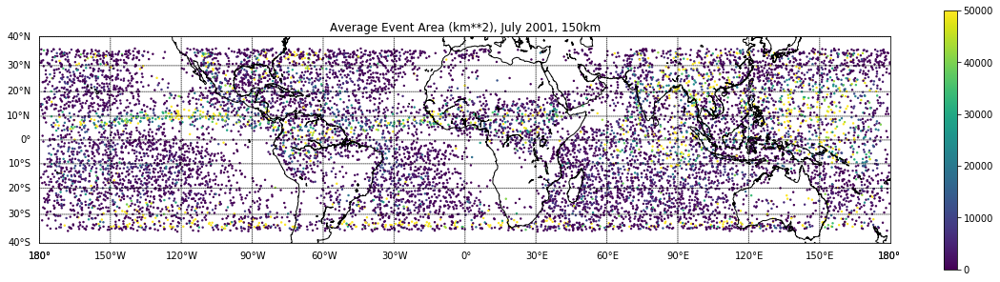

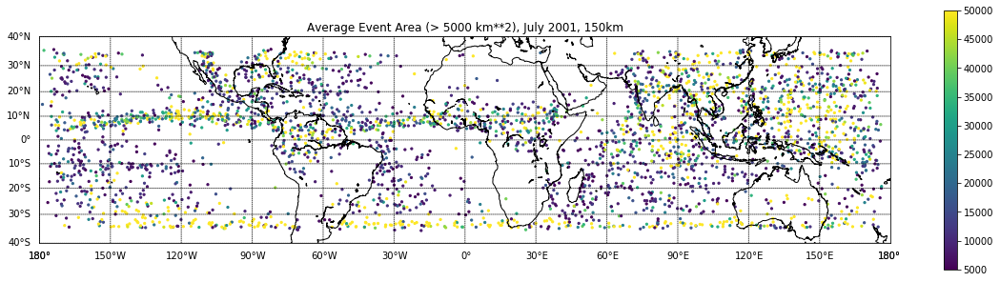

In [121]:
# Plot event areas
fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
x, y = m(event_lon, event_lat)
m.scatter(x, y, c=event_area, s=2)
plt.clim(0, 50000)
plt.colorbar()
plt.title('Average Event Area (km**2), July 2001, 150km');
#fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
area_threshold = 5000
temp_x = event_lon[event_area > area_threshold]
temp_y = event_lat[event_area > area_threshold]
x, y = m(temp_x, temp_y)
m.scatter(x, y, c=event_area[event_area > area_threshold], s=5)
plt.clim(area_threshold, 50000)
plt.colorbar()
plt.title('Average Event Area (> 5000 km**2), July 2001, 150km');
#fig.savefig('plots/area_0701_150km.jpg', format='jpg', bbox_inches='tight');

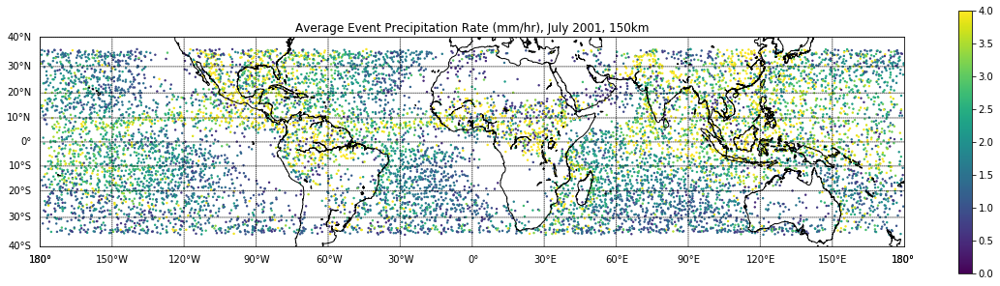

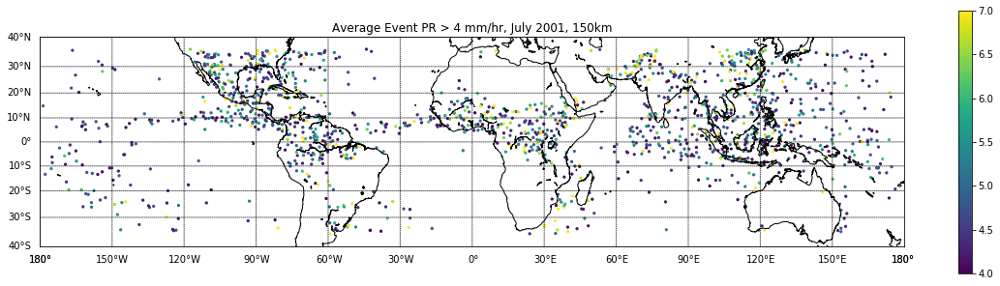

In [129]:
# Plot event precipitation
fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
x, y = m(event_lon, event_lat)
m.scatter(x, y, c=event_pr, s=2)
plt.clim(0, 4)
plt.colorbar()
plt.title('Average Event Precipitation Rate (mm/hr), July 2001, 150km');
#fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
pr_threshold = 4
temp_x = event_lon[event_pr > pr_threshold]
temp_y = event_lat[event_pr > pr_threshold]
x, y = m(temp_x, temp_y)
m.scatter(x, y, c=event_pr[event_pr > pr_threshold], s=5)
plt.clim(pr_threshold, 7)
plt.colorbar()
plt.title('Average Event PR > 4 mm/hr, July 2001, 150km');
#fig.savefig('plots/pr_0701_150km.jpg', format='jpg', bbox_inches='tight');

#fig = plt.figure(num=None, figsize=(20, 5) )
#m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
#            resolution='l',projection='merc')
#m.drawcoastlines()
#m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
#m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
#x, y = m(event_lon, event_lat)
#m.scatter(x, y, c=event_pr*event_area, s=2)
#plt.clim(0, 300000)
#plt.colorbar()
#plt.title('Total Event Precipitation (mm/hr), One Month');
##fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

#fig = plt.figure(num=None, figsize=(20, 5) )
#m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
#            resolution='l',projection='merc')
#m.drawcoastlines()
#m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
#m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
#threshold = 50000
#data = event_pr*event_area
#temp_x = event_lon[data > threshold]
#temp_y = event_lat[data > threshold]
#x, y = m(temp_x, temp_y)
#m.scatter(x, y, c=data[data > threshold], s=5)
#plt.clim(threshold, 300000)
#plt.colorbar()
#plt.title('Total Event PR > A Threshold (mm/hr), One Month');
##fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

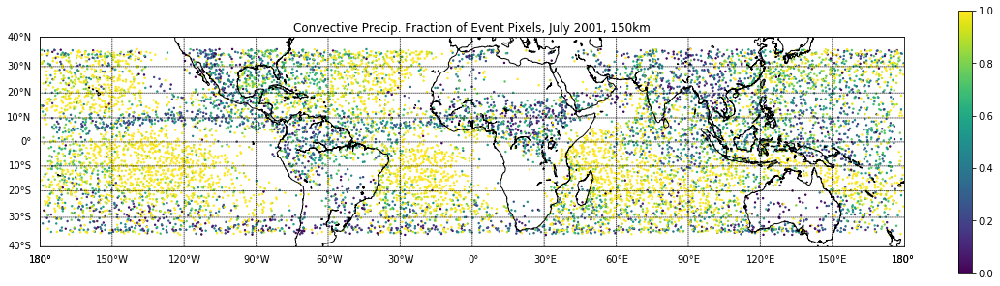

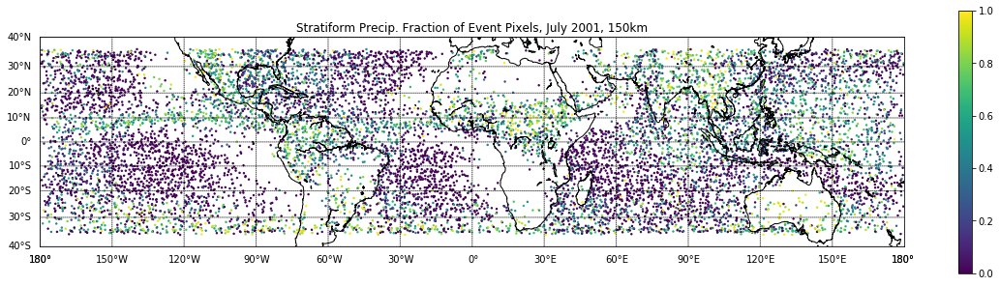

In [113]:
# Plot event precipitation type
fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
x, y = m(event_lon, event_lat)
m.scatter(x, y, c=event_frac_conv, s=2)
plt.clim(0, 1)
plt.colorbar()
plt.title('Convective Precip. Fraction of Event Pixels, July 2001, 150km');
#fig.savefig('plots/convfrac_0701_150km.jpg', format='jpg', bbox_inches='tight');

fig = plt.figure(num=None, figsize=(20, 5) )
m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
            resolution='l',projection='merc')
m.drawcoastlines()
m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
x, y = m(event_lon, event_lat)
m.scatter(x, y, c=event_frac_strat, s=2)
plt.clim(0, 1)
plt.colorbar()
plt.title('Stratiform Precip. Fraction of Event Pixels, July 2001, 150km');
#fig.savefig('plots/stratfrac_0701_150km.jpg', format='jpg', bbox_inches='tight');

#fig = plt.figure(num=None, figsize=(20, 5) )
#m = Basemap(llcrnrlon=-180.,llcrnrlat=-40,urcrnrlon=180.,urcrnrlat=40.,\
#            resolution='l',projection='merc')
#m.drawcoastlines()
#m.drawparallels(np.arange(-90.,91.,10.),labels=[1,0,0,0])
#m.drawmeridians(np.arange(-180.,181.,30.),labels=[0,0,0,1])
#x, y = m(event_lon, event_lat)
#m.scatter(x, y, c=event_frac_other, s=2)
#plt.clim(0, 1)
#plt.colorbar()
#plt.title('Other Precip. Fraction of Event Pixels, January 2001');
##fig.savefig('oneday.jpg', format='jpg', bbox_inches='tight');

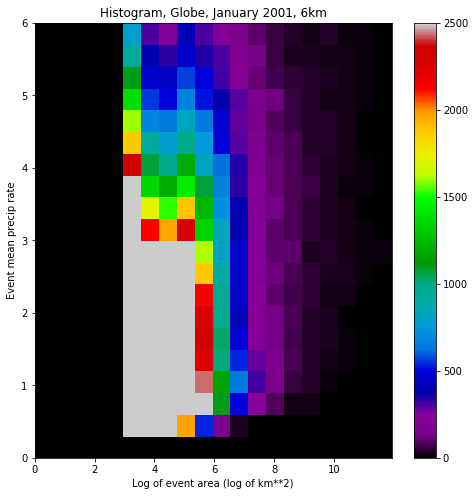

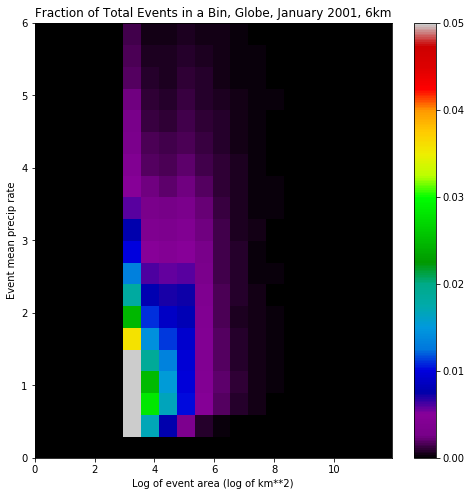

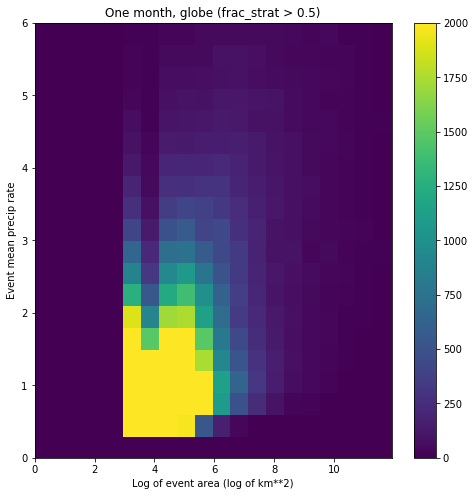

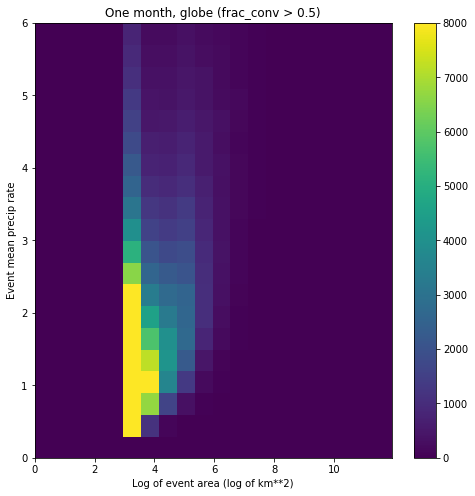

In [210]:
# Make some 2d histograms
nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5
nevents = np.size(event_area)

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(event_area), event_pr, bins=[bins_area,bins_pr], cmap='nipy_spectral')
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
plt.clim(0, 2500)
plt.title('Histogram, Globe, January 2001, 6km')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();
fig.savefig('plots/hist2d_0101_6km.eps', format='eps', bbox_inches='tight');

fig = plt.figure(num=None, figsize=(8, 8) )
plt.pcolor(n[1], n[2], np.transpose(n[0]/nevents), cmap='nipy_spectral')
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
plt.clim(0, 0.05)
plt.title('Fraction of Total Events in a Bin, Globe, January 2001, 6km')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();
fig.savefig('plots/prob2d_0101_6km.eps', format='eps', bbox_inches='tight');

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(event_area[event_frac_strat>0.5]), event_pr[event_frac_strat>0.5],
               bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
plt.clim(0, 2000)
plt.title('One month, globe (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(event_area[event_frac_conv>0.5]), event_pr[event_frac_conv>0.5],
               bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
plt.clim(0, 8000)
plt.title('One month, globe (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

In [154]:
print(event_pr_mean.shape)

(570852,)


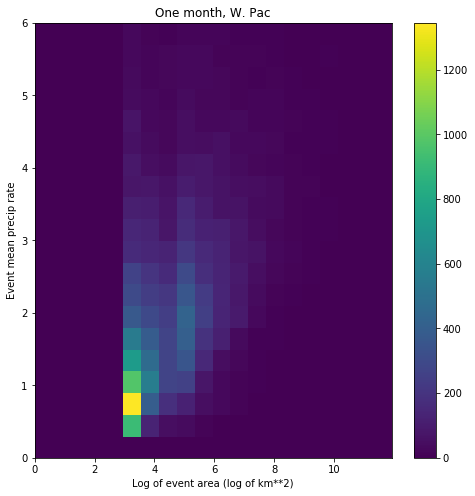

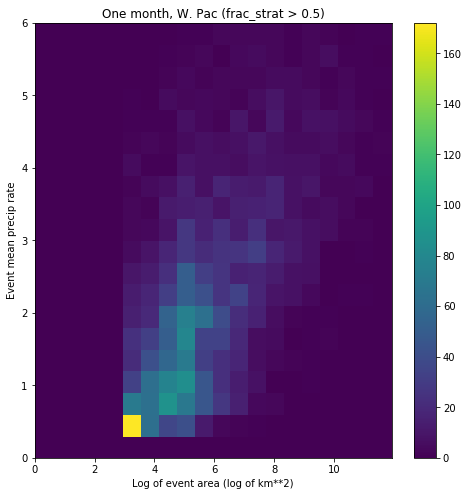

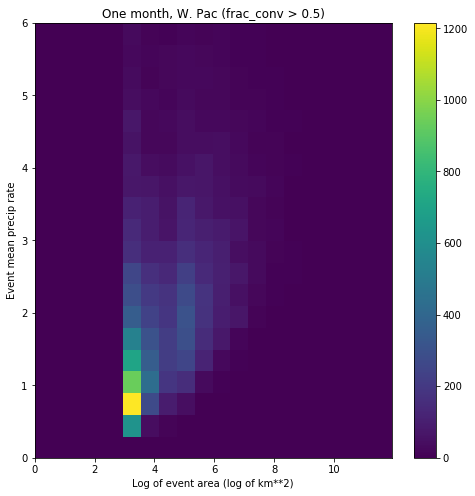

In [52]:
# Make some 2d histograms, W. Pac
lat_min = -20
lat_max = 10
lon_min = 150
lon_max = -150+360

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

temp_lon[temp_lon < 0] = temp_lon[temp_lon < 0] + 360

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

temp_lon[temp_lon > 180] = temp_lon[temp_lon > 180] - 360

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, W. Pac')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, W. Pac (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, W. Pac (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

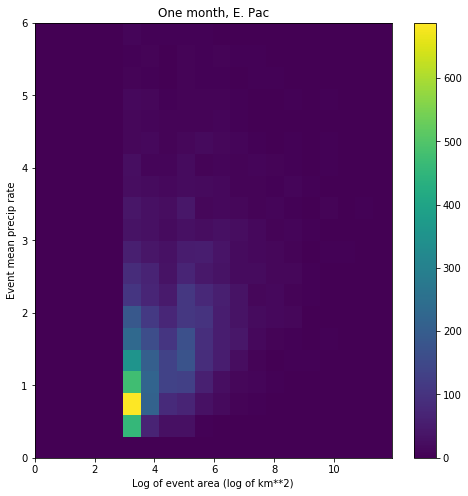

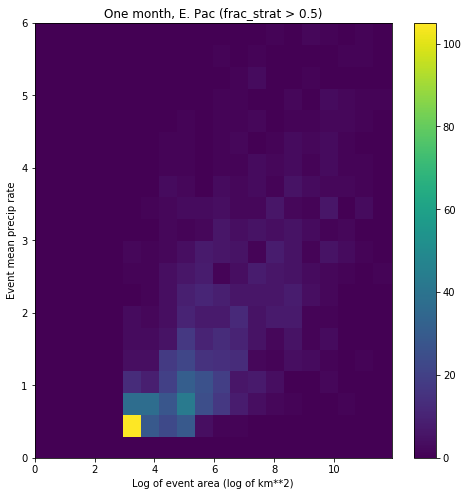

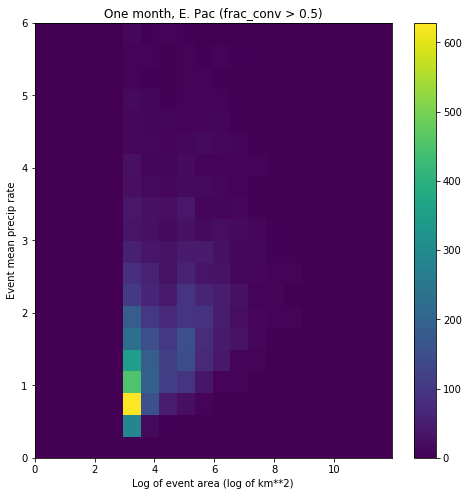

In [53]:
# Make some 2d histograms, E. Pac
lat_min = 0
lat_max = 20
lon_min = -150
lon_max = -90

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, E. Pac')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, E. Pac (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, E. Pac (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

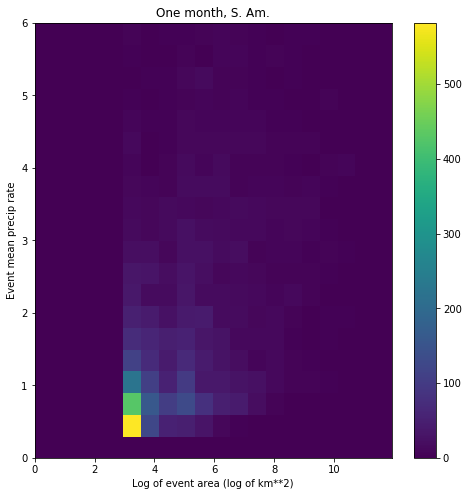

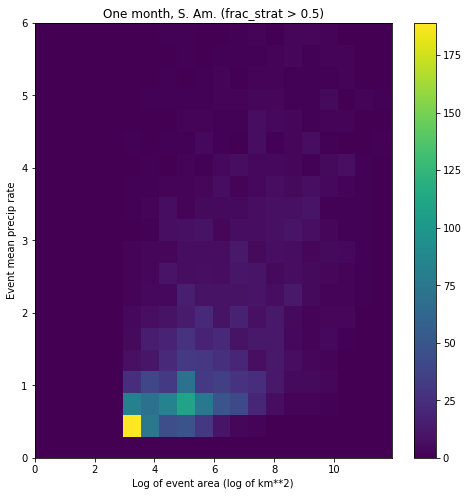

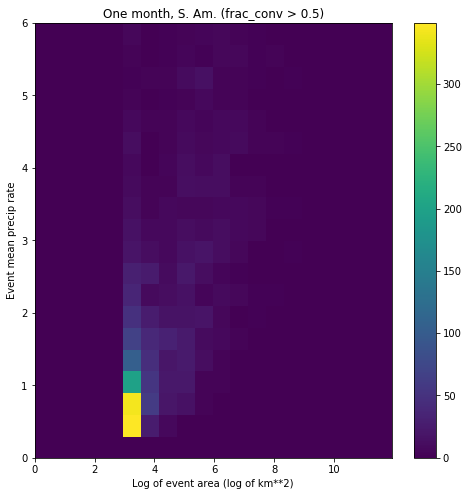

In [54]:
# Make some 2d histograms, S. Am.
lat_min = -20
lat_max = 0
lon_min = -75
lon_max = -45

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, S. Am.')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, S. Am. (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, S. Am. (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

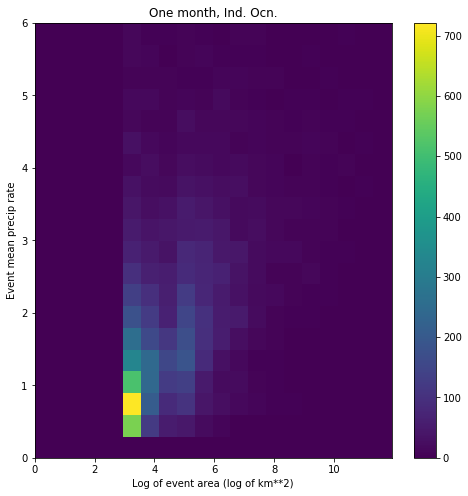

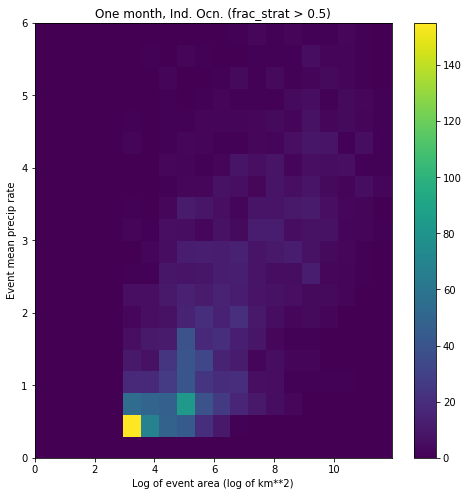

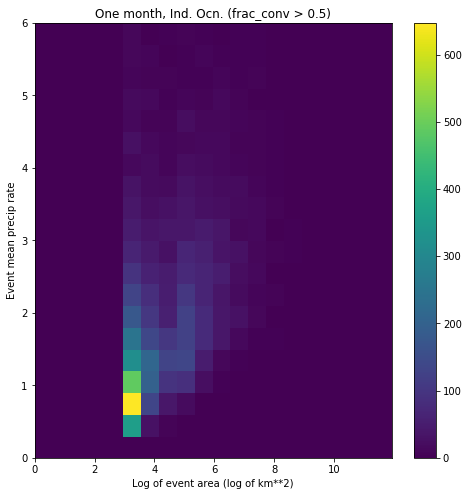

In [55]:
# Make some 2d histograms, Ind. Ocn.
lat_min = -20
lat_max = 0
lon_min = 50
lon_max = 100

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Ind. Ocn.')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Ind. Ocn. (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Ind. Ocn. (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

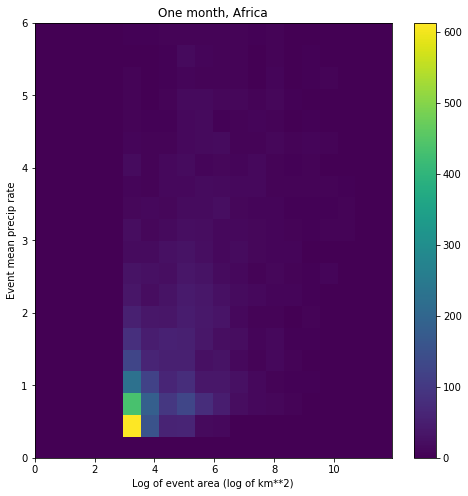

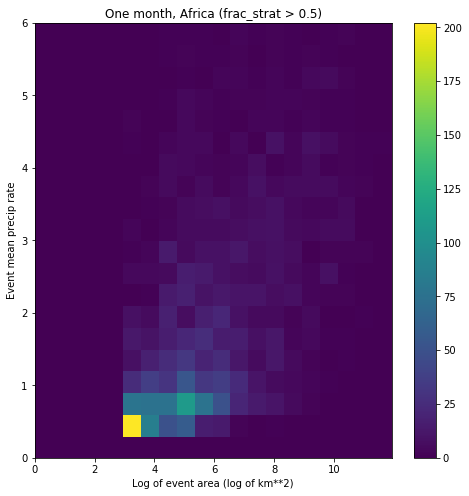

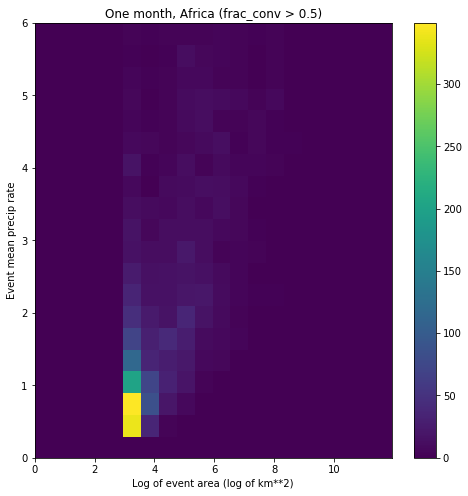

In [56]:
# Make some 2d histograms, Africa
lat_min = -30
lat_max = 0
lon_min = 10
lon_max = 40

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Africa')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Africa (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Africa (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

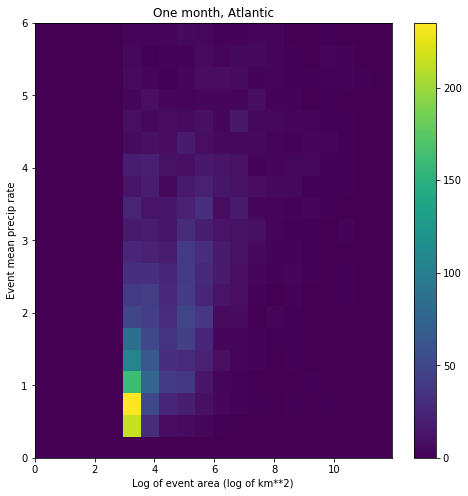

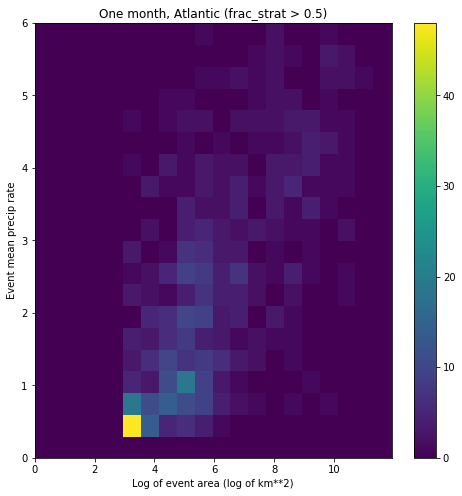

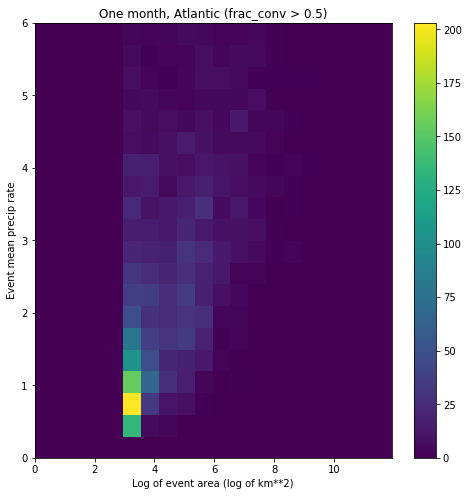

In [57]:
# Make some 2d histograms, Atlantic
lat_min = -3
lat_max = 7
lon_min = -45
lon_max = -10

nbins = 20
bincount_pr = 250
bincount_area = 1000
pr_min = 0
pr_max = 6
area_min = 1
area_max = 1.5E5

temp_lat = event_lat.copy()
temp_lon = event_lon.copy()
area = event_area.copy()
pr = event_pr_mean.copy()
frac_strat = event_frac_strat.copy()
frac_conv = event_frac_conv.copy()

area = area[temp_lat > lat_min]
pr = pr[temp_lat > lat_min]
frac_strat = frac_strat[temp_lat > lat_min]
frac_conv = frac_conv[temp_lat > lat_min]
temp_lon = temp_lon[temp_lat > lat_min]
temp_lat = temp_lat[temp_lat > lat_min]
area = area[temp_lat < lat_max]
pr = pr[temp_lat < lat_max]
frac_strat = frac_strat[temp_lat < lat_max]
frac_conv = frac_conv[temp_lat < lat_max]
temp_lon = temp_lon[temp_lat < lat_max]
temp_lat = temp_lat[temp_lat < lat_max]
area = area[temp_lon < lon_max]
pr = pr[temp_lon < lon_max]
frac_strat = frac_strat[temp_lon < lon_max]
frac_conv = frac_conv[temp_lon < lon_max]
temp_lat = temp_lat[temp_lon < lon_max]
temp_lon = temp_lon[temp_lon < lon_max]
area = area[temp_lon > lon_min]
pr = pr[temp_lon > lon_min]
frac_strat = frac_strat[temp_lon > lon_min]
frac_conv = frac_conv[temp_lon > lon_min]
temp_lat = temp_lat[temp_lon > lon_min]
temp_lon = temp_lon[temp_lon > lon_min]

bins_pr = pr_min + (pr_max - pr_min)*np.arange(nbins+1)/nbins
bins_area = np.log(area_min) + np.log(area_max - area_min)*np.arange(nbins+1)/nbins
bins_frac = np.arange(nbins+1)/nbins

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area), pr, bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Atlantic')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_strat>0.5]), pr[frac_strat>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Atlantic (frac_strat > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();

fig = plt.figure(num=None, figsize=(8, 8) )
n = plt.hist2d(np.log(area[frac_conv>0.5]), pr[frac_conv>0.5], bins=[bins_area,bins_pr])
plt.xlim(np.log(area_min), np.log(area_max))
plt.ylim(pr_min, pr_max)
#plt.clim(0, 50)
plt.title('One month, Atlantic (frac_conv > 0.5)')
plt.xlabel('Log of event area (log of km**2)')
plt.ylabel('Event mean precip rate')
plt.colorbar();